# **A Machine Learning Approach to Credit Card Default Prediction**







    



# **Introduction**


This paper investigates the use of machine learning approaches to improve credit card approval forecasts, which is a crucial investigation given the pressing need for improved credit risk management. This study aims to equip banking and financial organizations with advanced analytical tools to better recognize creditworthy customers, hence refining the credit card issue process and minimizing the likelihood of default. It seeks to determine the best successful algorithm through this comparison analysis, taking into account the complexities and inherent obstacles given by financial statistics, such as class imbalance.

# **Environment**

The entire research was carried out in Python, utilizing a number of machine learning and statistical frameworks, including pycaret, scikit-learn, numpy, pandas, and imblearn, in addition to additional data visualization packages (matplotlib and seaborn).



# **Feature Analysis**


Data has been collected from Kaggle and it records are from a bank/credit card issuer without sensitive personal information. There are two CSV files *application_record.csv* and *credit_record.csv* and both files are connected by a unique identifier. The file application_record.csv contains the personal information of the person who is applying for the credit card while credit_record.csv contains the credit history of that person i.e. records of their loan payment status for each of the previous months.

**application_record**
`ID`:	Client number
`CODE_GENDER`:	Gender
`FLAG_OWN_CAR`:	Does the applicant own a car
`FLAG_OWN_REALTY`:	Does the applicant own a property
`CNT_CHILDREN`:	Number of children
`AMT_INCOME_TOTAL`:	Annual income
`NAME_INCOME_TYPE`:	Income category
`NAME_EDUCATION_TYPE`:	Education level
`NAME_FAMILY_STATUS`:	Marital status
`NAME_HOUSING_TYPE`:	Way of living
`DAYS_BIRTH`:	Birthday	Count backwards from current day (0), -1 means yesterday
`DAYS_EMPLOYED`: Start date of employment	Count backwards from current day(0). If positive, it means the person currently unemployed.
`FLAG_MOBIL`:	Is there a mobile phone
`FLAG_WORK_PHONE`:	Is there a work phone
`FLAG_PHONE`:	Is there a phone
`FLAG_EMAIL`:	Is there an email
`OCCUPATION_TYPE`:	Occupation
`CNT_FAM_MEMBERS`:	Family size

**credit_record**

`ID`:	Client number
`MONTHS_BALANCE`:	Record month	The month of the extracted data is the starting point, backwards, 0 is the current month, -1 is the previous month, and so on.    
  `STATUS`: 0: 1-29 days past due
1: 30-59 days past due
2: 60-89 days overdue
3: 90-119 days overdue
4: 120-149 days overdue
5: Overdue or bad debts, write-offs for more than 150 days
C: paid off that month
X: No loan for the month



# Load Data

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
path = '/application_record.csv'
path2 = '/credit_record.csv'
import pandas as pd
application = pd.read_csv(path)
credit = pd.read_csv(path2)

In [ ]:
application.head()

,ID,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,DAYS_BIRTH,DAYS_EMPLOYED,FLAG_MOBIL,FLAG_WORK_PHONE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS
0,5008804,M,Y,Y,0,427500.0,Working,Higher education,Civil marriage,Rented apartment,-12005,-4542,1,1,0,0,NaN,2.0
1,5008805,M,Y,Y,0,427500.0,Working,Higher education,Civil marriage,Rented apartment,-12005,-4542,1,1,0,0,NaN,2.0
2,5008806,M,Y,Y,0,112500.0,Working,Secondary / secondary special,Married,House / apartment,-21474,-1134,1,0,0,0,Security staff,2.0
3,5008808,F,N,Y,0,270000.0,Commercial associate,Secondary / secondary special,Single / not married,House / apartment,-19110,-3051,1,0,1,1,Sales staff,1.0
4,5008809,F,N,Y,0,270000.0,Commercial associate,Secondary / secondary special,Single / not married,House / apartment,-19110,-3051,1,0,1,1,Sales staff,1.0


In [ ]:
application.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 438557 entries, 0 to 438556
Data columns (total 18 columns):
 #   Column               Non-Null Count   Dtype  
---  ------               --------------   -----  
 0   ID                   438557 non-null  int64  
 1   CODE_GENDER          438557 non-null  object 
 2   FLAG_OWN_CAR         438557 non-null  object 
 3   FLAG_OWN_REALTY      438557 non-null  object 
 4   CNT_CHILDREN         438557 non-null  int64  
 5   AMT_INCOME_TOTAL     438557 non-null  float64
 6   NAME_INCOME_TYPE     438557 non-null  object 
 7   NAME_EDUCATION_TYPE  438557 non-null  object 
 8   NAME_FAMILY_STATUS   438557 non-null  object 
 9   NAME_HOUSING_TYPE    438557 non-null  object 
 10  DAYS_BIRTH           438557 non-null  int64  
 11  DAYS_EMPLOYED        438557 non-null  int64  
 12  FLAG_MOBIL           438557 non-null  int64  
 13  FLAG_WORK_PHONE      438557 non-null  int64  
 14  FLAG_PHONE           438557 non-null  int64  
 15  FLAG_EMAIL       

In [ ]:
application.isna().sum()

ID                          0
CODE_GENDER                 0
FLAG_OWN_CAR                0
FLAG_OWN_REALTY             0
CNT_CHILDREN                0
AMT_INCOME_TOTAL            0
NAME_INCOME_TYPE            0
NAME_EDUCATION_TYPE         0
NAME_FAMILY_STATUS          0
NAME_HOUSING_TYPE           0
DAYS_BIRTH                  0
DAYS_EMPLOYED               0
FLAG_MOBIL                  0
FLAG_WORK_PHONE             0
FLAG_PHONE                  0
FLAG_EMAIL                  0
OCCUPATION_TYPE        134203
CNT_FAM_MEMBERS             0
dtype: int64

In [ ]:
credit.head()

,ID,MONTHS_BALANCE,STATUS
0,5001711,0,X
1,5001711,-1,0
2,5001711,-2,0
3,5001711,-3,0
4,5001712,0,C


In [ ]:
len(application)

438557

In [ ]:
len(credit)

1048575

In [ ]:
credit.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1048575 entries, 0 to 1048574
Data columns (total 3 columns):
 #   Column          Non-Null Count    Dtype 
---  ------          --------------    ----- 
 0   ID              1048575 non-null  int64 
 1   MONTHS_BALANCE  1048575 non-null  int64 
 2   STATUS          1048575 non-null  object
dtypes: int64(2), object(1)
memory usage: 24.0+ MB


In [ ]:
credit.isna().sum()

ID                0
MONTHS_BALANCE    0
STATUS            0
dtype: int64

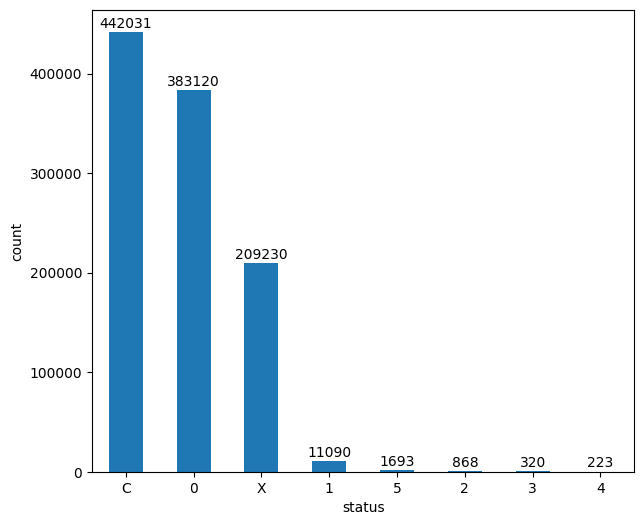

In [ ]:
# credit['STATUS'].value_counts().plot(kind='bar')
import matplotlib.pyplot as plt


status = credit['STATUS'].value_counts()
plt.figure(figsize=(7, 6))
ax = status.plot(kind='bar', rot=0)
ax.set_xlabel('status')
ax.set_ylabel('count')

for rect in ax.patches:
    y_value = rect.get_height()
    x_value = rect.get_x() + rect.get_width() / 2
    space = 1
    label = "{:.0f}".format(y_value)
    ax.annotate(label, (x_value, y_value), xytext=(0, space), textcoords="offset points", ha='center', va='bottom')
    plt.grid(False)
plt.show()

# Compute Status Label from Credit Data

In [ ]:
credit_1 = pd.get_dummies(credit)
credit_1.head()

,ID,MONTHS_BALANCE,STATUS_0,STATUS_1,STATUS_2,STATUS_3,STATUS_4,STATUS_5,STATUS_C,STATUS_X
0,5001711,0,0,0,0,0,0,0,0,1
1,5001711,-1,1,0,0,0,0,0,0,0
2,5001711,-2,1,0,0,0,0,0,0,0
3,5001711,-3,1,0,0,0,0,0,0,0
4,5001712,0,0,0,0,0,0,0,1,0


In [ ]:
credit_grouped = credit_1.groupby(by='ID').agg({'MONTHS_BALANCE':'count',
                                                  'STATUS_0':'sum','STATUS_1':'sum','STATUS_2':'sum','STATUS_3':'sum',
                                                 'STATUS_4':'sum','STATUS_5':'sum','STATUS_C':'sum','STATUS_X':'sum'}).reset_index()
credit_grouped['% STATUS 1'] = credit_grouped['STATUS_1'] / credit_grouped['MONTHS_BALANCE']
credit_grouped.sample(10)

,ID,MONTHS_BALANCE,STATUS_0,STATUS_1,STATUS_2,STATUS_3,STATUS_4,STATUS_5,STATUS_C,STATUS_X,% STATUS 1
4360,5010247,2,0,0,0,0,0,0,2,0,0.000000
23763,5067291,10,6,0,0,0,0,0,4,0,0.000000
8709,5021886,19,9,0,0,0,0,0,10,0,0.000000
44604,5148528,55,8,0,0,0,0,0,47,0,0.000000
835,5002790,20,9,0,0,0,0,0,11,0,0.000000
18353,5052832,38,6,0,0,0,0,0,31,1,0.000000
44768,5148743,11,1,0,0,0,0,0,0,10,0.000000
33701,5113018,29,9,1,0,0,0,0,19,0,0.034483
16800,5046383,1,0,0,0,0,0,0,0,1,0.000000
26970,5088101,5,4,0,0,0,0,0,0,1,0.000000


In [ ]:
def is_bad(row):
    if (row['STATUS_2']>0) or (row['STATUS_3']>0) or (row['STATUS_4']>0) or (row['STATUS_5'] > 0):
        return 'Bad'
    elif row['% STATUS 1'] > 0.15:
        return 'Bad'
    else:
        return 'Good'

credit_grouped['STATUS'] = credit_grouped.apply(is_bad,axis=1)
credit_grouped

,ID,MONTHS_BALANCE,STATUS_0,STATUS_1,STATUS_2,STATUS_3,STATUS_4,STATUS_5,STATUS_C,STATUS_X,% STATUS 1,STATUS
0,5001711,4,3,0,0,0,0,0,0,1,0.0,Good
1,5001712,19,10,0,0,0,0,0,9,0,0.0,Good
2,5001713,22,0,0,0,0,0,0,0,22,0.0,Good
3,5001714,15,0,0,0,0,0,0,0,15,0.0,Good
4,5001715,60,0,0,0,0,0,0,0,60,0.0,Good
...,...,...,...,...,...,...,...,...,...,...,...,...
45980,5150482,18,12,0,0,0,0,0,6,0,0.0,Good
45981,5150483,18,0,0,0,0,0,0,0,18,0.0,Good
45982,5150484,13,12,0,0,0,0,0,1,0,0.0,Good
45983,5150485,2,2,0,0,0,0,0,0,0,0.0,Good


In [ ]:
credit_grouped.sample(50)

,ID,MONTHS_BALANCE,STATUS_0,STATUS_1,STATUS_2,STATUS_3,STATUS_4,STATUS_5,STATUS_C,STATUS_X,% STATUS 1,STATUS
33407,5112623,56,22,0,0,0,0,0,34,0,0.000000,Good
8333,5021423,53,3,0,0,0,0,0,0,50,0.000000,Good
40483,5126459,8,6,1,0,0,0,0,0,1,0.125000,Good
41999,5137252,20,12,0,0,0,0,0,8,0,0.000000,Good
39979,5125797,15,10,5,0,0,0,0,0,0,0.333333,Bad
28243,5090082,16,16,0,0,0,0,0,0,0,0.000000,Good
24623,5068379,22,6,0,0,0,0,0,16,0,0.000000,Good
41912,5137145,26,2,0,0,0,0,0,24,0,0.000000,Good
8817,5022015,17,14,0,0,0,0,0,0,3,0.000000,Good
13290,5033776,40,39,0,0,0,0,0,0,1,0.000000,Good


# Merge dataset

In [ ]:
application = application.merge(credit_grouped[['ID','STATUS']], on='ID',how='left')
application.head(5)

,ID,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,DAYS_BIRTH,DAYS_EMPLOYED,FLAG_MOBIL,FLAG_WORK_PHONE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,STATUS
0,5008804,M,Y,Y,0,427500.0,Working,Higher education,Civil marriage,Rented apartment,-12005,-4542,1,1,0,0,NaN,2.0,Good
1,5008805,M,Y,Y,0,427500.0,Working,Higher education,Civil marriage,Rented apartment,-12005,-4542,1,1,0,0,NaN,2.0,Good
2,5008806,M,Y,Y,0,112500.0,Working,Secondary / secondary special,Married,House / apartment,-21474,-1134,1,0,0,0,Security staff,2.0,Good
3,5008808,F,N,Y,0,270000.0,Commercial associate,Secondary / secondary special,Single / not married,House / apartment,-19110,-3051,1,0,1,1,Sales staff,1.0,Good
4,5008809,F,N,Y,0,270000.0,Commercial associate,Secondary / secondary special,Single / not married,House / apartment,-19110,-3051,1,0,1,1,Sales staff,1.0,Good


In [ ]:
application.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 438557 entries, 0 to 438556
Data columns (total 19 columns):
 #   Column               Non-Null Count   Dtype  
---  ------               --------------   -----  
 0   ID                   438557 non-null  int64  
 1   CODE_GENDER          438557 non-null  object 
 2   FLAG_OWN_CAR         438557 non-null  object 
 3   FLAG_OWN_REALTY      438557 non-null  object 
 4   CNT_CHILDREN         438557 non-null  int64  
 5   AMT_INCOME_TOTAL     438557 non-null  float64
 6   NAME_INCOME_TYPE     438557 non-null  object 
 7   NAME_EDUCATION_TYPE  438557 non-null  object 
 8   NAME_FAMILY_STATUS   438557 non-null  object 
 9   NAME_HOUSING_TYPE    438557 non-null  object 
 10  DAYS_BIRTH           438557 non-null  int64  
 11  DAYS_EMPLOYED        438557 non-null  int64  
 12  FLAG_MOBIL           438557 non-null  int64  
 13  FLAG_WORK_PHONE      438557 non-null  int64  
 14  FLAG_PHONE           438557 non-null  int64  
 15  FLAG_EMAIL       

In [ ]:
len(application)

438557

In [ ]:
application.isna().sum()

ID                          0
CODE_GENDER                 0
FLAG_OWN_CAR                0
FLAG_OWN_REALTY             0
CNT_CHILDREN                0
AMT_INCOME_TOTAL            0
NAME_INCOME_TYPE            0
NAME_EDUCATION_TYPE         0
NAME_FAMILY_STATUS          0
NAME_HOUSING_TYPE           0
DAYS_BIRTH                  0
DAYS_EMPLOYED               0
FLAG_MOBIL                  0
FLAG_WORK_PHONE             0
FLAG_PHONE                  0
FLAG_EMAIL                  0
OCCUPATION_TYPE        134203
CNT_FAM_MEMBERS             0
STATUS                 402100
dtype: int64

# Exploratory Data Analysis

<AxesSubplot: >

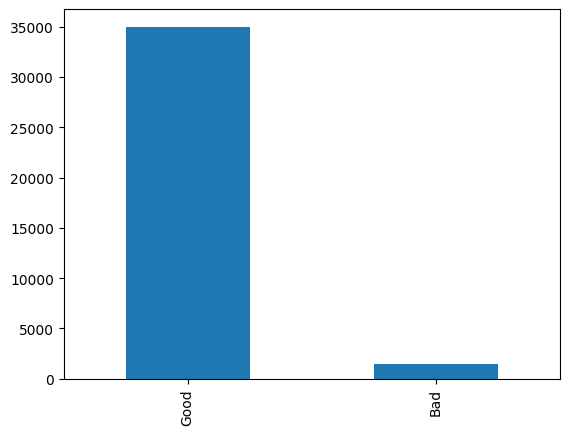

In [ ]:
application['STATUS'].value_counts().plot(kind='bar')

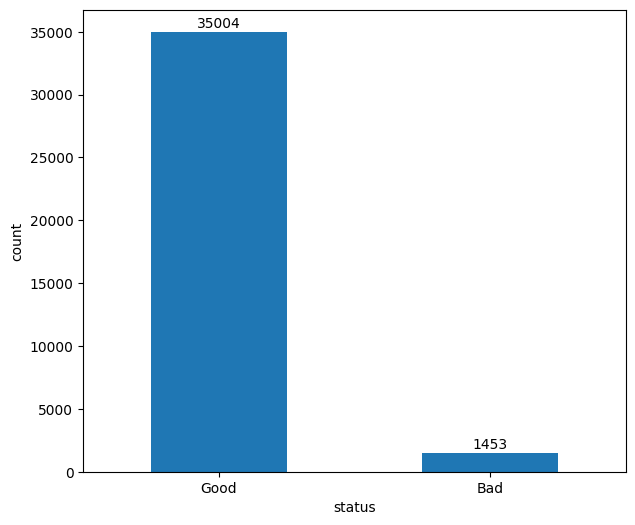

In [ ]:
# credit['STATUS'].value_counts().plot(kind='bar')
import matplotlib.pyplot as plt


status = application['STATUS'].value_counts()
plt.figure(figsize=(7, 6))
ax = status.plot(kind='bar', rot=0)
ax.set_xlabel('status')
ax.set_ylabel('count')

for rect in ax.patches:
    y_value = rect.get_height()
    x_value = rect.get_x() + rect.get_width() / 2
    space = 1
    label = "{:.0f}".format(y_value)
    ax.annotate(label, (x_value, y_value), xytext=(0, space), textcoords="offset points", ha='center', va='bottom')
    plt.grid(False)
plt.show()

In [ ]:
application['STATUS'].value_counts(normalize=True).mul(100).round(1).astype(str) + '%'

Good    96.0%
Bad      4.0%
Name: STATUS, dtype: object

In [ ]:
application['STATUS'].value_counts()

Good    35004
Bad      1453
Name: STATUS, dtype: int64

In [ ]:
categorical_columns = application.select_dtypes(include='object').columns
print(categorical_columns, '\n')

#Print out results
[print(f'{application[column].value_counts()}\n{"-"*50}') for column in categorical_columns]

Index(['CODE_GENDER', 'FLAG_OWN_CAR', 'FLAG_OWN_REALTY', 'NAME_INCOME_TYPE',
       'NAME_EDUCATION_TYPE', 'NAME_FAMILY_STATUS', 'NAME_HOUSING_TYPE',
       'OCCUPATION_TYPE', 'STATUS'],
      dtype='object') 

F    294440
M    144117
Name: CODE_GENDER, dtype: int64
--------------------------------------------------
N    275459
Y    163098
Name: FLAG_OWN_CAR, dtype: int64
--------------------------------------------------
Y    304074
N    134483
Name: FLAG_OWN_REALTY, dtype: int64
--------------------------------------------------
Working                 226104
Commercial associate    100757
Pensioner                75493
State servant            36186
Student                     17
Name: NAME_INCOME_TYPE, dtype: int64
--------------------------------------------------
Secondary / secondary special    301821
Higher education                 117522
Incomplete higher                 14851
Lower secondary                    4051
Academic degree                     312
Name: NAME_EDUCATION

[None, None, None, None, None, None, None, None, None]

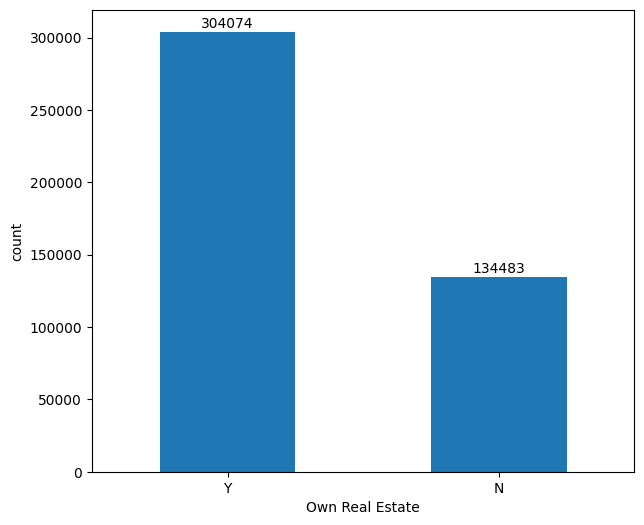

In [ ]:
import matplotlib.pyplot as plt


status = application['FLAG_OWN_REALTY'].value_counts()
plt.figure(figsize=(7, 6))
ax = status.plot(kind='bar', rot=0)
ax.set_xlabel('Own Real Estate')
ax.set_ylabel('count')

for rect in ax.patches:
    y_value = rect.get_height()
    x_value = rect.get_x() + rect.get_width() / 2
    space = 1
    label = "{:.0f}".format(y_value)
    ax.annotate(label, (x_value, y_value), xytext=(0, space), textcoords="offset points", ha='center', va='bottom')
    plt.grid(False)
plt.show()

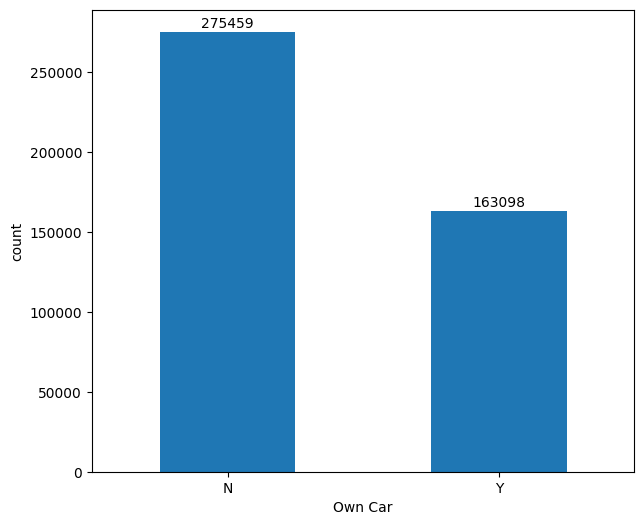

In [ ]:
import matplotlib.pyplot as plt


status = application['FLAG_OWN_CAR'].value_counts()
plt.figure(figsize=(7, 6))
ax = status.plot(kind='bar', rot=0)
ax.set_xlabel('Own Car')
ax.set_ylabel('count')

for rect in ax.patches:
    y_value = rect.get_height()
    x_value = rect.get_x() + rect.get_width() / 2
    space = 1
    label = "{:.0f}".format(y_value)
    ax.annotate(label, (x_value, y_value), xytext=(0, space), textcoords="offset points", ha='center', va='bottom')
    plt.grid(False)
plt.show()

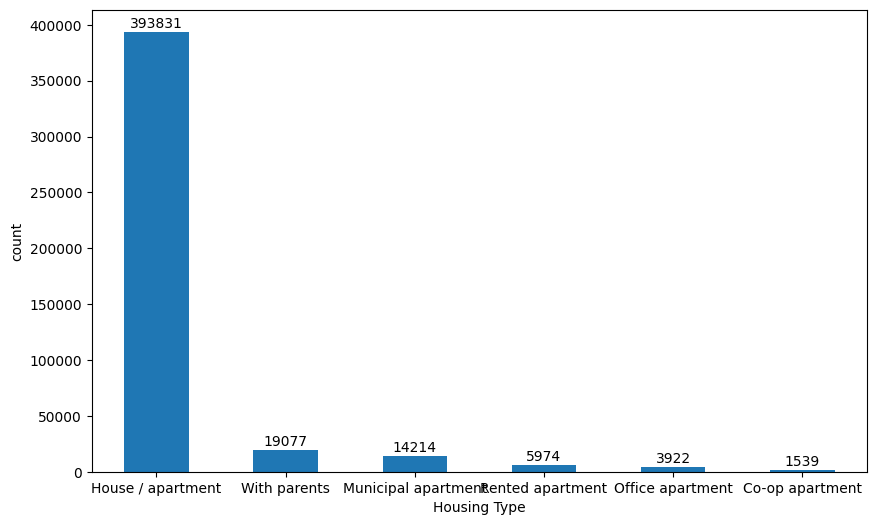

In [ ]:
import matplotlib.pyplot as plt


status = application['NAME_HOUSING_TYPE'].value_counts()
plt.figure(figsize=(10, 6))
ax = status.plot(kind='bar', rot=0)
ax.set_xlabel('Housing Type')
ax.set_ylabel('count')

for rect in ax.patches:
    y_value = rect.get_height()
    x_value = rect.get_x() + rect.get_width() / 2
    space = 1
    label = "{:.0f}".format(y_value)
    ax.annotate(label, (x_value, y_value), xytext=(0, space), textcoords="offset points", ha='center', va='bottom')
    plt.grid(False)
plt.show()

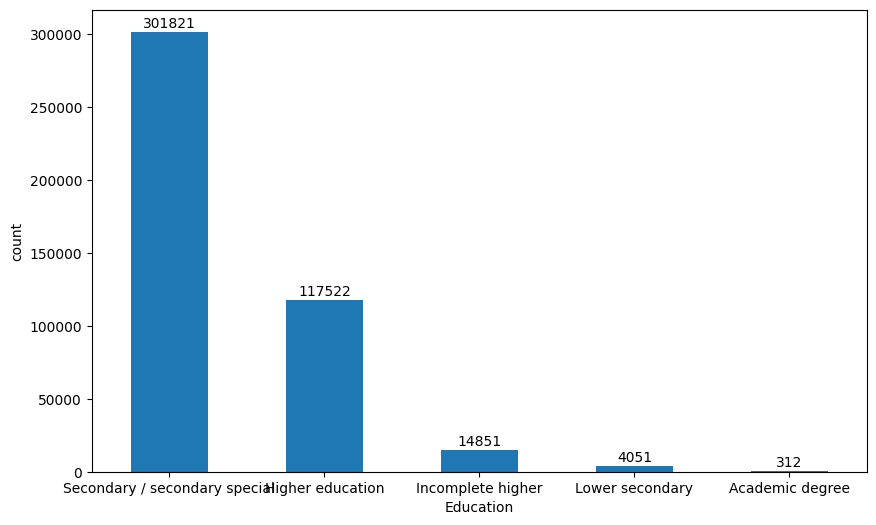

In [ ]:
import matplotlib.pyplot as plt


status = application['NAME_EDUCATION_TYPE'].value_counts()
plt.figure(figsize=(10, 6))
ax = status.plot(kind='bar', rot=0)
ax.set_xlabel('Education')
ax.set_ylabel('count')

for rect in ax.patches:
    y_value = rect.get_height()
    x_value = rect.get_x() + rect.get_width() / 2
    space = 1
    label = "{:.0f}".format(y_value)
    ax.annotate(label, (x_value, y_value), xytext=(0, space), textcoords="offset points", ha='center', va='bottom')
    plt.grid(False)
plt.show()

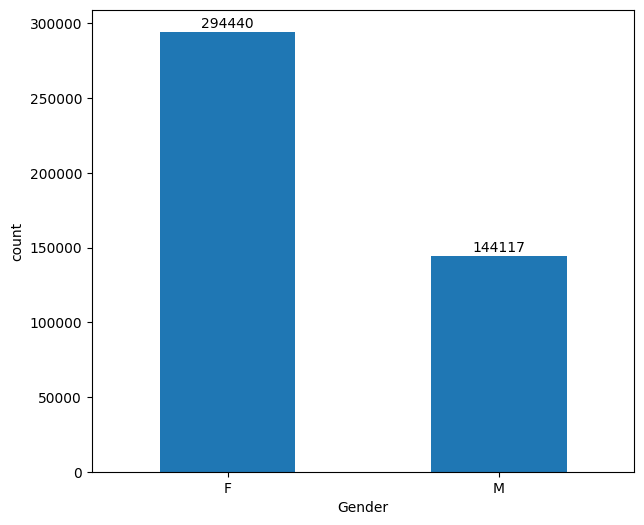

In [ ]:
import matplotlib.pyplot as plt


status = application['CODE_GENDER'].value_counts()
plt.figure(figsize=(7, 6))
ax = status.plot(kind='bar', rot=0)
ax.set_xlabel('Gender')
ax.set_ylabel('count')

for rect in ax.patches:
    y_value = rect.get_height()
    x_value = rect.get_x() + rect.get_width() / 2
    space = 1
    label = "{:.0f}".format(y_value)
    ax.annotate(label, (x_value, y_value), xytext=(0, space), textcoords="offset points", ha='center', va='bottom')
    plt.grid(False)
plt.show()

<AxesSubplot: >

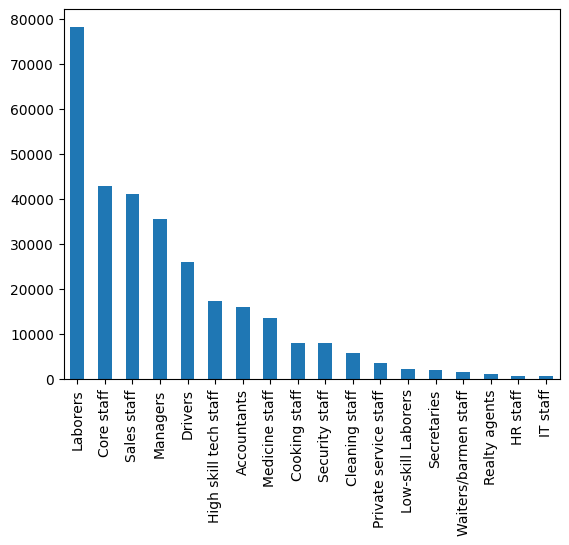

In [ ]:
application['OCCUPATION_TYPE'].value_counts().plot(kind='bar',grid=False)

# import matplotlib.pyplot as plt


# status = application['OCCUPATION_TYPE'].value_counts()
# plt.figure(figsize=(12, 6))
# ax = status.plot(kind='bar', rot=0)
# ax.set_xlabel('Occupation')
# ax.set_ylabel('count')

# for rect in ax.patches:
#     y_value = rect.get_height()
#     x_value = rect.get_x() + rect.get_width() / 2
#     space = 1
#     label = "{:.0f}".format(y_value)
#     ax.annotate(label, (x_value, y_value), xytext=(0, space), textcoords="offset points", ha='center', va='bottom')
#     plt.grid(False)
# plt.show()

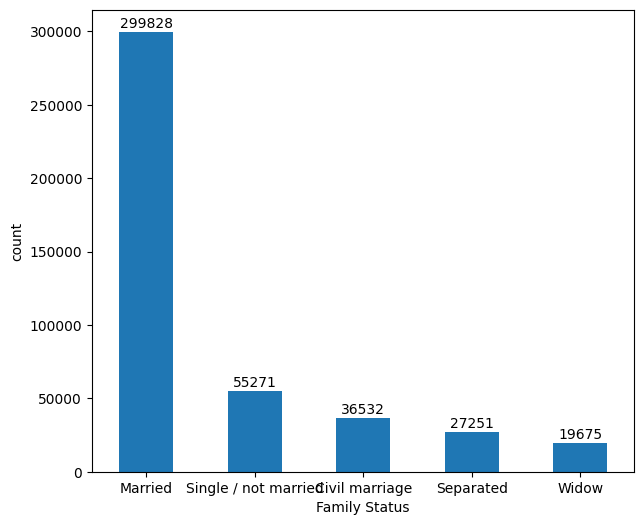

In [ ]:
# application['NAME_FAMILY_STATUS'].value_counts().plot(kind='bar')

import matplotlib.pyplot as plt


status = application['NAME_FAMILY_STATUS'].value_counts()
plt.figure(figsize=(7, 6))
ax = status.plot(kind='bar', rot=0)
ax.set_xlabel('Family Status')
ax.set_ylabel('count')

for rect in ax.patches:
    y_value = rect.get_height()
    x_value = rect.get_x() + rect.get_width() / 2
    space = 1
    label = "{:.0f}".format(y_value)
    ax.annotate(label, (x_value, y_value), xytext=(0, space), textcoords="offset points", ha='center', va='bottom')
    plt.grid(False)
plt.show()

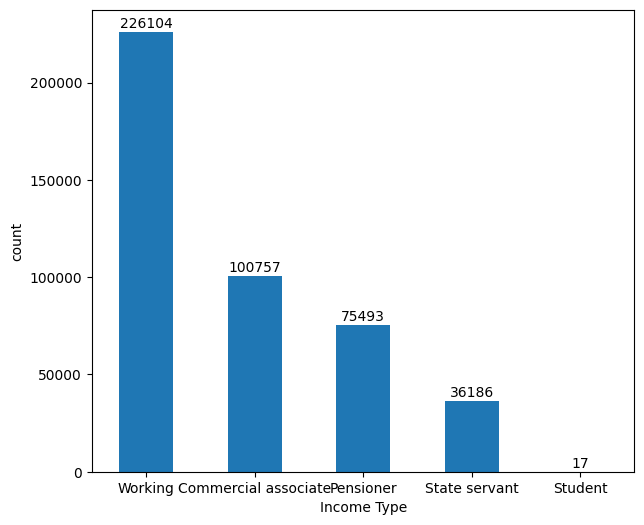

In [ ]:
# application['NAME_INCOME_TYPE'].value_counts().plot(kind='bar')

import matplotlib.pyplot as plt


status = application['NAME_INCOME_TYPE'].value_counts()
plt.figure(figsize=(7, 6))
ax = status.plot(kind='bar', rot=0)
ax.set_xlabel('Income Type')
ax.set_ylabel('count')

for rect in ax.patches:
    y_value = rect.get_height()
    x_value = rect.get_x() + rect.get_width() / 2
    space = 1
    label = "{:.0f}".format(y_value)
    ax.annotate(label, (x_value, y_value), xytext=(0, space), textcoords="offset points", ha='center', va='bottom')
    plt.grid(False)
plt.show()

In [ ]:
import plotly.express as px
fig = px.histogram(application, x='AMT_INCOME_TOTAL',nbins=20, title=f'Income')
fig.show()

# Feature Encoding

In [ ]:
application['CODE_GENDER'] = application['CODE_GENDER'].map({'M':1,'F':0})
application['FLAG_OWN_CAR'] =application['FLAG_OWN_CAR'].map({'Y':1,'N':0})
application['FLAG_OWN_REALTY'] =application['FLAG_OWN_REALTY'].map({'Y':1,'N':0})
application['STATUS'] = application['STATUS'].map({'Bad':1,'Good':0})

In [ ]:
application['Age'] = (round(-application['DAYS_BIRTH'] / 365, 0)).astype(int)
application['Employed_years'] = (round(-application['DAYS_EMPLOYED']/365, 0)).astype(int)
application['Employed_years'] = application['Employed_years'].apply(lambda x: 0 if x<0 else x)

In [ ]:
application

,ID,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,...,DAYS_EMPLOYED,FLAG_MOBIL,FLAG_WORK_PHONE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,STATUS,Age,Employed_years
0,5008804,1,1,1,0,427500.0,Working,Higher education,Civil marriage,Rented apartment,...,-4542,1,1,0,0,NaN,2.0,0.0,33,12
1,5008805,1,1,1,0,427500.0,Working,Higher education,Civil marriage,Rented apartment,...,-4542,1,1,0,0,NaN,2.0,0.0,33,12
2,5008806,1,1,1,0,112500.0,Working,Secondary / secondary special,Married,House / apartment,...,-1134,1,0,0,0,Security staff,2.0,0.0,59,3
3,5008808,0,0,1,0,270000.0,Commercial associate,Secondary / secondary special,Single / not married,House / apartment,...,-3051,1,0,1,1,Sales staff,1.0,0.0,52,8
4,5008809,0,0,1,0,270000.0,Commercial associate,Secondary / secondary special,Single / not married,House / apartment,...,-3051,1,0,1,1,Sales staff,1.0,0.0,52,8
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
438552,6840104,1,0,1,0,135000.0,Pensioner,Secondary / secondary special,Separated,House / apartment,...,365243,1,0,0,0,NaN,1.0,NaN,62,0
438553,6840222,0,0,0,0,103500.0,Working,Secondary / secondary special,Single / not married,House / apartment,...,-3007,1,0,0,0,Laborers,1.0,NaN,44,8
438554,6841878,0,0,0,0,54000.0,Commercial associate,Higher education,Single / not married,With parents,...,-372,1,1,0,0,Sales staff,1.0,NaN,22,1
438555,6842765,0,0,1,0,72000.0,Pensioner,Secondary / secondary special,Married,House / apartment,...,365243,1,0,0,0,NaN,2.0,NaN,59,0


In [ ]:
application_final = application.loc[application['STATUS'].notna()]

In [ ]:
application_final.shape

(36457, 21)

In [ ]:
application_final.isna().sum()

ID                         0
CODE_GENDER                0
FLAG_OWN_CAR               0
FLAG_OWN_REALTY            0
CNT_CHILDREN               0
AMT_INCOME_TOTAL           0
NAME_INCOME_TYPE           0
NAME_EDUCATION_TYPE        0
NAME_FAMILY_STATUS         0
NAME_HOUSING_TYPE          0
DAYS_BIRTH                 0
DAYS_EMPLOYED              0
FLAG_MOBIL                 0
FLAG_WORK_PHONE            0
FLAG_PHONE                 0
FLAG_EMAIL                 0
OCCUPATION_TYPE        11323
CNT_FAM_MEMBERS            0
STATUS                     0
Age                        0
Employed_years             0
dtype: int64

In [ ]:
a = application_final[application_final['OCCUPATION_TYPE'].isna()]
a

,ID,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,NAME_INCOME_TYPE,NAME_EDUCATION_TYPE,NAME_FAMILY_STATUS,NAME_HOUSING_TYPE,...,DAYS_EMPLOYED,FLAG_MOBIL,FLAG_WORK_PHONE,FLAG_PHONE,FLAG_EMAIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,STATUS,Age,Employed_years
0,5008804,1,1,1,0,427500.0,Working,Higher education,Civil marriage,Rented apartment,...,-4542,1,1,0,0,NaN,2.0,0.0,33,12
1,5008805,1,1,1,0,427500.0,Working,Higher education,Civil marriage,Rented apartment,...,-4542,1,1,0,0,NaN,2.0,0.0,33,12
7,5008812,0,0,1,0,283500.0,Pensioner,Higher education,Separated,House / apartment,...,365243,1,0,0,0,NaN,1.0,0.0,62,0
8,5008813,0,0,1,0,283500.0,Pensioner,Higher education,Separated,House / apartment,...,365243,1,0,0,0,NaN,1.0,0.0,62,0
9,5008814,0,0,1,0,283500.0,Pensioner,Higher education,Separated,House / apartment,...,365243,1,0,0,0,NaN,1.0,0.0,62,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
434795,5148602,1,0,1,0,225000.0,Pensioner,Secondary / secondary special,Married,House / apartment,...,365243,1,0,0,0,NaN,2.0,1.0,63,0
434796,5148679,0,0,0,0,121500.0,Commercial associate,Secondary / secondary special,Married,House / apartment,...,-6195,1,0,0,0,NaN,2.0,1.0,52,17
434801,5149055,0,0,1,0,112500.0,Commercial associate,Secondary / secondary special,Married,House / apartment,...,-2694,1,1,1,0,NaN,2.0,1.0,43,7
434802,5149056,0,0,1,0,112500.0,Commercial associate,Secondary / secondary special,Married,House / apartment,...,-2694,1,1,1,0,NaN,2.0,1.0,43,7


In [ ]:
df = pd.get_dummies(application_final)

In [ ]:
df.shape

(36457, 55)

In [ ]:
df.head(10)

,ID,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,DAYS_BIRTH,DAYS_EMPLOYED,FLAG_MOBIL,FLAG_WORK_PHONE,...,OCCUPATION_TYPE_Laborers,OCCUPATION_TYPE_Low-skill Laborers,OCCUPATION_TYPE_Managers,OCCUPATION_TYPE_Medicine staff,OCCUPATION_TYPE_Private service staff,OCCUPATION_TYPE_Realty agents,OCCUPATION_TYPE_Sales staff,OCCUPATION_TYPE_Secretaries,OCCUPATION_TYPE_Security staff,OCCUPATION_TYPE_Waiters/barmen staff
0,5008804,1,1,1,0,427500.0,-12005,-4542,1,1,...,0,0,0,0,0,0,0,0,0,0
1,5008805,1,1,1,0,427500.0,-12005,-4542,1,1,...,0,0,0,0,0,0,0,0,0,0
2,5008806,1,1,1,0,112500.0,-21474,-1134,1,0,...,0,0,0,0,0,0,0,0,1,0
3,5008808,0,0,1,0,270000.0,-19110,-3051,1,0,...,0,0,0,0,0,0,1,0,0,0
4,5008809,0,0,1,0,270000.0,-19110,-3051,1,0,...,0,0,0,0,0,0,1,0,0,0
5,5008810,0,0,1,0,270000.0,-19110,-3051,1,0,...,0,0,0,0,0,0,1,0,0,0
6,5008811,0,0,1,0,270000.0,-19110,-3051,1,0,...,0,0,0,0,0,0,1,0,0,0
7,5008812,0,0,1,0,283500.0,-22464,365243,1,0,...,0,0,0,0,0,0,0,0,0,0
8,5008813,0,0,1,0,283500.0,-22464,365243,1,0,...,0,0,0,0,0,0,0,0,0,0
9,5008814,0,0,1,0,283500.0,-22464,365243,1,0,...,0,0,0,0,0,0,0,0,0,0


In [ ]:
df.drop(['DAYS_BIRTH','DAYS_EMPLOYED','FLAG_MOBIL'], axis = 1, inplace = True)

In [ ]:
df.shape

(36457, 52)

In [ ]:
df.isna().sum()

ID                                                   0
CODE_GENDER                                          0
FLAG_OWN_CAR                                         0
FLAG_OWN_REALTY                                      0
CNT_CHILDREN                                         0
AMT_INCOME_TOTAL                                     0
FLAG_WORK_PHONE                                      0
FLAG_PHONE                                           0
FLAG_EMAIL                                           0
CNT_FAM_MEMBERS                                      0
STATUS                                               0
Age                                                  0
Employed_years                                       0
NAME_INCOME_TYPE_Commercial associate                0
NAME_INCOME_TYPE_Pensioner                           0
NAME_INCOME_TYPE_State servant                       0
NAME_INCOME_TYPE_Student                             0
NAME_INCOME_TYPE_Working                             0
NAME_EDUCA

<ipython-input-47-aa7e84914c14>:5: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751




<AxesSubplot: ylabel='Density'>

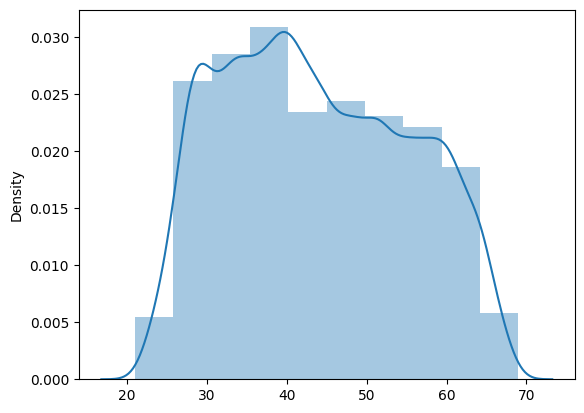

In [ ]:
# ax = df['Age'].plot.hist(bins=20,color='#0504aa',alpha=0.7, rwidth=0.85)
# ax.set_xlabel('Age')
import seaborn as sns

sns.distplot(x=df['Age'],bins = 10)

<AxesSubplot: >

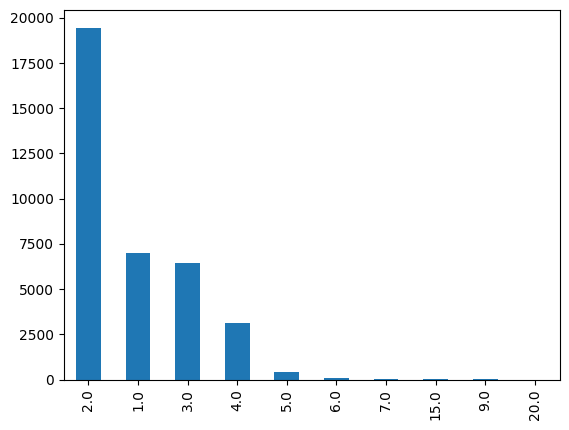

In [ ]:
df['CNT_FAM_MEMBERS'].value_counts().plot(kind='bar')

# Data Cleaning

## Missing Values

In [ ]:
df.isna().sum()

ID                                                   0
CODE_GENDER                                          0
FLAG_OWN_CAR                                         0
FLAG_OWN_REALTY                                      0
CNT_CHILDREN                                         0
AMT_INCOME_TOTAL                                     0
FLAG_WORK_PHONE                                      0
FLAG_PHONE                                           0
FLAG_EMAIL                                           0
CNT_FAM_MEMBERS                                      0
STATUS                                               0
Age                                                  0
Employed_years                                       0
NAME_INCOME_TYPE_Commercial associate                0
NAME_INCOME_TYPE_Pensioner                           0
NAME_INCOME_TYPE_State servant                       0
NAME_INCOME_TYPE_Student                             0
NAME_INCOME_TYPE_Working                             0
NAME_EDUCA

In [ ]:
df['FLAG_WORK_PHONE'].value_counts()

0    28235
1     8222
Name: FLAG_WORK_PHONE, dtype: int64

In [ ]:
df['FLAG_EMAIL'].value_counts()

0    33186
1     3271
Name: FLAG_EMAIL, dtype: int64

In [ ]:
df['FLAG_PHONE'].value_counts()

0    25709
1    10748
Name: FLAG_PHONE, dtype: int64

In [ ]:
df['FLAG_OWN_REALTY'].value_counts()

1    24506
0    11951
Name: FLAG_OWN_REALTY, dtype: int64

In [ ]:
df['FLAG_OWN_CAR'].value_counts()

0    22614
1    13843
Name: FLAG_OWN_CAR, dtype: int64

In [ ]:
df['CNT_CHILDREN'].value_counts()

0     25201
1      7492
2      3256
3       419
4        63
5        20
14        3
7         2
19        1
Name: CNT_CHILDREN, dtype: int64

In [ ]:
df['CNT_FAM_MEMBERS'].value_counts()

2.0     19463
1.0      6987
3.0      6421
4.0      3106
5.0       397
6.0        58
7.0        19
15.0        3
9.0         2
20.0        1
Name: CNT_FAM_MEMBERS, dtype: int64

## Outliers

<AxesSubplot: xlabel='Age'>

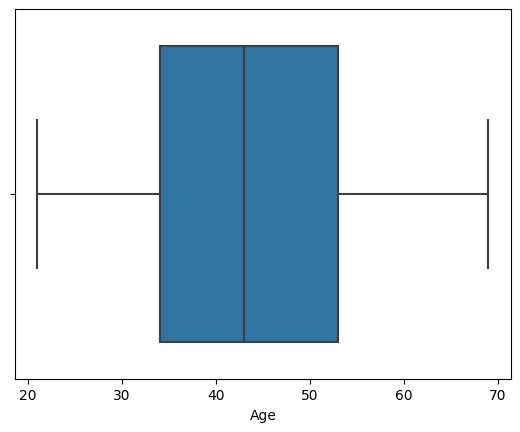

In [ ]:
import seaborn as sns
sns.boxplot(x=df['Age'])

<AxesSubplot: xlabel='Employed_years'>

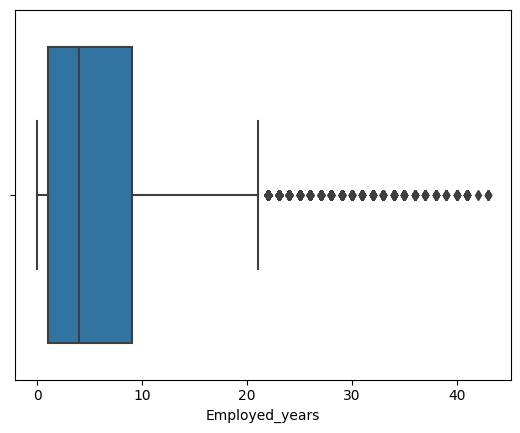

In [ ]:
sns.boxplot(x=df['Employed_years'])

<AxesSubplot: xlabel='CNT_FAM_MEMBERS'>

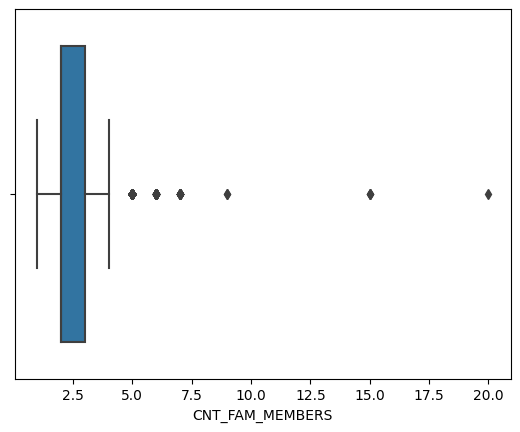

In [ ]:
sns.boxplot(x=df['CNT_FAM_MEMBERS'])

<AxesSubplot: xlabel='CNT_CHILDREN'>

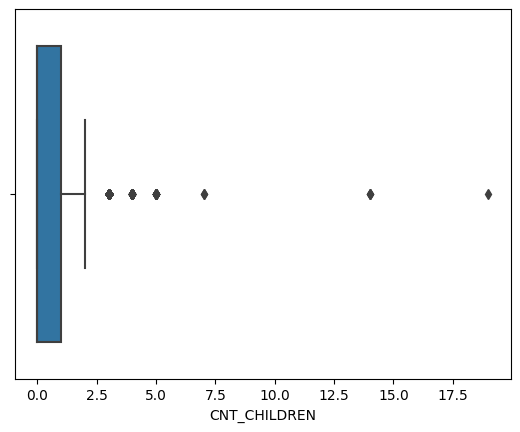

In [ ]:
sns.boxplot(x=df['CNT_CHILDREN'])

<AxesSubplot: xlabel='AMT_INCOME_TOTAL'>

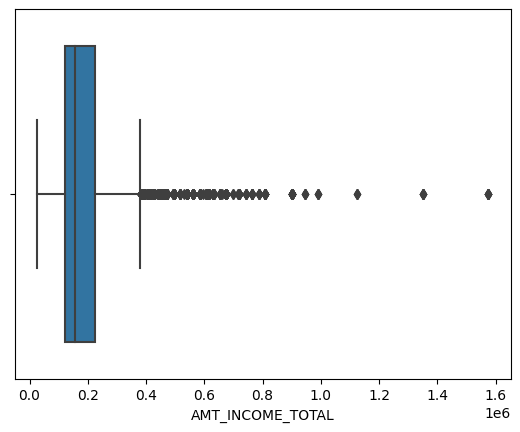

In [ ]:
sns.boxplot(x=df['AMT_INCOME_TOTAL'])

<AxesSubplot: xlabel='CNT_CHILDREN'>

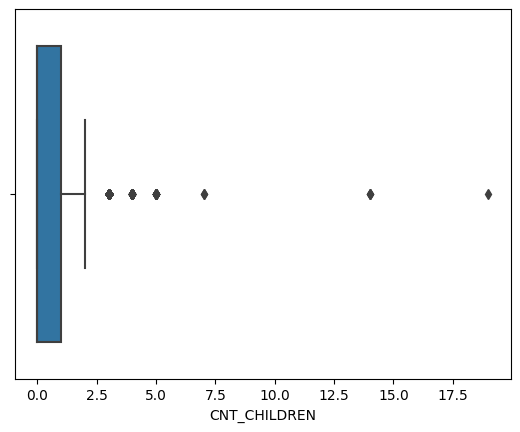

In [ ]:
sns.boxplot(x=df['CNT_CHILDREN'])

<AxesSubplot: xlabel='CNT_FAM_MEMBERS'>

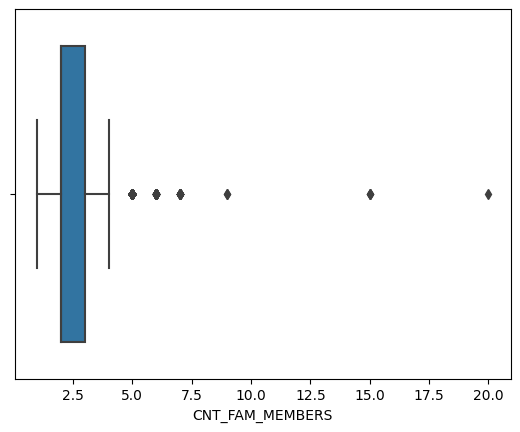

In [ ]:
sns.boxplot(x=df['CNT_FAM_MEMBERS'])

<AxesSubplot: xlabel='CNT_CHILDREN'>

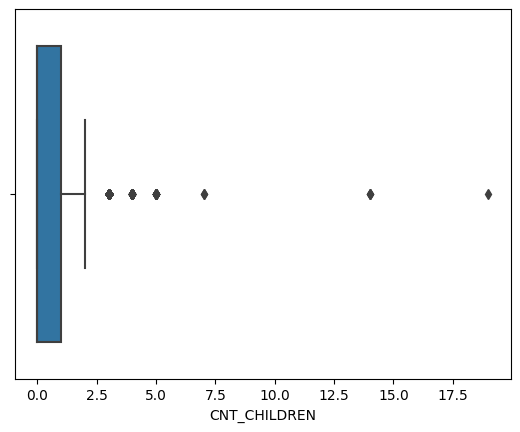

In [ ]:
sns.boxplot(x=df['CNT_CHILDREN'])

In [ ]:
df.isna().sum()

ID                                                   0
CODE_GENDER                                          0
FLAG_OWN_CAR                                         0
FLAG_OWN_REALTY                                      0
CNT_CHILDREN                                         0
AMT_INCOME_TOTAL                                     0
FLAG_WORK_PHONE                                      0
FLAG_PHONE                                           0
FLAG_EMAIL                                           0
CNT_FAM_MEMBERS                                      0
STATUS                                               0
Age                                                  0
Employed_years                                       0
NAME_INCOME_TYPE_Commercial associate                0
NAME_INCOME_TYPE_Pensioner                           0
NAME_INCOME_TYPE_State servant                       0
NAME_INCOME_TYPE_Student                             0
NAME_INCOME_TYPE_Working                             0
NAME_EDUCA

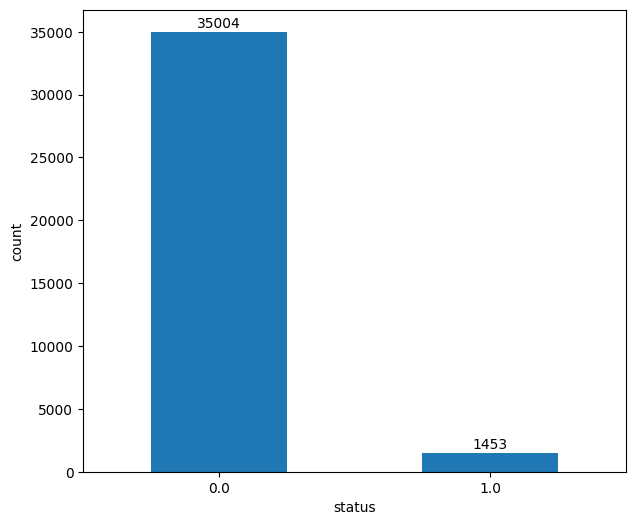

In [ ]:
# credit['STATUS'].value_counts().plot(kind='bar')
import matplotlib.pyplot as plt


status = df['STATUS'].value_counts()
plt.figure(figsize=(7, 6))
ax = status.plot(kind='bar', rot=0)
ax.set_xlabel('status')
ax.set_ylabel('count')

for rect in ax.patches:
    y_value = rect.get_height()
    x_value = rect.get_x() + rect.get_width() / 2
    space = 1
    label = "{:.0f}".format(y_value)
    ax.annotate(label, (x_value, y_value), xytext=(0, space), textcoords="offset points", ha='center', va='bottom')
    plt.grid(False)
plt.show()

# Pycaret Installation

In [ ]:
!pip install pycaret[full]

# Equal Error Rate Calculation



In [ ]:
from sklearn.metrics import make_scorer, roc_curve
from scipy.optimize import brentq
from scipy.interpolate import interp1d

def calculate_eer(y_test, y_pred):
    '''
    Returns the equal error rate for a binary classifier output.
    '''
    fpr, tpr, thresholds = roc_curve(y_test, y_pred, pos_label=1)
    eer = brentq(lambda x : 1. - x - interp1d(fpr, tpr)(x), 0., 1.)
    return eer

In [ ]:
df['STATUS'].value_counts()

0.0    35004
1.0     1453
Name: STATUS, dtype: int64

# Evaluate Models

In [ ]:
from pycaret.classification import *

s = setup(df, target = 'STATUS',normalize = True,ignore_features = ['ID'],session_id = 123)
add_metric('eer', 'eer', calculate_eer,greater_is_better=False)

,Description,Value
0,Session id,123
1,Target,STATUS
2,Target type,Binary
3,Original data shape,"(36457, 52)"
4,Transformed data shape,"(36457, 51)"
5,Transformed train set shape,"(25519, 51)"
6,Transformed test set shape,"(10938, 51)"
7,Ignore features,1
8,Numeric features,50
9,Preprocess,True


Name                                                               eer
Display Name                                                       eer
Score Function       <pycaret.internal.metrics.EncodedDecodedLabels...
Scorer               make_scorer(calculate_eer, greater_is_better=F...
Target                                                            pred
Args                                                                {}
Greater is Better                                                False
Multiclass                                                        True
Custom                                                            True
Name: eer, dtype: object

In [ ]:
get_config()

{'USI',
 'X',
 'X_test',
 'X_test_transformed',
 'X_train',
 'X_train_transformed',
 'X_transformed',
 '_available_plots',
 '_ml_usecase',
 'data',
 'dataset',
 'dataset_transformed',
 'exp_id',
 'exp_name_log',
 'fix_imbalance',
 'fold_generator',
 'fold_groups_param',
 'fold_shuffle_param',
 'gpu_n_jobs_param',
 'gpu_param',
 'html_param',
 'idx',
 'is_multiclass',
 'log_plots_param',
 'logging_param',
 'memory',
 'n_jobs_param',
 'pipeline',
 'seed',
 'target_param',
 'test',
 'test_transformed',
 'train',
 'train_transformed',
 'variable_and_property_keys',
 'variables',
 'y',
 'y_test',
 'y_test_transformed',
 'y_train',
 'y_train_transformed',
 'y_transformed'}

## Get test and train data

In [ ]:
X_train = get_config('X_train')
X_train_transformed = get_config('X_train_transformed')

X_test = get_config('X_test')
X_test_transformed = get_config('X_test_transformed')

Y_train = get_config('y_train')
Y_train_transformed = get_config('y_train_transformed')

Y_test = get_config('y_test')
Y_test_transformed = get_config('y_test_transformed')

In [ ]:
X_test_transformed

,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,FLAG_WORK_PHONE,FLAG_PHONE,FLAG_EMAIL,CNT_FAM_MEMBERS,Age,...,OCCUPATION_TYPE_Laborers,OCCUPATION_TYPE_Low-skill Laborers,OCCUPATION_TYPE_Managers,OCCUPATION_TYPE_Medicine staff,OCCUPATION_TYPE_Private service staff,OCCUPATION_TYPE_Realty agents,OCCUPATION_TYPE_Sales staff,OCCUPATION_TYPE_Secretaries,OCCUPATION_TYPE_Security staff,OCCUPATION_TYPE_Waiters/barmen staff
40526,-0.701980,-0.780785,0.699555,-0.583345,0.155523,1.846334,-0.645096,-0.316160,-1.324572,-1.281609,...,-0.451549,-0.068447,-0.296567,-0.185624,-0.098457,-0.048139,-0.327137,-0.063969,-0.130295,-0.069023
43101,1.424542,-0.780785,0.699555,-0.583345,-0.065989,-0.541614,-0.645096,-0.316160,-1.324572,-1.455664,...,-0.451549,-0.068447,3.371921,-0.185624,-0.098457,-0.048139,-0.327137,-0.063969,-0.130295,-0.069023
15866,-0.701980,-0.780785,-1.429479,0.780127,0.820058,-0.541614,-0.645096,-0.316160,-0.218602,0.110831,...,-0.451549,-0.068447,-0.296567,-0.185624,-0.098457,-0.048139,-0.327137,-0.063969,-0.130295,-0.069023
1784,-0.701980,-0.780785,0.699555,2.143599,-1.173547,1.846334,-0.645096,3.162959,1.993337,-0.237279,...,-0.451549,-0.068447,-0.296567,-0.185624,-0.098457,-0.048139,3.056819,-0.063969,-0.130295,-0.069023
10955,-0.701980,1.280762,0.699555,-0.583345,-1.173547,1.846334,-0.645096,-0.316160,-0.218602,0.110831,...,-0.451549,-0.068447,-0.296567,-0.185624,-0.098457,-0.048139,-0.327137,-0.063969,-0.130295,-0.069023
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
44941,-0.701980,-0.780785,0.699555,-0.583345,-0.730524,1.846334,1.550157,-0.316160,-0.218602,-0.672416,...,-0.451549,-0.068447,-0.296567,-0.185624,-0.098457,-0.048139,-0.327137,-0.063969,-0.130295,14.487955
45029,-0.701980,1.280762,-1.429479,-0.583345,-1.284303,-0.541614,1.550157,-0.316160,-0.218602,1.851382,...,-0.451549,-0.068447,-0.296567,-0.185624,-0.098457,-0.048139,-0.327137,-0.063969,-0.130295,-0.069023
45264,-0.701980,-0.780785,-1.429479,-0.583345,-1.173547,-0.541614,-0.645096,-0.316160,-1.324572,1.938410,...,-0.451549,-0.068447,-0.296567,-0.185624,-0.098457,-0.048139,-0.327137,-0.063969,-0.130295,-0.069023
2800,1.424542,-0.780785,0.699555,-0.583345,-0.429268,-0.541614,1.550157,-0.316160,-0.218602,1.590299,...,-0.451549,-0.068447,-0.296567,-0.185624,-0.098457,-0.048139,-0.327137,-0.063969,-0.130295,-0.069023


In [ ]:
data = pd.merge(X_test_transformed, Y_test_transformed, left_index=True, right_index=True)

In [ ]:
data

,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,FLAG_WORK_PHONE,FLAG_PHONE,FLAG_EMAIL,CNT_FAM_MEMBERS,Age,...,OCCUPATION_TYPE_Low-skill Laborers,OCCUPATION_TYPE_Managers,OCCUPATION_TYPE_Medicine staff,OCCUPATION_TYPE_Private service staff,OCCUPATION_TYPE_Realty agents,OCCUPATION_TYPE_Sales staff,OCCUPATION_TYPE_Secretaries,OCCUPATION_TYPE_Security staff,OCCUPATION_TYPE_Waiters/barmen staff,STATUS
40526,-0.701980,-0.780785,0.699555,-0.583345,0.155523,1.846334,-0.645096,-0.316160,-1.324572,-1.281609,...,-0.068447,-0.296567,-0.185624,-0.098457,-0.048139,-0.327137,-0.063969,-0.130295,-0.069023,0.0
43101,1.424542,-0.780785,0.699555,-0.583345,-0.065989,-0.541614,-0.645096,-0.316160,-1.324572,-1.455664,...,-0.068447,3.371921,-0.185624,-0.098457,-0.048139,-0.327137,-0.063969,-0.130295,-0.069023,0.0
15866,-0.701980,-0.780785,-1.429479,0.780127,0.820058,-0.541614,-0.645096,-0.316160,-0.218602,0.110831,...,-0.068447,-0.296567,-0.185624,-0.098457,-0.048139,-0.327137,-0.063969,-0.130295,-0.069023,0.0
1784,-0.701980,-0.780785,0.699555,2.143599,-1.173547,1.846334,-0.645096,3.162959,1.993337,-0.237279,...,-0.068447,-0.296567,-0.185624,-0.098457,-0.048139,3.056819,-0.063969,-0.130295,-0.069023,0.0
10955,-0.701980,1.280762,0.699555,-0.583345,-1.173547,1.846334,-0.645096,-0.316160,-0.218602,0.110831,...,-0.068447,-0.296567,-0.185624,-0.098457,-0.048139,-0.327137,-0.063969,-0.130295,-0.069023,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
44941,-0.701980,-0.780785,0.699555,-0.583345,-0.730524,1.846334,1.550157,-0.316160,-0.218602,-0.672416,...,-0.068447,-0.296567,-0.185624,-0.098457,-0.048139,-0.327137,-0.063969,-0.130295,14.487955,0.0
45029,-0.701980,1.280762,-1.429479,-0.583345,-1.284303,-0.541614,1.550157,-0.316160,-0.218602,1.851382,...,-0.068447,-0.296567,-0.185624,-0.098457,-0.048139,-0.327137,-0.063969,-0.130295,-0.069023,1.0
45264,-0.701980,-0.780785,-1.429479,-0.583345,-1.173547,-0.541614,-0.645096,-0.316160,-1.324572,1.938410,...,-0.068447,-0.296567,-0.185624,-0.098457,-0.048139,-0.327137,-0.063969,-0.130295,-0.069023,0.0
2800,1.424542,-0.780785,0.699555,-0.583345,-0.429268,-0.541614,1.550157,-0.316160,-0.218602,1.590299,...,-0.068447,-0.296567,-0.185624,-0.098457,-0.048139,-0.327137,-0.063969,-0.130295,-0.069023,0.0


In [ ]:
# data.to_csv('/content/drive/My Drive/MSc-FYP-Data/test_data.csv',index=False)

In [ ]:
test_data = pd.read_csv('/content/drive/My Drive/MSc-FYP-Data/test_data.csv')

In [ ]:
data.shape

(10938, 51)

In [ ]:
test_data.shape

(10938, 51)

In [ ]:
test_data

,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,FLAG_WORK_PHONE,FLAG_PHONE,FLAG_EMAIL,CNT_FAM_MEMBERS,Age,...,OCCUPATION_TYPE_Low-skill Laborers,OCCUPATION_TYPE_Managers,OCCUPATION_TYPE_Medicine staff,OCCUPATION_TYPE_Private service staff,OCCUPATION_TYPE_Realty agents,OCCUPATION_TYPE_Sales staff,OCCUPATION_TYPE_Secretaries,OCCUPATION_TYPE_Security staff,OCCUPATION_TYPE_Waiters/barmen staff,STATUS
0,-0.701980,-0.780785,0.699555,-0.583345,0.155523,1.846334,-0.645096,-0.316160,-1.324572,-1.281609,...,-0.068447,-0.296567,-0.185624,-0.098457,-0.048139,-0.327137,-0.063969,-0.130295,-0.069023,0.0
1,1.424542,-0.780785,0.699555,-0.583345,-0.065989,-0.541614,-0.645096,-0.316160,-1.324572,-1.455664,...,-0.068447,3.371921,-0.185624,-0.098457,-0.048139,-0.327137,-0.063969,-0.130295,-0.069023,0.0
2,-0.701980,-0.780785,-1.429479,0.780127,0.820058,-0.541614,-0.645096,-0.316160,-0.218602,0.110831,...,-0.068447,-0.296567,-0.185624,-0.098457,-0.048139,-0.327137,-0.063969,-0.130295,-0.069023,0.0
3,-0.701980,-0.780785,0.699555,2.143599,-1.173547,1.846334,-0.645096,3.162959,1.993337,-0.237279,...,-0.068447,-0.296567,-0.185624,-0.098457,-0.048139,3.056819,-0.063969,-0.130295,-0.069023,0.0
4,-0.701980,1.280762,0.699555,-0.583345,-1.173547,1.846334,-0.645096,-0.316160,-0.218602,0.110831,...,-0.068447,-0.296567,-0.185624,-0.098457,-0.048139,-0.327137,-0.063969,-0.130295,-0.069023,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10933,-0.701980,-0.780785,0.699555,-0.583345,-0.730523,1.846334,1.550157,-0.316160,-0.218602,-0.672416,...,-0.068447,-0.296567,-0.185624,-0.098457,-0.048139,-0.327137,-0.063969,-0.130295,14.487955,0.0
10934,-0.701980,1.280762,-1.429479,-0.583345,-1.284303,-0.541614,1.550157,-0.316160,-0.218602,1.851382,...,-0.068447,-0.296567,-0.185624,-0.098457,-0.048139,-0.327137,-0.063969,-0.130295,-0.069023,1.0
10935,-0.701980,-0.780785,-1.429479,-0.583345,-1.173547,-0.541614,-0.645096,-0.316160,-1.324572,1.938410,...,-0.068447,-0.296567,-0.185624,-0.098457,-0.048139,-0.327137,-0.063969,-0.130295,-0.069023,0.0
10936,1.424542,-0.780785,0.699555,-0.583345,-0.429268,-0.541614,1.550157,-0.316160,-0.218602,1.590299,...,-0.068447,-0.296567,-0.185624,-0.098457,-0.048139,-0.327137,-0.063969,-0.130295,-0.069023,0.0


## Models Result

In [ ]:
# best = compare_models(sort='F1',include=['rf','dt','xgboost','nb','lr'])
best = compare_models(sort='eer')

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer,TT (Sec)
dt,Decision Tree Classifier,0.9541,0.6919,0.2075,0.3677,0.2642,0.2425,0.2536,0.4457,0.7150
rf,Random Forest Classifier,0.9585,0.7561,0.1898,0.4523,0.2663,0.2487,0.2743,0.4498,3.7790
et,Extra Trees Classifier,0.9587,0.7361,0.1839,0.4567,0.2616,0.2443,0.2717,0.4515,2.7120
xgboost,Extreme Gradient Boosting,0.9620,0.7164,0.1052,0.6450,0.1804,0.1711,0.2494,0.4728,0.7660
catboost,CatBoost Classifier,0.9619,0.6982,0.0787,0.6922,0.1407,0.1337,0.2236,0.4798,11.6560
knn,K Neighbors Classifier,0.9585,0.6721,0.0816,0.4039,0.1346,0.1229,0.1663,0.4799,2.0700
lightgbm,Light Gradient Boosting Machine,0.9617,0.7060,0.0610,0.7216,0.1120,0.1066,0.2012,0.4845,0.8320
qda,Quadratic Discriminant Analysis,0.7372,0.5158,0.2753,0.0527,0.0635,0.0088,0.0159,0.4868,0.3810
lda,Linear Discriminant Analysis,0.9609,0.5753,0.0187,0.9000,0.0366,0.0352,0.1250,0.4953,0.5200
svm,SVM - Linear Kernel,0.9603,0.0000,0.0187,0.7735,0.0356,0.0333,0.1079,0.4954,0.4790


Processing:   0%|          | 0/69 [00:00<?, ?it/s]

In [ ]:
print(best)

DecisionTreeClassifier(ccp_alpha=0.0, class_weight=None, criterion='gini',
                       max_depth=None, max_features=None, max_leaf_nodes=None,
                       min_impurity_decrease=0.0, min_samples_leaf=1,
                       min_samples_split=2, min_weight_fraction_leaf=0.0,
                       random_state=123, splitter='best')


In [ ]:
evaluate_model(best)

interactive(children=(ToggleButtons(description='Plot Type:', icons=('',), options=(('Pipeline Plot', 'pipelin…

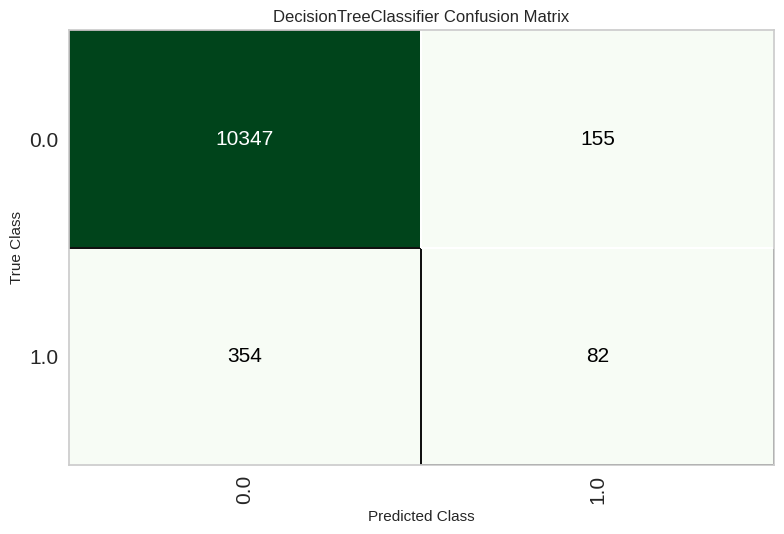

In [ ]:
plot_model(best,plot = 'confusion_matrix')

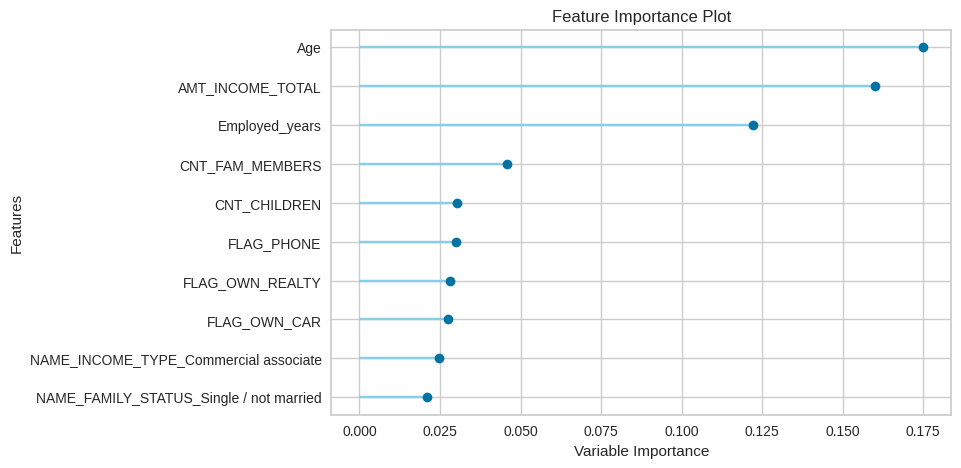

In [ ]:
plot_model(best,plot = 'feature')

## Models Confusion Matrix

In [ ]:
rf = create_model('rf')
et = create_model('et')
xgboost = create_model('xgboost')
catboost = create_model('catboost')
knn = create_model('knn')
lightgbm = create_model('lightgbm')
qda = create_model('qda')
lda = create_model('lda')
svm = create_model('svm')
gbc = create_model('gbc')
svm = create_model('svm')
nb = create_model('nb')
lr = create_model('lr')
ridge = create_model('ridge')
ada = create_model('ada')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9581,0.7913,0.1485,0.4167,0.2190,0.2024,0.2314,0.4620
1,0.9600,0.7450,0.2376,0.4898,0.3200,0.3020,0.3231,0.4351
2,0.9608,0.7480,0.2255,0.5227,0.3151,0.2982,0.3264,0.4386
3,0.9549,0.7936,0.1863,0.3725,0.2484,0.2278,0.2425,0.4519
4,0.9600,0.7480,0.1765,0.5000,0.2609,0.2451,0.2809,0.4534
5,0.9553,0.7170,0.1275,0.3421,0.1857,0.1677,0.1896,0.4685
6,0.9569,0.7910,0.2157,0.4231,0.2857,0.2659,0.2821,0.4426
7,0.9600,0.7003,0.2157,0.5000,0.3014,0.2841,0.3111,0.4418
8,0.9577,0.7591,0.1765,0.4286,0.2500,0.2321,0.2566,0.4541


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9577,0.7723,0.1485,0.4054,0.2174,0.2004,0.2276,0.4621
1,0.9604,0.7498,0.2178,0.5000,0.3034,0.2863,0.3128,0.4411
2,0.9620,0.7349,0.2059,0.5676,0.3022,0.2870,0.3267,0.4442
3,0.9569,0.7777,0.1961,0.4167,0.2667,0.2474,0.2663,0.4485
4,0.9592,0.7268,0.1765,0.4737,0.2571,0.2407,0.2722,0.4536
5,0.9561,0.7035,0.1373,0.3684,0.2000,0.1823,0.2061,0.4656
6,0.9565,0.7544,0.1863,0.4043,0.2550,0.2358,0.2547,0.4515
7,0.9596,0.7099,0.2157,0.4889,0.2993,0.2817,0.3070,0.4419
8,0.9573,0.7366,0.1667,0.4146,0.2378,0.2199,0.2444,0.4570


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9620,0.6864,0.0891,0.6429,0.1565,0.1483,0.2298,0.4772
1,0.9632,0.7271,0.1287,0.6842,0.2167,0.2067,0.2864,0.4662
2,0.9624,0.7097,0.0980,0.7143,0.1724,0.1644,0.2557,0.4746
3,0.9624,0.7391,0.1275,0.6500,0.2131,0.2027,0.2768,0.4667
4,0.9604,0.7003,0.0686,0.5385,0.1217,0.1137,0.1821,0.4828
5,0.9596,0.7399,0.0980,0.4762,0.1626,0.1510,0.2028,0.4753
6,0.9616,0.7544,0.0980,0.6250,0.1695,0.1604,0.2372,0.4748
7,0.9624,0.6892,0.1176,0.6667,0.2000,0.1903,0.2696,0.4694
8,0.9624,0.6915,0.1176,0.6667,0.2000,0.1903,0.2696,0.4694


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9612,0.7004,0.0792,0.5714,0.1391,0.1308,0.2026,0.4800
1,0.9628,0.7004,0.0891,0.7500,0.1593,0.1522,0.2505,0.4770
2,0.9604,0.6922,0.0588,0.5455,0.1062,0.0992,0.1698,0.4854
3,0.9632,0.6979,0.1176,0.7500,0.2034,0.1947,0.2879,0.4692
4,0.9592,0.6980,0.0392,0.4000,0.0714,0.0648,0.1153,0.4906
5,0.9624,0.6951,0.0784,0.8000,0.1429,0.1367,0.2434,0.4798
6,0.9624,0.7260,0.0686,0.8750,0.1273,0.1222,0.2390,0.4823
7,0.9616,0.6893,0.0784,0.6667,0.1404,0.1331,0.2199,0.4800
8,0.9632,0.6698,0.1078,0.7857,0.1897,0.1818,0.2828,0.4718


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9585,0.6674,0.0396,0.3077,0.0702,0.0617,0.0984,0.4908
1,0.9577,0.6830,0.0891,0.3600,0.1429,0.1292,0.1635,0.4783
2,0.9616,0.6723,0.1078,0.6111,0.1833,0.1734,0.2457,0.4722
3,0.9569,0.6970,0.0980,0.3571,0.1538,0.1390,0.1705,0.4761
4,0.9585,0.6667,0.0490,0.3571,0.0862,0.0773,0.1203,0.4884
5,0.9573,0.6586,0.0686,0.3333,0.1138,0.1016,0.1364,0.4837
6,0.9592,0.7148,0.0784,0.4444,0.1333,0.1228,0.1740,0.4806
7,0.9561,0.6397,0.0980,0.3333,0.1515,0.1358,0.1633,0.4763
8,0.9589,0.6505,0.0980,0.4348,0.1600,0.1475,0.1922,0.4756


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9608,0.7077,0.0297,0.6000,0.0566,0.0531,0.1274,0.4927
1,0.9632,0.7131,0.0891,0.8182,0.1607,0.1541,0.2628,0.4769
2,0.9608,0.7191,0.0490,0.6250,0.0909,0.0856,0.1675,0.4877
3,0.9628,0.6985,0.0882,0.8182,0.1593,0.1527,0.2614,0.4771
4,0.9608,0.6981,0.0392,0.6667,0.0741,0.0699,0.1553,0.4902
5,0.9616,0.7117,0.0588,0.7500,0.1091,0.1039,0.2033,0.4851
6,0.9620,0.7167,0.0588,0.8571,0.1101,0.1055,0.2188,0.4850
7,0.9620,0.6917,0.0686,0.7778,0.1261,0.1204,0.2241,0.4824
8,0.9612,0.6907,0.0686,0.6364,0.1239,0.1170,0.2003,0.4826


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.5266,0.5352,0.5446,0.0452,0.0835,0.0112,0.0275,0.4654
1,0.8350,0.5202,0.1782,0.0506,0.0788,0.0182,0.0227,0.4880
2,0.9585,0.5039,0.0098,0.1667,0.0185,0.0141,0.0314,0.4980
3,0.6324,0.5267,0.4118,0.0457,0.0822,0.0110,0.0218,0.4783
4,0.4216,0.4968,0.5784,0.0395,0.0740,-0.0009,-0.0026,0.5028
5,0.9585,0.4992,0.0000,0.0000,0.0000,-0.0030,-0.0081,0.5004
6,0.8315,0.5082,0.1569,0.0444,0.0693,0.0074,0.0093,0.4952
7,0.5831,0.5527,0.5196,0.0496,0.0906,0.0190,0.0418,0.4506
8,0.8045,0.5270,0.2255,0.0519,0.0844,0.0208,0.0280,0.4831


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9616,0.5812,0.0297,1.0000,0.0577,0.0555,0.1690,0.4925
1,0.9612,0.5607,0.0198,1.0000,0.0388,0.0374,0.1380,0.4950
2,0.9608,0.5553,0.0196,1.0000,0.0385,0.0370,0.1373,0.4950
3,0.9604,0.6450,0.0098,1.0000,0.0194,0.0187,0.0970,0.4975
4,0.9600,0.5615,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
5,0.9612,0.5383,0.0294,1.0000,0.0571,0.0550,0.1681,0.4925
6,0.9604,0.5569,0.0098,1.0000,0.0194,0.0187,0.0970,0.4975
7,0.9608,0.5586,0.0196,1.0000,0.0385,0.0370,0.1373,0.4950
8,0.9608,0.5824,0.0196,1.0000,0.0385,0.0370,0.1373,0.4950


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9569,0.0000,0.0396,0.2353,0.0678,0.0570,0.0822,0.4912
1,0.9612,0.0000,0.0198,1.0000,0.0388,0.0374,0.1380,0.4950
2,0.9608,0.0000,0.0196,1.0000,0.0385,0.0370,0.1373,0.4950
3,0.9604,0.0000,0.0098,1.0000,0.0194,0.0187,0.0970,0.4975
4,0.9600,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
5,0.9612,0.0000,0.0294,1.0000,0.0571,0.0550,0.1681,0.4925
6,0.9604,0.0000,0.0098,1.0000,0.0194,0.0187,0.0970,0.4975
7,0.9604,0.0000,0.0098,1.0000,0.0194,0.0187,0.0970,0.4975
8,0.9600,0.0000,0.0196,0.5000,0.0377,0.0348,0.0930,0.4953


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9612,0.6339,0.0297,0.7500,0.0571,0.0543,0.1444,0.4926
1,0.9604,0.6170,0.0198,0.5000,0.0381,0.0352,0.0936,0.4952
2,0.9600,0.6360,0.0098,0.5000,0.0192,0.0177,0.0658,0.4976
3,0.9604,0.6950,0.0294,0.6000,0.0561,0.0525,0.1267,0.4927
4,0.9612,0.6061,0.0294,1.0000,0.0571,0.0550,0.1681,0.4925
5,0.9604,0.6138,0.0196,0.6667,0.0381,0.0359,0.1098,0.4952
6,0.9608,0.6057,0.0196,1.0000,0.0385,0.0370,0.1373,0.4950
7,0.9604,0.5980,0.0098,1.0000,0.0194,0.0187,0.0970,0.4975
8,0.9604,0.6278,0.0098,1.0000,0.0194,0.0187,0.0970,0.4975


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9569,0.0000,0.0396,0.2353,0.0678,0.0570,0.0822,0.4912
1,0.9612,0.0000,0.0198,1.0000,0.0388,0.0374,0.1380,0.4950
2,0.9608,0.0000,0.0196,1.0000,0.0385,0.0370,0.1373,0.4950
3,0.9604,0.0000,0.0098,1.0000,0.0194,0.0187,0.0970,0.4975
4,0.9600,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
5,0.9612,0.0000,0.0294,1.0000,0.0571,0.0550,0.1681,0.4925
6,0.9604,0.0000,0.0098,1.0000,0.0194,0.0187,0.0970,0.4975
7,0.9604,0.0000,0.0098,1.0000,0.0194,0.0187,0.0970,0.4975
8,0.9600,0.0000,0.0196,0.5000,0.0377,0.0348,0.0930,0.4953


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.0674,0.4844,0.9802,0.0400,0.0768,0.0008,0.0115,0.4974
1,0.0572,0.5688,0.9901,0.0399,0.0767,0.0007,0.0129,0.4978
2,0.0549,0.4958,0.9902,0.0402,0.0773,0.0005,0.0096,0.4985
3,0.0600,0.5703,0.9902,0.0404,0.0777,0.0009,0.0157,0.4971
4,0.0564,0.5212,1.0000,0.0406,0.0781,0.0014,0.0264,0.4957
5,0.0607,0.5401,0.9902,0.0404,0.0777,0.0010,0.0165,0.4969
6,0.0580,0.4932,1.0000,0.0407,0.0782,0.0015,0.0276,0.4953
7,0.0615,0.5186,0.9902,0.0405,0.0778,0.0011,0.0173,0.4967
8,0.0584,0.5146,0.9804,0.0400,0.0768,0.0000,0.0005,0.4999


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9604,0.5798,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
1,0.9604,0.5557,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
2,0.9600,0.5590,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
3,0.9600,0.6469,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
4,0.9600,0.5641,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
5,0.9600,0.5395,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
6,0.9600,0.5532,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
7,0.9604,0.5574,0.0098,1.0000,0.0194,0.0187,0.0970,0.4975
8,0.9604,0.5828,0.0098,1.0000,0.0194,0.0187,0.0970,0.4975


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9604,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
1,0.9604,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
2,0.9600,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
3,0.9600,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
4,0.9600,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
5,0.9600,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
6,0.9600,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
7,0.9608,0.0000,0.0196,1.0000,0.0385,0.0370,0.1373,0.4950
8,0.9600,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9604,0.6035,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
1,0.9604,0.5676,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
2,0.9600,0.5942,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
3,0.9600,0.6582,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
4,0.9600,0.5891,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
5,0.9600,0.5577,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
6,0.9596,0.5777,0.0000,0.0000,0.0000,-0.0008,-0.0040,0.5001
7,0.9600,0.5693,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
8,0.9600,0.5935,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

In [ ]:
gbc = create_model('gbc')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9612,0.6339,0.0297,0.7500,0.0571,0.0543,0.1444,0.4926
1,0.9604,0.6170,0.0198,0.5000,0.0381,0.0352,0.0936,0.4952
2,0.9600,0.6360,0.0098,0.5000,0.0192,0.0177,0.0658,0.4976
3,0.9604,0.6950,0.0294,0.6000,0.0561,0.0525,0.1267,0.4927
4,0.9612,0.6061,0.0294,1.0000,0.0571,0.0550,0.1681,0.4925
5,0.9604,0.6138,0.0196,0.6667,0.0381,0.0359,0.1098,0.4952
6,0.9608,0.6057,0.0196,1.0000,0.0385,0.0370,0.1373,0.4950
7,0.9604,0.5980,0.0098,1.0000,0.0194,0.0187,0.0970,0.4975
8,0.9604,0.6278,0.0098,1.0000,0.0194,0.0187,0.0970,0.4975


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

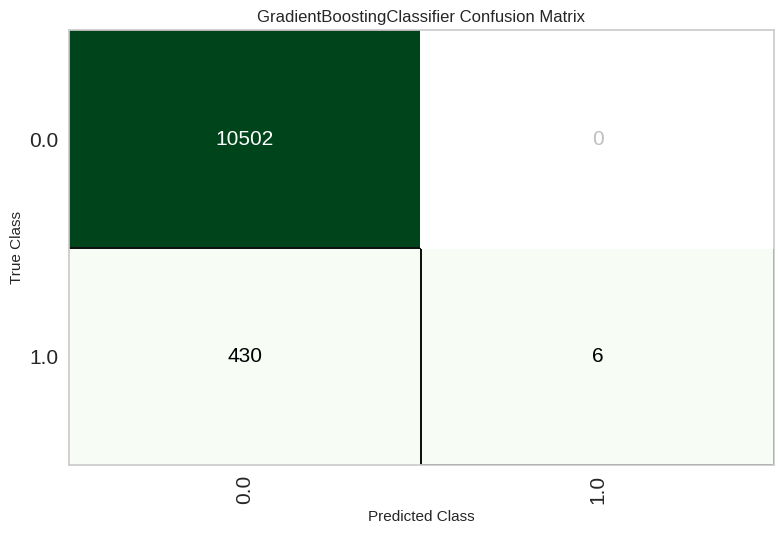

In [ ]:
plot_model(gbc,plot = 'confusion_matrix')

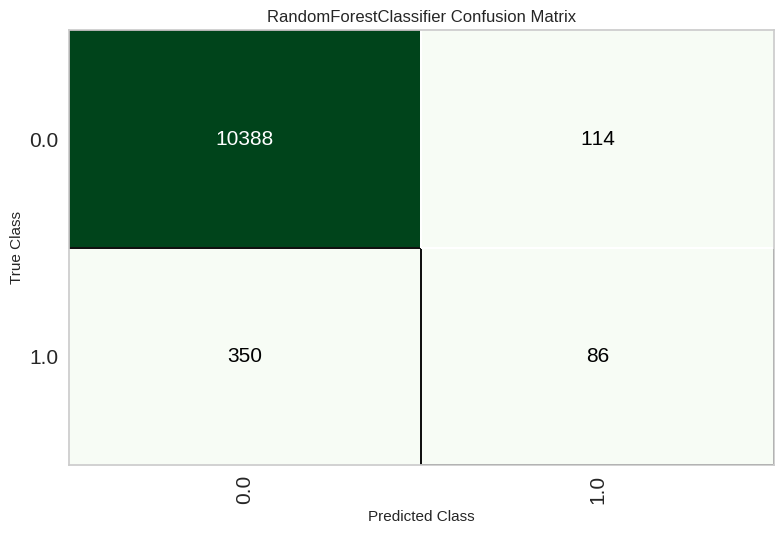

In [ ]:
plot_model(rf,plot = 'confusion_matrix')

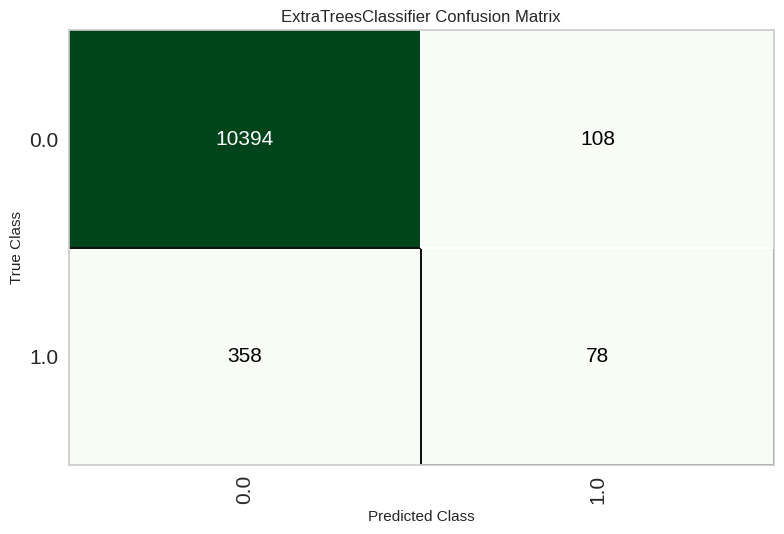

In [ ]:
plot_model(et,plot = 'confusion_matrix')

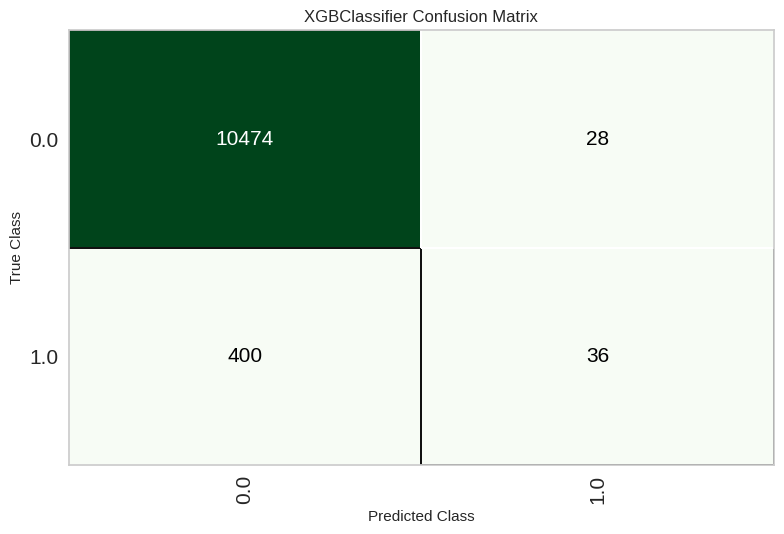

In [ ]:
plot_model(xgboost,plot = 'confusion_matrix')

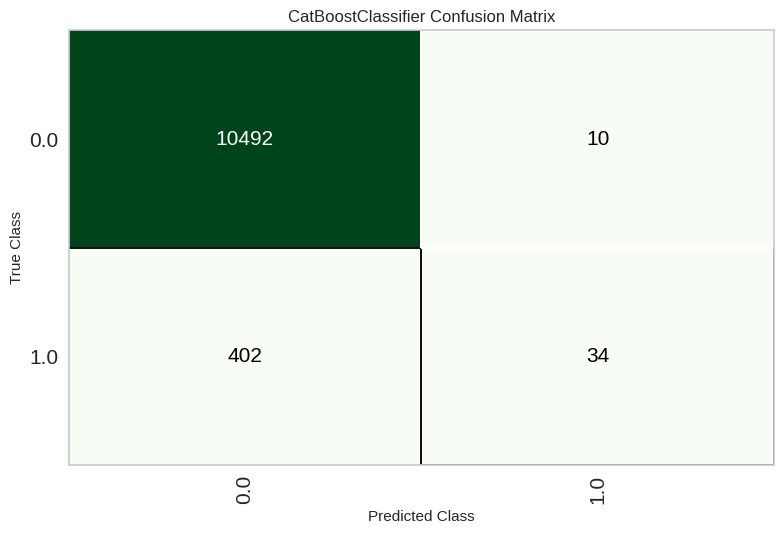

In [ ]:
plot_model(catboost,plot = 'confusion_matrix')

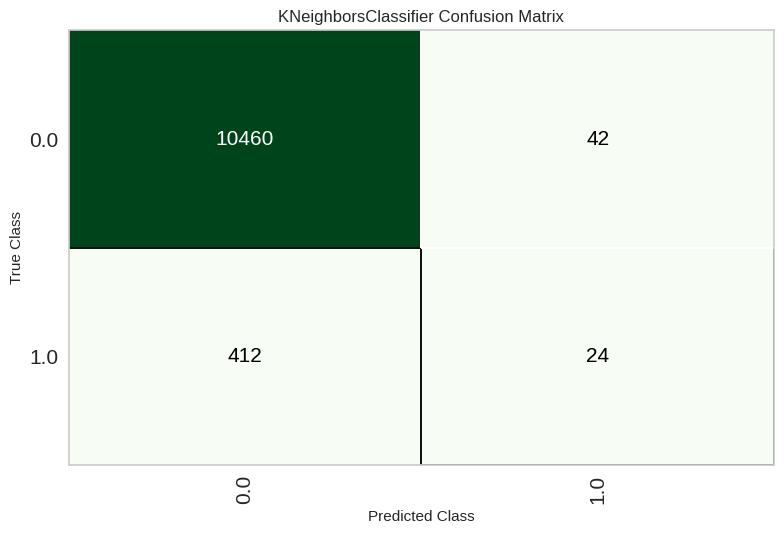

In [ ]:
plot_model(knn,plot = 'confusion_matrix')

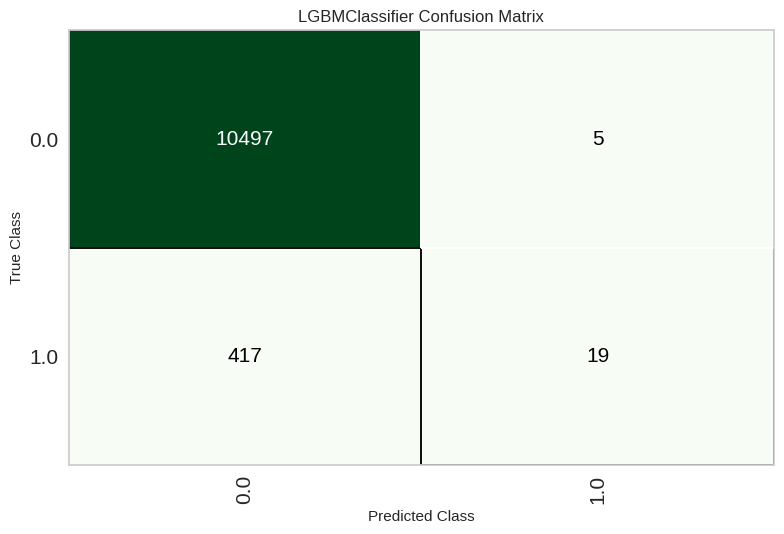

In [ ]:
plot_model(lightgbm,plot = 'confusion_matrix')

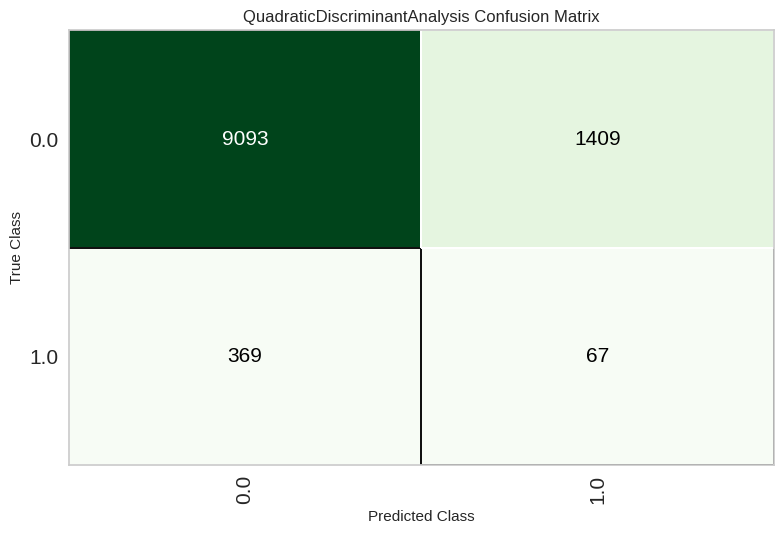

In [ ]:
plot_model(qda,plot = 'confusion_matrix')

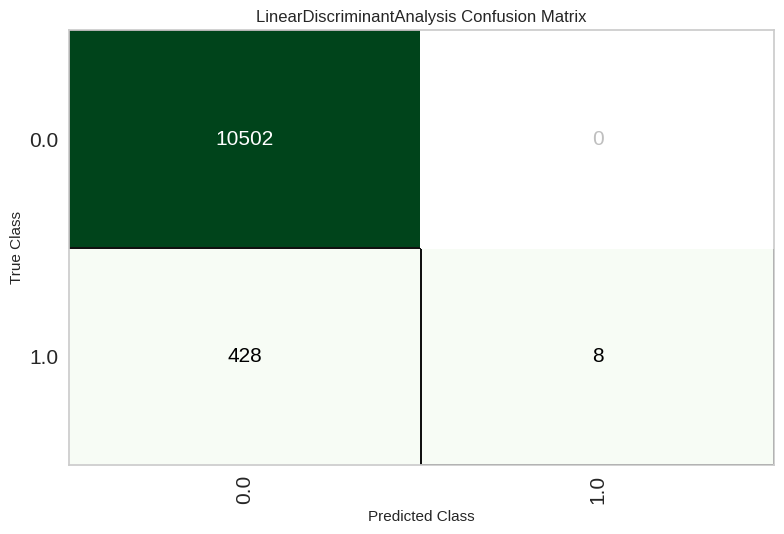

In [ ]:
plot_model(lda,plot = 'confusion_matrix')

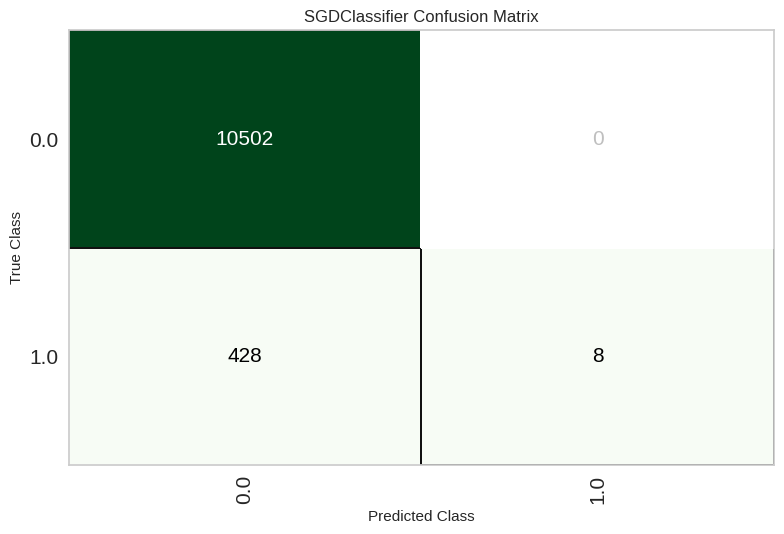

In [ ]:
plot_model(svm,plot = 'confusion_matrix')

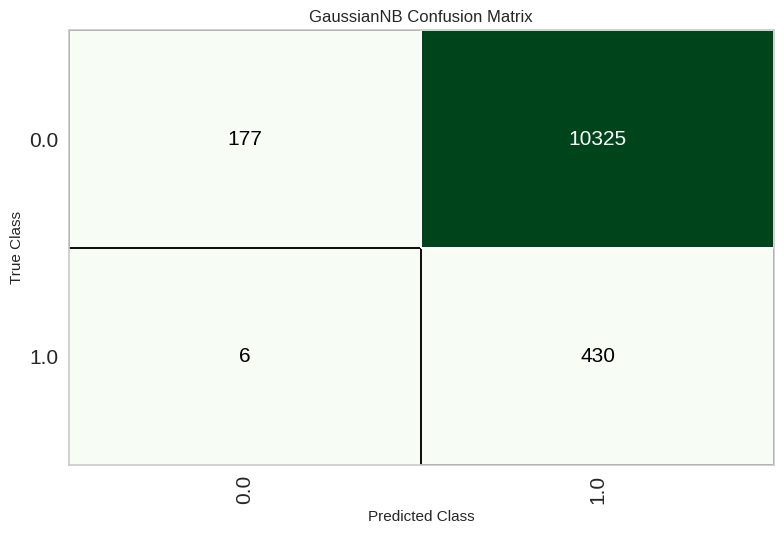

In [ ]:
plot_model(nb,plot = 'confusion_matrix')

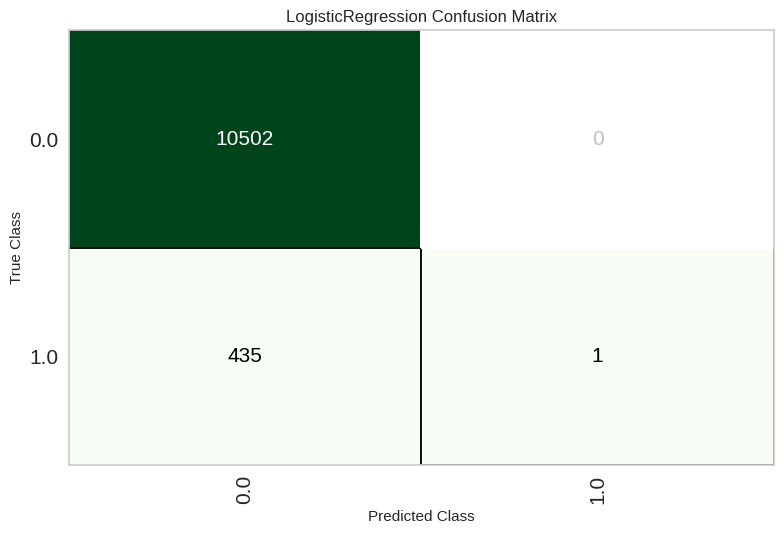

In [ ]:
plot_model(lr,plot = 'confusion_matrix')

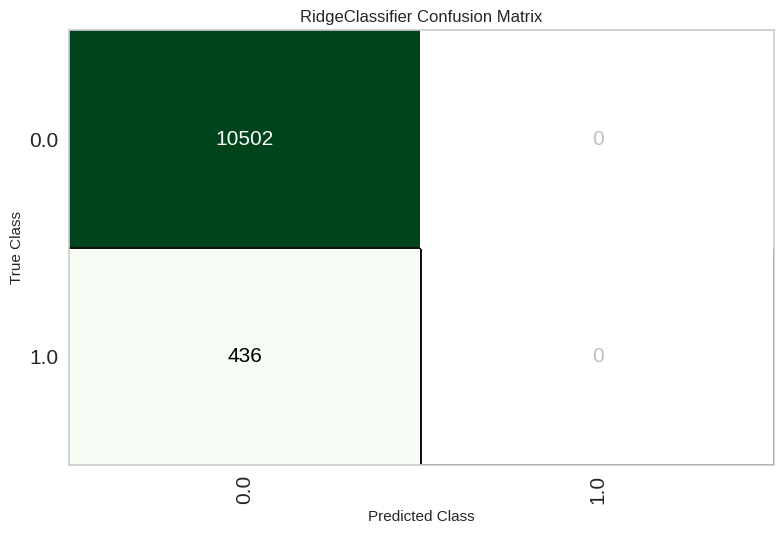

In [ ]:
plot_model(ridge,plot = 'confusion_matrix')

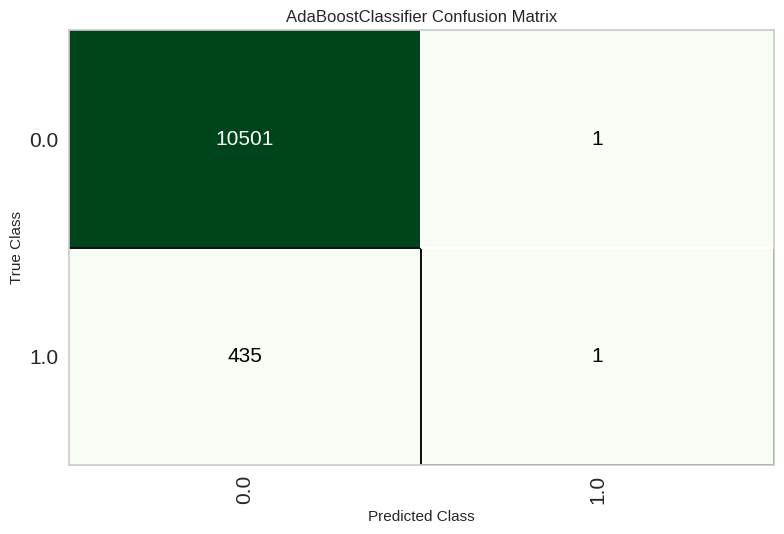

In [ ]:
plot_model(ada,plot = 'confusion_matrix')

## Tune Models

### Decision Tree

In [ ]:
dt = create_model('dt')

tuned_dt, tuner = tune_model(dt,optimize = 'eer',return_tuner=True,choose_better = True)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9538,0.6940,0.1782,0.3396,0.2338,0.2123,0.2241,0.4547
1,0.9542,0.7010,0.2376,0.3750,0.2909,0.2684,0.2759,0.4366
2,0.9549,0.6883,0.2255,0.3898,0.2857,0.2642,0.2748,0.4401
3,0.9522,0.7038,0.1961,0.3333,0.2469,0.2239,0.2324,0.4497
4,0.9573,0.6813,0.1961,0.4255,0.2685,0.2495,0.2696,0.4484
5,0.9502,0.6951,0.1765,0.2951,0.2209,0.1968,0.2038,0.4560
6,0.9534,0.7279,0.2059,0.3559,0.2609,0.2386,0.2481,0.4465
7,0.9542,0.6948,0.2745,0.3944,0.3237,0.3008,0.3061,0.4248
8,0.9526,0.6734,0.1863,0.3333,0.2390,0.2165,0.2264,0.4525


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9600,0.6183,0.0297,0.4286,0.0556,0.0507,0.1046,0.4929
1,0.9600,0.6197,0.0198,0.4000,0.0377,0.0341,0.0819,0.4953
2,0.9600,0.6171,0.0490,0.5000,0.0893,0.0827,0.1473,0.4879
3,0.9585,0.6295,0.0490,0.3571,0.0862,0.0773,0.1203,0.4884
4,0.9589,0.6003,0.0098,0.2000,0.0187,0.0150,0.0362,0.4979
5,0.9585,0.5668,0.0294,0.3000,0.0536,0.0468,0.0833,0.4933
6,0.9596,0.6150,0.0294,0.4286,0.0550,0.0502,0.1040,0.4929
7,0.9589,0.6450,0.0392,0.3636,0.0708,0.0635,0.1087,0.4907
8,0.9604,0.5958,0.0490,0.5556,0.0901,0.0842,0.1566,0.4878


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 10 candidates, totalling 100 fits


Original model was better than the tuned model, hence it will be returned. NOTE: The display metrics are for the tuned model (not the original one).


In [ ]:
print(dt)
print(tuned_dt)

DecisionTreeClassifier(ccp_alpha=0.0, class_weight=None, criterion='gini',
                       max_depth=None, max_features=None, max_leaf_nodes=None,
                       min_impurity_decrease=0.0, min_samples_leaf=1,
                       min_samples_split=2, min_weight_fraction_leaf=0.0,
                       random_state=123, splitter='best')
DecisionTreeClassifier(ccp_alpha=0.0, class_weight=None, criterion='gini',
                       max_depth=None, max_features=None, max_leaf_nodes=None,
                       min_impurity_decrease=0.0, min_samples_leaf=1,
                       min_samples_split=2, min_weight_fraction_leaf=0.0,
                       random_state=123, splitter='best')


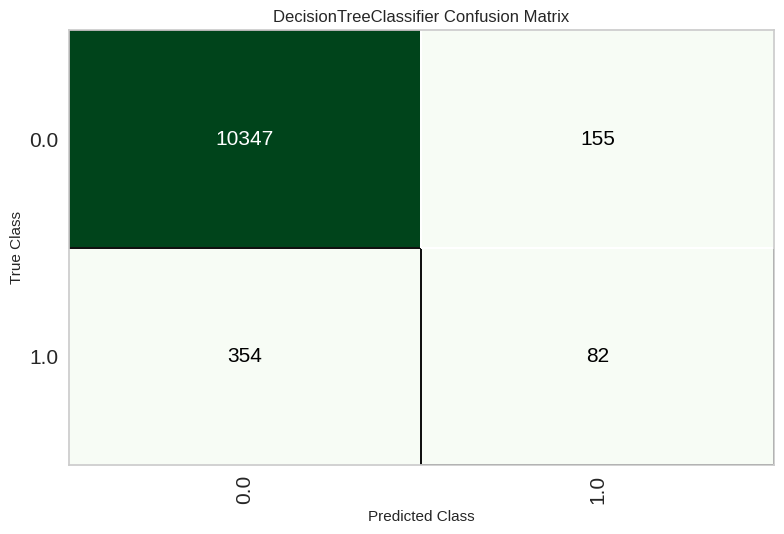

In [ ]:
plot_model(tuned_dt,plot = 'confusion_matrix')

### Randomn Forest

In [ ]:
rf = create_model('rf')

tuned_rf, tuner = tune_model(rf,optimize = 'eer',return_tuner=True,choose_better = True)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9581,0.7913,0.1485,0.4167,0.2190,0.2024,0.2314,0.4620
1,0.9600,0.7450,0.2376,0.4898,0.3200,0.3020,0.3231,0.4351
2,0.9608,0.7480,0.2255,0.5227,0.3151,0.2982,0.3264,0.4386
3,0.9549,0.7936,0.1863,0.3725,0.2484,0.2278,0.2425,0.4519
4,0.9600,0.7480,0.1765,0.5000,0.2609,0.2451,0.2809,0.4534
5,0.9553,0.7170,0.1275,0.3421,0.1857,0.1677,0.1896,0.4685
6,0.9569,0.7910,0.2157,0.4231,0.2857,0.2659,0.2821,0.4426
7,0.9600,0.7003,0.2157,0.5000,0.3014,0.2841,0.3111,0.4418
8,0.9577,0.7591,0.1765,0.4286,0.2500,0.2321,0.2566,0.4541


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.6611,0.6252,0.5545,0.0639,0.1146,0.0470,0.0903,0.4010
1,0.6642,0.5709,0.3663,0.0446,0.0795,0.0096,0.0178,0.4837
2,0.6575,0.5644,0.4118,0.0491,0.0877,0.0175,0.0330,0.4683
3,0.6712,0.6668,0.5784,0.0690,0.1233,0.0559,0.1052,0.3844
4,0.6536,0.5655,0.4706,0.0547,0.0980,0.0284,0.0544,0.4446
5,0.6540,0.5555,0.3725,0.0443,0.0792,0.0084,0.0159,0.4852
6,0.6885,0.5879,0.4412,0.0575,0.1017,0.0333,0.0594,0.4444
7,0.6548,0.5695,0.3922,0.0466,0.0832,0.0127,0.0240,0.4773
8,0.6614,0.5850,0.4314,0.0518,0.0924,0.0227,0.0426,0.4587


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 10 candidates, totalling 100 fits


In [ ]:
print(rf)
print(tuned_rf)

RandomForestClassifier(bootstrap=True, ccp_alpha=0.0, class_weight=None,
                       criterion='gini', max_depth=None, max_features='sqrt',
                       max_leaf_nodes=None, max_samples=None,
                       min_impurity_decrease=0.0, min_samples_leaf=1,
                       min_samples_split=2, min_weight_fraction_leaf=0.0,
                       n_estimators=100, n_jobs=-1, oob_score=False,
                       random_state=123, verbose=0, warm_start=False)
RandomForestClassifier(bootstrap=False, ccp_alpha=0.0,
                       class_weight='balanced_subsample', criterion='gini',
                       max_depth=4, max_features='sqrt', max_leaf_nodes=None,
                       max_samples=None, min_impurity_decrease=0.0005,
                       min_samples_leaf=3, min_samples_split=5,
                       min_weight_fraction_leaf=0.0, n_estimators=260,
                       n_jobs=-1, oob_score=False, random_state=123, verbose=0,
         

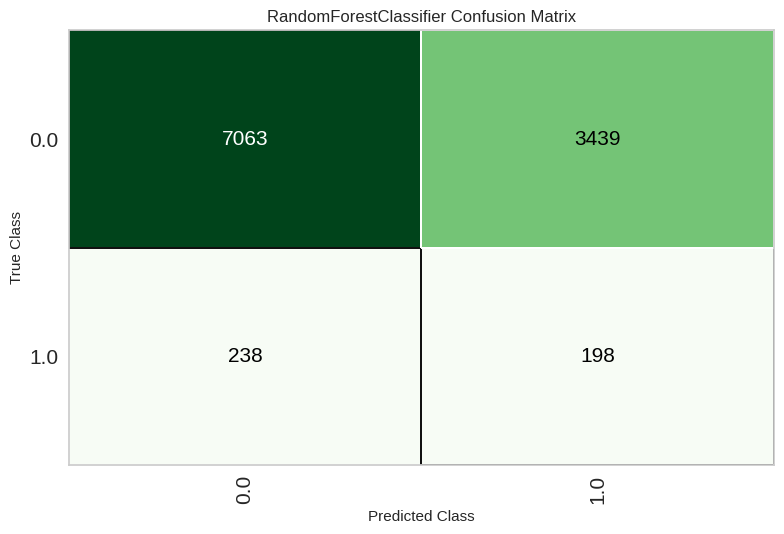

In [ ]:
plot_model(tuned_rf,plot = 'confusion_matrix')

### Extra Trees Classifier

In [ ]:
et = create_model('et')

tuned_et, tuner = tune_model(et,optimize = 'eer',return_tuner=True,choose_better = True)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9577,0.7723,0.1485,0.4054,0.2174,0.2004,0.2276,0.4621
1,0.9604,0.7498,0.2178,0.5000,0.3034,0.2863,0.3128,0.4411
2,0.9620,0.7349,0.2059,0.5676,0.3022,0.2870,0.3267,0.4442
3,0.9569,0.7777,0.1961,0.4167,0.2667,0.2474,0.2663,0.4485
4,0.9592,0.7268,0.1765,0.4737,0.2571,0.2407,0.2722,0.4536
5,0.9561,0.7035,0.1373,0.3684,0.2000,0.1823,0.2061,0.4656
6,0.9565,0.7544,0.1863,0.4043,0.2550,0.2358,0.2547,0.4515
7,0.9596,0.7099,0.2157,0.4889,0.2993,0.2817,0.3070,0.4419
8,0.9573,0.7366,0.1667,0.4146,0.2378,0.2199,0.2444,0.4570


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.6775,0.5946,0.4455,0.0554,0.0986,0.0303,0.0555,0.4466
1,0.6446,0.5497,0.4554,0.0512,0.0921,0.0225,0.0440,0.4550
2,0.6023,0.5516,0.5000,0.0502,0.0913,0.0201,0.0426,0.4519
3,0.6144,0.6323,0.5686,0.0581,0.1055,0.0355,0.0742,0.4117
4,0.6054,0.5586,0.4804,0.0489,0.0887,0.0174,0.0365,0.4597
5,0.6238,0.5427,0.4902,0.0522,0.0943,0.0238,0.0484,0.4475
6,0.6755,0.5838,0.4314,0.0541,0.0961,0.0269,0.0492,0.4533
7,0.6579,0.5257,0.3627,0.0438,0.0781,0.0073,0.0137,0.4874
8,0.6321,0.5639,0.4608,0.0505,0.0910,0.0204,0.0407,0.4576


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 10 candidates, totalling 100 fits


In [ ]:
print(et)
print(tuned_et)

ExtraTreesClassifier(bootstrap=False, ccp_alpha=0.0, class_weight=None,
                     criterion='gini', max_depth=None, max_features='sqrt',
                     max_leaf_nodes=None, max_samples=None,
                     min_impurity_decrease=0.0, min_samples_leaf=1,
                     min_samples_split=2, min_weight_fraction_leaf=0.0,
                     n_estimators=100, n_jobs=-1, oob_score=False,
                     random_state=123, verbose=0, warm_start=False)
ExtraTreesClassifier(bootstrap=False, ccp_alpha=0.0,
                     class_weight='balanced_subsample', criterion='gini',
                     max_depth=4, max_features='sqrt', max_leaf_nodes=None,
                     max_samples=None, min_impurity_decrease=0.0005,
                     min_samples_leaf=3, min_samples_split=5,
                     min_weight_fraction_leaf=0.0, n_estimators=260, n_jobs=-1,
                     oob_score=False, random_state=123, verbose=0,
                     warm_start=Fals

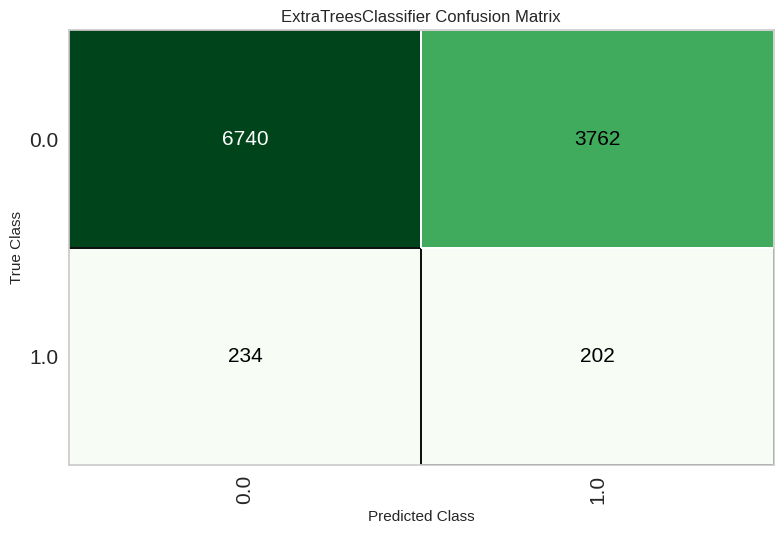

In [ ]:
plot_model(tuned_et,plot = 'confusion_matrix')

### XGBoost

In [ ]:
xg = create_model('xgboost')

tuned_xg, tuner = tune_model(xg,optimize = 'eer',return_tuner=True,choose_better = True)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9620,0.6864,0.0891,0.6429,0.1565,0.1483,0.2298,0.4772
1,0.9632,0.7271,0.1287,0.6842,0.2167,0.2067,0.2864,0.4662
2,0.9624,0.7097,0.0980,0.7143,0.1724,0.1644,0.2557,0.4746
3,0.9624,0.7391,0.1275,0.6500,0.2131,0.2027,0.2768,0.4667
4,0.9604,0.7003,0.0686,0.5385,0.1217,0.1137,0.1821,0.4828
5,0.9596,0.7399,0.0980,0.4762,0.1626,0.1510,0.2028,0.4753
6,0.9616,0.7544,0.0980,0.6250,0.1695,0.1604,0.2372,0.4748
7,0.9624,0.6892,0.1176,0.6667,0.2000,0.1903,0.2696,0.4694
8,0.9624,0.6915,0.1176,0.6667,0.2000,0.1903,0.2696,0.4694


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.8891,0.6741,0.4752,0.1727,0.2533,0.2073,0.2387,0.3667
1,0.8993,0.7059,0.4653,0.1880,0.2678,0.2241,0.2509,0.3683
2,0.8938,0.7228,0.5000,0.1882,0.2735,0.2287,0.2608,0.3546
3,0.8766,0.7243,0.4902,0.1597,0.2410,0.1923,0.2286,0.3635
4,0.8930,0.7137,0.4314,0.1699,0.2438,0.1978,0.2229,0.3840
5,0.8942,0.7347,0.4706,0.1818,0.2623,0.2172,0.2460,0.3673
6,0.8934,0.7457,0.5490,0.1986,0.2917,0.2475,0.2854,0.3319
7,0.8989,0.7200,0.4608,0.1880,0.2670,0.2229,0.2490,0.3702
8,0.8942,0.6874,0.4412,0.1744,0.2500,0.2044,0.2302,0.3797


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 10 candidates, totalling 100 fits


In [ ]:
print(xg)
print(tuned_xg)

XGBClassifier(base_score=None, booster='gbtree', callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, device='cpu', early_stopping_rounds=None,
              enable_categorical=False, eval_metric=None, feature_types=None,
              gamma=None, grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=None, max_bin=None,
              max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=None, max_leaves=None,
              min_child_weight=None, missing=nan, monotone_constraints=None,
              multi_strategy=None, n_estimators=None, n_jobs=-1,
              num_parallel_tree=None, objective='binary:logistic', ...)
XGBClassifier(base_score=None, booster='gbtree', callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=0.9, device='cpu', early_stopping_rounds=None,
              enable_cate

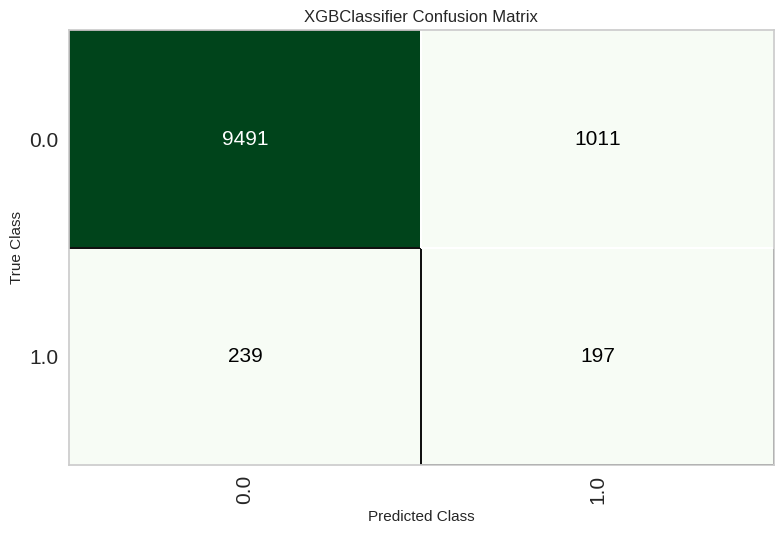

In [ ]:
plot_model(tuned_xg,plot = 'confusion_matrix')

### CatBoost

In [ ]:
cb = create_model('catboost')

tuned_cb, tuner = tune_model(cb,optimize = 'eer',return_tuner=True,choose_better = True)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9612,0.7004,0.0792,0.5714,0.1391,0.1308,0.2026,0.4800
1,0.9628,0.7004,0.0891,0.7500,0.1593,0.1522,0.2505,0.4770
2,0.9604,0.6922,0.0588,0.5455,0.1062,0.0992,0.1698,0.4854
3,0.9632,0.6979,0.1176,0.7500,0.2034,0.1947,0.2879,0.4692
4,0.9592,0.6980,0.0392,0.4000,0.0714,0.0648,0.1153,0.4906
5,0.9624,0.6951,0.0784,0.8000,0.1429,0.1367,0.2434,0.4798
6,0.9624,0.7260,0.0686,0.8750,0.1273,0.1222,0.2390,0.4823
7,0.9616,0.6893,0.0784,0.6667,0.1404,0.1331,0.2199,0.4800
8,0.9632,0.6698,0.1078,0.7857,0.1897,0.1818,0.2828,0.4718


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9600,0.7010,0.0594,0.4615,0.1053,0.0971,0.1549,0.4854
1,0.9628,0.7215,0.1188,0.6667,0.2017,0.1920,0.2711,0.4690
2,0.9612,0.7080,0.0882,0.6000,0.1538,0.1451,0.2198,0.4775
3,0.9628,0.7229,0.1176,0.7059,0.2017,0.1925,0.2784,0.4693
4,0.9592,0.7036,0.0294,0.3750,0.0545,0.0490,0.0959,0.4930
5,0.9624,0.7236,0.1275,0.6500,0.2131,0.2027,0.2768,0.4667
6,0.9624,0.7556,0.1078,0.6875,0.1864,0.1775,0.2626,0.4720
7,0.9616,0.6885,0.0980,0.6250,0.1695,0.1604,0.2372,0.4748
8,0.9632,0.6765,0.1275,0.7222,0.2167,0.2072,0.2935,0.4665


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 10 candidates, totalling 100 fits


In [ ]:
print(cb)
print(tuned_cb)

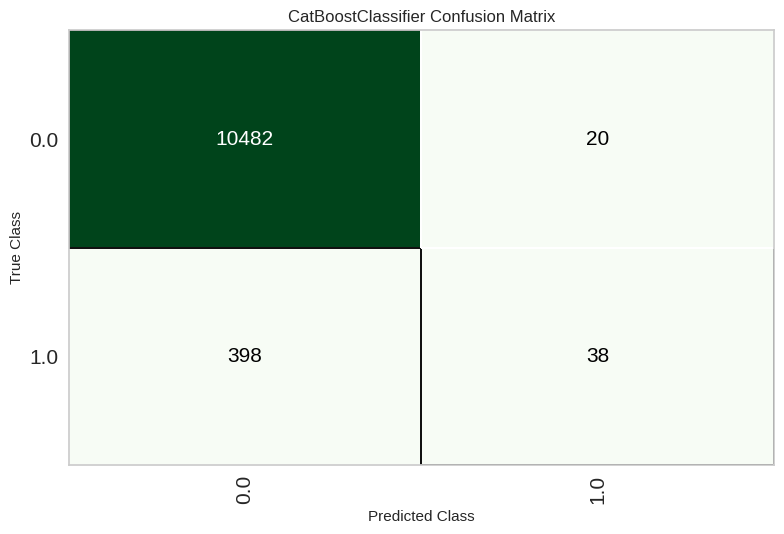

In [ ]:
plot_model(tuned_cb,plot = 'confusion_matrix')

### KNN

In [ ]:
knn = create_model('knn')

tuned_knn, tuner = tune_model(knn,optimize = 'eer',return_tuner=True,choose_better = True,n_iter = 50)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9585,0.6674,0.0396,0.3077,0.0702,0.0617,0.0984,0.4908
1,0.9577,0.6830,0.0891,0.3600,0.1429,0.1292,0.1635,0.4783
2,0.9616,0.6723,0.1078,0.6111,0.1833,0.1734,0.2457,0.4722
3,0.9569,0.6970,0.0980,0.3571,0.1538,0.1390,0.1705,0.4761
4,0.9585,0.6667,0.0490,0.3571,0.0862,0.0773,0.1203,0.4884
5,0.9573,0.6586,0.0686,0.3333,0.1138,0.1016,0.1364,0.4837
6,0.9592,0.7148,0.0784,0.4444,0.1333,0.1228,0.1740,0.4806
7,0.9561,0.6397,0.0980,0.3333,0.1515,0.1358,0.1633,0.4763
8,0.9589,0.6505,0.0980,0.4348,0.1600,0.1475,0.1922,0.4756


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9522,0.6744,0.1683,0.3091,0.2179,0.1955,0.2052,0.4579
1,0.9589,0.6988,0.2376,0.4615,0.3137,0.2948,0.3121,0.4354
2,0.9573,0.6815,0.2353,0.4364,0.3057,0.2857,0.3003,0.4365
3,0.9534,0.6972,0.2353,0.3692,0.2874,0.2645,0.2717,0.4375
4,0.9553,0.6731,0.1961,0.3846,0.2597,0.2392,0.2537,0.4489
5,0.9526,0.6408,0.1471,0.3061,0.1987,0.1773,0.1901,0.4638
6,0.9530,0.6979,0.2255,0.3594,0.2771,0.2541,0.2615,0.4406
7,0.9538,0.6614,0.2353,0.3750,0.2892,0.2666,0.2743,0.4374
8,0.9534,0.6465,0.1765,0.3396,0.2323,0.2107,0.2228,0.4552


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 50 candidates, totalling 500 fits


In [ ]:
print(knn)
print(tuned_knn)

KNeighborsClassifier(algorithm='auto', leaf_size=30, metric='minkowski',
                     metric_params=None, n_jobs=-1, n_neighbors=5, p=2,
                     weights='uniform')
KNeighborsClassifier(algorithm='auto', leaf_size=30, metric='manhattan',
                     metric_params=None, n_jobs=-1, n_neighbors=3, p=2,
                     weights='distance')


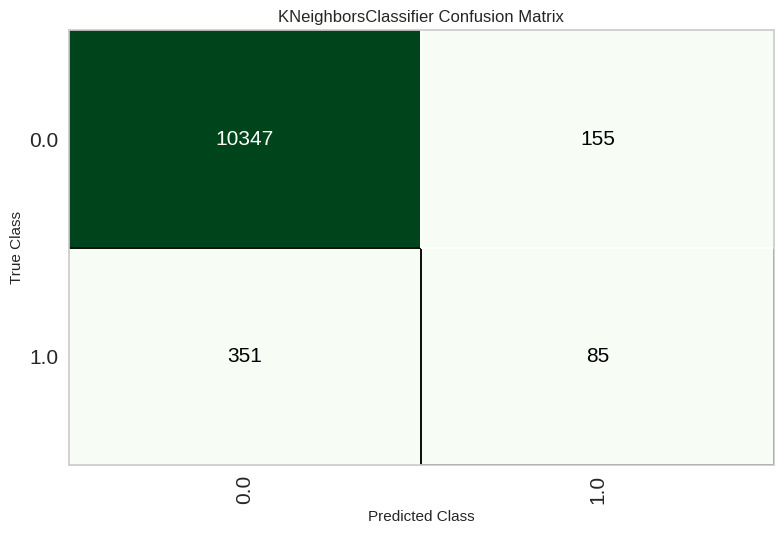

In [ ]:
plot_model(tuned_knn,plot = 'confusion_matrix')

### LightGBM

In [ ]:
lgbm = create_model('lightgbm')

tuned_lgbm, tuner = tune_model(lgbm,optimize = 'eer',return_tuner=True,choose_better = True,n_iter = 50)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9608,0.7077,0.0297,0.6000,0.0566,0.0531,0.1274,0.4927
1,0.9632,0.7131,0.0891,0.8182,0.1607,0.1541,0.2628,0.4769
2,0.9608,0.7191,0.0490,0.6250,0.0909,0.0856,0.1675,0.4877
3,0.9628,0.6985,0.0882,0.8182,0.1593,0.1527,0.2614,0.4771
4,0.9608,0.6981,0.0392,0.6667,0.0741,0.0699,0.1553,0.4902
5,0.9616,0.7117,0.0588,0.7500,0.1091,0.1039,0.2033,0.4851
6,0.9620,0.7167,0.0588,0.8571,0.1101,0.1055,0.2188,0.4850
7,0.9620,0.6917,0.0686,0.7778,0.1261,0.1204,0.2241,0.4824
8,0.9612,0.6907,0.0686,0.6364,0.1239,0.1170,0.2003,0.4826


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9592,0.6985,0.2178,0.4681,0.2973,0.2792,0.3011,0.4414
1,0.9596,0.7365,0.2772,0.4828,0.3522,0.3329,0.3467,0.4225
2,0.9608,0.7259,0.2353,0.5217,0.3243,0.3071,0.3332,0.4355
3,0.9553,0.7497,0.2549,0.4062,0.3133,0.2914,0.2999,0.4308
4,0.9596,0.6677,0.2353,0.4898,0.3179,0.2997,0.3213,0.4359
5,0.9549,0.7235,0.1961,0.3774,0.2581,0.2372,0.2508,0.4490
6,0.9565,0.7488,0.2451,0.4237,0.3106,0.2898,0.3014,0.4336
7,0.9600,0.7228,0.2549,0.5000,0.3377,0.3193,0.3387,0.4296
8,0.9592,0.7579,0.2549,0.4815,0.3333,0.3144,0.3314,0.4298


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 50 candidates, totalling 500 fits


In [ ]:
print(lgbm)
print(tuned_lgbm)

LGBMClassifier(boosting_type='gbdt', class_weight=None, colsample_bytree=1.0,
               importance_type='split', learning_rate=0.1, max_depth=-1,
               min_child_samples=20, min_child_weight=0.001, min_split_gain=0.0,
               n_estimators=100, n_jobs=-1, num_leaves=31, objective=None,
               random_state=123, reg_alpha=0.0, reg_lambda=0.0, subsample=1.0,
               subsample_for_bin=200000, subsample_freq=0)
LGBMClassifier(bagging_fraction=0.7, bagging_freq=1, boosting_type='gbdt',
               class_weight=None, colsample_bytree=1.0, feature_fraction=0.5,
               importance_type='split', learning_rate=0.4, max_depth=-1,
               min_child_samples=61, min_child_weight=0.001, min_split_gain=0,
               n_estimators=200, n_jobs=-1, num_leaves=200, objective=None,
               random_state=123, reg_alpha=0.4, reg_lambda=0.01, subsample=1.0,
               subsample_for_bin=200000, subsample_freq=0)


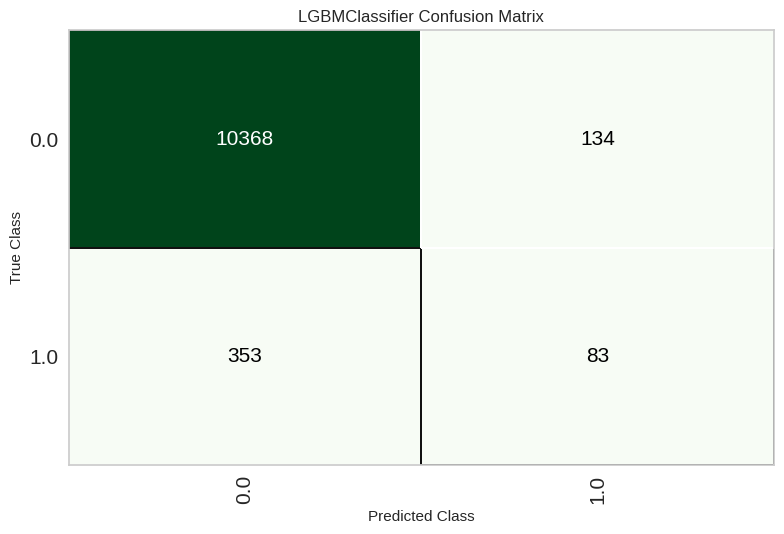

In [ ]:
plot_model(tuned_lgbm,plot = 'confusion_matrix')

### Quadratic Discriminant

In [ ]:
qda = create_model('qda')

tuned_qda, tuner = tune_model(qda,optimize = 'eer',return_tuner=True,choose_better = True,n_iter = 50)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.5266,0.5352,0.5446,0.0452,0.0835,0.0112,0.0275,0.4654
1,0.8350,0.5202,0.1782,0.0506,0.0788,0.0182,0.0227,0.4880
2,0.9585,0.5039,0.0098,0.1667,0.0185,0.0141,0.0314,0.4980
3,0.6324,0.5267,0.4118,0.0457,0.0822,0.0110,0.0218,0.4783
4,0.4216,0.4968,0.5784,0.0395,0.0740,-0.0009,-0.0026,0.5028
5,0.9585,0.4992,0.0000,0.0000,0.0000,-0.0030,-0.0081,0.5004
6,0.8315,0.5082,0.1569,0.0444,0.0693,0.0074,0.0093,0.4952
7,0.5831,0.5527,0.5196,0.0496,0.0906,0.0190,0.0418,0.4506
8,0.8045,0.5270,0.2255,0.0519,0.0844,0.0208,0.0280,0.4831


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.6603,0.5118,0.3465,0.0419,0.0747,0.0044,0.0082,0.4926
1,0.7845,0.6016,0.3267,0.0641,0.1071,0.0439,0.0632,0.4560
2,0.4749,0.6021,0.6765,0.0501,0.0934,0.0205,0.0562,0.4409
3,0.6599,0.6254,0.5196,0.0608,0.1088,0.0401,0.0765,0.4192
4,0.8100,0.5403,0.1667,0.0408,0.0655,0.0014,0.0018,0.4990
5,0.8103,0.5743,0.2549,0.0599,0.0970,0.0345,0.0461,0.4720
6,0.7943,0.5530,0.2549,0.0547,0.0901,0.0260,0.0361,0.4771
7,0.7833,0.5836,0.2647,0.0535,0.0890,0.0241,0.0342,0.4774
8,0.7116,0.5387,0.3431,0.0497,0.0868,0.0183,0.0307,0.4747


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 50 candidates, totalling 500 fits


In [ ]:
print(qda)
print(tuned_qda)

QuadraticDiscriminantAnalysis(priors=None, reg_param=0.0,
                              store_covariance=False, tol=0.0001)
QuadraticDiscriminantAnalysis(priors=None, reg_param=0.03,
                              store_covariance=False, tol=0.0001)


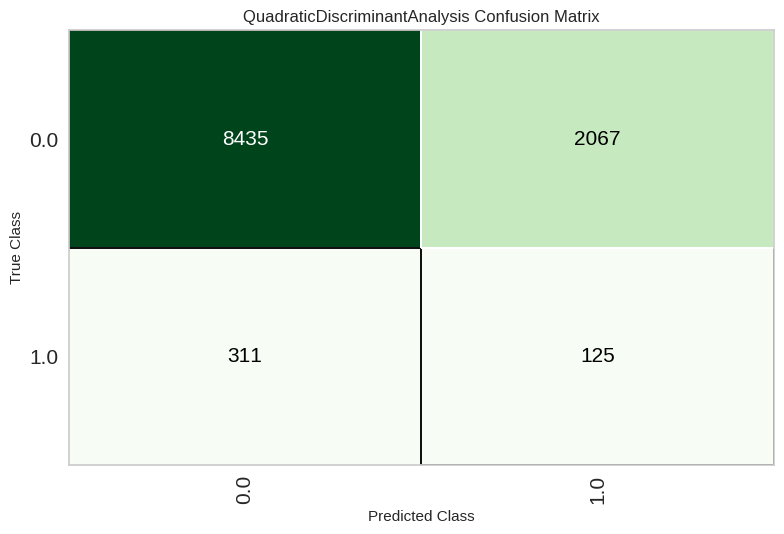

In [ ]:
plot_model(tuned_qda,plot = 'confusion_matrix')

### Linear Discriminant

In [ ]:
lda = create_model('lda')

tuned_lda, tuner = tune_model(lda,optimize = 'eer',return_tuner=True,choose_better = True,n_iter = 50)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9616,0.5812,0.0297,1.0000,0.0577,0.0555,0.1690,0.4925
1,0.9612,0.5607,0.0198,1.0000,0.0388,0.0374,0.1380,0.4950
2,0.9608,0.5553,0.0196,1.0000,0.0385,0.0370,0.1373,0.4950
3,0.9604,0.6450,0.0098,1.0000,0.0194,0.0187,0.0970,0.4975
4,0.9600,0.5615,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
5,0.9612,0.5383,0.0294,1.0000,0.0571,0.0550,0.1681,0.4925
6,0.9604,0.5569,0.0098,1.0000,0.0194,0.0187,0.0970,0.4975
7,0.9608,0.5586,0.0196,1.0000,0.0385,0.0370,0.1373,0.4950
8,0.9608,0.5824,0.0196,1.0000,0.0385,0.0370,0.1373,0.4950


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9616,0.5811,0.0297,1.0000,0.0577,0.0555,0.1690,0.4925
1,0.9612,0.5608,0.0198,1.0000,0.0388,0.0374,0.1380,0.4950
2,0.9608,0.5552,0.0196,1.0000,0.0385,0.0370,0.1373,0.4950
3,0.9604,0.6450,0.0098,1.0000,0.0194,0.0187,0.0970,0.4975
4,0.9600,0.5614,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
5,0.9612,0.5384,0.0294,1.0000,0.0571,0.0550,0.1681,0.4925
6,0.9604,0.5570,0.0098,1.0000,0.0194,0.0187,0.0970,0.4975
7,0.9608,0.5589,0.0196,1.0000,0.0385,0.0370,0.1373,0.4950
8,0.9608,0.5825,0.0196,1.0000,0.0385,0.0370,0.1373,0.4950


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 36 candidates, totalling 360 fits


Original model was better than the tuned model, hence it will be returned. NOTE: The display metrics are for the tuned model (not the original one).


In [ ]:
print(lda)
print(tuned_lda)

LinearDiscriminantAnalysis(covariance_estimator=None, n_components=None,
                           priors=None, shrinkage=None, solver='svd',
                           store_covariance=False, tol=0.0001)
LinearDiscriminantAnalysis(covariance_estimator=None, n_components=None,
                           priors=None, shrinkage=None, solver='svd',
                           store_covariance=False, tol=0.0001)


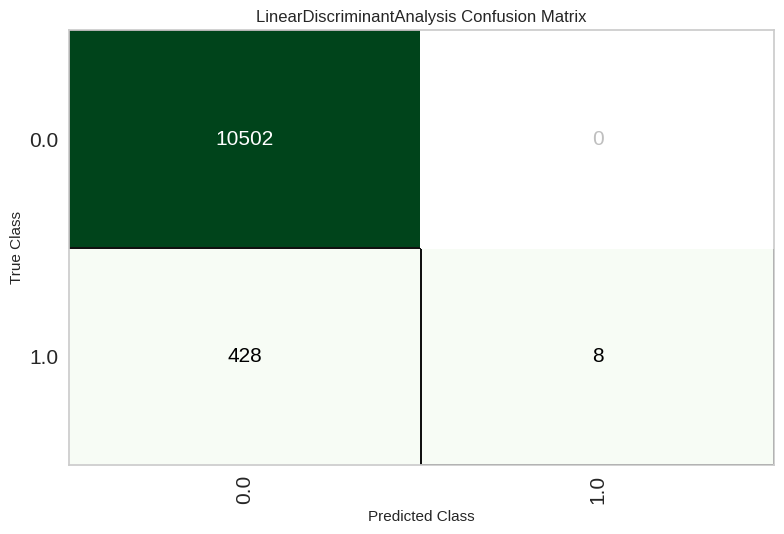

In [ ]:
plot_model(tuned_lda,plot = 'confusion_matrix')

### SVM

In [ ]:
svm = create_model('svm')

tuned_svm, tuner = tune_model(svm,optimize = 'eer',return_tuner=True,choose_better = True,n_iter = 50)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9569,0.0000,0.0396,0.2353,0.0678,0.0570,0.0822,0.4912
1,0.9612,0.0000,0.0198,1.0000,0.0388,0.0374,0.1380,0.4950
2,0.9608,0.0000,0.0196,1.0000,0.0385,0.0370,0.1373,0.4950
3,0.9604,0.0000,0.0098,1.0000,0.0194,0.0187,0.0970,0.4975
4,0.9600,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
5,0.9612,0.0000,0.0294,1.0000,0.0571,0.0550,0.1681,0.4925
6,0.9604,0.0000,0.0098,1.0000,0.0194,0.0187,0.0970,0.4975
7,0.9604,0.0000,0.0098,1.0000,0.0194,0.0187,0.0970,0.4975
8,0.9600,0.0000,0.0196,0.5000,0.0377,0.0348,0.0930,0.4953


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.6250,0.0000,0.4851,0.0514,0.0929,0.0230,0.0467,0.4494
1,0.6109,0.0000,0.4752,0.0486,0.0882,0.0176,0.0367,0.4598
2,0.6238,0.0000,0.4216,0.0456,0.0822,0.0109,0.0218,0.4778
3,0.6078,0.0000,0.5784,0.0580,0.1055,0.0354,0.0750,0.4091
4,0.6203,0.0000,0.4510,0.0480,0.0867,0.0156,0.0317,0.4667
5,0.6050,0.0000,0.3824,0.0396,0.0718,-0.0007,-0.0014,0.5014
6,0.6105,0.0000,0.4314,0.0449,0.0813,0.0096,0.0199,0.4792
7,0.6375,0.0000,0.4510,0.0503,0.0905,0.0200,0.0393,0.4597
8,0.6093,0.0000,0.4902,0.0503,0.0912,0.0201,0.0420,0.4535


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 50 candidates, totalling 500 fits


In [ ]:
print(svm)
print(tuned_svm)

SGDClassifier(alpha=0.0001, average=False, class_weight=None,
              early_stopping=False, epsilon=0.1, eta0=0.001, fit_intercept=True,
              l1_ratio=0.15, learning_rate='optimal', loss='hinge',
              max_iter=1000, n_iter_no_change=5, n_jobs=-1, penalty='l2',
              power_t=0.5, random_state=123, shuffle=True, tol=0.001,
              validation_fraction=0.1, verbose=0, warm_start=False)
SGDClassifier(alpha=1e-06, average=False, class_weight=None,
              early_stopping=False, epsilon=0.1, eta0=0.2, fit_intercept=False,
              l1_ratio=0.2100000001, learning_rate='invscaling', loss='hinge',
              max_iter=1000, n_iter_no_change=5, n_jobs=-1,
              penalty='elasticnet', power_t=0.5, random_state=123, shuffle=True,
              tol=0.001, validation_fraction=0.1, verbose=0, warm_start=False)


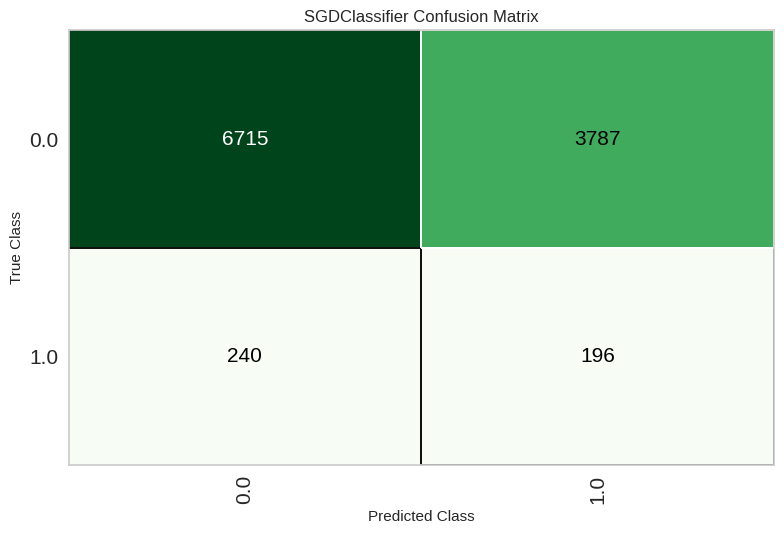

### Gradient Boosting

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9612,0.6339,0.0297,0.7500,0.0571,0.0543,0.1444,0.4926
1,0.9604,0.6170,0.0198,0.5000,0.0381,0.0352,0.0936,0.4952
2,0.9600,0.6360,0.0098,0.5000,0.0192,0.0177,0.0658,0.4976
3,0.9604,0.6950,0.0294,0.6000,0.0561,0.0525,0.1267,0.4927
4,0.9612,0.6061,0.0294,1.0000,0.0571,0.0550,0.1681,0.4925
5,0.9604,0.6138,0.0196,0.6667,0.0381,0.0359,0.1098,0.4952
6,0.9608,0.6057,0.0196,1.0000,0.0385,0.0370,0.1373,0.4950
7,0.9604,0.5980,0.0098,1.0000,0.0194,0.0187,0.0970,0.4975
8,0.9604,0.6278,0.0098,1.0000,0.0194,0.0187,0.0970,0.4975


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9577,0.7211,0.1782,0.4186,0.2500,0.2318,0.2545,0.4536
1,0.9569,0.7290,0.2475,0.4237,0.3125,0.2918,0.3031,0.4328
2,0.9608,0.7338,0.2353,0.5217,0.3243,0.3071,0.3332,0.4355
3,0.9545,0.7159,0.2059,0.3750,0.2658,0.2444,0.2562,0.4462
4,0.9553,0.7096,0.1471,0.3571,0.2083,0.1894,0.2095,0.4631
5,0.9553,0.7290,0.2059,0.3889,0.2692,0.2484,0.2619,0.4460
6,0.9565,0.7467,0.2647,0.4286,0.3273,0.3061,0.3156,0.4273
7,0.9565,0.7027,0.2549,0.4262,0.3190,0.2980,0.3086,0.4305
8,0.9569,0.7123,0.2157,0.4231,0.2857,0.2659,0.2821,0.4426


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 50 candidates, totalling 500 fits


GradientBoostingClassifier(ccp_alpha=0.0, criterion='friedman_mse', init=None,
                           learning_rate=0.1, loss='log_loss', max_depth=3,
                           max_features=None, max_leaf_nodes=None,
                           min_impurity_decrease=0.0, min_samples_leaf=1,
                           min_samples_split=2, min_weight_fraction_leaf=0.0,
                           n_estimators=100, n_iter_no_change=None,
                           random_state=123, subsample=1.0, tol=0.0001,
                           validation_fraction=0.1, verbose=0,
                           warm_start=False)
GradientBoostingClassifier(ccp_alpha=0.0, criterion='friedman_mse', init=None,
                           learning_rate=0.2, loss='log_loss', max_depth=11,
                           max_features=1.0, max_leaf_nodes=None,
                           min_impurity_decrease=0.001, min_samples_leaf=3,
                           min_samples_split=5, min_weight_fraction_leaf=0.0,
  

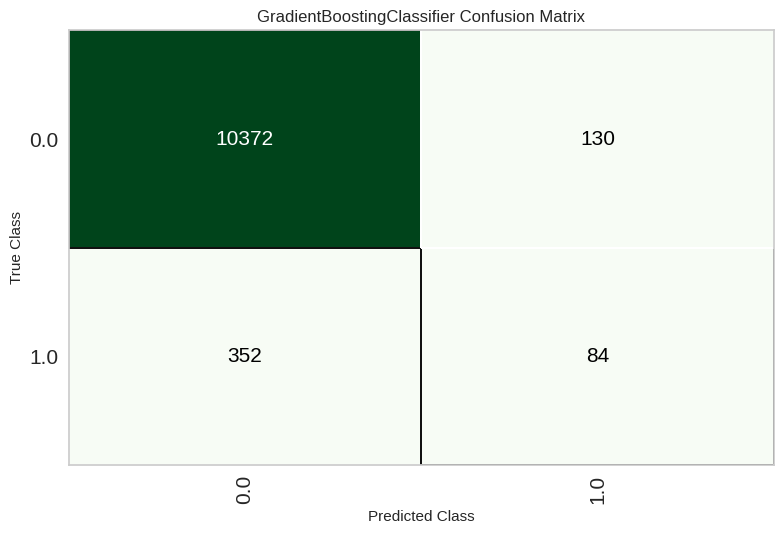

In [ ]:
gbc = create_model('gbc')

tuned_gbc, tuner = tune_model(gbc,optimize = 'eer',return_tuner=True,choose_better = True,n_iter = 50)

print(gbc)
print(tuned_gbc)

plot_model(tuned_gbc,plot = 'confusion_matrix')

### Naive Bayes

In [ ]:
nb = create_model('nb')

tuned_nb, tuner = tune_model(nb,optimize = 'eer',return_tuner=True,choose_better = True,n_iter = 50)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.0674,0.4844,0.9802,0.0400,0.0768,0.0008,0.0115,0.4974
1,0.0572,0.5688,0.9901,0.0399,0.0767,0.0007,0.0129,0.4978
2,0.0549,0.4958,0.9902,0.0402,0.0773,0.0005,0.0096,0.4985
3,0.0600,0.5703,0.9902,0.0404,0.0777,0.0009,0.0157,0.4971
4,0.0564,0.5212,1.0000,0.0406,0.0781,0.0014,0.0264,0.4957
5,0.0607,0.5401,0.9902,0.0404,0.0777,0.0010,0.0165,0.4969
6,0.0580,0.4932,1.0000,0.0407,0.0782,0.0015,0.0276,0.4953
7,0.0615,0.5186,0.9902,0.0405,0.0778,0.0011,0.0173,0.4967
8,0.0584,0.5146,0.9804,0.0400,0.0768,0.0000,0.0005,0.4999


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.8299,0.4859,0.1782,0.0488,0.0766,0.0154,0.0194,0.4896
1,0.8378,0.5690,0.2277,0.0641,0.1000,0.0407,0.0508,0.4723
2,0.8252,0.4970,0.1863,0.0497,0.0785,0.0165,0.0209,0.4886
3,0.8205,0.5717,0.3137,0.0762,0.1226,0.0623,0.0821,0.4492
4,0.8295,0.5217,0.1471,0.0413,0.0645,0.0023,0.0028,0.4985
5,0.8421,0.5399,0.1765,0.0534,0.0820,0.0220,0.0268,0.4863
6,0.8358,0.4941,0.2059,0.0585,0.0911,0.0308,0.0383,0.4795
7,0.8292,0.5191,0.1765,0.0486,0.0763,0.0145,0.0182,0.4902
8,0.8264,0.5159,0.2157,0.0571,0.0903,0.0290,0.0370,0.4794


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 28 candidates, totalling 280 fits


In [ ]:
print(nb)
print(tuned_nb)

GaussianNB(priors=None, var_smoothing=1e-09)
GaussianNB(priors=None, var_smoothing=0.1)


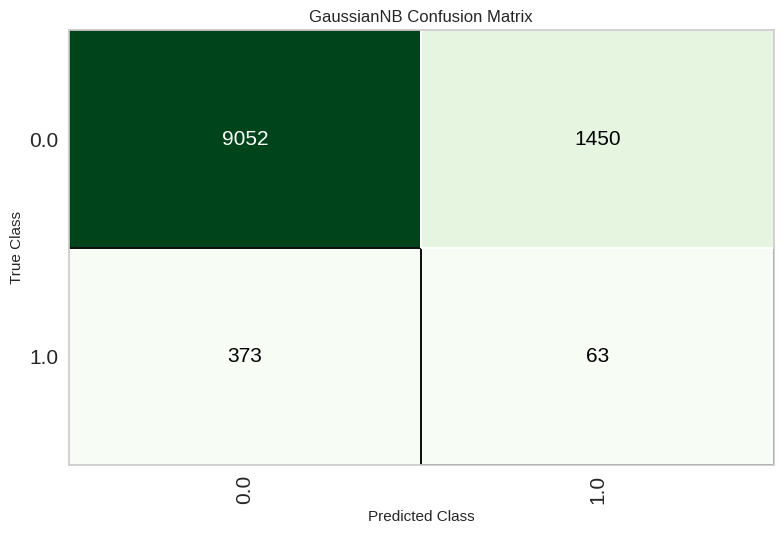

In [ ]:
plot_model(tuned_nb,plot = 'confusion_matrix')

### Logistic Regression

In [ ]:
lr = create_model('lr')

tuned_lr, tuner = tune_model(lr,optimize = 'eer',return_tuner=True,choose_better = True,n_iter = 50)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9604,0.5798,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
1,0.9604,0.5557,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
2,0.9600,0.5590,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
3,0.9600,0.6469,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
4,0.9600,0.5641,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
5,0.9600,0.5395,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
6,0.9600,0.5532,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
7,0.9604,0.5574,0.0098,1.0000,0.0194,0.0187,0.0970,0.4975
8,0.9604,0.5828,0.0098,1.0000,0.0194,0.0187,0.0970,0.4975


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.5940,0.5740,0.5248,0.0509,0.0928,0.0223,0.0483,0.4433
1,0.6082,0.5596,0.4653,0.0473,0.0859,0.0152,0.0317,0.4654
2,0.6203,0.5617,0.4902,0.0517,0.0935,0.0229,0.0468,0.4490
3,0.6003,0.6468,0.6078,0.0595,0.1084,0.0384,0.0828,0.3969
4,0.5980,0.5651,0.4706,0.0471,0.0856,0.0139,0.0295,0.4674
5,0.5952,0.5334,0.4510,0.0450,0.0818,0.0098,0.0209,0.4773
6,0.6027,0.5565,0.4510,0.0458,0.0832,0.0114,0.0240,0.4741
7,0.6109,0.5602,0.4804,0.0495,0.0898,0.0187,0.0389,0.4574
8,0.5964,0.5765,0.5490,0.0538,0.0981,0.0273,0.0588,0.4298


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 50 candidates, totalling 500 fits


In [ ]:
print(lr)
print(tuned_lr)

LogisticRegression(C=1.0, class_weight=None, dual=False, fit_intercept=True,
                   intercept_scaling=1, l1_ratio=None, max_iter=1000,
                   multi_class='auto', n_jobs=None, penalty='l2',
                   random_state=123, solver='lbfgs', tol=0.0001, verbose=0,
                   warm_start=False)
LogisticRegression(C=1.17, class_weight='balanced', dual=False,
                   fit_intercept=True, intercept_scaling=1, l1_ratio=None,
                   max_iter=1000, multi_class='auto', n_jobs=None, penalty='l2',
                   random_state=123, solver='lbfgs', tol=0.0001, verbose=0,
                   warm_start=False)


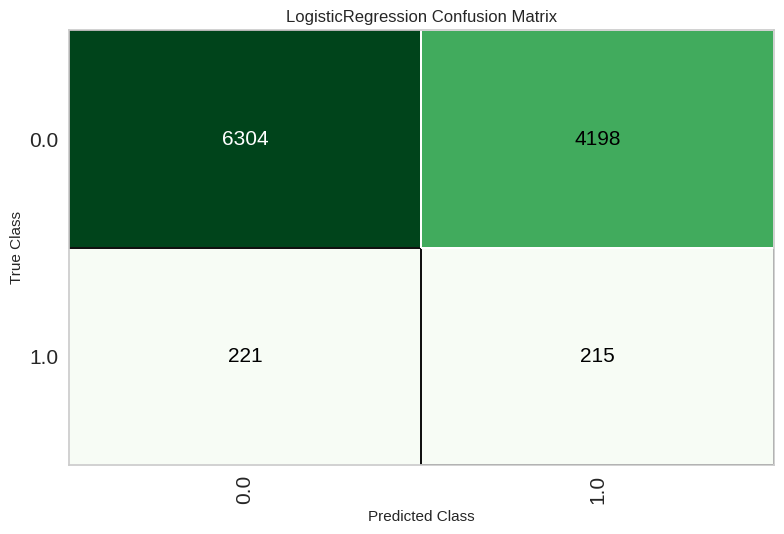

In [ ]:
plot_model(tuned_lr,plot = 'confusion_matrix')

### Ridge

In [ ]:
ridge = create_model('ridge')

tuned_ridge, tuner = tune_model(ridge,optimize = 'eer',return_tuner=True,choose_better = True,n_iter = 50)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9604,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
1,0.9604,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
2,0.9600,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
3,0.9600,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
4,0.9600,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
5,0.9600,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
6,0.9600,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
7,0.9608,0.0000,0.0196,1.0000,0.0385,0.0370,0.1373,0.4950
8,0.9600,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.5404,0.0000,0.6139,0.0518,0.0956,0.0244,0.0591,0.4298
1,0.5529,0.0000,0.5248,0.0462,0.0850,0.0132,0.0309,0.4617
2,0.5658,0.0000,0.4902,0.0452,0.0828,0.0104,0.0234,0.4726
3,0.5588,0.0000,0.6373,0.0563,0.1035,0.0324,0.0759,0.4109
4,0.5490,0.0000,0.5098,0.0451,0.0829,0.0102,0.0238,0.4710
5,0.5345,0.0000,0.4902,0.0422,0.0776,0.0044,0.0104,0.4873
6,0.5470,0.0000,0.5294,0.0465,0.0854,0.0129,0.0304,0.4621
7,0.5631,0.0000,0.5686,0.0514,0.0942,0.0226,0.0519,0.4346
8,0.5541,0.0000,0.6176,0.0542,0.0997,0.0283,0.0665,0.4207


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 50 candidates, totalling 500 fits


In [ ]:
print(ridge)
print(tuned_ridge)

RidgeClassifier(alpha=1.0, class_weight=None, copy_X=True, fit_intercept=True,
                max_iter=None, positive=False, random_state=123, solver='auto',
                tol=0.0001)
RidgeClassifier(alpha=9.91, class_weight=None, copy_X=True, fit_intercept=False,
                max_iter=None, positive=False, random_state=123, solver='auto',
                tol=0.0001)


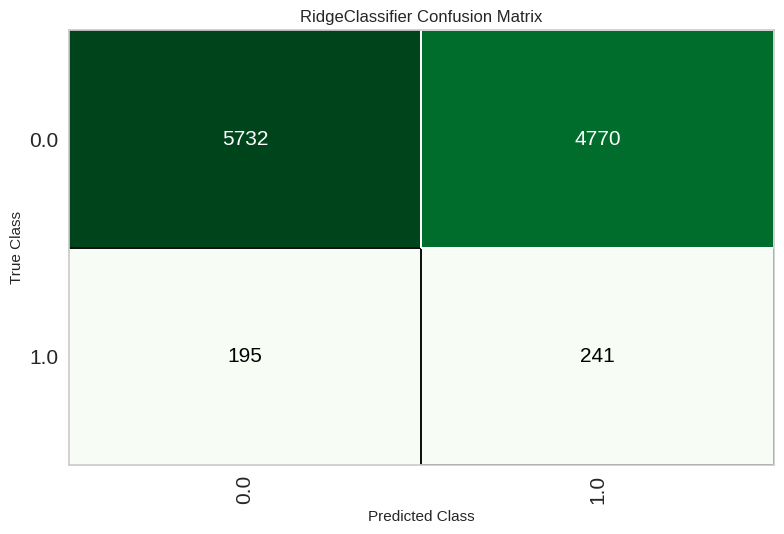

In [ ]:
plot_model(tuned_ridge,plot = 'confusion_matrix')

### Ada Boost

In [ ]:
ada = create_model('ada')

tuned_ada, tuner = tune_model(ada,optimize = 'eer',return_tuner=True,choose_better = True,n_iter = 50)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9604,0.6035,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
1,0.9604,0.5676,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
2,0.9600,0.5942,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
3,0.9600,0.6582,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
4,0.9600,0.5891,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
5,0.9600,0.5577,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
6,0.9596,0.5777,0.0000,0.0000,0.0000,-0.0008,-0.0040,0.5001
7,0.9600,0.5693,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
8,0.9600,0.5935,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9608,0.6280,0.0099,1.0000,0.0196,0.0188,0.0975,0.4975
1,0.9604,0.5792,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
2,0.9600,0.6149,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
3,0.9600,0.6686,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
4,0.9600,0.6032,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
5,0.9604,0.5719,0.0098,1.0000,0.0194,0.0187,0.0970,0.4975
6,0.9600,0.6069,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
7,0.9600,0.5758,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
8,0.9600,0.6257,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 50 candidates, totalling 500 fits


In [ ]:
print(ada)
print(tuned_ada)

AdaBoostClassifier(algorithm='SAMME.R', base_estimator='deprecated',
                   estimator=None, learning_rate=1.0, n_estimators=50,
                   random_state=123)
AdaBoostClassifier(algorithm='SAMME.R', base_estimator='deprecated',
                   estimator=None, learning_rate=0.5, n_estimators=280,
                   random_state=123)


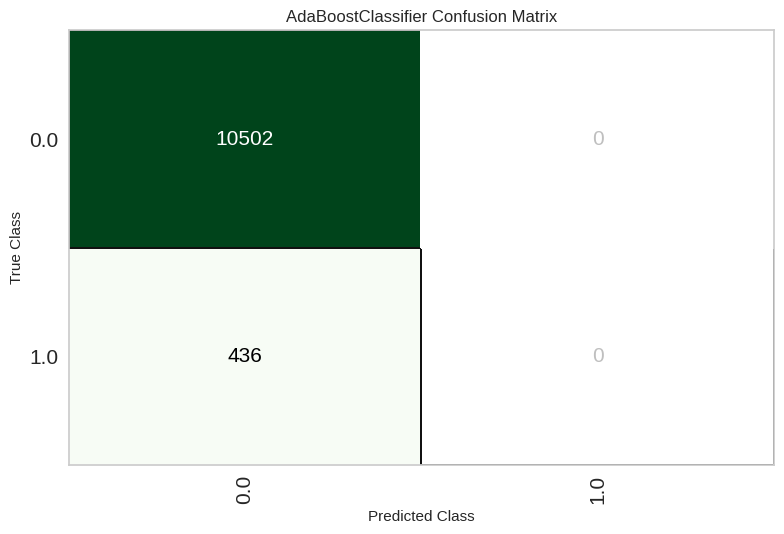

In [ ]:
plot_model(tuned_ada,plot = 'confusion_matrix')

# Dealing with Imbalanced Dataset

## Smote

In [ ]:
import imblearn
from imblearn.over_sampling import SMOTE
sm = SMOTE(random_state=42,sampling_strategy='minority')
smote = setup(df,test_data = test_data,target = 'STATUS',normalize = True,ignore_features = ['ID'],fix_imbalance = True,fix_imbalance_method = sm,index=False)
add_metric('eer', 'eer', calculate_eer,greater_is_better=False)

,Description,Value
0,Session id,7268
1,Target,STATUS
2,Target type,Binary
3,Original data shape,"(47395, 52)"
4,Transformed data shape,"(80946, 51)"
5,Transformed train set shape,"(70008, 51)"
6,Transformed test set shape,"(10938, 51)"
7,Ignore features,1
8,Numeric features,50
9,Rows with missing values,23.1%


Name                                                               eer
Display Name                                                       eer
Score Function       <pycaret.internal.metrics.EncodedDecodedLabels...
Scorer               make_scorer(calculate_eer, greater_is_better=F...
Target                                                            pred
Args                                                                {}
Greater is Better                                                False
Multiclass                                                        True
Custom                                                            True
Name: eer, dtype: object

In [ ]:
# best = compare_models(sort='F1',include=['rf','dt','xgboost','nb','lr'])
best = compare_models(sort='eer')

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer,TT (Sec)
ridge,Ridge Classifier,0.5751,0.0000,0.4618,0.0438,0.0799,0.0077,0.0166,0.4801,0.4850
lda,Linear Discriminant Analysis,0.5751,0.5165,0.4618,0.0438,0.0799,0.0077,0.0166,0.4801,1.6840
lr,Logistic Regression,0.5749,0.5165,0.4604,0.0437,0.0797,0.0075,0.0160,0.4807,1.9400
svm,SVM - Linear Kernel,0.5729,0.0000,0.4570,0.0432,0.0789,0.0066,0.0139,0.4837,2.6310
catboost,CatBoost Classifier,0.9369,0.4998,0.0462,0.0755,0.0535,0.0234,0.0257,0.4946,45.2290
xgboost,Extreme Gradient Boosting,0.9340,0.5091,0.0468,0.0687,0.0533,0.0211,0.0223,0.4952,4.3610
lightgbm,Light Gradient Boosting Machine,0.9466,0.4936,0.0193,0.0634,0.0282,0.0073,0.0102,0.4989,5.6380
ada,Ada Boost Classifier,0.9449,0.4988,0.0186,0.0474,0.0258,0.0029,0.0038,0.4995,5.4900
qda,Quadratic Discriminant Analysis,0.0410,0.5006,1.0000,0.0399,0.0767,0.0001,0.0053,0.4997,1.0650
dummy,Dummy Classifier,0.9601,0.5000,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000,0.5880


Processing:   0%|          | 0/69 [00:00<?, ?it/s]

In [ ]:
evaluate_model(best)

interactive(children=(ToggleButtons(description='Plot Type:', icons=('',), options=(('Pipeline Plot', 'pipelin…

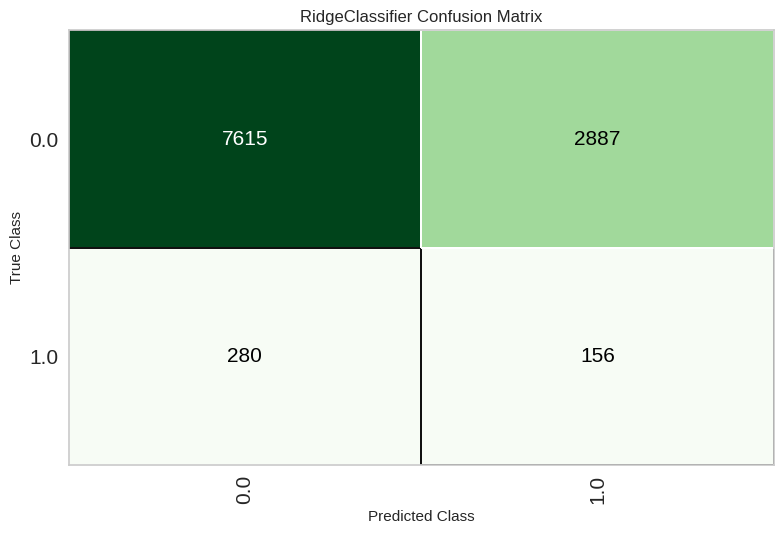

In [ ]:
plot_model(best,plot = 'confusion_matrix')

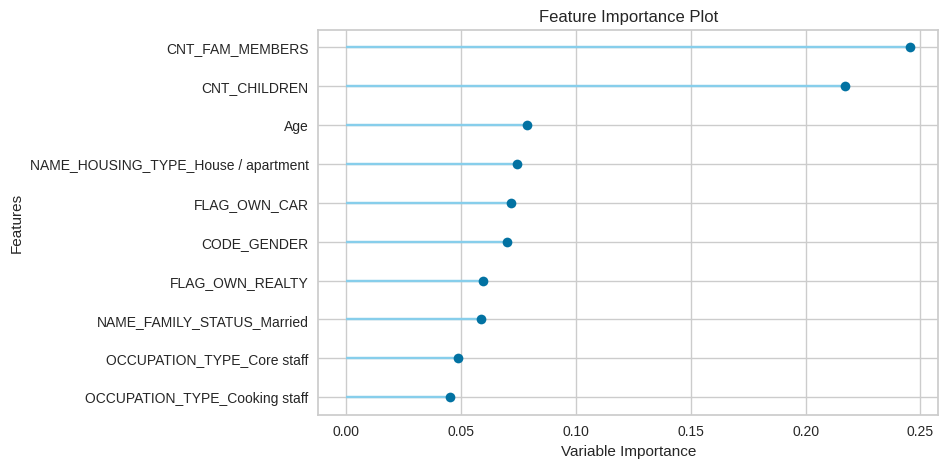

In [ ]:
plot_model(best,plot = 'feature')

### Models confusion matrix after SMOTE

In [ ]:
rf = create_model('rf')
et = create_model('et')
xgboost = create_model('xgboost')
catboost = create_model('catboost')
knn = create_model('knn')
lightgbm = create_model('lightgbm')
qda = create_model('qda')
lda = create_model('lda')
gbc = create_model('gbc')
svm = create_model('svm')
nb = create_model('nb')
lr = create_model('lr')
ridge = create_model('ridge')
ada = create_model('ada')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9375,0.4478,0.0414,0.0632,0.0500,0.0191,0.0196,0.4959
1,0.9227,0.4276,0.0483,0.0464,0.0473,0.0070,0.0070,0.4981
2,0.9240,0.3936,0.0828,0.0769,0.0797,0.0402,0.0402,0.4889
3,0.8648,0.1938,0.0138,0.0057,0.0080,-0.0512,-0.0570,0.5228
4,0.8796,0.2246,0.0411,0.0197,0.0266,-0.0291,-0.0314,0.5118
5,0.8790,0.2336,0.0342,0.0164,0.0222,-0.0338,-0.0364,0.5137
6,0.8645,0.2734,0.0548,0.0220,0.0314,-0.0274,-0.0307,0.5127
7,0.8793,0.3644,0.0690,0.0317,0.0435,-0.0116,-0.0126,0.5049
8,0.8870,0.4511,0.0966,0.0475,0.0636,0.0109,0.0117,0.4955


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9317,0.4341,0.0483,0.0593,0.0532,0.0182,0.0183,0.4957
1,0.9205,0.3911,0.0483,0.0440,0.0461,0.0046,0.0047,0.4987
2,0.9142,0.3056,0.0828,0.0625,0.0712,0.0271,0.0274,0.4916
3,0.8618,0.1592,0.0138,0.0055,0.0079,-0.0519,-0.0583,0.5237
4,0.8760,0.1688,0.0411,0.0189,0.0259,-0.0307,-0.0334,0.5128
5,0.8758,0.2068,0.0342,0.0158,0.0216,-0.0352,-0.0382,0.5146
6,0.8587,0.2069,0.0548,0.0208,0.0301,-0.0297,-0.0338,0.5144
7,0.8752,0.3220,0.0690,0.0303,0.0421,-0.0139,-0.0153,0.5061
8,0.8683,0.4085,0.1034,0.0411,0.0588,0.0020,0.0022,0.4990


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9482,0.5334,0.0276,0.0769,0.0406,0.0200,0.0229,0.4965
1,0.9386,0.5546,0.0207,0.0353,0.0261,-0.0034,-0.0035,0.5007
2,0.9504,0.5056,0.0552,0.1538,0.0812,0.0615,0.0702,0.4890
3,0.9243,0.4142,0.0138,0.0148,0.0143,-0.0250,-0.0250,0.5062
4,0.9405,0.4551,0.0274,0.0506,0.0356,0.0077,0.0080,0.4985
5,0.9347,0.5225,0.0342,0.0490,0.0403,0.0076,0.0078,0.4983
6,0.9139,0.4234,0.0137,0.0116,0.0126,-0.0321,-0.0322,0.5090
7,0.9314,0.5397,0.0483,0.0588,0.0530,0.0178,0.0179,0.4958
8,0.9213,0.5309,0.1103,0.0920,0.1003,0.0595,0.0598,0.4823


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9512,0.5281,0.0276,0.0976,0.0430,0.0259,0.0315,0.4957
1,0.9416,0.5719,0.0207,0.0405,0.0274,0.0005,0.0006,0.4999
2,0.9550,0.4835,0.0552,0.2286,0.0889,0.0746,0.0951,0.4877
3,0.9314,0.4141,0.0138,0.0183,0.0157,-0.0190,-0.0192,0.5043
4,0.9419,0.4209,0.0068,0.0147,0.0093,-0.0165,-0.0178,0.5031
5,0.9270,0.5044,0.0274,0.0312,0.0292,-0.0085,-0.0086,0.5021
6,0.9147,0.4108,0.0274,0.0231,0.0251,-0.0192,-0.0193,0.5054
7,0.9311,0.5244,0.0690,0.0794,0.0738,0.0382,0.0383,0.4906
8,0.9229,0.5335,0.0621,0.0584,0.0602,0.0200,0.0201,0.4946


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.8341,0.4954,0.1172,0.0344,0.0532,-0.0088,-0.0109,0.5054
1,0.8269,0.4491,0.0897,0.0254,0.0396,-0.0239,-0.0297,0.5150
2,0.8450,0.4809,0.1172,0.0374,0.0568,-0.0037,-0.0045,0.5022
3,0.7984,0.4083,0.0414,0.0100,0.0161,-0.0513,-0.0678,0.5360
4,0.7916,0.4246,0.0342,0.0080,0.0130,-0.0555,-0.0742,0.5399
5,0.7828,0.4540,0.0890,0.0193,0.0318,-0.0364,-0.0502,0.5288
6,0.7545,0.4207,0.0822,0.0155,0.0261,-0.0442,-0.0649,0.5398
7,0.7989,0.5086,0.1310,0.0304,0.0493,-0.0164,-0.0220,0.5125
8,0.7830,0.5134,0.2138,0.0438,0.0727,0.0071,0.0101,0.4936


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9512,0.5249,0.0069,0.0286,0.0111,-0.0044,-0.0056,0.5007
1,0.9487,0.5473,0.0207,0.0625,0.0311,0.0115,0.0134,0.4980
2,0.9564,0.4863,0.0207,0.1500,0.0364,0.0270,0.0419,0.4960
3,0.9446,0.4260,0.0069,0.0169,0.0098,-0.0135,-0.0150,0.5024
4,0.9545,0.4458,0.0274,0.1429,0.0460,0.0335,0.0461,0.4948
5,0.9391,0.5234,0.0000,0.0000,0.0000,-0.0282,-0.0298,0.5055
6,0.9473,0.3862,0.0137,0.0400,0.0204,-0.0000,-0.0000,0.5000
7,0.9457,0.5344,0.0276,0.0656,0.0388,0.0156,0.0172,0.4971
8,0.9339,0.5127,0.0276,0.0385,0.0321,-0.0011,-0.0012,0.5003


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.0428,0.5016,1.0000,0.0399,0.0767,0.0003,0.0112,0.4992
1,0.0400,0.5001,1.0000,0.0398,0.0765,0.0000,0.0034,0.4999
2,0.0398,0.5000,1.0000,0.0398,0.0765,0.0000,0.0000,0.5000
3,0.0436,0.5020,1.0000,0.0399,0.0768,0.0003,0.0126,0.4990
4,0.0422,0.5011,1.0000,0.0401,0.0772,0.0002,0.0096,0.4994
5,0.0403,0.5001,1.0000,0.0401,0.0770,0.0000,0.0034,0.4999
6,0.0406,0.5003,1.0000,0.0401,0.0770,0.0000,0.0048,0.4999
7,0.0398,0.5000,1.0000,0.0398,0.0765,0.0000,0.0000,0.5000
8,0.0398,0.5000,1.0000,0.0398,0.0765,0.0000,0.0000,0.5000


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.5957,0.5367,0.4414,0.0439,0.0799,0.0081,0.0174,0.4813
1,0.6306,0.4818,0.3448,0.0384,0.0691,-0.0026,-0.0052,0.5049
2,0.5776,0.5746,0.5724,0.0532,0.0973,0.0264,0.0593,0.4253
3,0.5343,0.4143,0.3379,0.0297,0.0546,-0.0200,-0.0470,0.5497
4,0.6196,0.5572,0.4521,0.0481,0.0869,0.0156,0.0318,0.4665
5,0.6064,0.5180,0.4178,0.0432,0.0784,0.0062,0.0129,0.4866
6,0.5326,0.4862,0.4932,0.0423,0.0779,0.0045,0.0108,0.4868
7,0.6187,0.5513,0.5103,0.0531,0.0962,0.0260,0.0537,0.4400
8,0.4971,0.5113,0.5448,0.0428,0.0794,0.0060,0.0156,0.4810


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.6333,0.0000,0.4207,0.0464,0.0836,0.0129,0.0256,0.4743
1,0.6341,0.0000,0.3724,0.0416,0.0749,0.0036,0.0071,0.4932
2,0.5801,0.0000,0.4690,0.0447,0.0816,0.0097,0.0213,0.4760
3,0.5378,0.0000,0.2897,0.0259,0.0475,-0.0275,-0.0638,0.5644
4,0.5730,0.0000,0.5548,0.0515,0.0942,0.0226,0.0509,0.4369
5,0.6031,0.0000,0.3288,0.0344,0.0622,-0.0111,-0.0229,0.5220
6,0.4372,0.0000,0.5959,0.0418,0.0782,0.0036,0.0105,0.4886
7,0.6219,0.0000,0.4483,0.0477,0.0862,0.0154,0.0313,0.4672
8,0.4925,0.0000,0.5793,0.0448,0.0833,0.0102,0.0267,0.4687


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9589,0.4956,0.0000,0.0000,0.0000,-0.0027,-0.0075,0.5004
1,0.9600,0.5166,0.0000,0.0000,0.0000,-0.0005,-0.0034,0.5001
2,0.9597,0.4454,0.0000,0.0000,0.0000,-0.0011,-0.0048,0.5001
3,0.9545,0.4415,0.0000,0.0000,0.0000,-0.0102,-0.0155,0.5015
4,0.9569,0.4792,0.0000,0.0000,0.0000,-0.0056,-0.0112,0.5008
5,0.9515,0.5269,0.0000,0.0000,0.0000,-0.0142,-0.0189,0.5022
6,0.9539,0.4071,0.0000,0.0000,0.0000,-0.0106,-0.0159,0.5016
7,0.9525,0.5365,0.0069,0.0333,0.0114,-0.0022,-0.0030,0.5003
8,0.9558,0.4966,0.0138,0.1000,0.0242,0.0147,0.0229,0.4978


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.6333,0.0000,0.4207,0.0464,0.0836,0.0129,0.0256,0.4743
1,0.6341,0.0000,0.3724,0.0416,0.0749,0.0036,0.0071,0.4932
2,0.5801,0.0000,0.4690,0.0447,0.0816,0.0097,0.0213,0.4760
3,0.5378,0.0000,0.2897,0.0259,0.0475,-0.0275,-0.0638,0.5644
4,0.5730,0.0000,0.5548,0.0515,0.0942,0.0226,0.0509,0.4369
5,0.6031,0.0000,0.3288,0.0344,0.0622,-0.0111,-0.0229,0.5220
6,0.4372,0.0000,0.5959,0.0418,0.0782,0.0036,0.0105,0.4886
7,0.6219,0.0000,0.4483,0.0477,0.0862,0.0154,0.0313,0.4672
8,0.4925,0.0000,0.5793,0.0448,0.0833,0.0102,0.0267,0.4687


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.0848,0.5035,0.9172,0.0385,0.0738,-0.0027,-0.0287,0.5087
1,0.0694,0.4901,0.9379,0.0386,0.0742,-0.0024,-0.0307,0.5075
2,0.0741,0.4317,0.9448,0.0391,0.0751,-0.0014,-0.0174,0.5045
3,0.0752,0.4778,0.9586,0.0397,0.0762,-0.0002,-0.0029,0.5007
4,0.0837,0.4977,0.9795,0.0411,0.0789,0.0022,0.0243,0.4933
5,0.0839,0.5104,0.9521,0.0400,0.0768,-0.0000,-0.0002,0.5001
6,0.0595,0.3688,0.9110,0.0375,0.0720,-0.0053,-0.0792,0.5172
7,0.0768,0.5378,0.9724,0.0403,0.0773,0.0010,0.0122,0.4969
8,0.0798,0.4801,0.9793,0.0407,0.0781,0.0018,0.0214,0.4944


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.5952,0.5368,0.4414,0.0439,0.0798,0.0080,0.0171,0.4815
1,0.6306,0.4818,0.3379,0.0377,0.0678,-0.0040,-0.0079,0.5074
2,0.5776,0.5741,0.5724,0.0532,0.0973,0.0264,0.0593,0.4253
3,0.5370,0.4148,0.3379,0.0299,0.0549,-0.0196,-0.0459,0.5484
4,0.6196,0.5573,0.4521,0.0481,0.0869,0.0156,0.0318,0.4665
5,0.6039,0.5187,0.4178,0.0430,0.0779,0.0057,0.0119,0.4876
6,0.5324,0.4856,0.4932,0.0423,0.0779,0.0044,0.0107,0.4870
7,0.6198,0.5515,0.5103,0.0533,0.0965,0.0263,0.0542,0.4396
8,0.4955,0.5114,0.5379,0.0422,0.0782,0.0048,0.0124,0.4848


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.5957,0.0000,0.4414,0.0439,0.0799,0.0081,0.0174,0.4813
1,0.6306,0.0000,0.3448,0.0384,0.0691,-0.0026,-0.0052,0.5049
2,0.5776,0.0000,0.5724,0.0532,0.0973,0.0264,0.0593,0.4253
3,0.5343,0.0000,0.3379,0.0297,0.0546,-0.0200,-0.0470,0.5497
4,0.6196,0.0000,0.4521,0.0481,0.0869,0.0156,0.0318,0.4665
5,0.6064,0.0000,0.4178,0.0432,0.0784,0.0062,0.0129,0.4866
6,0.5326,0.0000,0.4932,0.0423,0.0779,0.0045,0.0108,0.4868
7,0.6187,0.0000,0.5103,0.0531,0.0962,0.0260,0.0537,0.4400
8,0.4971,0.0000,0.5448,0.0428,0.0794,0.0060,0.0156,0.4810


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9460,0.5548,0.0000,0.0000,0.0000,-0.0214,-0.0245,0.5037
1,0.9528,0.4492,0.0345,0.1351,0.0549,0.0394,0.0494,0.4935
2,0.9462,0.5205,0.0276,0.0678,0.0392,0.0166,0.0184,0.4970
3,0.9517,0.4889,0.0276,0.1026,0.0435,0.0271,0.0334,0.4955
4,0.9484,0.4894,0.0000,0.0000,0.0000,-0.0182,-0.0220,0.5030
5,0.9377,0.5246,0.0000,0.0000,0.0000,-0.0294,-0.0308,0.5059
6,0.9380,0.4666,0.0137,0.0238,0.0174,-0.0122,-0.0127,0.5025
7,0.9380,0.5320,0.0621,0.0909,0.0738,0.0429,0.0437,0.4905
8,0.9514,0.4816,0.0069,0.0294,0.0112,-0.0040,-0.0051,0.5006


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.8897,0.5149,0.1241,0.0614,0.0822,0.0306,0.0328,0.4873
1,0.8760,0.4872,0.0897,0.0390,0.0544,-0.0011,-0.0012,0.5005
2,0.8675,0.4806,0.0897,0.0357,0.0511,-0.0061,-0.0069,0.5029
3,0.7869,0.4036,0.0345,0.0078,0.0127,-0.0558,-0.0757,0.5413
4,0.8110,0.4204,0.0411,0.0108,0.0171,-0.0494,-0.0632,0.5321
5,0.8332,0.4520,0.0479,0.0147,0.0225,-0.0413,-0.0501,0.5237
6,0.8086,0.4451,0.0548,0.0141,0.0224,-0.0441,-0.0569,0.5295
7,0.7956,0.4978,0.0966,0.0223,0.0362,-0.0304,-0.0408,0.5228
8,0.8316,0.5427,0.1655,0.0464,0.0725,0.0111,0.0138,0.4927


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

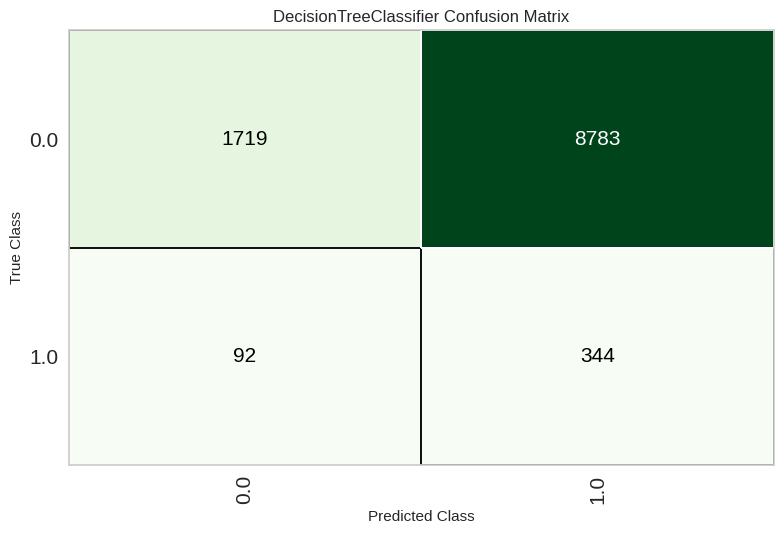

In [ ]:
dt = create_model('dt')
plot_model(dt,plot = 'confusion_matrix')

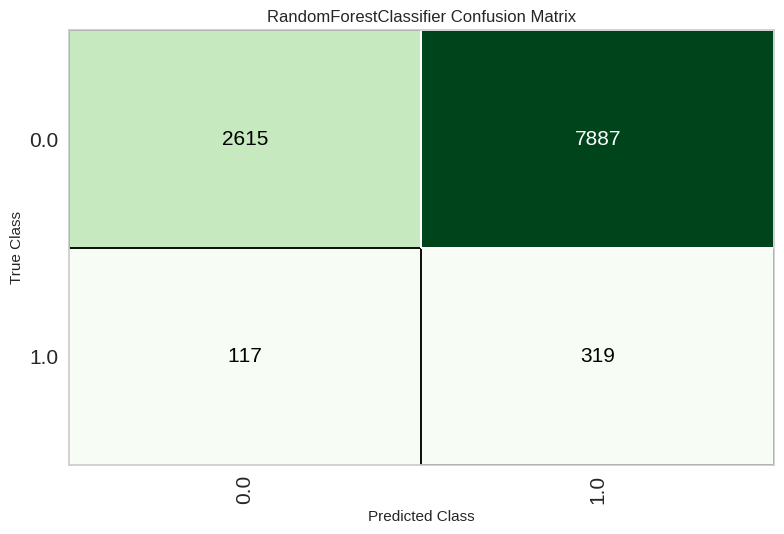

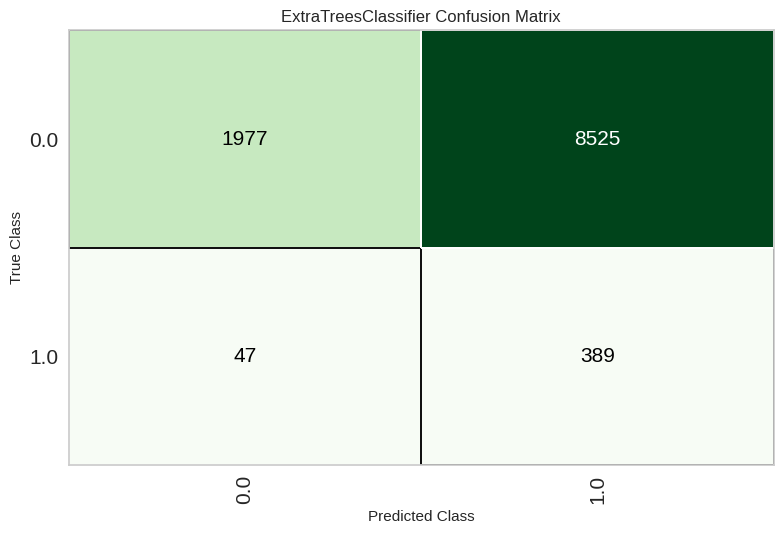

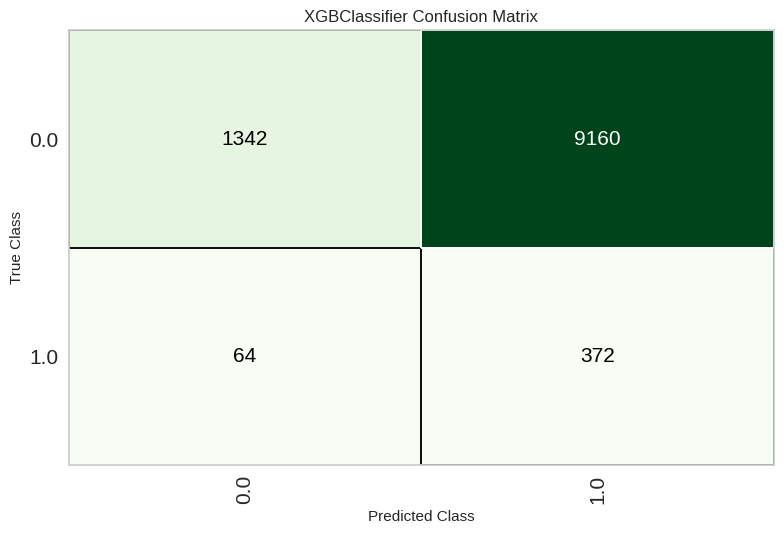

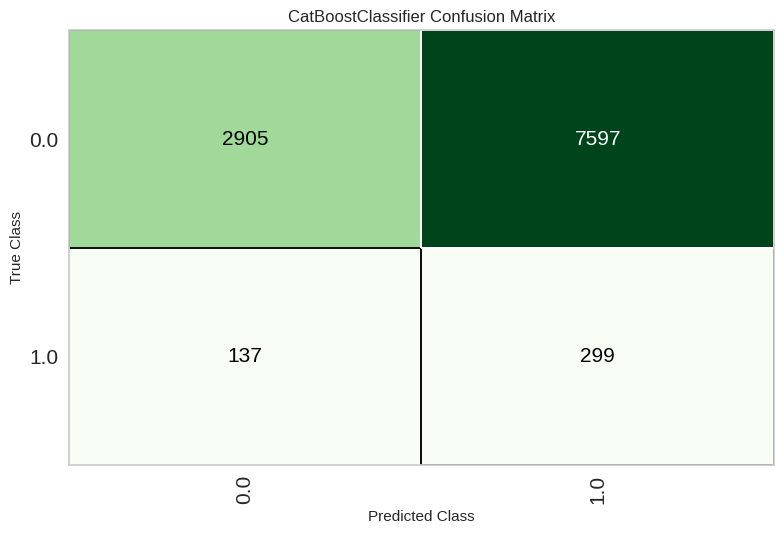

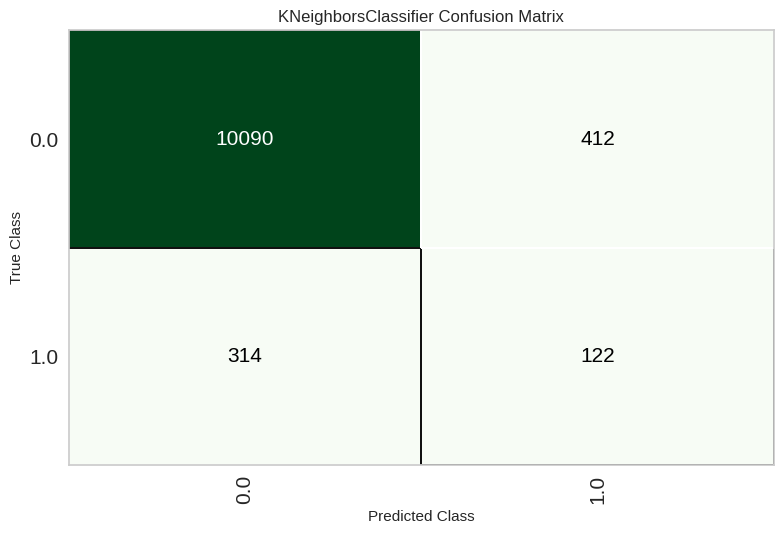

...

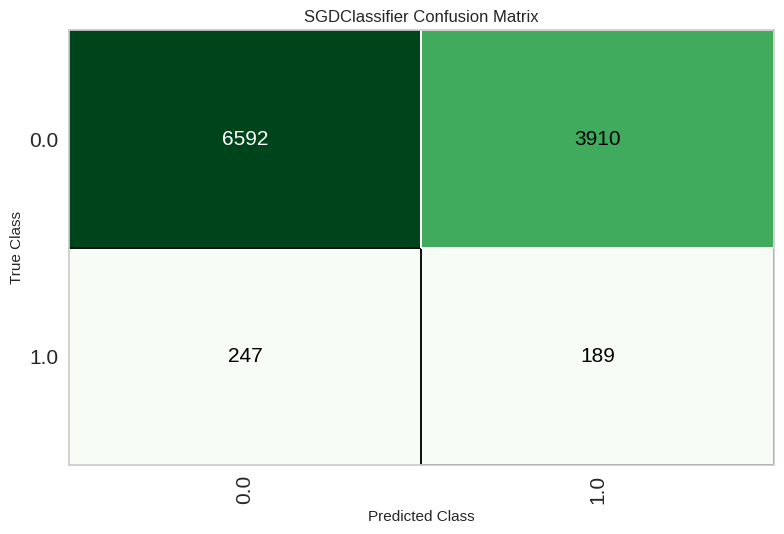

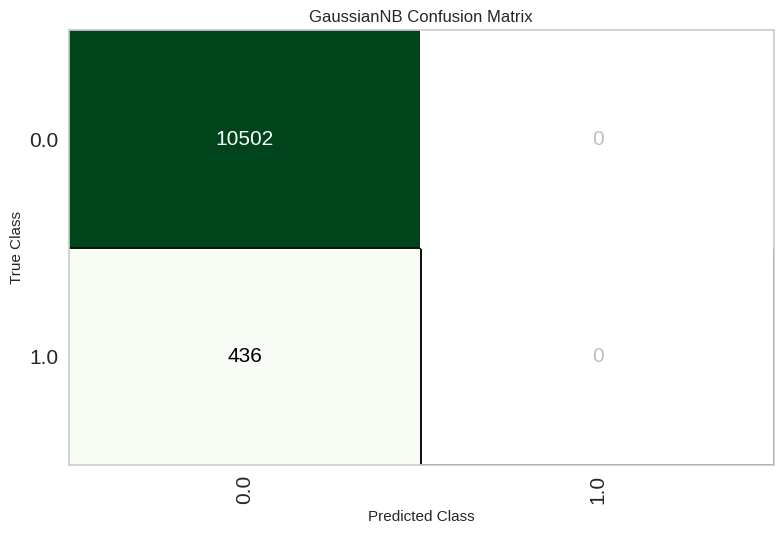

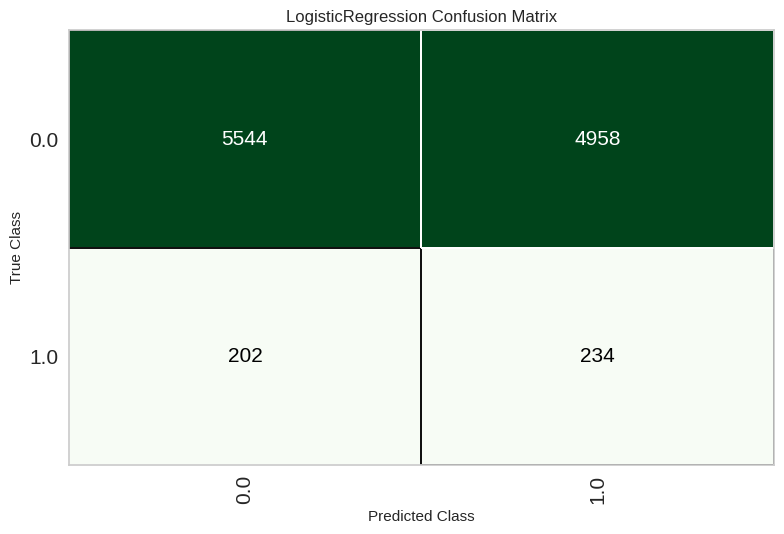

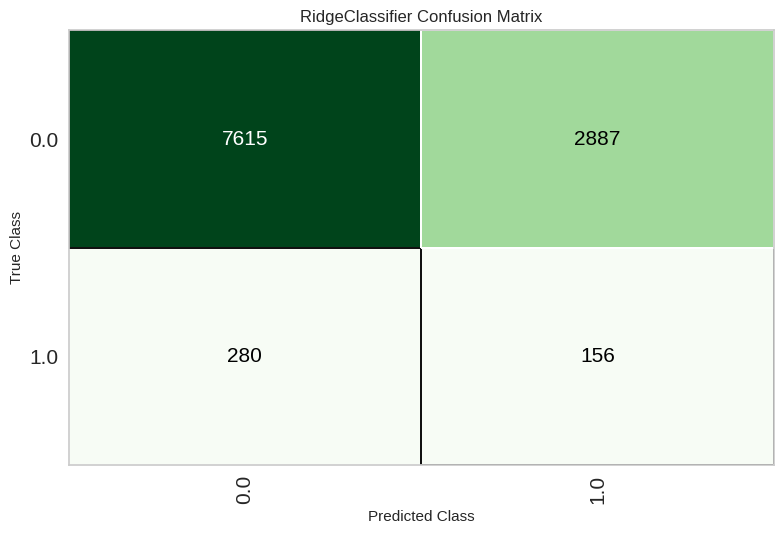

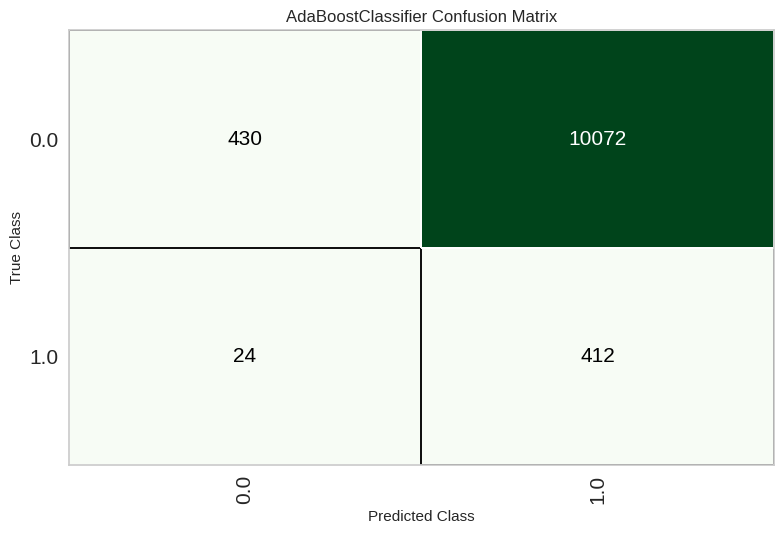

In [ ]:
plot_model(rf,plot = 'confusion_matrix')
plot_model(et,plot = 'confusion_matrix')
plot_model(xgboost,plot = 'confusion_matrix')
plot_model(catboost,plot = 'confusion_matrix')
plot_model(knn,plot = 'confusion_matrix')
plot_model(lightgbm,plot = 'confusion_matrix')
plot_model(qda,plot = 'confusion_matrix')
plot_model(lda,plot = 'confusion_matrix')
plot_model(gbc,plot = 'confusion_matrix')
plot_model(svm,plot = 'confusion_matrix')
plot_model(nb,plot = 'confusion_matrix')
plot_model(lr,plot = 'confusion_matrix')
plot_model(ridge,plot = 'confusion_matrix')
plot_model(ada,plot = 'confusion_matrix')

### Tuning models with SMOTE

#### SVM

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.6177,0.0000,0.3931,0.0418,0.0756,0.0040,0.0081,0.4919
1,0.5450,0.0000,0.4621,0.0407,0.0747,0.0018,0.0041,0.4952
2,0.5376,0.0000,0.5517,0.0470,0.0867,0.0144,0.0348,0.4563
3,0.4259,0.0000,0.3724,0.0263,0.0491,-0.0273,-0.0786,0.5944
4,0.6155,0.0000,0.4932,0.0514,0.0931,0.0222,0.0458,0.4496
5,0.5656,0.0000,0.4658,0.0432,0.0791,0.0062,0.0140,0.4839
6,0.5620,0.0000,0.4726,0.0434,0.0795,0.0067,0.0152,0.4825
7,0.5476,0.0000,0.4897,0.0431,0.0793,0.0067,0.0156,0.4813
8,0.4870,0.0000,0.5172,0.0400,0.0743,0.0004,0.0012,0.4986


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.5329,0.0000,0.4828,0.0412,0.0760,0.0029,0.0070,0.4916
1,0.5461,0.0000,0.4966,0.0435,0.0800,0.0075,0.0175,0.4788
2,0.5834,0.0000,0.5379,0.0510,0.0931,0.0221,0.0488,0.4412
3,0.4967,0.0000,0.5241,0.0413,0.0765,0.0030,0.0077,0.4904
4,0.5370,0.0000,0.5890,0.0502,0.0925,0.0202,0.0487,0.4412
5,0.4835,0.0000,0.5959,0.0455,0.0846,0.0110,0.0293,0.4665
6,0.5211,0.0000,0.2671,0.0232,0.0428,-0.0334,-0.0791,0.5795
7,0.5402,0.0000,0.5310,0.0457,0.0842,0.0118,0.0281,0.4645
8,0.4477,0.0000,0.6069,0.0431,0.0804,0.0066,0.0189,0.4794


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 50 candidates, totalling 500 fits


SGDClassifier(alpha=0.0001, average=False, class_weight=None,
              early_stopping=False, epsilon=0.1, eta0=0.001, fit_intercept=True,
              l1_ratio=0.15, learning_rate='optimal', loss='hinge',
              max_iter=1000, n_iter_no_change=5, n_jobs=-1, penalty='l2',
              power_t=0.5, random_state=7268, shuffle=True, tol=0.001,
              validation_fraction=0.1, verbose=0, warm_start=False)
SGDClassifier(alpha=0.0005, average=False, class_weight=None,
              early_stopping=False, epsilon=0.1, eta0=0.1, fit_intercept=False,
              l1_ratio=0.5200000001, learning_rate='constant', loss='hinge',
              max_iter=1000, n_iter_no_change=5, n_jobs=-1, penalty='l2',
              power_t=0.5, random_state=7268, shuffle=True, tol=0.001,
              validation_fraction=0.1, verbose=0, warm_start=False)


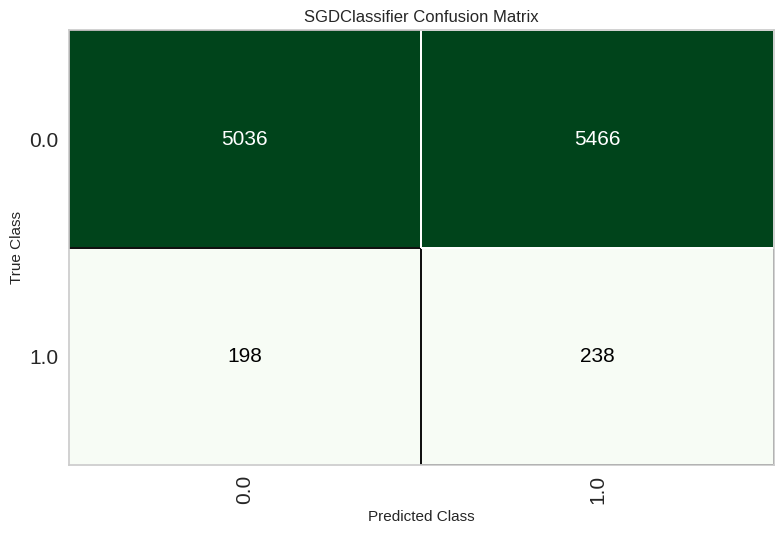

In [ ]:
svm = create_model('svm')

tuned_svm, tuner = tune_model(svm,optimize = 'eer',return_tuner=True,choose_better = True,n_iter = 50)

print(svm)
print(tuned_svm)


plot_model(tuned_svm,plot = 'confusion_matrix')

#### Decision Tree

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.8840,0.4943,0.0966,0.0458,0.0621,0.0086,0.0093,0.4964
1,0.8796,0.4875,0.0897,0.0406,0.0559,0.0012,0.0014,0.4995
2,0.8648,0.4816,0.0966,0.0372,0.0537,-0.0039,-0.0044,0.5019
3,0.7937,0.4112,0.0345,0.0081,0.0131,-0.0548,-0.0731,0.5392
4,0.7990,0.4100,0.0411,0.0100,0.0161,-0.0516,-0.0679,0.5359
5,0.8220,0.4485,0.0479,0.0135,0.0211,-0.0441,-0.0549,0.5271
6,0.7981,0.4383,0.0548,0.0132,0.0213,-0.0462,-0.0611,0.5327
7,0.7964,0.4939,0.0897,0.0209,0.0339,-0.0328,-0.0439,0.5244
8,0.8222,0.5374,0.1655,0.0436,0.0690,0.0064,0.0082,0.4956


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.8033,0.5479,0.2621,0.0586,0.0958,0.0330,0.0449,0.4719
1,0.8409,0.4832,0.1034,0.0323,0.0492,-0.0122,-0.0147,0.5071
2,0.8549,0.5100,0.1517,0.0514,0.0768,0.0185,0.0217,0.4897
3,0.7510,0.4113,0.0966,0.0177,0.0299,-0.0400,-0.0594,0.5373
4,0.7414,0.4883,0.2329,0.0393,0.0673,-0.0014,-0.0021,0.5015
5,0.7298,0.5003,0.2740,0.0435,0.0751,0.0065,0.0103,0.4923
6,0.7381,0.5048,0.2534,0.0419,0.0719,0.0034,0.0054,0.4961
7,0.7772,0.4812,0.2690,0.0523,0.0876,0.0225,0.0326,0.4780
8,0.6573,0.4939,0.3586,0.0430,0.0769,0.0063,0.0118,0.4892


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 10 candidates, totalling 100 fits


DecisionTreeClassifier(ccp_alpha=0.0, class_weight=None, criterion='gini',
                       max_depth=None, max_features=None, max_leaf_nodes=None,
                       min_impurity_decrease=0.0, min_samples_leaf=1,
                       min_samples_split=2, min_weight_fraction_leaf=0.0,
                       random_state=2785, splitter='best')
DecisionTreeClassifier(ccp_alpha=0.0, class_weight=None, criterion='gini',
                       max_depth=5, max_features='sqrt', max_leaf_nodes=None,
                       min_impurity_decrease=0.0002, min_samples_leaf=4,
                       min_samples_split=5, min_weight_fraction_leaf=0.0,
                       random_state=2785, splitter='best')


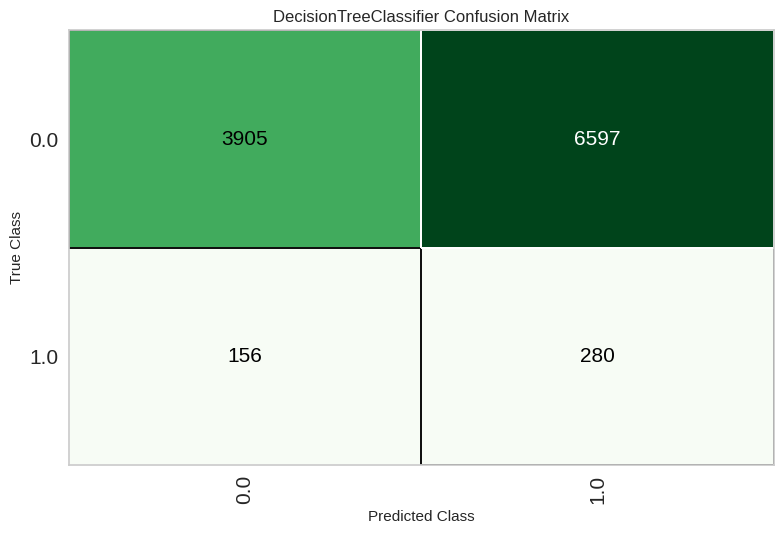

In [ ]:
dt = create_model('dt')

tuned_dt, tuner = tune_model(dt,optimize = 'eer',return_tuner=True,choose_better = True)

print(dt)
print(tuned_dt)


plot_model(tuned_dt,plot = 'confusion_matrix')

#### Ridge

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.5957,0.0000,0.4414,0.0439,0.0799,0.0081,0.0174,0.4813
1,0.6306,0.0000,0.3448,0.0384,0.0691,-0.0026,-0.0052,0.5049
2,0.5776,0.0000,0.5724,0.0532,0.0973,0.0264,0.0593,0.4253
3,0.5343,0.0000,0.3379,0.0297,0.0546,-0.0200,-0.0470,0.5497
4,0.6196,0.0000,0.4521,0.0481,0.0869,0.0156,0.0318,0.4665
5,0.6064,0.0000,0.4178,0.0432,0.0784,0.0062,0.0129,0.4866
6,0.5326,0.0000,0.4932,0.0423,0.0779,0.0045,0.0108,0.4868
7,0.6187,0.0000,0.5103,0.0531,0.0962,0.0260,0.0537,0.4400
8,0.4971,0.0000,0.5448,0.0428,0.0794,0.0060,0.0156,0.4810


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.5957,0.0000,0.4414,0.0439,0.0799,0.0081,0.0174,0.4813
1,0.6306,0.0000,0.3448,0.0384,0.0691,-0.0026,-0.0052,0.5049
2,0.5779,0.0000,0.5724,0.0532,0.0974,0.0265,0.0595,0.4252
3,0.5343,0.0000,0.3379,0.0297,0.0546,-0.0200,-0.0470,0.5497
4,0.6196,0.0000,0.4521,0.0481,0.0869,0.0156,0.0318,0.4665
5,0.6064,0.0000,0.4178,0.0432,0.0784,0.0062,0.0129,0.4866
6,0.5326,0.0000,0.4932,0.0423,0.0779,0.0045,0.0108,0.4868
7,0.6187,0.0000,0.5103,0.0531,0.0962,0.0260,0.0537,0.4400
8,0.4968,0.0000,0.5379,0.0423,0.0784,0.0050,0.0129,0.4841


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 10 candidates, totalling 100 fits


Original model was better than the tuned model, hence it will be returned. NOTE: The display metrics are for the tuned model (not the original one).
RidgeClassifier(alpha=1.0, class_weight=None, copy_X=True, fit_intercept=True,
                max_iter=None, positive=False, random_state=2785, solver='auto',
                tol=0.0001)
RidgeClassifier(alpha=1.0, class_weight=None, copy_X=True, fit_intercept=True,
                max_iter=None, positive=False, random_state=2785, solver='auto',
                tol=0.0001)


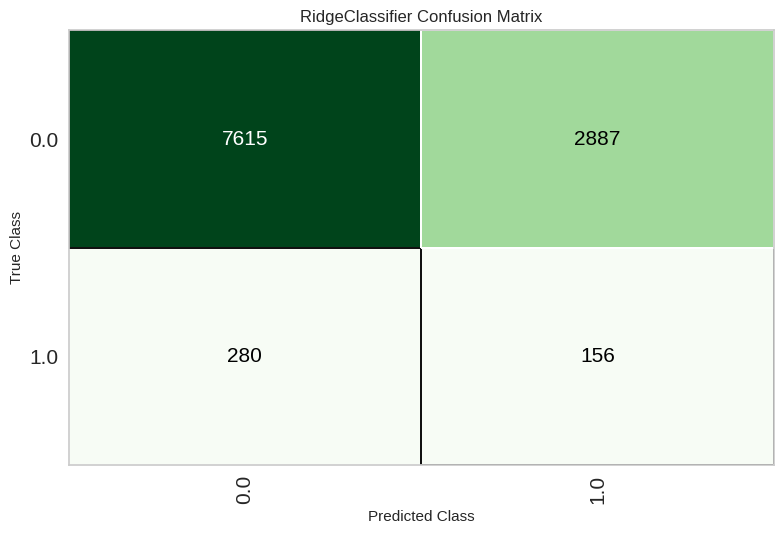

In [ ]:
ridge = create_model('ridge')

tuned_ridge, tuner = tune_model(ridge,optimize = 'eer',return_tuner=True,choose_better = True)

print(ridge)
print(tuned_ridge)

plot_model(tuned_ridge,plot = 'confusion_matrix')

#### Linear Discriminant

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.5957,0.5367,0.4414,0.0439,0.0799,0.0081,0.0174,0.4813
1,0.6306,0.4818,0.3448,0.0384,0.0691,-0.0026,-0.0052,0.5049
2,0.5776,0.5746,0.5724,0.0532,0.0973,0.0264,0.0593,0.4253
3,0.5343,0.4143,0.3379,0.0297,0.0546,-0.0200,-0.0470,0.5497
4,0.6196,0.5572,0.4521,0.0481,0.0869,0.0156,0.0318,0.4665
5,0.6064,0.5180,0.4178,0.0432,0.0784,0.0062,0.0129,0.4866
6,0.5326,0.4862,0.4932,0.0423,0.0779,0.0045,0.0108,0.4868
7,0.6187,0.5513,0.5103,0.0531,0.0962,0.0260,0.0537,0.4400
8,0.4971,0.5113,0.5448,0.0428,0.0794,0.0060,0.0156,0.4810


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.5957,0.5367,0.4414,0.0439,0.0799,0.0081,0.0174,0.4813
1,0.6306,0.4817,0.3448,0.0384,0.0691,-0.0026,-0.0052,0.5049
2,0.5779,0.5745,0.5724,0.0532,0.0974,0.0265,0.0595,0.4252
3,0.5343,0.4142,0.3379,0.0297,0.0546,-0.0200,-0.0470,0.5497
4,0.6196,0.5572,0.4521,0.0481,0.0869,0.0156,0.0318,0.4665
5,0.6061,0.5181,0.4178,0.0432,0.0783,0.0062,0.0128,0.4867
6,0.5326,0.4862,0.4932,0.0423,0.0779,0.0045,0.0108,0.4868
7,0.6187,0.5512,0.5103,0.0531,0.0962,0.0260,0.0537,0.4400
8,0.4968,0.5110,0.5379,0.0423,0.0784,0.0050,0.0129,0.4841


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 10 candidates, totalling 100 fits


Original model was better than the tuned model, hence it will be returned. NOTE: The display metrics are for the tuned model (not the original one).
LinearDiscriminantAnalysis(covariance_estimator=None, n_components=None,
                           priors=None, shrinkage=None, solver='svd',
                           store_covariance=False, tol=0.0001)
LinearDiscriminantAnalysis(covariance_estimator=None, n_components=None,
                           priors=None, shrinkage=None, solver='svd',
                           store_covariance=False, tol=0.0001)


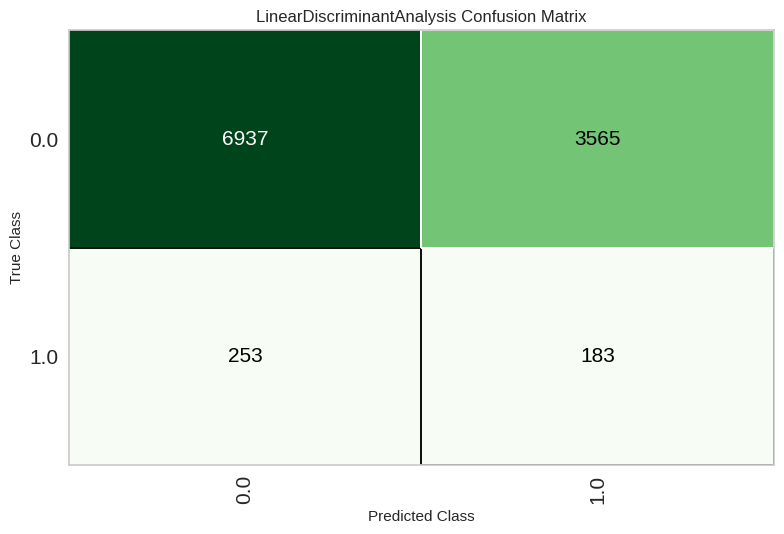

In [ ]:
lda = create_model('lda')

tuned_lda, tuner = tune_model(lda,optimize = 'eer',return_tuner=True,choose_better = True)

print(lda)
print(tuned_lda)

plot_model(tuned_lda,plot = 'confusion_matrix')

#### Logistic Regression

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.5952,0.5368,0.4414,0.0439,0.0798,0.0080,0.0171,0.4815
1,0.6306,0.4818,0.3379,0.0377,0.0678,-0.0040,-0.0079,0.5074
2,0.5776,0.5741,0.5724,0.0532,0.0973,0.0264,0.0593,0.4253
3,0.5370,0.4148,0.3379,0.0299,0.0549,-0.0196,-0.0459,0.5484
4,0.6196,0.5573,0.4521,0.0481,0.0869,0.0156,0.0318,0.4665
5,0.6039,0.5187,0.4178,0.0430,0.0779,0.0057,0.0119,0.4876
6,0.5324,0.4856,0.4932,0.0423,0.0779,0.0044,0.0107,0.4870
7,0.6198,0.5515,0.5103,0.0533,0.0965,0.0263,0.0542,0.4396
8,0.4955,0.5114,0.5379,0.0422,0.0782,0.0048,0.0124,0.4848


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.5952,0.5368,0.4414,0.0439,0.0798,0.0080,0.0171,0.4815
1,0.6306,0.4817,0.3379,0.0377,0.0678,-0.0040,-0.0079,0.5074
2,0.5776,0.5741,0.5724,0.0532,0.0973,0.0264,0.0593,0.4253
3,0.5370,0.4148,0.3379,0.0299,0.0549,-0.0196,-0.0459,0.5484
4,0.6196,0.5573,0.4521,0.0481,0.0869,0.0156,0.0318,0.4665
5,0.6039,0.5187,0.4178,0.0430,0.0779,0.0057,0.0119,0.4876
6,0.5324,0.4855,0.4932,0.0423,0.0779,0.0044,0.0107,0.4870
7,0.6198,0.5516,0.5103,0.0533,0.0965,0.0263,0.0542,0.4396
8,0.4960,0.5117,0.5448,0.0427,0.0792,0.0059,0.0152,0.4815


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 10 candidates, totalling 100 fits


LogisticRegression(C=1.0, class_weight=None, dual=False, fit_intercept=True,
                   intercept_scaling=1, l1_ratio=None, max_iter=1000,
                   multi_class='auto', n_jobs=None, penalty='l2',
                   random_state=2785, solver='lbfgs', tol=0.0001, verbose=0,
                   warm_start=False)
LogisticRegression(C=8.818, class_weight='balanced', dual=False,
                   fit_intercept=True, intercept_scaling=1, l1_ratio=None,
                   max_iter=1000, multi_class='auto', n_jobs=None, penalty='l2',
                   random_state=2785, solver='lbfgs', tol=0.0001, verbose=0,
                   warm_start=False)


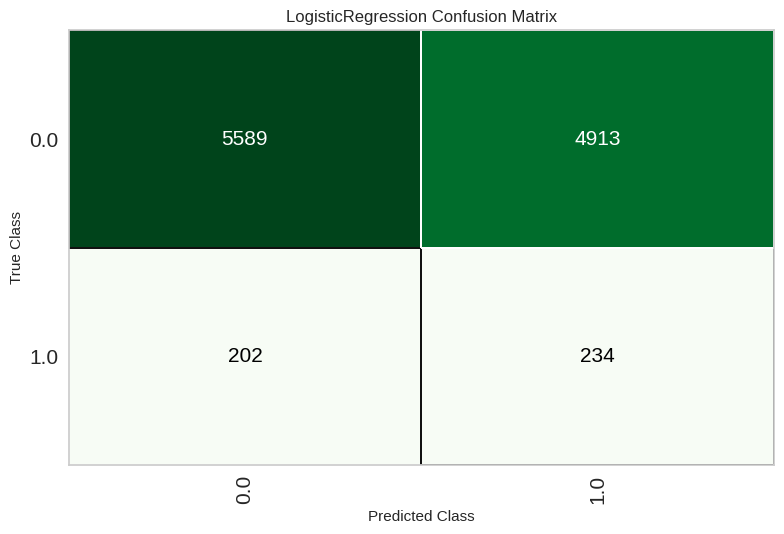

In [ ]:
lr = create_model('lr')

tuned_lr, tuner = tune_model(lr,optimize = 'eer',return_tuner=True,choose_better = True)

print(lr)
print(tuned_lr)

plot_model(tuned_lr,plot = 'confusion_matrix')

#### CatBoost

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9506,0.5262,0.0276,0.0930,0.0426,0.0248,0.0298,0.4958
1,0.9402,0.5770,0.0207,0.0380,0.0268,-0.0013,-0.0014,0.5003
2,0.9545,0.4700,0.0552,0.2162,0.0879,0.0729,0.0914,0.4879
3,0.9339,0.4145,0.0069,0.0102,0.0082,-0.0246,-0.0251,0.5053
4,0.9438,0.4312,0.0137,0.0317,0.0191,-0.0051,-0.0056,0.5009
5,0.9344,0.5086,0.0137,0.0206,0.0165,-0.0160,-0.0164,0.5034
6,0.9188,0.4095,0.0274,0.0253,0.0263,-0.0160,-0.0160,0.5043
7,0.9303,0.5130,0.0690,0.0775,0.0730,0.0369,0.0370,0.4908
8,0.9257,0.5212,0.0759,0.0743,0.0751,0.0364,0.0364,0.4903


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.6673,0.5122,0.3655,0.0451,0.0804,0.0103,0.0190,0.4828
1,0.7543,0.4953,0.2414,0.0426,0.0725,0.0052,0.0079,0.4945
2,0.8064,0.6134,0.3379,0.0744,0.1219,0.0607,0.0831,0.4450
3,0.6026,0.4198,0.3034,0.0316,0.0573,-0.0159,-0.0328,0.5311
4,0.8533,0.5669,0.1712,0.0569,0.0855,0.0270,0.0319,0.4845
5,0.6574,0.5065,0.4041,0.0483,0.0863,0.0159,0.0300,0.4715
6,0.5716,0.5287,0.5068,0.0473,0.0865,0.0144,0.0321,0.4620
7,0.6472,0.4865,0.3724,0.0432,0.0775,0.0067,0.0128,0.4880
8,0.5759,0.5124,0.4552,0.0431,0.0787,0.0064,0.0143,0.4840


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 10 candidates, totalling 100 fits


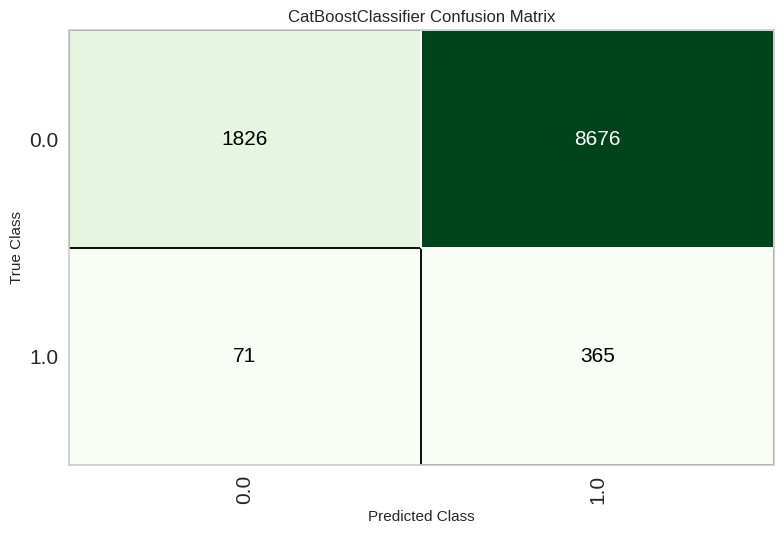

In [ ]:
cb = create_model('catboost')

tuned_cb, tuner = tune_model(cb,optimize = 'eer',return_tuner=True,choose_better = True)

print(cb)
print(tuned_cb)

plot_model(tuned_cb,plot = 'confusion_matrix')

#### XGBoost

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9482,0.5334,0.0276,0.0769,0.0406,0.0200,0.0229,0.4965
1,0.9386,0.5546,0.0207,0.0353,0.0261,-0.0034,-0.0035,0.5007
2,0.9504,0.5056,0.0552,0.1538,0.0812,0.0615,0.0702,0.4890
3,0.9243,0.4142,0.0138,0.0148,0.0143,-0.0250,-0.0250,0.5062
4,0.9405,0.4551,0.0274,0.0506,0.0356,0.0077,0.0080,0.4985
5,0.9347,0.5225,0.0342,0.0490,0.0403,0.0076,0.0078,0.4983
6,0.9139,0.4234,0.0137,0.0116,0.0126,-0.0321,-0.0322,0.5090
7,0.9314,0.5397,0.0483,0.0588,0.0530,0.0178,0.0179,0.4958
8,0.9213,0.5309,0.1103,0.0920,0.1003,0.0595,0.0598,0.4823


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.0398,0.4907,1.0000,0.0398,0.0765,0.0000,0.0000,0.5000
1,0.0398,0.5024,1.0000,0.0398,0.0765,0.0000,0.0000,0.5000
2,0.0398,0.4498,1.0000,0.0398,0.0765,0.0000,0.0000,0.5000
3,0.0398,0.4810,1.0000,0.0398,0.0765,0.0000,0.0000,0.5000
4,0.0400,0.4706,1.0000,0.0400,0.0770,0.0000,0.0000,0.5000
5,0.0400,0.4475,1.0000,0.0400,0.0770,0.0000,0.0000,0.5000
6,0.0400,0.3823,1.0000,0.0400,0.0770,0.0000,0.0000,0.5000
7,0.0398,0.4965,1.0000,0.0398,0.0765,0.0000,0.0000,0.5000
8,0.0398,0.4881,1.0000,0.0398,0.0765,0.0000,0.0000,0.5000


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 10 candidates, totalling 100 fits


Original model was better than the tuned model, hence it will be returned. NOTE: The display metrics are for the tuned model (not the original one).
XGBClassifier(base_score=None, booster='gbtree', callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, device='cpu', early_stopping_rounds=None,
              enable_categorical=False, eval_metric=None, feature_types=None,
              gamma=None, grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=None, max_bin=None,
              max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=None, max_leaves=None,
              min_child_weight=None, missing=nan, monotone_constraints=None,
              multi_strategy=None, n_estimators=None, n_jobs=-1,
              num_parallel_tree=None, objective='binary:logistic', ...)
XGBClassifier(base_score=None, booster='gbtree', callbacks=None,
              c

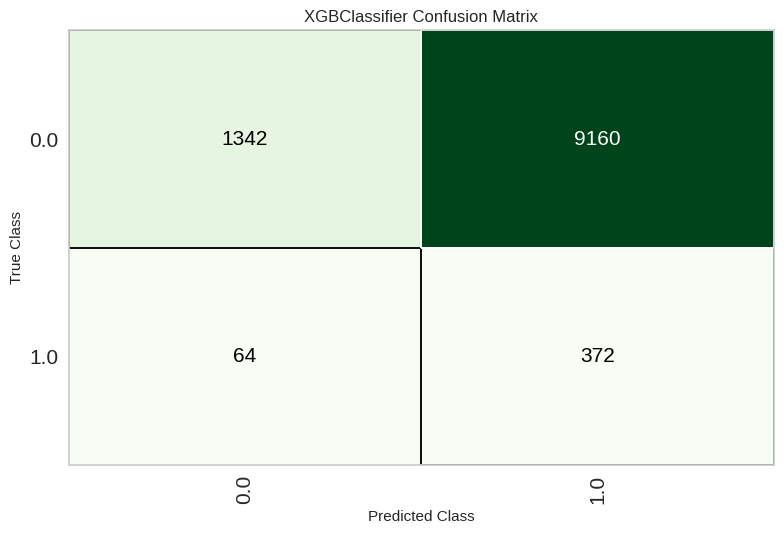

In [ ]:
xgboost = create_model('xgboost')

tuned_xgboost, tuner = tune_model(xgboost,optimize = 'eer',return_tuner=True,choose_better = True)

print(xgboost)
print(tuned_xgboost)

plot_model(tuned_xgboost,plot = 'confusion_matrix')

#### LightGBM

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9512,0.5249,0.0069,0.0286,0.0111,-0.0044,-0.0056,0.5007
1,0.9487,0.5473,0.0207,0.0625,0.0311,0.0115,0.0134,0.4980
2,0.9564,0.4863,0.0207,0.1500,0.0364,0.0270,0.0419,0.4960
3,0.9446,0.4260,0.0069,0.0169,0.0098,-0.0135,-0.0150,0.5024
4,0.9545,0.4458,0.0274,0.1429,0.0460,0.0335,0.0461,0.4948
5,0.9391,0.5234,0.0000,0.0000,0.0000,-0.0282,-0.0298,0.5055
6,0.9473,0.3862,0.0137,0.0400,0.0204,-0.0000,-0.0000,0.5000
7,0.9457,0.5344,0.0276,0.0656,0.0388,0.0156,0.0172,0.4971
8,0.9339,0.5127,0.0276,0.0385,0.0321,-0.0011,-0.0012,0.5003


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9561,0.5979,0.0345,0.2000,0.0588,0.0477,0.0681,0.4927
1,0.9427,0.5333,0.0345,0.0676,0.0457,0.0193,0.0205,0.4962
2,0.9501,0.5547,0.0552,0.1509,0.0808,0.0608,0.0691,0.4890
3,0.9287,0.4008,0.0138,0.0168,0.0152,-0.0215,-0.0216,0.5050
4,0.9421,0.4643,0.0068,0.0149,0.0094,-0.0162,-0.0175,0.5030
5,0.9369,0.4826,0.0274,0.0435,0.0336,0.0027,0.0028,0.4994
6,0.9166,0.4400,0.0342,0.0298,0.0318,-0.0115,-0.0115,0.5032
7,0.9353,0.5670,0.0621,0.0826,0.0709,0.0380,0.0384,0.4912
8,0.9257,0.5559,0.0759,0.0743,0.0751,0.0364,0.0364,0.4903


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 10 candidates, totalling 100 fits


LGBMClassifier(boosting_type='gbdt', class_weight=None, colsample_bytree=1.0,
               importance_type='split', learning_rate=0.1, max_depth=-1,
               min_child_samples=20, min_child_weight=0.001, min_split_gain=0.0,
               n_estimators=100, n_jobs=-1, num_leaves=31, objective=None,
               random_state=2785, reg_alpha=0.0, reg_lambda=0.0, subsample=1.0,
               subsample_for_bin=200000, subsample_freq=0)
LGBMClassifier(bagging_fraction=0.7, bagging_freq=5, boosting_type='gbdt',
               class_weight=None, colsample_bytree=1.0, feature_fraction=0.5,
               importance_type='split', learning_rate=0.2, max_depth=-1,
               min_child_samples=26, min_child_weight=0.001, min_split_gain=0.3,
               n_estimators=210, n_jobs=-1, num_leaves=200, objective=None,
               random_state=2785, reg_alpha=0.001, reg_lambda=4, subsample=1.0,
               subsample_for_bin=200000, subsample_freq=0)


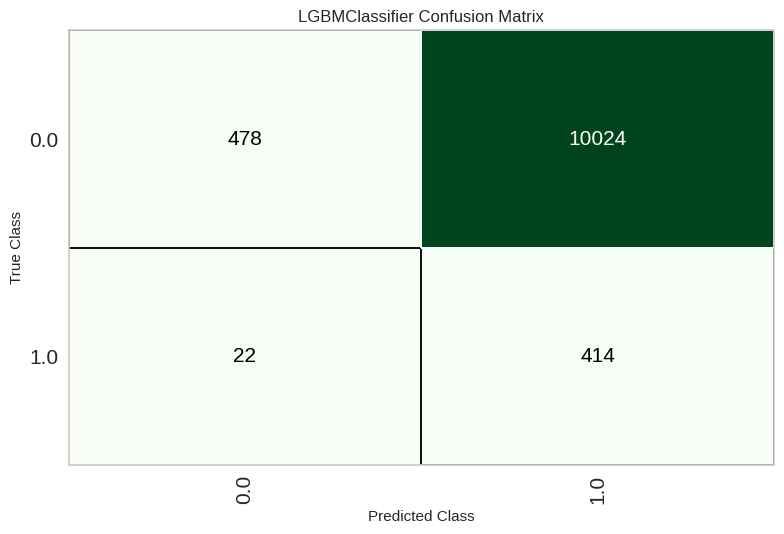

In [ ]:
lightgbm = create_model('lightgbm')

tuned_lightgbm, tuner = tune_model(lightgbm,optimize = 'eer',return_tuner=True,choose_better = True)

print(lightgbm)
print(tuned_lightgbm)

plot_model(tuned_lightgbm,plot = 'confusion_matrix')

#### Adaboost

In [ ]:
adaboost = create_model('ada')

tuned_ada, tuner = tune_model(adaboost,optimize = 'eer',return_tuner=True,choose_better = True)



,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9604,0.6035,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
1,0.9604,0.5676,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
2,0.9600,0.5942,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
3,0.9600,0.6582,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
4,0.9600,0.5891,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
5,0.9600,0.5577,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
6,0.9596,0.5777,0.0000,0.0000,0.0000,-0.0008,-0.0040,0.5001
7,0.9600,0.5693,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
8,0.9600,0.5935,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,,
,,
Initiated,. . . . . . . . . . . . . . . . . .,21:29:36
Status,. . . . . . . . . . . . . . . . . .,Searching Hyperparameters
Estimator,. . . . . . . . . . . . . . . . . .,Ada Boost Classifier


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 10 candidates, totalling 100 fits


AdaBoostClassifier(algorithm='SAMME.R', base_estimator='deprecated',
                   estimator=None, learning_rate=1.0, n_estimators=50,
                   random_state=492)
AdaBoostClassifier(algorithm='SAMME', base_estimator='deprecated',
                   estimator=None, learning_rate=0.01, n_estimators=220,
                   random_state=492)


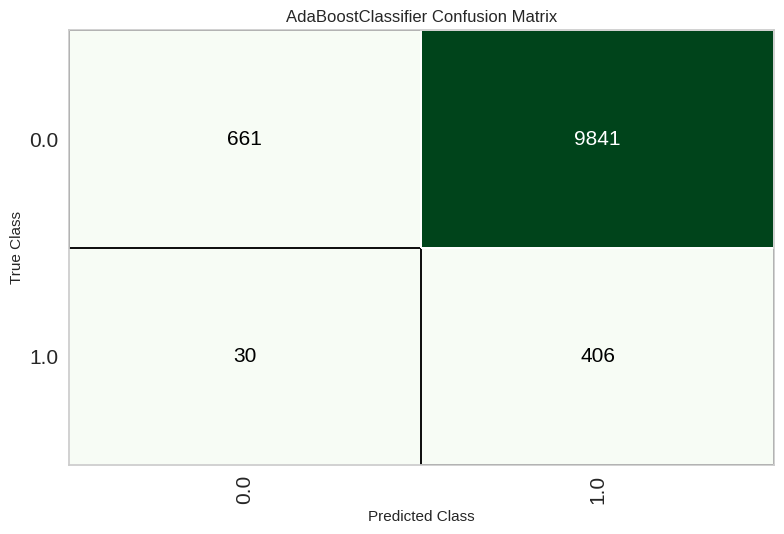

In [ ]:
print(adaboost)
print(tuned_ada)

plot_model(tuned_ada,plot = 'confusion_matrix')

#### Quadratic Discriminant

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.0428,0.5016,1.0000,0.0399,0.0767,0.0003,0.0112,0.4992
1,0.0400,0.5001,1.0000,0.0398,0.0765,0.0000,0.0034,0.4999
2,0.0398,0.5000,1.0000,0.0398,0.0765,0.0000,0.0000,0.5000
3,0.0436,0.5020,1.0000,0.0399,0.0768,0.0003,0.0126,0.4990
4,0.0422,0.5011,1.0000,0.0401,0.0772,0.0002,0.0096,0.4994
5,0.0403,0.5001,1.0000,0.0401,0.0770,0.0000,0.0034,0.4999
6,0.0406,0.5003,1.0000,0.0401,0.0770,0.0000,0.0048,0.4999
7,0.0398,0.5000,1.0000,0.0398,0.0765,0.0000,0.0000,0.5000
8,0.0398,0.5000,1.0000,0.0398,0.0765,0.0000,0.0000,0.5000


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.2515,0.4996,0.7517,0.0389,0.0740,-0.0018,-0.0081,0.5057
1,0.2466,0.4863,0.7241,0.0373,0.0710,-0.0050,-0.0228,0.5164
2,0.2682,0.4370,0.6897,0.0367,0.0697,-0.0063,-0.0268,0.5207
3,0.2361,0.4621,0.7655,0.0388,0.0738,-0.0020,-0.0096,0.5065
4,0.2501,0.4950,0.6849,0.0359,0.0682,-0.0086,-0.0384,0.5286
5,0.3269,0.5221,0.7192,0.0417,0.0788,0.0034,0.0126,0.4894
6,0.2318,0.3638,0.7055,0.0360,0.0685,-0.0083,-0.0394,0.5276
7,0.2488,0.5245,0.8414,0.0430,0.0818,0.0066,0.0309,0.4797
8,0.2702,0.4764,0.6966,0.0372,0.0706,-0.0054,-0.0228,0.5176


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 10 candidates, totalling 100 fits


Original model was better than the tuned model, hence it will be returned. NOTE: The display metrics are for the tuned model (not the original one).
QuadraticDiscriminantAnalysis(priors=None, reg_param=0.0,
                              store_covariance=False, tol=0.0001)
QuadraticDiscriminantAnalysis(priors=None, reg_param=0.0,
                              store_covariance=False, tol=0.0001)


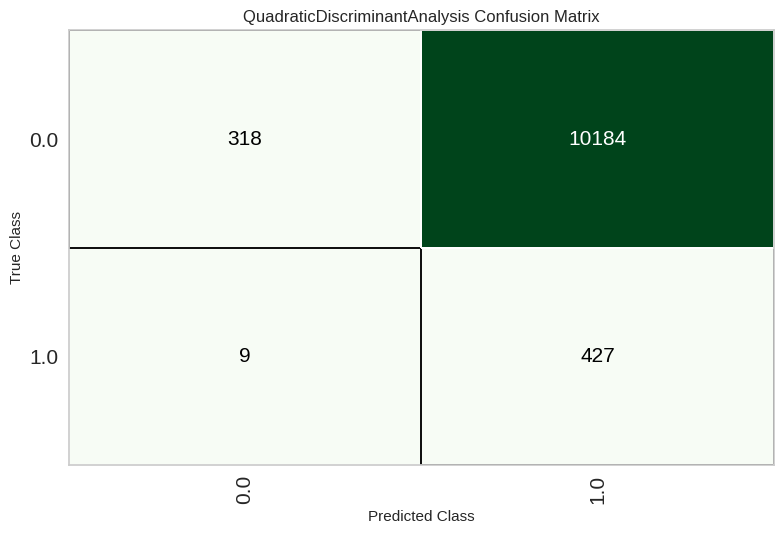

In [ ]:
qda = create_model('qda')

tuned_qda, tuner = tune_model(qda,optimize = 'eer',return_tuner=True,choose_better = True)

print(qda)
print(tuned_qda)

plot_model(tuned_qda,plot = 'confusion_matrix')

#### GradientBoosting

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9589,0.4956,0.0000,0.0000,0.0000,-0.0027,-0.0075,0.5004
1,0.9600,0.5164,0.0000,0.0000,0.0000,-0.0005,-0.0034,0.5001
2,0.9597,0.4454,0.0000,0.0000,0.0000,-0.0011,-0.0048,0.5001
3,0.9545,0.4415,0.0000,0.0000,0.0000,-0.0102,-0.0155,0.5015
4,0.9569,0.4792,0.0000,0.0000,0.0000,-0.0056,-0.0112,0.5008
5,0.9515,0.5269,0.0000,0.0000,0.0000,-0.0142,-0.0189,0.5022
6,0.9539,0.4071,0.0000,0.0000,0.0000,-0.0106,-0.0159,0.5016
7,0.9525,0.5365,0.0069,0.0333,0.0114,-0.0022,-0.0030,0.5003
8,0.9558,0.4966,0.0138,0.1000,0.0242,0.0147,0.0229,0.4978


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9377,0.5099,0.0552,0.0816,0.0658,0.0349,0.0356,0.4923
1,0.9161,0.5935,0.1172,0.0872,0.1000,0.0570,0.0577,0.4819
2,0.9185,0.5091,0.0759,0.0632,0.0690,0.0267,0.0269,0.4922
3,0.8911,0.4162,0.0207,0.0116,0.0149,-0.0380,-0.0397,0.5137
4,0.8892,0.4404,0.0411,0.0222,0.0288,-0.0244,-0.0257,0.5091
5,0.8799,0.4435,0.0411,0.0197,0.0267,-0.0290,-0.0312,0.5118
6,0.8892,0.4548,0.0685,0.0360,0.0472,-0.0056,-0.0060,0.5022
7,0.8859,0.5207,0.0897,0.0438,0.0588,0.0057,0.0061,0.4977
8,0.8872,0.5755,0.1448,0.0682,0.0927,0.0408,0.0441,0.4823


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 10 candidates, totalling 100 fits


GradientBoostingClassifier(ccp_alpha=0.0, criterion='friedman_mse', init=None,
                           learning_rate=0.1, loss='log_loss', max_depth=3,
                           max_features=None, max_leaf_nodes=None,
                           min_impurity_decrease=0.0, min_samples_leaf=1,
                           min_samples_split=2, min_weight_fraction_leaf=0.0,
                           n_estimators=100, n_iter_no_change=None,
                           random_state=492, subsample=1.0, tol=0.0001,
                           validation_fraction=0.1, verbose=0,
                           warm_start=False)
GradientBoostingClassifier(ccp_alpha=0.0, criterion='friedman_mse', init=None,
                           learning_rate=0.5, loss='log_loss', max_depth=7,
                           max_features=1.0, max_leaf_nodes=None,
                           min_impurity_decrease=0.02, min_samples_leaf=4,
                           min_samples_split=7, min_weight_fraction_leaf=0.0,
    

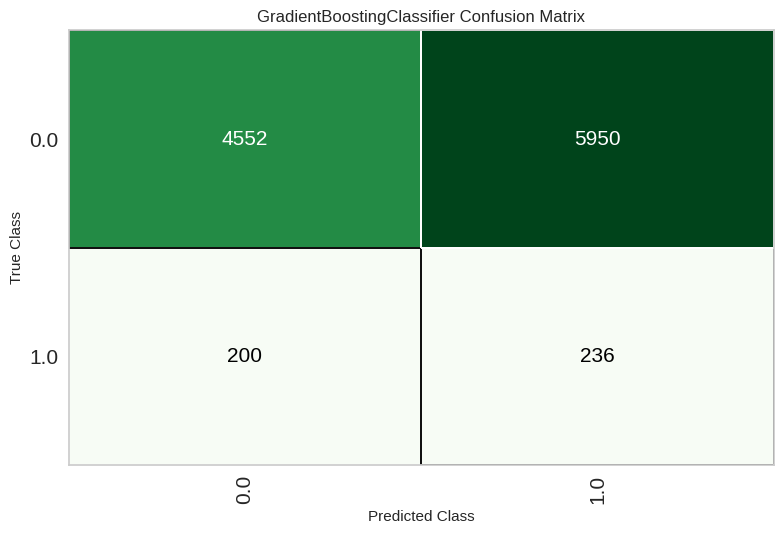

In [ ]:
gbc = create_model('gbc')

tuned_gbc, tuner = tune_model(gbc,optimize = 'eer',return_tuner=True,choose_better = True)

print(gbc)
print(tuned_gbc)

plot_model(tuned_gbc,plot = 'confusion_matrix')

#### Randomn Forest

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9399,0.4612,0.0414,0.0698,0.0519,0.0230,0.0239,0.4952
1,0.9251,0.4227,0.0483,0.0493,0.0488,0.0098,0.0098,0.4975
2,0.9240,0.3922,0.0897,0.0823,0.0858,0.0463,0.0463,0.4871
3,0.8640,0.1943,0.0138,0.0056,0.0080,-0.0514,-0.0574,0.5231
4,0.8796,0.2283,0.0411,0.0197,0.0266,-0.0291,-0.0314,0.5118
5,0.8790,0.2291,0.0342,0.0164,0.0222,-0.0338,-0.0364,0.5137
6,0.8626,0.2664,0.0548,0.0216,0.0309,-0.0281,-0.0317,0.5133
7,0.8796,0.3756,0.0621,0.0288,0.0394,-0.0158,-0.0171,0.5066
8,0.8870,0.4550,0.0966,0.0475,0.0636,0.0109,0.0117,0.4955


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.7331,0.4692,0.1517,0.0252,0.0433,-0.0268,-0.0417,0.5284
1,0.9602,0.4994,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
2,0.7754,0.5383,0.1241,0.0254,0.0421,-0.0256,-0.0363,0.5219
3,0.9602,0.4944,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
4,0.8705,0.6655,0.3699,0.1244,0.1862,0.1343,0.1582,0.4141
5,0.7874,0.5259,0.2329,0.0488,0.0807,0.0155,0.0217,0.4862
6,0.9600,0.4487,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
7,0.7331,0.5304,0.2483,0.0400,0.0689,0.0004,0.0006,0.4995
8,0.8085,0.5548,0.2483,0.0576,0.0935,0.0309,0.0415,0.4747


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 10 candidates, totalling 100 fits


RandomForestClassifier(bootstrap=True, ccp_alpha=0.0, class_weight=None,
                       criterion='gini', max_depth=None, max_features='sqrt',
                       max_leaf_nodes=None, max_samples=None,
                       min_impurity_decrease=0.0, min_samples_leaf=1,
                       min_samples_split=2, min_weight_fraction_leaf=0.0,
                       n_estimators=100, n_jobs=-1, oob_score=False,
                       random_state=492, verbose=0, warm_start=False)
RandomForestClassifier(bootstrap=False, ccp_alpha=0.0, class_weight={},
                       criterion='entropy', max_depth=2, max_features=1.0,
                       max_leaf_nodes=None, max_samples=None,
                       min_impurity_decrease=0.001, min_samples_leaf=5,
                       min_samples_split=5, min_weight_fraction_leaf=0.0,
                       n_estimators=50, n_jobs=-1, oob_score=False,
                       random_state=492, verbose=0, warm_start=False)


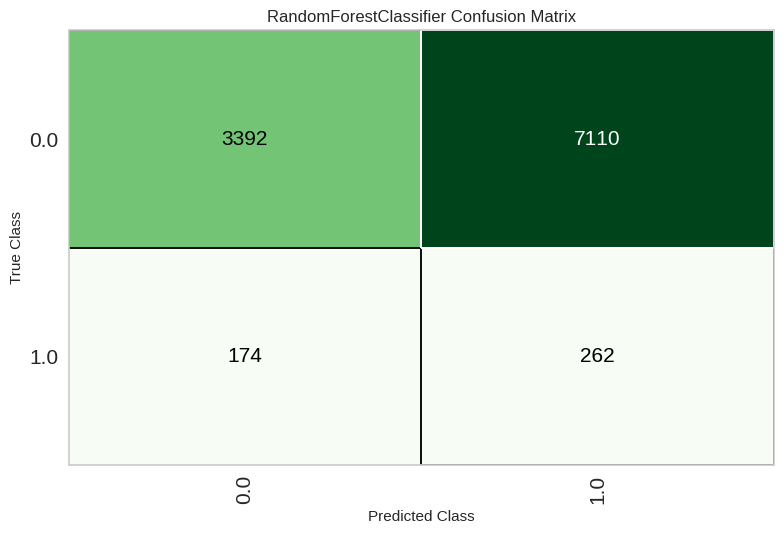

In [ ]:
rf = create_model('rf')

tuned_rf, tuner = tune_model(rf,optimize = 'eer',return_tuner=True,choose_better = True)

print(rf)
print(tuned_rf)

plot_model(tuned_rf,plot = 'confusion_matrix')

#### Extra Trees Classifier

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9577,0.7723,0.1485,0.4054,0.2174,0.2004,0.2276,0.4621
1,0.9604,0.7498,0.2178,0.5000,0.3034,0.2863,0.3128,0.4411
2,0.9620,0.7349,0.2059,0.5676,0.3022,0.2870,0.3267,0.4442
3,0.9569,0.7777,0.1961,0.4167,0.2667,0.2474,0.2663,0.4485
4,0.9592,0.7268,0.1765,0.4737,0.2571,0.2407,0.2722,0.4536
5,0.9561,0.7035,0.1373,0.3684,0.2000,0.1823,0.2061,0.4656
6,0.9565,0.7544,0.1863,0.4043,0.2550,0.2358,0.2547,0.4515
7,0.9596,0.7099,0.2157,0.4889,0.2993,0.2817,0.3070,0.4419
8,0.9573,0.7366,0.1667,0.4146,0.2378,0.2199,0.2444,0.4570


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.6775,0.5946,0.4455,0.0554,0.0986,0.0303,0.0555,0.4466
1,0.6446,0.5497,0.4554,0.0512,0.0921,0.0225,0.0440,0.4550
2,0.6023,0.5516,0.5000,0.0502,0.0913,0.0201,0.0426,0.4519
3,0.6144,0.6323,0.5686,0.0581,0.1055,0.0355,0.0742,0.4117
4,0.6054,0.5586,0.4804,0.0489,0.0887,0.0174,0.0365,0.4597
5,0.6238,0.5427,0.4902,0.0522,0.0943,0.0238,0.0484,0.4475
6,0.6755,0.5838,0.4314,0.0541,0.0961,0.0269,0.0492,0.4533
7,0.6579,0.5257,0.3627,0.0438,0.0781,0.0073,0.0137,0.4874
8,0.6321,0.5639,0.4608,0.0505,0.0910,0.0204,0.0407,0.4576


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 10 candidates, totalling 100 fits


ExtraTreesClassifier(bootstrap=False, ccp_alpha=0.0, class_weight=None,
                     criterion='gini', max_depth=None, max_features='sqrt',
                     max_leaf_nodes=None, max_samples=None,
                     min_impurity_decrease=0.0, min_samples_leaf=1,
                     min_samples_split=2, min_weight_fraction_leaf=0.0,
                     n_estimators=100, n_jobs=-1, oob_score=False,
                     random_state=123, verbose=0, warm_start=False)
ExtraTreesClassifier(bootstrap=False, ccp_alpha=0.0,
                     class_weight='balanced_subsample', criterion='gini',
                     max_depth=4, max_features='sqrt', max_leaf_nodes=None,
                     max_samples=None, min_impurity_decrease=0.0005,
                     min_samples_leaf=3, min_samples_split=5,
                     min_weight_fraction_leaf=0.0, n_estimators=260, n_jobs=-1,
                     oob_score=False, random_state=123, verbose=0,
                     warm_start=Fals

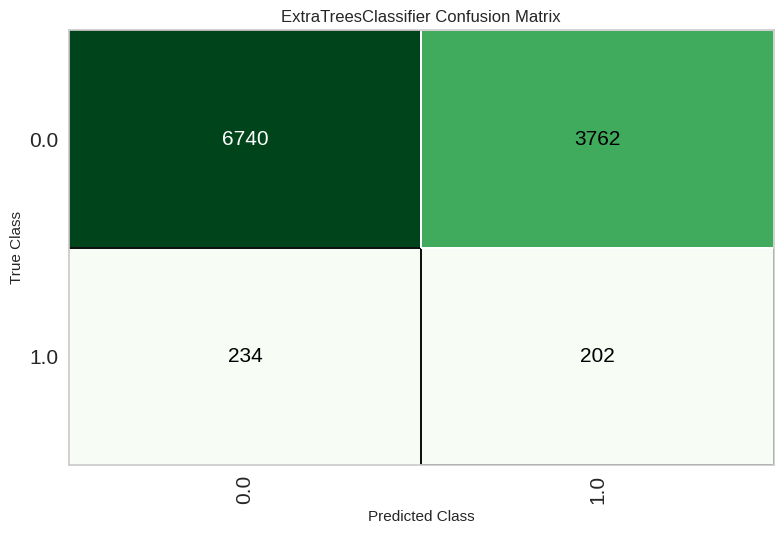

In [ ]:
et = create_model('et')

tuned_et, tuner = tune_model(et,optimize = 'eer',return_tuner=True,choose_better = True)

print(et)
print(tuned_et)

plot_model(tuned_et,plot = 'confusion_matrix')

#### Naive Bayes

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.0674,0.4844,0.9802,0.0400,0.0768,0.0008,0.0115,0.4974
1,0.0572,0.5688,0.9901,0.0399,0.0767,0.0007,0.0129,0.4978
2,0.0549,0.4958,0.9902,0.0402,0.0773,0.0005,0.0096,0.4985
3,0.0600,0.5703,0.9902,0.0404,0.0777,0.0009,0.0157,0.4971
4,0.0564,0.5212,1.0000,0.0406,0.0781,0.0014,0.0264,0.4957
5,0.0607,0.5401,0.9902,0.0404,0.0777,0.0010,0.0165,0.4969
6,0.0580,0.4932,1.0000,0.0407,0.0782,0.0015,0.0276,0.4953
7,0.0615,0.5186,0.9902,0.0405,0.0778,0.0011,0.0173,0.4967
8,0.0584,0.5146,0.9804,0.0400,0.0768,0.0000,0.0005,0.4999


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9361,0.4941,0.0495,0.0694,0.0578,0.0257,0.0261,0.4942
1,0.9334,0.5682,0.0396,0.0519,0.0449,0.0111,0.0112,0.4975
2,0.9397,0.5040,0.0490,0.0806,0.0610,0.0317,0.0328,0.4933
3,0.9353,0.5808,0.0882,0.1111,0.0984,0.0653,0.0658,0.4844
4,0.9306,0.5239,0.0196,0.0253,0.0221,-0.0133,-0.0134,0.5030
5,0.9353,0.5371,0.0294,0.0435,0.0351,0.0029,0.0030,0.4994
6,0.9361,0.5034,0.0490,0.0704,0.0578,0.0258,0.0263,0.4943
7,0.9432,0.5235,0.0392,0.0784,0.0523,0.0263,0.0280,0.4948
8,0.9444,0.5238,0.0490,0.1000,0.0658,0.0406,0.0433,0.4921


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 10 candidates, totalling 100 fits


GaussianNB(priors=None, var_smoothing=1e-09)
GaussianNB(priors=None, var_smoothing=1)


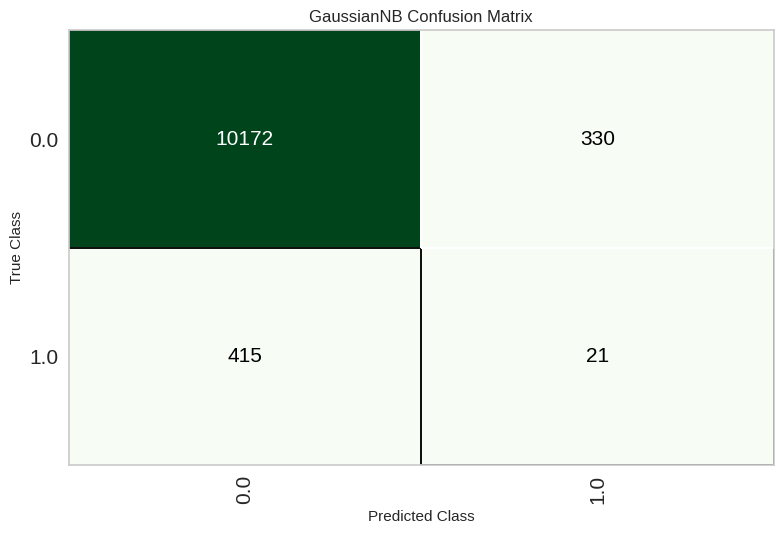

In [ ]:
nb = create_model('nb')

tuned_nb, tuner = tune_model(nb,optimize = 'eer',return_tuner=True,choose_better = True)

print(nb)
print(tuned_nb)

plot_model(tuned_nb,plot = 'confusion_matrix')

#### K-Nearest Neighbours

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9585,0.6674,0.0396,0.3077,0.0702,0.0617,0.0984,0.4908
1,0.9577,0.6830,0.0891,0.3600,0.1429,0.1292,0.1635,0.4783
2,0.9616,0.6723,0.1078,0.6111,0.1833,0.1734,0.2457,0.4722
3,0.9569,0.6970,0.0980,0.3571,0.1538,0.1390,0.1705,0.4761
4,0.9585,0.6667,0.0490,0.3571,0.0862,0.0773,0.1203,0.4884
5,0.9573,0.6586,0.0686,0.3333,0.1138,0.1016,0.1364,0.4837
6,0.9592,0.7148,0.0784,0.4444,0.1333,0.1228,0.1740,0.4806
7,0.9561,0.6397,0.0980,0.3333,0.1515,0.1358,0.1633,0.4763
8,0.9589,0.6505,0.0980,0.4348,0.1600,0.1475,0.1922,0.4756


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9581,0.7083,0.1485,0.4167,0.2190,0.2024,0.2314,0.4620
1,0.9596,0.7157,0.2178,0.4783,0.2993,0.2815,0.3049,0.4413
2,0.9624,0.7113,0.2157,0.5789,0.3143,0.2991,0.3383,0.4412
3,0.9573,0.7358,0.1863,0.4222,0.2585,0.2399,0.2614,0.4513
4,0.9589,0.7095,0.1765,0.4615,0.2553,0.2385,0.2681,0.4537
5,0.9561,0.7068,0.1373,0.3684,0.2000,0.1823,0.2061,0.4656
6,0.9573,0.7334,0.1863,0.4222,0.2585,0.2399,0.2614,0.4513
7,0.9592,0.6934,0.2157,0.4783,0.2973,0.2794,0.3031,0.4420
8,0.9573,0.6648,0.1667,0.4146,0.2378,0.2199,0.2444,0.4570


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 10 candidates, totalling 100 fits


KNeighborsClassifier(algorithm='auto', leaf_size=30, metric='minkowski',
                     metric_params=None, n_jobs=-1, n_neighbors=5, p=2,
                     weights='uniform')
KNeighborsClassifier(algorithm='auto', leaf_size=30, metric='manhattan',
                     metric_params=None, n_jobs=-1, n_neighbors=13, p=2,
                     weights='distance')


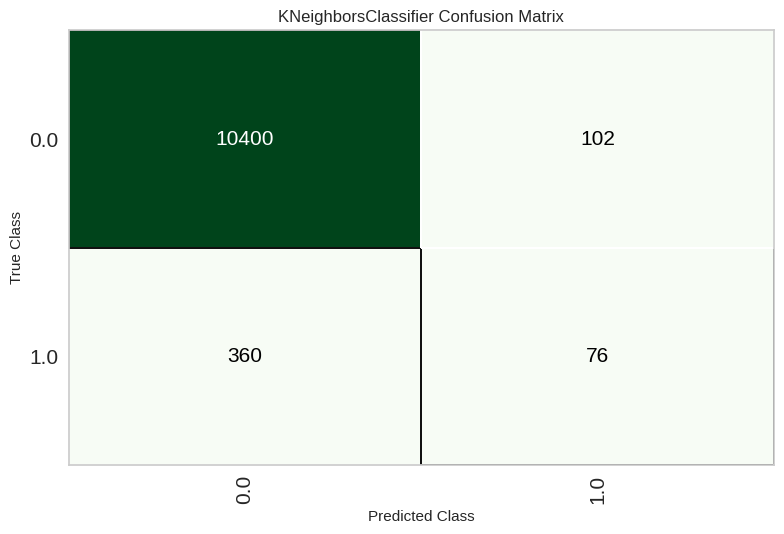

In [ ]:
knn = create_model('knn')

tuned_knn, tuner = tune_model(knn,optimize = 'eer',return_tuner=True,choose_better = True)

print(knn)
print(tuned_knn)

plot_model(tuned_knn,plot = 'confusion_matrix')

## Randomn OverSampling

In [ ]:
import imblearn
from imblearn.over_sampling import RandomOverSampler
ru = RandomOverSampler(random_state=0)
smote = setup(df,test_data = test_data, target = 'STATUS',normalize = True,ignore_features = ['ID'],fix_imbalance = True,fix_imbalance_method = ru,index=False)
add_metric('eer', 'eer', calculate_eer,greater_is_better=False)

,Description,Value
0,Session id,1626
1,Target,STATUS
2,Target type,Binary
3,Original data shape,"(47395, 52)"
4,Transformed data shape,"(80946, 51)"
5,Transformed train set shape,"(70008, 51)"
6,Transformed test set shape,"(10938, 51)"
7,Ignore features,1
8,Numeric features,50
9,Rows with missing values,23.1%


Name                                                               eer
Display Name                                                       eer
Score Function       <pycaret.internal.metrics.EncodedDecodedLabels...
Scorer               make_scorer(calculate_eer, greater_is_better=F...
Target                                                            pred
Args                                                                {}
Greater is Better                                                False
Multiclass                                                        True
Custom                                                            True
Name: eer, dtype: object

In [ ]:
best = compare_models(sort='eer')

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer,TT (Sec)
svm,SVM - Linear Kernel,0.5979,0.0000,0.4528,0.0457,0.0829,0.0113,0.0230,0.4745,1.5960
lda,Linear Discriminant Analysis,0.5760,0.5217,0.4631,0.0439,0.0801,0.0079,0.0174,0.4777,1.0250
ridge,Ridge Classifier,0.5727,0.0000,0.4659,0.0438,0.0800,0.0077,0.0171,0.4786,0.2870
lr,Logistic Regression,0.5704,0.5200,0.4673,0.0439,0.0802,0.0079,0.0168,0.4800,0.4800
ada,Ada Boost Classifier,0.5691,0.5243,0.4535,0.0423,0.0773,0.0048,0.0108,0.4866,2.5230
rf,Random Forest Classifier,0.8867,0.3406,0.1253,0.0643,0.0816,0.0308,0.0331,0.4869,8.6480
catboost,CatBoost Classifier,0.8151,0.5134,0.1907,0.0469,0.0750,0.0123,0.0165,0.4886,25.2820
gbc,Gradient Boosting Classifier,0.6307,0.5167,0.3848,0.0427,0.0768,0.0056,0.0106,0.4891,9.6600
et,Extra Trees Classifier,0.8803,0.3148,0.1198,0.0567,0.0744,0.0219,0.0235,0.4905,9.6180
lightgbm,Light Gradient Boosting Machine,0.7420,0.5112,0.2623,0.0441,0.0752,0.0076,0.0114,0.4908,3.8750


Processing:   0%|          | 0/69 [00:00<?, ?it/s]

In [ ]:
evaluate_model(best)

interactive(children=(ToggleButtons(description='Plot Type:', icons=('',), options=(('Pipeline Plot', 'pipelin…

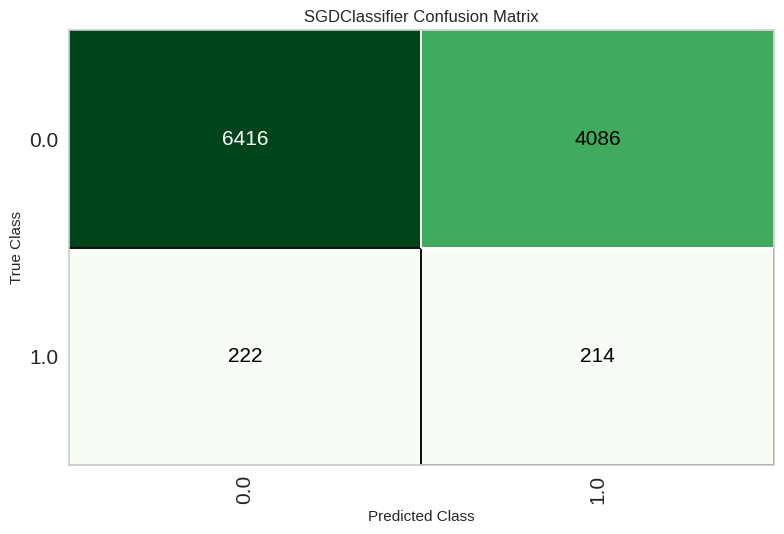

In [ ]:
plot_model(best,plot = 'confusion_matrix')

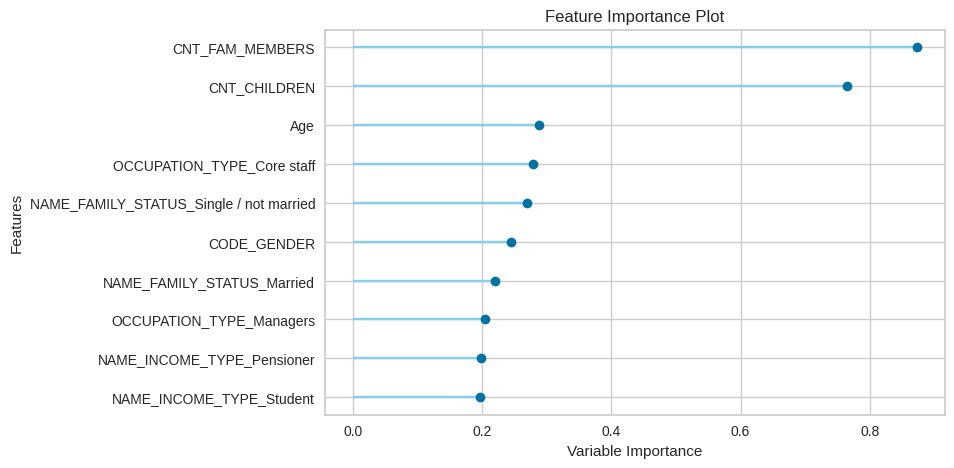

In [ ]:
plot_model(best,plot = 'feature')

### Models Confusion Matrix after oversampling

In [ ]:
rf = create_model('rf')
et = create_model('et')
dt = create_model('dt')
xgboost = create_model('xgboost')
catboost = create_model('catboost')
knn = create_model('knn')
lightgbm = create_model('lightgbm')
qda = create_model('qda')
lda = create_model('lda')
gbc = create_model('gbc')
svm = create_model('svm')
nb = create_model('nb')
lr = create_model('lr')
ridge = create_model('ridge')
ada = create_model('ada')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9350,0.4388,0.0897,0.1102,0.0989,0.0655,0.0659,0.4841
1,0.9188,0.4190,0.0552,0.0479,0.0513,0.0091,0.0091,0.4974
2,0.9194,0.3668,0.1103,0.0884,0.0982,0.0565,0.0569,0.4828
3,0.8566,0.1794,0.0345,0.0129,0.0188,-0.0415,-0.0475,0.5202
4,0.8681,0.2094,0.0685,0.0282,0.0399,-0.0178,-0.0199,0.5082
5,0.8656,0.2334,0.0822,0.0326,0.0467,-0.0113,-0.0127,0.5054
6,0.8574,0.2897,0.0959,0.0348,0.0511,-0.0081,-0.0094,0.5042
7,0.8790,0.3710,0.2000,0.0819,0.1162,0.0634,0.0707,0.4686
8,0.8867,0.4326,0.2414,0.1036,0.1449,0.0945,0.1043,0.4537


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9314,0.4357,0.0897,0.0992,0.0942,0.0587,0.0587,0.4851
1,0.9166,0.3921,0.0552,0.0457,0.0500,0.0068,0.0068,0.4980
2,0.9109,0.3164,0.1103,0.0755,0.0896,0.0445,0.0454,0.4852
3,0.8563,0.1649,0.0345,0.0129,0.0187,-0.0416,-0.0476,0.5203
4,0.8664,0.1700,0.0685,0.0277,0.0394,-0.0186,-0.0209,0.5087
5,0.8651,0.2001,0.0822,0.0324,0.0465,-0.0116,-0.0130,0.5055
6,0.8533,0.2305,0.0959,0.0336,0.0497,-0.0102,-0.0119,0.5054
7,0.8716,0.3351,0.2069,0.0783,0.1136,0.0593,0.0676,0.4687
8,0.8815,0.4131,0.2276,0.0935,0.1325,0.0807,0.0900,0.4595


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.8253,0.5122,0.1862,0.0495,0.0781,0.0163,0.0208,0.4886
1,0.8097,0.5314,0.0966,0.0243,0.0388,-0.0265,-0.0344,0.5184
2,0.8376,0.4925,0.1793,0.0521,0.0807,0.0204,0.0251,0.4869
3,0.7726,0.4507,0.1172,0.0237,0.0394,-0.0287,-0.0408,0.5247
4,0.7540,0.4410,0.1781,0.0324,0.0548,-0.0139,-0.0208,0.5137
5,0.7916,0.4879,0.1918,0.0418,0.0686,0.0031,0.0042,0.4974
6,0.7411,0.4302,0.1918,0.0328,0.0560,-0.0133,-0.0205,0.5141
7,0.7800,0.5587,0.2552,0.0506,0.0845,0.0194,0.0278,0.4816
8,0.7506,0.5654,0.3586,0.0599,0.1027,0.0370,0.0576,0.4554


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.8502,0.5228,0.1517,0.0494,0.0746,0.0155,0.0184,0.4911
1,0.8412,0.5529,0.0828,0.0262,0.0398,-0.0219,-0.0263,0.5125
2,0.8527,0.5018,0.1655,0.0545,0.0821,0.0236,0.0280,0.4864
3,0.8044,0.4306,0.0759,0.0186,0.0299,-0.0362,-0.0475,0.5254
4,0.8132,0.4441,0.1438,0.0364,0.0581,-0.0062,-0.0081,0.5044
5,0.8171,0.4844,0.1918,0.0485,0.0775,0.0145,0.0188,0.4894
6,0.7671,0.4360,0.1370,0.0269,0.0450,-0.0235,-0.0339,0.5210
7,0.7995,0.5426,0.2828,0.0614,0.1009,0.0380,0.0523,0.4663
8,0.7937,0.5617,0.3241,0.0670,0.1111,0.0484,0.0681,0.4539


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.8678,0.5148,0.1034,0.0409,0.0586,0.0017,0.0019,0.4992
1,0.8675,0.4720,0.0621,0.0253,0.0359,-0.0218,-0.0244,0.5101
2,0.8651,0.4923,0.1034,0.0398,0.0575,0.0000,0.0000,0.5000
3,0.8313,0.4202,0.0207,0.0063,0.0097,-0.0546,-0.0664,0.5310
4,0.8162,0.4206,0.0342,0.0094,0.0147,-0.0514,-0.0648,0.5322
5,0.8138,0.4552,0.0753,0.0198,0.0314,-0.0342,-0.0437,0.5226
6,0.7896,0.4302,0.0616,0.0141,0.0229,-0.0452,-0.0610,0.5337
7,0.8099,0.5113,0.0828,0.0210,0.0335,-0.0320,-0.0415,0.5220
8,0.8140,0.5148,0.1655,0.0413,0.0661,0.0026,0.0034,0.4981


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.7787,0.5433,0.3310,0.0633,0.1063,0.0424,0.0618,0.4563
1,0.8036,0.5441,0.1517,0.0358,0.0579,-0.0069,-0.0092,0.5053
2,0.7809,0.5432,0.3448,0.0663,0.1112,0.0477,0.0694,0.4506
3,0.7230,0.4192,0.1655,0.0263,0.0454,-0.0250,-0.0399,0.5280
4,0.7474,0.4765,0.2466,0.0425,0.0725,0.0045,0.0069,0.4951
5,0.7312,0.5008,0.2671,0.0428,0.0737,0.0050,0.0080,0.4940
6,0.6882,0.4451,0.1644,0.0231,0.0405,-0.0320,-0.0546,0.5406
7,0.7435,0.5726,0.2690,0.0449,0.0770,0.0095,0.0147,0.4893
8,0.6719,0.5365,0.3931,0.0489,0.0870,0.0175,0.0321,0.4703


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.7043,0.5155,0.3103,0.0440,0.0771,0.0079,0.0135,0.4890
1,0.7606,0.4820,0.1793,0.0333,0.0562,-0.0116,-0.0172,0.5112
2,0.8267,0.4668,0.0759,0.0216,0.0336,-0.0301,-0.0374,0.5186
3,0.6791,0.4792,0.2621,0.0345,0.0610,-0.0100,-0.0177,0.5145
4,0.4624,0.4739,0.4863,0.0363,0.0676,-0.0075,-0.0206,0.5255
5,0.2474,0.5128,0.8014,0.0413,0.0786,0.0026,0.0121,0.4919
6,0.6871,0.4694,0.2329,0.0320,0.0562,-0.0152,-0.0264,0.5207
7,0.9276,0.5127,0.0621,0.0657,0.0638,0.0262,0.0262,0.4933
8,0.6003,0.5175,0.4276,0.0432,0.0784,0.0066,0.0140,0.4852


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.6004,0.5386,0.4069,0.0413,0.0749,0.0029,0.0061,0.4936
1,0.6009,0.4619,0.3241,0.0335,0.0607,-0.0123,-0.0255,0.5246
2,0.5883,0.5839,0.5862,0.0557,0.1017,0.0314,0.0692,0.4129
3,0.5625,0.4211,0.3241,0.0304,0.0557,-0.0184,-0.0409,0.5414
4,0.6234,0.5441,0.4315,0.0466,0.0841,0.0127,0.0255,0.4738
5,0.5949,0.5247,0.4658,0.0464,0.0843,0.0124,0.0264,0.4709
6,0.5444,0.5120,0.5068,0.0445,0.0818,0.0088,0.0208,0.4746
7,0.6022,0.5473,0.4966,0.0497,0.0903,0.0194,0.0412,0.4535
8,0.4894,0.5040,0.5448,0.0422,0.0783,0.0048,0.0125,0.4849


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.6624,0.5082,0.4069,0.0490,0.0875,0.0177,0.0332,0.4685
1,0.6972,0.5232,0.2690,0.0376,0.0660,-0.0041,-0.0070,0.5056
2,0.6506,0.5422,0.4828,0.0552,0.0990,0.0298,0.0576,0.4403
3,0.5987,0.4319,0.2966,0.0306,0.0555,-0.0179,-0.0370,0.5351
4,0.6478,0.5062,0.3493,0.0411,0.0736,0.0021,0.0040,0.4963
5,0.6618,0.5423,0.4110,0.0497,0.0887,0.0186,0.0347,0.4670
6,0.5549,0.4835,0.4110,0.0376,0.0688,-0.0049,-0.0111,0.5123
7,0.6390,0.5594,0.4414,0.0493,0.0886,0.0184,0.0361,0.4633
8,0.5262,0.4995,0.5034,0.0422,0.0779,0.0049,0.0120,0.4851


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.5433,0.0000,0.4621,0.0405,0.0745,0.0015,0.0034,0.4960
1,0.6094,0.0000,0.3517,0.0369,0.0668,-0.0055,-0.0113,0.5111
2,0.6237,0.0000,0.5724,0.0596,0.1079,0.0387,0.0797,0.4059
3,0.5625,0.0000,0.3379,0.0317,0.0579,-0.0160,-0.0357,0.5366
4,0.6596,0.0000,0.3767,0.0456,0.0814,0.0108,0.0201,0.4814
5,0.5699,0.0000,0.4521,0.0425,0.0776,0.0048,0.0107,0.4880
6,0.6155,0.0000,0.4041,0.0429,0.0776,0.0056,0.0115,0.4884
7,0.5514,0.0000,0.4759,0.0424,0.0778,0.0052,0.0120,0.4859
8,0.5344,0.0000,0.4897,0.0419,0.0772,0.0042,0.0102,0.4876


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.0568,0.5062,0.9862,0.0399,0.0768,0.0004,0.0066,0.4989
1,0.0499,0.4547,1.0000,0.0402,0.0773,0.0008,0.0206,0.4973
2,0.0549,0.5390,0.9724,0.0394,0.0756,-0.0009,-0.0161,0.5027
3,0.0538,0.4440,1.0000,0.0403,0.0775,0.0012,0.0242,0.4963
4,0.0598,0.4822,0.9932,0.0406,0.0780,0.0011,0.0195,0.4964
5,0.0557,0.5053,1.0000,0.0407,0.0782,0.0013,0.0257,0.4959
6,0.0502,0.4244,0.9658,0.0392,0.0753,-0.0018,-0.0387,0.5057
7,0.0573,0.5181,0.9862,0.0400,0.0768,0.0004,0.0073,0.4987
8,0.0601,0.4524,0.9931,0.0403,0.0775,0.0012,0.0199,0.4963


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.6122,0.5379,0.4276,0.0445,0.0806,0.0093,0.0191,0.4801
1,0.5996,0.4822,0.3724,0.0379,0.0689,-0.0036,-0.0075,0.5075
2,0.5927,0.5745,0.5724,0.0551,0.1005,0.0302,0.0659,0.4187
3,0.5411,0.4197,0.3310,0.0296,0.0543,-0.0202,-0.0468,0.5489
4,0.6067,0.5521,0.4384,0.0452,0.0819,0.0101,0.0209,0.4778
5,0.6168,0.5351,0.4658,0.0490,0.0887,0.0175,0.0359,0.4616
6,0.5474,0.4972,0.5616,0.0492,0.0904,0.0181,0.0427,0.4465
7,0.6036,0.5451,0.4759,0.0480,0.0872,0.0161,0.0339,0.4626
8,0.4925,0.5193,0.5448,0.0424,0.0787,0.0053,0.0137,0.4834


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.5861,0.0000,0.4483,0.0435,0.0793,0.0073,0.0159,0.4825
1,0.5993,0.0000,0.3517,0.0360,0.0653,-0.0074,-0.0155,0.5154
2,0.5968,0.0000,0.5724,0.0557,0.1015,0.0312,0.0677,0.4170
3,0.5425,0.0000,0.3172,0.0285,0.0523,-0.0223,-0.0515,0.5530
4,0.6086,0.0000,0.4589,0.0473,0.0858,0.0143,0.0297,0.4681
5,0.5919,0.0000,0.4452,0.0442,0.0803,0.0081,0.0173,0.4813
6,0.5527,0.0000,0.5479,0.0486,0.0893,0.0170,0.0397,0.4498
7,0.5934,0.0000,0.5172,0.0504,0.0919,0.0209,0.0453,0.4473
8,0.4883,0.0000,0.5241,0.0406,0.0754,0.0016,0.0043,0.4947


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.5848,0.4881,0.4069,0.0397,0.0723,-0.0002,-0.0004,0.5004
1,0.6423,0.5276,0.3586,0.0412,0.0739,0.0027,0.0052,0.4951
2,0.5609,0.5317,0.5103,0.0461,0.0846,0.0126,0.0289,0.4652
3,0.5195,0.4791,0.4000,0.0337,0.0621,-0.0122,-0.0296,0.5336
4,0.6031,0.5713,0.5068,0.0511,0.0928,0.0216,0.0457,0.4482
5,0.5666,0.5088,0.3493,0.0332,0.0606,-0.0135,-0.0298,0.5306
6,0.5167,0.5366,0.5822,0.0476,0.0880,0.0151,0.0377,0.4550
7,0.5682,0.5689,0.5172,0.0475,0.0870,0.0152,0.0345,0.4584
8,0.4722,0.4552,0.4414,0.0336,0.0624,-0.0125,-0.0333,0.5413


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.8442,0.5203,0.1655,0.0510,0.0779,0.0182,0.0220,0.4889
1,0.8160,0.4717,0.0966,0.0253,0.0401,-0.0245,-0.0314,0.5165
2,0.8439,0.5108,0.1448,0.0451,0.0687,0.0086,0.0104,0.4949
3,0.7663,0.4200,0.0483,0.0097,0.0162,-0.0536,-0.0764,0.5445
4,0.7806,0.4440,0.0890,0.0191,0.0315,-0.0369,-0.0511,0.5295
5,0.7937,0.4564,0.0959,0.0221,0.0359,-0.0312,-0.0420,0.5235
6,0.7545,0.4782,0.1781,0.0325,0.0549,-0.0138,-0.0205,0.5135
7,0.7819,0.5152,0.2552,0.0511,0.0852,0.0202,0.0288,0.4810
8,0.7931,0.5328,0.2690,0.0568,0.0937,0.0300,0.0419,0.4729


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

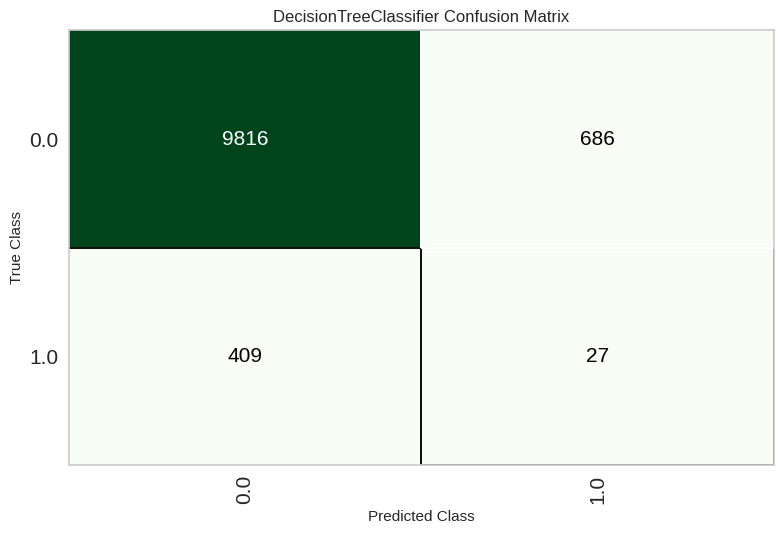

In [ ]:
dt = create_model('dt')
plot_model(dt,plot = 'confusion_matrix')

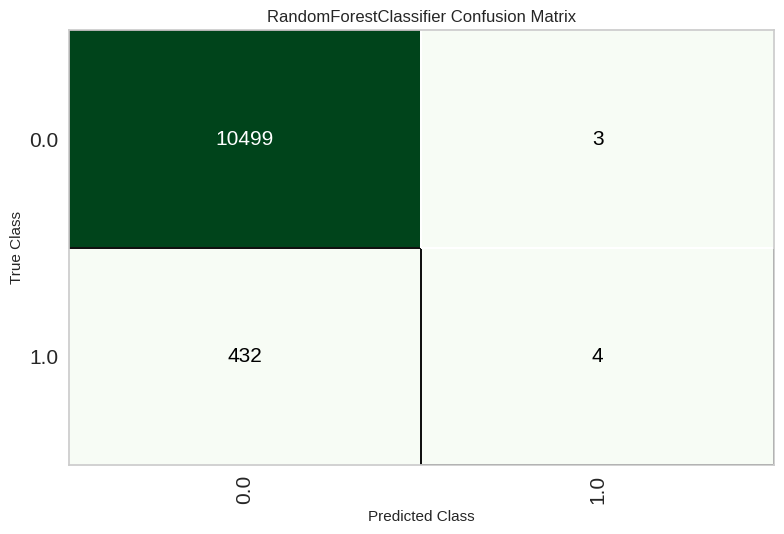

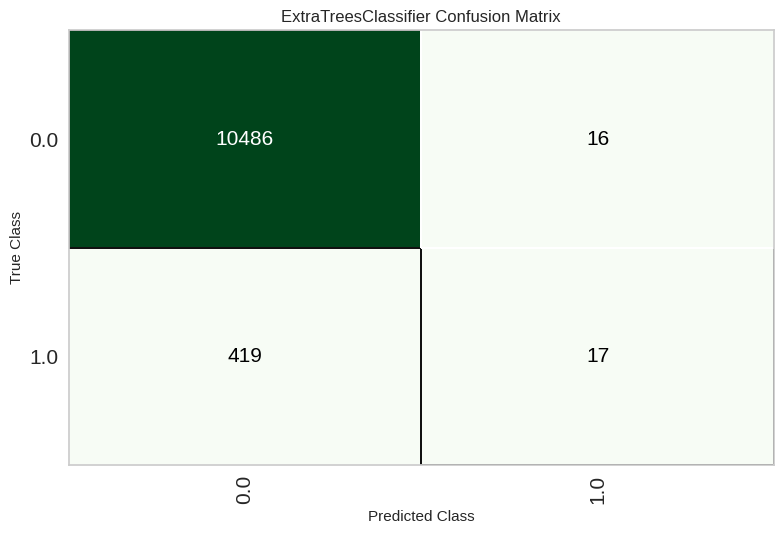

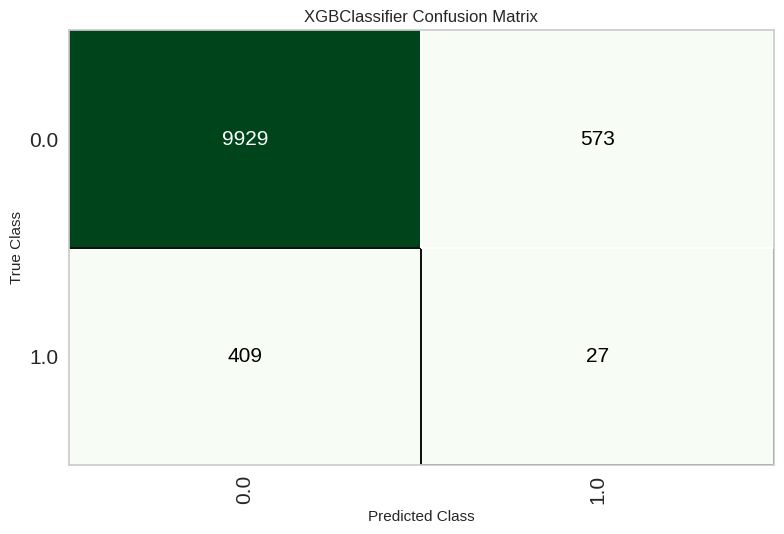

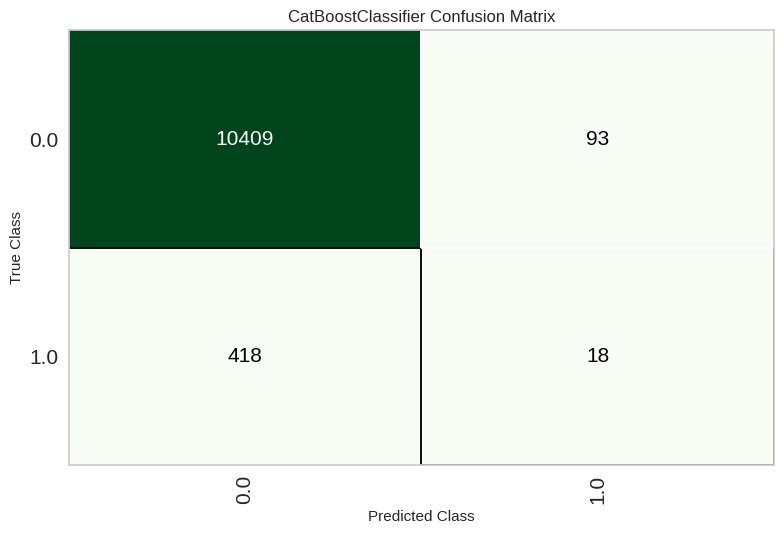

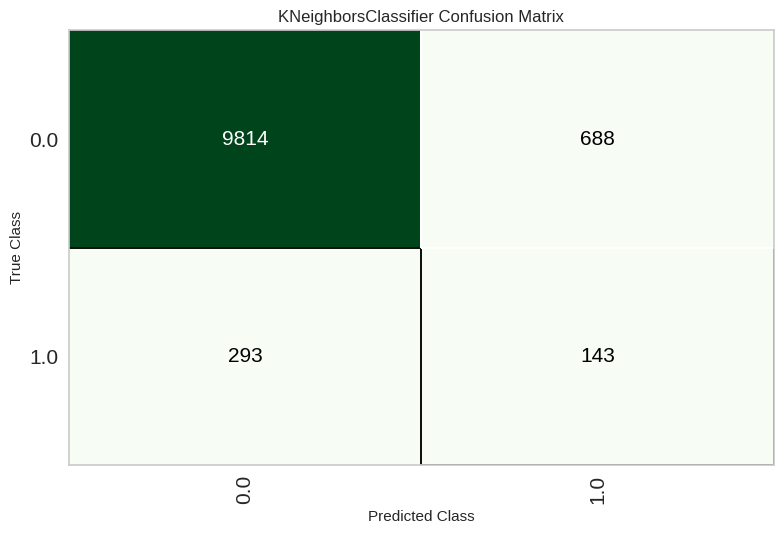

...

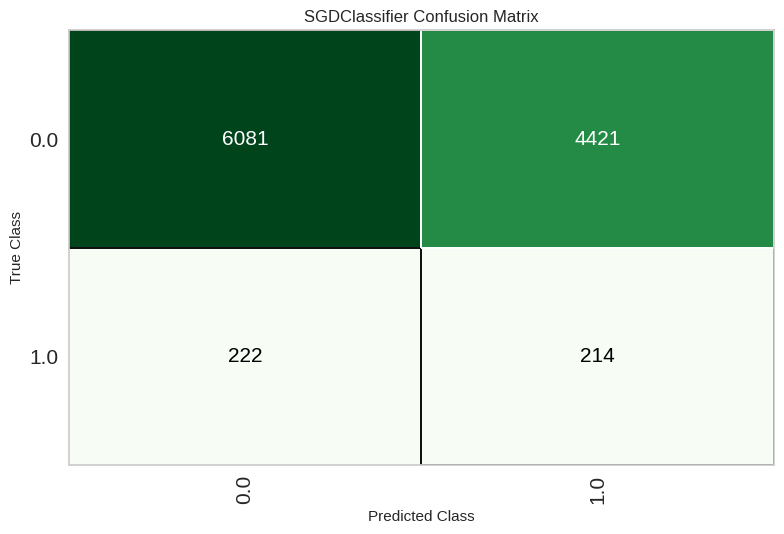

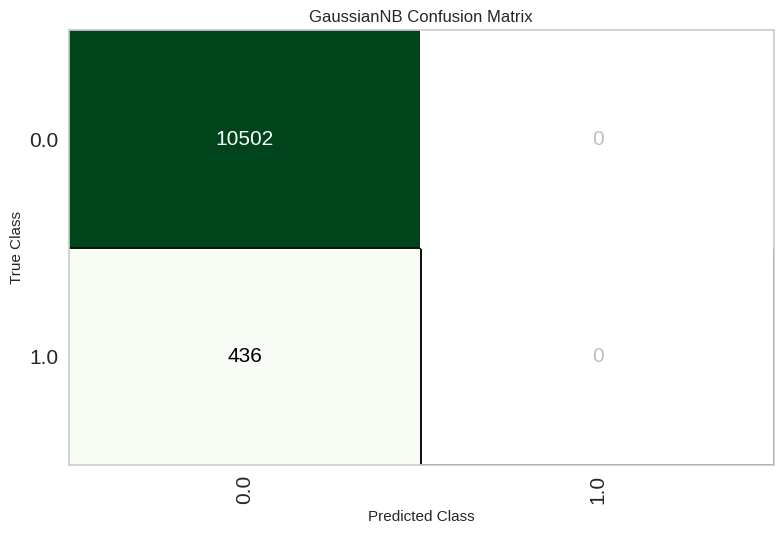

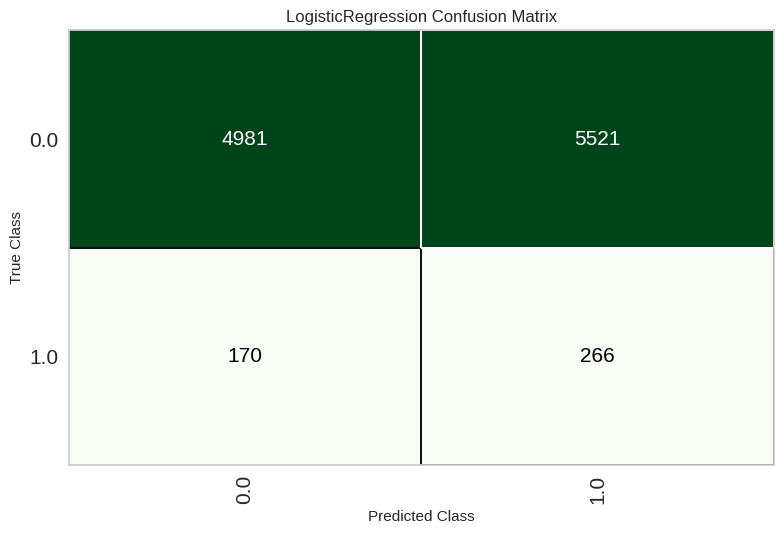

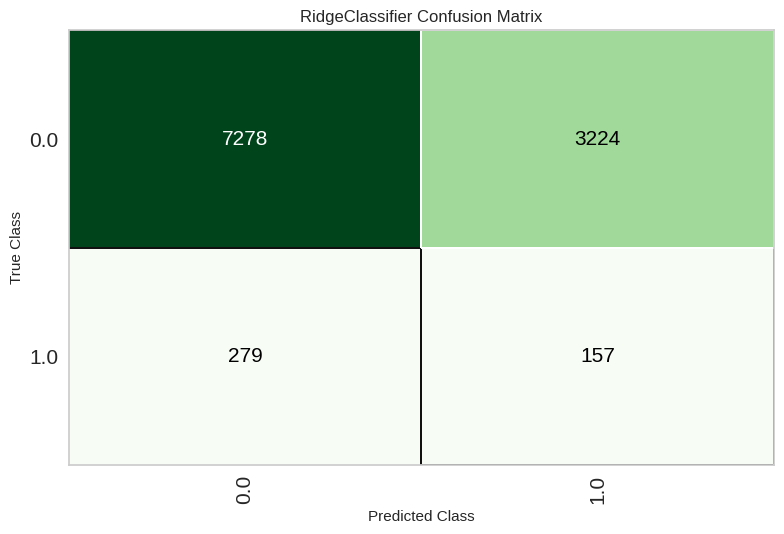

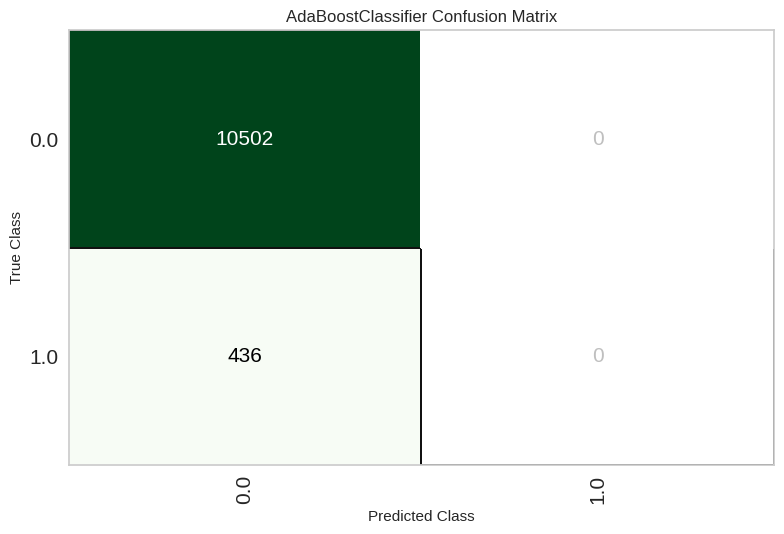

In [ ]:
plot_model(rf,plot = 'confusion_matrix')
plot_model(et,plot = 'confusion_matrix')
plot_model(xgboost,plot = 'confusion_matrix')
plot_model(catboost,plot = 'confusion_matrix')
plot_model(knn,plot = 'confusion_matrix')
plot_model(lightgbm,plot = 'confusion_matrix')
plot_model(qda,plot = 'confusion_matrix')
plot_model(lda,plot = 'confusion_matrix')
plot_model(gbc,plot = 'confusion_matrix')
plot_model(svm,plot = 'confusion_matrix')
plot_model(nb,plot = 'confusion_matrix')
plot_model(lr,plot = 'confusion_matrix')
plot_model(ridge,plot = 'confusion_matrix')
plot_model(ada,plot = 'confusion_matrix')

In [ ]:
dt = create_model('dt')
plot_model(dt, plot='confusion_matrix')

### Tune with OverSampling

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.5313,0.0000,0.4966,0.0422,0.0777,0.0047,0.0115,0.4859
1,0.6146,0.0000,0.2897,0.0312,0.0564,-0.0166,-0.0333,0.5307
2,0.5302,0.0000,0.5241,0.0442,0.0815,0.0088,0.0214,0.4729
3,0.5828,0.0000,0.3034,0.0301,0.0547,-0.0191,-0.0407,0.5396
4,0.6928,0.0000,0.3425,0.0466,0.0820,0.0123,0.0215,0.4817
5,0.6377,0.0000,0.3219,0.0370,0.0664,-0.0058,-0.0112,0.5102
6,0.5395,0.0000,0.4863,0.0424,0.0780,0.0047,0.0110,0.4867
7,0.4974,0.0000,0.5517,0.0433,0.0803,0.0071,0.0183,0.4778
8,0.6195,0.0000,0.4483,0.0474,0.0857,0.0148,0.0302,0.4682


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.5192,0.0000,0.6138,0.0498,0.0922,0.0201,0.0505,0.4413
1,0.5658,0.0000,0.5586,0.0506,0.0928,0.0215,0.0491,0.4381
2,0.5524,0.0000,0.5655,0.0497,0.0913,0.0196,0.0461,0.4421
3,0.5370,0.0000,0.4966,0.0427,0.0786,0.0058,0.0138,0.4831
4,0.5579,0.0000,0.4863,0.0442,0.0810,0.0081,0.0186,0.4781
5,0.5400,0.0000,0.4658,0.0408,0.0750,0.0015,0.0035,0.4959
6,0.6212,0.0000,0.3493,0.0381,0.0688,-0.0037,-0.0074,0.5071
7,0.4993,0.0000,0.5724,0.0450,0.0834,0.0104,0.0269,0.4681
8,0.5053,0.0000,0.4414,0.0358,0.0663,-0.0079,-0.0198,0.5237


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 50 candidates, totalling 500 fits


SGDClassifier(alpha=0.0001, average=False, class_weight=None,
              early_stopping=False, epsilon=0.1, eta0=0.001, fit_intercept=True,
              l1_ratio=0.15, learning_rate='optimal', loss='hinge',
              max_iter=1000, n_iter_no_change=5, n_jobs=-1, penalty='l2',
              power_t=0.5, random_state=309, shuffle=True, tol=0.001,
              validation_fraction=0.1, verbose=0, warm_start=False)
SGDClassifier(alpha=0.001, average=False, class_weight=None,
              early_stopping=False, epsilon=0.1, eta0=0.3, fit_intercept=False,
              l1_ratio=0.2700000001, learning_rate='constant', loss='hinge',
              max_iter=1000, n_iter_no_change=5, n_jobs=-1, penalty='l2',
              power_t=0.5, random_state=309, shuffle=True, tol=0.001,
              validation_fraction=0.1, verbose=0, warm_start=False)


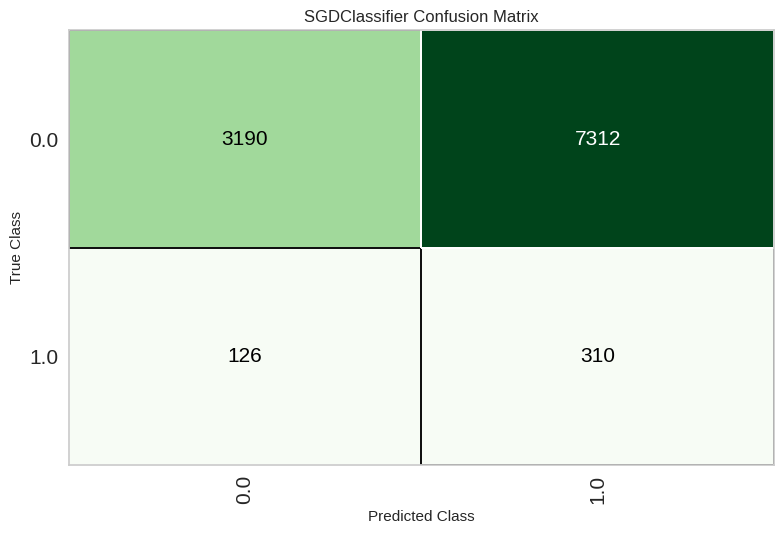

In [ ]:
svm = create_model('svm')

tuned_svm, tuner = tune_model(svm,optimize = 'eer',return_tuner=True,choose_better = True,n_iter = 50)

print(svm)
print(tuned_svm)


plot_model(tuned_svm,plot = 'confusion_matrix')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.8845,0.5336,0.1517,0.0688,0.0946,0.0422,0.0460,0.4811
1,0.8354,0.4959,0.1241,0.0367,0.0566,-0.0051,-0.0063,0.5031
2,0.8157,0.5156,0.1862,0.0465,0.0744,0.0115,0.0149,0.4916
3,0.7677,0.4217,0.0483,0.0098,0.0163,-0.0534,-0.0759,0.5441
4,0.7784,0.4347,0.0685,0.0147,0.0242,-0.0448,-0.0621,0.5355
5,0.8033,0.4584,0.0890,0.0218,0.0350,-0.0314,-0.0412,0.5223
6,0.7652,0.4746,0.1712,0.0329,0.0552,-0.0129,-0.0187,0.5120
7,0.8063,0.5154,0.2207,0.0512,0.0831,0.0198,0.0266,0.4841
8,0.7973,0.5476,0.3034,0.0645,0.1064,0.0437,0.0607,0.4600


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.7079,0.5246,0.3172,0.0455,0.0795,0.0107,0.0180,0.4853
1,0.5554,0.4603,0.3931,0.0358,0.0657,-0.0078,-0.0176,0.5191
2,0.7159,0.5135,0.3379,0.0495,0.0864,0.0183,0.0305,0.4751
3,0.6909,0.4213,0.1931,0.0270,0.0473,-0.0241,-0.0413,0.5314
4,0.7521,0.5363,0.3562,0.0603,0.1032,0.0372,0.0576,0.4558
5,0.6846,0.5776,0.4041,0.0526,0.0931,0.0239,0.0426,0.4612
6,0.5335,0.4604,0.4110,0.0358,0.0659,-0.0084,-0.0199,0.5224
7,0.6812,0.5160,0.3241,0.0423,0.0748,0.0048,0.0086,0.4927
8,0.4661,0.4873,0.5241,0.0389,0.0724,-0.0017,-0.0048,0.5057


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 10 candidates, totalling 100 fits


DecisionTreeClassifier(ccp_alpha=0.0, class_weight=None, criterion='gini',
                       max_depth=None, max_features=None, max_leaf_nodes=None,
                       min_impurity_decrease=0.0, min_samples_leaf=1,
                       min_samples_split=2, min_weight_fraction_leaf=0.0,
                       random_state=1996, splitter='best')
DecisionTreeClassifier(ccp_alpha=0.0, class_weight=None, criterion='entropy',
                       max_depth=4, max_features=1.0, max_leaf_nodes=None,
                       min_impurity_decrease=0.0005, min_samples_leaf=2,
                       min_samples_split=7, min_weight_fraction_leaf=0.0,
                       random_state=1996, splitter='best')


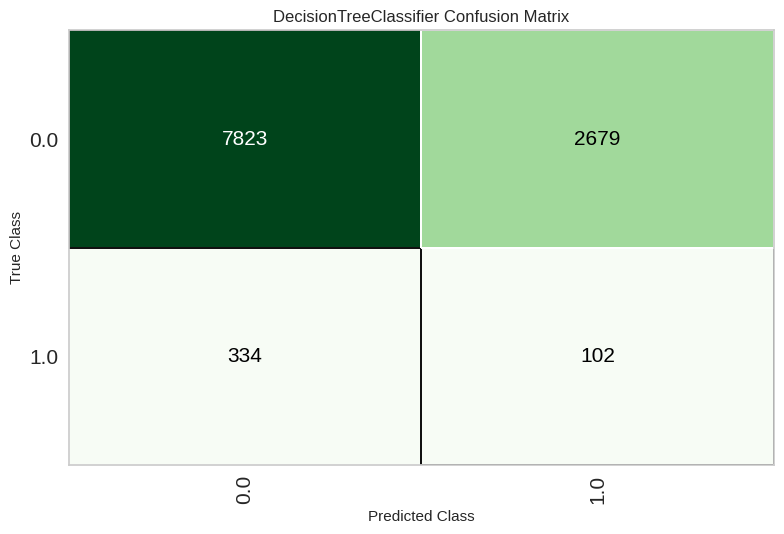

In [ ]:
dt = create_model('dt')

tuned_dt, tuner = tune_model(dt,optimize = 'eer',return_tuner=True,choose_better = True)

print(dt)
print(tuned_dt)

plot_model(tuned_dt,plot = 'confusion_matrix')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.6026,0.0000,0.4207,0.0428,0.0777,0.0059,0.0123,0.4871
1,0.5982,0.0000,0.3379,0.0346,0.0627,-0.0102,-0.0213,0.5209
2,0.6056,0.0000,0.5862,0.0581,0.1057,0.0360,0.0768,0.4056
3,0.5442,0.0000,0.3241,0.0292,0.0535,-0.0210,-0.0482,0.5499
4,0.6284,0.0000,0.4726,0.0512,0.0924,0.0217,0.0437,0.4538
5,0.5911,0.0000,0.4658,0.0459,0.0836,0.0115,0.0248,0.4726
6,0.5376,0.0000,0.5000,0.0433,0.0797,0.0065,0.0154,0.4812
7,0.5967,0.0000,0.5034,0.0496,0.0903,0.0193,0.0414,0.4526
8,0.4911,0.0000,0.5379,0.0418,0.0776,0.0040,0.0106,0.4871


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.5952,0.0000,0.4138,0.0414,0.0752,0.0031,0.0066,0.4931
1,0.6037,0.0000,0.3724,0.0384,0.0695,-0.0028,-0.0058,0.5058
2,0.5990,0.0000,0.5724,0.0560,0.1020,0.0318,0.0686,0.4161
3,0.5540,0.0000,0.3241,0.0298,0.0547,-0.0196,-0.0443,0.5453
4,0.6196,0.0000,0.4452,0.0474,0.0857,0.0144,0.0292,0.4695
5,0.5749,0.0000,0.4795,0.0453,0.0828,0.0104,0.0231,0.4735
6,0.5431,0.0000,0.5411,0.0471,0.0866,0.0140,0.0331,0.4580
7,0.5948,0.0000,0.5103,0.0500,0.0911,0.0201,0.0432,0.4501
8,0.4966,0.0000,0.5448,0.0427,0.0793,0.0059,0.0154,0.4812


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 10 candidates, totalling 100 fits


Original model was better than the tuned model, hence it will be returned. NOTE: The display metrics are for the tuned model (not the original one).
RidgeClassifier(alpha=1.0, class_weight=None, copy_X=True, fit_intercept=True,
                max_iter=None, positive=False, random_state=1996, solver='auto',
                tol=0.0001)
RidgeClassifier(alpha=1.0, class_weight=None, copy_X=True, fit_intercept=True,
                max_iter=None, positive=False, random_state=1996, solver='auto',
                tol=0.0001)


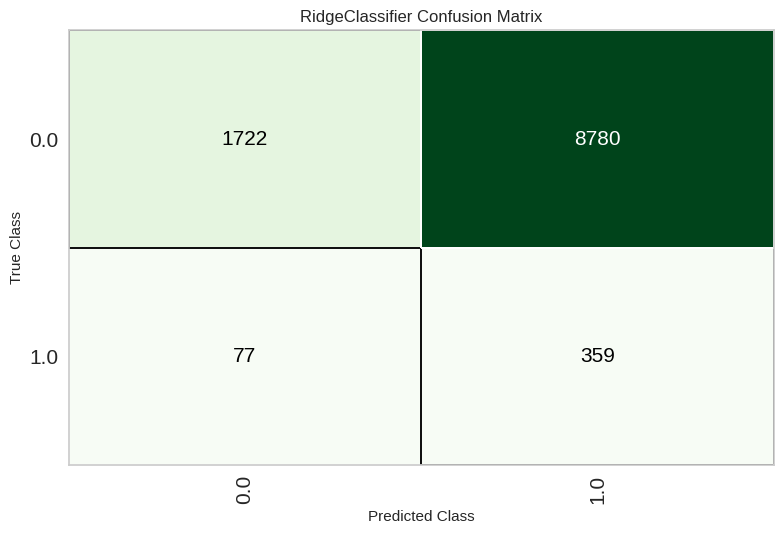

In [ ]:
ridge = create_model('ridge')

tuned_ridge, tuner = tune_model(ridge,optimize = 'eer',return_tuner=True,choose_better = True)

print(ridge)
print(tuned_ridge)

plot_model(tuned_ridge,plot = 'confusion_matrix')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.5924,0.5457,0.4138,0.0411,0.0747,0.0025,0.0054,0.4943
1,0.6097,0.4662,0.3724,0.0390,0.0705,-0.0016,-0.0032,0.5032
2,0.5872,0.5813,0.5931,0.0561,0.1026,0.0322,0.0713,0.4105
3,0.5474,0.4268,0.3241,0.0294,0.0539,-0.0205,-0.0469,0.5483
4,0.6067,0.5415,0.4110,0.0426,0.0772,0.0050,0.0104,0.4893
5,0.5924,0.5379,0.4795,0.0473,0.0861,0.0142,0.0306,0.4657
6,0.5496,0.5066,0.4932,0.0439,0.0806,0.0076,0.0178,0.4787
7,0.6077,0.5482,0.5103,0.0516,0.0938,0.0232,0.0488,0.4446
8,0.5029,0.5017,0.5448,0.0433,0.0802,0.0070,0.0180,0.4780


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.5968,0.5417,0.4345,0.0434,0.0789,0.0072,0.0152,0.4837
1,0.5996,0.4747,0.3655,0.0373,0.0677,-0.0048,-0.0101,0.5101
2,0.6007,0.5908,0.5931,0.0580,0.1057,0.0358,0.0772,0.4037
3,0.5494,0.4244,0.3241,0.0295,0.0541,-0.0203,-0.0462,0.5475
4,0.6275,0.5450,0.4521,0.0491,0.0886,0.0176,0.0353,0.4633
5,0.6111,0.5389,0.4726,0.0489,0.0887,0.0174,0.0360,0.4609
6,0.5337,0.5038,0.5068,0.0435,0.0801,0.0068,0.0164,0.4797
7,0.6206,0.5564,0.5172,0.0540,0.0978,0.0278,0.0572,0.4359
8,0.5056,0.5178,0.5379,0.0430,0.0797,0.0065,0.0165,0.4796


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 10 candidates, totalling 100 fits


LinearDiscriminantAnalysis(covariance_estimator=None, n_components=None,
                           priors=None, shrinkage=None, solver='svd',
                           store_covariance=False, tol=0.0001)
LinearDiscriminantAnalysis(covariance_estimator=None, n_components=None,
                           priors=None, shrinkage=0.0001, solver='lsqr',
                           store_covariance=False, tol=0.0001)


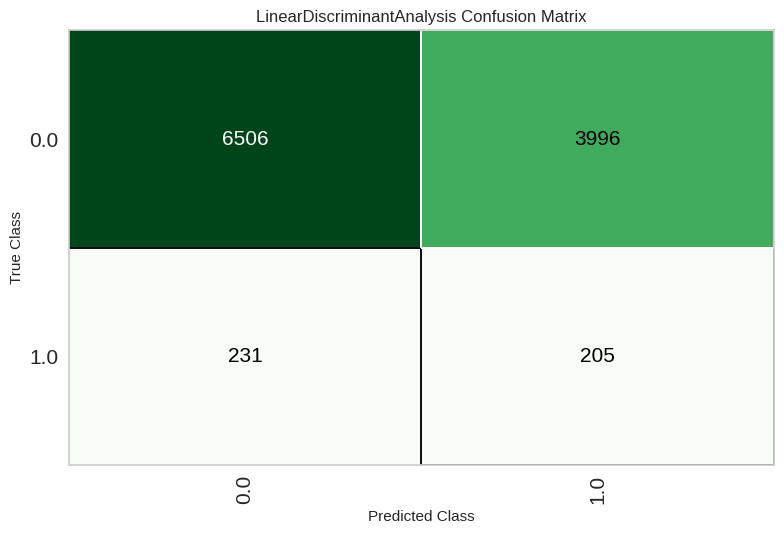

In [ ]:
lda = create_model('lda')

tuned_lda, tuner = tune_model(lda,optimize = 'eer',return_tuner=True,choose_better = True)

print(lda)
print(tuned_lda)

plot_model(tuned_lda,plot = 'confusion_matrix')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.5943,0.5440,0.4345,0.0432,0.0785,0.0066,0.0141,0.4848
1,0.5889,0.4571,0.3862,0.0382,0.0695,-0.0031,-0.0066,0.5068
2,0.5990,0.5788,0.5862,0.0572,0.1042,0.0342,0.0739,0.4083
3,0.5403,0.4252,0.3379,0.0301,0.0552,-0.0192,-0.0446,0.5468
4,0.6105,0.5368,0.4452,0.0463,0.0839,0.0122,0.0252,0.4733
5,0.5924,0.5236,0.4932,0.0485,0.0883,0.0166,0.0358,0.4593
6,0.5474,0.5120,0.5548,0.0486,0.0894,0.0170,0.0401,0.4494
7,0.6069,0.5469,0.4897,0.0497,0.0902,0.0193,0.0406,0.4548
8,0.4982,0.5175,0.5448,0.0429,0.0795,0.0062,0.0161,0.4804


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.6012,0.5456,0.4414,0.0445,0.0809,0.0093,0.0197,0.4789
1,0.6086,0.4742,0.3448,0.0362,0.0655,-0.0070,-0.0144,0.5140
2,0.6023,0.5838,0.5655,0.0558,0.1016,0.0315,0.0675,0.4185
3,0.5411,0.4241,0.3103,0.0278,0.0510,-0.0237,-0.0547,0.5560
4,0.6380,0.5492,0.4521,0.0505,0.0909,0.0203,0.0400,0.4590
5,0.6034,0.5404,0.4863,0.0492,0.0894,0.0180,0.0379,0.4578
6,0.5406,0.5052,0.5411,0.0468,0.0862,0.0135,0.0321,0.4592
7,0.5953,0.5513,0.5241,0.0513,0.0934,0.0226,0.0487,0.4430
8,0.4930,0.5175,0.5379,0.0420,0.0778,0.0044,0.0114,0.4861


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 10 candidates, totalling 100 fits


LogisticRegression(C=1.0, class_weight=None, dual=False, fit_intercept=True,
                   intercept_scaling=1, l1_ratio=None, max_iter=1000,
                   multi_class='auto', n_jobs=None, penalty='l2',
                   random_state=1996, solver='lbfgs', tol=0.0001, verbose=0,
                   warm_start=False)
LogisticRegression(C=9.147, class_weight={}, dual=False, fit_intercept=True,
                   intercept_scaling=1, l1_ratio=None, max_iter=1000,
                   multi_class='auto', n_jobs=None, penalty='l2',
                   random_state=1996, solver='lbfgs', tol=0.0001, verbose=0,
                   warm_start=False)


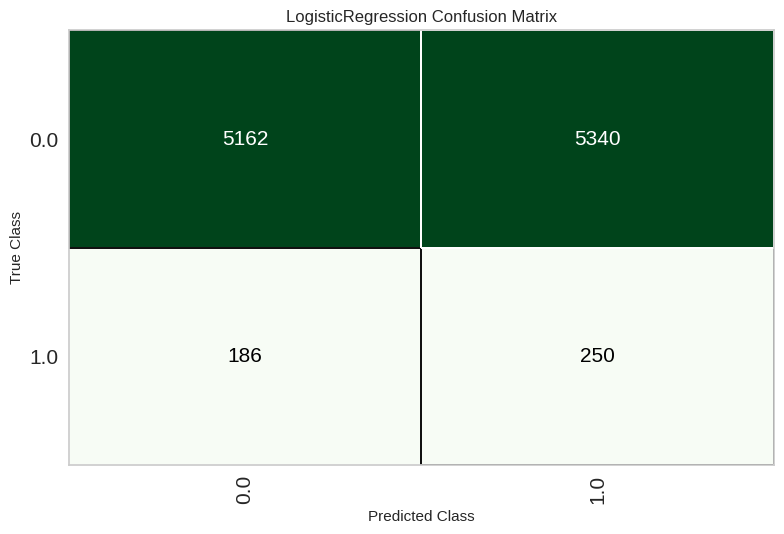

In [ ]:
lr = create_model('lr')

tuned_lr, tuner = tune_model(lr,optimize = 'eer',return_tuner=True,choose_better = True)

print(lr)
print(tuned_lr)

plot_model(tuned_lr,plot = 'confusion_matrix')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.8516,0.5284,0.1448,0.0479,0.0720,0.0131,0.0155,0.4926
1,0.8524,0.5154,0.1448,0.0483,0.0724,0.0136,0.0160,0.4923
2,0.8453,0.5095,0.1724,0.0533,0.0814,0.0220,0.0266,0.4866
3,0.8050,0.4180,0.0828,0.0203,0.0327,-0.0333,-0.0437,0.5235
4,0.8212,0.4556,0.1644,0.0433,0.0686,0.0055,0.0071,0.4962
5,0.7995,0.4844,0.1849,0.0423,0.0688,0.0038,0.0052,0.4969
6,0.7713,0.4459,0.1507,0.0301,0.0501,-0.0178,-0.0255,0.5158
7,0.8129,0.5633,0.2828,0.0662,0.1073,0.0458,0.0612,0.4621
8,0.7882,0.5798,0.3241,0.0652,0.1085,0.0453,0.0646,0.4557


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.6802,0.4906,0.2759,0.0363,0.0642,-0.0065,-0.0116,0.5096
1,0.6928,0.5465,0.3241,0.0440,0.0774,0.0079,0.0138,0.4884
2,0.6978,0.5103,0.3586,0.0490,0.0862,0.0175,0.0303,0.4740
3,0.6325,0.4334,0.2483,0.0284,0.0510,-0.0219,-0.0424,0.5369
4,0.6775,0.4985,0.3493,0.0451,0.0798,0.0096,0.0171,0.4849
5,0.6533,0.5262,0.2534,0.0310,0.0553,-0.0173,-0.0320,0.5270
6,0.6297,0.4679,0.2808,0.0319,0.0573,-0.0158,-0.0307,0.5275
7,0.6705,0.5691,0.3655,0.0456,0.0811,0.0112,0.0204,0.4815
8,0.5794,0.4853,0.3724,0.0361,0.0658,-0.0072,-0.0157,0.5163


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 10 candidates, totalling 100 fits


Original model was better than the tuned model, hence it will be returned. NOTE: The display metrics are for the tuned model (not the original one).


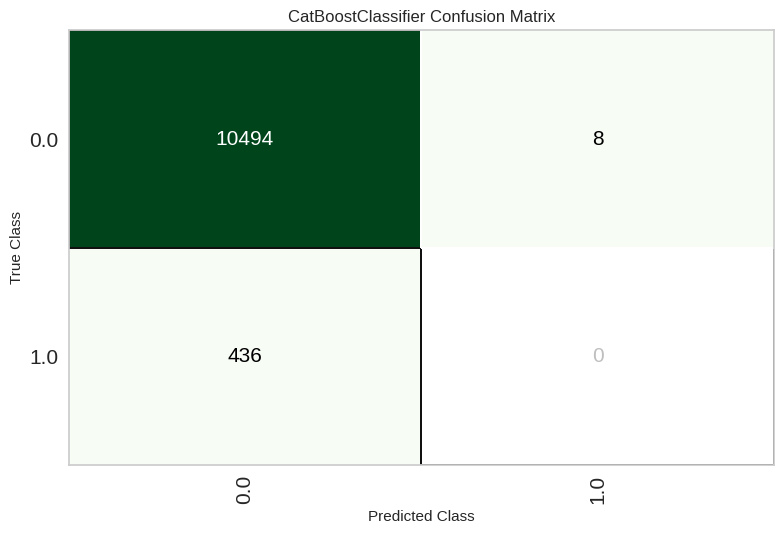

In [ ]:
cb = create_model('catboost')

tuned_cb, tuner = tune_model(cb,optimize = 'eer',return_tuner=True,choose_better = True)

print(cb)
print(tuned_cb)

plot_model(tuned_cb,plot = 'confusion_matrix')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.8330,0.5738,0.2414,0.0655,0.1031,0.0432,0.0546,0.4694
1,0.8075,0.5598,0.0759,0.0190,0.0304,-0.0355,-0.0462,0.5245
2,0.7877,0.5056,0.2552,0.0526,0.0873,0.0228,0.0322,0.4791
3,0.7608,0.4271,0.0828,0.0160,0.0268,-0.0427,-0.0620,0.5376
4,0.7737,0.4557,0.1644,0.0330,0.0550,-0.0125,-0.0179,0.5112
5,0.7811,0.5156,0.1986,0.0408,0.0678,0.0014,0.0020,0.4987
6,0.7312,0.4579,0.1644,0.0272,0.0467,-0.0236,-0.0370,0.5254
7,0.7855,0.5755,0.2690,0.0545,0.0907,0.0263,0.0373,0.4753
8,0.7528,0.5630,0.3793,0.0635,0.1088,0.0436,0.0678,0.4469


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9111,0.5467,0.1103,0.0758,0.0899,0.0449,0.0457,0.4851
1,0.8834,0.5189,0.0552,0.0270,0.0363,-0.0181,-0.0194,0.5073
2,0.9024,0.4986,0.1517,0.0863,0.1100,0.0625,0.0653,0.4761
3,0.8412,0.4078,0.0414,0.0135,0.0203,-0.0423,-0.0503,0.5230
4,0.8568,0.4509,0.0753,0.0276,0.0404,-0.0193,-0.0221,0.5097
5,0.8598,0.4677,0.1164,0.0426,0.0624,0.0040,0.0046,0.4979
6,0.8352,0.4308,0.0959,0.0290,0.0445,-0.0181,-0.0220,0.5108
7,0.8593,0.5565,0.2552,0.0837,0.1261,0.0704,0.0835,0.4572
8,0.8466,0.5562,0.2759,0.0810,0.1252,0.0679,0.0834,0.4542


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 10 candidates, totalling 100 fits


XGBClassifier(base_score=None, booster='gbtree', callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, device='cpu', early_stopping_rounds=None,
              enable_categorical=False, eval_metric=None, feature_types=None,
              gamma=None, grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=None, max_bin=None,
              max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=None, max_leaves=None,
              min_child_weight=None, missing=nan, monotone_constraints=None,
              multi_strategy=None, n_estimators=None, n_jobs=-1,
              num_parallel_tree=None, objective='binary:logistic', ...)
XGBClassifier(base_score=None, booster='gbtree', callbacks=None,
              colsample_bylevel=None, colsample_bynode=None, colsample_bytree=1,
              device='cpu', early_stopping_rounds=None,
              enable_catego

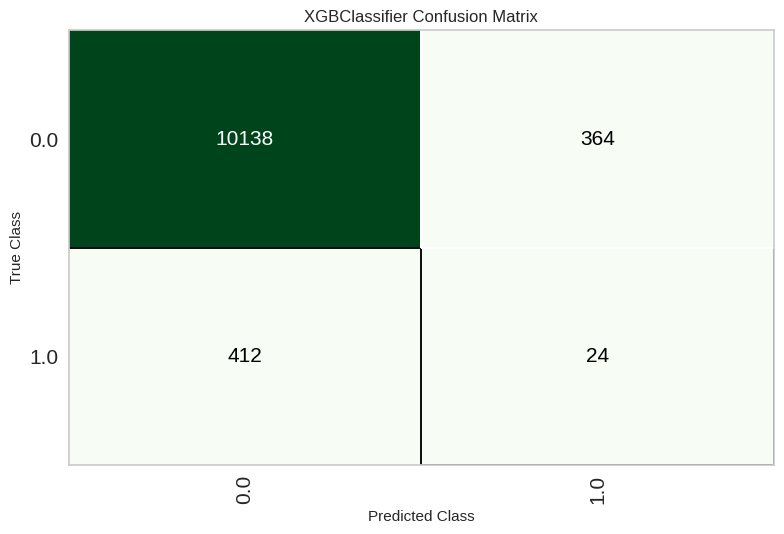

In [ ]:
xgboost = create_model('xgboost')

tuned_xgboost, tuner = tune_model(xgboost,optimize = 'eer',return_tuner=True,choose_better = True)

print(xgboost)
print(tuned_xgboost)

plot_model(tuned_xgboost,plot = 'confusion_matrix')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9608,0.7077,0.0297,0.6000,0.0566,0.0531,0.1274,0.4927
1,0.9632,0.7131,0.0891,0.8182,0.1607,0.1541,0.2628,0.4769
2,0.9608,0.7191,0.0490,0.6250,0.0909,0.0856,0.1675,0.4877
3,0.9628,0.6985,0.0882,0.8182,0.1593,0.1527,0.2614,0.4771
4,0.9608,0.6981,0.0392,0.6667,0.0741,0.0699,0.1553,0.4902
5,0.9616,0.7117,0.0588,0.7500,0.1091,0.1039,0.2033,0.4851
6,0.9620,0.7167,0.0588,0.8571,0.1101,0.1055,0.2188,0.4850
7,0.9620,0.6917,0.0686,0.7778,0.1261,0.1204,0.2241,0.4824
8,0.9612,0.6907,0.0686,0.6364,0.1239,0.1170,0.2003,0.4826


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9538,0.7102,0.0990,0.2703,0.1449,0.1264,0.1435,0.4767
1,0.9581,0.7419,0.1089,0.3929,0.1705,0.1560,0.1909,0.4729
2,0.9612,0.7083,0.1176,0.5714,0.1951,0.1840,0.2471,0.4697
3,0.9589,0.7139,0.1373,0.4516,0.2105,0.1955,0.2330,0.4649
4,0.9620,0.6921,0.1471,0.6000,0.2362,0.2240,0.2844,0.4613
5,0.9577,0.7323,0.1275,0.4062,0.1940,0.1783,0.2107,0.4679
6,0.9561,0.7385,0.1078,0.3438,0.1642,0.1479,0.1748,0.4736
7,0.9592,0.7128,0.1667,0.4722,0.2464,0.2303,0.2640,0.4565
8,0.9589,0.6822,0.1078,0.4400,0.1732,0.1600,0.2031,0.4729


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 10 candidates, totalling 100 fits


LGBMClassifier(boosting_type='gbdt', class_weight=None, colsample_bytree=1.0,
               importance_type='split', learning_rate=0.1, max_depth=-1,
               min_child_samples=20, min_child_weight=0.001, min_split_gain=0.0,
               n_estimators=100, n_jobs=-1, num_leaves=31, objective=None,
               random_state=123, reg_alpha=0.0, reg_lambda=0.0, subsample=1.0,
               subsample_for_bin=200000, subsample_freq=0)
LGBMClassifier(bagging_fraction=0.9, bagging_freq=3, boosting_type='gbdt',
               class_weight=None, colsample_bytree=1.0, feature_fraction=0.5,
               importance_type='split', learning_rate=0.4, max_depth=-1,
               min_child_samples=6, min_child_weight=0.001, min_split_gain=0.3,
               n_estimators=20, n_jobs=-1, num_leaves=150, objective=None,
               random_state=123, reg_alpha=0.005, reg_lambda=0.0005,
               subsample=1.0, subsample_for_bin=200000, subsample_freq=0)


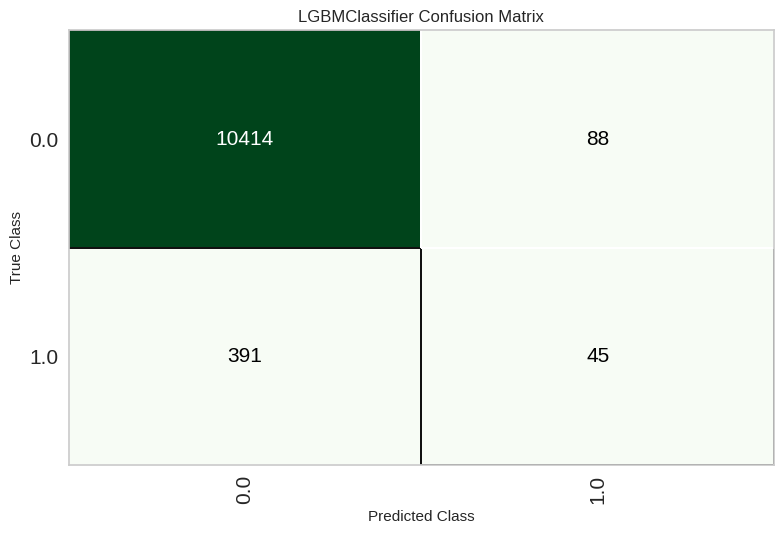

In [ ]:
lightgbm = create_model('lightgbm')

tuned_lightgbm, tuner = tune_model(lightgbm,optimize = 'eer',return_tuner=True,choose_better = True)

print(lightgbm)
print(tuned_lightgbm)

plot_model(tuned_lightgbm,plot = 'confusion_matrix')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9604,0.6035,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
1,0.9604,0.5676,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
2,0.9600,0.5942,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
3,0.9600,0.6582,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
4,0.9600,0.5891,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
5,0.9600,0.5577,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
6,0.9596,0.5777,0.0000,0.0000,0.0000,-0.0008,-0.0040,0.5001
7,0.9600,0.5693,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
8,0.9600,0.5935,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9604,0.5826,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
1,0.9604,0.5116,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
2,0.9600,0.5346,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
3,0.9600,0.6137,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
4,0.9600,0.5495,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
5,0.9600,0.5308,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
6,0.9600,0.5733,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
7,0.9600,0.5318,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
8,0.9600,0.5716,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 10 candidates, totalling 100 fits


Original model was better than the tuned model, hence it will be returned. NOTE: The display metrics are for the tuned model (not the original one).
AdaBoostClassifier(algorithm='SAMME.R', base_estimator='deprecated',
                   estimator=None, learning_rate=1.0, n_estimators=50,
                   random_state=123)
AdaBoostClassifier(algorithm='SAMME.R', base_estimator='deprecated',
                   estimator=None, learning_rate=1.0, n_estimators=50,
                   random_state=123)


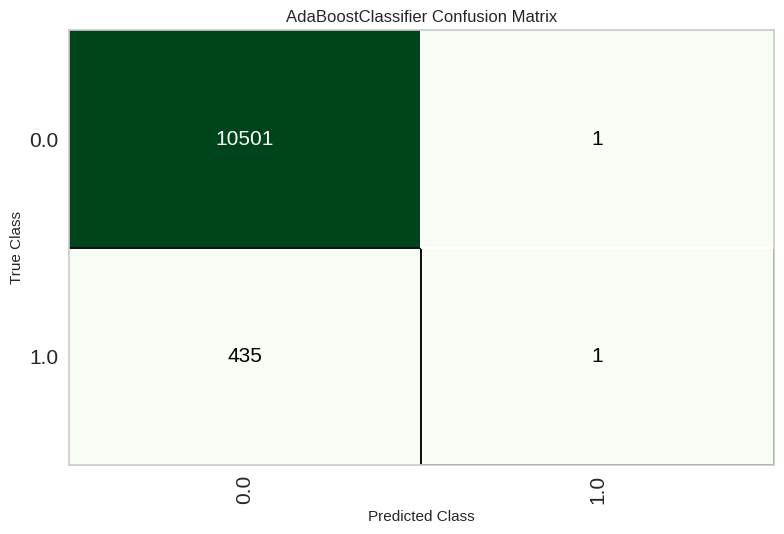

In [ ]:
adaboost = create_model('ada')

tuned_ada, tuner = tune_model(adaboost,optimize = 'eer',return_tuner=True,choose_better = True)

print(adaboost)
print(tuned_ada)

plot_model(tuned_ada,plot = 'confusion_matrix')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.5266,0.5352,0.5446,0.0452,0.0835,0.0112,0.0275,0.4654
1,0.8350,0.5202,0.1782,0.0506,0.0788,0.0182,0.0227,0.4880
2,0.9585,0.5039,0.0098,0.1667,0.0185,0.0141,0.0314,0.4980
3,0.6324,0.5267,0.4118,0.0457,0.0822,0.0110,0.0218,0.4783
4,0.4216,0.4968,0.5784,0.0395,0.0740,-0.0009,-0.0026,0.5028
5,0.9585,0.4992,0.0000,0.0000,0.0000,-0.0030,-0.0081,0.5004
6,0.8315,0.5082,0.1569,0.0444,0.0693,0.0074,0.0093,0.4952
7,0.5831,0.5527,0.5196,0.0496,0.0906,0.0190,0.0418,0.4506
8,0.8045,0.5270,0.2255,0.0519,0.0844,0.0208,0.0280,0.4831


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.8480,0.5077,0.1683,0.0530,0.0806,0.0217,0.0260,0.4870
1,0.8546,0.6060,0.1980,0.0645,0.0973,0.0400,0.0476,0.4763
2,0.8429,0.5825,0.1569,0.0483,0.0739,0.0136,0.0165,0.4917
3,0.8503,0.6207,0.3137,0.0930,0.1435,0.0872,0.1069,0.4402
4,0.8472,0.5318,0.1078,0.0355,0.0534,-0.0072,-0.0085,0.5040
5,0.8515,0.5717,0.1667,0.0547,0.0823,0.0235,0.0279,0.4864
6,0.8472,0.5507,0.1765,0.0556,0.0845,0.0252,0.0303,0.4848
7,0.8503,0.5639,0.1569,0.0513,0.0773,0.0181,0.0216,0.4895
8,0.8468,0.5301,0.1863,0.0581,0.0886,0.0294,0.0355,0.4821


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 10 candidates, totalling 100 fits


QuadraticDiscriminantAnalysis(priors=None, reg_param=0.0,
                              store_covariance=False, tol=0.0001)
QuadraticDiscriminantAnalysis(priors=None, reg_param=0.17,
                              store_covariance=False, tol=0.0001)


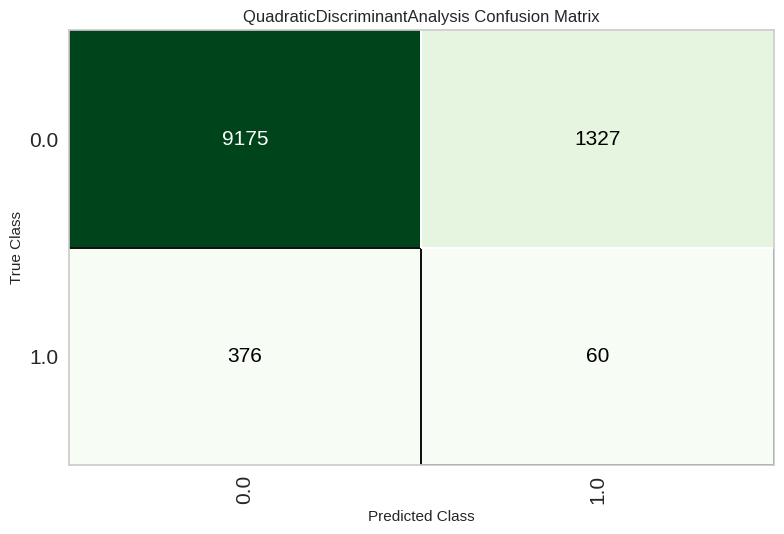

In [ ]:
qda = create_model('qda')

tuned_qda, tuner = tune_model(qda,optimize = 'eer',return_tuner=True,choose_better = True)

print(qda)
print(tuned_qda)

plot_model(tuned_qda,plot = 'confusion_matrix')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9612,0.6339,0.0297,0.7500,0.0571,0.0543,0.1444,0.4926
1,0.9604,0.6170,0.0198,0.5000,0.0381,0.0352,0.0936,0.4952
2,0.9600,0.6360,0.0098,0.5000,0.0192,0.0177,0.0658,0.4976
3,0.9604,0.6950,0.0294,0.6000,0.0561,0.0525,0.1267,0.4927
4,0.9612,0.6061,0.0294,1.0000,0.0571,0.0550,0.1681,0.4925
5,0.9604,0.6138,0.0196,0.6667,0.0381,0.0359,0.1098,0.4952
6,0.9608,0.6057,0.0196,1.0000,0.0385,0.0370,0.1373,0.4950
7,0.9604,0.5980,0.0098,1.0000,0.0194,0.0187,0.0970,0.4975
8,0.9604,0.6278,0.0098,1.0000,0.0194,0.0187,0.0970,0.4975


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9592,0.7166,0.1485,0.4545,0.2239,0.2085,0.2436,0.4617
1,0.9624,0.7100,0.1881,0.5758,0.2836,0.2693,0.3148,0.4495
2,0.9589,0.7365,0.1863,0.4634,0.2657,0.2485,0.2762,0.4509
3,0.9592,0.7072,0.1667,0.4722,0.2464,0.2303,0.2640,0.4565
4,0.9589,0.6997,0.1078,0.4400,0.1732,0.1600,0.2031,0.4729
5,0.9600,0.7405,0.1569,0.5000,0.2388,0.2240,0.2646,0.4591
6,0.9600,0.7302,0.1667,0.5000,0.2500,0.2347,0.2729,0.4563
7,0.9600,0.7156,0.1765,0.5000,0.2609,0.2451,0.2809,0.4534
8,0.9604,0.6874,0.1569,0.5161,0.2406,0.2262,0.2696,0.4590


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 10 candidates, totalling 100 fits


GradientBoostingClassifier(ccp_alpha=0.0, criterion='friedman_mse', init=None,
                           learning_rate=0.1, loss='log_loss', max_depth=3,
                           max_features=None, max_leaf_nodes=None,
                           min_impurity_decrease=0.0, min_samples_leaf=1,
                           min_samples_split=2, min_weight_fraction_leaf=0.0,
                           n_estimators=100, n_iter_no_change=None,
                           random_state=123, subsample=1.0, tol=0.0001,
                           validation_fraction=0.1, verbose=0,
                           warm_start=False)
GradientBoostingClassifier(ccp_alpha=0.0, criterion='friedman_mse', init=None,
                           learning_rate=0.15, loss='log_loss', max_depth=7,
                           max_features=1.0, max_leaf_nodes=None,
                           min_impurity_decrease=0.02, min_samples_leaf=5,
                           min_samples_split=5, min_weight_fraction_leaf=0.0,
   

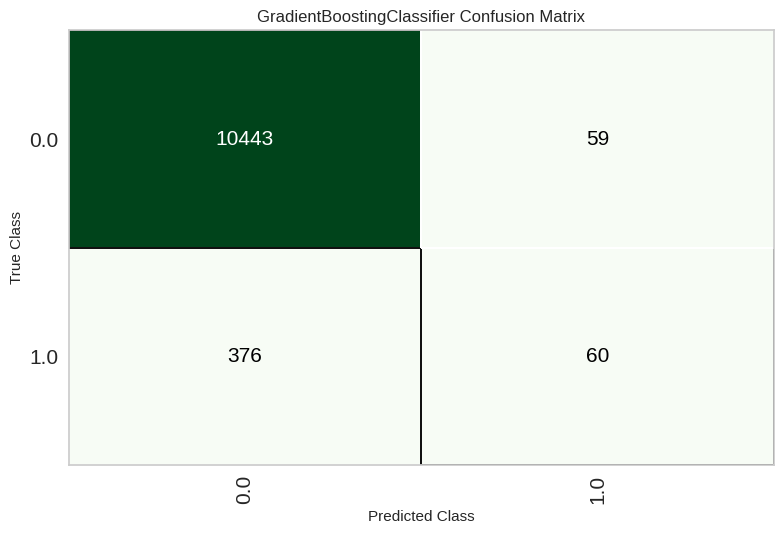

In [ ]:
gbc = create_model('gbc')

tuned_gbc, tuner = tune_model(gbc,optimize = 'eer',return_tuner=True,choose_better = True)

print(gbc)
print(tuned_gbc)

plot_model(tuned_gbc,plot = 'confusion_matrix')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9581,0.7913,0.1485,0.4167,0.2190,0.2024,0.2314,0.4620
1,0.9600,0.7450,0.2376,0.4898,0.3200,0.3020,0.3231,0.4351
2,0.9608,0.7480,0.2255,0.5227,0.3151,0.2982,0.3264,0.4386
3,0.9549,0.7936,0.1863,0.3725,0.2484,0.2278,0.2425,0.4519
4,0.9600,0.7480,0.1765,0.5000,0.2609,0.2451,0.2809,0.4534
5,0.9553,0.7170,0.1275,0.3421,0.1857,0.1677,0.1896,0.4685
6,0.9569,0.7910,0.2157,0.4231,0.2857,0.2659,0.2821,0.4426
7,0.9600,0.7003,0.2157,0.5000,0.3014,0.2841,0.3111,0.4418
8,0.9577,0.7591,0.1765,0.4286,0.2500,0.2321,0.2566,0.4541


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.6611,0.6252,0.5545,0.0639,0.1146,0.0470,0.0903,0.4010
1,0.6642,0.5709,0.3663,0.0446,0.0795,0.0096,0.0178,0.4837
2,0.6575,0.5644,0.4118,0.0491,0.0877,0.0175,0.0330,0.4683
3,0.6712,0.6668,0.5784,0.0690,0.1233,0.0559,0.1052,0.3844
4,0.6536,0.5655,0.4706,0.0547,0.0980,0.0284,0.0544,0.4446
5,0.6540,0.5555,0.3725,0.0443,0.0792,0.0084,0.0159,0.4852
6,0.6885,0.5879,0.4412,0.0575,0.1017,0.0333,0.0594,0.4444
7,0.6548,0.5695,0.3922,0.0466,0.0832,0.0127,0.0240,0.4773
8,0.6614,0.5850,0.4314,0.0518,0.0924,0.0227,0.0426,0.4587


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 10 candidates, totalling 100 fits


RandomForestClassifier(bootstrap=True, ccp_alpha=0.0, class_weight=None,
                       criterion='gini', max_depth=None, max_features='sqrt',
                       max_leaf_nodes=None, max_samples=None,
                       min_impurity_decrease=0.0, min_samples_leaf=1,
                       min_samples_split=2, min_weight_fraction_leaf=0.0,
                       n_estimators=100, n_jobs=-1, oob_score=False,
                       random_state=123, verbose=0, warm_start=False)
RandomForestClassifier(bootstrap=False, ccp_alpha=0.0,
                       class_weight='balanced_subsample', criterion='gini',
                       max_depth=4, max_features='sqrt', max_leaf_nodes=None,
                       max_samples=None, min_impurity_decrease=0.0005,
                       min_samples_leaf=3, min_samples_split=5,
                       min_weight_fraction_leaf=0.0, n_estimators=260,
                       n_jobs=-1, oob_score=False, random_state=123, verbose=0,
         

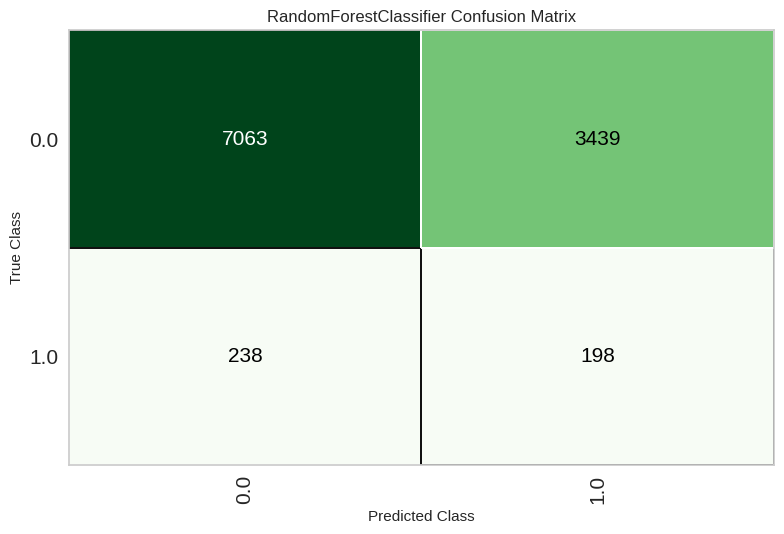

In [ ]:
rf = create_model('rf')

tuned_rf, tuner = tune_model(rf,optimize = 'eer',return_tuner=True,choose_better = True)

print(rf)
print(tuned_rf)

plot_model(tuned_rf,plot = 'confusion_matrix')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9577,0.7723,0.1485,0.4054,0.2174,0.2004,0.2276,0.4621
1,0.9604,0.7498,0.2178,0.5000,0.3034,0.2863,0.3128,0.4411
2,0.9620,0.7349,0.2059,0.5676,0.3022,0.2870,0.3267,0.4442
3,0.9569,0.7777,0.1961,0.4167,0.2667,0.2474,0.2663,0.4485
4,0.9592,0.7268,0.1765,0.4737,0.2571,0.2407,0.2722,0.4536
5,0.9561,0.7035,0.1373,0.3684,0.2000,0.1823,0.2061,0.4656
6,0.9565,0.7544,0.1863,0.4043,0.2550,0.2358,0.2547,0.4515
7,0.9596,0.7099,0.2157,0.4889,0.2993,0.2817,0.3070,0.4419
8,0.9573,0.7366,0.1667,0.4146,0.2378,0.2199,0.2444,0.4570


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.6775,0.5946,0.4455,0.0554,0.0986,0.0303,0.0555,0.4466
1,0.6446,0.5497,0.4554,0.0512,0.0921,0.0225,0.0440,0.4550
2,0.6023,0.5516,0.5000,0.0502,0.0913,0.0201,0.0426,0.4519
3,0.6144,0.6323,0.5686,0.0581,0.1055,0.0355,0.0742,0.4117
4,0.6054,0.5586,0.4804,0.0489,0.0887,0.0174,0.0365,0.4597
5,0.6238,0.5427,0.4902,0.0522,0.0943,0.0238,0.0484,0.4475
6,0.6755,0.5838,0.4314,0.0541,0.0961,0.0269,0.0492,0.4533
7,0.6579,0.5257,0.3627,0.0438,0.0781,0.0073,0.0137,0.4874
8,0.6321,0.5639,0.4608,0.0505,0.0910,0.0204,0.0407,0.4576


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 10 candidates, totalling 100 fits


ExtraTreesClassifier(bootstrap=False, ccp_alpha=0.0, class_weight=None,
                     criterion='gini', max_depth=None, max_features='sqrt',
                     max_leaf_nodes=None, max_samples=None,
                     min_impurity_decrease=0.0, min_samples_leaf=1,
                     min_samples_split=2, min_weight_fraction_leaf=0.0,
                     n_estimators=100, n_jobs=-1, oob_score=False,
                     random_state=123, verbose=0, warm_start=False)
ExtraTreesClassifier(bootstrap=False, ccp_alpha=0.0,
                     class_weight='balanced_subsample', criterion='gini',
                     max_depth=4, max_features='sqrt', max_leaf_nodes=None,
                     max_samples=None, min_impurity_decrease=0.0005,
                     min_samples_leaf=3, min_samples_split=5,
                     min_weight_fraction_leaf=0.0, n_estimators=260, n_jobs=-1,
                     oob_score=False, random_state=123, verbose=0,
                     warm_start=Fals

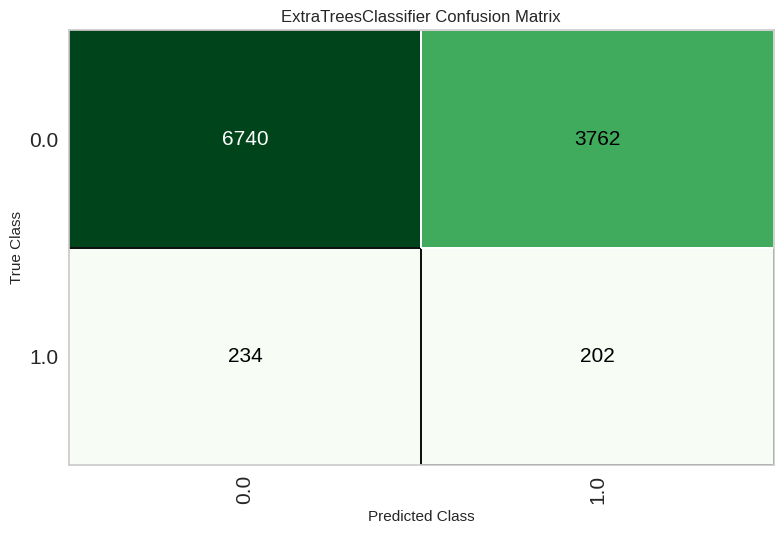

In [ ]:
et = create_model('et')

tuned_et, tuner = tune_model(et,optimize = 'eer',return_tuner=True,choose_better = True)

print(et)
print(tuned_et)

plot_model(tuned_et,plot = 'confusion_matrix')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.0674,0.4844,0.9802,0.0400,0.0768,0.0008,0.0115,0.4974
1,0.0572,0.5688,0.9901,0.0399,0.0767,0.0007,0.0129,0.4978
2,0.0549,0.4958,0.9902,0.0402,0.0773,0.0005,0.0096,0.4985
3,0.0600,0.5703,0.9902,0.0404,0.0777,0.0009,0.0157,0.4971
4,0.0564,0.5212,1.0000,0.0406,0.0781,0.0014,0.0264,0.4957
5,0.0607,0.5401,0.9902,0.0404,0.0777,0.0010,0.0165,0.4969
6,0.0580,0.4932,1.0000,0.0407,0.0782,0.0015,0.0276,0.4953
7,0.0615,0.5186,0.9902,0.0405,0.0778,0.0011,0.0173,0.4967
8,0.0584,0.5146,0.9804,0.0400,0.0768,0.0000,0.0005,0.4999


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9361,0.4941,0.0495,0.0694,0.0578,0.0257,0.0261,0.4942
1,0.9334,0.5682,0.0396,0.0519,0.0449,0.0111,0.0112,0.4975
2,0.9397,0.5040,0.0490,0.0806,0.0610,0.0317,0.0328,0.4933
3,0.9353,0.5808,0.0882,0.1111,0.0984,0.0653,0.0658,0.4844
4,0.9306,0.5239,0.0196,0.0253,0.0221,-0.0133,-0.0134,0.5030
5,0.9353,0.5371,0.0294,0.0435,0.0351,0.0029,0.0030,0.4994
6,0.9361,0.5034,0.0490,0.0704,0.0578,0.0258,0.0263,0.4943
7,0.9432,0.5235,0.0392,0.0784,0.0523,0.0263,0.0280,0.4948
8,0.9444,0.5238,0.0490,0.1000,0.0658,0.0406,0.0433,0.4921


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 10 candidates, totalling 100 fits


GaussianNB(priors=None, var_smoothing=1e-09)
GaussianNB(priors=None, var_smoothing=1)


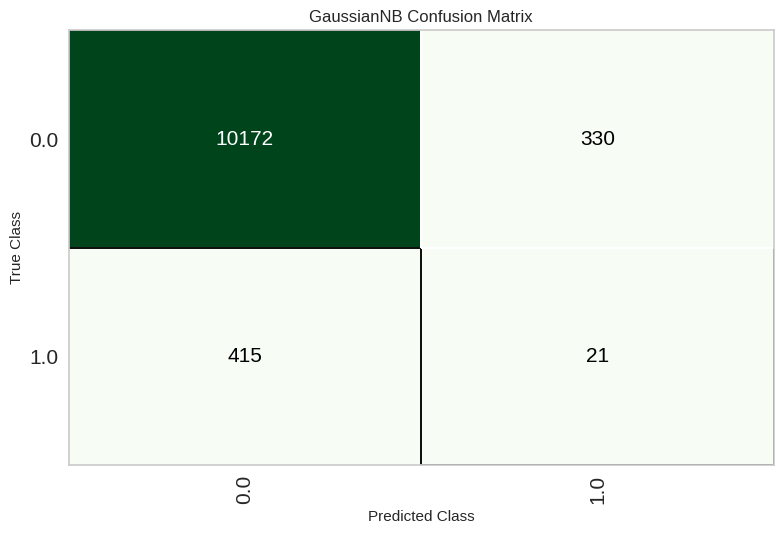

In [ ]:
nb = create_model('nb')

tuned_nb, tuner = tune_model(nb,optimize = 'eer',return_tuner=True,choose_better = True)

print(nb)
print(tuned_nb)

plot_model(tuned_nb,plot = 'confusion_matrix')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9585,0.6674,0.0396,0.3077,0.0702,0.0617,0.0984,0.4908
1,0.9577,0.6830,0.0891,0.3600,0.1429,0.1292,0.1635,0.4783
2,0.9616,0.6723,0.1078,0.6111,0.1833,0.1734,0.2457,0.4722
3,0.9569,0.6970,0.0980,0.3571,0.1538,0.1390,0.1705,0.4761
4,0.9585,0.6667,0.0490,0.3571,0.0862,0.0773,0.1203,0.4884
5,0.9573,0.6586,0.0686,0.3333,0.1138,0.1016,0.1364,0.4837
6,0.9592,0.7148,0.0784,0.4444,0.1333,0.1228,0.1740,0.4806
7,0.9561,0.6397,0.0980,0.3333,0.1515,0.1358,0.1633,0.4763
8,0.9589,0.6505,0.0980,0.4348,0.1600,0.1475,0.1922,0.4756


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9581,0.7083,0.1485,0.4167,0.2190,0.2024,0.2314,0.4620
1,0.9596,0.7157,0.2178,0.4783,0.2993,0.2815,0.3049,0.4413
2,0.9624,0.7113,0.2157,0.5789,0.3143,0.2991,0.3383,0.4412
3,0.9573,0.7358,0.1863,0.4222,0.2585,0.2399,0.2614,0.4513
4,0.9589,0.7095,0.1765,0.4615,0.2553,0.2385,0.2681,0.4537
5,0.9561,0.7068,0.1373,0.3684,0.2000,0.1823,0.2061,0.4656
6,0.9573,0.7334,0.1863,0.4222,0.2585,0.2399,0.2614,0.4513
7,0.9592,0.6934,0.2157,0.4783,0.2973,0.2794,0.3031,0.4420
8,0.9573,0.6648,0.1667,0.4146,0.2378,0.2199,0.2444,0.4570


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 10 candidates, totalling 100 fits


KNeighborsClassifier(algorithm='auto', leaf_size=30, metric='minkowski',
                     metric_params=None, n_jobs=-1, n_neighbors=5, p=2,
                     weights='uniform')
KNeighborsClassifier(algorithm='auto', leaf_size=30, metric='manhattan',
                     metric_params=None, n_jobs=-1, n_neighbors=13, p=2,
                     weights='distance')


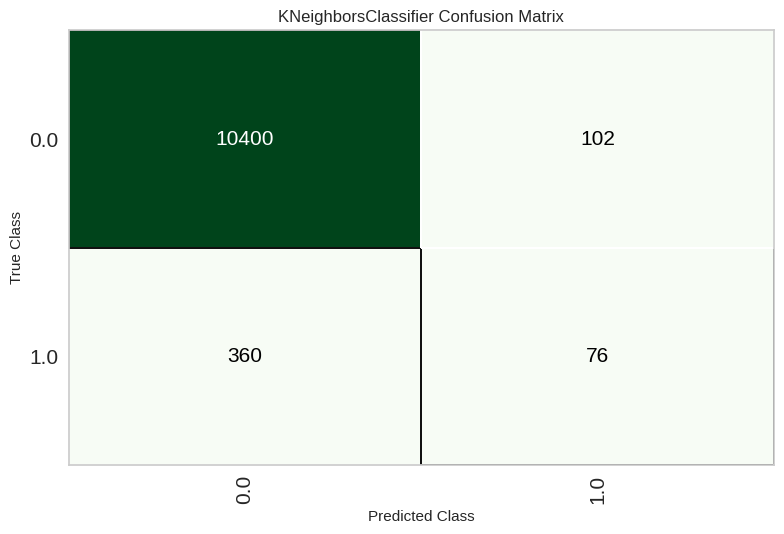

In [ ]:
knn = create_model('knn')

tuned_knn, tuner = tune_model(knn,optimize = 'eer',return_tuner=True,choose_better = True)

print(knn)
print(tuned_knn)

plot_model(tuned_knn,plot = 'confusion_matrix')

## Randomn UnderSampling

In [ ]:
import imblearn
from imblearn.under_sampling import RandomUnderSampler
ru = RandomUnderSampler(random_state=0)
smote = setup(df,test_data = test_data, target = 'STATUS',normalize = True,ignore_features = ['ID'],fix_imbalance = True,fix_imbalance_method = ru,index=False)
add_metric('eer', 'eer', calculate_eer,greater_is_better=False)

,Description,Value
0,Session id,7134
1,Target,STATUS
2,Target type,Binary
3,Original data shape,"(47395, 52)"
4,Transformed data shape,"(13844, 51)"
5,Transformed train set shape,"(2906, 51)"
6,Transformed test set shape,"(10938, 51)"
7,Ignore features,1
8,Numeric features,50
9,Rows with missing values,23.1%


Name                                                               eer
Display Name                                                       eer
Score Function       <pycaret.internal.metrics.EncodedDecodedLabels...
Scorer               make_scorer(calculate_eer, greater_is_better=F...
Target                                                            pred
Args                                                                {}
Greater is Better                                                False
Multiclass                                                        True
Custom                                                            True
Name: eer, dtype: object

In [ ]:
best = compare_models(sort='eer')

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer,TT (Sec)
xgboost,Extreme Gradient Boosting,0.5815,0.5350,0.4674,0.0448,0.0817,0.0097,0.0213,0.4748,0.2460
lda,Linear Discriminant Analysis,0.5552,0.5308,0.4941,0.0442,0.0811,0.0086,0.0204,0.4757,0.2050
lightgbm,Light Gradient Boosting Machine,0.5794,0.5292,0.4618,0.0442,0.0806,0.0085,0.0184,0.4783,0.7720
rf,Random Forest Classifier,0.6364,0.5046,0.3958,0.0446,0.0801,0.0092,0.0175,0.4811,0.9240
ada,Ada Boost Classifier,0.5383,0.5245,0.4968,0.0433,0.0795,0.0067,0.0146,0.4823,0.3160
ridge,Ridge Classifier,0.5472,0.0000,0.4853,0.0429,0.0788,0.0060,0.0139,0.4829,0.1160
lr,Logistic Regression,0.5458,0.5096,0.4804,0.0422,0.0776,0.0047,0.0114,0.4852,0.2120
catboost,CatBoost Classifier,0.6022,0.5168,0.4206,0.0429,0.0777,0.0059,0.0122,0.4852,2.9760
qda,Quadratic Discriminant Analysis,0.6724,0.5169,0.3479,0.0437,0.0731,0.0069,0.0141,0.4862,0.1270
dt,Decision Tree Classifier,0.5441,0.5140,0.4784,0.0422,0.0775,0.0046,0.0100,0.4874,0.1250


Processing:   0%|          | 0/69 [00:00<?, ?it/s]

In [ ]:
evaluate_model(best)

interactive(children=(ToggleButtons(description='Plot Type:', icons=('',), options=(('Pipeline Plot', 'pipelin…

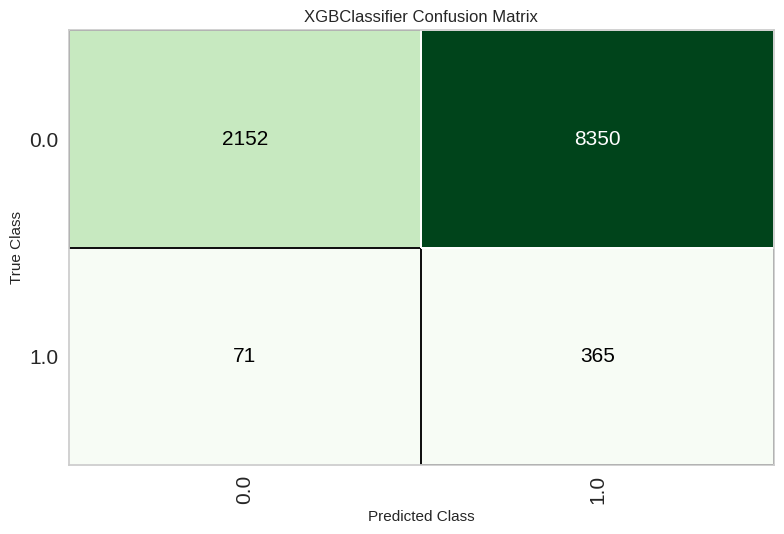

In [ ]:
plot_model(best,plot = 'confusion_matrix')

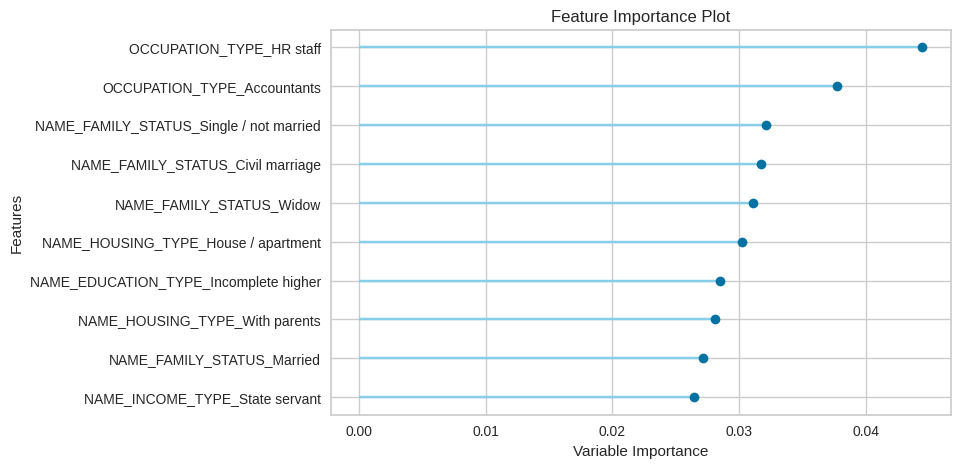

In [ ]:
plot_model(best,plot = 'feature')

### Models Confusion Matrix after undersampling

In [ ]:
dt = create_model('dt')
rf = create_model('rf')
et = create_model('et')
catboost = create_model('catboost')
knn = create_model('knn')
lightgbm = create_model('lightgbm')
qda = create_model('qda')
lda = create_model('lda')
gbc = create_model('gbc')
svm = create_model('svm')
nb = create_model('nb')
lr = create_model('lr')
ridge = create_model('ridge')
ada = create_model('ada')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.8897,0.5149,0.1241,0.0614,0.0822,0.0306,0.0328,0.4873
1,0.8760,0.4872,0.0897,0.0390,0.0544,-0.0011,-0.0012,0.5005
2,0.8675,0.4806,0.0897,0.0357,0.0511,-0.0061,-0.0069,0.5029
3,0.7869,0.4036,0.0345,0.0078,0.0127,-0.0558,-0.0757,0.5413
4,0.8110,0.4204,0.0411,0.0108,0.0171,-0.0494,-0.0632,0.5321
5,0.8332,0.4520,0.0479,0.0147,0.0225,-0.0413,-0.0501,0.5237
6,0.8086,0.4451,0.0548,0.0141,0.0224,-0.0441,-0.0569,0.5295
7,0.7956,0.4978,0.0966,0.0223,0.0362,-0.0304,-0.0408,0.5228
8,0.8316,0.5427,0.1655,0.0464,0.0725,0.0111,0.0138,0.4927


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9377,0.4471,0.0414,0.0638,0.0502,0.0195,0.0200,0.4958
1,0.9251,0.4326,0.0483,0.0493,0.0488,0.0098,0.0098,0.4975
2,0.9240,0.3855,0.0828,0.0769,0.0797,0.0402,0.0402,0.4889
3,0.8645,0.1902,0.0138,0.0057,0.0080,-0.0512,-0.0571,0.5229
4,0.8796,0.2322,0.0411,0.0197,0.0266,-0.0291,-0.0314,0.5118
5,0.8790,0.2196,0.0342,0.0164,0.0222,-0.0338,-0.0364,0.5137
6,0.8645,0.2578,0.0548,0.0220,0.0314,-0.0274,-0.0307,0.5127
7,0.8796,0.3771,0.0621,0.0288,0.0394,-0.0158,-0.0171,0.5066
8,0.8856,0.4598,0.0966,0.0467,0.0629,0.0098,0.0106,0.4959


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9339,0.4283,0.0483,0.0636,0.0549,0.0213,0.0215,0.4951
1,0.9227,0.4089,0.0483,0.0464,0.0473,0.0070,0.0070,0.4981
2,0.9152,0.3070,0.0828,0.0638,0.0721,0.0284,0.0287,0.4913
3,0.8629,0.1433,0.0207,0.0083,0.0119,-0.0476,-0.0534,0.5217
4,0.8763,0.1763,0.0411,0.0189,0.0259,-0.0306,-0.0332,0.5128
5,0.8755,0.2041,0.0342,0.0157,0.0216,-0.0353,-0.0383,0.5147
6,0.8585,0.1928,0.0548,0.0207,0.0301,-0.0298,-0.0339,0.5145
7,0.8705,0.3199,0.0621,0.0261,0.0367,-0.0204,-0.0227,0.5092
8,0.8708,0.4144,0.1103,0.0447,0.0636,0.0074,0.0083,0.4965


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9526,0.5200,0.0276,0.1111,0.0442,0.0288,0.0365,0.4953
1,0.9410,0.5616,0.0207,0.0395,0.0271,-0.0002,-0.0002,0.5000
2,0.9526,0.4914,0.0552,0.1818,0.0847,0.0674,0.0803,0.4884
3,0.9344,0.4083,0.0138,0.0204,0.0165,-0.0161,-0.0165,0.5035
4,0.9451,0.4160,0.0068,0.0179,0.0099,-0.0126,-0.0141,0.5022
5,0.9292,0.4808,0.0274,0.0333,0.0301,-0.0063,-0.0063,0.5015
6,0.9196,0.4102,0.0274,0.0258,0.0266,-0.0153,-0.0153,0.5041
7,0.9314,0.5180,0.0690,0.0800,0.0741,0.0387,0.0388,0.4905
8,0.9185,0.5353,0.0690,0.0581,0.0631,0.0208,0.0209,0.4940


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.8341,0.4954,0.1172,0.0344,0.0532,-0.0088,-0.0109,0.5054
1,0.8269,0.4491,0.0897,0.0254,0.0396,-0.0239,-0.0297,0.5150
2,0.8450,0.4809,0.1172,0.0374,0.0568,-0.0037,-0.0045,0.5022
3,0.7984,0.4083,0.0414,0.0100,0.0161,-0.0513,-0.0678,0.5360
4,0.7916,0.4246,0.0342,0.0080,0.0130,-0.0555,-0.0742,0.5399
5,0.7828,0.4540,0.0890,0.0193,0.0318,-0.0364,-0.0502,0.5288
6,0.7545,0.4207,0.0822,0.0155,0.0261,-0.0442,-0.0649,0.5398
7,0.7989,0.5086,0.1310,0.0304,0.0493,-0.0164,-0.0220,0.5125
8,0.7830,0.5134,0.2138,0.0438,0.0727,0.0071,0.0101,0.4936


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9512,0.5249,0.0069,0.0286,0.0111,-0.0044,-0.0056,0.5007
1,0.9487,0.5473,0.0207,0.0625,0.0311,0.0115,0.0134,0.4980
2,0.9564,0.4863,0.0207,0.1500,0.0364,0.0270,0.0419,0.4960
3,0.9446,0.4260,0.0069,0.0169,0.0098,-0.0135,-0.0150,0.5024
4,0.9545,0.4458,0.0274,0.1429,0.0460,0.0335,0.0461,0.4948
5,0.9391,0.5234,0.0000,0.0000,0.0000,-0.0282,-0.0298,0.5055
6,0.9473,0.3862,0.0137,0.0400,0.0204,-0.0000,-0.0000,0.5000
7,0.9457,0.5344,0.0276,0.0656,0.0388,0.0156,0.0172,0.4971
8,0.9339,0.5127,0.0276,0.0385,0.0321,-0.0011,-0.0012,0.5003


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.0428,0.5016,1.0000,0.0399,0.0767,0.0003,0.0112,0.4992
1,0.0400,0.5001,1.0000,0.0398,0.0765,0.0000,0.0034,0.4999
2,0.0398,0.5000,1.0000,0.0398,0.0765,0.0000,0.0000,0.5000
3,0.0436,0.5020,1.0000,0.0399,0.0768,0.0003,0.0126,0.4990
4,0.0422,0.5011,1.0000,0.0401,0.0772,0.0002,0.0096,0.4994
5,0.0403,0.5001,1.0000,0.0401,0.0770,0.0000,0.0034,0.4999
6,0.0406,0.5003,1.0000,0.0401,0.0770,0.0000,0.0048,0.4999
7,0.0398,0.5000,1.0000,0.0398,0.0765,0.0000,0.0000,0.5000
8,0.0398,0.5000,1.0000,0.0398,0.0765,0.0000,0.0000,0.5000


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.5957,0.5367,0.4414,0.0439,0.0799,0.0081,0.0174,0.4813
1,0.6306,0.4818,0.3448,0.0384,0.0691,-0.0026,-0.0052,0.5049
2,0.5776,0.5746,0.5724,0.0532,0.0973,0.0264,0.0593,0.4253
3,0.5343,0.4143,0.3379,0.0297,0.0546,-0.0200,-0.0470,0.5497
4,0.6196,0.5572,0.4521,0.0481,0.0869,0.0156,0.0318,0.4665
5,0.6064,0.5180,0.4178,0.0432,0.0784,0.0062,0.0129,0.4866
6,0.5326,0.4862,0.4932,0.0423,0.0779,0.0045,0.0108,0.4868
7,0.6187,0.5513,0.5103,0.0531,0.0962,0.0260,0.0537,0.4400
8,0.4971,0.5113,0.5448,0.0428,0.0794,0.0060,0.0156,0.4810


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9589,0.4956,0.0000,0.0000,0.0000,-0.0027,-0.0075,0.5004
1,0.9600,0.5166,0.0000,0.0000,0.0000,-0.0005,-0.0034,0.5001
2,0.9597,0.4454,0.0000,0.0000,0.0000,-0.0011,-0.0048,0.5001
3,0.9545,0.4415,0.0000,0.0000,0.0000,-0.0102,-0.0155,0.5015
4,0.9569,0.4792,0.0000,0.0000,0.0000,-0.0056,-0.0112,0.5008
5,0.9515,0.5269,0.0000,0.0000,0.0000,-0.0142,-0.0189,0.5022
6,0.9539,0.4071,0.0000,0.0000,0.0000,-0.0106,-0.0159,0.5016
7,0.9525,0.5365,0.0069,0.0333,0.0114,-0.0022,-0.0030,0.5003
8,0.9558,0.4966,0.0138,0.1000,0.0242,0.0147,0.0229,0.4978


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.5872,0.0000,0.4345,0.0424,0.0773,0.0052,0.0111,0.4879
1,0.6621,0.0000,0.2345,0.0294,0.0523,-0.0198,-0.0360,0.5297
2,0.5025,0.0000,0.5310,0.0422,0.0783,0.0049,0.0126,0.4843
3,0.5826,0.0000,0.3103,0.0307,0.0558,-0.0178,-0.0382,0.5373
4,0.6212,0.0000,0.5068,0.0535,0.0968,0.0263,0.0537,0.4406
5,0.5601,0.0000,0.4589,0.0421,0.0771,0.0040,0.0092,0.4895
6,0.5049,0.0000,0.5548,0.0445,0.0824,0.0089,0.0226,0.4726
7,0.5937,0.0000,0.5034,0.0493,0.0897,0.0186,0.0401,0.4539
8,0.4702,0.0000,0.5655,0.0421,0.0783,0.0046,0.0125,0.4855


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.0848,0.5035,0.9172,0.0385,0.0738,-0.0027,-0.0287,0.5087
1,0.0694,0.4901,0.9379,0.0386,0.0742,-0.0024,-0.0307,0.5075
2,0.0741,0.4317,0.9448,0.0391,0.0751,-0.0014,-0.0174,0.5045
3,0.0752,0.4778,0.9586,0.0397,0.0762,-0.0002,-0.0029,0.5007
4,0.0837,0.4977,0.9795,0.0411,0.0789,0.0022,0.0243,0.4933
5,0.0839,0.5104,0.9521,0.0400,0.0768,-0.0000,-0.0002,0.5001
6,0.0595,0.3688,0.9110,0.0375,0.0720,-0.0053,-0.0792,0.5172
7,0.0768,0.5378,0.9724,0.0403,0.0773,0.0010,0.0122,0.4969
8,0.0798,0.4801,0.9793,0.0407,0.0781,0.0018,0.0214,0.4944


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.5952,0.5368,0.4414,0.0439,0.0798,0.0080,0.0171,0.4815
1,0.6306,0.4818,0.3379,0.0377,0.0678,-0.0040,-0.0079,0.5074
2,0.5776,0.5741,0.5724,0.0532,0.0973,0.0264,0.0593,0.4253
3,0.5370,0.4148,0.3379,0.0299,0.0549,-0.0196,-0.0459,0.5484
4,0.6196,0.5573,0.4521,0.0481,0.0869,0.0156,0.0318,0.4665
5,0.6039,0.5187,0.4178,0.0430,0.0779,0.0057,0.0119,0.4876
6,0.5324,0.4856,0.4932,0.0423,0.0779,0.0044,0.0107,0.4870
7,0.6198,0.5515,0.5103,0.0533,0.0965,0.0263,0.0542,0.4396
8,0.4955,0.5114,0.5379,0.0422,0.0782,0.0048,0.0124,0.4848


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.5957,0.0000,0.4414,0.0439,0.0799,0.0081,0.0174,0.4813
1,0.6306,0.0000,0.3448,0.0384,0.0691,-0.0026,-0.0052,0.5049
2,0.5776,0.0000,0.5724,0.0532,0.0973,0.0264,0.0593,0.4253
3,0.5343,0.0000,0.3379,0.0297,0.0546,-0.0200,-0.0470,0.5497
4,0.6196,0.0000,0.4521,0.0481,0.0869,0.0156,0.0318,0.4665
5,0.6064,0.0000,0.4178,0.0432,0.0784,0.0062,0.0129,0.4866
6,0.5326,0.0000,0.4932,0.0423,0.0779,0.0045,0.0108,0.4868
7,0.6187,0.0000,0.5103,0.0531,0.0962,0.0260,0.0537,0.4400
8,0.4971,0.0000,0.5448,0.0428,0.0794,0.0060,0.0156,0.4810


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9460,0.5548,0.0000,0.0000,0.0000,-0.0214,-0.0245,0.5037
1,0.9528,0.4492,0.0345,0.1351,0.0549,0.0394,0.0494,0.4935
2,0.9462,0.5205,0.0276,0.0678,0.0392,0.0166,0.0184,0.4970
3,0.9517,0.4889,0.0276,0.1026,0.0435,0.0271,0.0334,0.4955
4,0.9484,0.4894,0.0000,0.0000,0.0000,-0.0182,-0.0220,0.5030
5,0.9377,0.5246,0.0000,0.0000,0.0000,-0.0294,-0.0308,0.5059
6,0.9380,0.4666,0.0137,0.0238,0.0174,-0.0122,-0.0127,0.5025
7,0.9380,0.5320,0.0621,0.0909,0.0738,0.0429,0.0437,0.4905
8,0.9514,0.4816,0.0069,0.0294,0.0112,-0.0040,-0.0051,0.5006


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.5963,0.5295,0.4207,0.0421,0.0765,0.0046,0.0097,0.4898
1,0.5752,0.5042,0.4483,0.0424,0.0774,0.0051,0.0114,0.4873
2,0.5993,0.6035,0.5931,0.0578,0.1053,0.0354,0.0766,0.4043
3,0.5403,0.4623,0.3586,0.0318,0.0584,-0.0158,-0.0368,0.5393
4,0.5491,0.4715,0.4041,0.0365,0.0670,-0.0070,-0.0161,0.5177
5,0.5219,0.4660,0.3904,0.0333,0.0614,-0.0134,-0.0323,0.5361
6,0.4745,0.4668,0.4521,0.0347,0.0645,-0.0107,-0.0285,0.5354
7,0.5800,0.5287,0.4414,0.0423,0.0772,0.0049,0.0107,0.4882
8,0.4982,0.4998,0.4966,0.0394,0.0730,-0.0008,-0.0020,0.5026


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

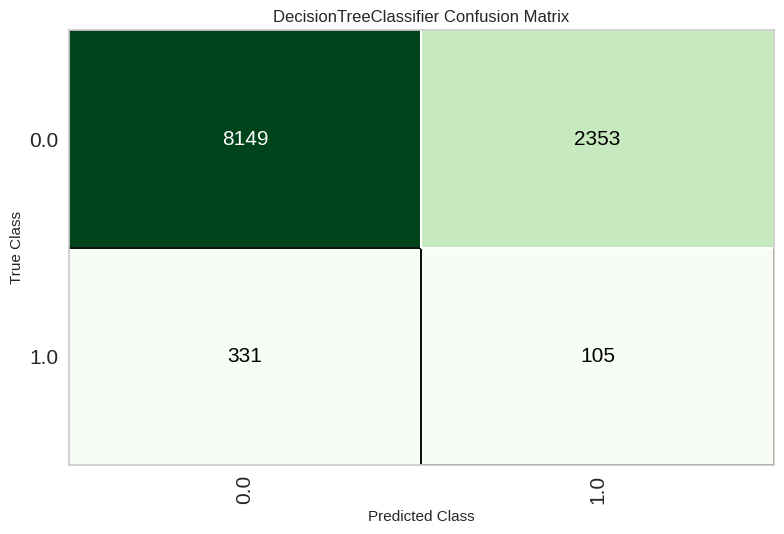

In [ ]:
dt = create_model('dt')
plot_model(dt,plot = 'confusion_matrix')

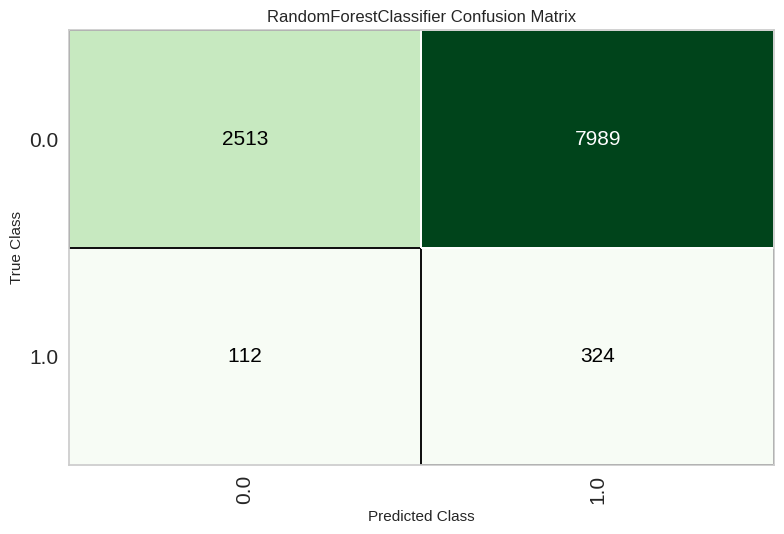

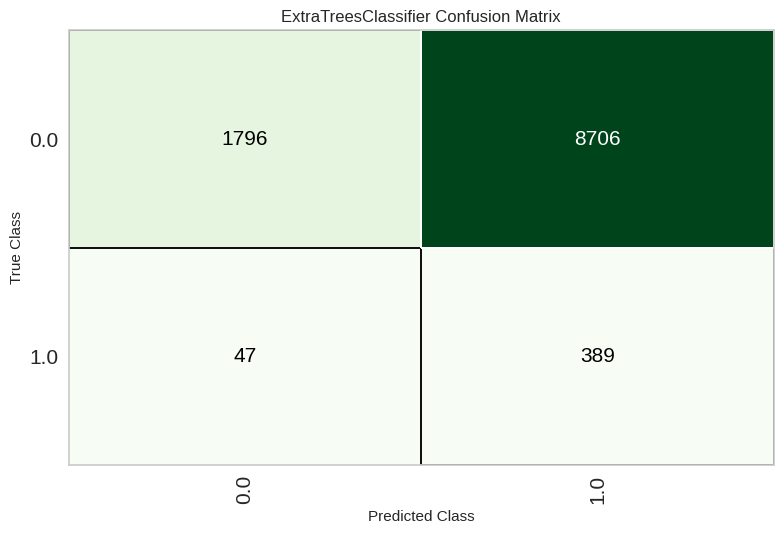

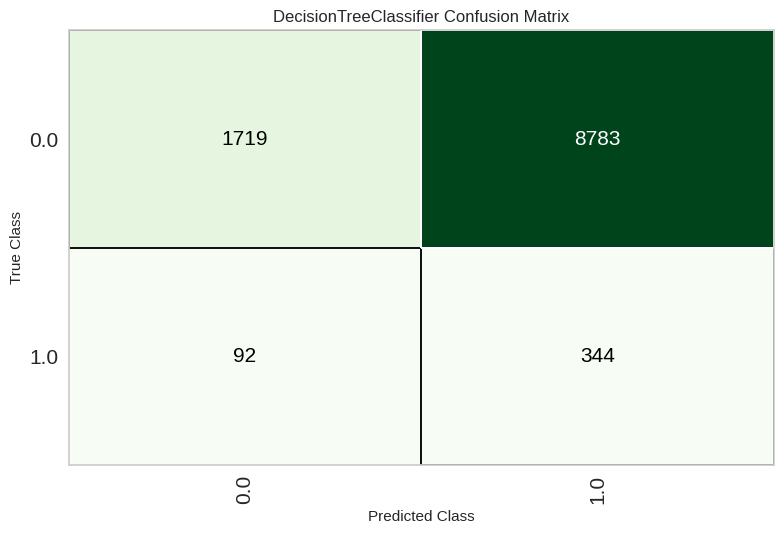

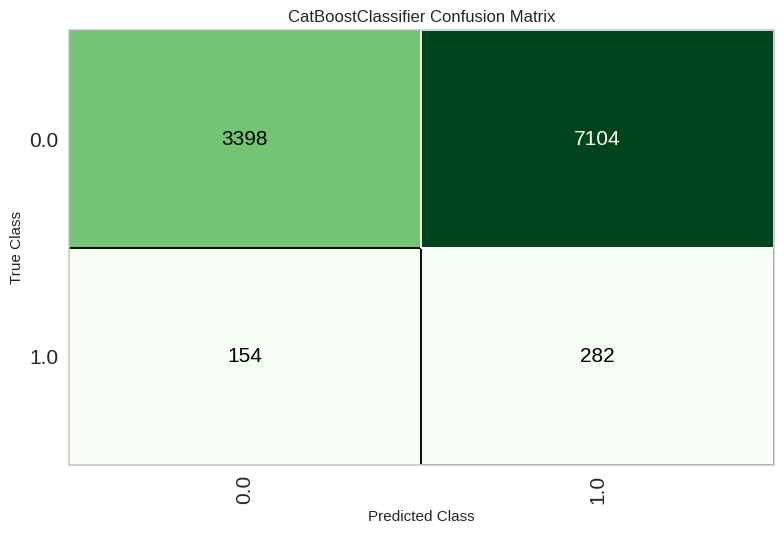

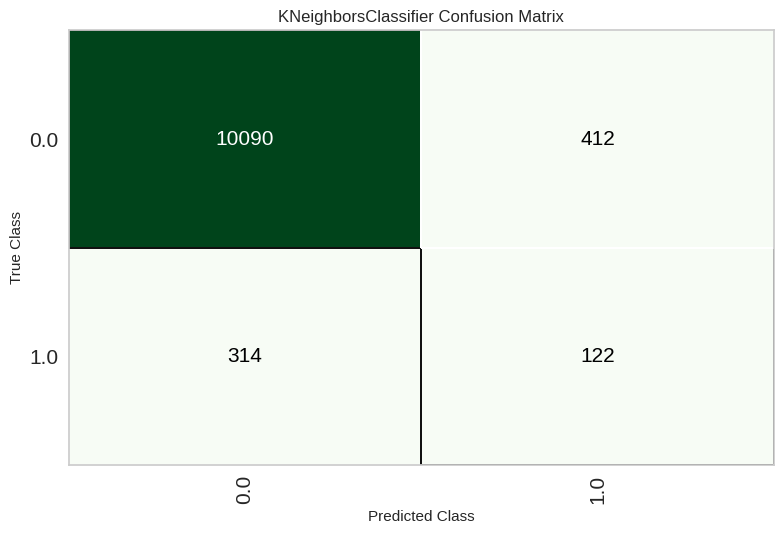

...

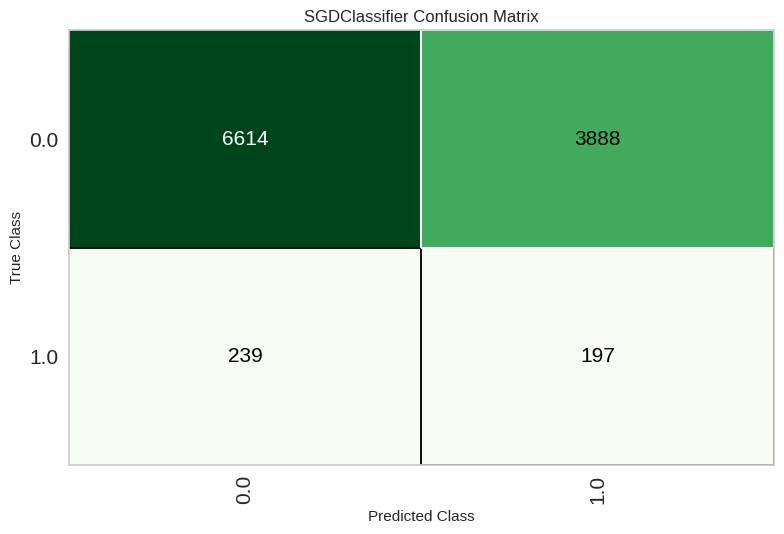

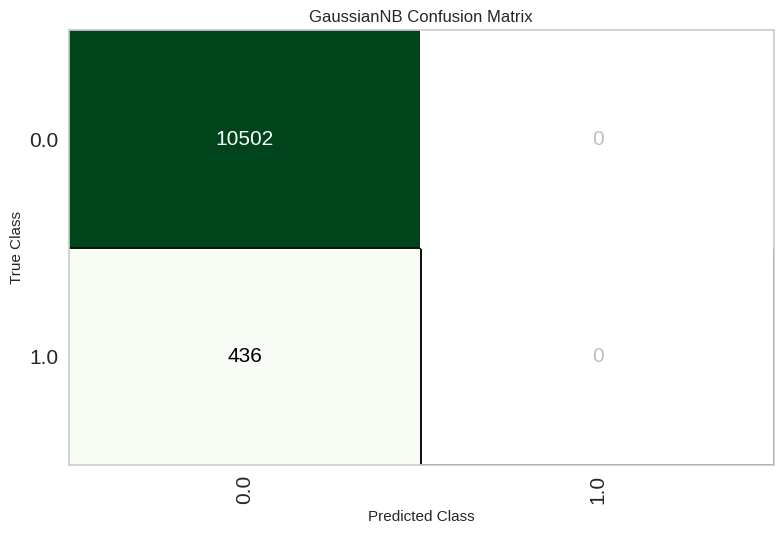

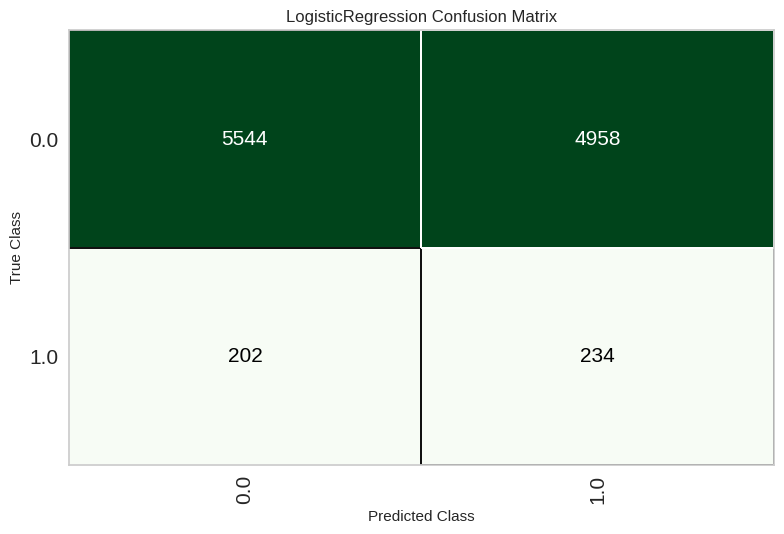

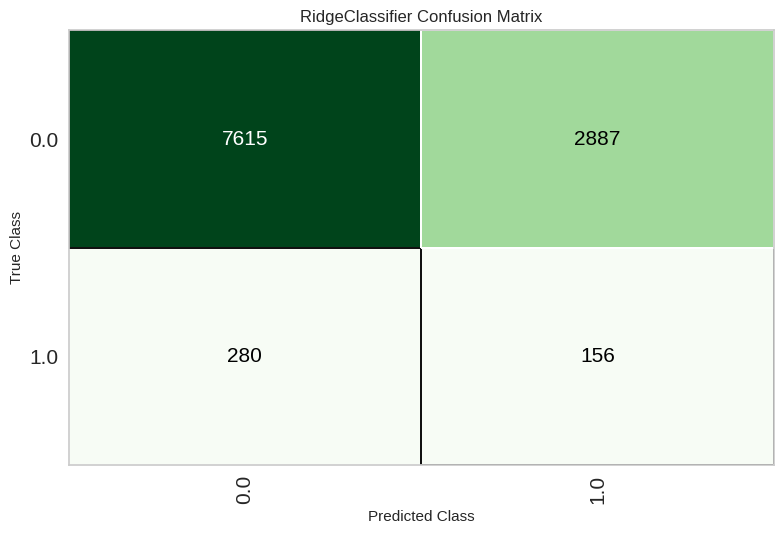

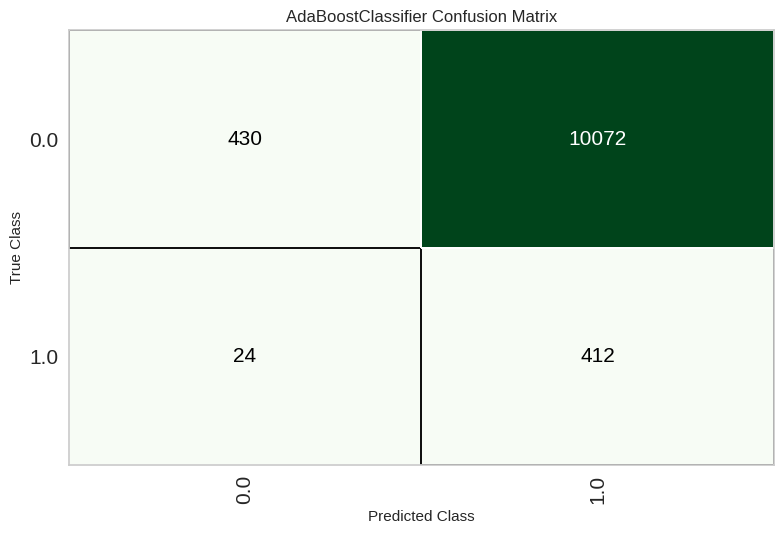

In [ ]:
plot_model(rf,plot = 'confusion_matrix')
plot_model(et,plot = 'confusion_matrix')
plot_model(dt,plot = 'confusion_matrix')
plot_model(catboost,plot = 'confusion_matrix')
plot_model(knn,plot = 'confusion_matrix')
plot_model(lightgbm,plot = 'confusion_matrix')
plot_model(qda,plot = 'confusion_matrix')
plot_model(lda,plot = 'confusion_matrix')
plot_model(gbc,plot = 'confusion_matrix')
plot_model(svm,plot = 'confusion_matrix')
plot_model(nb,plot = 'confusion_matrix')
plot_model(lr,plot = 'confusion_matrix')
plot_model(ridge,plot = 'confusion_matrix')
plot_model(ada,plot = 'confusion_matrix')

### Tune with UnderSampling

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.5266,0.0000,0.4621,0.0391,0.0720,-0.0014,-0.0034,0.5041
1,0.5453,0.0000,0.5103,0.0446,0.0819,0.0095,0.0224,0.4725
2,0.6168,0.0000,0.3931,0.0417,0.0754,0.0038,0.0078,0.4922
3,0.5765,0.0000,0.3586,0.0346,0.0631,-0.0102,-0.0222,0.5228
4,0.4589,0.0000,0.4247,0.0318,0.0591,-0.0166,-0.0452,0.5555
5,0.5442,0.0000,0.4521,0.0400,0.0736,0.0000,0.0000,0.5000
6,0.5041,0.0000,0.4110,0.0337,0.0622,-0.0127,-0.0318,0.5369
7,0.5660,0.0000,0.4345,0.0403,0.0738,0.0010,0.0023,0.4974
8,0.5951,0.0000,0.2690,0.0277,0.0502,-0.0237,-0.0492,0.5457


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.5677,0.0000,0.5310,0.0486,0.0890,0.0174,0.0395,0.4517
1,0.6396,0.0000,0.3103,0.0357,0.0641,-0.0078,-0.0150,0.5136
2,0.6665,0.0000,0.4966,0.0593,0.1059,0.0375,0.0705,0.4277
3,0.4953,0.0000,0.4828,0.0381,0.0707,-0.0032,-0.0084,0.5106
4,0.5697,0.0000,0.5068,0.0471,0.0862,0.0139,0.0313,0.4629
5,0.5924,0.0000,0.4726,0.0467,0.0850,0.0130,0.0280,0.4689
6,0.5587,0.0000,0.4589,0.0420,0.0769,0.0038,0.0086,0.4901
7,0.5396,0.0000,0.5655,0.0483,0.0890,0.0170,0.0408,0.4493
8,0.5567,0.0000,0.5172,0.0463,0.0849,0.0128,0.0297,0.4637


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 50 candidates, totalling 500 fits


SGDClassifier(alpha=0.0001, average=False, class_weight=None,
              early_stopping=False, epsilon=0.1, eta0=0.001, fit_intercept=True,
              l1_ratio=0.15, learning_rate='optimal', loss='hinge',
              max_iter=1000, n_iter_no_change=5, n_jobs=-1, penalty='l2',
              power_t=0.5, random_state=7881, shuffle=True, tol=0.001,
              validation_fraction=0.1, verbose=0, warm_start=False)
SGDClassifier(alpha=0.002, average=False, class_weight=None,
              early_stopping=False, epsilon=0.1, eta0=0.2, fit_intercept=True,
              l1_ratio=0.0600000001, learning_rate='optimal', loss='hinge',
              max_iter=1000, n_iter_no_change=5, n_jobs=-1,
              penalty='elasticnet', power_t=0.5, random_state=7881,
              shuffle=True, tol=0.001, validation_fraction=0.1, verbose=0,
              warm_start=False)


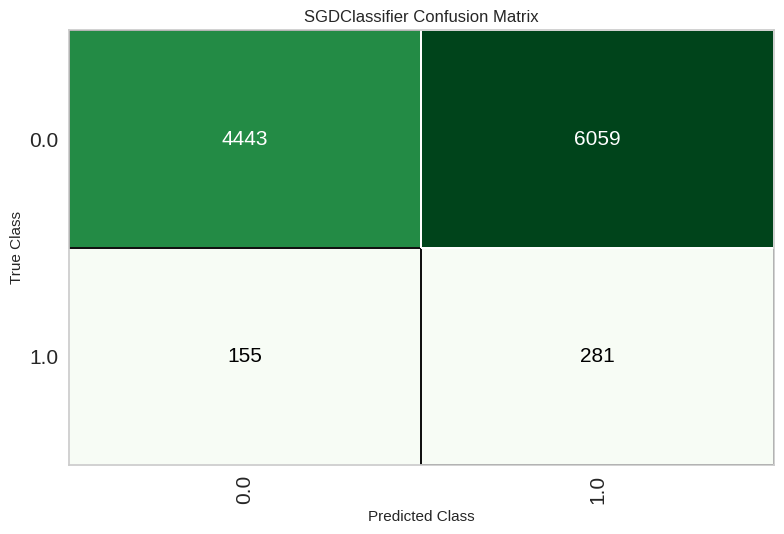

In [ ]:
svm = create_model('svm')

tuned_svm, tuner = tune_model(svm,optimize = 'eer',return_tuner=True,choose_better = True,n_iter = 50)

print(svm)
print(tuned_svm)


plot_model(tuned_svm,plot = 'confusion_matrix')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.5976,0.5068,0.4138,0.0416,0.0756,0.0036,0.0076,0.4920
1,0.5845,0.4815,0.3586,0.0353,0.0642,-0.0088,-0.0189,0.5192
2,0.6081,0.5812,0.5793,0.0579,0.1052,0.0354,0.0753,0.4085
3,0.5148,0.4593,0.3793,0.0317,0.0585,-0.0160,-0.0392,0.5439
4,0.5217,0.4327,0.3562,0.0306,0.0563,-0.0189,-0.0453,0.5492
5,0.5258,0.4700,0.4178,0.0358,0.0659,-0.0085,-0.0204,0.5233
6,0.5313,0.5135,0.4726,0.0406,0.0747,0.0010,0.0025,0.4970
7,0.5394,0.5233,0.5034,0.0435,0.0800,0.0073,0.0174,0.4786
8,0.5498,0.5632,0.5862,0.0510,0.0939,0.0223,0.0528,0.4352


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.6953,0.5174,0.3241,0.0443,0.0780,0.0086,0.0150,0.4875
1,0.7074,0.4840,0.2414,0.0353,0.0616,-0.0084,-0.0140,0.5108
2,0.7345,0.5742,0.4000,0.0618,0.1070,0.0409,0.0663,0.4450
3,0.7071,0.5169,0.3103,0.0444,0.0777,0.0087,0.0148,0.4880
4,0.6591,0.5378,0.3904,0.0471,0.0840,0.0135,0.0253,0.4763
5,0.5886,0.5921,0.5959,0.0569,0.1039,0.0333,0.0732,0.4086
6,0.6961,0.5693,0.4315,0.0579,0.1021,0.0339,0.0594,0.4457
7,0.2187,0.4789,0.7724,0.0383,0.0729,-0.0031,-0.0157,0.5101
8,0.6568,0.5040,0.3379,0.0407,0.0726,0.0018,0.0033,0.4970


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 10 candidates, totalling 100 fits


DecisionTreeClassifier(ccp_alpha=0.0, class_weight=None, criterion='gini',
                       max_depth=None, max_features=None, max_leaf_nodes=None,
                       min_impurity_decrease=0.0, min_samples_leaf=1,
                       min_samples_split=2, min_weight_fraction_leaf=0.0,
                       random_state=7137, splitter='best')
DecisionTreeClassifier(ccp_alpha=0.0, class_weight=None, criterion='gini',
                       max_depth=2, max_features='log2', max_leaf_nodes=None,
                       min_impurity_decrease=0.001, min_samples_leaf=3,
                       min_samples_split=10, min_weight_fraction_leaf=0.0,
                       random_state=7137, splitter='best')


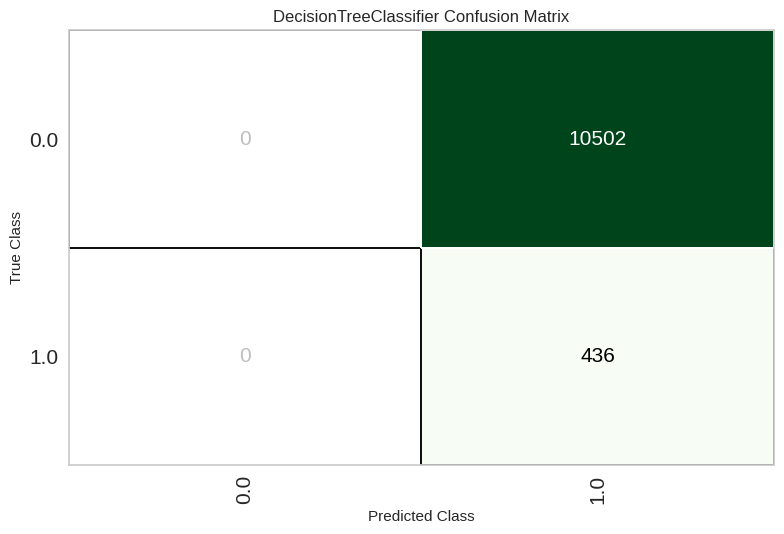

In [ ]:
dt = create_model('dt')

tuned_dt, tuner = tune_model(dt,optimize = 'eer',return_tuner=True,choose_better = True)

print(dt)
print(tuned_dt)

plot_model(tuned_dt,plot = 'confusion_matrix')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.5669,0.0000,0.4621,0.0427,0.0782,0.0058,0.0132,0.4850
1,0.6061,0.0000,0.3379,0.0353,0.0639,-0.0088,-0.0180,0.5175
2,0.5543,0.0000,0.5862,0.0515,0.0947,0.0233,0.0546,0.4326
3,0.5370,0.0000,0.4276,0.0372,0.0684,-0.0051,-0.0121,0.5138
4,0.5795,0.0000,0.4178,0.0404,0.0737,0.0007,0.0016,0.4982
5,0.5623,0.0000,0.4658,0.0429,0.0785,0.0056,0.0127,0.4854
6,0.5291,0.0000,0.5068,0.0430,0.0794,0.0060,0.0145,0.4820
7,0.5874,0.0000,0.4690,0.0455,0.0829,0.0112,0.0243,0.4727
8,0.4785,0.0000,0.5379,0.0408,0.0758,0.0020,0.0055,0.4934


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.5861,0.0000,0.5034,0.0483,0.0882,0.0169,0.0369,0.4572
1,0.5971,0.0000,0.3517,0.0358,0.0649,-0.0078,-0.0164,0.5163
2,0.5880,0.0000,0.5586,0.0533,0.0974,0.0267,0.0586,0.4283
3,0.5428,0.0000,0.3586,0.0320,0.0587,-0.0154,-0.0358,0.5382
4,0.5784,0.0000,0.4726,0.0451,0.0824,0.0100,0.0220,0.4750
5,0.5798,0.0000,0.4178,0.0405,0.0738,0.0008,0.0017,0.4981
6,0.5115,0.0000,0.5205,0.0425,0.0786,0.0050,0.0124,0.4843
7,0.5885,0.0000,0.4483,0.0438,0.0798,0.0078,0.0169,0.4814
8,0.4735,0.0000,0.5586,0.0418,0.0778,0.0041,0.0112,0.4869


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 10 candidates, totalling 100 fits


RidgeClassifier(alpha=1.0, class_weight=None, copy_X=True, fit_intercept=True,
                max_iter=None, positive=False, random_state=7137, solver='auto',
                tol=0.0001)
RidgeClassifier(alpha=6.43, class_weight=None, copy_X=True, fit_intercept=True,
                max_iter=None, positive=False, random_state=7137, solver='auto',
                tol=0.0001)


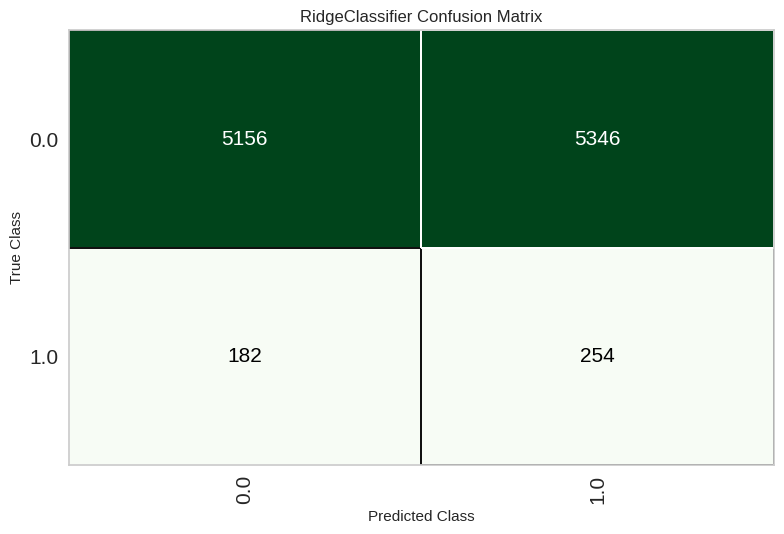

In [ ]:
ridge = create_model('ridge')

tuned_ridge, tuner = tune_model(ridge,optimize = 'eer',return_tuner=True,choose_better = True)

print(ridge)
print(tuned_ridge)

plot_model(tuned_ridge,plot = 'confusion_matrix')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.5990,0.5259,0.4759,0.0474,0.0862,0.0150,0.0319,0.4646
1,0.5636,0.5056,0.4897,0.0447,0.0819,0.0098,0.0222,0.4738
2,0.6317,0.5948,0.5586,0.0596,0.1076,0.0385,0.0781,0.4102
3,0.5192,0.4467,0.3517,0.0298,0.0550,-0.0198,-0.0478,0.5520
4,0.5957,0.5378,0.4795,0.0477,0.0867,0.0150,0.0320,0.4643
5,0.5875,0.5706,0.5205,0.0503,0.0918,0.0202,0.0441,0.4482
6,0.4860,0.4716,0.4247,0.0335,0.0621,-0.0131,-0.0340,0.5408
7,0.5627,0.5323,0.4414,0.0406,0.0743,0.0016,0.0036,0.4960
8,0.4834,0.5304,0.5448,0.0417,0.0774,0.0038,0.0100,0.4879


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.5987,0.5433,0.4207,0.0424,0.0770,0.0051,0.0107,0.4887
1,0.6029,0.4857,0.3103,0.0323,0.0585,-0.0146,-0.0300,0.5286
2,0.5897,0.5333,0.4621,0.0451,0.0822,0.0105,0.0227,0.4748
3,0.5225,0.4267,0.3793,0.0322,0.0594,-0.0150,-0.0361,0.5401
4,0.6226,0.5685,0.4521,0.0485,0.0875,0.0164,0.0331,0.4653
5,0.5595,0.5099,0.4589,0.0420,0.0770,0.0039,0.0089,0.4898
6,0.4756,0.5061,0.6027,0.0453,0.0843,0.0106,0.0287,0.4678
7,0.5857,0.5479,0.5310,0.0507,0.0925,0.0215,0.0472,0.4437
8,0.4922,0.5154,0.5310,0.0414,0.0768,0.0032,0.0084,0.4896


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 10 candidates, totalling 100 fits


LinearDiscriminantAnalysis(covariance_estimator=None, n_components=None,
                           priors=None, shrinkage=None, solver='svd',
                           store_covariance=False, tol=0.0001)
LinearDiscriminantAnalysis(covariance_estimator=None, n_components=None,
                           priors=None, shrinkage=0.1, solver='lsqr',
                           store_covariance=False, tol=0.0001)


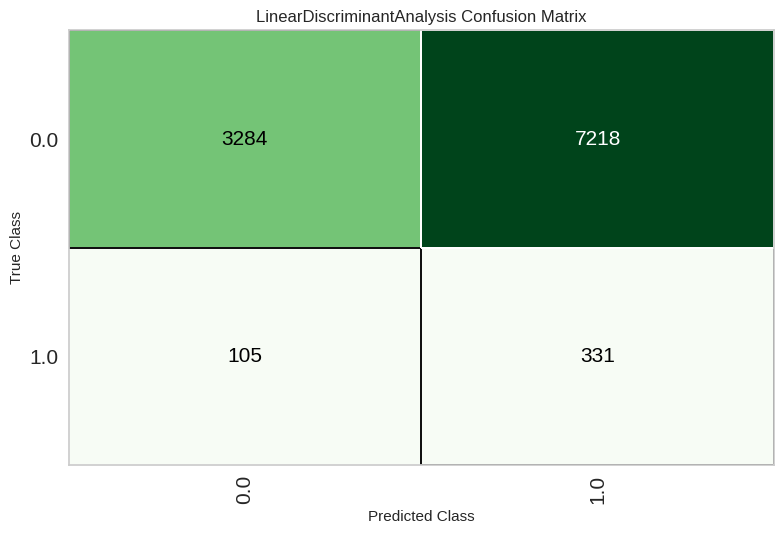

In [ ]:
lda = create_model('lda')

tuned_lda, tuner = tune_model(lda,optimize = 'eer',return_tuner=True,choose_better = True)

print(lda)
print(tuned_lda)

plot_model(tuned_lda,plot = 'confusion_matrix')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.5713,0.5507,0.4897,0.0455,0.0833,0.0113,0.0254,0.4703
1,0.5927,0.4802,0.4069,0.0405,0.0736,0.0014,0.0029,0.4969
2,0.5551,0.5550,0.5517,0.0489,0.0898,0.0180,0.0420,0.4467
3,0.5343,0.4281,0.3379,0.0297,0.0546,-0.0200,-0.0470,0.5497
4,0.6039,0.5493,0.5068,0.0512,0.0930,0.0218,0.0460,0.4479
5,0.5614,0.5556,0.4658,0.0428,0.0784,0.0054,0.0123,0.4858
6,0.5664,0.5124,0.4863,0.0450,0.0824,0.0098,0.0222,0.4741
7,0.5638,0.5409,0.5241,0.0476,0.0873,0.0154,0.0353,0.4570
8,0.4927,0.4982,0.5448,0.0424,0.0787,0.0053,0.0138,0.4832


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.5820,0.5183,0.4207,0.0406,0.0741,0.0017,0.0037,0.4960
1,0.5716,0.4657,0.4483,0.0420,0.0768,0.0044,0.0099,0.4889
2,0.5666,0.5830,0.5931,0.0535,0.0982,0.0272,0.0624,0.4228
3,0.5222,0.4031,0.3034,0.0261,0.0481,-0.0271,-0.0648,0.5673
4,0.5908,0.5529,0.4863,0.0477,0.0869,0.0151,0.0325,0.4633
5,0.5716,0.5234,0.4658,0.0438,0.0801,0.0074,0.0166,0.4812
6,0.5000,0.4946,0.5342,0.0426,0.0788,0.0050,0.0129,0.4842
7,0.5778,0.5577,0.4966,0.0468,0.0856,0.0139,0.0307,0.4642
8,0.4711,0.4812,0.5310,0.0398,0.0740,-0.0001,-0.0002,0.5002


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 10 candidates, totalling 100 fits


LogisticRegression(C=1.0, class_weight=None, dual=False, fit_intercept=True,
                   intercept_scaling=1, l1_ratio=None, max_iter=1000,
                   multi_class='auto', n_jobs=None, penalty='l2',
                   random_state=7137, solver='lbfgs', tol=0.0001, verbose=0,
                   warm_start=False)
LogisticRegression(C=4.812, class_weight='balanced', dual=False,
                   fit_intercept=True, intercept_scaling=1, l1_ratio=None,
                   max_iter=1000, multi_class='auto', n_jobs=None, penalty='l2',
                   random_state=7137, solver='lbfgs', tol=0.0001, verbose=0,
                   warm_start=False)


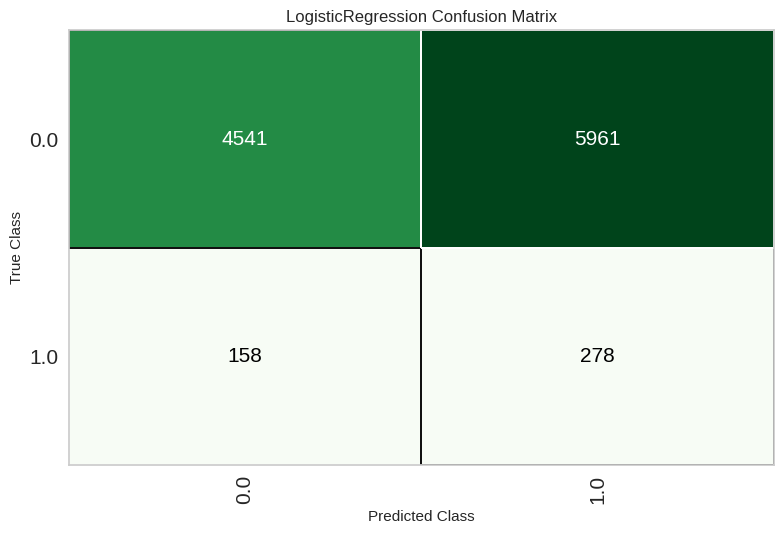

In [ ]:
lr = create_model('lr')

tuned_lr, tuner = tune_model(lr,optimize = 'eer',return_tuner=True,choose_better = True)

print(lr)
print(tuned_lr)

plot_model(tuned_lr,plot = 'confusion_matrix')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.6476,0.5145,0.4069,0.0469,0.0841,0.0138,0.0265,0.4742
1,0.6769,0.6291,0.5517,0.0671,0.1196,0.0524,0.0974,0.3966
2,0.6039,0.5282,0.4414,0.0448,0.0814,0.0099,0.0208,0.4777
3,0.6177,0.4731,0.3517,0.0377,0.0682,-0.0039,-0.0079,0.5077
4,0.5900,0.4777,0.4110,0.0408,0.0743,0.0016,0.0034,0.4965
5,0.6179,0.5611,0.4589,0.0485,0.0878,0.0165,0.0337,0.4642
6,0.5211,0.4976,0.4110,0.0349,0.0643,-0.0103,-0.0249,0.5284
7,0.5879,0.5427,0.4483,0.0437,0.0797,0.0077,0.0167,0.4817
8,0.4979,0.5119,0.5034,0.0399,0.0739,0.0002,0.0005,0.4994


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.5853,0.5129,0.4069,0.0397,0.0724,-0.0001,-0.0002,0.5002
1,0.5974,0.5309,0.4759,0.0472,0.0859,0.0146,0.0312,0.4653
2,0.5968,0.5228,0.4759,0.0472,0.0858,0.0145,0.0310,0.4655
3,0.5839,0.4571,0.3862,0.0377,0.0688,-0.0040,-0.0086,0.5090
4,0.5551,0.5016,0.3973,0.0364,0.0667,-0.0071,-0.0162,0.5176
5,0.6083,0.5024,0.4384,0.0454,0.0823,0.0104,0.0217,0.4772
6,0.5444,0.5236,0.5411,0.0472,0.0869,0.0143,0.0337,0.4573
7,0.6044,0.5381,0.4897,0.0493,0.0896,0.0187,0.0395,0.4559
8,0.5621,0.5879,0.5586,0.0502,0.0922,0.0207,0.0476,0.4398


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 10 candidates, totalling 100 fits


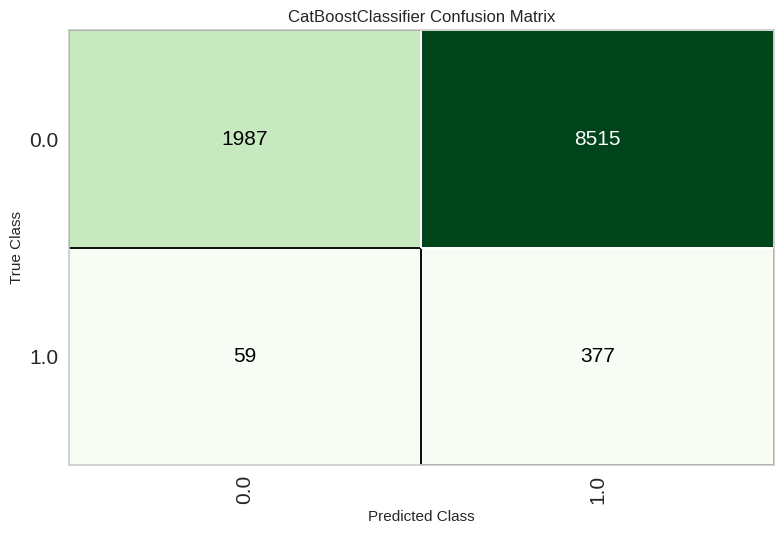

In [ ]:
cb = create_model('catboost')

tuned_cb, tuner = tune_model(cb,optimize = 'eer',return_tuner=True,choose_better = True)

print(cb)
print(tuned_cb)

plot_model(tuned_cb,plot = 'confusion_matrix')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.6146,0.5242,0.4621,0.0481,0.0871,0.0162,0.0334,0.4642
1,0.6421,0.5725,0.4345,0.0490,0.0881,0.0178,0.0348,0.4650
2,0.5842,0.5288,0.4897,0.0469,0.0856,0.0141,0.0308,0.4646
3,0.5529,0.4727,0.4345,0.0391,0.0718,-0.0013,-0.0030,0.5034
4,0.6009,0.5036,0.3630,0.0375,0.0679,-0.0051,-0.0105,0.5105
5,0.5976,0.5140,0.4589,0.0460,0.0837,0.0118,0.0250,0.4728
6,0.5370,0.4395,0.3562,0.0316,0.0580,-0.0168,-0.0391,0.5418
7,0.5874,0.5574,0.4483,0.0437,0.0796,0.0076,0.0165,0.4819
8,0.5682,0.4956,0.4276,0.0399,0.0730,0.0003,0.0006,0.4993


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.3437,0.5422,0.7793,0.0457,0.0863,0.0121,0.0439,0.4639
1,0.3061,0.5037,0.7448,0.0415,0.0787,0.0036,0.0142,0.4888
2,0.2957,0.5647,0.7448,0.0409,0.0776,0.0024,0.0096,0.4925
3,0.3086,0.5265,0.7517,0.0420,0.0796,0.0046,0.0181,0.4857
4,0.2863,0.4642,0.6301,0.0348,0.0660,-0.0107,-0.0429,0.5360
5,0.2817,0.5505,0.8219,0.0442,0.0839,0.0086,0.0364,0.4741
6,0.2669,0.4436,0.7055,0.0377,0.0716,-0.0048,-0.0208,0.5158
7,0.3150,0.5709,0.7862,0.0442,0.0837,0.0090,0.0351,0.4726
8,0.3059,0.5553,0.8000,0.0443,0.0840,0.0093,0.0371,0.4718


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 10 candidates, totalling 100 fits


Original model was better than the tuned model, hence it will be returned. NOTE: The display metrics are for the tuned model (not the original one).
XGBClassifier(base_score=None, booster='gbtree', callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, device='cpu', early_stopping_rounds=None,
              enable_categorical=False, eval_metric=None, feature_types=None,
              gamma=None, grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=None, max_bin=None,
              max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=None, max_leaves=None,
              min_child_weight=None, missing=nan, monotone_constraints=None,
              multi_strategy=None, n_estimators=None, n_jobs=-1,
              num_parallel_tree=None, objective='binary:logistic', ...)
XGBClassifier(base_score=None, booster='gbtree', callbacks=None,
              c

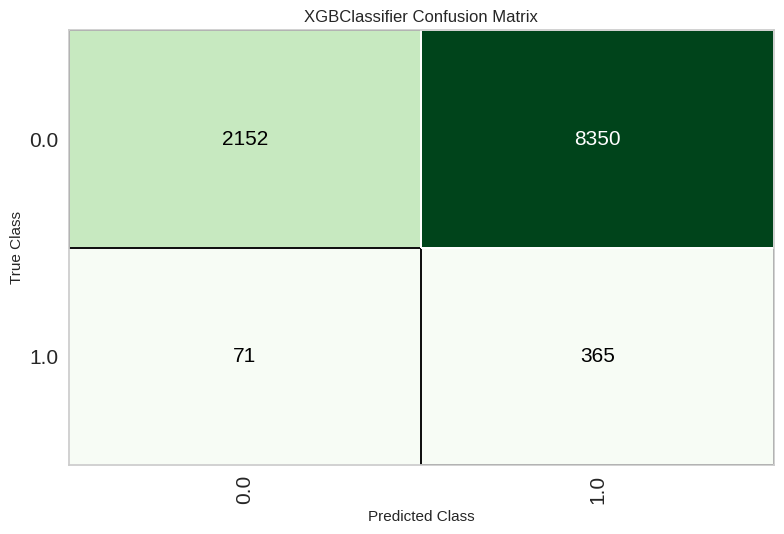

In [ ]:
xgboost = create_model('xgboost')

tuned_xgboost, tuner = tune_model(xgboost,optimize = 'eer',return_tuner=True,choose_better = True)

print(xgboost)
print(tuned_xgboost)

plot_model(tuned_xgboost,plot = 'confusion_matrix')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.6415,0.5316,0.4414,0.0496,0.0892,0.0191,0.0373,0.4623
1,0.6514,0.5523,0.4345,0.0503,0.0902,0.0204,0.0390,0.4613
2,0.6495,0.5580,0.4552,0.0522,0.0936,0.0240,0.0463,0.4531
3,0.5653,0.4686,0.3931,0.0367,0.0671,-0.0061,-0.0136,0.5146
4,0.5754,0.4695,0.4041,0.0388,0.0708,-0.0024,-0.0053,0.5057
5,0.6061,0.5428,0.4658,0.0477,0.0865,0.0150,0.0312,0.4661
6,0.5088,0.4734,0.4384,0.0361,0.0667,-0.0079,-0.0196,0.5233
7,0.5783,0.5524,0.4483,0.0427,0.0780,0.0058,0.0127,0.4859
8,0.5196,0.4899,0.4552,0.0380,0.0701,-0.0036,-0.0088,0.5106


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.6092,0.5327,0.4207,0.0435,0.0789,0.0073,0.0151,0.4843
1,0.6207,0.5054,0.3310,0.0360,0.0649,-0.0074,-0.0147,0.5139
2,0.6423,0.5690,0.4690,0.0525,0.0944,0.0247,0.0484,0.4498
3,0.5244,0.4447,0.3586,0.0307,0.0566,-0.0180,-0.0431,0.5469
4,0.6720,0.4919,0.3219,0.0411,0.0729,0.0020,0.0036,0.4969
5,0.5900,0.5440,0.4589,0.0452,0.0823,0.0101,0.0217,0.4761
6,0.5093,0.5764,0.6781,0.0538,0.0996,0.0275,0.0707,0.4233
7,0.5514,0.5321,0.5034,0.0446,0.0820,0.0096,0.0223,0.4729
8,0.4647,0.4990,0.5655,0.0416,0.0775,0.0037,0.0102,0.4882


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 10 candidates, totalling 100 fits


LGBMClassifier(boosting_type='gbdt', class_weight=None, colsample_bytree=1.0,
               importance_type='split', learning_rate=0.1, max_depth=-1,
               min_child_samples=20, min_child_weight=0.001, min_split_gain=0.0,
               n_estimators=100, n_jobs=-1, num_leaves=31, objective=None,
               random_state=7137, reg_alpha=0.0, reg_lambda=0.0, subsample=1.0,
               subsample_for_bin=200000, subsample_freq=0)
LGBMClassifier(bagging_fraction=0.6, bagging_freq=5, boosting_type='gbdt',
               class_weight=None, colsample_bytree=1.0, feature_fraction=0.4,
               importance_type='split', learning_rate=0.001, max_depth=-1,
               min_child_samples=76, min_child_weight=0.001, min_split_gain=0.9,
               n_estimators=270, n_jobs=-1, num_leaves=150, objective=None,
               random_state=7137, reg_alpha=3, reg_lambda=0.15, subsample=1.0,
               subsample_for_bin=200000, subsample_freq=0)


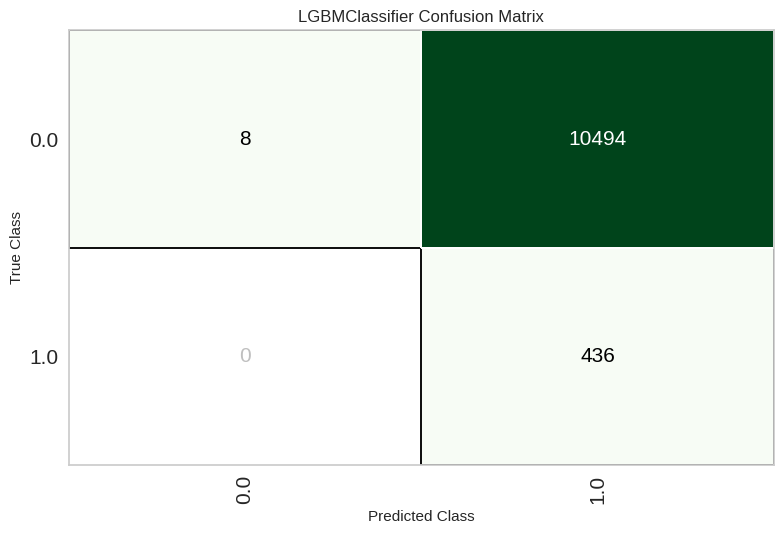

In [ ]:
lightgbm = create_model('lightgbm')

tuned_lightgbm, tuner = tune_model(lightgbm,optimize = 'eer',return_tuner=True,choose_better = True)

print(lightgbm)
print(tuned_lightgbm)

plot_model(tuned_lightgbm,plot = 'confusion_matrix')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.5757,0.5267,0.4414,0.0418,0.0764,0.0041,0.0090,0.4901
1,0.5943,0.4967,0.3931,0.0394,0.0716,-0.0008,-0.0017,0.5017
2,0.5378,0.5538,0.5517,0.0471,0.0867,0.0145,0.0349,0.4561
3,0.5123,0.4750,0.4621,0.0379,0.0701,-0.0037,-0.0092,0.5112
4,0.5826,0.5530,0.5205,0.0497,0.0908,0.0191,0.0420,0.4504
5,0.5433,0.5200,0.4521,0.0400,0.0735,-0.0001,-0.0003,0.5004
6,0.5274,0.5065,0.4384,0.0375,0.0692,-0.0050,-0.0120,0.5140
7,0.5391,0.5574,0.5172,0.0445,0.0820,0.0094,0.0224,0.4720
8,0.4922,0.4997,0.5172,0.0404,0.0750,0.0013,0.0033,0.4959


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.5883,0.5069,0.4414,0.0431,0.0786,0.0066,0.0142,0.4845
1,0.6166,0.5217,0.3931,0.0417,0.0754,0.0038,0.0076,0.4923
2,0.5337,0.5546,0.5724,0.0482,0.0890,0.0168,0.0409,0.4498
3,0.4984,0.4504,0.4207,0.0338,0.0625,-0.0120,-0.0304,0.5360
4,0.6135,0.5665,0.4658,0.0486,0.0880,0.0167,0.0345,0.4630
5,0.6050,0.5704,0.5274,0.0532,0.0966,0.0257,0.0544,0.4372
6,0.5082,0.5308,0.5411,0.0438,0.0810,0.0074,0.0188,0.4768
7,0.5791,0.5604,0.5034,0.0476,0.0869,0.0153,0.0339,0.4603
8,0.4650,0.4879,0.5172,0.0384,0.0714,-0.0029,-0.0078,0.5094


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 10 candidates, totalling 100 fits


AdaBoostClassifier(algorithm='SAMME.R', base_estimator='deprecated',
                   estimator=None, learning_rate=1.0, n_estimators=50,
                   random_state=7137)
AdaBoostClassifier(algorithm='SAMME.R', base_estimator='deprecated',
                   estimator=None, learning_rate=0.15, n_estimators=110,
                   random_state=7137)


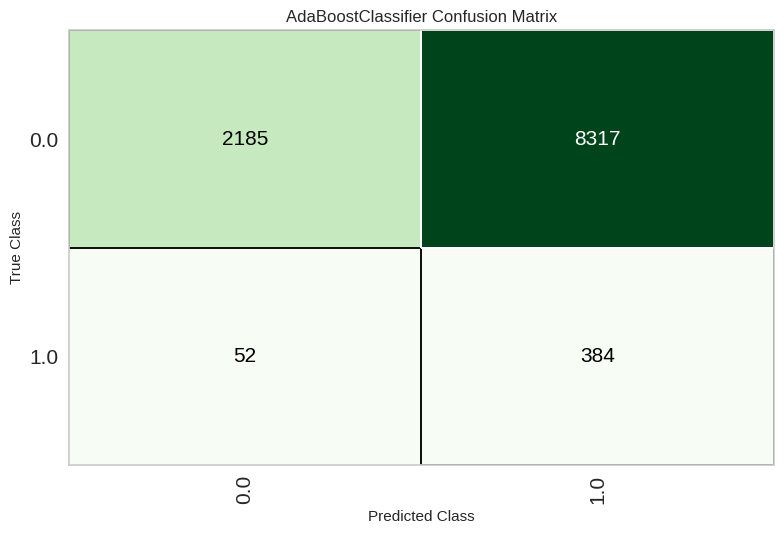

In [ ]:
adaboost = create_model('ada')

tuned_ada, tuner = tune_model(adaboost,optimize = 'eer',return_tuner=True,choose_better = True)

print(adaboost)
print(tuned_ada)

plot_model(tuned_ada,plot = 'confusion_matrix')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.7405,0.5079,0.2552,0.0423,0.0725,0.0046,0.0072,0.4947
1,0.4693,0.4790,0.4897,0.0367,0.0684,-0.0061,-0.0164,0.5205
2,0.8703,0.4994,0.0966,0.0393,0.0559,-0.0007,-0.0007,0.5003
3,0.2345,0.5155,0.8207,0.0413,0.0786,0.0031,0.0149,0.4904
4,0.5579,0.4908,0.4178,0.0384,0.0704,-0.0032,-0.0073,0.5081
5,0.1190,0.5116,0.9384,0.0410,0.0786,0.0020,0.0164,0.4937
6,0.9024,0.4766,0.0137,0.0093,0.0111,-0.0383,-0.0391,0.5122
7,0.9339,0.4962,0.0207,0.0294,0.0243,-0.0089,-0.0090,0.5019
8,0.6121,0.5270,0.4345,0.0452,0.0818,0.0105,0.0217,0.4773


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.8138,0.5242,0.2069,0.0505,0.0812,0.0184,0.0242,0.4860
1,0.6391,0.5842,0.4276,0.0479,0.0861,0.0157,0.0308,0.4691
2,0.2485,0.5138,0.7517,0.0387,0.0737,-0.0021,-0.0096,0.5068
3,0.4690,0.4314,0.3724,0.0284,0.0528,-0.0227,-0.0605,0.5702
4,0.6157,0.5485,0.4315,0.0456,0.0825,0.0109,0.0222,0.4770
5,0.3662,0.4944,0.6507,0.0403,0.0760,0.0006,0.0020,0.4981
6,0.2830,0.4532,0.6027,0.0333,0.0631,-0.0139,-0.0560,0.5478
7,0.5660,0.5166,0.4483,0.0415,0.0759,0.0034,0.0076,0.4915
8,0.7067,0.4369,0.1931,0.0286,0.0498,-0.0210,-0.0348,0.5257


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 10 candidates, totalling 100 fits


Original model was better than the tuned model, hence it will be returned. NOTE: The display metrics are for the tuned model (not the original one).
QuadraticDiscriminantAnalysis(priors=None, reg_param=0.0,
                              store_covariance=False, tol=0.0001)
QuadraticDiscriminantAnalysis(priors=None, reg_param=0.0,
                              store_covariance=False, tol=0.0001)


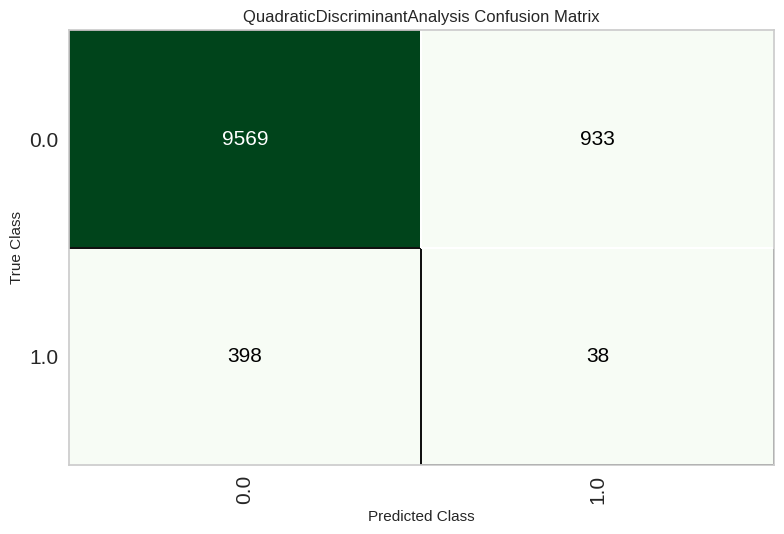

In [ ]:
qda = create_model('qda')

tuned_qda, tuner = tune_model(qda,optimize = 'eer',return_tuner=True,choose_better = True)

print(qda)
print(tuned_qda)

plot_model(tuned_qda,plot = 'confusion_matrix')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.5716,0.5155,0.3862,0.0366,0.0669,-0.0062,-0.0137,0.5145
1,0.6248,0.5599,0.4552,0.0487,0.0880,0.0174,0.0352,0.4630
2,0.5666,0.5116,0.4621,0.0427,0.0782,0.0058,0.0130,0.4851
3,0.5645,0.4520,0.3724,0.0348,0.0637,-0.0098,-0.0218,0.5230
4,0.5464,0.4659,0.3973,0.0357,0.0655,-0.0086,-0.0198,0.5217
5,0.5472,0.5130,0.4110,0.0369,0.0678,-0.0062,-0.0143,0.5158
6,0.5184,0.4870,0.4795,0.0400,0.0738,-0.0001,-0.0002,0.5003
7,0.5481,0.5224,0.4690,0.0415,0.0763,0.0034,0.0080,0.4906
8,0.4634,0.4571,0.4690,0.0349,0.0650,-0.0098,-0.0266,0.5337


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.5529,0.5308,0.4759,0.0425,0.0781,0.0054,0.0126,0.4852
1,0.6393,0.5228,0.3172,0.0365,0.0654,-0.0064,-0.0124,0.5113
2,0.5815,0.5544,0.5379,0.0507,0.0927,0.0216,0.0480,0.4420
3,0.5176,0.4030,0.3172,0.0270,0.0497,-0.0255,-0.0615,0.5649
4,0.6264,0.5826,0.5137,0.0549,0.0992,0.0289,0.0587,0.4352
5,0.5960,0.5179,0.4041,0.0408,0.0742,0.0015,0.0033,0.4966
6,0.5137,0.4672,0.4315,0.0359,0.0664,-0.0082,-0.0202,0.5236
7,0.5432,0.5567,0.5379,0.0465,0.0857,0.0134,0.0319,0.4595
8,0.4947,0.4916,0.5379,0.0421,0.0781,0.0046,0.0120,0.4853


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 10 candidates, totalling 100 fits


Original model was better than the tuned model, hence it will be returned. NOTE: The display metrics are for the tuned model (not the original one).
GradientBoostingClassifier(ccp_alpha=0.0, criterion='friedman_mse', init=None,
                           learning_rate=0.1, loss='log_loss', max_depth=3,
                           max_features=None, max_leaf_nodes=None,
                           min_impurity_decrease=0.0, min_samples_leaf=1,
                           min_samples_split=2, min_weight_fraction_leaf=0.0,
                           n_estimators=100, n_iter_no_change=None,
                           random_state=7137, subsample=1.0, tol=0.0001,
                           validation_fraction=0.1, verbose=0,
                           warm_start=False)
GradientBoostingClassifier(ccp_alpha=0.0, criterion='friedman_mse', init=None,
                           learning_rate=0.1, loss='log_loss', max_depth=3,
                           max_features=None, max_leaf_nodes=None,
      

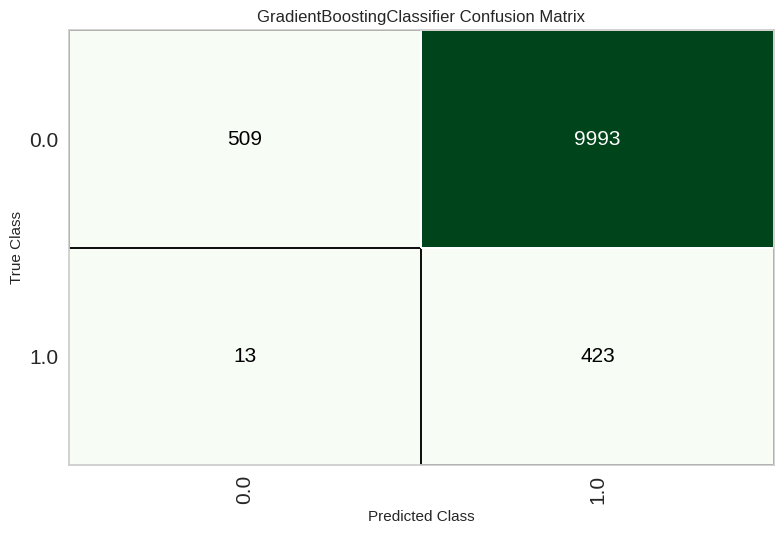

In [ ]:
gbc = create_model('gbc')

tuned_gbc, tuner = tune_model(gbc,optimize = 'eer',return_tuner=True,choose_better = True)

print(gbc)
print(tuned_gbc)

plot_model(tuned_gbc,plot = 'confusion_matrix')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.6799,0.5359,0.3793,0.0486,0.0861,0.0168,0.0303,0.4727
1,0.6676,0.5670,0.4483,0.0543,0.0969,0.0279,0.0520,0.4491
2,0.6481,0.5781,0.4552,0.0520,0.0933,0.0236,0.0456,0.4537
3,0.6319,0.3948,0.2759,0.0313,0.0563,-0.0163,-0.0317,0.5283
4,0.6097,0.4813,0.3699,0.0390,0.0705,-0.0021,-0.0042,0.5042
5,0.6119,0.4078,0.2945,0.0317,0.0573,-0.0162,-0.0326,0.5302
6,0.5532,0.4303,0.3630,0.0334,0.0611,-0.0132,-0.0300,0.5317
7,0.5877,0.5361,0.4828,0.0467,0.0852,0.0137,0.0297,0.4663
8,0.5512,0.5169,0.4621,0.0412,0.0757,0.0029,0.0067,0.4923


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.6311,0.4822,0.3655,0.0406,0.0731,0.0016,0.0031,0.4970
1,0.6681,0.4969,0.2759,0.0349,0.0620,-0.0092,-0.0167,0.5141
2,0.6185,0.5203,0.4138,0.0439,0.0794,0.0081,0.0165,0.4832
3,0.5579,0.4562,0.3793,0.0349,0.0639,-0.0097,-0.0219,0.5234
4,0.5894,0.4478,0.3562,0.0357,0.0650,-0.0084,-0.0179,0.5180
5,0.6207,0.5006,0.4041,0.0435,0.0786,0.0068,0.0137,0.4862
6,0.5557,0.5093,0.4315,0.0394,0.0722,-0.0013,-0.0030,0.5034
7,0.5745,0.5385,0.4897,0.0459,0.0839,0.0120,0.0268,0.4689
8,0.5868,0.4850,0.3103,0.0310,0.0564,-0.0172,-0.0365,0.5355


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 10 candidates, totalling 100 fits


Original model was better than the tuned model, hence it will be returned. NOTE: The display metrics are for the tuned model (not the original one).
RandomForestClassifier(bootstrap=True, ccp_alpha=0.0, class_weight=None,
                       criterion='gini', max_depth=None, max_features='sqrt',
                       max_leaf_nodes=None, max_samples=None,
                       min_impurity_decrease=0.0, min_samples_leaf=1,
                       min_samples_split=2, min_weight_fraction_leaf=0.0,
                       n_estimators=100, n_jobs=-1, oob_score=False,
                       random_state=7137, verbose=0, warm_start=False)
RandomForestClassifier(bootstrap=True, ccp_alpha=0.0, class_weight=None,
                       criterion='gini', max_depth=None, max_features='sqrt',
                       max_leaf_nodes=None, max_samples=None,
                       min_impurity_decrease=0.0, min_samples_leaf=1,
                       min_samples_split=2, min_weight_fraction_leaf=0.

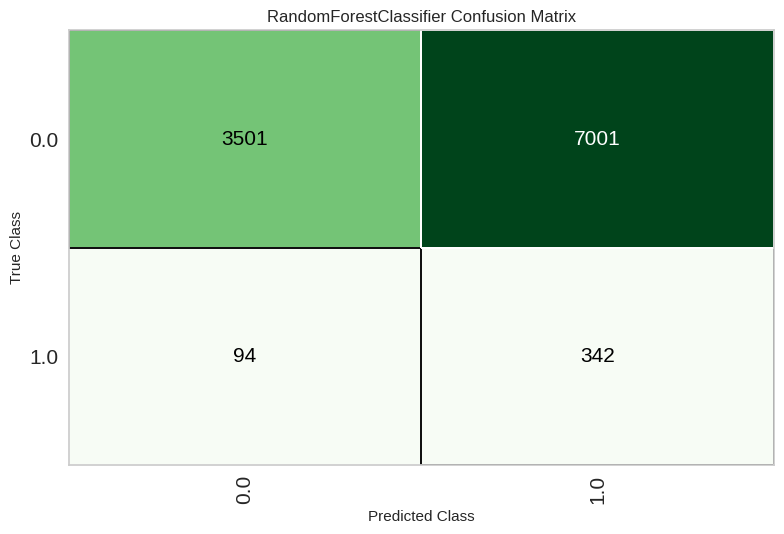

In [ ]:
rf = create_model('rf')

tuned_rf, tuner = tune_model(rf,optimize = 'eer',return_tuner=True,choose_better = True)

print(rf)
print(tuned_rf)

plot_model(tuned_rf,plot = 'confusion_matrix')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.6594,0.5660,0.4276,0.0508,0.0908,0.0212,0.0400,0.4611
1,0.6681,0.4808,0.2966,0.0374,0.0664,-0.0046,-0.0084,0.5072
2,0.6413,0.5069,0.3517,0.0403,0.0723,0.0011,0.0020,0.4981
3,0.5543,0.4182,0.3103,0.0287,0.0525,-0.0219,-0.0494,0.5499
4,0.5943,0.4358,0.3836,0.0388,0.0704,-0.0025,-0.0053,0.5055
5,0.6045,0.4535,0.3630,0.0378,0.0685,-0.0044,-0.0090,0.5090
6,0.5628,0.4205,0.3219,0.0305,0.0557,-0.0189,-0.0418,0.5421
7,0.6049,0.5095,0.4621,0.0469,0.0851,0.0139,0.0292,0.4683
8,0.5805,0.5408,0.5379,0.0506,0.0926,0.0214,0.0476,0.4424


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.6465,0.5275,0.3793,0.0439,0.0786,0.0079,0.0152,0.4856
1,0.6810,0.5551,0.4138,0.0527,0.0935,0.0247,0.0447,0.4586
2,0.6755,0.5282,0.4000,0.0503,0.0893,0.0201,0.0365,0.4662
3,0.5727,0.4428,0.2966,0.0287,0.0523,-0.0218,-0.0474,0.5463
4,0.5905,0.5260,0.4589,0.0452,0.0824,0.0102,0.0219,0.4759
5,0.5848,0.4986,0.4041,0.0397,0.0723,-0.0007,-0.0014,0.5015
6,0.6020,0.4472,0.3630,0.0376,0.0681,-0.0049,-0.0101,0.5100
7,0.6346,0.5460,0.4069,0.0452,0.0814,0.0105,0.0207,0.4794
8,0.5353,0.5114,0.4759,0.0409,0.0753,0.0022,0.0053,0.4936


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 10 candidates, totalling 100 fits


ExtraTreesClassifier(bootstrap=False, ccp_alpha=0.0, class_weight=None,
                     criterion='gini', max_depth=None, max_features='sqrt',
                     max_leaf_nodes=None, max_samples=None,
                     min_impurity_decrease=0.0, min_samples_leaf=1,
                     min_samples_split=2, min_weight_fraction_leaf=0.0,
                     n_estimators=100, n_jobs=-1, oob_score=False,
                     random_state=7137, verbose=0, warm_start=False)
ExtraTreesClassifier(bootstrap=True, ccp_alpha=0.0, class_weight={},
                     criterion='gini', max_depth=11, max_features='sqrt',
                     max_leaf_nodes=None, max_samples=None,
                     min_impurity_decrease=0, min_samples_leaf=4,
                     min_samples_split=9, min_weight_fraction_leaf=0.0,
                     n_estimators=250, n_jobs=-1, oob_score=False,
                     random_state=7137, verbose=0, warm_start=False)


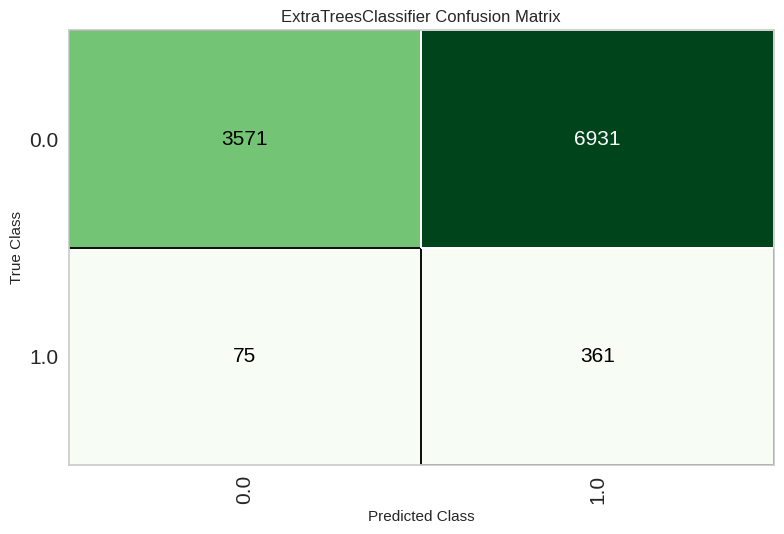

In [ ]:
et = create_model('et')

tuned_et, tuner = tune_model(et,optimize = 'eer',return_tuner=True,choose_better = True)

print(et)
print(tuned_et)

plot_model(tuned_et,plot = 'confusion_matrix')


,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.0680,0.4655,0.9517,0.0391,0.0751,-0.0014,-0.0187,0.5044
1,0.0532,0.5680,1.0000,0.0403,0.0775,0.0011,0.0238,0.4965
2,0.6961,0.5143,0.2966,0.0410,0.0720,0.0023,0.0040,0.4967
3,0.0551,0.4739,1.0000,0.0404,0.0776,0.0013,0.0254,0.4960
4,0.8097,0.4922,0.1781,0.0433,0.0697,0.0057,0.0074,0.4958
5,0.0516,0.5179,0.9932,0.0403,0.0774,0.0004,0.0098,0.4986
6,0.0628,0.4680,0.9589,0.0394,0.0757,-0.0013,-0.0193,0.5041
7,0.9479,0.4878,0.0414,0.1053,0.0594,0.0378,0.0422,0.4931
8,0.8192,0.4674,0.1517,0.0394,0.0626,-0.0006,-0.0008,0.5004


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.7935,0.4858,0.1448,0.0323,0.0528,-0.0131,-0.0178,0.5104
1,0.8173,0.4512,0.1862,0.0470,0.0750,0.0123,0.0159,0.4910
2,0.7208,0.4960,0.2276,0.0351,0.0609,-0.0086,-0.0139,0.5103
3,0.3198,0.4652,0.6414,0.0369,0.0698,-0.0059,-0.0221,0.5195
4,0.1550,0.4834,0.8493,0.0390,0.0745,-0.0023,-0.0145,0.5072
5,0.4180,0.5189,0.6027,0.0409,0.0766,0.0017,0.0052,0.4945
6,0.7076,0.4180,0.2397,0.0354,0.0616,-0.0088,-0.0146,0.5111
7,0.0897,0.4721,0.9655,0.0405,0.0778,0.0016,0.0166,0.4950
8,0.8154,0.5492,0.1793,0.0448,0.0717,0.0086,0.0112,0.4937


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 10 candidates, totalling 100 fits


Original model was better than the tuned model, hence it will be returned. NOTE: The display metrics are for the tuned model (not the original one).
GaussianNB(priors=None, var_smoothing=1e-09)
GaussianNB(priors=None, var_smoothing=1e-09)


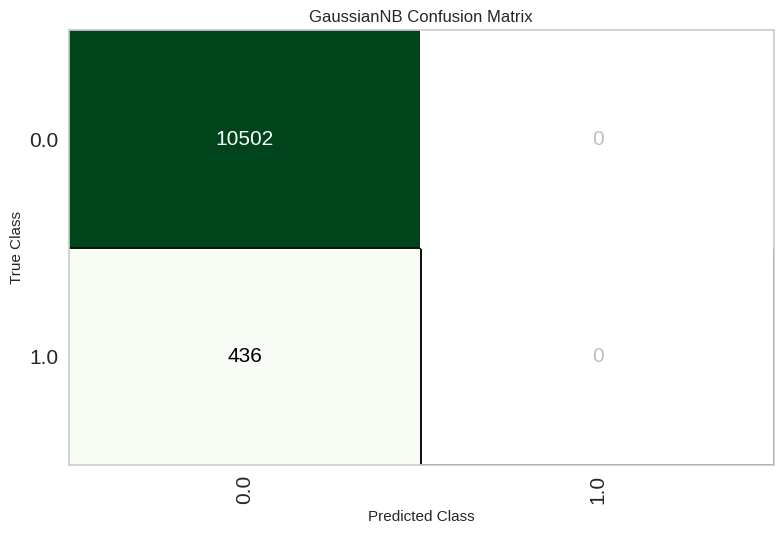

In [ ]:
nb = create_model('nb')

tuned_nb, tuner = tune_model(nb,optimize = 'eer',return_tuner=True,choose_better = True)

print(nb)
print(tuned_nb)

plot_model(tuned_nb,plot = 'confusion_matrix')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.5529,0.5167,0.4828,0.0431,0.0791,0.0066,0.0152,0.4820
1,0.5225,0.4928,0.4828,0.0403,0.0744,0.0011,0.0027,0.4967
2,0.5447,0.4634,0.4345,0.0384,0.0705,-0.0027,-0.0064,0.5073
3,0.5540,0.5304,0.4414,0.0398,0.0730,0.0000,0.0000,0.5000
4,0.5417,0.5402,0.5205,0.0453,0.0834,0.0105,0.0248,0.4691
5,0.5431,0.5274,0.4726,0.0416,0.0765,0.0031,0.0073,0.4913
6,0.4819,0.4794,0.4384,0.0342,0.0635,-0.0117,-0.0306,0.5373
7,0.5322,0.4930,0.4621,0.0396,0.0729,-0.0005,-0.0011,0.5013
8,0.5136,0.4727,0.4345,0.0359,0.0664,-0.0077,-0.0190,0.5225


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.5417,0.5118,0.4621,0.0404,0.0742,0.0012,0.0028,0.4967
1,0.5647,0.5284,0.4621,0.0425,0.0779,0.0054,0.0122,0.4860
2,0.5587,0.5176,0.5172,0.0465,0.0853,0.0133,0.0306,0.4628
3,0.5403,0.4816,0.3793,0.0335,0.0616,-0.0124,-0.0290,0.5316
4,0.5636,0.5589,0.5411,0.0493,0.0903,0.0183,0.0417,0.4484
5,0.5924,0.4832,0.4315,0.0430,0.0782,0.0057,0.0123,0.4869
6,0.5549,0.4668,0.3699,0.0341,0.0624,-0.0118,-0.0267,0.5283
7,0.5813,0.4990,0.4345,0.0418,0.0763,0.0040,0.0087,0.4905
8,0.5358,0.4772,0.4414,0.0382,0.0703,-0.0031,-0.0074,0.5086


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 10 candidates, totalling 100 fits


KNeighborsClassifier(algorithm='auto', leaf_size=30, metric='minkowski',
                     metric_params=None, n_jobs=-1, n_neighbors=5, p=2,
                     weights='uniform')
KNeighborsClassifier(algorithm='auto', leaf_size=30, metric='manhattan',
                     metric_params=None, n_jobs=-1, n_neighbors=37, p=2,
                     weights='uniform')


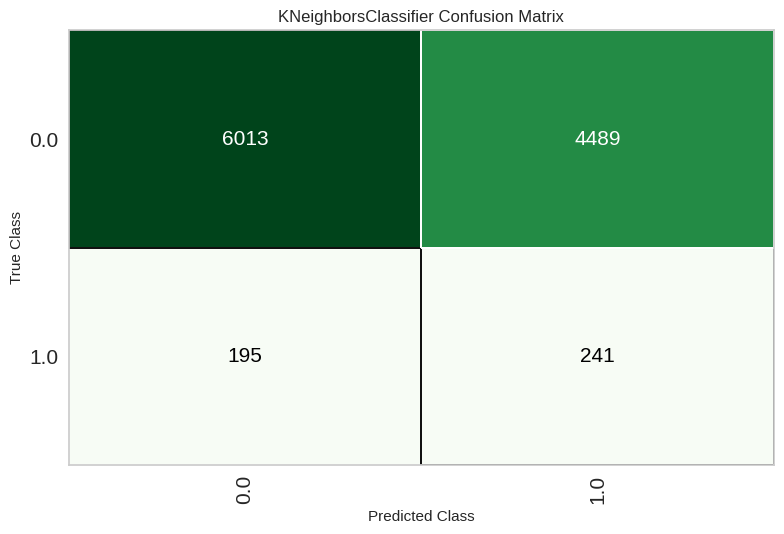

In [ ]:
knn = create_model('knn')

tuned_knn, tuner = tune_model(knn,optimize = 'eer',return_tuner=True,choose_better = True)

print(knn)
print(tuned_knn)

plot_model(tuned_knn,plot = 'confusion_matrix')

## SVM SMOTE

In [ ]:
import imblearn
from imblearn.over_sampling import SVMSMOTE
svm = SVMSMOTE(random_state=0)
svmsmote = setup(df,test_data = test_data, target = 'STATUS',normalize = True,ignore_features = ['ID'],fix_imbalance = True,fix_imbalance_method = svm,index=False)
add_metric('eer', 'eer', calculate_eer,greater_is_better=False)

,Description,Value
0,Session id,5916
1,Target,STATUS
2,Target type,Binary
3,Original data shape,"(47395, 52)"
4,Transformed data shape,"(80946, 51)"
5,Transformed train set shape,"(70008, 51)"
6,Transformed test set shape,"(10938, 51)"
7,Ignore features,1
8,Numeric features,50
9,Rows with missing values,23.1%


Name                                                               eer
Display Name                                                       eer
Score Function       <pycaret.internal.metrics.EncodedDecodedLabels...
Scorer               make_scorer(calculate_eer, greater_is_better=F...
Target                                                            pred
Args                                                                {}
Greater is Better                                                False
Multiclass                                                        True
Custom                                                            True
Name: eer, dtype: object

In [ ]:
best = compare_models(sort='eer')

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer,TT (Sec)
svm,SVM - Linear Kernel,0.7184,0.0000,0.2836,0.0439,0.0756,0.0072,0.0100,0.4932,8.3530
lr,Logistic Regression,0.7304,0.5052,0.2663,0.0422,0.0726,0.0044,0.0071,0.4936,8.3270
lda,Linear Discriminant Analysis,0.7211,0.5041,0.2767,0.0428,0.0739,0.0054,0.0078,0.4942,7.8830
catboost,CatBoost Classifier,0.9387,0.5018,0.0414,0.0716,0.0478,0.0198,0.0221,0.4953,50.0660
ridge,Ridge Classifier,0.7206,0.0000,0.2718,0.0420,0.0727,0.0039,0.0055,0.4959,7.0510
xgboost,Extreme Gradient Boosting,0.9387,0.5085,0.0338,0.0537,0.0391,0.0109,0.0115,0.4973,9.7580
ada,Ada Boost Classifier,0.8532,0.5035,0.1218,0.0436,0.0635,0.0049,0.0048,0.4984,10.0340
qda,Quadratic Discriminant Analysis,0.0410,0.5006,1.0000,0.0399,0.0767,0.0001,0.0053,0.4997,7.2230
dummy,Dummy Classifier,0.9601,0.5000,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000,7.0910
lightgbm,Light Gradient Boosting Machine,0.9484,0.5104,0.0124,0.0600,0.0200,0.0014,0.0049,0.5001,10.2640


Processing:   0%|          | 0/69 [00:00<?, ?it/s]

In [ ]:
evaluate_model(best)

interactive(children=(ToggleButtons(description='Plot Type:', icons=('',), options=(('Pipeline Plot', 'pipelin…

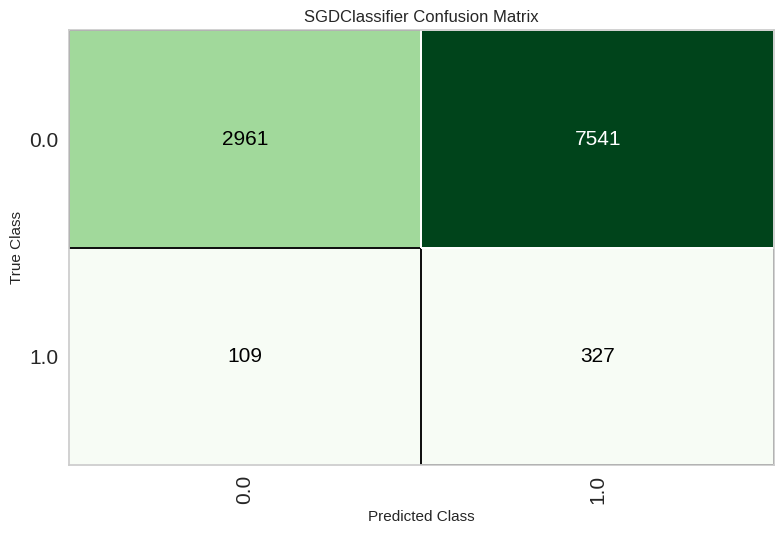

In [ ]:
plot_model(best,plot = 'confusion_matrix')

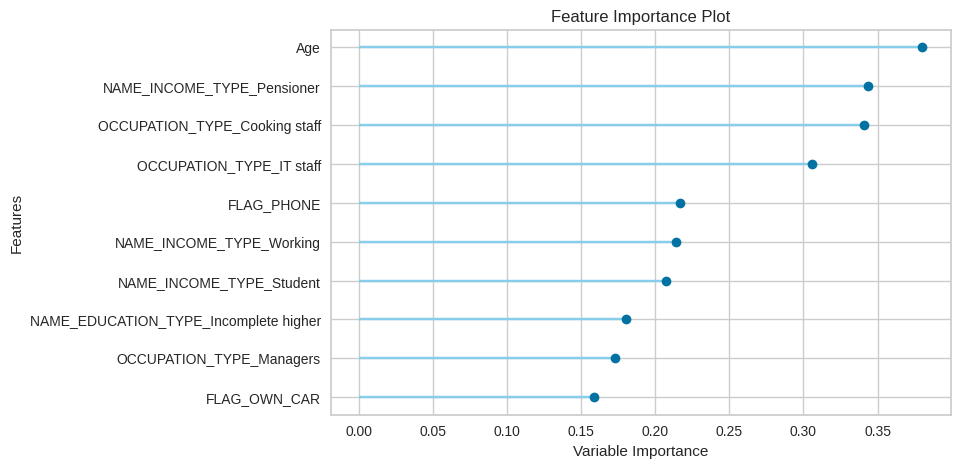

In [ ]:
plot_model(best,plot = 'feature')

### Models Confusion Matrix after SVM SMOTE

In [ ]:
dt = create_model('dt')
rf = create_model('rf')
et = create_model('et')
catboost = create_model('catboost')
knn = create_model('knn')
lightgbm = create_model('lightgbm')
qda = create_model('qda')
lda = create_model('lda')
gbc = create_model('gbc')
xgboost = create_model('xgboost')
nb = create_model('nb')
lr = create_model('lr')
ridge = create_model('ridge')
ada = create_model('ada')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.8886,0.4969,0.0828,0.0421,0.0558,0.0033,0.0035,0.4987
1,0.8557,0.4892,0.1034,0.0365,0.0540,-0.0051,-0.0060,0.5027
2,0.8585,0.5172,0.0966,0.0351,0.0515,-0.0073,-0.0084,0.5037
3,0.8116,0.4195,0.0276,0.0073,0.0115,-0.0549,-0.0701,0.5353
4,0.8253,0.4385,0.0411,0.0119,0.0185,-0.0465,-0.0574,0.5278
5,0.8275,0.4499,0.0411,0.0121,0.0187,-0.0460,-0.0564,0.5271
6,0.7872,0.4304,0.0548,0.0124,0.0202,-0.0483,-0.0655,0.5362
7,0.8255,0.5150,0.0897,0.0251,0.0393,-0.0244,-0.0304,0.5154
8,0.8296,0.5195,0.1310,0.0370,0.0577,-0.0047,-0.0058,0.5030


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9377,0.4430,0.0414,0.0638,0.0502,0.0195,0.0200,0.4958
1,0.9246,0.4257,0.0483,0.0486,0.0484,0.0092,0.0092,0.4976
2,0.9240,0.3815,0.0828,0.0769,0.0797,0.0402,0.0402,0.4889
3,0.8653,0.2035,0.0138,0.0057,0.0081,-0.0510,-0.0568,0.5227
4,0.8799,0.2421,0.0205,0.0101,0.0135,-0.0425,-0.0456,0.5168
5,0.8796,0.2352,0.0479,0.0228,0.0309,-0.0247,-0.0267,0.5101
6,0.8645,0.2802,0.0548,0.0220,0.0314,-0.0274,-0.0307,0.5127
7,0.8796,0.3682,0.0621,0.0288,0.0394,-0.0158,-0.0171,0.5066
8,0.8883,0.4478,0.0966,0.0483,0.0644,0.0120,0.0128,0.4952


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9344,0.4200,0.0483,0.0648,0.0553,0.0221,0.0224,0.4949
1,0.9213,0.3898,0.0483,0.0449,0.0465,0.0055,0.0055,0.4985
2,0.9169,0.3032,0.0828,0.0659,0.0734,0.0305,0.0307,0.4908
3,0.8620,0.1544,0.0138,0.0055,0.0079,-0.0518,-0.0582,0.5236
4,0.8769,0.1633,0.0205,0.0097,0.0132,-0.0436,-0.0471,0.5177
5,0.8758,0.1937,0.0342,0.0158,0.0216,-0.0352,-0.0382,0.5146
6,0.8623,0.1863,0.0548,0.0215,0.0309,-0.0283,-0.0319,0.5134
7,0.8752,0.3205,0.0621,0.0274,0.0381,-0.0181,-0.0199,0.5079
8,0.8779,0.4152,0.1103,0.0482,0.0671,0.0124,0.0136,0.4944


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9553,0.5525,0.0276,0.1538,0.0468,0.0351,0.0495,0.4946
1,0.9454,0.5549,0.0276,0.0645,0.0386,0.0152,0.0167,0.4972
2,0.9509,0.4794,0.0207,0.0750,0.0324,0.0155,0.0190,0.4974
3,0.9347,0.4401,0.0207,0.0303,0.0246,-0.0079,-0.0081,0.5017
4,0.9454,0.4335,0.0137,0.0351,0.0197,-0.0028,-0.0032,0.5005
5,0.9358,0.4975,0.0000,0.0000,0.0000,-0.0311,-0.0321,0.5064
6,0.9205,0.4202,0.0068,0.0068,0.0068,-0.0346,-0.0346,0.5089
7,0.9342,0.5262,0.0828,0.1008,0.0909,0.0571,0.0574,0.4862
8,0.9246,0.5371,0.0621,0.0608,0.0614,0.0221,0.0221,0.4941


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.8642,0.5013,0.1172,0.0443,0.0643,0.0069,0.0079,0.4965
1,0.8590,0.4553,0.0828,0.0305,0.0446,-0.0143,-0.0164,0.5072
2,0.8626,0.4808,0.1103,0.0412,0.0600,0.0023,0.0026,0.4989
3,0.8352,0.4169,0.0276,0.0086,0.0131,-0.0505,-0.0609,0.5282
4,0.8225,0.4150,0.0411,0.0117,0.0182,-0.0471,-0.0585,0.5286
5,0.8204,0.4618,0.0548,0.0152,0.0238,-0.0414,-0.0519,0.5258
6,0.8012,0.4295,0.0890,0.0215,0.0346,-0.0320,-0.0422,0.5230
7,0.8102,0.5126,0.1103,0.0276,0.0442,-0.0207,-0.0270,0.5146
8,0.8233,0.5279,0.1517,0.0405,0.0640,0.0012,0.0016,0.4992


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9523,0.5295,0.0069,0.0323,0.0114,-0.0027,-0.0036,0.5004
1,0.9520,0.5546,0.0207,0.0833,0.0331,0.0176,0.0223,0.4971
2,0.9526,0.5250,0.0276,0.1111,0.0442,0.0288,0.0365,0.4953
3,0.9427,0.4283,0.0069,0.0152,0.0095,-0.0158,-0.0171,0.5030
4,0.9520,0.4569,0.0068,0.0323,0.0113,-0.0028,-0.0037,0.5004
5,0.9438,0.5227,0.0000,0.0000,0.0000,-0.0236,-0.0262,0.5043
6,0.9419,0.3900,0.0000,0.0000,0.0000,-0.0256,-0.0277,0.5048
7,0.9462,0.5174,0.0207,0.0526,0.0297,0.0074,0.0083,0.4987
8,0.9443,0.5168,0.0276,0.0606,0.0379,0.0134,0.0145,0.4975


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.0428,0.5016,1.0000,0.0399,0.0767,0.0003,0.0112,0.4992
1,0.0400,0.5001,1.0000,0.0398,0.0765,0.0000,0.0034,0.4999
2,0.0398,0.5000,1.0000,0.0398,0.0765,0.0000,0.0000,0.5000
3,0.0436,0.5020,1.0000,0.0399,0.0768,0.0003,0.0126,0.4990
4,0.0422,0.5011,1.0000,0.0401,0.0772,0.0002,0.0096,0.4994
5,0.0403,0.5001,1.0000,0.0401,0.0770,0.0000,0.0034,0.4999
6,0.0406,0.5003,1.0000,0.0401,0.0770,0.0000,0.0048,0.4999
7,0.0398,0.5000,1.0000,0.0398,0.0765,0.0000,0.0000,0.5000
8,0.0398,0.5000,1.0000,0.0398,0.0765,0.0000,0.0000,0.5000


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.7112,0.5192,0.3448,0.0496,0.0867,0.0185,0.0311,0.4742
1,0.7293,0.4799,0.1931,0.0312,0.0537,-0.0159,-0.0251,0.5178
2,0.6670,0.4655,0.3034,0.0380,0.0676,-0.0033,-0.0061,0.5052
3,0.6651,0.4742,0.2966,0.0370,0.0658,-0.0053,-0.0097,0.5083
4,0.7307,0.5179,0.3767,0.0581,0.1007,0.0337,0.0546,0.4554
5,0.7592,0.5994,0.2740,0.0493,0.0835,0.0168,0.0252,0.4823
6,0.6777,0.4599,0.2877,0.0377,0.0667,-0.0044,-0.0078,0.5065
7,0.6919,0.5632,0.4069,0.0538,0.0951,0.0267,0.0471,0.4574
8,0.6985,0.4810,0.3103,0.0431,0.0757,0.0063,0.0108,0.4911


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9449,0.4947,0.0138,0.0333,0.0195,-0.0039,-0.0043,0.5007
1,0.9427,0.4833,0.0069,0.0152,0.0095,-0.0158,-0.0171,0.5030
2,0.9243,0.4242,0.0276,0.0288,0.0282,-0.0112,-0.0112,0.5028
3,0.9314,0.4803,0.0138,0.0183,0.0157,-0.0190,-0.0192,0.5043
4,0.9402,0.4242,0.0274,0.0500,0.0354,0.0073,0.0076,0.4985
5,0.9443,0.4815,0.0068,0.0169,0.0098,-0.0136,-0.0151,0.5025
6,0.9424,0.4151,0.0000,0.0000,0.0000,-0.0250,-0.0273,0.5046
7,0.9435,0.5584,0.0276,0.0580,0.0374,0.0120,0.0129,0.4977
8,0.9438,0.4859,0.0069,0.0161,0.0097,-0.0145,-0.0159,0.5027


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9531,0.5719,0.0276,0.1176,0.0447,0.0300,0.0387,0.4952
1,0.9408,0.5845,0.0207,0.0390,0.0270,-0.0006,-0.0006,0.5001
2,0.9520,0.4708,0.0207,0.0833,0.0331,0.0176,0.0223,0.4971
3,0.9344,0.4331,0.0138,0.0204,0.0165,-0.0161,-0.0165,0.5035
4,0.9408,0.4644,0.0068,0.0139,0.0092,-0.0177,-0.0189,0.5034
5,0.9312,0.5197,0.0137,0.0183,0.0157,-0.0192,-0.0194,0.5043
6,0.9213,0.4182,0.0274,0.0268,0.0271,-0.0139,-0.0139,0.5036
7,0.9273,0.5120,0.0690,0.0714,0.0702,0.0324,0.0324,0.4916
8,0.9284,0.5565,0.0552,0.0606,0.0578,0.0206,0.0207,0.4948


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.1615,0.4879,0.8828,0.0404,0.0773,0.0013,0.0084,0.4959
1,0.1349,0.4778,0.8138,0.0364,0.0696,-0.0071,-0.0496,0.5233
2,0.1089,0.4562,0.8897,0.0384,0.0736,-0.0029,-0.0246,0.5093
3,0.1303,0.4760,0.9241,0.0407,0.0779,0.0019,0.0143,0.4941
4,0.1506,0.4944,0.9041,0.0411,0.0785,0.0021,0.0141,0.4935
5,0.1489,0.5571,0.9384,0.0424,0.0811,0.0049,0.0336,0.4851
6,0.1157,0.3751,0.7877,0.0348,0.0666,-0.0110,-0.0842,0.5367
7,0.1322,0.5481,0.9172,0.0405,0.0776,0.0015,0.0111,0.4953
8,0.1531,0.4843,0.8759,0.0397,0.0760,-0.0001,-0.0006,0.5003


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.7084,0.5178,0.3379,0.0482,0.0844,0.0159,0.0269,0.4777
1,0.7167,0.4814,0.2069,0.0316,0.0549,-0.0151,-0.0246,0.5181
2,0.6662,0.4656,0.3241,0.0403,0.0717,0.0010,0.0019,0.4983
3,0.6604,0.4735,0.2897,0.0357,0.0635,-0.0078,-0.0144,0.5125
4,0.7287,0.5195,0.3699,0.0568,0.0985,0.0312,0.0507,0.4587
5,0.7521,0.5981,0.2877,0.0499,0.0850,0.0180,0.0275,0.4801
6,0.6703,0.4585,0.2877,0.0368,0.0653,-0.0061,-0.0110,0.5093
7,0.6903,0.5635,0.4069,0.0535,0.0946,0.0262,0.0463,0.4580
8,0.6925,0.4814,0.3103,0.0422,0.0743,0.0046,0.0080,0.4933


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.7112,0.0000,0.3448,0.0496,0.0867,0.0185,0.0311,0.4742
1,0.7293,0.0000,0.1931,0.0312,0.0537,-0.0159,-0.0251,0.5178
2,0.6670,0.0000,0.3034,0.0380,0.0676,-0.0033,-0.0061,0.5052
3,0.6651,0.0000,0.2966,0.0370,0.0658,-0.0053,-0.0097,0.5083
4,0.7307,0.0000,0.3767,0.0581,0.1007,0.0337,0.0546,0.4554
5,0.7592,0.0000,0.2740,0.0493,0.0835,0.0168,0.0252,0.4823
6,0.6777,0.0000,0.2877,0.0377,0.0667,-0.0044,-0.0078,0.5065
7,0.6919,0.0000,0.4069,0.0538,0.0951,0.0267,0.0471,0.4574
8,0.6985,0.0000,0.3103,0.0431,0.0757,0.0063,0.0108,0.4911


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.8571,0.5154,0.1448,0.0502,0.0746,0.0165,0.0193,0.4910
1,0.8626,0.4865,0.1379,0.0505,0.0739,0.0167,0.0192,0.4913
2,0.8206,0.4637,0.1103,0.0296,0.0466,-0.0172,-0.0218,0.5114
3,0.8420,0.5214,0.1103,0.0346,0.0526,-0.0085,-0.0102,0.5049
4,0.8483,0.4575,0.1575,0.0508,0.0768,0.0173,0.0206,0.4899
5,0.8736,0.5126,0.0959,0.0408,0.0573,0.0011,0.0013,0.4995
6,0.8519,0.4464,0.1301,0.0440,0.0657,0.0063,0.0074,0.4965
7,0.8582,0.5945,0.1655,0.0571,0.0850,0.0274,0.0321,0.4848
8,0.8535,0.5006,0.1379,0.0466,0.0697,0.0109,0.0128,0.4940


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

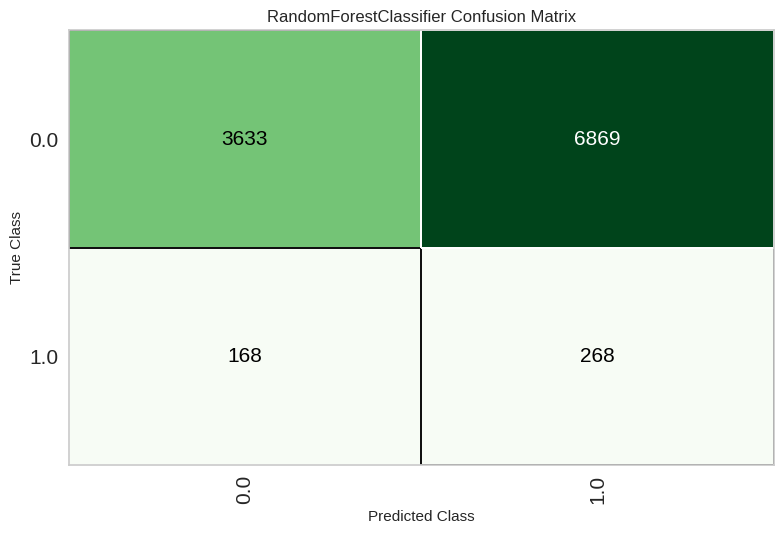

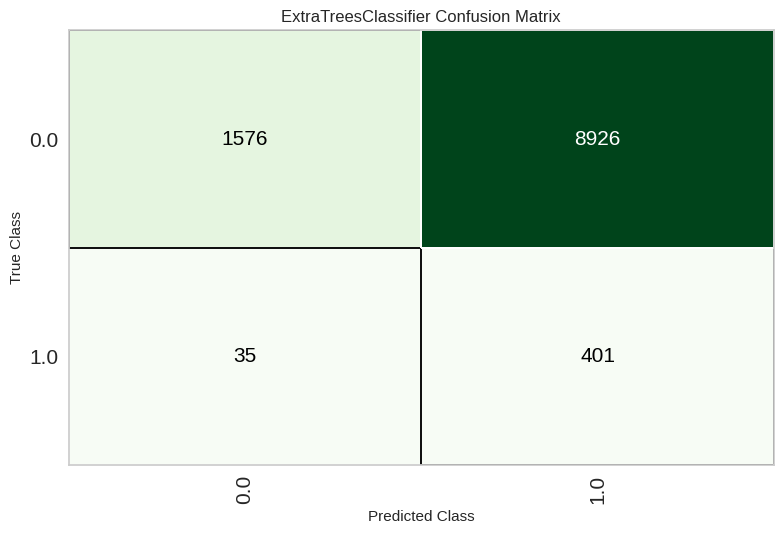

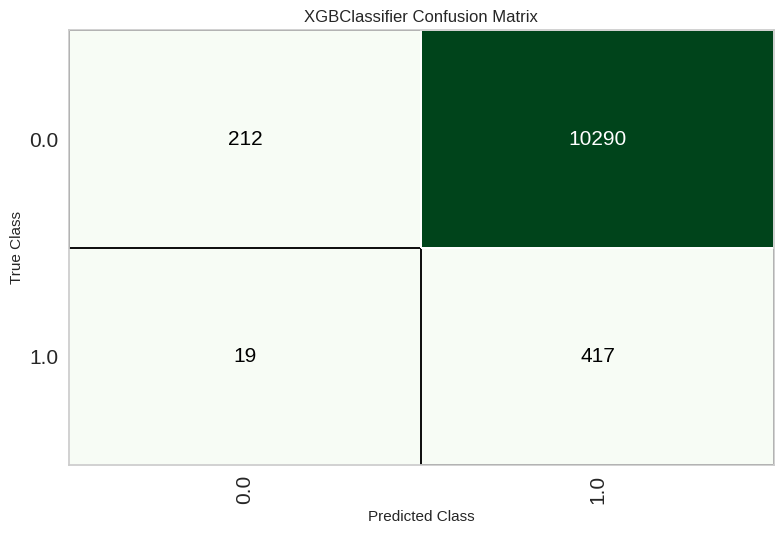

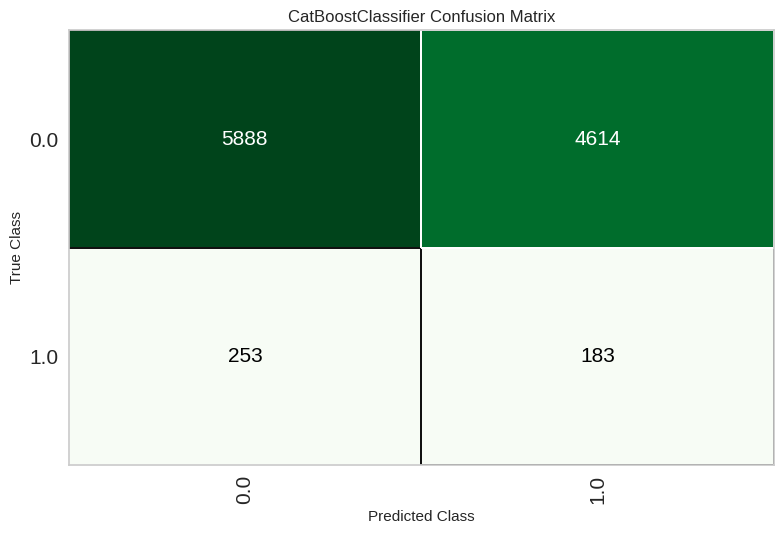

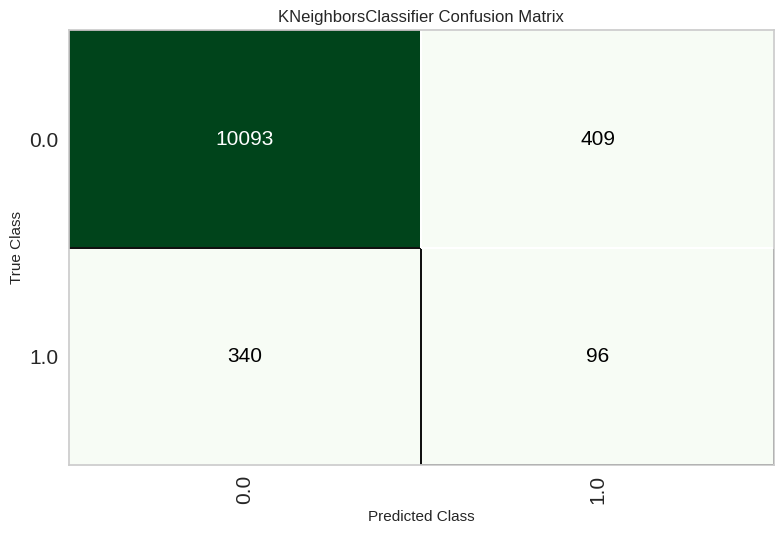

...

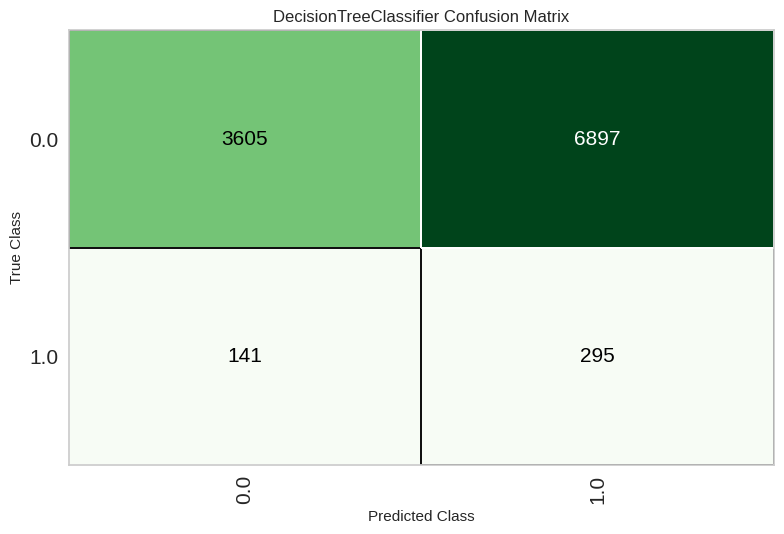

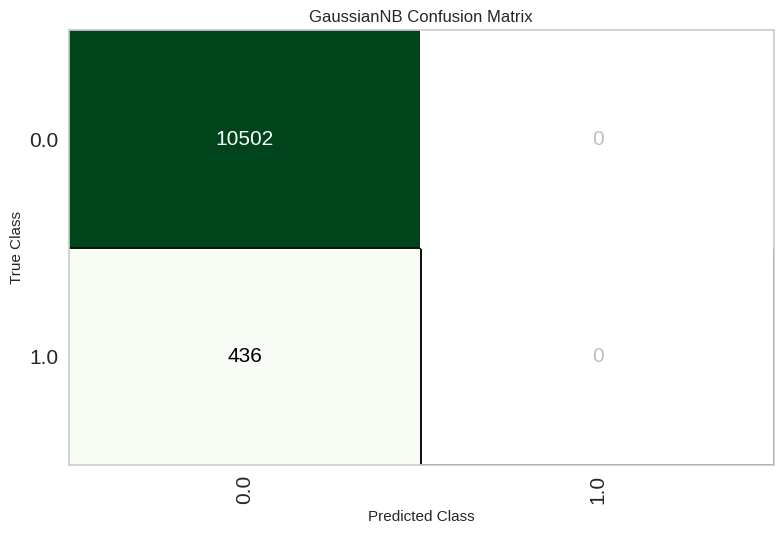

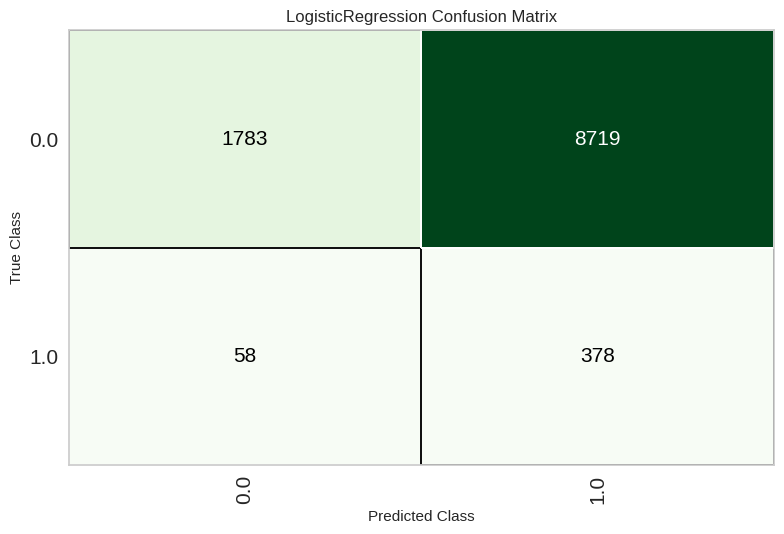

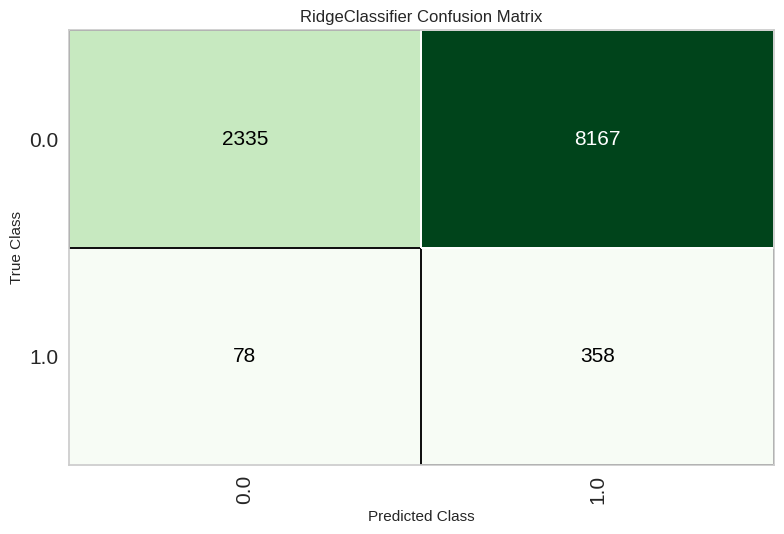

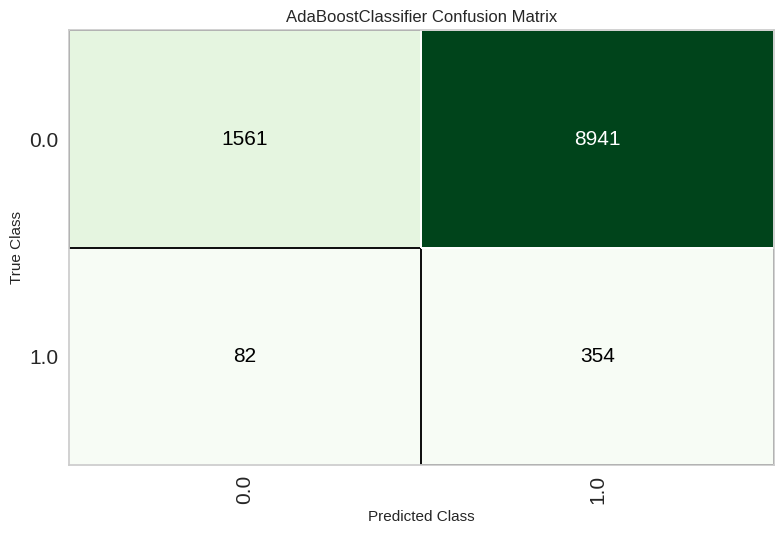

In [ ]:
plot_model(rf,plot = 'confusion_matrix')
plot_model(et,plot = 'confusion_matrix')
plot_model(xgboost,plot = 'confusion_matrix')
plot_model(catboost,plot = 'confusion_matrix')
plot_model(knn,plot = 'confusion_matrix')
plot_model(lightgbm,plot = 'confusion_matrix')
plot_model(qda,plot = 'confusion_matrix')
plot_model(lda,plot = 'confusion_matrix')
plot_model(gbc,plot = 'confusion_matrix')
plot_model(dt,plot = 'confusion_matrix')
plot_model(nb,plot = 'confusion_matrix')
plot_model(lr,plot = 'confusion_matrix')
plot_model(ridge,plot = 'confusion_matrix')
plot_model(ada,plot = 'confusion_matrix')

### Tune with SVM Smote

In [ ]:
nb = create_model('nb')

tuned_nb, tuner = tune_model(nb,optimize = 'eer',return_tuner=True,choose_better = True,n_iter = 50)

print(nb)
print(tuned_nb)


plot_model(tuned_nb,plot = 'confusion_matrix')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.6794,0.0000,0.3379,0.0437,0.0773,0.0074,0.0133,0.4884
1,0.8066,0.0000,0.1793,0.0425,0.0687,0.0047,0.0062,0.4964
2,0.6635,0.0000,0.3310,0.0407,0.0726,0.0019,0.0035,0.4969
3,0.6613,0.0000,0.2552,0.0318,0.0565,-0.0153,-0.0280,0.5235
4,0.7378,0.0000,0.3288,0.0530,0.0913,0.0239,0.0379,0.4707
5,0.7046,0.0000,0.3904,0.0545,0.0957,0.0274,0.0469,0.4593
6,0.6415,0.0000,0.3151,0.0367,0.0658,-0.0064,-0.0123,0.5111
7,0.7353,0.0000,0.2897,0.0465,0.0801,0.0124,0.0196,0.4852
8,0.7040,0.0000,0.2552,0.0367,0.0642,-0.0058,-0.0097,0.5076


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.7098,0.0000,0.4414,0.0615,0.1079,0.0410,0.0702,0.4366
1,0.7309,0.0000,0.2000,0.0324,0.0558,-0.0135,-0.0214,0.5152
2,0.6777,0.0000,0.4000,0.0506,0.0899,0.0207,0.0376,0.4654
3,0.5263,0.0000,0.4069,0.0347,0.0640,-0.0101,-0.0242,0.5275
4,0.6317,0.0000,0.3973,0.0442,0.0795,0.0080,0.0158,0.4845
5,0.6103,0.0000,0.5274,0.0539,0.0978,0.0271,0.0567,0.4351
6,0.6975,0.0000,0.2123,0.0304,0.0532,-0.0181,-0.0306,0.5232
7,0.7737,0.0000,0.2414,0.0467,0.0782,0.0124,0.0179,0.4881
8,0.6700,0.0000,0.4207,0.0517,0.0921,0.0228,0.0422,0.4599


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 50 candidates, totalling 500 fits


SGDClassifier(alpha=0.0001, average=False, class_weight=None,
              early_stopping=False, epsilon=0.1, eta0=0.001, fit_intercept=True,
              l1_ratio=0.15, learning_rate='optimal', loss='hinge',
              max_iter=1000, n_iter_no_change=5, n_jobs=-1, penalty='l2',
              power_t=0.5, random_state=529, shuffle=True, tol=0.001,
              validation_fraction=0.1, verbose=0, warm_start=False)
SGDClassifier(alpha=0.0001, average=False, class_weight=None,
              early_stopping=False, epsilon=0.1, eta0=0.05, fit_intercept=True,
              l1_ratio=0.6500000001, learning_rate='constant', loss='hinge',
              max_iter=1000, n_iter_no_change=5, n_jobs=-1,
              penalty='elasticnet', power_t=0.5, random_state=529, shuffle=True,
              tol=0.001, validation_fraction=0.1, verbose=0, warm_start=False)


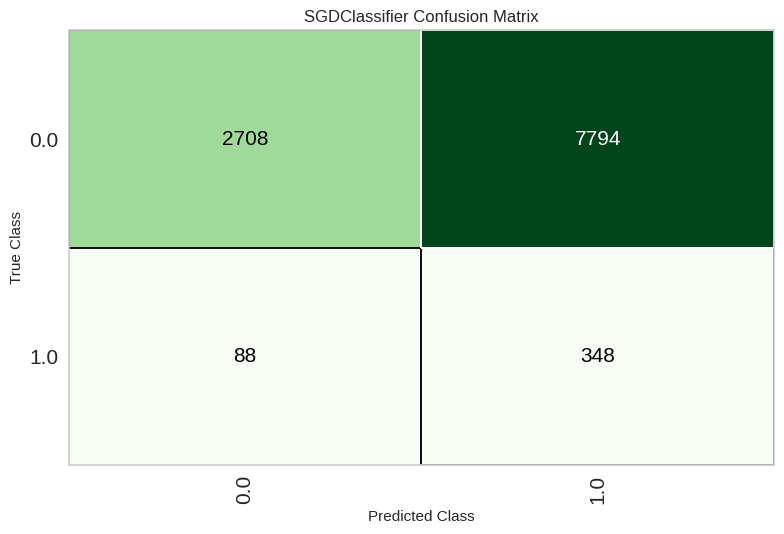

In [ ]:
svm = create_model('svm')

tuned_svm, tuner = tune_model(svm,optimize = 'eer',return_tuner=True,choose_better = True,n_iter = 50)

print(svm)
print(tuned_svm)


plot_model(tuned_svm,plot = 'confusion_matrix')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.8856,0.5009,0.0759,0.0374,0.0501,-0.0033,-0.0036,0.5013
1,0.8692,0.5236,0.1103,0.0440,0.0629,0.0063,0.0071,0.4969
2,0.8662,0.4944,0.0966,0.0377,0.0543,-0.0031,-0.0035,0.5015
3,0.8072,0.4164,0.0345,0.0088,0.0140,-0.0527,-0.0681,0.5350
4,0.8324,0.4370,0.0342,0.0105,0.0161,-0.0481,-0.0583,0.5273
5,0.8297,0.4464,0.0411,0.0123,0.0190,-0.0455,-0.0555,0.5264
6,0.8094,0.4400,0.0685,0.0176,0.0280,-0.0382,-0.0493,0.5257
7,0.8195,0.5122,0.0897,0.0241,0.0380,-0.0263,-0.0334,0.5172
8,0.8244,0.5257,0.1448,0.0391,0.0616,-0.0011,-0.0014,0.5008


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.6777,0.4834,0.3310,0.0426,0.0755,0.0054,0.0098,0.4915
1,0.6212,0.5673,0.5172,0.0541,0.0980,0.0280,0.0575,0.4356
2,0.6761,0.5107,0.3448,0.0440,0.0781,0.0081,0.0146,0.4871
3,0.6358,0.5062,0.3655,0.0411,0.0739,0.0026,0.0051,0.4951
4,0.6078,0.3782,0.2055,0.0223,0.0403,-0.0345,-0.0691,0.5599
5,0.4534,0.5144,0.5822,0.0421,0.0786,0.0042,0.0119,0.4867
6,0.6791,0.4786,0.2603,0.0345,0.0610,-0.0104,-0.0184,0.5150
7,0.4749,0.4823,0.5172,0.0391,0.0727,-0.0014,-0.0038,0.5046
8,0.6771,0.5701,0.4690,0.0582,0.1036,0.0353,0.0648,0.4364


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 10 candidates, totalling 100 fits


DecisionTreeClassifier(ccp_alpha=0.0, class_weight=None, criterion='gini',
                       max_depth=None, max_features=None, max_leaf_nodes=None,
                       min_impurity_decrease=0.0, min_samples_leaf=1,
                       min_samples_split=2, min_weight_fraction_leaf=0.0,
                       random_state=1744, splitter='best')
DecisionTreeClassifier(ccp_alpha=0.0, class_weight=None, criterion='entropy',
                       max_depth=2, max_features='sqrt', max_leaf_nodes=None,
                       min_impurity_decrease=0.001, min_samples_leaf=5,
                       min_samples_split=9, min_weight_fraction_leaf=0.0,
                       random_state=1744, splitter='best')


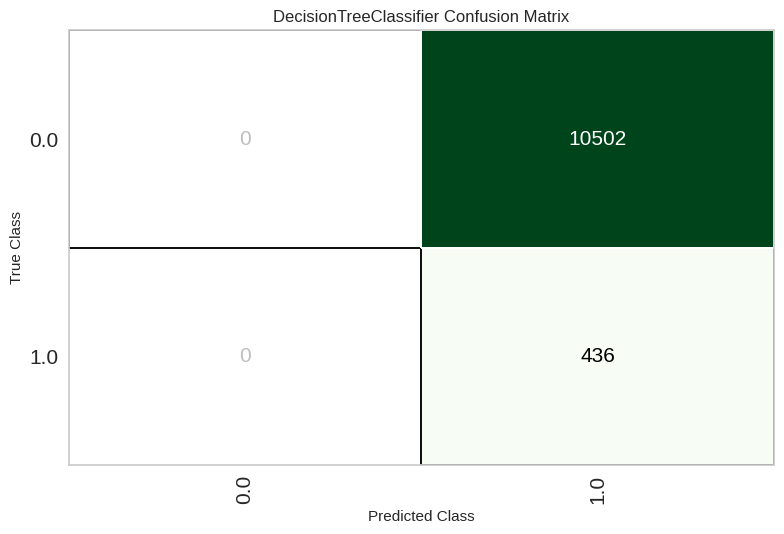

In [ ]:
dt = create_model('dt')

tuned_dt, tuner = tune_model(dt,optimize = 'eer',return_tuner=True,choose_better = True)

print(dt)
print(tuned_dt)

plot_model(tuned_dt,plot = 'confusion_matrix')


,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.7403,0.0000,0.2897,0.0474,0.0815,0.0141,0.0221,0.4835
1,0.7855,0.0000,0.1655,0.0350,0.0578,-0.0084,-0.0116,0.5071
2,0.6898,0.0000,0.2414,0.0331,0.0583,-0.0125,-0.0216,0.5171
3,0.6445,0.0000,0.3103,0.0363,0.0649,-0.0068,-0.0129,0.5116
4,0.7702,0.0000,0.3425,0.0631,0.1066,0.0418,0.0620,0.4549
5,0.7894,0.0000,0.2466,0.0519,0.0857,0.0209,0.0293,0.4813
6,0.7397,0.0000,0.2192,0.0369,0.0632,-0.0058,-0.0089,0.5063
7,0.7509,0.0000,0.3103,0.0528,0.0902,0.0238,0.0367,0.4728
8,0.6853,0.0000,0.3379,0.0445,0.0787,0.0091,0.0160,0.4862


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.7477,0.0000,0.2552,0.0436,0.0744,0.0070,0.0107,0.4923
1,0.8173,0.0000,0.1241,0.0323,0.0513,-0.0126,-0.0162,0.5087
2,0.6846,0.0000,0.2621,0.0352,0.0620,-0.0088,-0.0153,0.5124
3,0.6613,0.0000,0.2897,0.0358,0.0637,-0.0077,-0.0141,0.5121
4,0.7307,0.0000,0.3767,0.0581,0.1007,0.0337,0.0546,0.4554
5,0.7968,0.0000,0.2397,0.0526,0.0863,0.0221,0.0303,0.4811
6,0.7079,0.0000,0.2534,0.0373,0.0650,-0.0052,-0.0087,0.5067
7,0.7070,0.0000,0.4069,0.0567,0.0995,0.0319,0.0547,0.4519
8,0.7133,0.0000,0.2483,0.0370,0.0645,-0.0051,-0.0085,0.5065


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 10 candidates, totalling 100 fits


Original model was better than the tuned model, hence it will be returned. NOTE: The display metrics are for the tuned model (not the original one).
RidgeClassifier(alpha=1.0, class_weight=None, copy_X=True, fit_intercept=True,
                max_iter=None, positive=False, random_state=1744, solver='auto',
                tol=0.0001)
RidgeClassifier(alpha=1.0, class_weight=None, copy_X=True, fit_intercept=True,
                max_iter=None, positive=False, random_state=1744, solver='auto',
                tol=0.0001)


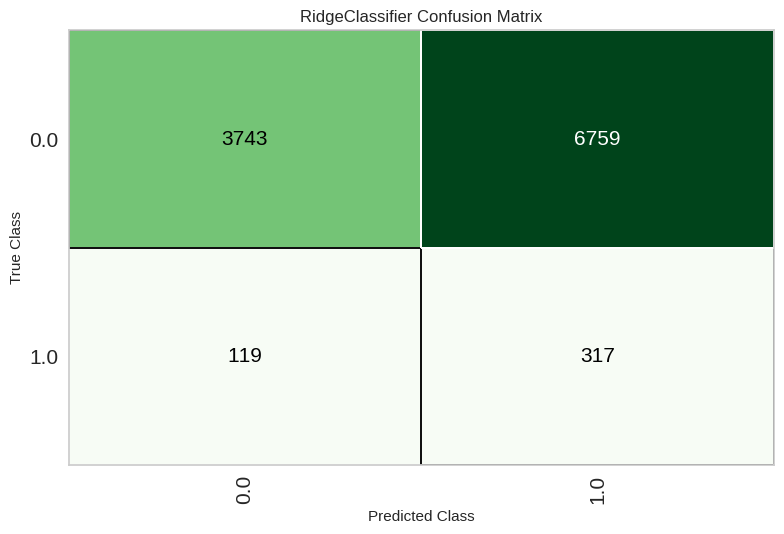

In [ ]:
ridge = create_model('ridge')

tuned_ridge, tuner = tune_model(ridge,optimize = 'eer',return_tuner=True,choose_better = True)

print(ridge)
print(tuned_ridge)

plot_model(tuned_ridge,plot = 'confusion_matrix')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.7112,0.5192,0.3448,0.0496,0.0867,0.0185,0.0311,0.4742
1,0.7293,0.4799,0.1931,0.0312,0.0537,-0.0159,-0.0251,0.5178
2,0.6670,0.4655,0.3034,0.0380,0.0676,-0.0033,-0.0061,0.5052
3,0.6651,0.4742,0.2966,0.0370,0.0658,-0.0053,-0.0097,0.5083
4,0.7307,0.5179,0.3767,0.0581,0.1007,0.0337,0.0546,0.4554
5,0.7592,0.5994,0.2740,0.0493,0.0835,0.0168,0.0252,0.4823
6,0.6777,0.4599,0.2877,0.0377,0.0667,-0.0044,-0.0078,0.5065
7,0.6919,0.5632,0.4069,0.0538,0.0951,0.0267,0.0471,0.4574
8,0.6985,0.4810,0.3103,0.0431,0.0757,0.0063,0.0108,0.4911


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.7175,0.5192,0.3448,0.0508,0.0885,0.0206,0.0342,0.4720
1,0.7293,0.4804,0.1931,0.0312,0.0537,-0.0159,-0.0251,0.5178
2,0.6739,0.4655,0.3310,0.0421,0.0747,0.0045,0.0081,0.4930
3,0.6646,0.4739,0.2966,0.0369,0.0657,-0.0054,-0.0099,0.5085
4,0.7312,0.5176,0.3767,0.0583,0.1009,0.0339,0.0549,0.4552
5,0.7603,0.5996,0.2740,0.0495,0.0839,0.0172,0.0257,0.4819
6,0.6755,0.4591,0.2877,0.0375,0.0663,-0.0049,-0.0088,0.5073
7,0.6933,0.5642,0.4069,0.0541,0.0955,0.0271,0.0478,0.4568
8,0.6947,0.4803,0.3103,0.0425,0.0748,0.0052,0.0090,0.4925


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 10 candidates, totalling 100 fits


LinearDiscriminantAnalysis(covariance_estimator=None, n_components=None,
                           priors=None, shrinkage=None, solver='svd',
                           store_covariance=False, tol=0.0001)
LinearDiscriminantAnalysis(covariance_estimator=None, n_components=None,
                           priors=None, shrinkage=0.005, solver='eigen',
                           store_covariance=False, tol=0.0001)


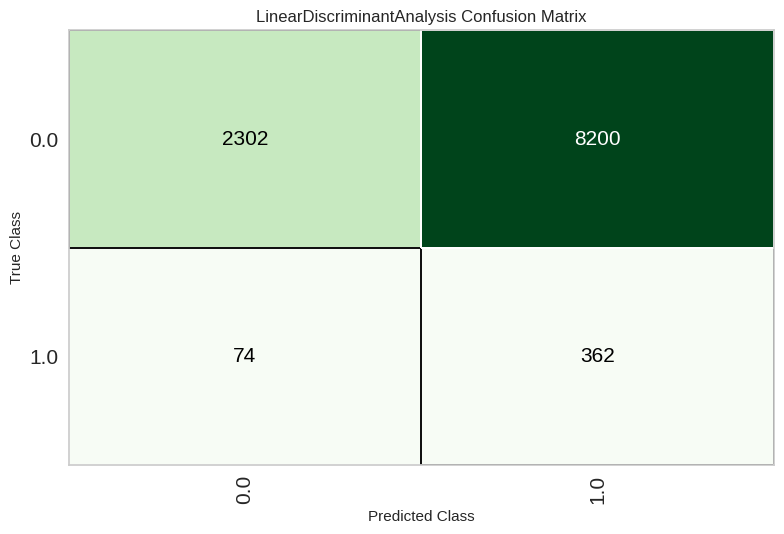

In [ ]:
lda = create_model('lda')

tuned_lda, tuner = tune_model(lda,optimize = 'eer',return_tuner=True,choose_better = True)

print(lda)
print(tuned_lda)

plot_model(tuned_lda,plot = 'confusion_matrix')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.7471,0.5106,0.2552,0.0435,0.0743,0.0068,0.0105,0.4925
1,0.7482,0.4983,0.1862,0.0326,0.0556,-0.0130,-0.0197,0.5133
2,0.6700,0.4683,0.3103,0.0392,0.0696,-0.0011,-0.0020,0.5017
3,0.6610,0.4794,0.2897,0.0357,0.0636,-0.0077,-0.0142,0.5122
4,0.7630,0.5161,0.3356,0.0600,0.1019,0.0364,0.0548,0.4597
5,0.7778,0.6079,0.2534,0.0501,0.0837,0.0181,0.0259,0.4828
6,0.6980,0.4572,0.2740,0.0386,0.0677,-0.0026,-0.0045,0.5036
7,0.6414,0.5680,0.4276,0.0482,0.0867,0.0163,0.0319,0.4682
8,0.6914,0.4775,0.3103,0.0421,0.0741,0.0043,0.0075,0.4937


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.7573,0.5074,0.2552,0.0455,0.0772,0.0103,0.0156,0.4891
1,0.7436,0.4904,0.1931,0.0331,0.0565,-0.0122,-0.0188,0.5129
2,0.6903,0.4401,0.2414,0.0332,0.0584,-0.0124,-0.0214,0.5169
3,0.7301,0.5029,0.2207,0.0354,0.0611,-0.0080,-0.0127,0.5092
4,0.7518,0.5179,0.3493,0.0592,0.1013,0.0352,0.0544,0.4585
5,0.7671,0.6062,0.2740,0.0511,0.0861,0.0200,0.0295,0.4796
6,0.6465,0.4578,0.3493,0.0410,0.0733,0.0018,0.0034,0.4969
7,0.7547,0.5552,0.2966,0.0515,0.0878,0.0214,0.0327,0.4762
8,0.6549,0.4872,0.3724,0.0442,0.0791,0.0086,0.0161,0.4849


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 10 candidates, totalling 100 fits


LogisticRegression(C=1.0, class_weight=None, dual=False, fit_intercept=True,
                   intercept_scaling=1, l1_ratio=None, max_iter=1000,
                   multi_class='auto', n_jobs=None, penalty='l2',
                   random_state=1744, solver='lbfgs', tol=0.0001, verbose=0,
                   warm_start=False)
LogisticRegression(C=2.613, class_weight={}, dual=False, fit_intercept=True,
                   intercept_scaling=1, l1_ratio=None, max_iter=1000,
                   multi_class='auto', n_jobs=None, penalty='l2',
                   random_state=1744, solver='lbfgs', tol=0.0001, verbose=0,
                   warm_start=False)


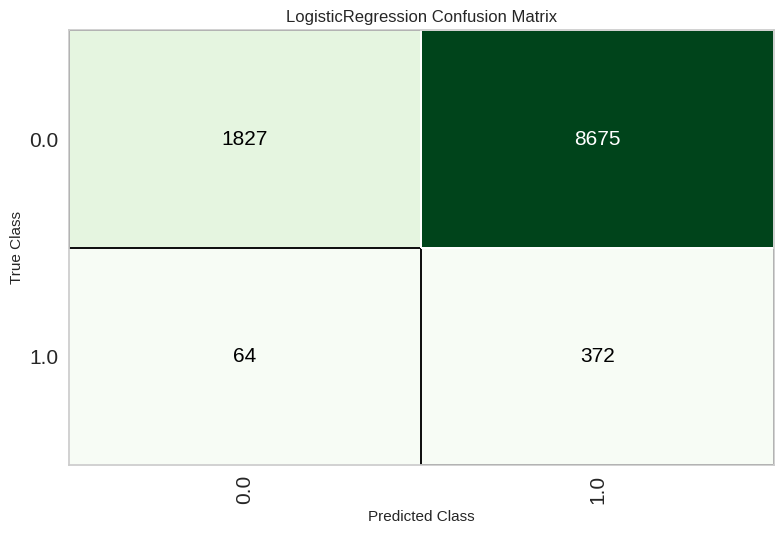

In [ ]:
lr = create_model('lr')

tuned_lr, tuner = tune_model(lr,optimize = 'eer',return_tuner=True,choose_better = True)

print(lr)
print(tuned_lr)

plot_model(tuned_lr,plot = 'confusion_matrix')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9547,0.5292,0.0069,0.0455,0.0120,0.0015,0.0023,0.4998
1,0.9498,0.5770,0.0276,0.0870,0.0419,0.0232,0.0273,0.4960
2,0.9542,0.4920,0.0414,0.1765,0.0670,0.0527,0.0679,0.4914
3,0.9377,0.4249,0.0207,0.0341,0.0258,-0.0044,-0.0046,0.5009
4,0.9413,0.4392,0.0137,0.0278,0.0183,-0.0083,-0.0089,0.5016
5,0.9339,0.4890,0.0137,0.0202,0.0163,-0.0166,-0.0169,0.5036
6,0.9205,0.4208,0.0000,0.0000,0.0000,-0.0414,-0.0414,0.5105
7,0.9287,0.5210,0.0621,0.0677,0.0647,0.0277,0.0278,0.4930
8,0.9226,0.5360,0.0690,0.0637,0.0662,0.0259,0.0260,0.4929


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,,
,,
Initiated,. . . . . . . . . . . . . . . . . .,04:53:05
Status,. . . . . . . . . . . . . . . . . .,Compiling Final Results
Estimator,. . . . . . . . . . . . . . . . . .,CatBoost Classifier


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 10 candidates, totalling 100 fits


Original model was better than the tuned model, hence it will be returned. NOTE: The display metrics are for the tuned model (not the original one).


,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.8497,0.5054,0.1793,0.0571,0.0867,0.0280,0.0336,0.4833
1,0.8006,0.4652,0.1655,0.0381,0.0619,-0.0029,-0.0039,0.5023
2,0.8988,0.4193,0.0690,0.0410,0.0514,0.0016,0.0017,0.4994
3,0.7820,0.4730,0.1655,0.0344,0.0569,-0.0095,-0.0134,0.5082
4,0.8116,0.4717,0.1507,0.0376,0.0602,-0.0042,-0.0054,0.5030
5,0.8519,0.6284,0.2397,0.0754,0.1148,0.0573,0.0689,0.4642
6,0.9188,0.5211,0.0068,0.0066,0.0067,-0.0356,-0.0356,0.5093
7,0.8302,0.5325,0.1586,0.0442,0.0692,0.0074,0.0093,0.4951
8,0.8228,0.4604,0.1103,0.0300,0.0472,-0.0164,-0.0207,0.5107


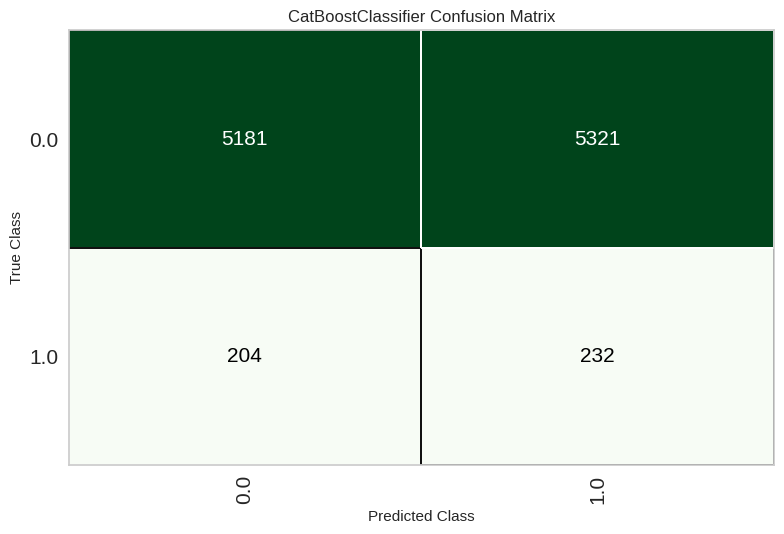

In [ ]:
cb = create_model('catboost')

tuned_cb, tuner = tune_model(cb,optimize = 'eer',return_tuner=True,choose_better = True)

print(cb)
print(tuned_cb)

plot_model(tuned_cb,plot = 'confusion_matrix')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9620,0.6864,0.0891,0.6429,0.1565,0.1483,0.2298,0.4772
1,0.9632,0.7271,0.1287,0.6842,0.2167,0.2067,0.2864,0.4662
2,0.9624,0.7097,0.0980,0.7143,0.1724,0.1644,0.2557,0.4746
3,0.9624,0.7391,0.1275,0.6500,0.2131,0.2027,0.2768,0.4667
4,0.9604,0.7003,0.0686,0.5385,0.1217,0.1137,0.1821,0.4828
5,0.9596,0.7399,0.0980,0.4762,0.1626,0.1510,0.2028,0.4753
6,0.9616,0.7544,0.0980,0.6250,0.1695,0.1604,0.2372,0.4748
7,0.9624,0.6892,0.1176,0.6667,0.2000,0.1903,0.2696,0.4694
8,0.9624,0.6915,0.1176,0.6667,0.2000,0.1903,0.2696,0.4694


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.8891,0.6741,0.4752,0.1727,0.2533,0.2073,0.2387,0.3667
1,0.8993,0.7059,0.4653,0.1880,0.2678,0.2241,0.2509,0.3683
2,0.8938,0.7228,0.5000,0.1882,0.2735,0.2287,0.2608,0.3546
3,0.8766,0.7243,0.4902,0.1597,0.2410,0.1923,0.2286,0.3635
4,0.8930,0.7137,0.4314,0.1699,0.2438,0.1978,0.2229,0.3840
5,0.8942,0.7347,0.4706,0.1818,0.2623,0.2172,0.2460,0.3673
6,0.8934,0.7457,0.5490,0.1986,0.2917,0.2475,0.2854,0.3319
7,0.8989,0.7200,0.4608,0.1880,0.2670,0.2229,0.2490,0.3702
8,0.8942,0.6874,0.4412,0.1744,0.2500,0.2044,0.2302,0.3797


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 10 candidates, totalling 100 fits


XGBClassifier(base_score=None, booster='gbtree', callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, device='cpu', early_stopping_rounds=None,
              enable_categorical=False, eval_metric=None, feature_types=None,
              gamma=None, grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=None, max_bin=None,
              max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=None, max_leaves=None,
              min_child_weight=None, missing=nan, monotone_constraints=None,
              multi_strategy=None, n_estimators=None, n_jobs=-1,
              num_parallel_tree=None, objective='binary:logistic', ...)
XGBClassifier(base_score=None, booster='gbtree', callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=0.9, device='cpu', early_stopping_rounds=None,
              enable_cate

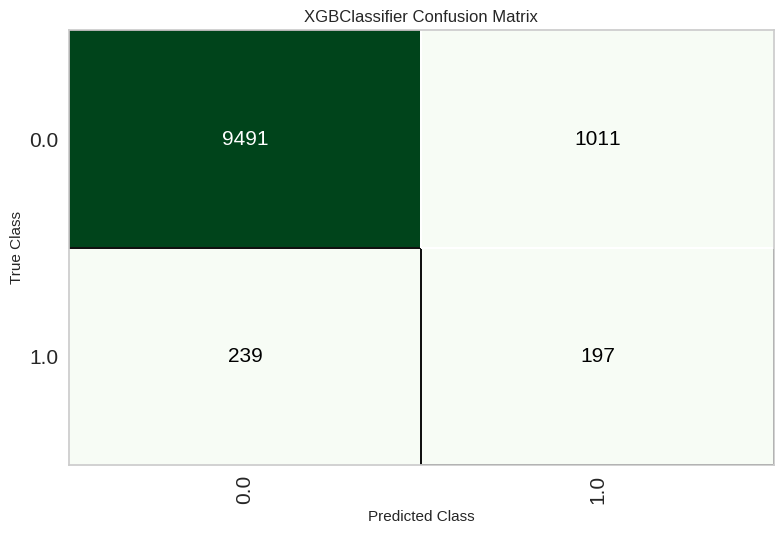

In [ ]:
xgboost = create_model('xgboost')

tuned_xgboost, tuner = tune_model(xgboost,optimize = 'eer',return_tuner=True,choose_better = True)

print(xgboost)
print(tuned_xgboost)

plot_model(tuned_xgboost,plot = 'confusion_matrix')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9608,0.7077,0.0297,0.6000,0.0566,0.0531,0.1274,0.4927
1,0.9632,0.7131,0.0891,0.8182,0.1607,0.1541,0.2628,0.4769
2,0.9608,0.7191,0.0490,0.6250,0.0909,0.0856,0.1675,0.4877
3,0.9628,0.6985,0.0882,0.8182,0.1593,0.1527,0.2614,0.4771
4,0.9608,0.6981,0.0392,0.6667,0.0741,0.0699,0.1553,0.4902
5,0.9616,0.7117,0.0588,0.7500,0.1091,0.1039,0.2033,0.4851
6,0.9620,0.7167,0.0588,0.8571,0.1101,0.1055,0.2188,0.4850
7,0.9620,0.6917,0.0686,0.7778,0.1261,0.1204,0.2241,0.4824
8,0.9612,0.6907,0.0686,0.6364,0.1239,0.1170,0.2003,0.4826


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9538,0.7102,0.0990,0.2703,0.1449,0.1264,0.1435,0.4767
1,0.9581,0.7419,0.1089,0.3929,0.1705,0.1560,0.1909,0.4729
2,0.9612,0.7083,0.1176,0.5714,0.1951,0.1840,0.2471,0.4697
3,0.9589,0.7139,0.1373,0.4516,0.2105,0.1955,0.2330,0.4649
4,0.9620,0.6921,0.1471,0.6000,0.2362,0.2240,0.2844,0.4613
5,0.9577,0.7323,0.1275,0.4062,0.1940,0.1783,0.2107,0.4679
6,0.9561,0.7385,0.1078,0.3438,0.1642,0.1479,0.1748,0.4736
7,0.9592,0.7128,0.1667,0.4722,0.2464,0.2303,0.2640,0.4565
8,0.9589,0.6822,0.1078,0.4400,0.1732,0.1600,0.2031,0.4729


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 10 candidates, totalling 100 fits


LGBMClassifier(boosting_type='gbdt', class_weight=None, colsample_bytree=1.0,
               importance_type='split', learning_rate=0.1, max_depth=-1,
               min_child_samples=20, min_child_weight=0.001, min_split_gain=0.0,
               n_estimators=100, n_jobs=-1, num_leaves=31, objective=None,
               random_state=123, reg_alpha=0.0, reg_lambda=0.0, subsample=1.0,
               subsample_for_bin=200000, subsample_freq=0)
LGBMClassifier(bagging_fraction=0.9, bagging_freq=3, boosting_type='gbdt',
               class_weight=None, colsample_bytree=1.0, feature_fraction=0.5,
               importance_type='split', learning_rate=0.4, max_depth=-1,
               min_child_samples=6, min_child_weight=0.001, min_split_gain=0.3,
               n_estimators=20, n_jobs=-1, num_leaves=150, objective=None,
               random_state=123, reg_alpha=0.005, reg_lambda=0.0005,
               subsample=1.0, subsample_for_bin=200000, subsample_freq=0)


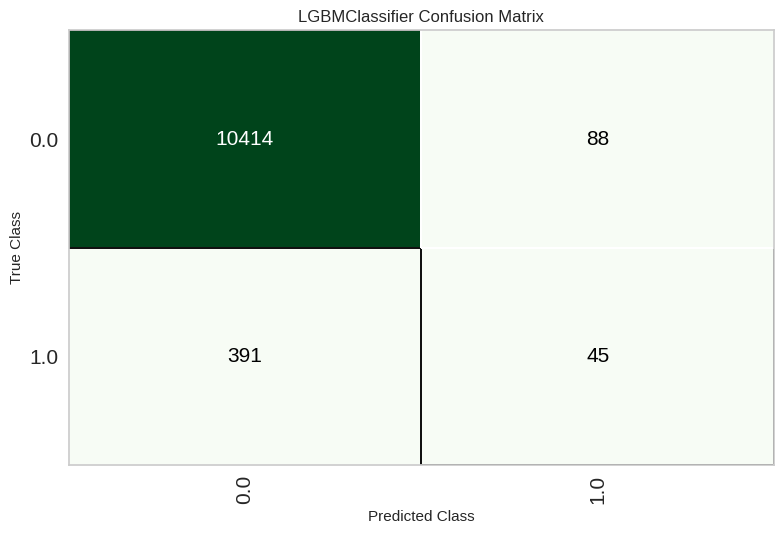

In [ ]:
lightgbm = create_model('lightgbm')

tuned_lightgbm, tuner = tune_model(lightgbm,optimize = 'eer',return_tuner=True,choose_better = True)

print(lightgbm)
print(tuned_lightgbm)

plot_model(tuned_lightgbm,plot = 'confusion_matrix')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9604,0.6035,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
1,0.9604,0.5676,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
2,0.9600,0.5942,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
3,0.9600,0.6582,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
4,0.9600,0.5891,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
5,0.9600,0.5577,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
6,0.9596,0.5777,0.0000,0.0000,0.0000,-0.0008,-0.0040,0.5001
7,0.9600,0.5693,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
8,0.9600,0.5935,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9604,0.5826,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
1,0.9604,0.5116,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
2,0.9600,0.5346,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
3,0.9600,0.6137,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
4,0.9600,0.5495,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
5,0.9600,0.5308,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
6,0.9600,0.5733,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
7,0.9600,0.5318,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
8,0.9600,0.5716,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 10 candidates, totalling 100 fits


Original model was better than the tuned model, hence it will be returned. NOTE: The display metrics are for the tuned model (not the original one).
AdaBoostClassifier(algorithm='SAMME.R', base_estimator='deprecated',
                   estimator=None, learning_rate=1.0, n_estimators=50,
                   random_state=123)
AdaBoostClassifier(algorithm='SAMME.R', base_estimator='deprecated',
                   estimator=None, learning_rate=1.0, n_estimators=50,
                   random_state=123)


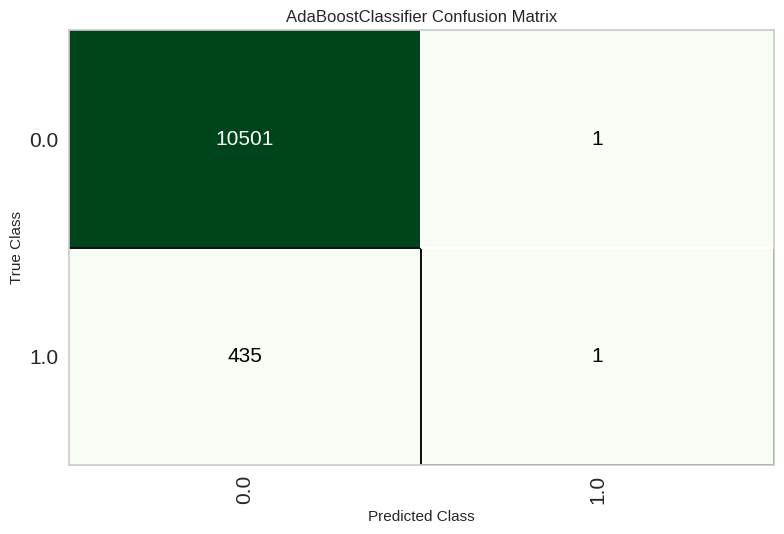

In [ ]:
adaboost = create_model('ada')

tuned_ada, tuner = tune_model(adaboost,optimize = 'eer',return_tuner=True,choose_better = True)

print(adaboost)
print(tuned_ada)

plot_model(tuned_ada,plot = 'confusion_matrix')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.5266,0.5352,0.5446,0.0452,0.0835,0.0112,0.0275,0.4654
1,0.8350,0.5202,0.1782,0.0506,0.0788,0.0182,0.0227,0.4880
2,0.9585,0.5039,0.0098,0.1667,0.0185,0.0141,0.0314,0.4980
3,0.6324,0.5267,0.4118,0.0457,0.0822,0.0110,0.0218,0.4783
4,0.4216,0.4968,0.5784,0.0395,0.0740,-0.0009,-0.0026,0.5028
5,0.9585,0.4992,0.0000,0.0000,0.0000,-0.0030,-0.0081,0.5004
6,0.8315,0.5082,0.1569,0.0444,0.0693,0.0074,0.0093,0.4952
7,0.5831,0.5527,0.5196,0.0496,0.0906,0.0190,0.0418,0.4506
8,0.8045,0.5270,0.2255,0.0519,0.0844,0.0208,0.0280,0.4831


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.8480,0.5077,0.1683,0.0530,0.0806,0.0217,0.0260,0.4870
1,0.8546,0.6060,0.1980,0.0645,0.0973,0.0400,0.0476,0.4763
2,0.8429,0.5825,0.1569,0.0483,0.0739,0.0136,0.0165,0.4917
3,0.8503,0.6207,0.3137,0.0930,0.1435,0.0872,0.1069,0.4402
4,0.8472,0.5318,0.1078,0.0355,0.0534,-0.0072,-0.0085,0.5040
5,0.8515,0.5717,0.1667,0.0547,0.0823,0.0235,0.0279,0.4864
6,0.8472,0.5507,0.1765,0.0556,0.0845,0.0252,0.0303,0.4848
7,0.8503,0.5639,0.1569,0.0513,0.0773,0.0181,0.0216,0.4895
8,0.8468,0.5301,0.1863,0.0581,0.0886,0.0294,0.0355,0.4821


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 10 candidates, totalling 100 fits


QuadraticDiscriminantAnalysis(priors=None, reg_param=0.0,
                              store_covariance=False, tol=0.0001)
QuadraticDiscriminantAnalysis(priors=None, reg_param=0.17,
                              store_covariance=False, tol=0.0001)


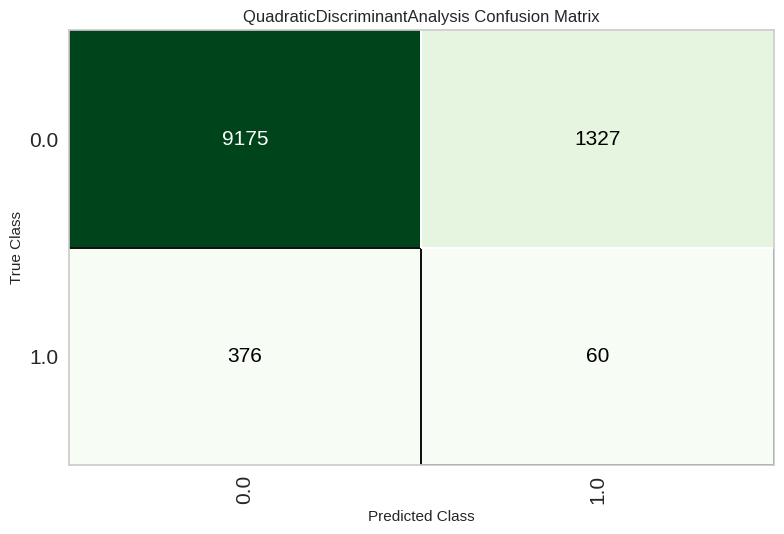

In [ ]:
qda = create_model('qda')

tuned_qda, tuner = tune_model(qda,optimize = 'eer',return_tuner=True,choose_better = True)

print(qda)
print(tuned_qda)

plot_model(tuned_qda,plot = 'confusion_matrix')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9612,0.6339,0.0297,0.7500,0.0571,0.0543,0.1444,0.4926
1,0.9604,0.6170,0.0198,0.5000,0.0381,0.0352,0.0936,0.4952
2,0.9600,0.6360,0.0098,0.5000,0.0192,0.0177,0.0658,0.4976
3,0.9604,0.6950,0.0294,0.6000,0.0561,0.0525,0.1267,0.4927
4,0.9612,0.6061,0.0294,1.0000,0.0571,0.0550,0.1681,0.4925
5,0.9604,0.6138,0.0196,0.6667,0.0381,0.0359,0.1098,0.4952
6,0.9608,0.6057,0.0196,1.0000,0.0385,0.0370,0.1373,0.4950
7,0.9604,0.5980,0.0098,1.0000,0.0194,0.0187,0.0970,0.4975
8,0.9604,0.6278,0.0098,1.0000,0.0194,0.0187,0.0970,0.4975


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9592,0.7166,0.1485,0.4545,0.2239,0.2085,0.2436,0.4617
1,0.9624,0.7100,0.1881,0.5758,0.2836,0.2693,0.3148,0.4495
2,0.9589,0.7365,0.1863,0.4634,0.2657,0.2485,0.2762,0.4509
3,0.9592,0.7072,0.1667,0.4722,0.2464,0.2303,0.2640,0.4565
4,0.9589,0.6997,0.1078,0.4400,0.1732,0.1600,0.2031,0.4729
5,0.9600,0.7405,0.1569,0.5000,0.2388,0.2240,0.2646,0.4591
6,0.9600,0.7302,0.1667,0.5000,0.2500,0.2347,0.2729,0.4563
7,0.9600,0.7156,0.1765,0.5000,0.2609,0.2451,0.2809,0.4534
8,0.9604,0.6874,0.1569,0.5161,0.2406,0.2262,0.2696,0.4590


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 10 candidates, totalling 100 fits


GradientBoostingClassifier(ccp_alpha=0.0, criterion='friedman_mse', init=None,
                           learning_rate=0.1, loss='log_loss', max_depth=3,
                           max_features=None, max_leaf_nodes=None,
                           min_impurity_decrease=0.0, min_samples_leaf=1,
                           min_samples_split=2, min_weight_fraction_leaf=0.0,
                           n_estimators=100, n_iter_no_change=None,
                           random_state=123, subsample=1.0, tol=0.0001,
                           validation_fraction=0.1, verbose=0,
                           warm_start=False)
GradientBoostingClassifier(ccp_alpha=0.0, criterion='friedman_mse', init=None,
                           learning_rate=0.15, loss='log_loss', max_depth=7,
                           max_features=1.0, max_leaf_nodes=None,
                           min_impurity_decrease=0.02, min_samples_leaf=5,
                           min_samples_split=5, min_weight_fraction_leaf=0.0,
   

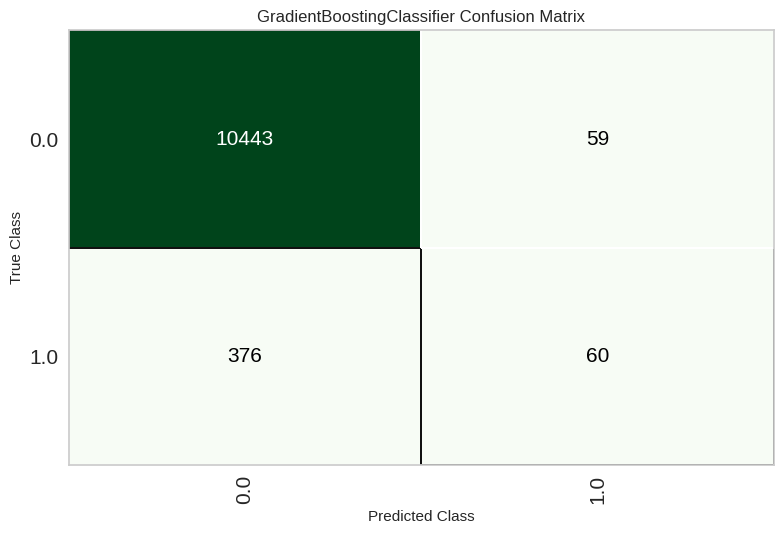

In [ ]:
gbc = create_model('gbc')

tuned_gbc, tuner = tune_model(gbc,optimize = 'eer',return_tuner=True,choose_better = True)

print(gbc)
print(tuned_gbc)

plot_model(tuned_gbc,plot = 'confusion_matrix')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9581,0.7913,0.1485,0.4167,0.2190,0.2024,0.2314,0.4620
1,0.9600,0.7450,0.2376,0.4898,0.3200,0.3020,0.3231,0.4351
2,0.9608,0.7480,0.2255,0.5227,0.3151,0.2982,0.3264,0.4386
3,0.9549,0.7936,0.1863,0.3725,0.2484,0.2278,0.2425,0.4519
4,0.9600,0.7480,0.1765,0.5000,0.2609,0.2451,0.2809,0.4534
5,0.9553,0.7170,0.1275,0.3421,0.1857,0.1677,0.1896,0.4685
6,0.9569,0.7910,0.2157,0.4231,0.2857,0.2659,0.2821,0.4426
7,0.9600,0.7003,0.2157,0.5000,0.3014,0.2841,0.3111,0.4418
8,0.9577,0.7591,0.1765,0.4286,0.2500,0.2321,0.2566,0.4541


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.6611,0.6252,0.5545,0.0639,0.1146,0.0470,0.0903,0.4010
1,0.6642,0.5709,0.3663,0.0446,0.0795,0.0096,0.0178,0.4837
2,0.6575,0.5644,0.4118,0.0491,0.0877,0.0175,0.0330,0.4683
3,0.6712,0.6668,0.5784,0.0690,0.1233,0.0559,0.1052,0.3844
4,0.6536,0.5655,0.4706,0.0547,0.0980,0.0284,0.0544,0.4446
5,0.6540,0.5555,0.3725,0.0443,0.0792,0.0084,0.0159,0.4852
6,0.6885,0.5879,0.4412,0.0575,0.1017,0.0333,0.0594,0.4444
7,0.6548,0.5695,0.3922,0.0466,0.0832,0.0127,0.0240,0.4773
8,0.6614,0.5850,0.4314,0.0518,0.0924,0.0227,0.0426,0.4587


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 10 candidates, totalling 100 fits


RandomForestClassifier(bootstrap=True, ccp_alpha=0.0, class_weight=None,
                       criterion='gini', max_depth=None, max_features='sqrt',
                       max_leaf_nodes=None, max_samples=None,
                       min_impurity_decrease=0.0, min_samples_leaf=1,
                       min_samples_split=2, min_weight_fraction_leaf=0.0,
                       n_estimators=100, n_jobs=-1, oob_score=False,
                       random_state=123, verbose=0, warm_start=False)
RandomForestClassifier(bootstrap=False, ccp_alpha=0.0,
                       class_weight='balanced_subsample', criterion='gini',
                       max_depth=4, max_features='sqrt', max_leaf_nodes=None,
                       max_samples=None, min_impurity_decrease=0.0005,
                       min_samples_leaf=3, min_samples_split=5,
                       min_weight_fraction_leaf=0.0, n_estimators=260,
                       n_jobs=-1, oob_score=False, random_state=123, verbose=0,
         

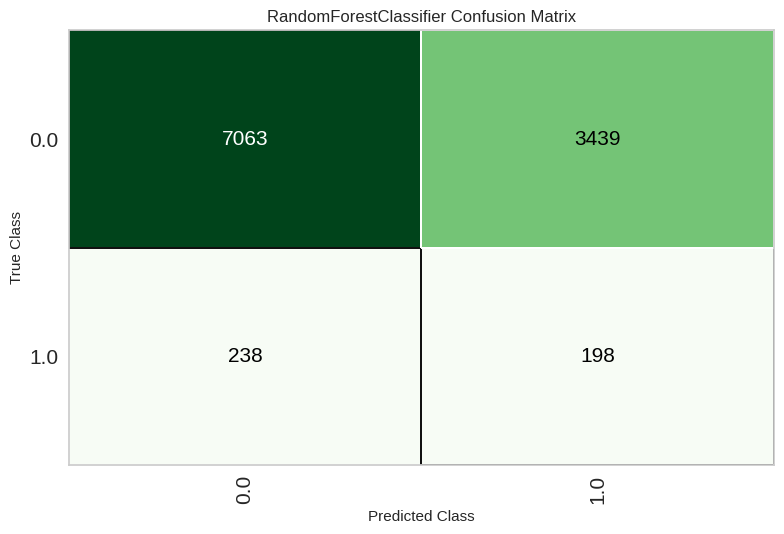

In [ ]:
rf = create_model('rf')

tuned_rf, tuner = tune_model(rf,optimize = 'eer',return_tuner=True,choose_better = True)

print(rf)
print(tuned_rf)

plot_model(tuned_rf,plot = 'confusion_matrix')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9577,0.7723,0.1485,0.4054,0.2174,0.2004,0.2276,0.4621
1,0.9604,0.7498,0.2178,0.5000,0.3034,0.2863,0.3128,0.4411
2,0.9620,0.7349,0.2059,0.5676,0.3022,0.2870,0.3267,0.4442
3,0.9569,0.7777,0.1961,0.4167,0.2667,0.2474,0.2663,0.4485
4,0.9592,0.7268,0.1765,0.4737,0.2571,0.2407,0.2722,0.4536
5,0.9561,0.7035,0.1373,0.3684,0.2000,0.1823,0.2061,0.4656
6,0.9565,0.7544,0.1863,0.4043,0.2550,0.2358,0.2547,0.4515
7,0.9596,0.7099,0.2157,0.4889,0.2993,0.2817,0.3070,0.4419
8,0.9573,0.7366,0.1667,0.4146,0.2378,0.2199,0.2444,0.4570


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.6775,0.5946,0.4455,0.0554,0.0986,0.0303,0.0555,0.4466
1,0.6446,0.5497,0.4554,0.0512,0.0921,0.0225,0.0440,0.4550
2,0.6023,0.5516,0.5000,0.0502,0.0913,0.0201,0.0426,0.4519
3,0.6144,0.6323,0.5686,0.0581,0.1055,0.0355,0.0742,0.4117
4,0.6054,0.5586,0.4804,0.0489,0.0887,0.0174,0.0365,0.4597
5,0.6238,0.5427,0.4902,0.0522,0.0943,0.0238,0.0484,0.4475
6,0.6755,0.5838,0.4314,0.0541,0.0961,0.0269,0.0492,0.4533
7,0.6579,0.5257,0.3627,0.0438,0.0781,0.0073,0.0137,0.4874
8,0.6321,0.5639,0.4608,0.0505,0.0910,0.0204,0.0407,0.4576


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 10 candidates, totalling 100 fits


ExtraTreesClassifier(bootstrap=False, ccp_alpha=0.0, class_weight=None,
                     criterion='gini', max_depth=None, max_features='sqrt',
                     max_leaf_nodes=None, max_samples=None,
                     min_impurity_decrease=0.0, min_samples_leaf=1,
                     min_samples_split=2, min_weight_fraction_leaf=0.0,
                     n_estimators=100, n_jobs=-1, oob_score=False,
                     random_state=123, verbose=0, warm_start=False)
ExtraTreesClassifier(bootstrap=False, ccp_alpha=0.0,
                     class_weight='balanced_subsample', criterion='gini',
                     max_depth=4, max_features='sqrt', max_leaf_nodes=None,
                     max_samples=None, min_impurity_decrease=0.0005,
                     min_samples_leaf=3, min_samples_split=5,
                     min_weight_fraction_leaf=0.0, n_estimators=260, n_jobs=-1,
                     oob_score=False, random_state=123, verbose=0,
                     warm_start=Fals

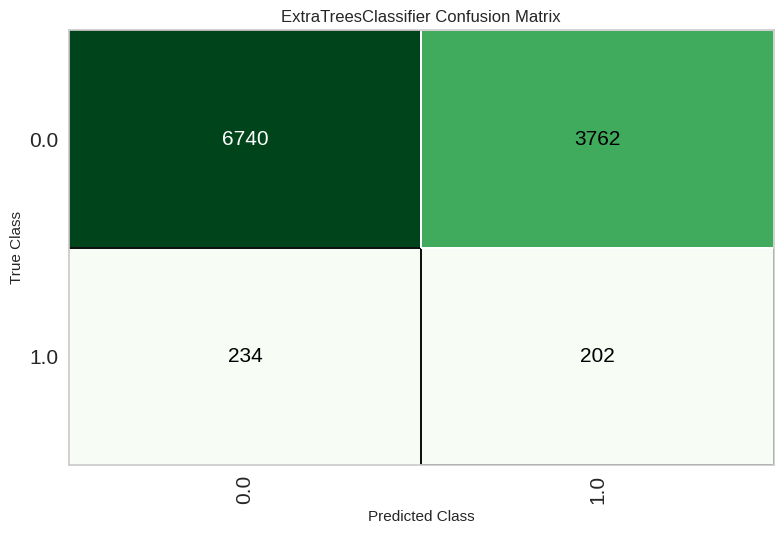

In [ ]:
et = create_model('et')

tuned_et, tuner = tune_model(et,optimize = 'eer',return_tuner=True,choose_better = True)

print(et)
print(tuned_et)

plot_model(tuned_et,plot = 'confusion_matrix')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.0674,0.4844,0.9802,0.0400,0.0768,0.0008,0.0115,0.4974
1,0.0572,0.5688,0.9901,0.0399,0.0767,0.0007,0.0129,0.4978
2,0.0549,0.4958,0.9902,0.0402,0.0773,0.0005,0.0096,0.4985
3,0.0600,0.5703,0.9902,0.0404,0.0777,0.0009,0.0157,0.4971
4,0.0564,0.5212,1.0000,0.0406,0.0781,0.0014,0.0264,0.4957
5,0.0607,0.5401,0.9902,0.0404,0.0777,0.0010,0.0165,0.4969
6,0.0580,0.4932,1.0000,0.0407,0.0782,0.0015,0.0276,0.4953
7,0.0615,0.5186,0.9902,0.0405,0.0778,0.0011,0.0173,0.4967
8,0.0584,0.5146,0.9804,0.0400,0.0768,0.0000,0.0005,0.4999


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9361,0.4941,0.0495,0.0694,0.0578,0.0257,0.0261,0.4942
1,0.9334,0.5682,0.0396,0.0519,0.0449,0.0111,0.0112,0.4975
2,0.9397,0.5040,0.0490,0.0806,0.0610,0.0317,0.0328,0.4933
3,0.9353,0.5808,0.0882,0.1111,0.0984,0.0653,0.0658,0.4844
4,0.9306,0.5239,0.0196,0.0253,0.0221,-0.0133,-0.0134,0.5030
5,0.9353,0.5371,0.0294,0.0435,0.0351,0.0029,0.0030,0.4994
6,0.9361,0.5034,0.0490,0.0704,0.0578,0.0258,0.0263,0.4943
7,0.9432,0.5235,0.0392,0.0784,0.0523,0.0263,0.0280,0.4948
8,0.9444,0.5238,0.0490,0.1000,0.0658,0.0406,0.0433,0.4921


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 10 candidates, totalling 100 fits


GaussianNB(priors=None, var_smoothing=1e-09)
GaussianNB(priors=None, var_smoothing=1)


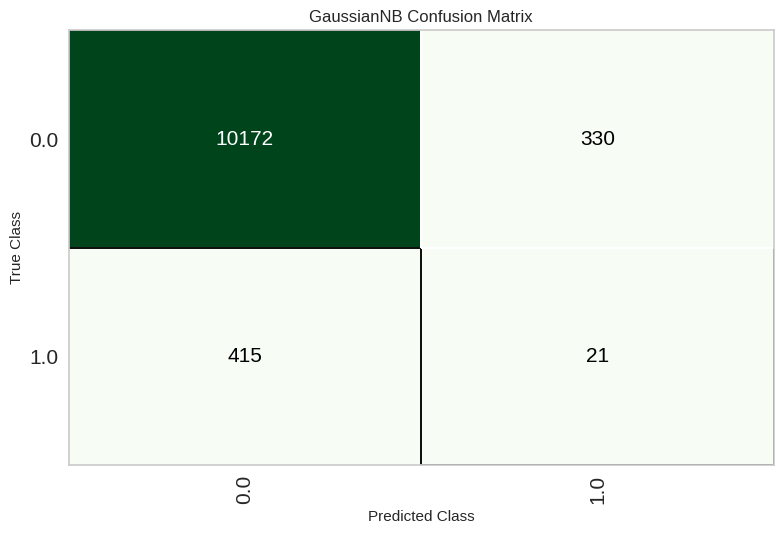

In [ ]:
nb = create_model('nb')

tuned_nb, tuner = tune_model(nb,optimize = 'eer',return_tuner=True,choose_better = True)

print(nb)
print(tuned_nb)

plot_model(tuned_nb,plot = 'confusion_matrix')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9585,0.6674,0.0396,0.3077,0.0702,0.0617,0.0984,0.4908
1,0.9577,0.6830,0.0891,0.3600,0.1429,0.1292,0.1635,0.4783
2,0.9616,0.6723,0.1078,0.6111,0.1833,0.1734,0.2457,0.4722
3,0.9569,0.6970,0.0980,0.3571,0.1538,0.1390,0.1705,0.4761
4,0.9585,0.6667,0.0490,0.3571,0.0862,0.0773,0.1203,0.4884
5,0.9573,0.6586,0.0686,0.3333,0.1138,0.1016,0.1364,0.4837
6,0.9592,0.7148,0.0784,0.4444,0.1333,0.1228,0.1740,0.4806
7,0.9561,0.6397,0.0980,0.3333,0.1515,0.1358,0.1633,0.4763
8,0.9589,0.6505,0.0980,0.4348,0.1600,0.1475,0.1922,0.4756


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9581,0.7083,0.1485,0.4167,0.2190,0.2024,0.2314,0.4620
1,0.9596,0.7157,0.2178,0.4783,0.2993,0.2815,0.3049,0.4413
2,0.9624,0.7113,0.2157,0.5789,0.3143,0.2991,0.3383,0.4412
3,0.9573,0.7358,0.1863,0.4222,0.2585,0.2399,0.2614,0.4513
4,0.9589,0.7095,0.1765,0.4615,0.2553,0.2385,0.2681,0.4537
5,0.9561,0.7068,0.1373,0.3684,0.2000,0.1823,0.2061,0.4656
6,0.9573,0.7334,0.1863,0.4222,0.2585,0.2399,0.2614,0.4513
7,0.9592,0.6934,0.2157,0.4783,0.2973,0.2794,0.3031,0.4420
8,0.9573,0.6648,0.1667,0.4146,0.2378,0.2199,0.2444,0.4570


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 10 candidates, totalling 100 fits


KNeighborsClassifier(algorithm='auto', leaf_size=30, metric='minkowski',
                     metric_params=None, n_jobs=-1, n_neighbors=5, p=2,
                     weights='uniform')
KNeighborsClassifier(algorithm='auto', leaf_size=30, metric='manhattan',
                     metric_params=None, n_jobs=-1, n_neighbors=13, p=2,
                     weights='distance')


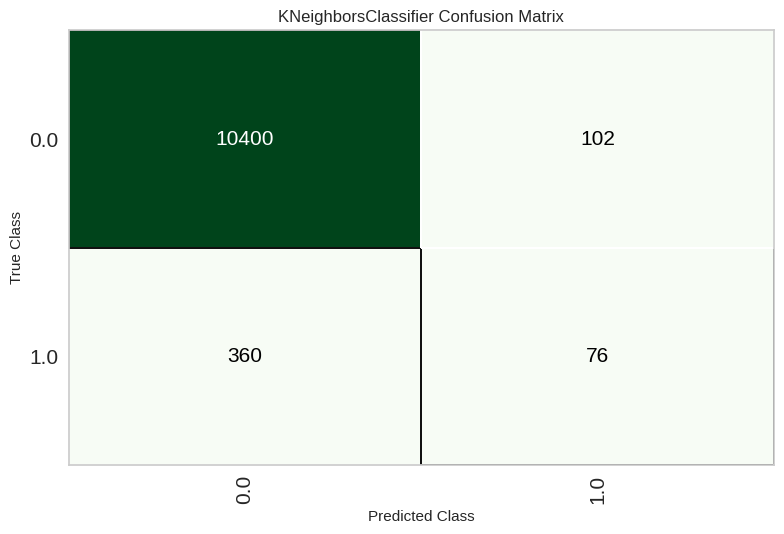

In [ ]:
knn = create_model('knn')

tuned_knn, tuner = tune_model(knn,optimize = 'eer',return_tuner=True,choose_better = True)

print(knn)
print(tuned_knn)

plot_model(tuned_knn,plot = 'confusion_matrix')


## Borderline Smote

In [ ]:
import imblearn
from imblearn.over_sampling import BorderlineSMOTE
svm = BorderlineSMOTE(random_state=0)
svmsmote = setup(df,test_data = test_data, target = 'STATUS',normalize = True,ignore_features = ['ID'],fix_imbalance = True,fix_imbalance_method = svm,index=False)
add_metric('eer', 'eer', calculate_eer,greater_is_better=False)

,Description,Value
0,Session id,5742
1,Target,STATUS
2,Target type,Binary
3,Original data shape,"(47395, 52)"
4,Transformed data shape,"(80946, 51)"
5,Transformed train set shape,"(70008, 51)"
6,Transformed test set shape,"(10938, 51)"
7,Ignore features,1
8,Numeric features,50
9,Rows with missing values,23.1%


Name                                                               eer
Display Name                                                       eer
Score Function       <pycaret.internal.metrics.EncodedDecodedLabels...
Scorer               make_scorer(calculate_eer, greater_is_better=F...
Target                                                            pred
Args                                                                {}
Greater is Better                                                False
Multiclass                                                        True
Custom                                                            True
Name: eer, dtype: object

In [ ]:
best = compare_models(sort='eer')

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer,TT (Sec)
lr,Logistic Regression,0.5731,0.5085,0.4487,0.0425,0.0776,0.0052,0.0109,0.4872,1.1060
svm,SVM - Linear Kernel,0.5655,0.0000,0.4543,0.0419,0.0766,0.0040,0.0097,0.4872,1.8870
lda,Linear Discriminant Analysis,0.5737,0.5089,0.4494,0.0428,0.0780,0.0057,0.0114,0.4873,1.4610
ridge,Ridge Classifier,0.5749,0.0000,0.4474,0.0428,0.0780,0.0057,0.0112,0.4874,0.7670
xgboost,Extreme Gradient Boosting,0.9336,0.5215,0.0544,0.0860,0.0631,0.0306,0.0332,0.4935,3.9450
catboost,CatBoost Classifier,0.9364,0.5004,0.0455,0.0767,0.0523,0.0223,0.0249,0.4949,45.7780
lightgbm,Light Gradient Boosting Machine,0.9446,0.4914,0.0214,0.0602,0.0290,0.0063,0.0088,0.4989,6.2480
ada,Ada Boost Classifier,0.9324,0.5009,0.0324,0.0394,0.0340,0.0012,0.0010,0.4994,4.3170
qda,Quadratic Discriminant Analysis,0.0410,0.5006,1.0000,0.0399,0.0767,0.0001,0.0053,0.4997,1.0480
dummy,Dummy Classifier,0.9601,0.5000,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000,0.5560


Processing:   0%|          | 0/69 [00:00<?, ?it/s]

In [ ]:
evaluate_model(best)

interactive(children=(ToggleButtons(description='Plot Type:', icons=('',), options=(('Pipeline Plot', 'pipelin…

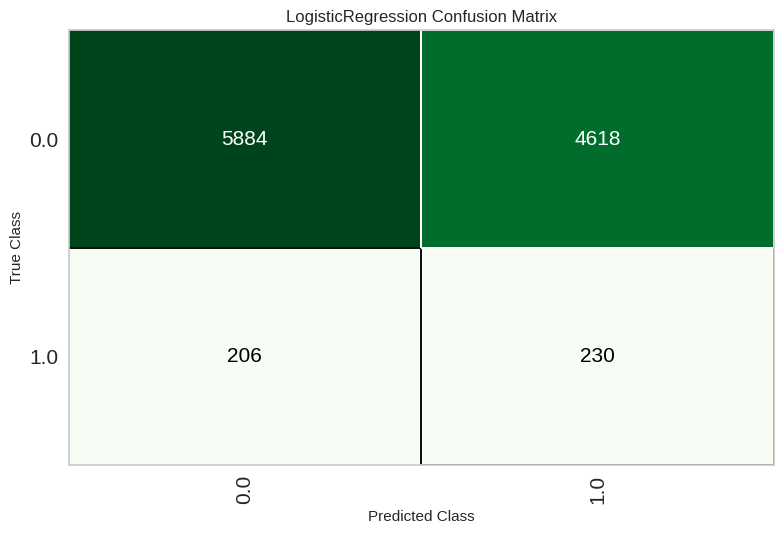

In [ ]:
plot_model(best,plot = 'confusion_matrix')

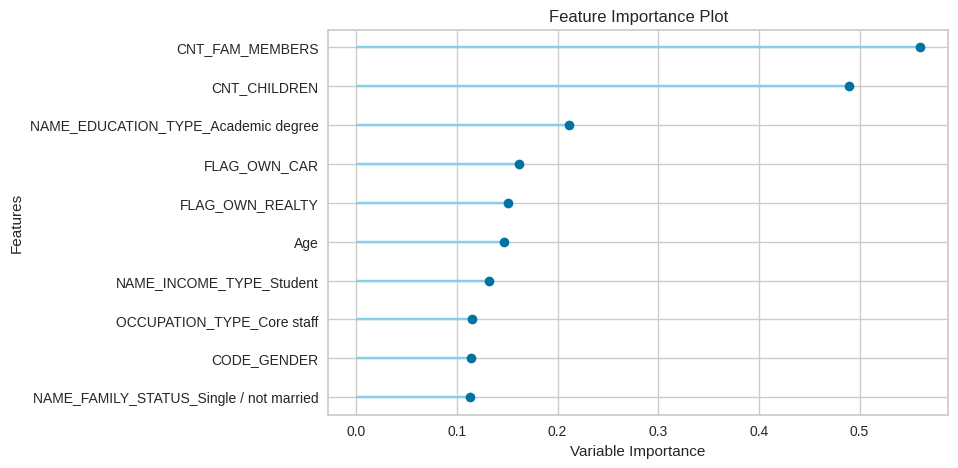

In [ ]:
plot_model(best,plot = 'feature')

### Models Confusion Matrix after BorderLine Smote

In [ ]:
dt = create_model('dt')
svm = create_model('svm')
rf = create_model('rf')
et = create_model('et')
catboost = create_model('catboost')
knn = create_model('knn')
lightgbm = create_model('lightgbm')
qda = create_model('qda')
lda = create_model('lda')
gbc = create_model('gbc')
xgboost = create_model('xgboost')
nb = create_model('nb')
lr = create_model('lr')
ridge = create_model('ridge')
ada = create_model('ada')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.8980,0.5116,0.0897,0.0514,0.0653,0.0156,0.0162,0.4943
1,0.8659,0.4873,0.1172,0.0450,0.0650,0.0080,0.0091,0.4960
2,0.8642,0.4907,0.1034,0.0395,0.0571,-0.0005,-0.0005,0.5002
3,0.8022,0.4238,0.0483,0.0119,0.0190,-0.0479,-0.0627,0.5331
4,0.8239,0.4288,0.0411,0.0118,0.0183,-0.0468,-0.0579,0.5282
5,0.8401,0.4683,0.0753,0.0240,0.0364,-0.0260,-0.0311,0.5147
6,0.8157,0.4658,0.0616,0.0165,0.0261,-0.0396,-0.0502,0.5255
7,0.8200,0.5037,0.0966,0.0260,0.0409,-0.0232,-0.0294,0.5152
8,0.8195,0.5209,0.1310,0.0345,0.0546,-0.0090,-0.0114,0.5061


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.6064,0.0000,0.4138,0.0426,0.0772,0.0054,0.0113,0.4883
1,0.5933,0.0000,0.3241,0.0328,0.0596,-0.0136,-0.0286,0.5279
2,0.6426,0.0000,0.4690,0.0526,0.0945,0.0248,0.0485,0.4497
3,0.5428,0.0000,0.3586,0.0320,0.0587,-0.0154,-0.0358,0.5382
4,0.5535,0.0000,0.5479,0.0487,0.0895,0.0172,0.0401,0.4495
5,0.6201,0.0000,0.3425,0.0373,0.0673,-0.0053,-0.0105,0.5100
6,0.5930,0.0000,0.3493,0.0354,0.0643,-0.0091,-0.0191,0.5190
7,0.6071,0.0000,0.4621,0.0471,0.0856,0.0144,0.0301,0.4673
8,0.5193,0.0000,0.4897,0.0406,0.0750,0.0016,0.0040,0.4950


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9399,0.4652,0.0414,0.0698,0.0519,0.0230,0.0239,0.4952
1,0.9243,0.4541,0.0483,0.0483,0.0483,0.0089,0.0089,0.4977
2,0.9238,0.3820,0.0828,0.0764,0.0795,0.0398,0.0398,0.4890
3,0.8645,0.2065,0.0138,0.0057,0.0080,-0.0512,-0.0571,0.5229
4,0.8788,0.2230,0.0411,0.0195,0.0264,-0.0295,-0.0319,0.5121
5,0.8790,0.2572,0.0342,0.0164,0.0222,-0.0338,-0.0364,0.5137
6,0.8645,0.2773,0.0548,0.0220,0.0314,-0.0274,-0.0307,0.5127
7,0.8798,0.3757,0.0690,0.0319,0.0437,-0.0113,-0.0123,0.5048
8,0.8859,0.4549,0.0966,0.0468,0.0631,0.0100,0.0108,0.4958


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9342,0.4418,0.0483,0.0642,0.0551,0.0217,0.0220,0.4950
1,0.9210,0.4049,0.0483,0.0446,0.0464,0.0052,0.0052,0.4986
2,0.9152,0.3148,0.0828,0.0638,0.0721,0.0284,0.0287,0.4913
3,0.8631,0.1582,0.0207,0.0083,0.0119,-0.0475,-0.0532,0.5216
4,0.8760,0.1656,0.0411,0.0189,0.0259,-0.0307,-0.0334,0.5128
5,0.8741,0.1995,0.0342,0.0155,0.0213,-0.0358,-0.0391,0.5151
6,0.8637,0.2164,0.0548,0.0218,0.0312,-0.0277,-0.0311,0.5130
7,0.8749,0.3272,0.0690,0.0302,0.0420,-0.0141,-0.0155,0.5062
8,0.8793,0.4153,0.1103,0.0489,0.0678,0.0134,0.0147,0.4940


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9531,0.5107,0.0276,0.1176,0.0447,0.0300,0.0387,0.4952
1,0.9397,0.5414,0.0276,0.0482,0.0351,0.0063,0.0066,0.4987
2,0.9531,0.4297,0.0414,0.1579,0.0656,0.0499,0.0620,0.4917
3,0.9284,0.4223,0.0069,0.0085,0.0076,-0.0291,-0.0293,0.5068
4,0.9361,0.4311,0.0137,0.0220,0.0169,-0.0143,-0.0147,0.5030
5,0.9301,0.5130,0.0137,0.0177,0.0154,-0.0202,-0.0204,0.5046
6,0.9166,0.4089,0.0274,0.0241,0.0256,-0.0177,-0.0178,0.5049
7,0.9347,0.5099,0.1103,0.1280,0.1185,0.0848,0.0851,0.4787
8,0.9259,0.5328,0.0621,0.0629,0.0625,0.0239,0.0239,0.4937


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.8497,0.4859,0.1103,0.0368,0.0552,-0.0048,-0.0056,0.5026
1,0.8412,0.4510,0.0966,0.0303,0.0461,-0.0153,-0.0185,0.5088
2,0.8516,0.4847,0.1172,0.0395,0.0591,-0.0004,-0.0004,0.5002
3,0.8108,0.4116,0.0414,0.0108,0.0171,-0.0491,-0.0630,0.5322
4,0.8020,0.4230,0.0274,0.0068,0.0110,-0.0567,-0.0739,0.5383
5,0.8047,0.4533,0.0685,0.0171,0.0273,-0.0393,-0.0513,0.5272
6,0.7751,0.4255,0.0685,0.0144,0.0238,-0.0454,-0.0634,0.5366
7,0.8038,0.5133,0.1241,0.0297,0.0479,-0.0174,-0.0230,0.5128
8,0.7964,0.5153,0.1586,0.0358,0.0584,-0.0070,-0.0095,0.5056


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9528,0.5046,0.0345,0.1351,0.0549,0.0394,0.0494,0.4935
1,0.9484,0.5375,0.0207,0.0612,0.0309,0.0111,0.0128,0.4981
2,0.9580,0.4672,0.0207,0.2143,0.0377,0.0309,0.0554,0.4956
3,0.9391,0.4283,0.0138,0.0247,0.0177,-0.0111,-0.0116,0.5022
4,0.9515,0.4829,0.0205,0.0811,0.0328,0.0169,0.0212,0.4972
5,0.9372,0.5079,0.0000,0.0000,0.0000,-0.0299,-0.0312,0.5060
6,0.9350,0.4121,0.0000,0.0000,0.0000,-0.0317,-0.0327,0.5066
7,0.9410,0.5091,0.0207,0.0395,0.0271,-0.0002,-0.0002,0.5000
8,0.9303,0.5269,0.0414,0.0496,0.0451,0.0093,0.0093,0.4978


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.0428,0.5016,1.0000,0.0399,0.0767,0.0003,0.0112,0.4992
1,0.0400,0.5001,1.0000,0.0398,0.0765,0.0000,0.0034,0.4999
2,0.0398,0.5000,1.0000,0.0398,0.0765,0.0000,0.0000,0.5000
3,0.0436,0.5020,1.0000,0.0399,0.0768,0.0003,0.0126,0.4990
4,0.0422,0.5011,1.0000,0.0401,0.0772,0.0002,0.0096,0.4994
5,0.0403,0.5001,1.0000,0.0401,0.0770,0.0000,0.0034,0.4999
6,0.0406,0.5003,1.0000,0.0401,0.0770,0.0000,0.0048,0.4999
7,0.0398,0.5000,1.0000,0.0398,0.0765,0.0000,0.0000,0.5000
8,0.0398,0.5000,1.0000,0.0398,0.0765,0.0000,0.0000,0.5000


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.6182,0.5399,0.4552,0.0479,0.0866,0.0158,0.0323,0.4657
1,0.6330,0.4536,0.3241,0.0365,0.0656,-0.0063,-0.0123,0.5114
2,0.6166,0.5497,0.4621,0.0483,0.0875,0.0167,0.0342,0.4634
3,0.5420,0.4122,0.3172,0.0284,0.0522,-0.0224,-0.0517,0.5533
4,0.6223,0.5529,0.4521,0.0484,0.0875,0.0163,0.0330,0.4654
5,0.5708,0.5005,0.4315,0.0408,0.0745,0.0014,0.0032,0.4965
6,0.5406,0.4822,0.4452,0.0392,0.0720,-0.0017,-0.0040,0.5046
7,0.6099,0.5378,0.4828,0.0494,0.0896,0.0188,0.0393,0.4568
8,0.4667,0.5015,0.5448,0.0404,0.0752,0.0012,0.0032,0.4962


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9583,0.4966,0.0000,0.0000,0.0000,-0.0037,-0.0089,0.5005
1,0.9534,0.5132,0.0000,0.0000,0.0000,-0.0118,-0.0169,0.5018
2,0.9578,0.4525,0.0138,0.1538,0.0253,0.0189,0.0349,0.4973
3,0.9542,0.4554,0.0000,0.0000,0.0000,-0.0106,-0.0159,0.5016
4,0.9580,0.4945,0.0137,0.1818,0.0255,0.0200,0.0398,0.4972
5,0.9528,0.5281,0.0000,0.0000,0.0000,-0.0123,-0.0173,0.5019
6,0.9523,0.4167,0.0000,0.0000,0.0000,-0.0131,-0.0180,0.5020
7,0.9545,0.5199,0.0207,0.1111,0.0349,0.0227,0.0315,0.4965
8,0.9487,0.4860,0.0138,0.0435,0.0209,0.0018,0.0021,0.4997


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9468,0.5511,0.0414,0.0984,0.0583,0.0355,0.0391,0.4934
1,0.9386,0.6018,0.0276,0.0460,0.0345,0.0048,0.0050,0.4990
2,0.9536,0.4925,0.0414,0.1667,0.0663,0.0513,0.0648,0.4916
3,0.9336,0.4444,0.0069,0.0101,0.0082,-0.0249,-0.0254,0.5054
4,0.9388,0.4708,0.0274,0.0471,0.0346,0.0053,0.0055,0.4989
5,0.9276,0.5156,0.0137,0.0164,0.0149,-0.0223,-0.0224,0.5053
6,0.9109,0.4413,0.0411,0.0314,0.0356,-0.0102,-0.0103,0.5031
7,0.9339,0.5282,0.0690,0.0862,0.0766,0.0428,0.0431,0.4898
8,0.9177,0.5417,0.0621,0.0520,0.0566,0.0139,0.0140,0.4960


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.1114,0.5054,0.9172,0.0396,0.0759,-0.0004,-0.0035,0.5013
1,0.0708,0.4904,0.9379,0.0387,0.0743,-0.0022,-0.0286,0.5072
2,0.0839,0.4173,0.9172,0.0384,0.0738,-0.0028,-0.0297,0.5089
3,0.0699,0.4873,0.9655,0.0397,0.0763,-0.0001,-0.0018,0.5004
4,0.0831,0.5065,0.9795,0.0411,0.0788,0.0021,0.0239,0.4935
5,0.0839,0.5201,0.9521,0.0400,0.0768,-0.0000,-0.0002,0.5001
6,0.0724,0.3746,0.9178,0.0382,0.0734,-0.0037,-0.0457,0.5120
7,0.0793,0.5333,0.9724,0.0404,0.0775,0.0012,0.0144,0.4962
8,0.0678,0.4570,0.9793,0.0401,0.0771,0.0008,0.0107,0.4976


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.6166,0.5398,0.4552,0.0477,0.0863,0.0154,0.0316,0.4664
1,0.6347,0.4534,0.3241,0.0367,0.0659,-0.0060,-0.0116,0.5107
2,0.6199,0.5495,0.4621,0.0487,0.0882,0.0175,0.0357,0.4620
3,0.5447,0.4132,0.3172,0.0286,0.0525,-0.0221,-0.0506,0.5520
4,0.6212,0.5533,0.4521,0.0483,0.0872,0.0160,0.0325,0.4658
5,0.5752,0.5008,0.4315,0.0412,0.0752,0.0023,0.0050,0.4945
6,0.5403,0.4817,0.4452,0.0392,0.0720,-0.0018,-0.0041,0.5048
7,0.6099,0.5384,0.4828,0.0494,0.0896,0.0188,0.0393,0.4568
8,0.4634,0.5019,0.5448,0.0401,0.0747,0.0007,0.0019,0.4978


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.6182,0.0000,0.4552,0.0479,0.0866,0.0158,0.0323,0.4657
1,0.6330,0.0000,0.3241,0.0365,0.0656,-0.0063,-0.0123,0.5114
2,0.6166,0.0000,0.4621,0.0483,0.0875,0.0167,0.0342,0.4634
3,0.5420,0.0000,0.3172,0.0284,0.0522,-0.0224,-0.0517,0.5533
4,0.6223,0.0000,0.4521,0.0484,0.0875,0.0163,0.0330,0.4654
5,0.5708,0.0000,0.4315,0.0408,0.0745,0.0014,0.0032,0.4965
6,0.5406,0.0000,0.4452,0.0392,0.0720,-0.0017,-0.0040,0.5046
7,0.6099,0.0000,0.4828,0.0494,0.0896,0.0188,0.0393,0.4568
8,0.4667,0.0000,0.5448,0.0404,0.0752,0.0012,0.0032,0.4962


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9361,0.5113,0.0276,0.0417,0.0332,0.0016,0.0016,0.4997
1,0.9465,0.4745,0.0069,0.0192,0.0102,-0.0111,-0.0126,0.5019
2,0.9438,0.4862,0.0069,0.0161,0.0097,-0.0145,-0.0159,0.5027
3,0.9180,0.4655,0.0414,0.0361,0.0386,-0.0040,-0.0041,0.5011
4,0.9391,0.4968,0.0411,0.0682,0.0513,0.0218,0.0226,0.4954
5,0.9276,0.5101,0.0548,0.0597,0.0571,0.0196,0.0196,0.4951
6,0.9339,0.4282,0.0068,0.0103,0.0082,-0.0245,-0.0251,0.5052
7,0.9306,0.4962,0.0966,0.1029,0.0996,0.0636,0.0636,0.4835
8,0.9078,0.4696,0.0345,0.0249,0.0289,-0.0182,-0.0184,0.5056


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

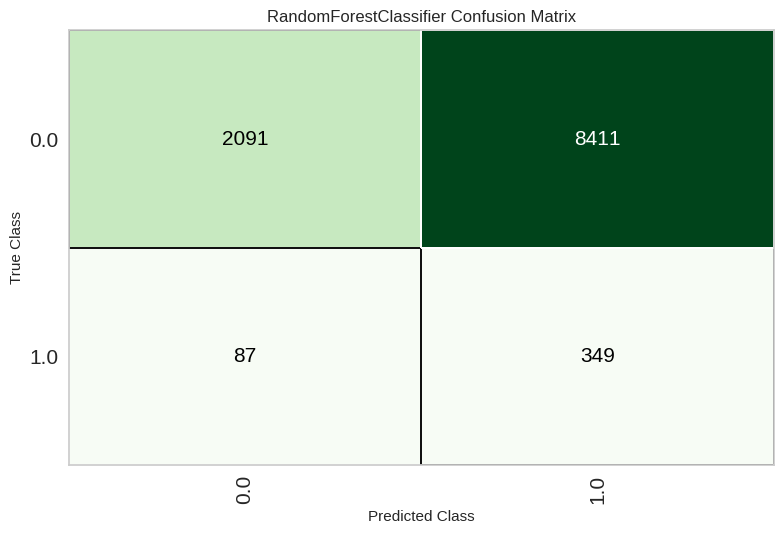

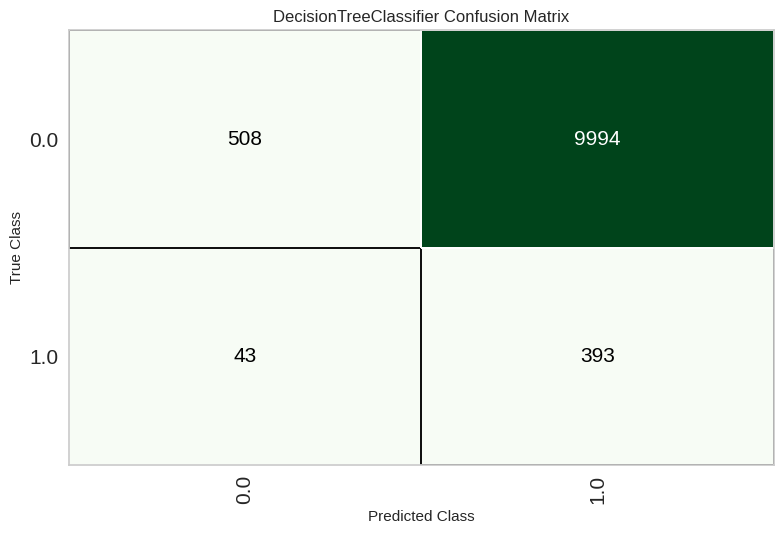

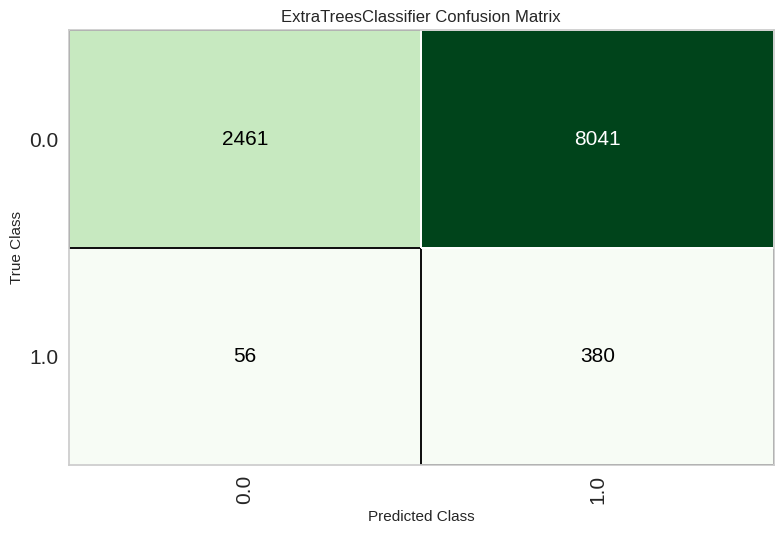

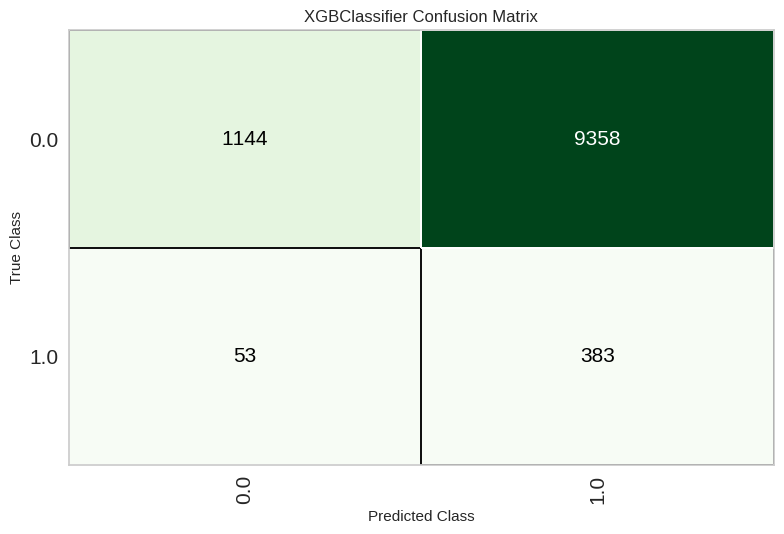

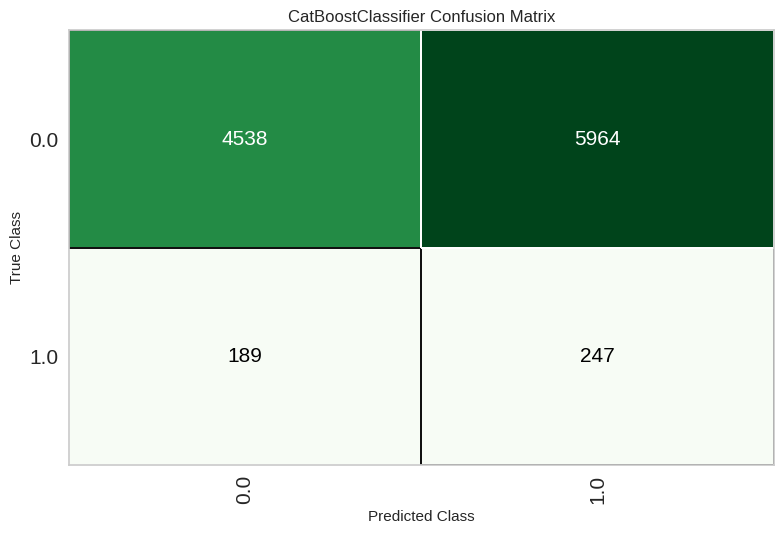

...

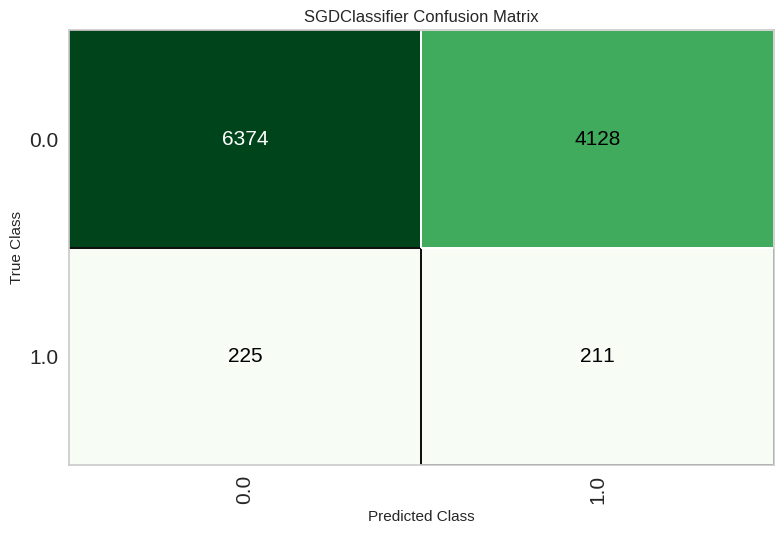

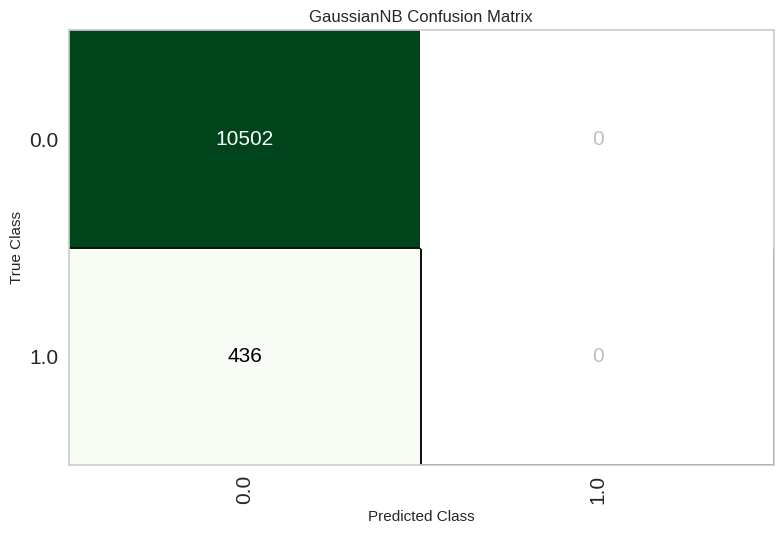

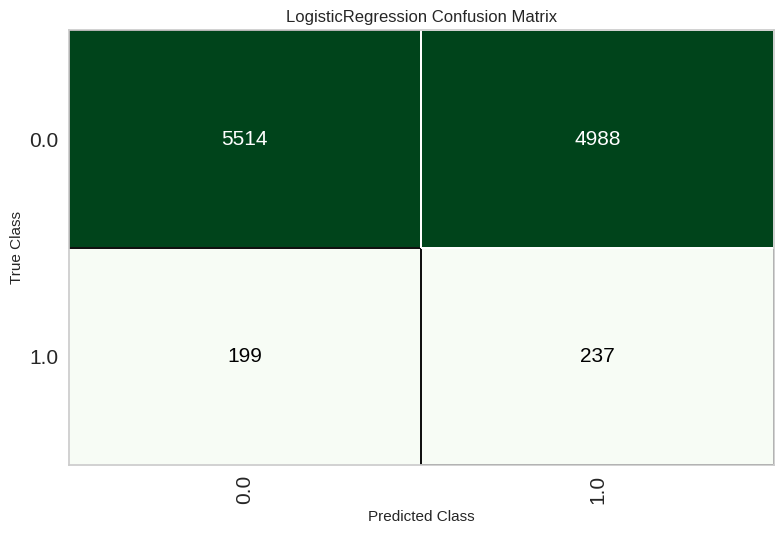

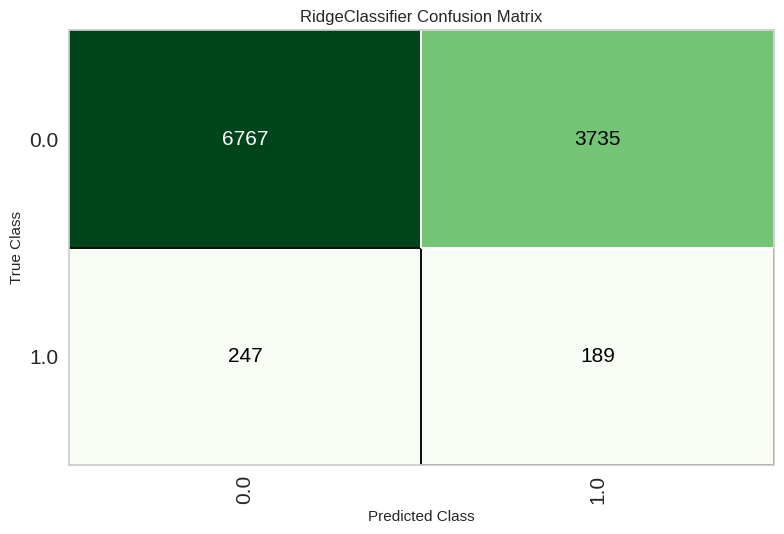

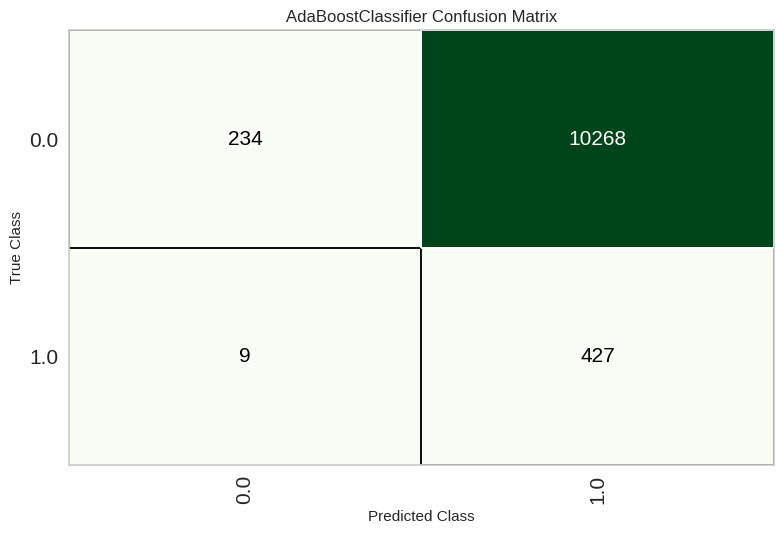

In [ ]:
plot_model(rf,plot = 'confusion_matrix')
plot_model(dt,plot = 'confusion_matrix')
plot_model(et,plot = 'confusion_matrix')
plot_model(xgboost,plot = 'confusion_matrix')
plot_model(catboost,plot = 'confusion_matrix')
plot_model(knn,plot = 'confusion_matrix')
plot_model(lightgbm,plot = 'confusion_matrix')
plot_model(qda,plot = 'confusion_matrix')
plot_model(lda,plot = 'confusion_matrix')
plot_model(gbc,plot = 'confusion_matrix')
plot_model(svm,plot = 'confusion_matrix')
plot_model(nb,plot = 'confusion_matrix')
plot_model(lr,plot = 'confusion_matrix')
plot_model(ridge,plot = 'confusion_matrix')
plot_model(ada,plot = 'confusion_matrix')

### Tune with Borderline Smote

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.5414,0.0000,0.4828,0.0420,0.0773,0.0044,0.0104,0.4875
1,0.6566,0.0000,0.3379,0.0407,0.0726,0.0017,0.0032,0.4971
2,0.6188,0.0000,0.5724,0.0588,0.1067,0.0372,0.0775,0.4079
3,0.5560,0.0000,0.3103,0.0288,0.0527,-0.0217,-0.0488,0.5492
4,0.6484,0.0000,0.3219,0.0382,0.0683,-0.0035,-0.0067,0.5060
5,0.6602,0.0000,0.4041,0.0487,0.0870,0.0167,0.0312,0.4704
6,0.5483,0.0000,0.4521,0.0404,0.0742,0.0007,0.0017,0.4980
7,0.6326,0.0000,0.4483,0.0491,0.0885,0.0181,0.0360,0.4629
8,0.4343,0.0000,0.5793,0.0403,0.0753,0.0010,0.0030,0.4967


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,,
,,
Initiated,. . . . . . . . . . . . . . . . . .,04:35:46
Status,. . . . . . . . . . . . . . . . . .,Searching Hyperparameters
Estimator,. . . . . . . . . . . . . . . . . .,SVM - Linear Kernel


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 50 candidates, totalling 500 fits


,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.6273,0.0000,0.4000,0.0436,0.0786,0.0075,0.0149,0.4852
1,0.7444,0.0000,0.2414,0.0408,0.0699,0.0020,0.0030,0.4978
2,0.6259,0.0000,0.5172,0.0548,0.0991,0.0293,0.0596,0.4337
3,0.5839,0.0000,0.1586,0.0162,0.0294,-0.0461,-0.0961,0.5831
4,0.5965,0.0000,0.5137,0.0508,0.0925,0.0212,0.0454,0.4477
5,0.6341,0.0000,0.3425,0.0388,0.0697,-0.0024,-0.0046,0.5043
6,0.5403,0.0000,0.4932,0.0430,0.0791,0.0059,0.0139,0.4831
7,0.6132,0.0000,0.4759,0.0492,0.0891,0.0184,0.0380,0.4586
8,0.4859,0.0000,0.5241,0.0404,0.0750,0.0013,0.0033,0.4959


SGDClassifier(alpha=0.0001, average=False, class_weight=None,
              early_stopping=False, epsilon=0.1, eta0=0.001, fit_intercept=True,
              l1_ratio=0.15, learning_rate='optimal', loss='hinge',
              max_iter=1000, n_iter_no_change=5, n_jobs=-1, penalty='l2',
              power_t=0.5, random_state=5864, shuffle=True, tol=0.001,
              validation_fraction=0.1, verbose=0, warm_start=False)
SGDClassifier(alpha=0.05, average=False, class_weight=None,
              early_stopping=False, epsilon=0.1, eta0=0.001, fit_intercept=True,
              l1_ratio=0.3100000001, learning_rate='constant', loss='hinge',
              max_iter=1000, n_iter_no_change=5, n_jobs=-1,
              penalty='elasticnet', power_t=0.5, random_state=5864,
              shuffle=True, tol=0.001, validation_fraction=0.1, verbose=0,
              warm_start=False)


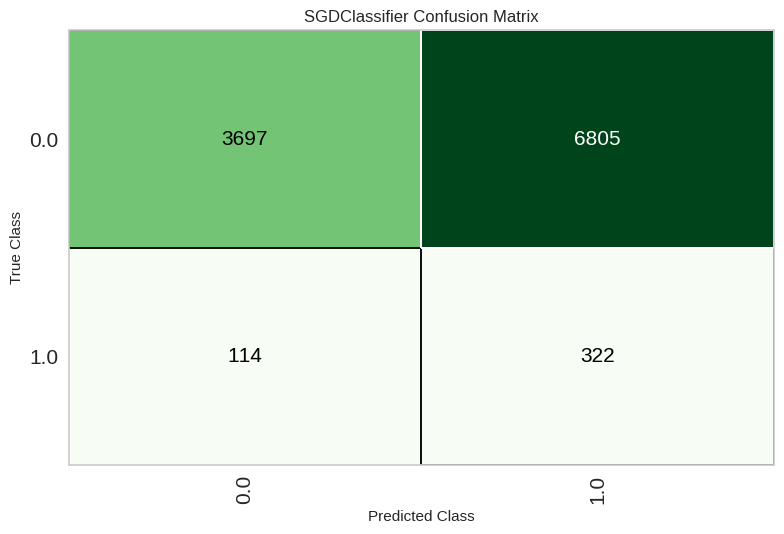

In [ ]:
svm = create_model('svm')

tuned_svm, tuner = tune_model(svm,optimize = 'eer',return_tuner=True,choose_better = True,n_iter = 50)

print(svm)
print(tuned_svm)


plot_model(tuned_svm,plot = 'confusion_matrix')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9018,0.5011,0.0621,0.0390,0.0479,-0.0010,-0.0011,0.5004
1,0.8670,0.5363,0.1862,0.0685,0.1002,0.0446,0.0512,0.4762
2,0.8777,0.4885,0.0897,0.0398,0.0551,-0.0000,-0.0000,0.5000
3,0.8176,0.4309,0.0276,0.0076,0.0119,-0.0539,-0.0678,0.5335
4,0.8214,0.4348,0.0479,0.0135,0.0211,-0.0442,-0.0552,0.5272
5,0.8176,0.4678,0.0959,0.0256,0.0404,-0.0244,-0.0310,0.5161
6,0.8124,0.4634,0.0685,0.0179,0.0284,-0.0374,-0.0480,0.5248
7,0.8134,0.5075,0.0966,0.0249,0.0395,-0.0253,-0.0326,0.5173
8,0.8239,0.5226,0.1241,0.0338,0.0531,-0.0101,-0.0127,0.5067


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9046,0.4614,0.0759,0.0489,0.0595,0.0117,0.0120,0.4960
1,0.9109,0.5812,0.1034,0.0714,0.0845,0.0393,0.0401,0.4870
2,0.8587,0.4577,0.0621,0.0232,0.0338,-0.0256,-0.0293,0.5126
3,0.8609,0.5082,0.0897,0.0335,0.0488,-0.0097,-0.0111,0.5048
4,0.8766,0.5399,0.1301,0.0556,0.0779,0.0230,0.0255,0.4894
5,0.8703,0.4224,0.0753,0.0315,0.0444,-0.0127,-0.0141,0.5058
6,0.8834,0.4614,0.0616,0.0303,0.0406,-0.0138,-0.0148,0.5056
7,0.8573,0.4703,0.0828,0.0301,0.0441,-0.0151,-0.0174,0.5077
8,0.8757,0.5635,0.1931,0.0769,0.1100,0.0563,0.0633,0.4716


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 10 candidates, totalling 100 fits


DecisionTreeClassifier(ccp_alpha=0.0, class_weight=None, criterion='gini',
                       max_depth=None, max_features=None, max_leaf_nodes=None,
                       min_impurity_decrease=0.0, min_samples_leaf=1,
                       min_samples_split=2, min_weight_fraction_leaf=0.0,
                       random_state=4209, splitter='best')
DecisionTreeClassifier(ccp_alpha=0.0, class_weight=None, criterion='entropy',
                       max_depth=15, max_features='sqrt', max_leaf_nodes=None,
                       min_impurity_decrease=0.0002, min_samples_leaf=2,
                       min_samples_split=2, min_weight_fraction_leaf=0.0,
                       random_state=4209, splitter='best')


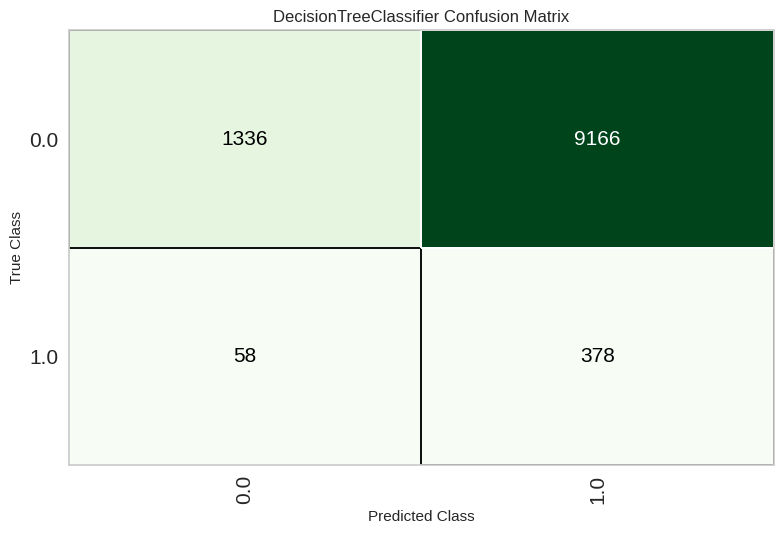

In [ ]:
dt = create_model('dt')

tuned_dt, tuner = tune_model(dt,optimize = 'eer',return_tuner=True,choose_better = True)

print(dt)
print(tuned_dt)

plot_model(tuned_dt,plot = 'confusion_matrix')


,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.6166,0.0000,0.4483,0.0470,0.0851,0.0141,0.0289,0.4694
1,0.6286,0.0000,0.3310,0.0368,0.0662,-0.0058,-0.0114,0.5107
2,0.5963,0.0000,0.4966,0.0489,0.0891,0.0180,0.0386,0.4561
3,0.5535,0.0000,0.3241,0.0298,0.0546,-0.0197,-0.0445,0.5456
4,0.6253,0.0000,0.4658,0.0501,0.0905,0.0197,0.0397,0.4581
5,0.5837,0.0000,0.4384,0.0427,0.0778,0.0052,0.0112,0.4878
6,0.5337,0.0000,0.4589,0.0397,0.0731,-0.0007,-0.0017,0.5020
7,0.6121,0.0000,0.4897,0.0503,0.0913,0.0206,0.0429,0.4526
8,0.4667,0.0000,0.5310,0.0394,0.0734,-0.0007,-0.0019,0.5023


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.6215,0.0000,0.4483,0.0476,0.0861,0.0153,0.0311,0.4674
1,0.6234,0.0000,0.3310,0.0363,0.0654,-0.0068,-0.0136,0.5128
2,0.6119,0.0000,0.4828,0.0496,0.0900,0.0193,0.0401,0.4559
3,0.5400,0.0000,0.3172,0.0283,0.0520,-0.0227,-0.0525,0.5542
4,0.6160,0.0000,0.4795,0.0502,0.0909,0.0199,0.0408,0.4557
5,0.5636,0.0000,0.4315,0.0401,0.0734,0.0001,0.0003,0.4997
6,0.5239,0.0000,0.4315,0.0367,0.0677,-0.0066,-0.0160,0.5186
7,0.6005,0.0000,0.4690,0.0470,0.0854,0.0141,0.0299,0.4670
8,0.4680,0.0000,0.5310,0.0395,0.0736,-0.0005,-0.0014,0.5017


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 10 candidates, totalling 100 fits


Original model was better than the tuned model, hence it will be returned. NOTE: The display metrics are for the tuned model (not the original one).
RidgeClassifier(alpha=1.0, class_weight=None, copy_X=True, fit_intercept=True,
                max_iter=None, positive=False, random_state=4209, solver='auto',
                tol=0.0001)
RidgeClassifier(alpha=1.0, class_weight=None, copy_X=True, fit_intercept=True,
                max_iter=None, positive=False, random_state=4209, solver='auto',
                tol=0.0001)


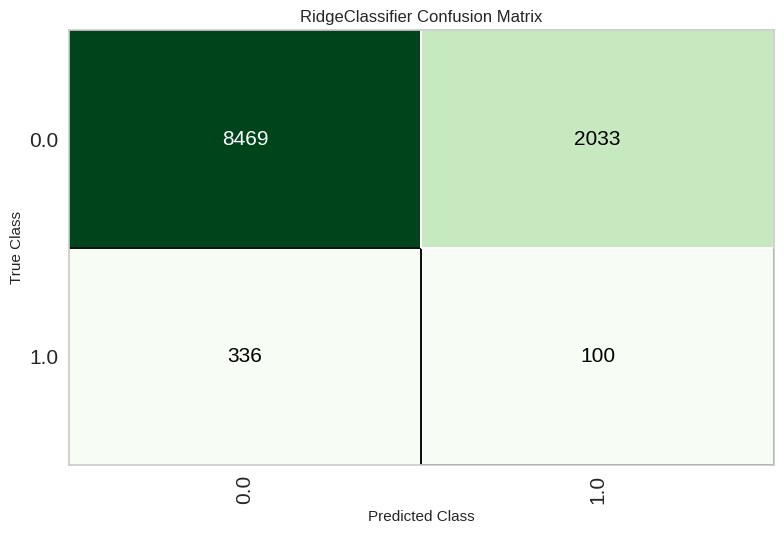

In [ ]:
ridge = create_model('ridge')

tuned_ridge, tuner = tune_model(ridge,optimize = 'eer',return_tuner=True,choose_better = True)

print(ridge)
print(tuned_ridge)

plot_model(tuned_ridge,plot = 'confusion_matrix')


,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.6146,0.5457,0.4483,0.0468,0.0847,0.0136,0.0281,0.4702
1,0.6347,0.4576,0.3310,0.0374,0.0672,-0.0046,-0.0089,0.5083
2,0.6223,0.5559,0.4690,0.0497,0.0899,0.0194,0.0394,0.4579
3,0.5436,0.4149,0.3310,0.0297,0.0545,-0.0199,-0.0459,0.5477
4,0.6160,0.5581,0.4726,0.0496,0.0897,0.0186,0.0382,0.4588
5,0.5656,0.4913,0.4315,0.0403,0.0737,0.0005,0.0010,0.4988
6,0.5293,0.4810,0.4110,0.0355,0.0654,-0.0090,-0.0215,0.5244
7,0.6107,0.5431,0.4897,0.0501,0.0910,0.0203,0.0423,0.4532
8,0.4667,0.5002,0.5448,0.0404,0.0752,0.0012,0.0032,0.4962


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.6218,0.5435,0.4621,0.0490,0.0886,0.0179,0.0365,0.4612
1,0.6377,0.4522,0.3310,0.0377,0.0677,-0.0039,-0.0076,0.5070
2,0.6039,0.5596,0.4828,0.0486,0.0884,0.0174,0.0367,0.4593
3,0.5422,0.4112,0.3517,0.0314,0.0576,-0.0166,-0.0386,0.5409
4,0.6174,0.5598,0.4863,0.0510,0.0924,0.0215,0.0441,0.4520
5,0.5639,0.4955,0.4247,0.0395,0.0723,-0.0010,-0.0022,0.5025
6,0.5392,0.4777,0.4384,0.0385,0.0708,-0.0030,-0.0072,0.5082
7,0.6241,0.5444,0.4345,0.0466,0.0842,0.0133,0.0269,0.4722
8,0.4645,0.4884,0.5310,0.0393,0.0731,-0.0010,-0.0028,0.5034


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 10 candidates, totalling 100 fits


Original model was better than the tuned model, hence it will be returned. NOTE: The display metrics are for the tuned model (not the original one).
LinearDiscriminantAnalysis(covariance_estimator=None, n_components=None,
                           priors=None, shrinkage=None, solver='svd',
                           store_covariance=False, tol=0.0001)
LinearDiscriminantAnalysis(covariance_estimator=None, n_components=None,
                           priors=None, shrinkage=None, solver='svd',
                           store_covariance=False, tol=0.0001)


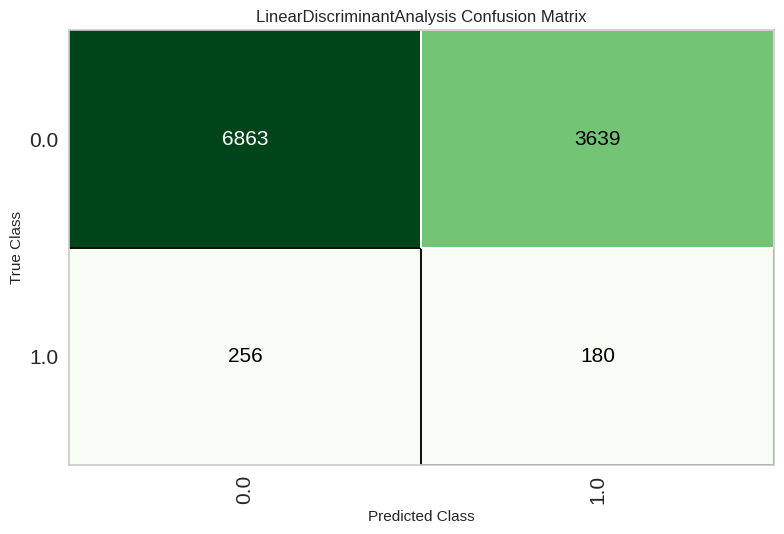

In [ ]:
lda = create_model('lda')

tuned_lda, tuner = tune_model(lda,optimize = 'eer',return_tuner=True,choose_better = True)

print(lda)
print(tuned_lda)

plot_model(tuned_lda,plot = 'confusion_matrix')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.6092,0.5385,0.4552,0.0467,0.0848,0.0136,0.0284,0.4695
1,0.6308,0.4588,0.3310,0.0370,0.0666,-0.0053,-0.0105,0.5098
2,0.6007,0.5454,0.4828,0.0482,0.0877,0.0166,0.0353,0.4607
3,0.5357,0.4121,0.3241,0.0286,0.0526,-0.0221,-0.0516,0.5539
4,0.6358,0.5672,0.4452,0.0495,0.0892,0.0184,0.0363,0.4629
5,0.5806,0.5063,0.4315,0.0417,0.0761,0.0034,0.0073,0.4921
6,0.5337,0.4841,0.4247,0.0369,0.0680,-0.0061,-0.0146,0.5166
7,0.6025,0.5404,0.4828,0.0485,0.0881,0.0170,0.0360,0.4599
8,0.4765,0.5043,0.5448,0.0411,0.0765,0.0027,0.0073,0.4913


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.6179,0.5481,0.4345,0.0459,0.0829,0.0119,0.0242,0.4748
1,0.6223,0.4618,0.3241,0.0354,0.0639,-0.0084,-0.0167,0.5157
2,0.6149,0.5553,0.4759,0.0494,0.0895,0.0188,0.0388,0.4578
3,0.5439,0.4167,0.3241,0.0292,0.0535,-0.0210,-0.0483,0.5500
4,0.6273,0.5592,0.4726,0.0511,0.0922,0.0215,0.0432,0.4542
5,0.5686,0.4978,0.4452,0.0417,0.0763,0.0034,0.0075,0.4916
6,0.5365,0.4845,0.4247,0.0372,0.0684,-0.0057,-0.0135,0.5153
7,0.6008,0.5456,0.5034,0.0501,0.0912,0.0203,0.0432,0.4508
8,0.4757,0.4939,0.5241,0.0396,0.0737,-0.0003,-0.0008,0.5010


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 10 candidates, totalling 100 fits


Original model was better than the tuned model, hence it will be returned. NOTE: The display metrics are for the tuned model (not the original one).
LogisticRegression(C=1.0, class_weight=None, dual=False, fit_intercept=True,
                   intercept_scaling=1, l1_ratio=None, max_iter=1000,
                   multi_class='auto', n_jobs=None, penalty='l2',
                   random_state=4209, solver='lbfgs', tol=0.0001, verbose=0,
                   warm_start=False)
LogisticRegression(C=1.0, class_weight=None, dual=False, fit_intercept=True,
                   intercept_scaling=1, l1_ratio=None, max_iter=1000,
                   multi_class='auto', n_jobs=None, penalty='l2',
                   random_state=4209, solver='lbfgs', tol=0.0001, verbose=0,
                   warm_start=False)


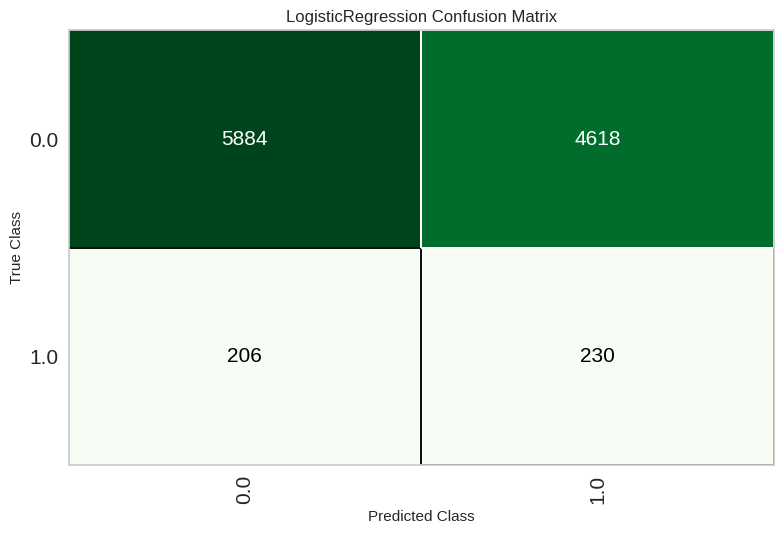

In [ ]:
lr = create_model('lr')

tuned_lr, tuner = tune_model(lr,optimize = 'eer',return_tuner=True,choose_better = True)

print(lr)
print(tuned_lr)

plot_model(tuned_lr,plot = 'confusion_matrix')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9545,0.5112,0.0276,0.1379,0.0460,0.0332,0.0450,0.4948
1,0.9405,0.5637,0.0207,0.0385,0.0269,-0.0009,-0.0010,0.5002
2,0.9523,0.4394,0.0414,0.1463,0.0645,0.0478,0.0582,0.4919
3,0.9290,0.4137,0.0069,0.0086,0.0077,-0.0287,-0.0289,0.5066
4,0.9432,0.4361,0.0137,0.0308,0.0190,-0.0059,-0.0064,0.5011
5,0.9303,0.4992,0.0137,0.0179,0.0155,-0.0200,-0.0201,0.5045
6,0.9177,0.4267,0.0137,0.0127,0.0132,-0.0297,-0.0297,0.5079
7,0.9380,0.5179,0.0759,0.1068,0.0887,0.0576,0.0585,0.4869
8,0.9254,0.5313,0.0828,0.0795,0.0811,0.0422,0.0422,0.4885


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,,
,,
Initiated,. . . . . . . . . . . . . . . . . .,01:23:32
Status,. . . . . . . . . . . . . . . . . .,Compiling Final Results
Estimator,. . . . . . . . . . . . . . . . . .,CatBoost Classifier


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 10 candidates, totalling 100 fits


Original model was better than the tuned model, hence it will be returned. NOTE: The display metrics are for the tuned model (not the original one).


,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9449,0.5266,0.0759,0.1410,0.0987,0.0729,0.0766,0.4851
1,0.9298,0.5789,0.0276,0.0336,0.0303,-0.0058,-0.0058,0.5014
2,0.9435,0.4338,0.0552,0.1039,0.0721,0.0457,0.0482,0.4908
3,0.9221,0.4490,0.0069,0.0071,0.0070,-0.0335,-0.0335,0.5085
4,0.9372,0.4611,0.0274,0.0440,0.0338,0.0031,0.0032,0.4993
5,0.9328,0.4803,0.0137,0.0194,0.0161,-0.0176,-0.0179,0.5039
6,0.9133,0.4301,0.0274,0.0225,0.0247,-0.0202,-0.0203,0.5058
7,0.9311,0.5048,0.0828,0.0923,0.0873,0.0516,0.0517,0.4870
8,0.9139,0.4945,0.0759,0.0576,0.0655,0.0212,0.0214,0.4935


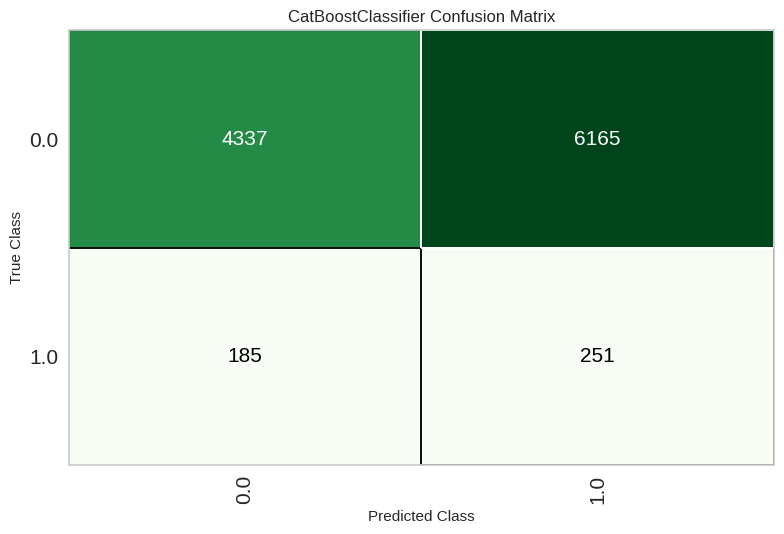

In [ ]:
cb = create_model('catboost')

tuned_cb, tuner = tune_model(cb,optimize = 'eer',return_tuner=True,choose_better = True)

print(cb)
print(tuned_cb)

plot_model(tuned_cb,plot = 'confusion_matrix')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9520,0.5319,0.0276,0.1053,0.0437,0.0277,0.0344,0.4954
1,0.9339,0.5206,0.0276,0.0385,0.0321,-0.0011,-0.0011,0.5003
2,0.9501,0.4929,0.0345,0.1064,0.0521,0.0333,0.0390,0.4942
3,0.9221,0.4227,0.0138,0.0140,0.0139,-0.0267,-0.0267,0.5068
4,0.9432,0.4777,0.0274,0.0580,0.0372,0.0118,0.0127,0.4977
5,0.9301,0.5289,0.0137,0.0177,0.0154,-0.0202,-0.0204,0.5046
6,0.9089,0.4138,0.0342,0.0255,0.0292,-0.0175,-0.0177,0.5053
7,0.9254,0.5520,0.0483,0.0496,0.0490,0.0101,0.0101,0.4974
8,0.9160,0.5409,0.0897,0.0695,0.0783,0.0351,0.0354,0.4893


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9018,0.5068,0.1379,0.0791,0.1005,0.0526,0.0549,0.4801
1,0.8777,0.5462,0.1034,0.0453,0.0630,0.0082,0.0090,0.4963
2,0.8812,0.5174,0.1241,0.0556,0.0768,0.0231,0.0252,0.4897
3,0.8094,0.4371,0.0414,0.0107,0.0170,-0.0494,-0.0636,0.5326
4,0.8390,0.4405,0.0548,0.0175,0.0265,-0.0364,-0.0435,0.5202
5,0.8332,0.4728,0.0890,0.0266,0.0410,-0.0220,-0.0269,0.5131
6,0.8184,0.4404,0.1027,0.0275,0.0434,-0.0212,-0.0269,0.5140
7,0.8499,0.5637,0.2621,0.0795,0.1220,0.0649,0.0789,0.4577
8,0.8269,0.5420,0.2552,0.0661,0.1050,0.0446,0.0573,0.4669


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 10 candidates, totalling 100 fits


XGBClassifier(base_score=None, booster='gbtree', callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, device='cpu', early_stopping_rounds=None,
              enable_categorical=False, eval_metric=None, feature_types=None,
              gamma=None, grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=None, max_bin=None,
              max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=None, max_leaves=None,
              min_child_weight=None, missing=nan, monotone_constraints=None,
              multi_strategy=None, n_estimators=None, n_jobs=-1,
              num_parallel_tree=None, objective='binary:logistic', ...)
XGBClassifier(base_score=None, booster='gbtree', callbacks=None,
              colsample_bylevel=None, colsample_bynode=None, colsample_bytree=1,
              device='cpu', early_stopping_rounds=None,
              enable_catego

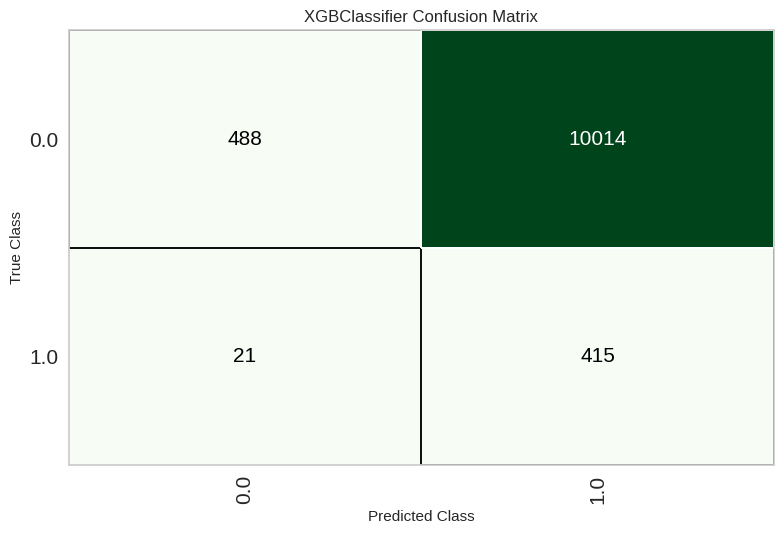

In [ ]:
xgboost = create_model('xgboost')

tuned_xgboost, tuner = tune_model(xgboost,optimize = 'eer',return_tuner=True,choose_better = True)

print(xgboost)
print(tuned_xgboost)

plot_model(tuned_xgboost,plot = 'confusion_matrix')


,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9528,0.5046,0.0345,0.1351,0.0549,0.0394,0.0494,0.4935
1,0.9484,0.5375,0.0207,0.0612,0.0309,0.0111,0.0128,0.4981
2,0.9580,0.4672,0.0207,0.2143,0.0377,0.0309,0.0554,0.4956
3,0.9391,0.4283,0.0138,0.0247,0.0177,-0.0111,-0.0116,0.5022
4,0.9515,0.4829,0.0205,0.0811,0.0328,0.0169,0.0212,0.4972
5,0.9372,0.5079,0.0000,0.0000,0.0000,-0.0299,-0.0312,0.5060
6,0.9350,0.4121,0.0000,0.0000,0.0000,-0.0317,-0.0327,0.5066
7,0.9410,0.5091,0.0207,0.0395,0.0271,-0.0002,-0.0002,0.5000
8,0.9303,0.5269,0.0414,0.0496,0.0451,0.0093,0.0093,0.4978


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9580,0.5679,0.0276,0.2500,0.0497,0.0421,0.0714,0.4939
1,0.9443,0.5766,0.0276,0.0606,0.0379,0.0134,0.0145,0.4975
2,0.9542,0.5047,0.0345,0.1562,0.0565,0.0427,0.0561,0.4932
3,0.9383,0.4282,0.0276,0.0455,0.0343,0.0044,0.0046,0.4991
4,0.9462,0.4606,0.0205,0.0536,0.0297,0.0077,0.0086,0.4986
5,0.9430,0.4944,0.0205,0.0441,0.0280,0.0027,0.0029,0.4995
6,0.9251,0.4245,0.0205,0.0226,0.0215,-0.0173,-0.0174,0.5043
7,0.9353,0.5312,0.0552,0.0748,0.0635,0.0307,0.0311,0.4930
8,0.9281,0.5557,0.0759,0.0791,0.0775,0.0401,0.0401,0.4896


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 10 candidates, totalling 100 fits


LGBMClassifier(boosting_type='gbdt', class_weight=None, colsample_bytree=1.0,
               importance_type='split', learning_rate=0.1, max_depth=-1,
               min_child_samples=20, min_child_weight=0.001, min_split_gain=0.0,
               n_estimators=100, n_jobs=-1, num_leaves=31, objective=None,
               random_state=5742, reg_alpha=0.0, reg_lambda=0.0, subsample=1.0,
               subsample_for_bin=200000, subsample_freq=0)
LGBMClassifier(bagging_fraction=0.7, bagging_freq=5, boosting_type='gbdt',
               class_weight=None, colsample_bytree=1.0, feature_fraction=0.5,
               importance_type='split', learning_rate=0.05, max_depth=-1,
               min_child_samples=41, min_child_weight=0.001, min_split_gain=0.9,
               n_estimators=300, n_jobs=-1, num_leaves=256, objective=None,
               random_state=5742, reg_alpha=0.05, reg_lambda=0.005,
               subsample=1.0, subsample_for_bin=200000, subsample_freq=0)


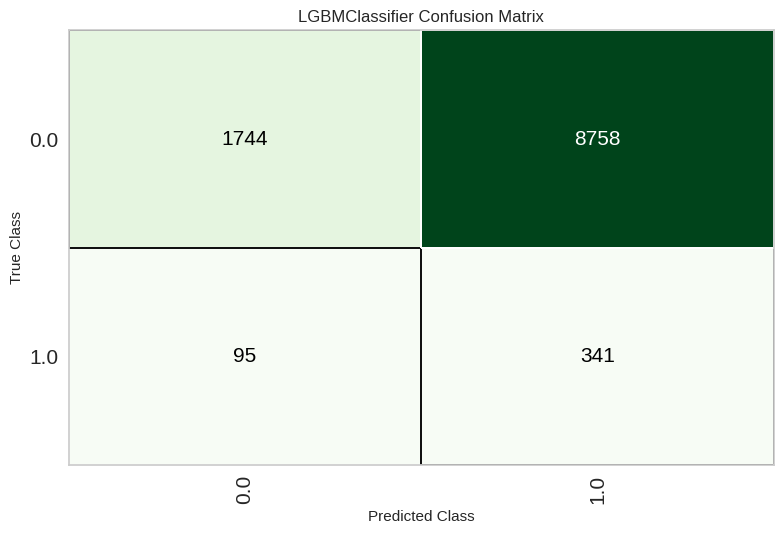

In [ ]:
lightgbm = create_model('lightgbm')

tuned_lightgbm, tuner = tune_model(lightgbm,optimize = 'eer',return_tuner=True,choose_better = True)

print(lightgbm)
print(tuned_lightgbm)

plot_model(tuned_lightgbm,plot = 'confusion_matrix')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9361,0.5113,0.0276,0.0417,0.0332,0.0016,0.0016,0.4997
1,0.9465,0.4745,0.0069,0.0192,0.0102,-0.0111,-0.0126,0.5019
2,0.9438,0.4862,0.0069,0.0161,0.0097,-0.0145,-0.0159,0.5027
3,0.9180,0.4655,0.0414,0.0361,0.0386,-0.0040,-0.0041,0.5011
4,0.9391,0.4968,0.0411,0.0682,0.0513,0.0218,0.0226,0.4954
5,0.9276,0.5101,0.0548,0.0597,0.0571,0.0196,0.0196,0.4951
6,0.9339,0.4282,0.0068,0.0103,0.0082,-0.0245,-0.0251,0.5052
7,0.9306,0.4962,0.0966,0.1029,0.0996,0.0636,0.0636,0.4835
8,0.9078,0.4696,0.0345,0.0249,0.0289,-0.0182,-0.0184,0.5056


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.6604,0.5179,0.3724,0.0450,0.0802,0.0100,0.0186,0.4828
1,0.7095,0.4982,0.3034,0.0439,0.0767,0.0078,0.0130,0.4895
2,0.7276,0.6241,0.5310,0.0768,0.1343,0.0696,0.1168,0.3893
3,0.5883,0.4028,0.1586,0.0164,0.0297,-0.0456,-0.0945,0.5813
4,0.7702,0.6350,0.5274,0.0910,0.1552,0.0933,0.1429,0.3772
5,0.6503,0.5256,0.4041,0.0473,0.0847,0.0140,0.0267,0.4743
6,0.5716,0.5207,0.5068,0.0473,0.0865,0.0144,0.0321,0.4620
7,0.6384,0.5112,0.3793,0.0429,0.0770,0.0060,0.0116,0.4888
8,0.5309,0.5178,0.5310,0.0448,0.0826,0.0100,0.0242,0.4691


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 10 candidates, totalling 100 fits


AdaBoostClassifier(algorithm='SAMME.R', base_estimator='deprecated',
                   estimator=None, learning_rate=1.0, n_estimators=50,
                   random_state=5742)
AdaBoostClassifier(algorithm='SAMME', base_estimator='deprecated',
                   estimator=None, learning_rate=0.005, n_estimators=190,
                   random_state=5742)


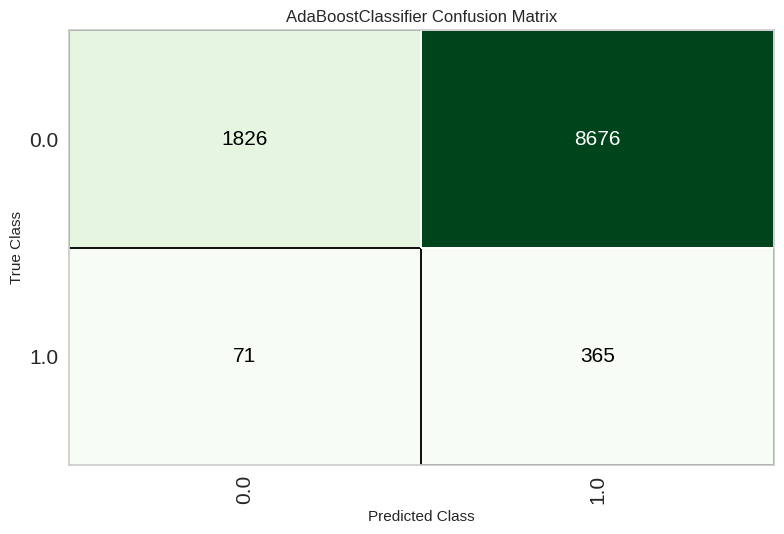

In [ ]:

adaboost = create_model('ada')

tuned_ada, tuner = tune_model(adaboost,optimize = 'eer',return_tuner=True,choose_better = True)

print(adaboost)
print(tuned_ada)

plot_model(tuned_ada,plot = 'confusion_matrix')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.0428,0.5016,1.0000,0.0399,0.0767,0.0003,0.0112,0.4992
1,0.0400,0.5001,1.0000,0.0398,0.0765,0.0000,0.0034,0.4999
2,0.0398,0.5000,1.0000,0.0398,0.0765,0.0000,0.0000,0.5000
3,0.0436,0.5020,1.0000,0.0399,0.0768,0.0003,0.0126,0.4990
4,0.0422,0.5011,1.0000,0.0401,0.0772,0.0002,0.0096,0.4994
5,0.0403,0.5001,1.0000,0.0401,0.0770,0.0000,0.0034,0.4999
6,0.0406,0.5003,1.0000,0.0401,0.0770,0.0000,0.0048,0.4999
7,0.0398,0.5000,1.0000,0.0398,0.0765,0.0000,0.0000,0.5000
8,0.0398,0.5000,1.0000,0.0398,0.0765,0.0000,0.0000,0.5000


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.0428,0.5016,1.0000,0.0399,0.0767,0.0003,0.0112,0.4992
1,0.0400,0.5001,1.0000,0.0398,0.0765,0.0000,0.0034,0.4999
2,0.0398,0.5000,1.0000,0.0398,0.0765,0.0000,0.0000,0.5000
3,0.0436,0.5020,1.0000,0.0399,0.0768,0.0003,0.0126,0.4990
4,0.0422,0.5011,1.0000,0.0401,0.0772,0.0002,0.0096,0.4994
5,0.0403,0.5001,1.0000,0.0401,0.0770,0.0000,0.0034,0.4999
6,0.0406,0.5003,1.0000,0.0401,0.0770,0.0000,0.0048,0.4999
7,0.0398,0.5000,1.0000,0.0398,0.0765,0.0000,0.0000,0.5000
8,0.0398,0.5000,1.0000,0.0398,0.0765,0.0000,0.0000,0.5000


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 10 candidates, totalling 100 fits


Original model was better than the tuned model, hence it will be returned. NOTE: The display metrics are for the tuned model (not the original one).
QuadraticDiscriminantAnalysis(priors=None, reg_param=0.0,
                              store_covariance=False, tol=0.0001)
QuadraticDiscriminantAnalysis(priors=None, reg_param=0.0,
                              store_covariance=False, tol=0.0001)


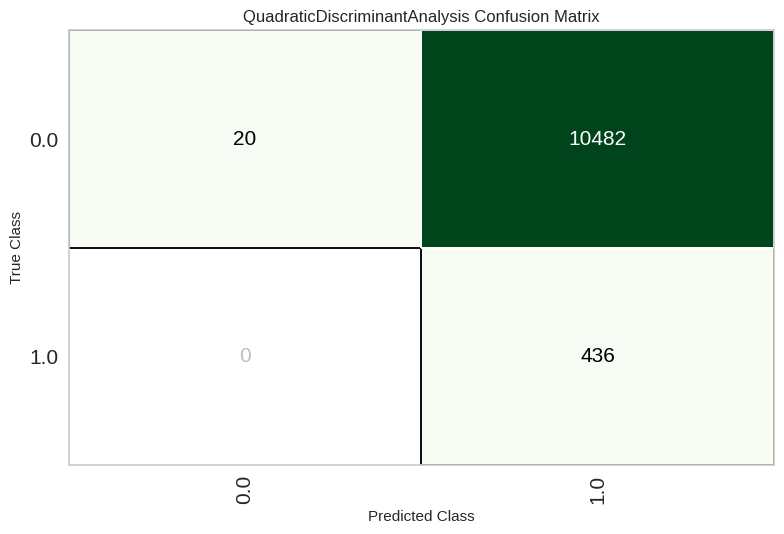

In [ ]:

qda = create_model('qda')

tuned_qda, tuner = tune_model(qda,optimize = 'eer',return_tuner=True,choose_better = True)

print(qda)
print(tuned_qda)

plot_model(tuned_qda,plot = 'confusion_matrix')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9583,0.4966,0.0000,0.0000,0.0000,-0.0037,-0.0089,0.5005
1,0.9534,0.5132,0.0000,0.0000,0.0000,-0.0118,-0.0169,0.5018
2,0.9578,0.4525,0.0138,0.1538,0.0253,0.0189,0.0349,0.4973
3,0.9542,0.4554,0.0000,0.0000,0.0000,-0.0106,-0.0159,0.5016
4,0.9580,0.4945,0.0137,0.1818,0.0255,0.0200,0.0398,0.4972
5,0.9528,0.5284,0.0000,0.0000,0.0000,-0.0123,-0.0173,0.5019
6,0.9523,0.4167,0.0000,0.0000,0.0000,-0.0131,-0.0180,0.5020
7,0.9545,0.5199,0.0207,0.1111,0.0349,0.0227,0.0315,0.4965
8,0.9487,0.4860,0.0138,0.0435,0.0209,0.0018,0.0021,0.4997


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.7005,0.5366,0.3586,0.0495,0.0870,0.0183,0.0316,0.4730
1,0.7597,0.4882,0.1931,0.0356,0.0601,-0.0076,-0.0113,0.5074
2,0.7309,0.6054,0.4690,0.0700,0.1218,0.0564,0.0931,0.4172
3,0.5883,0.3824,0.1586,0.0164,0.0297,-0.0456,-0.0945,0.5813
4,0.3834,0.5303,0.6849,0.0434,0.0817,0.0069,0.0227,0.4788
5,0.6369,0.4958,0.3425,0.0391,0.0702,-0.0018,-0.0034,0.5032
6,0.5576,0.5136,0.4658,0.0424,0.0778,0.0047,0.0107,0.4876
7,0.6798,0.5391,0.3862,0.0494,0.0876,0.0183,0.0330,0.4701
8,0.5325,0.4954,0.4552,0.0390,0.0719,-0.0015,-0.0036,0.5042


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 10 candidates, totalling 100 fits


GradientBoostingClassifier(ccp_alpha=0.0, criterion='friedman_mse', init=None,
                           learning_rate=0.1, loss='log_loss', max_depth=3,
                           max_features=None, max_leaf_nodes=None,
                           min_impurity_decrease=0.0, min_samples_leaf=1,
                           min_samples_split=2, min_weight_fraction_leaf=0.0,
                           n_estimators=100, n_iter_no_change=None,
                           random_state=5742, subsample=1.0, tol=0.0001,
                           validation_fraction=0.1, verbose=0,
                           warm_start=False)
GradientBoostingClassifier(ccp_alpha=0.0, criterion='friedman_mse', init=None,
                           learning_rate=1e-07, loss='log_loss', max_depth=1,
                           max_features=1.0, max_leaf_nodes=None,
                           min_impurity_decrease=0, min_samples_leaf=2,
                           min_samples_split=5, min_weight_fraction_leaf=0.0,
    

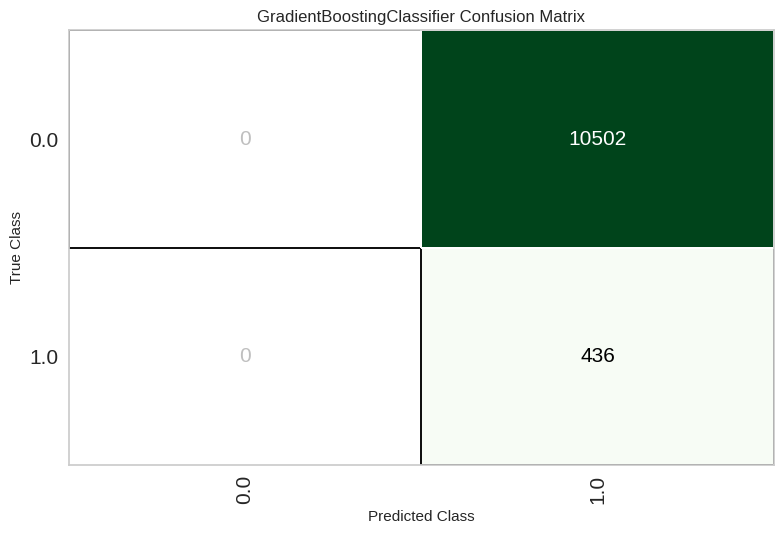

In [ ]:

gbc = create_model('gbc')

tuned_gbc, tuner = tune_model(gbc,optimize = 'eer',return_tuner=True,choose_better = True)

print(gbc)
print(tuned_gbc)

plot_model(tuned_gbc,plot = 'confusion_matrix')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9375,0.4539,0.0414,0.0632,0.0500,0.0191,0.0196,0.4959
1,0.9246,0.4265,0.0483,0.0486,0.0484,0.0092,0.0092,0.4976
2,0.9240,0.3912,0.0828,0.0769,0.0797,0.0402,0.0402,0.4889
3,0.8667,0.1913,0.0138,0.0058,0.0082,-0.0507,-0.0562,0.5223
4,0.8788,0.2261,0.0411,0.0195,0.0264,-0.0295,-0.0319,0.5121
5,0.8793,0.2350,0.0342,0.0164,0.0222,-0.0337,-0.0363,0.5136
6,0.8623,0.2696,0.0548,0.0215,0.0309,-0.0283,-0.0319,0.5134
7,0.8798,0.3699,0.0690,0.0319,0.0437,-0.0113,-0.0123,0.5048
8,0.8867,0.4584,0.1034,0.0503,0.0677,0.0150,0.0161,0.4938


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9501,0.5044,0.0345,0.1064,0.0521,0.0333,0.0390,0.4942
1,0.9542,0.5625,0.0000,0.0000,0.0000,-0.0106,-0.0159,0.5016
2,0.9569,0.5136,0.0138,0.1250,0.0248,0.0171,0.0290,0.4975
3,0.9369,0.4111,0.0138,0.0225,0.0171,-0.0136,-0.0140,0.5028
4,0.9547,0.5421,0.0137,0.0870,0.0237,0.0129,0.0191,0.4981
5,0.9545,0.5438,0.0000,0.0000,0.0000,-0.0097,-0.0152,0.5014
6,0.9355,0.4644,0.0205,0.0316,0.0249,-0.0069,-0.0071,0.5015
7,0.9523,0.4965,0.0276,0.1081,0.0440,0.0282,0.0354,0.4954
8,0.9095,0.4732,0.0621,0.0443,0.0517,0.0056,0.0057,0.4982


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 10 candidates, totalling 100 fits


RandomForestClassifier(bootstrap=True, ccp_alpha=0.0, class_weight=None,
                       criterion='gini', max_depth=None, max_features='sqrt',
                       max_leaf_nodes=None, max_samples=None,
                       min_impurity_decrease=0.0, min_samples_leaf=1,
                       min_samples_split=2, min_weight_fraction_leaf=0.0,
                       n_estimators=100, n_jobs=-1, oob_score=False,
                       random_state=4209, verbose=0, warm_start=False)
RandomForestClassifier(bootstrap=True, ccp_alpha=0.0,
                       class_weight='balanced_subsample', criterion='entropy',
                       max_depth=9, max_features='log2', max_leaf_nodes=None,
                       max_samples=None, min_impurity_decrease=0.002,
                       min_samples_leaf=5, min_samples_split=5,
                       min_weight_fraction_leaf=0.0, n_estimators=20, n_jobs=-1,
                       oob_score=False, random_state=4209, verbose=0,
       

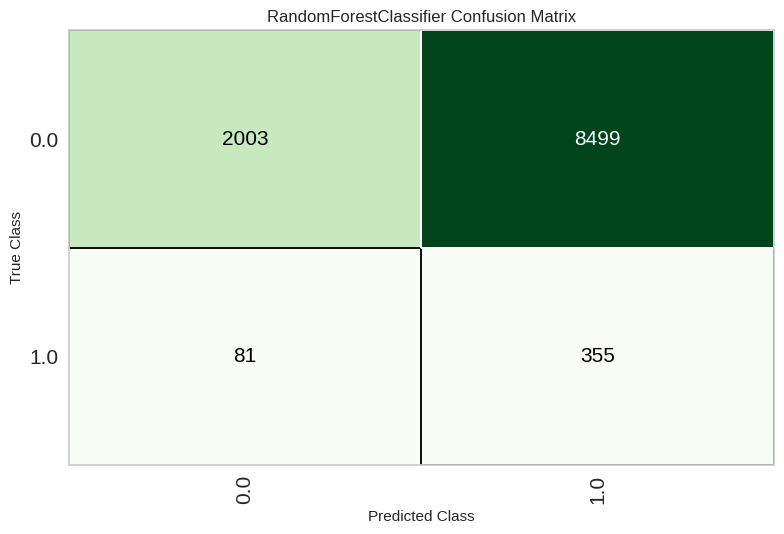

In [ ]:
rf = create_model('rf')

tuned_rf, tuner = tune_model(rf,optimize = 'eer',return_tuner=True,choose_better = True)

print(rf)
print(tuned_rf)

plot_model(tuned_rf,plot = 'confusion_matrix')


,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9342,0.4243,0.0483,0.0642,0.0551,0.0217,0.0220,0.4950
1,0.9221,0.3888,0.0483,0.0458,0.0470,0.0064,0.0064,0.4983
2,0.9136,0.3040,0.0828,0.0619,0.0708,0.0265,0.0268,0.4918
3,0.8629,0.1493,0.0207,0.0083,0.0119,-0.0476,-0.0534,0.5217
4,0.8749,0.1664,0.0205,0.0095,0.0130,-0.0442,-0.0480,0.5182
5,0.8747,0.1997,0.0342,0.0156,0.0214,-0.0356,-0.0388,0.5149
6,0.8601,0.2055,0.0548,0.0211,0.0304,-0.0291,-0.0330,0.5140
7,0.8749,0.3154,0.0690,0.0302,0.0420,-0.0141,-0.0155,0.5062
8,0.8727,0.4216,0.1034,0.0430,0.0607,0.0048,0.0053,0.4978


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.7082,0.5097,0.3241,0.0464,0.0812,0.0125,0.0210,0.4828
1,0.7606,0.5036,0.2138,0.0392,0.0663,-0.0010,-0.0014,0.5010
2,0.7713,0.5894,0.4207,0.0752,0.1276,0.0645,0.0970,0.4244
3,0.6155,0.3943,0.1517,0.0169,0.0304,-0.0443,-0.0871,0.5720
4,0.7921,0.6043,0.2534,0.0539,0.0889,0.0245,0.0341,0.4782
5,0.6594,0.5182,0.3836,0.0464,0.0827,0.0121,0.0227,0.4789
6,0.5653,0.5345,0.5000,0.0461,0.0843,0.0119,0.0269,0.4682
7,0.6582,0.5298,0.3448,0.0416,0.0743,0.0036,0.0066,0.4940
8,0.5449,0.4978,0.4414,0.0390,0.0716,-0.0016,-0.0037,0.5043


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 10 candidates, totalling 100 fits


ExtraTreesClassifier(bootstrap=False, ccp_alpha=0.0, class_weight=None,
                     criterion='gini', max_depth=None, max_features='sqrt',
                     max_leaf_nodes=None, max_samples=None,
                     min_impurity_decrease=0.0, min_samples_leaf=1,
                     min_samples_split=2, min_weight_fraction_leaf=0.0,
                     n_estimators=100, n_jobs=-1, oob_score=False,
                     random_state=4209, verbose=0, warm_start=False)
ExtraTreesClassifier(bootstrap=True, ccp_alpha=0.0, class_weight={},
                     criterion='gini', max_depth=2, max_features='log2',
                     max_leaf_nodes=None, max_samples=None,
                     min_impurity_decrease=0.01, min_samples_leaf=5,
                     min_samples_split=9, min_weight_fraction_leaf=0.0,
                     n_estimators=160, n_jobs=-1, oob_score=False,
                     random_state=4209, verbose=0, warm_start=False)


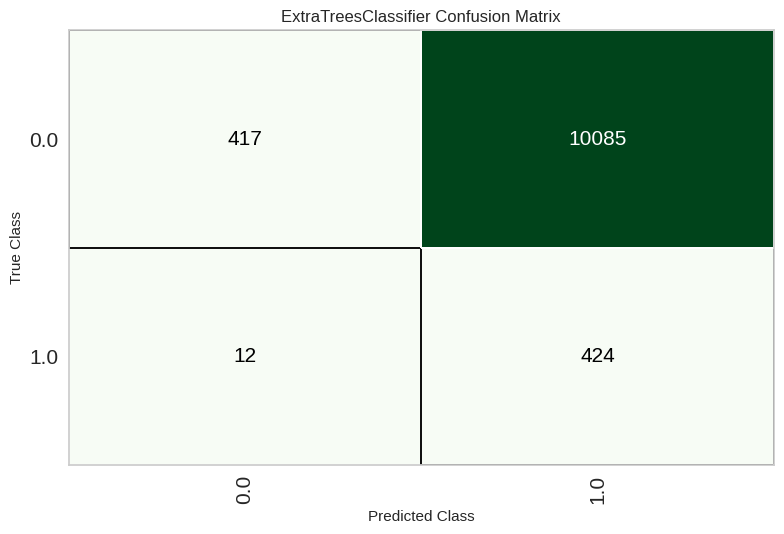

In [ ]:
et = create_model('et')

tuned_et, tuner = tune_model(et,optimize = 'eer',return_tuner=True,choose_better = True)

print(et)
print(tuned_et)

plot_model(tuned_et,plot = 'confusion_matrix')


,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.1114,0.5058,0.9172,0.0396,0.0759,-0.0004,-0.0035,0.5013
1,0.0719,0.4832,0.9379,0.0387,0.0744,-0.0022,-0.0270,0.5069
2,0.0812,0.4160,0.9379,0.0391,0.0751,-0.0014,-0.0152,0.5043
3,0.0724,0.4866,0.9724,0.0401,0.0770,0.0006,0.0080,0.4981
4,0.0713,0.5117,0.9863,0.0408,0.0784,0.0016,0.0215,0.4950
5,0.0812,0.5166,0.9589,0.0402,0.0771,0.0003,0.0033,0.4991
6,0.0710,0.3771,0.9178,0.0382,0.0733,-0.0039,-0.0479,0.5123
7,0.0823,0.5389,0.9724,0.0405,0.0778,0.0015,0.0169,0.4954
8,0.0683,0.4537,0.9862,0.0404,0.0777,0.0014,0.0190,0.4958


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.1114,0.5051,0.9172,0.0396,0.0759,-0.0004,-0.0035,0.5013
1,0.0664,0.4812,0.9379,0.0385,0.0740,-0.0026,-0.0355,0.5083
2,0.0757,0.4191,0.9448,0.0392,0.0752,-0.0013,-0.0154,0.5041
3,0.0743,0.4911,0.9724,0.0401,0.0771,0.0008,0.0099,0.4975
4,0.0837,0.5071,0.9795,0.0411,0.0789,0.0022,0.0243,0.4933
5,0.0839,0.5216,0.9521,0.0400,0.0768,-0.0000,-0.0002,0.5001
6,0.0628,0.3727,0.9384,0.0386,0.0742,-0.0029,-0.0422,0.5092
7,0.0837,0.5406,0.9724,0.0406,0.0779,0.0016,0.0180,0.4950
8,0.0804,0.4552,0.9724,0.0404,0.0776,0.0013,0.0153,0.4959


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 10 candidates, totalling 100 fits


GaussianNB(priors=None, var_smoothing=1e-09)
GaussianNB(priors=None, var_smoothing=1e-09)


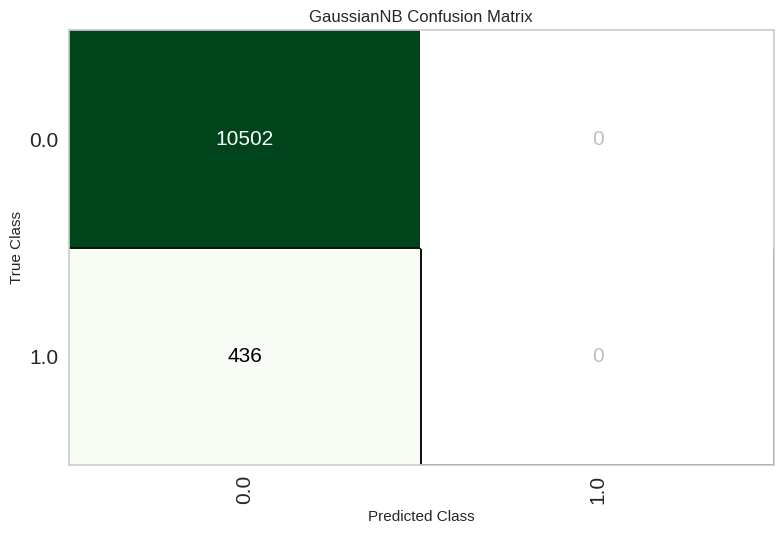

In [ ]:
nb = create_model('nb')

tuned_nb, tuner = tune_model(nb,optimize = 'eer',return_tuner=True,choose_better = True)

print(nb)
print(tuned_nb)

plot_model(tuned_nb,plot = 'confusion_matrix')


,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.8546,0.4942,0.1103,0.0384,0.0569,-0.0022,-0.0026,0.5012
1,0.8393,0.4539,0.0966,0.0299,0.0456,-0.0161,-0.0195,0.5094
2,0.8618,0.4790,0.1172,0.0433,0.0632,0.0054,0.0062,0.4972
3,0.8102,0.4102,0.0414,0.0107,0.0170,-0.0492,-0.0632,0.5324
4,0.8086,0.4217,0.0411,0.0106,0.0169,-0.0499,-0.0642,0.5329
5,0.8044,0.4586,0.0685,0.0170,0.0273,-0.0394,-0.0514,0.5273
6,0.7751,0.4237,0.0890,0.0186,0.0307,-0.0381,-0.0534,0.5313
7,0.8077,0.5130,0.1172,0.0288,0.0463,-0.0188,-0.0247,0.5135
8,0.8000,0.5213,0.1931,0.0438,0.0713,0.0069,0.0094,0.4944


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.8681,0.5069,0.0828,0.0333,0.0475,-0.0097,-0.0109,0.5046
1,0.8497,0.4622,0.1172,0.0389,0.0584,-0.0014,-0.0016,0.5008
2,0.8804,0.5007,0.1310,0.0578,0.0802,0.0264,0.0290,0.4881
3,0.8426,0.5005,0.0966,0.0306,0.0465,-0.0148,-0.0177,0.5084
4,0.8673,0.4588,0.0753,0.0306,0.0435,-0.0143,-0.0160,0.5067
5,0.8483,0.4781,0.0890,0.0300,0.0449,-0.0159,-0.0188,0.5086
6,0.7924,0.4552,0.1301,0.0293,0.0478,-0.0188,-0.0256,0.5148
7,0.8532,0.5468,0.1862,0.0608,0.0917,0.0337,0.0401,0.4802
8,0.8112,0.5016,0.1448,0.0359,0.0575,-0.0066,-0.0087,0.5048


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 10 candidates, totalling 100 fits


KNeighborsClassifier(algorithm='auto', leaf_size=30, metric='minkowski',
                     metric_params=None, n_jobs=-1, n_neighbors=5, p=2,
                     weights='uniform')
KNeighborsClassifier(algorithm='auto', leaf_size=30, metric='manhattan',
                     metric_params=None, n_jobs=-1, n_neighbors=21, p=2,
                     weights='uniform')


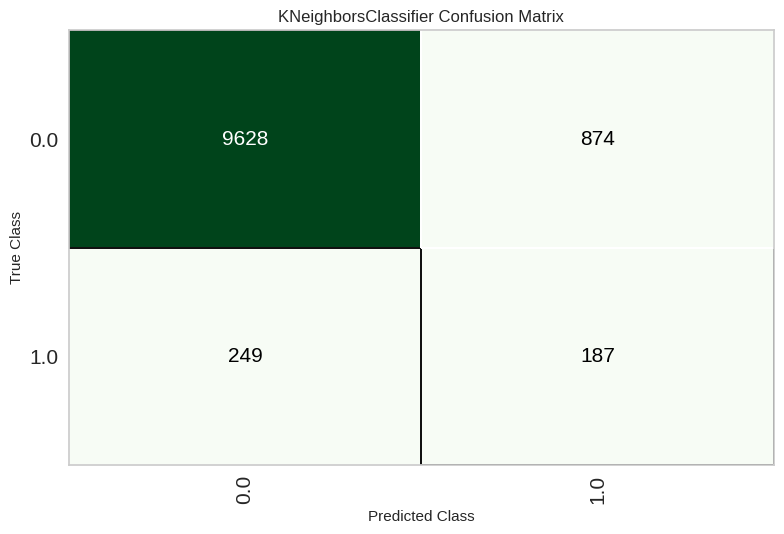

In [ ]:
knn = create_model('knn')

tuned_knn, tuner = tune_model(knn,optimize = 'eer',return_tuner=True,choose_better = True)

print(knn)
print(tuned_knn)

plot_model(tuned_knn,plot = 'confusion_matrix')

## Smote Tomek

In [ ]:
import imblearn
from imblearn.combine import SMOTETomek
svm = SMOTETomek(random_state=0)
svmsmote = setup(df,test_data = test_data, target = 'STATUS',normalize = True,ignore_features = ['ID'],fix_imbalance = True,fix_imbalance_method = svm,index=False)
add_metric('eer', 'eer', calculate_eer,greater_is_better=False)

,Description,Value
0,Session id,6146
1,Target,STATUS
2,Target type,Binary
3,Original data shape,"(47395, 52)"
4,Transformed data shape,"(80908, 51)"
5,Transformed train set shape,"(69970, 51)"
6,Transformed test set shape,"(10938, 51)"
7,Ignore features,1
8,Numeric features,50
9,Rows with missing values,23.1%


Name                                                               eer
Display Name                                                       eer
Score Function       <pycaret.internal.metrics.EncodedDecodedLabels...
Scorer               make_scorer(calculate_eer, greater_is_better=F...
Target                                                            pred
Args                                                                {}
Greater is Better                                                False
Multiclass                                                        True
Custom                                                            True
Name: eer, dtype: object

In [ ]:
best = compare_models(sort='eer')

,,
,,
Initiated,. . . . . . . . . . . . . . . . . .,18:18:06
Status,. . . . . . . . . . . . . . . . . .,Fitting 10 Folds
Estimator,. . . . . . . . . . . . . . . . . .,Linear Discriminant Analysis


,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer,TT (Sec)
ridge,Ridge Classifier,0.5767,0.0000,0.4652,0.0442,0.0807,0.0086,0.0186,0.4776,31.6150
lr,Logistic Regression,0.5744,0.5194,0.4577,0.0434,0.0792,0.0070,0.0148,0.4822,33.7540
svm,SVM - Linear Kernel,0.5721,0.0000,0.4501,0.0422,0.0770,0.0046,0.0107,0.4859,33.2160
ada,Ada Boost Classifier,0.9435,0.4900,0.0289,0.0652,0.0382,0.0140,0.0159,0.4973,35.6310
qda,Quadratic Discriminant Analysis,0.0410,0.5006,1.0000,0.0399,0.0767,0.0001,0.0053,0.4997,32.1660
gbc,Gradient Boosting Classifier,0.9570,0.4814,0.0034,0.1486,0.0063,0.0004,0.0089,0.5000,49.7160
rf,Random Forest Classifier,0.8912,0.3534,0.0654,0.0405,0.0471,-0.0029,-0.0038,0.5023,40.3380
nb,Naive Bayes,0.0794,0.4744,0.9415,0.0393,0.0754,-0.0012,-0.0150,0.5041,31.7570
dt,Decision Tree Classifier,0.8317,0.4858,0.0944,0.0292,0.0438,-0.0182,-0.0234,0.5117,32.4870
knn,K Neighbors Classifier,0.7946,0.4694,0.1164,0.0270,0.0435,-0.0225,-0.0309,0.5174,35.9400


Processing:   0%|          | 0/69 [00:00<?, ?it/s]

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer,TT (Sec)
ridge,Ridge Classifier,0.5767,0.0000,0.4652,0.0442,0.0807,0.0086,0.0186,0.4776,31.6150
lda,Linear Discriminant Analysis,0.5768,0.5180,0.4556,0.0434,0.0792,0.0069,0.0149,0.4820,32.5490
lr,Logistic Regression,0.5744,0.5194,0.4577,0.0434,0.0792,0.0070,0.0148,0.4822,33.7540
svm,SVM - Linear Kernel,0.5721,0.0000,0.4501,0.0422,0.0770,0.0046,0.0107,0.4859,33.2160
catboost,CatBoost Classifier,0.9370,0.4995,0.0441,0.0687,0.0506,0.0208,0.0222,0.4951,77.8610
xgboost,Extreme Gradient Boosting,0.9330,0.5153,0.0462,0.0670,0.0507,0.0183,0.0200,0.4957,35.3800
ada,Ada Boost Classifier,0.9435,0.4900,0.0289,0.0652,0.0382,0.0140,0.0159,0.4973,35.6310
qda,Quadratic Discriminant Analysis,0.0410,0.5006,1.0000,0.0399,0.0767,0.0001,0.0053,0.4997,32.1660
gbc,Gradient Boosting Classifier,0.9570,0.4814,0.0034,0.1486,0.0063,0.0004,0.0089,0.5000,49.7160
dummy,Dummy Classifier,0.9601,0.5000,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000,31.7430


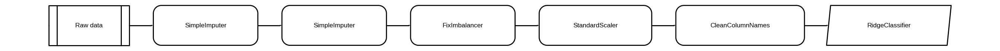

In [ ]:
evaluate_model(best)

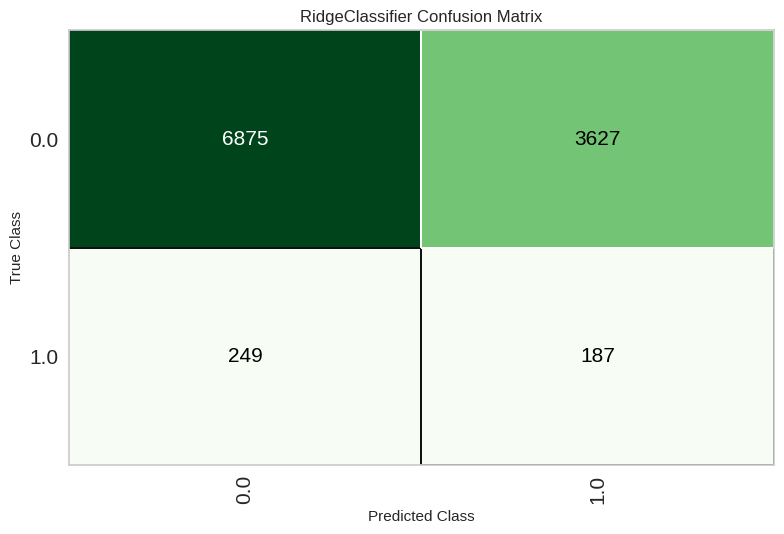

In [ ]:
plot_model(best,plot = 'confusion_matrix')

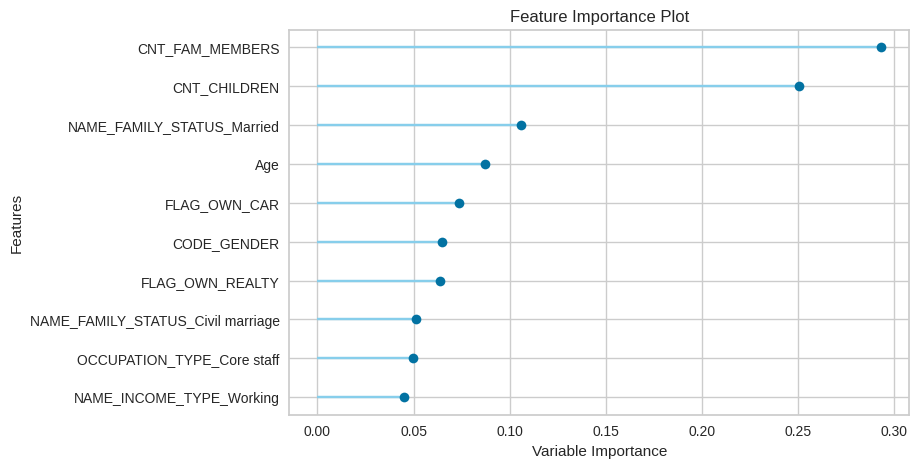

In [ ]:
plot_model(best,plot = 'feature')

### Models confusion matrix after smote tomek

In [ ]:
dt = create_model('dt')
svm = create_model('svm')
rf = create_model('rf')
et = create_model('et')
catboost = create_model('catboost')
knn = create_model('knn')
lightgbm = create_model('lightgbm')
qda = create_model('qda')
lda = create_model('lda')
gbc = create_model('gbc')
xgboost = create_model('xgboost')
nb = create_model('nb')
lr = create_model('lr')
ridge = create_model('ridge')
ada = create_model('ada')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.8985,0.5247,0.0690,0.0408,0.0513,0.0014,0.0014,0.4995
1,0.8618,0.4848,0.1034,0.0386,0.0562,-0.0019,-0.0021,0.5009
2,0.8697,0.4964,0.1103,0.0442,0.0631,0.0067,0.0075,0.4968
3,0.7937,0.4041,0.0414,0.0097,0.0157,-0.0521,-0.0696,0.5375
4,0.7913,0.4096,0.0342,0.0080,0.0130,-0.0556,-0.0743,0.5399
5,0.8220,0.4509,0.0479,0.0135,0.0211,-0.0441,-0.0549,0.5271
6,0.8116,0.4380,0.0548,0.0144,0.0228,-0.0435,-0.0556,0.5285
7,0.8118,0.5008,0.0897,0.0229,0.0365,-0.0287,-0.0370,0.5196
8,0.8258,0.5308,0.1103,0.0307,0.0480,-0.0152,-0.0191,0.5098


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.5337,0.0000,0.4621,0.0397,0.0731,-0.0002,-0.0005,0.5006
1,0.6168,0.0000,0.3931,0.0417,0.0754,0.0038,0.0078,0.4922
2,0.5617,0.0000,0.5034,0.0457,0.0837,0.0116,0.0266,0.4681
3,0.5609,0.0000,0.3655,0.0339,0.0621,-0.0115,-0.0259,0.5272
4,0.5957,0.0000,0.4658,0.0464,0.0845,0.0126,0.0268,0.4705
5,0.5880,0.0000,0.4589,0.0450,0.0819,0.0097,0.0209,0.4769
6,0.4602,0.0000,0.5479,0.0404,0.0752,0.0006,0.0018,0.4979
7,0.6038,0.0000,0.5103,0.0511,0.0930,0.0223,0.0472,0.4462
8,0.4985,0.0000,0.5310,0.0419,0.0777,0.0043,0.0110,0.4864


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9399,0.4618,0.0414,0.0698,0.0519,0.0230,0.0239,0.4952
1,0.9248,0.4381,0.0552,0.0552,0.0552,0.0160,0.0160,0.4958
2,0.9243,0.4006,0.0897,0.0828,0.0861,0.0467,0.0467,0.4870
3,0.8645,0.1992,0.0138,0.0057,0.0080,-0.0512,-0.0571,0.5229
4,0.8782,0.2182,0.0342,0.0162,0.0220,-0.0342,-0.0369,0.5139
5,0.8796,0.2385,0.0342,0.0165,0.0223,-0.0336,-0.0361,0.5135
6,0.8629,0.2827,0.0548,0.0216,0.0310,-0.0280,-0.0316,0.5132
7,0.8785,0.3721,0.0759,0.0344,0.0473,-0.0079,-0.0086,0.5034
8,0.8870,0.4412,0.0966,0.0475,0.0636,0.0109,0.0117,0.4955


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9344,0.4360,0.0483,0.0648,0.0553,0.0221,0.0224,0.4949
1,0.9180,0.3964,0.0483,0.0417,0.0447,0.0021,0.0021,0.4994
2,0.9147,0.3061,0.0828,0.0632,0.0716,0.0278,0.0281,0.4914
3,0.8618,0.1638,0.0138,0.0055,0.0079,-0.0519,-0.0583,0.5237
4,0.8733,0.1697,0.0411,0.0183,0.0253,-0.0319,-0.0349,0.5136
5,0.8749,0.2016,0.0342,0.0156,0.0215,-0.0355,-0.0386,0.5149
6,0.8634,0.2006,0.0548,0.0217,0.0311,-0.0278,-0.0313,0.5130
7,0.8700,0.3242,0.0759,0.0313,0.0444,-0.0127,-0.0141,0.5058
8,0.8757,0.4153,0.1034,0.0444,0.0621,0.0068,0.0075,0.4969


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9515,0.5179,0.0276,0.1000,0.0432,0.0265,0.0325,0.4956
1,0.9399,0.5540,0.0207,0.0375,0.0267,-0.0017,-0.0017,0.5003
2,0.9534,0.4771,0.0414,0.1622,0.0659,0.0506,0.0634,0.4917
3,0.9331,0.4301,0.0138,0.0194,0.0161,-0.0175,-0.0178,0.5038
4,0.9443,0.4614,0.0137,0.0328,0.0193,-0.0044,-0.0048,0.5008
5,0.9353,0.4665,0.0274,0.0408,0.0328,0.0006,0.0007,0.4999
6,0.9177,0.4239,0.0068,0.0064,0.0066,-0.0362,-0.0363,0.5096
7,0.9300,0.5101,0.0690,0.0769,0.0727,0.0365,0.0365,0.4909
8,0.9221,0.5303,0.0621,0.0573,0.0596,0.0190,0.0190,0.4948


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.8321,0.4892,0.1172,0.0339,0.0526,-0.0096,-0.0119,0.5060
1,0.8354,0.4461,0.0966,0.0290,0.0446,-0.0177,-0.0216,0.5106
2,0.8371,0.4832,0.1172,0.0352,0.0541,-0.0075,-0.0091,0.5045
3,0.7861,0.4046,0.0345,0.0078,0.0127,-0.0559,-0.0760,0.5416
4,0.7787,0.4212,0.0411,0.0089,0.0147,-0.0548,-0.0755,0.5423
5,0.7784,0.4510,0.0685,0.0147,0.0242,-0.0448,-0.0621,0.5355
6,0.7504,0.4260,0.0822,0.0152,0.0257,-0.0449,-0.0665,0.5411
7,0.7915,0.5101,0.1241,0.0276,0.0452,-0.0212,-0.0289,0.5167
8,0.7646,0.5115,0.2069,0.0388,0.0654,-0.0018,-0.0026,0.5017


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9493,0.5187,0.0069,0.0238,0.0107,-0.0073,-0.0088,0.5012
1,0.9457,0.5718,0.0207,0.0508,0.0294,0.0066,0.0073,0.4988
2,0.9547,0.5260,0.0207,0.1154,0.0351,0.0233,0.0328,0.4964
3,0.9416,0.4378,0.0069,0.0143,0.0093,-0.0170,-0.0182,0.5032
4,0.9550,0.4918,0.0137,0.0909,0.0238,0.0135,0.0202,0.4980
5,0.9457,0.5361,0.0000,0.0000,0.0000,-0.0215,-0.0246,0.5037
6,0.9377,0.3810,0.0000,0.0000,0.0000,-0.0294,-0.0308,0.5059
7,0.9471,0.5424,0.0207,0.0556,0.0302,0.0088,0.0099,0.4984
8,0.9281,0.5179,0.0069,0.0084,0.0076,-0.0293,-0.0295,0.5068


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.0428,0.5016,1.0000,0.0399,0.0767,0.0003,0.0112,0.4992
1,0.0400,0.5001,1.0000,0.0398,0.0765,0.0000,0.0034,0.4999
2,0.0398,0.5000,1.0000,0.0398,0.0765,0.0000,0.0000,0.5000
3,0.0436,0.5020,1.0000,0.0399,0.0768,0.0003,0.0126,0.4990
4,0.0422,0.5011,1.0000,0.0401,0.0772,0.0002,0.0096,0.4994
5,0.0403,0.5001,1.0000,0.0401,0.0770,0.0000,0.0034,0.4999
6,0.0406,0.5003,1.0000,0.0401,0.0770,0.0000,0.0048,0.4999
7,0.0398,0.5000,1.0000,0.0398,0.0765,0.0000,0.0000,0.5000
8,0.0398,0.5000,1.0000,0.0398,0.0765,0.0000,0.0000,0.5000


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.5839,0.5330,0.4414,0.0427,0.0778,0.0057,0.0124,0.4864
1,0.6193,0.4826,0.3379,0.0365,0.0659,-0.0063,-0.0126,0.5120
2,0.5924,0.5796,0.5586,0.0539,0.0983,0.0278,0.0605,0.4264
3,0.5365,0.4165,0.3310,0.0293,0.0538,-0.0209,-0.0487,0.5511
4,0.6166,0.5513,0.4247,0.0451,0.0815,0.0098,0.0199,0.4795
5,0.5971,0.5210,0.4452,0.0447,0.0813,0.0092,0.0195,0.4790
6,0.5335,0.4863,0.4863,0.0418,0.0770,0.0036,0.0085,0.4896
7,0.6189,0.5593,0.4690,0.0493,0.0892,0.0185,0.0379,0.4593
8,0.4936,0.5144,0.5517,0.0430,0.0798,0.0064,0.0168,0.4798


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9586,0.4921,0.0000,0.0000,0.0000,-0.0032,-0.0083,0.5004
1,0.9597,0.5307,0.0000,0.0000,0.0000,-0.0011,-0.0048,0.5001
2,0.9600,0.4325,0.0000,0.0000,0.0000,-0.0005,-0.0034,0.5001
3,0.9509,0.4464,0.0000,0.0000,0.0000,-0.0153,-0.0197,0.5024
4,0.9602,0.4878,0.0068,1.0000,0.0136,0.0131,0.0811,0.4983
5,0.9520,0.5218,0.0000,0.0000,0.0000,-0.0135,-0.0183,0.5021
6,0.9545,0.4152,0.0000,0.0000,0.0000,-0.0097,-0.0152,0.5014
7,0.9553,0.5427,0.0069,0.0500,0.0121,0.0025,0.0039,0.4996
8,0.9572,0.4762,0.0138,0.1333,0.0250,0.0177,0.0308,0.4975


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9493,0.5231,0.0345,0.1000,0.0513,0.0315,0.0363,0.4945
1,0.9364,0.5482,0.0207,0.0323,0.0252,-0.0061,-0.0062,0.5013
2,0.9520,0.5064,0.0483,0.1591,0.0741,0.0566,0.0675,0.4903
3,0.9295,0.4393,0.0069,0.0088,0.0077,-0.0283,-0.0285,0.5065
4,0.9468,0.4623,0.0068,0.0200,0.0102,-0.0104,-0.0121,0.5018
5,0.9328,0.5062,0.0342,0.0459,0.0392,0.0052,0.0052,0.4988
6,0.9207,0.4074,0.0137,0.0136,0.0137,-0.0276,-0.0276,0.5071
7,0.9303,0.5269,0.0483,0.0569,0.0522,0.0163,0.0164,0.4961
8,0.9226,0.5391,0.0828,0.0745,0.0784,0.0382,0.0382,0.4893


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.0842,0.4996,0.9172,0.0384,0.0738,-0.0028,-0.0294,0.5089
1,0.0713,0.4856,0.9379,0.0387,0.0744,-0.0022,-0.0278,0.5070
2,0.0721,0.4389,0.9448,0.0390,0.0749,-0.0016,-0.0199,0.5050
3,0.0831,0.4769,0.9586,0.0400,0.0768,0.0005,0.0051,0.4986
4,0.0856,0.5000,0.9795,0.0412,0.0790,0.0023,0.0257,0.4928
5,0.0839,0.5111,0.9521,0.0400,0.0768,-0.0000,-0.0002,0.5001
6,0.0587,0.3676,0.9247,0.0380,0.0729,-0.0043,-0.0667,0.5139
7,0.0796,0.5425,0.9724,0.0404,0.0775,0.0012,0.0146,0.4961
8,0.0771,0.4799,0.9862,0.0408,0.0784,0.0021,0.0261,0.4934


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.5826,0.5326,0.4414,0.0425,0.0776,0.0054,0.0118,0.4870
1,0.6196,0.4828,0.3379,0.0366,0.0660,-0.0062,-0.0125,0.5119
2,0.5946,0.5795,0.5655,0.0548,0.0999,0.0295,0.0641,0.4217
3,0.5384,0.4174,0.3310,0.0294,0.0540,-0.0206,-0.0479,0.5502
4,0.6177,0.5513,0.4247,0.0452,0.0817,0.0100,0.0204,0.4790
5,0.5968,0.5216,0.4452,0.0447,0.0812,0.0091,0.0194,0.4791
6,0.5337,0.4860,0.4863,0.0419,0.0771,0.0036,0.0087,0.4895
7,0.6189,0.5598,0.4690,0.0493,0.0892,0.0185,0.0379,0.4593
8,0.4916,0.5155,0.5517,0.0428,0.0795,0.0061,0.0160,0.4808


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.5839,0.0000,0.4414,0.0427,0.0778,0.0057,0.0124,0.4864
1,0.6193,0.0000,0.3379,0.0365,0.0659,-0.0063,-0.0126,0.5120
2,0.5924,0.0000,0.5586,0.0539,0.0983,0.0278,0.0605,0.4264
3,0.5365,0.0000,0.3310,0.0293,0.0538,-0.0209,-0.0487,0.5511
4,0.6166,0.0000,0.4247,0.0451,0.0815,0.0098,0.0199,0.4795
5,0.5971,0.0000,0.4452,0.0447,0.0813,0.0092,0.0195,0.4790
6,0.5335,0.0000,0.4863,0.0418,0.0770,0.0036,0.0085,0.4896
7,0.6189,0.0000,0.4690,0.0493,0.0892,0.0185,0.0379,0.4593
8,0.4936,0.0000,0.5517,0.0430,0.0798,0.0064,0.0168,0.4798


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9476,0.4872,0.0000,0.0000,0.0000,-0.0195,-0.0230,0.5033
1,0.9547,0.4920,0.0069,0.0455,0.0120,0.0015,0.0023,0.4998
2,0.9462,0.4893,0.0069,0.0189,0.0101,-0.0114,-0.0130,0.5020
3,0.9399,0.4797,0.0276,0.0488,0.0352,0.0067,0.0070,0.4986
4,0.9539,0.4706,0.0068,0.0417,0.0118,0.0005,0.0007,0.4999
5,0.9339,0.5159,0.0000,0.0000,0.0000,-0.0326,-0.0334,0.5069
6,0.9284,0.4298,0.0205,0.0248,0.0225,-0.0143,-0.0144,0.5034
7,0.9374,0.5209,0.0690,0.0971,0.0806,0.0492,0.0500,0.4889
8,0.9265,0.4467,0.0207,0.0233,0.0219,-0.0162,-0.0162,0.5039


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

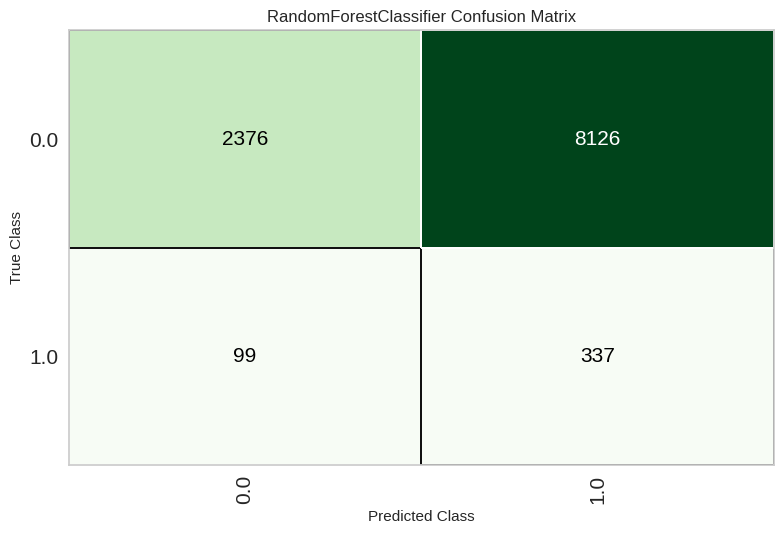

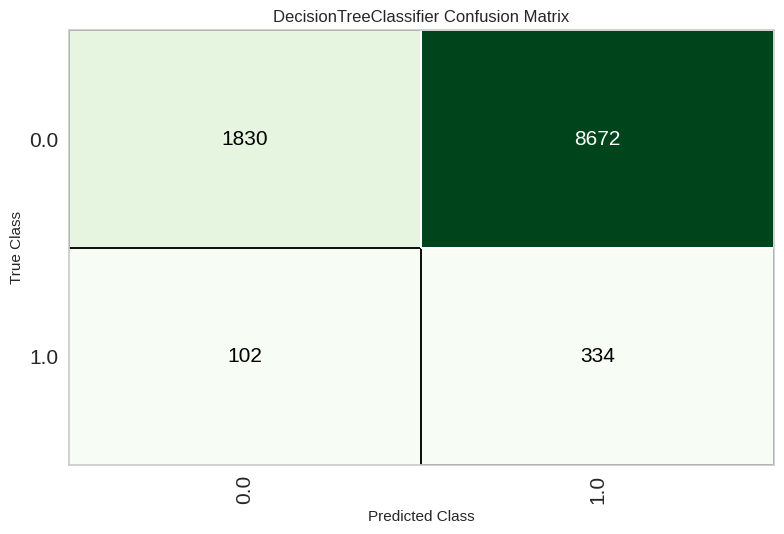

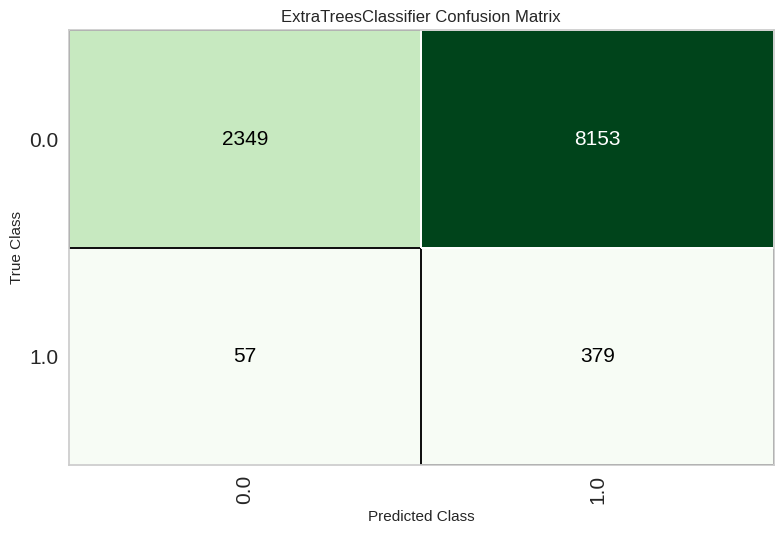

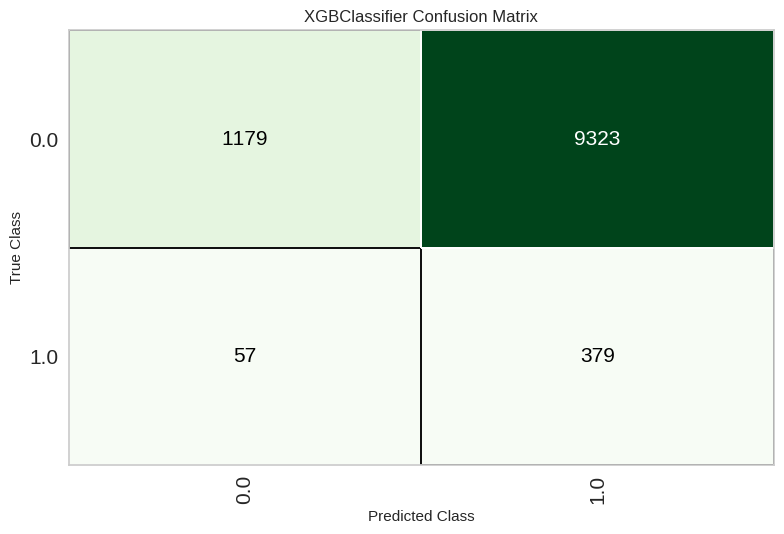

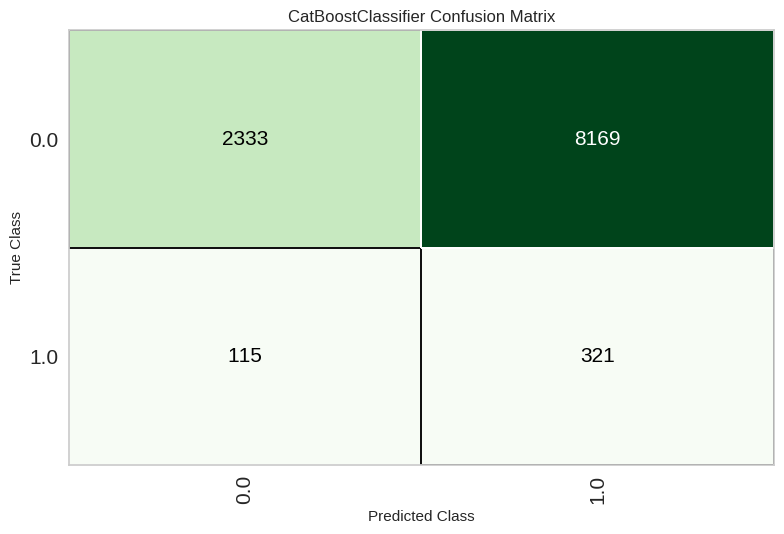

...

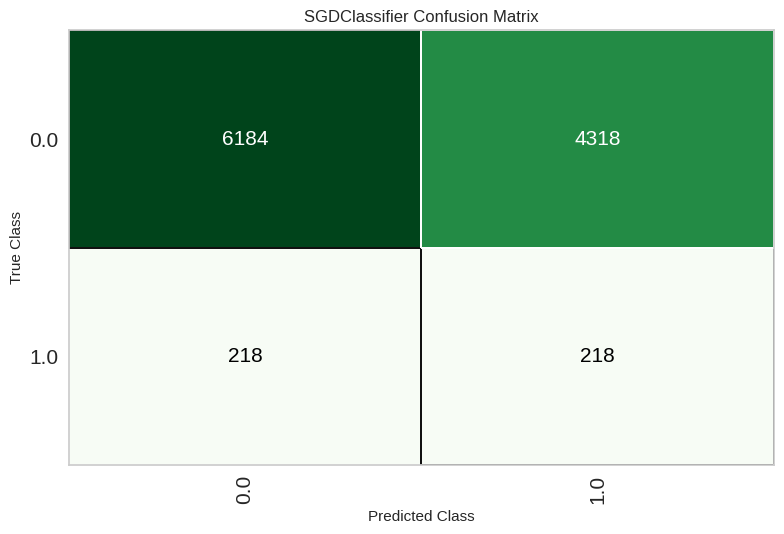

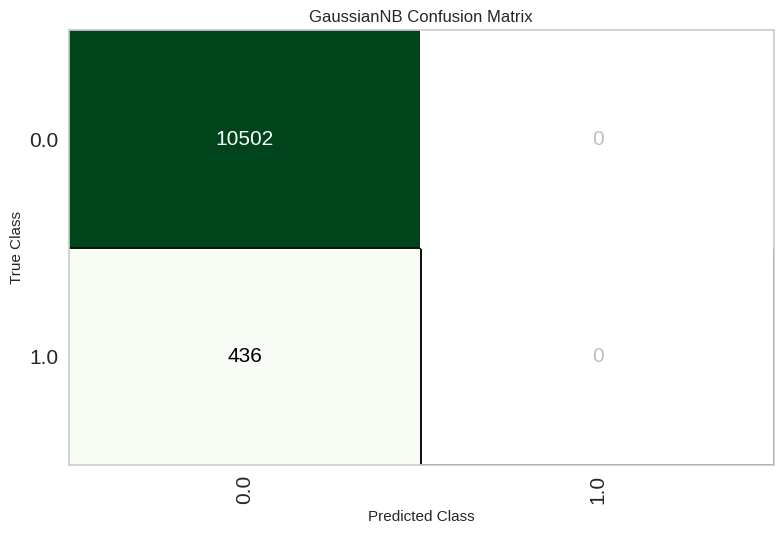

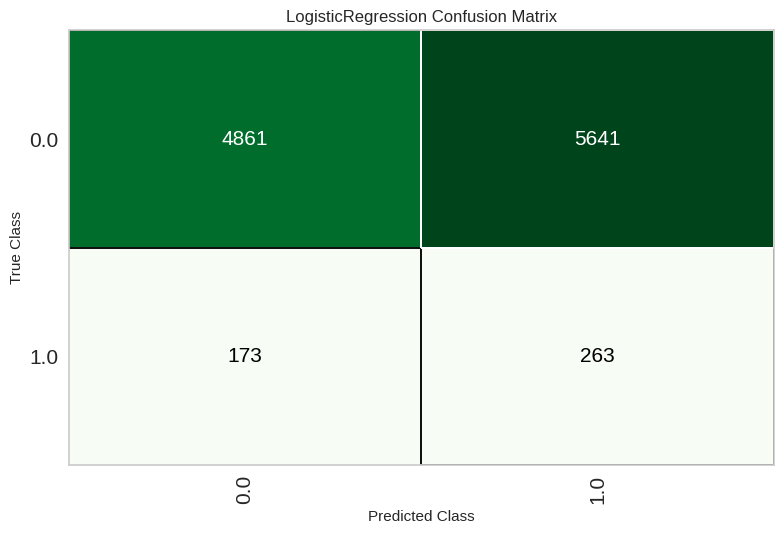

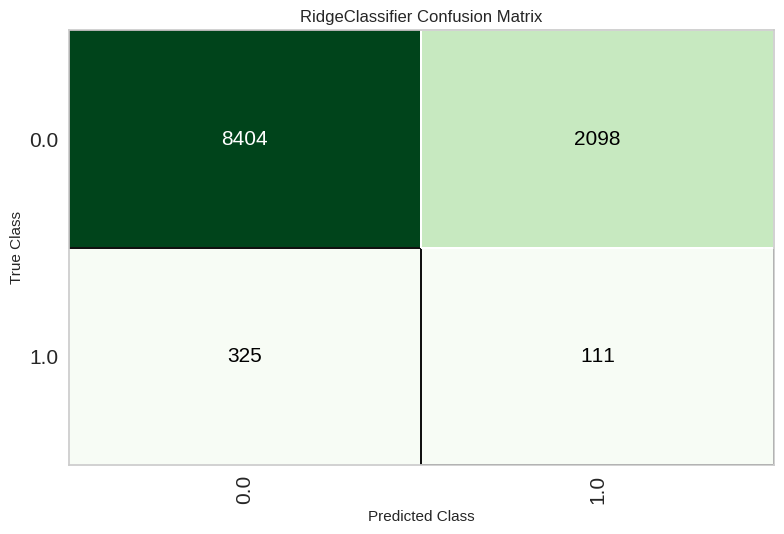

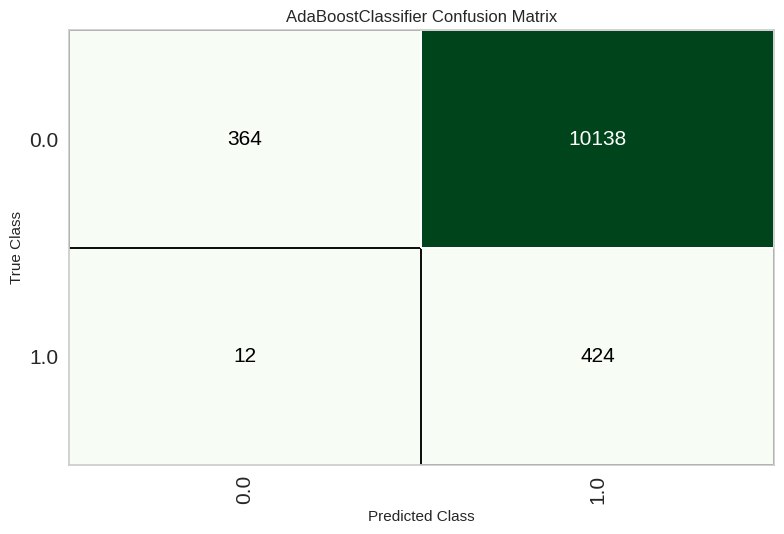

In [ ]:
plot_model(rf,plot = 'confusion_matrix')
plot_model(dt,plot = 'confusion_matrix')
plot_model(et,plot = 'confusion_matrix')
plot_model(xgboost,plot = 'confusion_matrix')
plot_model(catboost,plot = 'confusion_matrix')
plot_model(knn,plot = 'confusion_matrix')
plot_model(lightgbm,plot = 'confusion_matrix')
plot_model(qda,plot = 'confusion_matrix')
plot_model(lda,plot = 'confusion_matrix')
plot_model(gbc,plot = 'confusion_matrix')
plot_model(svm,plot = 'confusion_matrix')
plot_model(nb,plot = 'confusion_matrix')
plot_model(lr,plot = 'confusion_matrix')
plot_model(ridge,plot = 'confusion_matrix')
plot_model(ada,plot = 'confusion_matrix')

### Tune with Smote Tomek

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.5337,0.0000,0.4621,0.0397,0.0731,-0.0002,-0.0005,0.5006
1,0.6168,0.0000,0.3931,0.0417,0.0754,0.0038,0.0078,0.4922
2,0.5617,0.0000,0.5034,0.0457,0.0837,0.0116,0.0266,0.4681
3,0.5609,0.0000,0.3655,0.0339,0.0621,-0.0115,-0.0259,0.5272
4,0.5957,0.0000,0.4658,0.0464,0.0845,0.0126,0.0268,0.4705
5,0.5880,0.0000,0.4589,0.0450,0.0819,0.0097,0.0209,0.4769
6,0.4602,0.0000,0.5479,0.0404,0.0752,0.0006,0.0018,0.4979
7,0.6038,0.0000,0.5103,0.0511,0.0930,0.0223,0.0472,0.4462
8,0.4985,0.0000,0.5310,0.0419,0.0777,0.0043,0.0110,0.4864


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.5642,0.0000,0.4483,0.0413,0.0756,0.0030,0.0068,0.4923
1,0.6092,0.0000,0.3724,0.0389,0.0705,-0.0017,-0.0035,0.5035
2,0.5886,0.0000,0.4483,0.0438,0.0798,0.0079,0.0170,0.4814
3,0.5332,0.0000,0.4483,0.0385,0.0710,-0.0025,-0.0059,0.5069
4,0.5883,0.0000,0.5822,0.0557,0.1017,0.0309,0.0679,0.4152
5,0.4386,0.0000,0.6849,0.0476,0.0890,0.0153,0.0449,0.4550
6,0.5494,0.0000,0.4110,0.0371,0.0681,-0.0058,-0.0134,0.5148
7,0.6198,0.0000,0.4000,0.0427,0.0772,0.0058,0.0117,0.4883
8,0.6016,0.0000,0.4621,0.0465,0.0845,0.0132,0.0278,0.4697


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 50 candidates, totalling 500 fits


SGDClassifier(alpha=0.0001, average=False, class_weight=None,
              early_stopping=False, epsilon=0.1, eta0=0.001, fit_intercept=True,
              l1_ratio=0.15, learning_rate='optimal', loss='hinge',
              max_iter=1000, n_iter_no_change=5, n_jobs=-1, penalty='l2',
              power_t=0.5, random_state=6146, shuffle=True, tol=0.001,
              validation_fraction=0.1, verbose=0, warm_start=False)
SGDClassifier(alpha=1e-06, average=False, class_weight=None,
              early_stopping=False, epsilon=0.1, eta0=0.001,
              fit_intercept=False, l1_ratio=0.0600000001,
              learning_rate='optimal', loss='hinge', max_iter=1000,
              n_iter_no_change=5, n_jobs=-1, penalty='l1', power_t=0.5,
              random_state=6146, shuffle=True, tol=0.001,
              validation_fraction=0.1, verbose=0, warm_start=False)


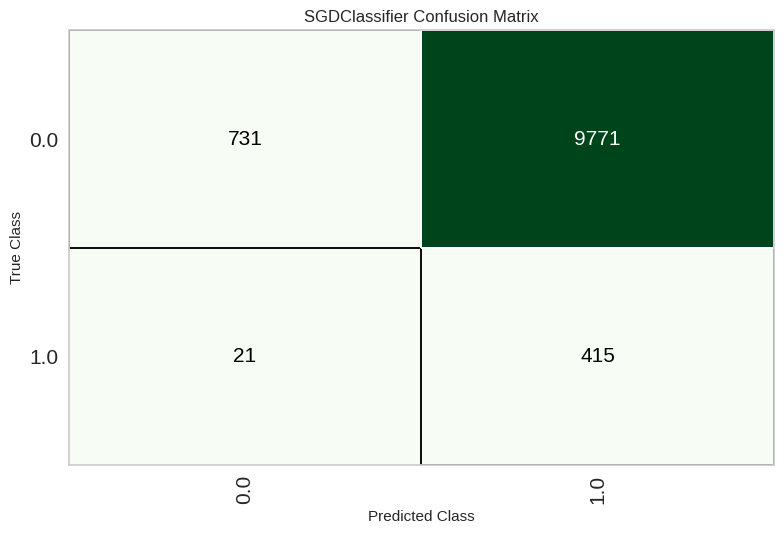

In [ ]:
svm = create_model('svm')

tuned_svm, tuner = tune_model(svm,optimize = 'eer',return_tuner=True,choose_better = True,n_iter = 50)

print(svm)
print(tuned_svm)


plot_model(tuned_svm,plot = 'confusion_matrix')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.8752,0.5206,0.1034,0.0441,0.0619,0.0065,0.0071,0.4971
1,0.8733,0.4901,0.1103,0.0458,0.0648,0.0091,0.0101,0.4958
2,0.8705,0.4993,0.1103,0.0446,0.0635,0.0072,0.0081,0.4965
3,0.7998,0.4209,0.0483,0.0117,0.0188,-0.0483,-0.0637,0.5339
4,0.8124,0.4301,0.0342,0.0091,0.0144,-0.0521,-0.0663,0.5334
5,0.8382,0.4518,0.0479,0.0153,0.0232,-0.0400,-0.0479,0.5222
6,0.7951,0.4399,0.0548,0.0130,0.0210,-0.0468,-0.0623,0.5337
7,0.7984,0.4871,0.0897,0.0211,0.0342,-0.0323,-0.0431,0.5238
8,0.8280,0.5318,0.1448,0.0401,0.0628,0.0005,0.0006,0.4997


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.8692,0.4806,0.0828,0.0337,0.0479,-0.0091,-0.0102,0.5043
1,0.8615,0.5962,0.1310,0.0477,0.0700,0.0124,0.0143,0.4935
2,0.8453,0.5040,0.0690,0.0228,0.0342,-0.0272,-0.0322,0.5148
3,0.7628,0.4013,0.1310,0.0251,0.0421,-0.0265,-0.0385,0.5241
4,0.9043,0.4632,0.1096,0.0681,0.0840,0.0364,0.0375,0.4871
5,0.8489,0.5619,0.1575,0.0510,0.0771,0.0176,0.0210,0.4898
6,0.8300,0.4435,0.1301,0.0371,0.0578,-0.0049,-0.0060,0.5031
7,0.8373,0.4989,0.1793,0.0520,0.0806,0.0202,0.0249,0.4870
8,0.7984,0.4244,0.1172,0.0272,0.0442,-0.0218,-0.0292,0.5164


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 10 candidates, totalling 100 fits


DecisionTreeClassifier(ccp_alpha=0.0, class_weight=None, criterion='gini',
                       max_depth=None, max_features=None, max_leaf_nodes=None,
                       min_impurity_decrease=0.0, min_samples_leaf=1,
                       min_samples_split=2, min_weight_fraction_leaf=0.0,
                       random_state=1381, splitter='best')
DecisionTreeClassifier(ccp_alpha=0.0, class_weight=None, criterion='gini',
                       max_depth=12, max_features='log2', max_leaf_nodes=None,
                       min_impurity_decrease=0.0001, min_samples_leaf=3,
                       min_samples_split=5, min_weight_fraction_leaf=0.0,
                       random_state=1381, splitter='best')


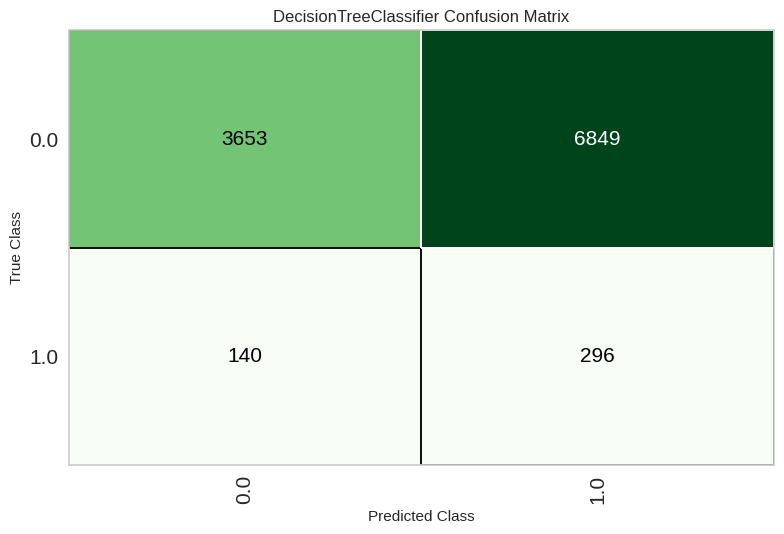

In [ ]:
dt = create_model('dt')

tuned_dt, tuner = tune_model(dt,optimize = 'eer',return_tuner=True,choose_better = True)

print(dt)
print(tuned_dt)

plot_model(tuned_dt,plot = 'confusion_matrix')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9604,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
1,0.9604,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
2,0.9600,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
3,0.9600,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
4,0.9600,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
5,0.9600,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
6,0.9600,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
7,0.9608,0.0000,0.0196,1.0000,0.0385,0.0370,0.1373,0.4950
8,0.9600,0.0000,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.5408,0.0000,0.6139,0.0519,0.0957,0.0245,0.0592,0.4296
1,0.5529,0.0000,0.5248,0.0462,0.0850,0.0132,0.0309,0.4617
2,0.5654,0.0000,0.4902,0.0452,0.0827,0.0103,0.0232,0.4728
3,0.5584,0.0000,0.6373,0.0563,0.1034,0.0323,0.0757,0.4111
4,0.5490,0.0000,0.5098,0.0451,0.0829,0.0102,0.0238,0.4710
5,0.5349,0.0000,0.4902,0.0422,0.0777,0.0044,0.0106,0.4871
6,0.5486,0.0000,0.5294,0.0466,0.0857,0.0132,0.0310,0.4614
7,0.5631,0.0000,0.5490,0.0498,0.0913,0.0194,0.0445,0.4445
8,0.5545,0.0000,0.6275,0.0550,0.1012,0.0299,0.0704,0.4169


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 10 candidates, totalling 100 fits


RidgeClassifier(alpha=1.0, class_weight=None, copy_X=True, fit_intercept=True,
                max_iter=None, positive=False, random_state=123, solver='auto',
                tol=0.0001)
RidgeClassifier(alpha=6.95, class_weight=None, copy_X=True, fit_intercept=False,
                max_iter=None, positive=False, random_state=123, solver='auto',
                tol=0.0001)


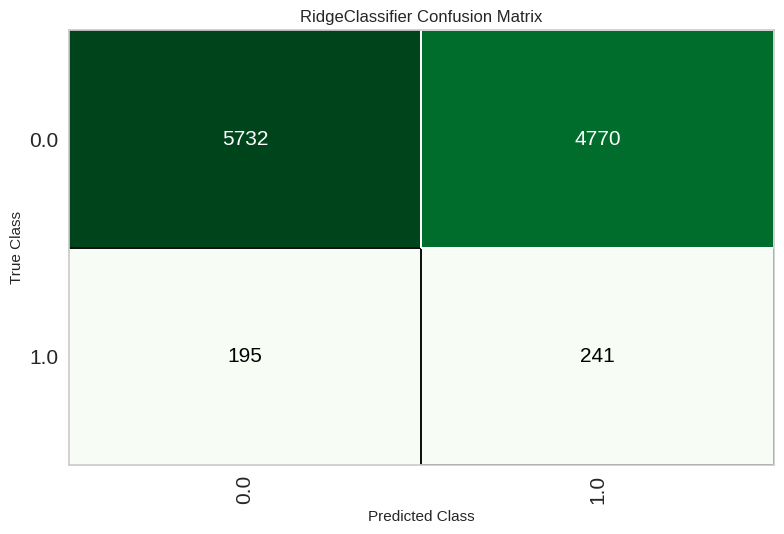

In [ ]:
ridge = create_model('ridge')

tuned_ridge, tuner = tune_model(ridge,optimize = 'eer',return_tuner=True,choose_better = True)

print(ridge)
print(tuned_ridge)

plot_model(tuned_ridge,plot = 'confusion_matrix')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9616,0.5812,0.0297,1.0000,0.0577,0.0555,0.1690,0.4925
1,0.9612,0.5607,0.0198,1.0000,0.0388,0.0374,0.1380,0.4950
2,0.9608,0.5553,0.0196,1.0000,0.0385,0.0370,0.1373,0.4950
3,0.9604,0.6450,0.0098,1.0000,0.0194,0.0187,0.0970,0.4975
4,0.9600,0.5615,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
5,0.9612,0.5383,0.0294,1.0000,0.0571,0.0550,0.1681,0.4925
6,0.9604,0.5569,0.0098,1.0000,0.0194,0.0187,0.0970,0.4975
7,0.9608,0.5586,0.0196,1.0000,0.0385,0.0370,0.1373,0.4950
8,0.9608,0.5824,0.0196,1.0000,0.0385,0.0370,0.1373,0.4950


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9604,0.5681,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
1,0.9604,0.5570,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
2,0.9600,0.5505,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
3,0.9600,0.6423,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
4,0.9600,0.5585,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
5,0.9600,0.5315,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
6,0.9600,0.5567,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
7,0.9600,0.5598,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
8,0.9600,0.5800,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 10 candidates, totalling 100 fits


Original model was better than the tuned model, hence it will be returned. NOTE: The display metrics are for the tuned model (not the original one).
LinearDiscriminantAnalysis(covariance_estimator=None, n_components=None,
                           priors=None, shrinkage=None, solver='svd',
                           store_covariance=False, tol=0.0001)
LinearDiscriminantAnalysis(covariance_estimator=None, n_components=None,
                           priors=None, shrinkage=None, solver='svd',
                           store_covariance=False, tol=0.0001)


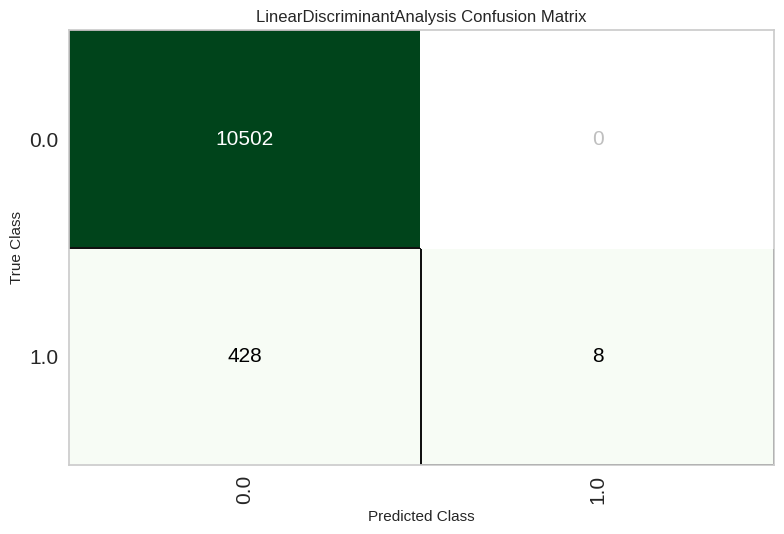

In [ ]:
lda = create_model('lda')

tuned_lda, tuner = tune_model(lda,optimize = 'eer',return_tuner=True,choose_better = True)

print(lda)
print(tuned_lda)

plot_model(tuned_lda,plot = 'confusion_matrix')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9604,0.5798,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
1,0.9604,0.5557,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
2,0.9600,0.5590,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
3,0.9600,0.6469,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
4,0.9600,0.5641,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
5,0.9600,0.5395,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
6,0.9600,0.5532,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
7,0.9604,0.5574,0.0098,1.0000,0.0194,0.0187,0.0970,0.4975
8,0.9604,0.5828,0.0098,1.0000,0.0194,0.0187,0.0970,0.4975


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.5940,0.5741,0.5248,0.0509,0.0928,0.0223,0.0483,0.4433
1,0.6078,0.5596,0.4653,0.0473,0.0858,0.0151,0.0316,0.4656
2,0.6203,0.5617,0.4902,0.0517,0.0935,0.0229,0.0468,0.4490
3,0.6003,0.6468,0.6078,0.0595,0.1084,0.0384,0.0828,0.3969
4,0.5976,0.5652,0.4706,0.0470,0.0855,0.0138,0.0294,0.4676
5,0.5952,0.5334,0.4510,0.0450,0.0818,0.0098,0.0209,0.4773
6,0.6027,0.5565,0.4510,0.0458,0.0832,0.0114,0.0240,0.4741
7,0.6109,0.5603,0.4804,0.0495,0.0898,0.0187,0.0389,0.4574
8,0.5964,0.5765,0.5490,0.0538,0.0981,0.0273,0.0588,0.4298


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 10 candidates, totalling 100 fits


LogisticRegression(C=1.0, class_weight=None, dual=False, fit_intercept=True,
                   intercept_scaling=1, l1_ratio=None, max_iter=1000,
                   multi_class='auto', n_jobs=None, penalty='l2',
                   random_state=123, solver='lbfgs', tol=0.0001, verbose=0,
                   warm_start=False)
LogisticRegression(C=2.833, class_weight='balanced', dual=False,
                   fit_intercept=True, intercept_scaling=1, l1_ratio=None,
                   max_iter=1000, multi_class='auto', n_jobs=None, penalty='l2',
                   random_state=123, solver='lbfgs', tol=0.0001, verbose=0,
                   warm_start=False)


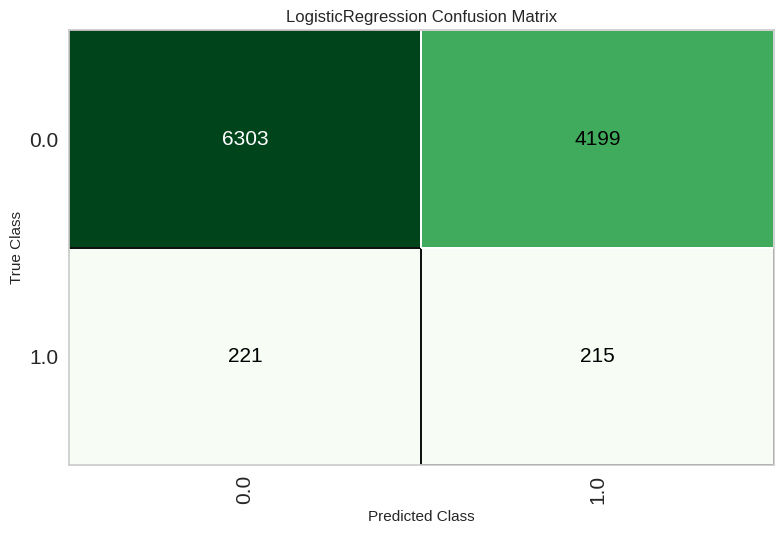

In [ ]:
lr = create_model('lr')

tuned_lr, tuner = tune_model(lr,optimize = 'eer',return_tuner=True,choose_better = True)

print(lr)
print(tuned_lr)

plot_model(tuned_lr,plot = 'confusion_matrix')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9612,0.7004,0.0792,0.5714,0.1391,0.1308,0.2026,0.4800
1,0.9628,0.7004,0.0891,0.7500,0.1593,0.1522,0.2505,0.4770
2,0.9604,0.6922,0.0588,0.5455,0.1062,0.0992,0.1698,0.4854
3,0.9632,0.6979,0.1176,0.7500,0.2034,0.1947,0.2879,0.4692
4,0.9592,0.6980,0.0392,0.4000,0.0714,0.0648,0.1153,0.4906
5,0.9624,0.6951,0.0784,0.8000,0.1429,0.1367,0.2434,0.4798
6,0.9624,0.7260,0.0686,0.8750,0.1273,0.1222,0.2390,0.4823
7,0.9616,0.6893,0.0784,0.6667,0.1404,0.1331,0.2199,0.4800
8,0.9632,0.6698,0.1078,0.7857,0.1897,0.1818,0.2828,0.4718


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9600,0.7010,0.0594,0.4615,0.1053,0.0971,0.1549,0.4854
1,0.9628,0.7215,0.1188,0.6667,0.2017,0.1920,0.2711,0.4690
2,0.9612,0.7080,0.0882,0.6000,0.1538,0.1451,0.2198,0.4775
3,0.9628,0.7229,0.1176,0.7059,0.2017,0.1925,0.2784,0.4693
4,0.9592,0.7036,0.0294,0.3750,0.0545,0.0490,0.0959,0.4930
5,0.9624,0.7236,0.1275,0.6500,0.2131,0.2027,0.2768,0.4667
6,0.9624,0.7556,0.1078,0.6875,0.1864,0.1775,0.2626,0.4720
7,0.9616,0.6885,0.0980,0.6250,0.1695,0.1604,0.2372,0.4748
8,0.9632,0.6765,0.1275,0.7222,0.2167,0.2072,0.2935,0.4665


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 10 candidates, totalling 100 fits


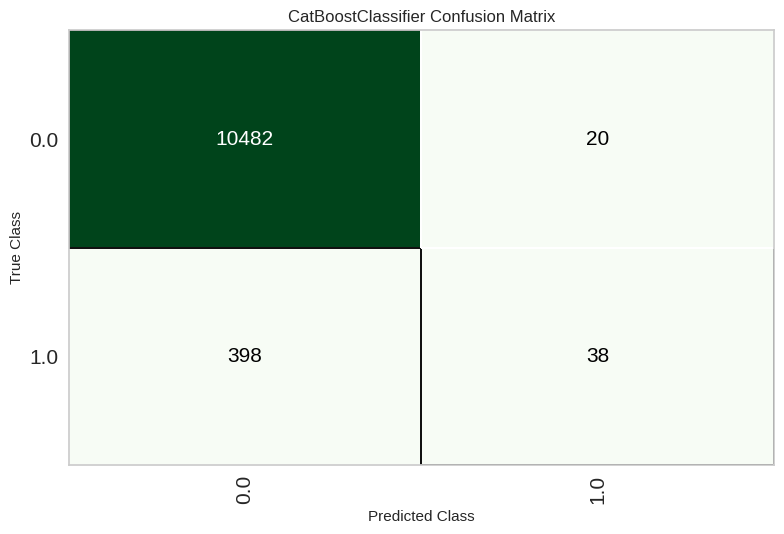

In [ ]:
cb = create_model('catboost')

tuned_cb, tuner = tune_model(cb,optimize = 'eer',return_tuner=True,choose_better = True)

print(cb)
print(tuned_cb)

plot_model(tuned_cb,plot = 'confusion_matrix')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9620,0.6864,0.0891,0.6429,0.1565,0.1483,0.2298,0.4772
1,0.9632,0.7271,0.1287,0.6842,0.2167,0.2067,0.2864,0.4662
2,0.9624,0.7097,0.0980,0.7143,0.1724,0.1644,0.2557,0.4746
3,0.9624,0.7391,0.1275,0.6500,0.2131,0.2027,0.2768,0.4667
4,0.9604,0.7003,0.0686,0.5385,0.1217,0.1137,0.1821,0.4828
5,0.9596,0.7399,0.0980,0.4762,0.1626,0.1510,0.2028,0.4753
6,0.9616,0.7544,0.0980,0.6250,0.1695,0.1604,0.2372,0.4748
7,0.9624,0.6892,0.1176,0.6667,0.2000,0.1903,0.2696,0.4694
8,0.9624,0.6915,0.1176,0.6667,0.2000,0.1903,0.2696,0.4694


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.8891,0.6741,0.4752,0.1727,0.2533,0.2073,0.2387,0.3667
1,0.8993,0.7059,0.4653,0.1880,0.2678,0.2241,0.2509,0.3683
2,0.8938,0.7228,0.5000,0.1882,0.2735,0.2287,0.2608,0.3546
3,0.8766,0.7243,0.4902,0.1597,0.2410,0.1923,0.2286,0.3635
4,0.8930,0.7137,0.4314,0.1699,0.2438,0.1978,0.2229,0.3840
5,0.8942,0.7347,0.4706,0.1818,0.2623,0.2172,0.2460,0.3673
6,0.8934,0.7457,0.5490,0.1986,0.2917,0.2475,0.2854,0.3319
7,0.8989,0.7200,0.4608,0.1880,0.2670,0.2229,0.2490,0.3702
8,0.8942,0.6874,0.4412,0.1744,0.2500,0.2044,0.2302,0.3797


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 10 candidates, totalling 100 fits


XGBClassifier(base_score=None, booster='gbtree', callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, device='cpu', early_stopping_rounds=None,
              enable_categorical=False, eval_metric=None, feature_types=None,
              gamma=None, grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=None, max_bin=None,
              max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=None, max_leaves=None,
              min_child_weight=None, missing=nan, monotone_constraints=None,
              multi_strategy=None, n_estimators=None, n_jobs=-1,
              num_parallel_tree=None, objective='binary:logistic', ...)
XGBClassifier(base_score=None, booster='gbtree', callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=0.9, device='cpu', early_stopping_rounds=None,
              enable_cate

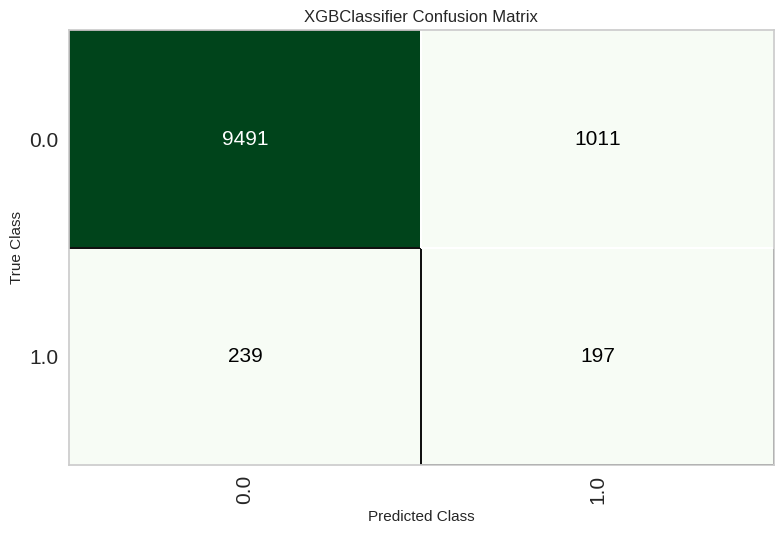

In [ ]:

xgboost = create_model('xgboost')

tuned_xgboost, tuner = tune_model(xgboost,optimize = 'eer',return_tuner=True,choose_better = True)

print(xgboost)
print(tuned_xgboost)

plot_model(tuned_xgboost,plot = 'confusion_matrix')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9608,0.7077,0.0297,0.6000,0.0566,0.0531,0.1274,0.4927
1,0.9632,0.7131,0.0891,0.8182,0.1607,0.1541,0.2628,0.4769
2,0.9608,0.7191,0.0490,0.6250,0.0909,0.0856,0.1675,0.4877
3,0.9628,0.6985,0.0882,0.8182,0.1593,0.1527,0.2614,0.4771
4,0.9608,0.6981,0.0392,0.6667,0.0741,0.0699,0.1553,0.4902
5,0.9616,0.7117,0.0588,0.7500,0.1091,0.1039,0.2033,0.4851
6,0.9620,0.7167,0.0588,0.8571,0.1101,0.1055,0.2188,0.4850
7,0.9620,0.6917,0.0686,0.7778,0.1261,0.1204,0.2241,0.4824
8,0.9612,0.6907,0.0686,0.6364,0.1239,0.1170,0.2003,0.4826


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9538,0.7102,0.0990,0.2703,0.1449,0.1264,0.1435,0.4767
1,0.9581,0.7419,0.1089,0.3929,0.1705,0.1560,0.1909,0.4729
2,0.9612,0.7083,0.1176,0.5714,0.1951,0.1840,0.2471,0.4697
3,0.9589,0.7139,0.1373,0.4516,0.2105,0.1955,0.2330,0.4649
4,0.9620,0.6921,0.1471,0.6000,0.2362,0.2240,0.2844,0.4613
5,0.9577,0.7323,0.1275,0.4062,0.1940,0.1783,0.2107,0.4679
6,0.9561,0.7385,0.1078,0.3438,0.1642,0.1479,0.1748,0.4736
7,0.9592,0.7128,0.1667,0.4722,0.2464,0.2303,0.2640,0.4565
8,0.9589,0.6822,0.1078,0.4400,0.1732,0.1600,0.2031,0.4729


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 10 candidates, totalling 100 fits


LGBMClassifier(boosting_type='gbdt', class_weight=None, colsample_bytree=1.0,
               importance_type='split', learning_rate=0.1, max_depth=-1,
               min_child_samples=20, min_child_weight=0.001, min_split_gain=0.0,
               n_estimators=100, n_jobs=-1, num_leaves=31, objective=None,
               random_state=123, reg_alpha=0.0, reg_lambda=0.0, subsample=1.0,
               subsample_for_bin=200000, subsample_freq=0)
LGBMClassifier(bagging_fraction=0.9, bagging_freq=3, boosting_type='gbdt',
               class_weight=None, colsample_bytree=1.0, feature_fraction=0.5,
               importance_type='split', learning_rate=0.4, max_depth=-1,
               min_child_samples=6, min_child_weight=0.001, min_split_gain=0.3,
               n_estimators=20, n_jobs=-1, num_leaves=150, objective=None,
               random_state=123, reg_alpha=0.005, reg_lambda=0.0005,
               subsample=1.0, subsample_for_bin=200000, subsample_freq=0)


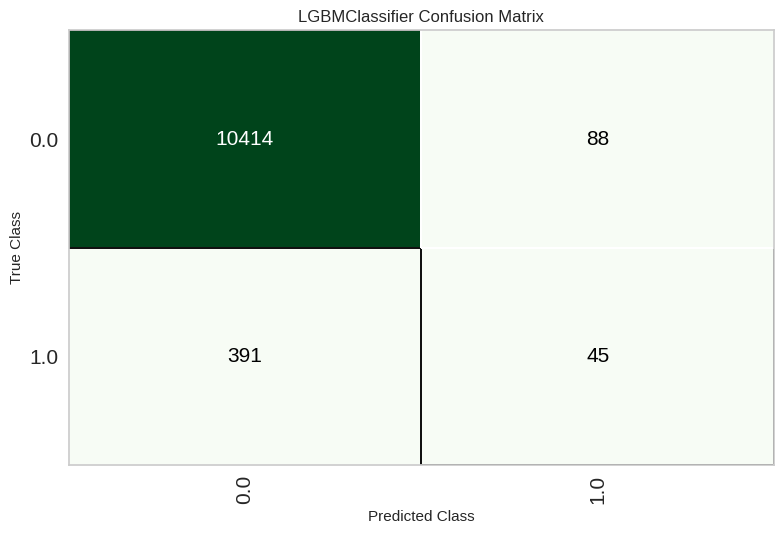

In [ ]:
lightgbm = create_model('lightgbm')

tuned_lightgbm, tuner = tune_model(lightgbm,optimize = 'eer',return_tuner=True,choose_better = True)

print(lightgbm)
print(tuned_lightgbm)

plot_model(tuned_lightgbm,plot = 'confusion_matrix')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9604,0.6035,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
1,0.9604,0.5676,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
2,0.9600,0.5942,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
3,0.9600,0.6582,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
4,0.9600,0.5891,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
5,0.9600,0.5577,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
6,0.9596,0.5777,0.0000,0.0000,0.0000,-0.0008,-0.0040,0.5001
7,0.9600,0.5693,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
8,0.9600,0.5935,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9604,0.5826,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
1,0.9604,0.5116,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
2,0.9600,0.5346,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
3,0.9600,0.6137,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
4,0.9600,0.5495,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
5,0.9600,0.5308,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
6,0.9600,0.5733,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
7,0.9600,0.5318,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
8,0.9600,0.5716,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 10 candidates, totalling 100 fits


Original model was better than the tuned model, hence it will be returned. NOTE: The display metrics are for the tuned model (not the original one).
AdaBoostClassifier(algorithm='SAMME.R', base_estimator='deprecated',
                   estimator=None, learning_rate=1.0, n_estimators=50,
                   random_state=123)
AdaBoostClassifier(algorithm='SAMME.R', base_estimator='deprecated',
                   estimator=None, learning_rate=1.0, n_estimators=50,
                   random_state=123)


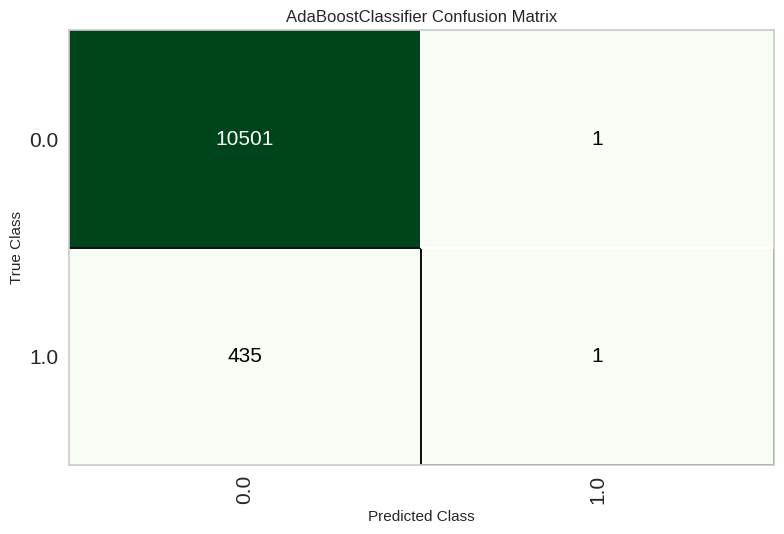

In [ ]:
adaboost = create_model('ada')

tuned_ada, tuner = tune_model(adaboost,optimize = 'eer',return_tuner=True,choose_better = True)

print(adaboost)
print(tuned_ada)

plot_model(tuned_ada,plot = 'confusion_matrix')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.5266,0.5352,0.5446,0.0452,0.0835,0.0112,0.0275,0.4654
1,0.8350,0.5202,0.1782,0.0506,0.0788,0.0182,0.0227,0.4880
2,0.9585,0.5039,0.0098,0.1667,0.0185,0.0141,0.0314,0.4980
3,0.6324,0.5267,0.4118,0.0457,0.0822,0.0110,0.0218,0.4783
4,0.4216,0.4968,0.5784,0.0395,0.0740,-0.0009,-0.0026,0.5028
5,0.9585,0.4992,0.0000,0.0000,0.0000,-0.0030,-0.0081,0.5004
6,0.8315,0.5082,0.1569,0.0444,0.0693,0.0074,0.0093,0.4952
7,0.5831,0.5527,0.5196,0.0496,0.0906,0.0190,0.0418,0.4506
8,0.8045,0.5270,0.2255,0.0519,0.0844,0.0208,0.0280,0.4831


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.8480,0.5077,0.1683,0.0530,0.0806,0.0217,0.0260,0.4870
1,0.8546,0.6060,0.1980,0.0645,0.0973,0.0400,0.0476,0.4763
2,0.8429,0.5825,0.1569,0.0483,0.0739,0.0136,0.0165,0.4917
3,0.8503,0.6207,0.3137,0.0930,0.1435,0.0872,0.1069,0.4402
4,0.8472,0.5318,0.1078,0.0355,0.0534,-0.0072,-0.0085,0.5040
5,0.8515,0.5717,0.1667,0.0547,0.0823,0.0235,0.0279,0.4864
6,0.8472,0.5507,0.1765,0.0556,0.0845,0.0252,0.0303,0.4848
7,0.8503,0.5639,0.1569,0.0513,0.0773,0.0181,0.0216,0.4895
8,0.8468,0.5301,0.1863,0.0581,0.0886,0.0294,0.0355,0.4821


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 10 candidates, totalling 100 fits


QuadraticDiscriminantAnalysis(priors=None, reg_param=0.0,
                              store_covariance=False, tol=0.0001)
QuadraticDiscriminantAnalysis(priors=None, reg_param=0.17,
                              store_covariance=False, tol=0.0001)


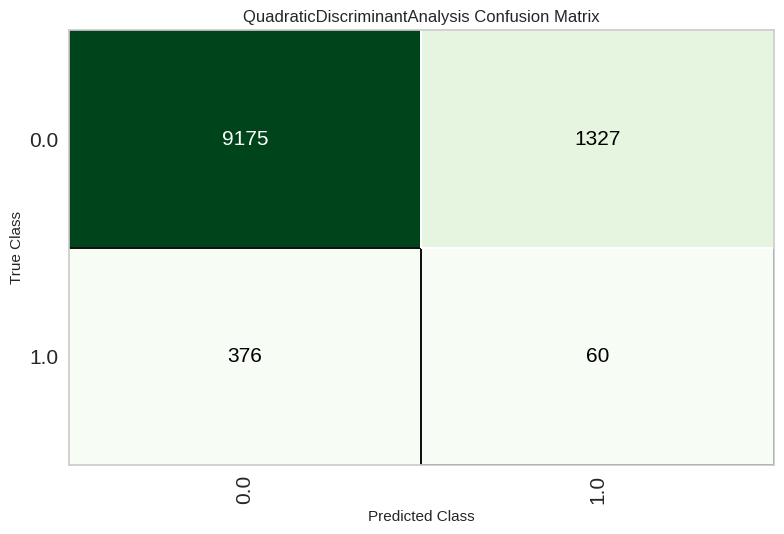

In [ ]:
qda = create_model('qda')

tuned_qda, tuner = tune_model(qda,optimize = 'eer',return_tuner=True,choose_better = True)

print(qda)
print(tuned_qda)

plot_model(tuned_qda,plot = 'confusion_matrix')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9612,0.6339,0.0297,0.7500,0.0571,0.0543,0.1444,0.4926
1,0.9604,0.6170,0.0198,0.5000,0.0381,0.0352,0.0936,0.4952
2,0.9600,0.6360,0.0098,0.5000,0.0192,0.0177,0.0658,0.4976
3,0.9604,0.6950,0.0294,0.6000,0.0561,0.0525,0.1267,0.4927
4,0.9612,0.6061,0.0294,1.0000,0.0571,0.0550,0.1681,0.4925
5,0.9604,0.6138,0.0196,0.6667,0.0381,0.0359,0.1098,0.4952
6,0.9608,0.6057,0.0196,1.0000,0.0385,0.0370,0.1373,0.4950
7,0.9604,0.5980,0.0098,1.0000,0.0194,0.0187,0.0970,0.4975
8,0.9604,0.6278,0.0098,1.0000,0.0194,0.0187,0.0970,0.4975


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9592,0.7166,0.1485,0.4545,0.2239,0.2085,0.2436,0.4617
1,0.9624,0.7100,0.1881,0.5758,0.2836,0.2693,0.3148,0.4495
2,0.9589,0.7365,0.1863,0.4634,0.2657,0.2485,0.2762,0.4509
3,0.9592,0.7072,0.1667,0.4722,0.2464,0.2303,0.2640,0.4565
4,0.9589,0.6997,0.1078,0.4400,0.1732,0.1600,0.2031,0.4729
5,0.9600,0.7405,0.1569,0.5000,0.2388,0.2240,0.2646,0.4591
6,0.9600,0.7302,0.1667,0.5000,0.2500,0.2347,0.2729,0.4563
7,0.9600,0.7156,0.1765,0.5000,0.2609,0.2451,0.2809,0.4534
8,0.9604,0.6874,0.1569,0.5161,0.2406,0.2262,0.2696,0.4590


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 10 candidates, totalling 100 fits


GradientBoostingClassifier(ccp_alpha=0.0, criterion='friedman_mse', init=None,
                           learning_rate=0.1, loss='log_loss', max_depth=3,
                           max_features=None, max_leaf_nodes=None,
                           min_impurity_decrease=0.0, min_samples_leaf=1,
                           min_samples_split=2, min_weight_fraction_leaf=0.0,
                           n_estimators=100, n_iter_no_change=None,
                           random_state=123, subsample=1.0, tol=0.0001,
                           validation_fraction=0.1, verbose=0,
                           warm_start=False)
GradientBoostingClassifier(ccp_alpha=0.0, criterion='friedman_mse', init=None,
                           learning_rate=0.15, loss='log_loss', max_depth=7,
                           max_features=1.0, max_leaf_nodes=None,
                           min_impurity_decrease=0.02, min_samples_leaf=5,
                           min_samples_split=5, min_weight_fraction_leaf=0.0,
   

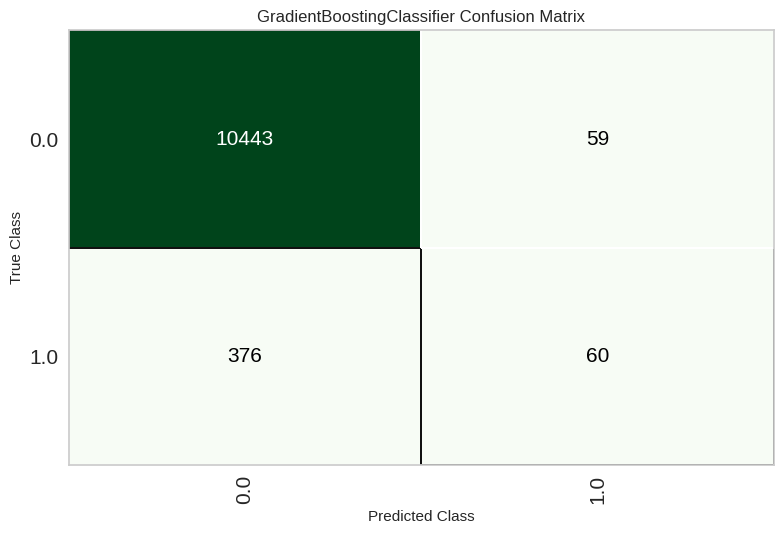

In [ ]:
gbc = create_model('gbc')

tuned_gbc, tuner = tune_model(gbc,optimize = 'eer',return_tuner=True,choose_better = True)

print(gbc)
print(tuned_gbc)

plot_model(tuned_gbc,plot = 'confusion_matrix')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9581,0.7913,0.1485,0.4167,0.2190,0.2024,0.2314,0.4620
1,0.9600,0.7450,0.2376,0.4898,0.3200,0.3020,0.3231,0.4351
2,0.9608,0.7480,0.2255,0.5227,0.3151,0.2982,0.3264,0.4386
3,0.9549,0.7936,0.1863,0.3725,0.2484,0.2278,0.2425,0.4519
4,0.9600,0.7480,0.1765,0.5000,0.2609,0.2451,0.2809,0.4534
5,0.9553,0.7170,0.1275,0.3421,0.1857,0.1677,0.1896,0.4685
6,0.9569,0.7910,0.2157,0.4231,0.2857,0.2659,0.2821,0.4426
7,0.9600,0.7003,0.2157,0.5000,0.3014,0.2841,0.3111,0.4418
8,0.9577,0.7591,0.1765,0.4286,0.2500,0.2321,0.2566,0.4541


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.6611,0.6252,0.5545,0.0639,0.1146,0.0470,0.0903,0.4010
1,0.6642,0.5709,0.3663,0.0446,0.0795,0.0096,0.0178,0.4837
2,0.6575,0.5644,0.4118,0.0491,0.0877,0.0175,0.0330,0.4683
3,0.6712,0.6668,0.5784,0.0690,0.1233,0.0559,0.1052,0.3844
4,0.6536,0.5655,0.4706,0.0547,0.0980,0.0284,0.0544,0.4446
5,0.6540,0.5555,0.3725,0.0443,0.0792,0.0084,0.0159,0.4852
6,0.6885,0.5879,0.4412,0.0575,0.1017,0.0333,0.0594,0.4444
7,0.6548,0.5695,0.3922,0.0466,0.0832,0.0127,0.0240,0.4773
8,0.6614,0.5850,0.4314,0.0518,0.0924,0.0227,0.0426,0.4587


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 10 candidates, totalling 100 fits


RandomForestClassifier(bootstrap=True, ccp_alpha=0.0, class_weight=None,
                       criterion='gini', max_depth=None, max_features='sqrt',
                       max_leaf_nodes=None, max_samples=None,
                       min_impurity_decrease=0.0, min_samples_leaf=1,
                       min_samples_split=2, min_weight_fraction_leaf=0.0,
                       n_estimators=100, n_jobs=-1, oob_score=False,
                       random_state=123, verbose=0, warm_start=False)
RandomForestClassifier(bootstrap=False, ccp_alpha=0.0,
                       class_weight='balanced_subsample', criterion='gini',
                       max_depth=4, max_features='sqrt', max_leaf_nodes=None,
                       max_samples=None, min_impurity_decrease=0.0005,
                       min_samples_leaf=3, min_samples_split=5,
                       min_weight_fraction_leaf=0.0, n_estimators=260,
                       n_jobs=-1, oob_score=False, random_state=123, verbose=0,
         

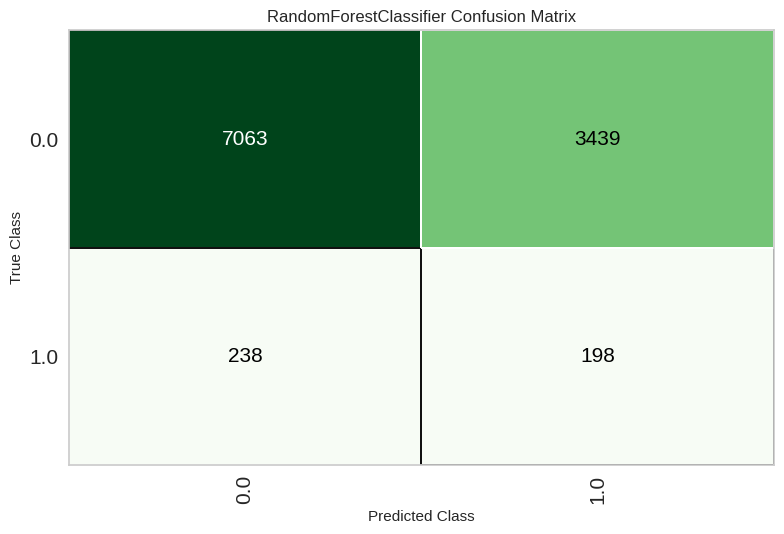

In [ ]:
rf = create_model('rf')

tuned_rf, tuner = tune_model(rf,optimize = 'eer',return_tuner=True,choose_better = True)

print(rf)
print(tuned_rf)

plot_model(tuned_rf,plot = 'confusion_matrix')


,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9577,0.7723,0.1485,0.4054,0.2174,0.2004,0.2276,0.4621
1,0.9604,0.7498,0.2178,0.5000,0.3034,0.2863,0.3128,0.4411
2,0.9620,0.7349,0.2059,0.5676,0.3022,0.2870,0.3267,0.4442
3,0.9569,0.7777,0.1961,0.4167,0.2667,0.2474,0.2663,0.4485
4,0.9592,0.7268,0.1765,0.4737,0.2571,0.2407,0.2722,0.4536
5,0.9561,0.7035,0.1373,0.3684,0.2000,0.1823,0.2061,0.4656
6,0.9565,0.7544,0.1863,0.4043,0.2550,0.2358,0.2547,0.4515
7,0.9596,0.7099,0.2157,0.4889,0.2993,0.2817,0.3070,0.4419
8,0.9573,0.7366,0.1667,0.4146,0.2378,0.2199,0.2444,0.4570


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.6775,0.5946,0.4455,0.0554,0.0986,0.0303,0.0555,0.4466
1,0.6446,0.5497,0.4554,0.0512,0.0921,0.0225,0.0440,0.4550
2,0.6023,0.5516,0.5000,0.0502,0.0913,0.0201,0.0426,0.4519
3,0.6144,0.6323,0.5686,0.0581,0.1055,0.0355,0.0742,0.4117
4,0.6054,0.5586,0.4804,0.0489,0.0887,0.0174,0.0365,0.4597
5,0.6238,0.5427,0.4902,0.0522,0.0943,0.0238,0.0484,0.4475
6,0.6755,0.5838,0.4314,0.0541,0.0961,0.0269,0.0492,0.4533
7,0.6579,0.5257,0.3627,0.0438,0.0781,0.0073,0.0137,0.4874
8,0.6321,0.5639,0.4608,0.0505,0.0910,0.0204,0.0407,0.4576


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 10 candidates, totalling 100 fits


ExtraTreesClassifier(bootstrap=False, ccp_alpha=0.0, class_weight=None,
                     criterion='gini', max_depth=None, max_features='sqrt',
                     max_leaf_nodes=None, max_samples=None,
                     min_impurity_decrease=0.0, min_samples_leaf=1,
                     min_samples_split=2, min_weight_fraction_leaf=0.0,
                     n_estimators=100, n_jobs=-1, oob_score=False,
                     random_state=123, verbose=0, warm_start=False)
ExtraTreesClassifier(bootstrap=False, ccp_alpha=0.0,
                     class_weight='balanced_subsample', criterion='gini',
                     max_depth=4, max_features='sqrt', max_leaf_nodes=None,
                     max_samples=None, min_impurity_decrease=0.0005,
                     min_samples_leaf=3, min_samples_split=5,
                     min_weight_fraction_leaf=0.0, n_estimators=260, n_jobs=-1,
                     oob_score=False, random_state=123, verbose=0,
                     warm_start=Fals

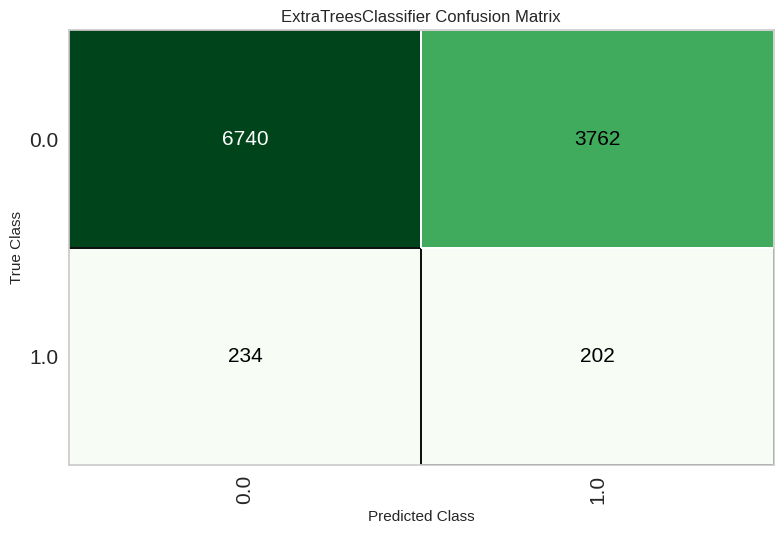

In [ ]:
et = create_model('et')

tuned_et, tuner = tune_model(et,optimize = 'eer',return_tuner=True,choose_better = True)

print(et)
print(tuned_et)

plot_model(tuned_et,plot = 'confusion_matrix')


,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.0674,0.4844,0.9802,0.0400,0.0768,0.0008,0.0115,0.4974
1,0.0572,0.5688,0.9901,0.0399,0.0767,0.0007,0.0129,0.4978
2,0.0549,0.4958,0.9902,0.0402,0.0773,0.0005,0.0096,0.4985
3,0.0600,0.5703,0.9902,0.0404,0.0777,0.0009,0.0157,0.4971
4,0.0564,0.5212,1.0000,0.0406,0.0781,0.0014,0.0264,0.4957
5,0.0607,0.5401,0.9902,0.0404,0.0777,0.0010,0.0165,0.4969
6,0.0580,0.4932,1.0000,0.0407,0.0782,0.0015,0.0276,0.4953
7,0.0615,0.5186,0.9902,0.0405,0.0778,0.0011,0.0173,0.4967
8,0.0584,0.5146,0.9804,0.0400,0.0768,0.0000,0.0005,0.4999


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9361,0.4941,0.0495,0.0694,0.0578,0.0257,0.0261,0.4942
1,0.9334,0.5682,0.0396,0.0519,0.0449,0.0111,0.0112,0.4975
2,0.9397,0.5040,0.0490,0.0806,0.0610,0.0317,0.0328,0.4933
3,0.9353,0.5808,0.0882,0.1111,0.0984,0.0653,0.0658,0.4844
4,0.9306,0.5239,0.0196,0.0253,0.0221,-0.0133,-0.0134,0.5030
5,0.9353,0.5371,0.0294,0.0435,0.0351,0.0029,0.0030,0.4994
6,0.9361,0.5034,0.0490,0.0704,0.0578,0.0258,0.0263,0.4943
7,0.9432,0.5235,0.0392,0.0784,0.0523,0.0263,0.0280,0.4948
8,0.9444,0.5238,0.0490,0.1000,0.0658,0.0406,0.0433,0.4921


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 10 candidates, totalling 100 fits


GaussianNB(priors=None, var_smoothing=1e-09)
GaussianNB(priors=None, var_smoothing=1)


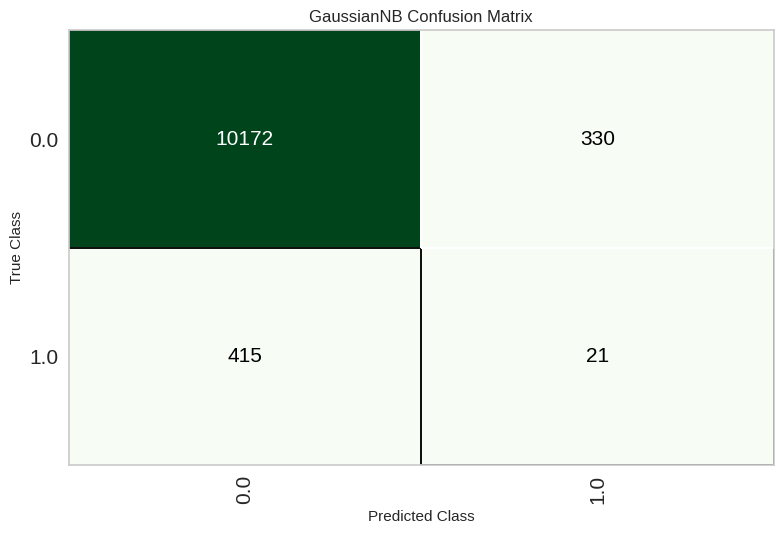

In [ ]:
nb = create_model('nb')

tuned_nb, tuner = tune_model(nb,optimize = 'eer',return_tuner=True,choose_better = True)

print(nb)
print(tuned_nb)

plot_model(tuned_nb,plot = 'confusion_matrix')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9585,0.6674,0.0396,0.3077,0.0702,0.0617,0.0984,0.4908
1,0.9577,0.6830,0.0891,0.3600,0.1429,0.1292,0.1635,0.4783
2,0.9616,0.6723,0.1078,0.6111,0.1833,0.1734,0.2457,0.4722
3,0.9569,0.6970,0.0980,0.3571,0.1538,0.1390,0.1705,0.4761
4,0.9585,0.6667,0.0490,0.3571,0.0862,0.0773,0.1203,0.4884
5,0.9573,0.6586,0.0686,0.3333,0.1138,0.1016,0.1364,0.4837
6,0.9592,0.7148,0.0784,0.4444,0.1333,0.1228,0.1740,0.4806
7,0.9561,0.6397,0.0980,0.3333,0.1515,0.1358,0.1633,0.4763
8,0.9589,0.6505,0.0980,0.4348,0.1600,0.1475,0.1922,0.4756


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9581,0.7083,0.1485,0.4167,0.2190,0.2024,0.2314,0.4620
1,0.9596,0.7157,0.2178,0.4783,0.2993,0.2815,0.3049,0.4413
2,0.9624,0.7113,0.2157,0.5789,0.3143,0.2991,0.3383,0.4412
3,0.9573,0.7358,0.1863,0.4222,0.2585,0.2399,0.2614,0.4513
4,0.9589,0.7095,0.1765,0.4615,0.2553,0.2385,0.2681,0.4537
5,0.9561,0.7068,0.1373,0.3684,0.2000,0.1823,0.2061,0.4656
6,0.9573,0.7334,0.1863,0.4222,0.2585,0.2399,0.2614,0.4513
7,0.9592,0.6934,0.2157,0.4783,0.2973,0.2794,0.3031,0.4420
8,0.9573,0.6648,0.1667,0.4146,0.2378,0.2199,0.2444,0.4570


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 10 candidates, totalling 100 fits


KNeighborsClassifier(algorithm='auto', leaf_size=30, metric='minkowski',
                     metric_params=None, n_jobs=-1, n_neighbors=5, p=2,
                     weights='uniform')
KNeighborsClassifier(algorithm='auto', leaf_size=30, metric='manhattan',
                     metric_params=None, n_jobs=-1, n_neighbors=13, p=2,
                     weights='distance')


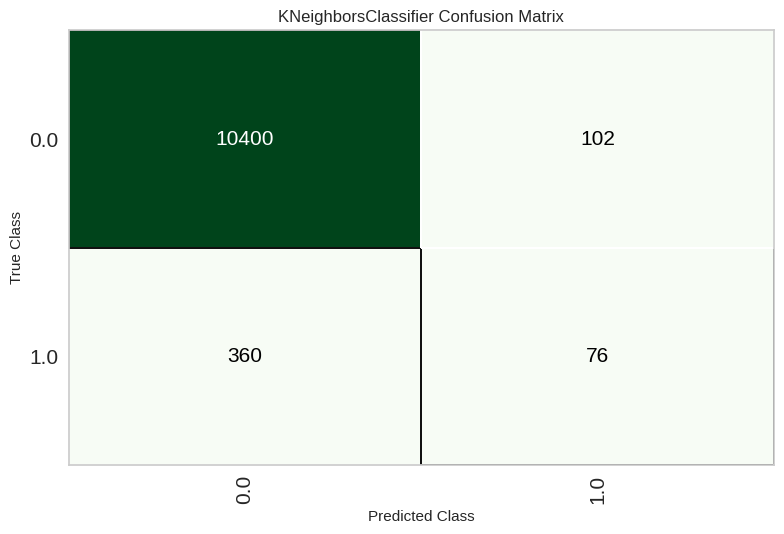

In [ ]:
knn = create_model('knn')

tuned_knn, tuner = tune_model(knn,optimize = 'eer',return_tuner=True,choose_better = True)

print(knn)
print(tuned_knn)

plot_model(tuned_knn,plot = 'confusion_matrix')

## ADASYN

In [ ]:
from pycaret.classification import *

import imblearn
from imblearn.over_sampling import ADASYN
ada = ADASYN(random_state=42,sampling_strategy='minority')
adaTest = setup(df,test_data = test_data, target = 'STATUS',normalize = True,ignore_features = ['ID'],fix_imbalance = True,fix_imbalance_method = ada,index=False)
add_metric('eer', 'eer', calculate_eer,greater_is_better=False)

,Description,Value
0,Session id,5059
1,Target,STATUS
2,Target type,Binary
3,Original data shape,"(47395, 52)"
4,Transformed data shape,"(80782, 51)"
5,Transformed train set shape,"(69844, 51)"
6,Transformed test set shape,"(10938, 51)"
7,Ignore features,1
8,Numeric features,50
9,Rows with missing values,23.1%


Name                                                               eer
Display Name                                                       eer
Score Function       <pycaret.internal.metrics.EncodedDecodedLabels...
Scorer               make_scorer(calculate_eer, greater_is_better=F...
Target                                                            pred
Args                                                                {}
Greater is Better                                                False
Multiclass                                                        True
Custom                                                            True
Name: eer, dtype: object

In [ ]:
# best = compare_models(sort='F1',include=['rf','dt','xgboost','nb','lr'])
best = compare_models(sort='eer')

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer,TT (Sec)
svm,SVM - Linear Kernel,0.5201,0.0000,0.5415,0.0456,0.0840,0.0113,0.0244,0.4727,1.7400
lr,Logistic Regression,0.5616,0.5234,0.4673,0.0427,0.0782,0.0057,0.0130,0.4836,1.1280
ridge,Ridge Classifier,0.5608,0.0000,0.4646,0.0425,0.0777,0.0052,0.0116,0.4852,0.7040
lda,Linear Discriminant Analysis,0.5608,0.5232,0.4646,0.0425,0.0777,0.0052,0.0116,0.4852,1.4320
xgboost,Extreme Gradient Boosting,0.9371,0.5062,0.0448,0.0664,0.0508,0.0207,0.0219,0.4949,4.0460
catboost,CatBoost Classifier,0.9376,0.4991,0.0434,0.0682,0.0500,0.0207,0.0221,0.4951,44.7870
lightgbm,Light Gradient Boosting Machine,0.9495,0.4967,0.0227,0.0793,0.0339,0.0157,0.0197,0.4972,6.1100
gbc,Gradient Boosting Classifier,0.9598,0.4818,0.0028,0.3000,0.0055,0.0045,0.0260,0.4994,18.8330
qda,Quadratic Discriminant Analysis,0.0410,0.5006,1.0000,0.0399,0.0767,0.0001,0.0053,0.4997,1.1020
ada,Ada Boost Classifier,0.9586,0.4894,0.0028,0.1571,0.0053,0.0021,0.0126,0.4997,4.7310


Processing:   0%|          | 0/69 [00:00<?, ?it/s]

In [ ]:
evaluate_model(best)

interactive(children=(ToggleButtons(description='Plot Type:', icons=('',), options=(('Pipeline Plot', 'pipelin…

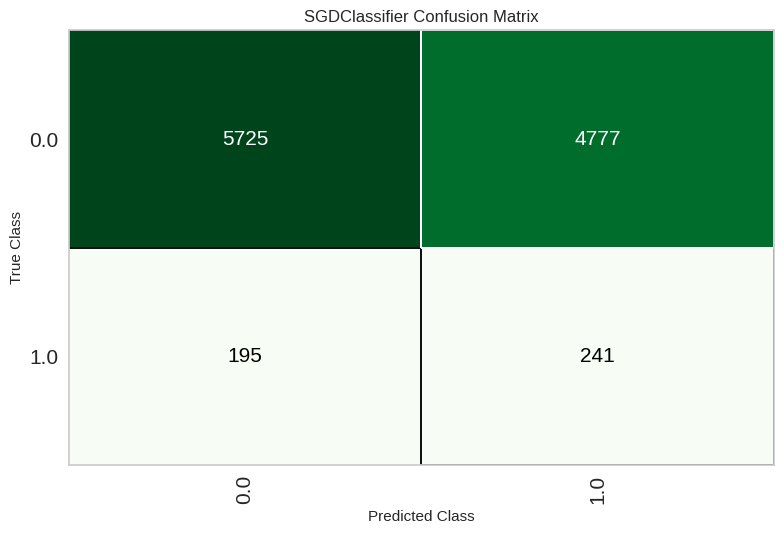

In [ ]:
plot_model(best,plot = 'confusion_matrix')

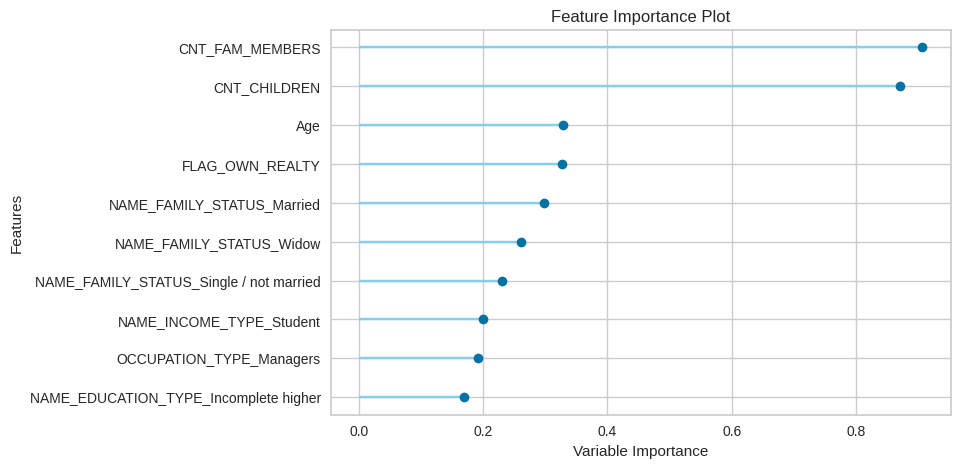

In [ ]:
plot_model(best,plot = 'feature')

### Models confusion matrix after Adasyn

In [ ]:
dt = create_model('dt')
svm = create_model('svm')
rf = create_model('rf')
et = create_model('et')
catboost = create_model('catboost')
knn = create_model('knn')
lightgbm = create_model('lightgbm')
qda = create_model('qda')
lda = create_model('lda')
gbc = create_model('gbc')
xgboost = create_model('xgboost')
nb = create_model('nb')
lr = create_model('lr')
ridge = create_model('ridge')
ada = create_model('ada')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.8711,0.4846,0.0621,0.0262,0.0369,-0.0201,-0.0223,0.5090
1,0.8694,0.4869,0.1241,0.0490,0.0703,0.0141,0.0159,0.4931
2,0.8615,0.4832,0.0897,0.0337,0.0490,-0.0094,-0.0107,0.5047
3,0.7970,0.4212,0.0345,0.0083,0.0133,-0.0543,-0.0719,0.5382
4,0.8214,0.4336,0.0548,0.0154,0.0240,-0.0411,-0.0514,0.5255
5,0.8173,0.4472,0.0616,0.0167,0.0263,-0.0391,-0.0495,0.5250
6,0.8086,0.4446,0.0616,0.0158,0.0251,-0.0412,-0.0533,0.5277
7,0.8359,0.5248,0.1034,0.0311,0.0478,-0.0143,-0.0174,0.5086
8,0.8247,0.5364,0.1655,0.0443,0.0699,0.0076,0.0096,0.4948


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.6259,0.0000,0.4138,0.0448,0.0809,0.0098,0.0196,0.4802
1,0.5968,0.0000,0.6069,0.0586,0.1069,0.0371,0.0807,0.3994
2,0.5941,0.0000,0.6276,0.0600,0.1095,0.0398,0.0873,0.3936
3,0.5592,0.0000,0.3310,0.0308,0.0564,-0.0177,-0.0396,0.5405
4,0.6171,0.0000,0.4589,0.0484,0.0876,0.0163,0.0334,0.4645
5,0.5864,0.0000,0.3973,0.0392,0.0714,-0.0016,-0.0034,0.5035
6,0.3889,0.0000,0.6233,0.0402,0.0755,0.0003,0.0010,0.4990
7,0.5734,0.0000,0.5241,0.0487,0.0890,0.0175,0.0393,0.4526
8,0.4683,0.0000,0.4966,0.0372,0.0692,-0.0052,-0.0142,0.5176


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9375,0.4596,0.0414,0.0632,0.0500,0.0191,0.0196,0.4959
1,0.9257,0.4425,0.0483,0.0500,0.0491,0.0105,0.0105,0.4973
2,0.9240,0.4049,0.0966,0.0875,0.0918,0.0523,0.0523,0.4853
3,0.8642,0.1985,0.0138,0.0056,0.0080,-0.0513,-0.0573,0.5230
4,0.8796,0.2259,0.0411,0.0197,0.0266,-0.0291,-0.0314,0.5118
5,0.8777,0.2360,0.0342,0.0161,0.0219,-0.0344,-0.0372,0.5141
6,0.8626,0.2759,0.0548,0.0216,0.0309,-0.0281,-0.0317,0.5133
7,0.8785,0.3706,0.0690,0.0314,0.0432,-0.0121,-0.0132,0.5052
8,0.8856,0.4558,0.0966,0.0467,0.0629,0.0098,0.0106,0.4959


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9298,0.4275,0.0414,0.0488,0.0448,0.0086,0.0086,0.4979
1,0.9216,0.3886,0.0483,0.0452,0.0467,0.0058,0.0058,0.4984
2,0.9142,0.3085,0.0828,0.0625,0.0712,0.0271,0.0274,0.4916
3,0.8626,0.1493,0.0138,0.0056,0.0079,-0.0517,-0.0580,0.5235
4,0.8752,0.1728,0.0411,0.0187,0.0257,-0.0311,-0.0338,0.5131
5,0.8747,0.2041,0.0342,0.0156,0.0214,-0.0356,-0.0388,0.5149
6,0.8601,0.1943,0.0548,0.0211,0.0304,-0.0291,-0.0330,0.5140
7,0.8694,0.3220,0.0621,0.0258,0.0364,-0.0209,-0.0233,0.5095
8,0.8730,0.4221,0.1103,0.0457,0.0646,0.0089,0.0099,0.4958


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9517,0.5199,0.0276,0.1026,0.0435,0.0271,0.0334,0.4955
1,0.9405,0.5397,0.0207,0.0385,0.0269,-0.0009,-0.0010,0.5002
2,0.9539,0.4676,0.0207,0.1034,0.0345,0.0215,0.0292,0.4966
3,0.9369,0.4283,0.0138,0.0225,0.0171,-0.0136,-0.0140,0.5028
4,0.9443,0.4425,0.0137,0.0328,0.0193,-0.0044,-0.0048,0.5008
5,0.9336,0.4959,0.0274,0.0385,0.0320,-0.0014,-0.0014,0.5003
6,0.9177,0.3991,0.0205,0.0188,0.0196,-0.0232,-0.0233,0.5063
7,0.9358,0.5119,0.0759,0.0991,0.0859,0.0533,0.0538,0.4875
8,0.9267,0.5407,0.0759,0.0764,0.0761,0.0380,0.0380,0.4900


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.8289,0.4853,0.1172,0.0331,0.0517,-0.0110,-0.0137,0.5070
1,0.8346,0.4531,0.0966,0.0288,0.0444,-0.0180,-0.0220,0.5108
2,0.8437,0.4884,0.1241,0.0390,0.0594,-0.0012,-0.0014,0.5007
3,0.7729,0.4087,0.0621,0.0128,0.0213,-0.0478,-0.0672,0.5390
4,0.7792,0.4220,0.0411,0.0089,0.0147,-0.0547,-0.0753,0.5421
5,0.7660,0.4512,0.0959,0.0190,0.0318,-0.0375,-0.0538,0.5324
6,0.7386,0.4180,0.0959,0.0168,0.0285,-0.0425,-0.0647,0.5415
7,0.7822,0.5106,0.1241,0.0263,0.0434,-0.0239,-0.0332,0.5197
8,0.7657,0.5111,0.2000,0.0378,0.0636,-0.0036,-0.0052,0.5034


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9539,0.5097,0.0138,0.0741,0.0233,0.0109,0.0152,0.4983
1,0.9493,0.5510,0.0069,0.0238,0.0107,-0.0073,-0.0088,0.5012
2,0.9578,0.4737,0.0207,0.2000,0.0375,0.0303,0.0527,0.4956
3,0.9427,0.4234,0.0069,0.0152,0.0095,-0.0158,-0.0171,0.5030
4,0.9512,0.4657,0.0274,0.1000,0.0430,0.0262,0.0322,0.4956
5,0.9501,0.5238,0.0000,0.0000,0.0000,-0.0161,-0.0204,0.5026
6,0.9482,0.4064,0.0137,0.0426,0.0207,0.0012,0.0015,0.4998
7,0.9465,0.5356,0.0138,0.0370,0.0201,-0.0015,-0.0017,0.5003
8,0.9435,0.5140,0.0552,0.1039,0.0721,0.0457,0.0482,0.4908


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.0428,0.5016,1.0000,0.0399,0.0767,0.0003,0.0112,0.4992
1,0.0400,0.5001,1.0000,0.0398,0.0765,0.0000,0.0034,0.4999
2,0.0398,0.5000,1.0000,0.0398,0.0765,0.0000,0.0000,0.5000
3,0.0436,0.5020,1.0000,0.0399,0.0768,0.0003,0.0126,0.4990
4,0.0422,0.5011,1.0000,0.0401,0.0772,0.0002,0.0096,0.4994
5,0.0403,0.5001,1.0000,0.0401,0.0770,0.0000,0.0034,0.4999
6,0.0406,0.5003,1.0000,0.0401,0.0770,0.0000,0.0048,0.4999
7,0.0398,0.5000,1.0000,0.0398,0.0765,0.0000,0.0000,0.5000
8,0.0398,0.5000,1.0000,0.0398,0.0765,0.0000,0.0000,0.5000


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.6004,0.5271,0.4069,0.0413,0.0749,0.0029,0.0061,0.4936
1,0.6141,0.4975,0.3379,0.0360,0.0651,-0.0073,-0.0148,0.5142
2,0.5749,0.5754,0.5931,0.0545,0.0999,0.0292,0.0660,0.4179
3,0.5230,0.4046,0.3241,0.0278,0.0513,-0.0237,-0.0567,0.5599
4,0.6149,0.5466,0.4247,0.0449,0.0812,0.0094,0.0192,0.4802
5,0.5741,0.5269,0.4247,0.0405,0.0739,0.0009,0.0020,0.4979
6,0.4967,0.5179,0.5137,0.0408,0.0756,0.0015,0.0038,0.4952
7,0.5863,0.5555,0.5310,0.0508,0.0927,0.0216,0.0474,0.4435
8,0.4779,0.5246,0.5931,0.0446,0.0829,0.0096,0.0259,0.4704


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9602,0.4926,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
1,0.9602,0.5368,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
2,0.9608,0.4685,0.0138,1.0000,0.0272,0.0262,0.1151,0.4965
3,0.9594,0.4075,0.0000,0.0000,0.0000,-0.0016,-0.0058,0.5002
4,0.9600,0.4584,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
5,0.9567,0.5060,0.0000,0.0000,0.0000,-0.0061,-0.0117,0.5009
6,0.9600,0.4118,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
7,0.9602,0.5269,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
8,0.9605,0.4906,0.0069,1.0000,0.0137,0.0132,0.0814,0.4983


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9465,0.5051,0.0207,0.0536,0.0299,0.0079,0.0088,0.4986
1,0.9435,0.5745,0.0207,0.0448,0.0283,0.0032,0.0035,0.4994
2,0.9526,0.5042,0.0345,0.1316,0.0546,0.0388,0.0482,0.4936
3,0.9314,0.4057,0.0069,0.0093,0.0079,-0.0267,-0.0271,0.5060
4,0.9399,0.4668,0.0274,0.0494,0.0352,0.0069,0.0072,0.4986
5,0.9361,0.4955,0.0342,0.0515,0.0412,0.0095,0.0097,0.4979
6,0.9276,0.3973,0.0137,0.0164,0.0149,-0.0223,-0.0224,0.5053
7,0.9374,0.5597,0.0552,0.0808,0.0656,0.0344,0.0351,0.4924
8,0.9240,0.5453,0.1103,0.0976,0.1036,0.0640,0.0642,0.4816


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.0826,0.4944,0.9241,0.0386,0.0742,-0.0023,-0.0255,0.5075
1,0.0672,0.4796,0.9379,0.0385,0.0741,-0.0025,-0.0342,0.5081
2,0.0666,0.4141,0.9379,0.0385,0.0740,-0.0026,-0.0351,0.5083
3,0.0721,0.4564,0.9655,0.0398,0.0764,0.0001,0.0007,0.4998
4,0.0773,0.4868,0.9658,0.0403,0.0773,0.0005,0.0060,0.4984
5,0.0738,0.5097,0.9521,0.0396,0.0761,-0.0009,-0.0111,0.5028
6,0.0658,0.3850,0.9110,0.0377,0.0724,-0.0048,-0.0643,0.5155
7,0.0653,0.5271,0.9655,0.0395,0.0759,-0.0005,-0.0076,0.5017
8,0.0771,0.4853,0.9793,0.0405,0.0779,0.0016,0.0192,0.4951


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.6004,0.5270,0.4069,0.0413,0.0749,0.0029,0.0061,0.4936
1,0.6138,0.4978,0.3379,0.0360,0.0651,-0.0073,-0.0149,0.5143
2,0.5749,0.5751,0.5931,0.0545,0.0999,0.0292,0.0660,0.4179
3,0.5241,0.4053,0.3241,0.0279,0.0514,-0.0236,-0.0562,0.5594
4,0.6188,0.5465,0.4247,0.0453,0.0819,0.0103,0.0209,0.4786
5,0.5741,0.5274,0.4247,0.0405,0.0739,0.0009,0.0020,0.4979
6,0.4997,0.5179,0.5411,0.0430,0.0797,0.0060,0.0153,0.4813
7,0.5863,0.5558,0.5310,0.0508,0.0927,0.0216,0.0474,0.4435
8,0.4776,0.5260,0.5931,0.0445,0.0829,0.0096,0.0258,0.4706


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.6004,0.0000,0.4069,0.0413,0.0749,0.0029,0.0061,0.4936
1,0.6141,0.0000,0.3379,0.0360,0.0651,-0.0073,-0.0148,0.5142
2,0.5749,0.0000,0.5931,0.0545,0.0999,0.0292,0.0660,0.4179
3,0.5230,0.0000,0.3241,0.0278,0.0513,-0.0237,-0.0567,0.5599
4,0.6149,0.0000,0.4247,0.0449,0.0812,0.0094,0.0192,0.4802
5,0.5741,0.0000,0.4247,0.0405,0.0739,0.0009,0.0020,0.4979
6,0.4967,0.0000,0.5137,0.0408,0.0756,0.0015,0.0038,0.4952
7,0.5863,0.0000,0.5310,0.0508,0.0927,0.0216,0.0474,0.4435
8,0.4779,0.0000,0.5931,0.0446,0.0829,0.0096,0.0259,0.4704


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9602,0.4816,0.0138,0.5000,0.0268,0.0248,0.0780,0.4967
1,0.9600,0.4735,0.0000,0.0000,0.0000,-0.0005,-0.0034,0.5001
2,0.9600,0.5308,0.0000,0.0000,0.0000,-0.0005,-0.0034,0.5001
3,0.9575,0.4150,0.0000,0.0000,0.0000,-0.0052,-0.0107,0.5007
4,0.9583,0.5320,0.0000,0.0000,0.0000,-0.0032,-0.0083,0.5004
5,0.9567,0.5057,0.0068,0.0714,0.0125,0.0055,0.0099,0.4992
6,0.9523,0.4600,0.0000,0.0000,0.0000,-0.0131,-0.0180,0.5020
7,0.9602,0.5277,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
8,0.9605,0.4379,0.0069,1.0000,0.0137,0.0132,0.0814,0.4983


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

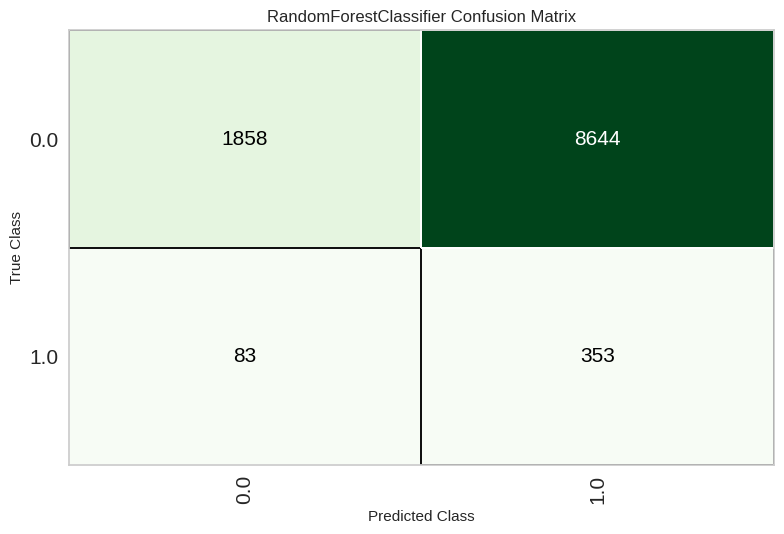

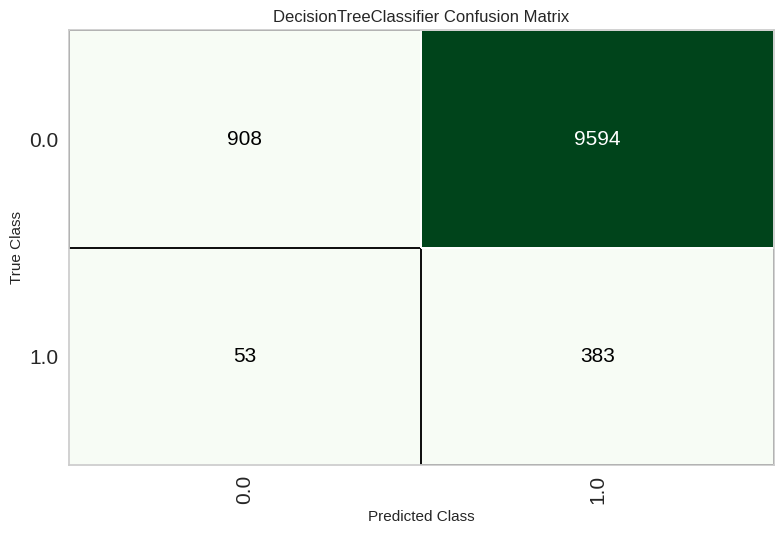

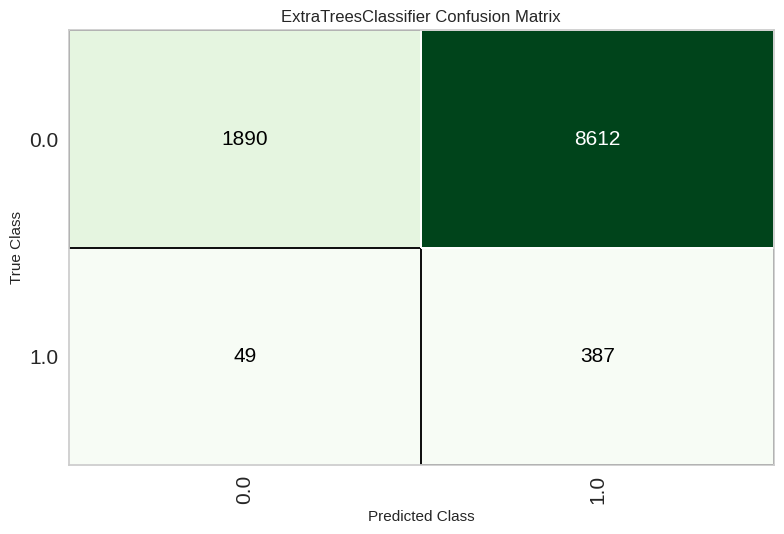

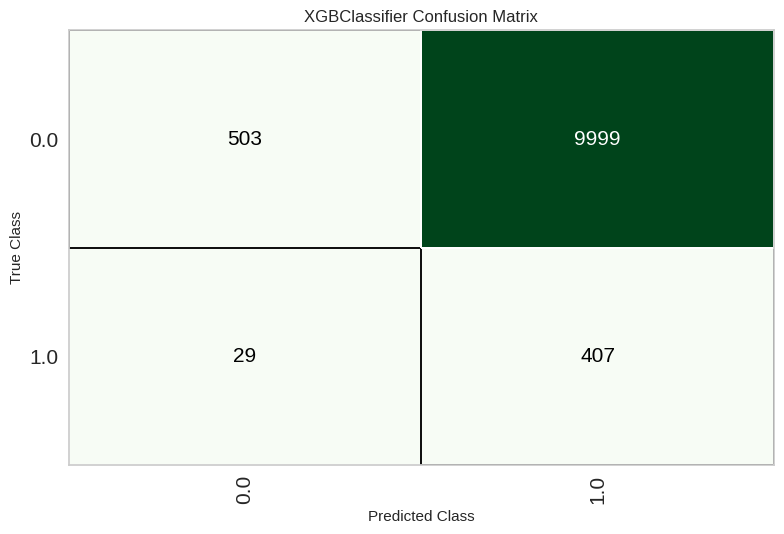

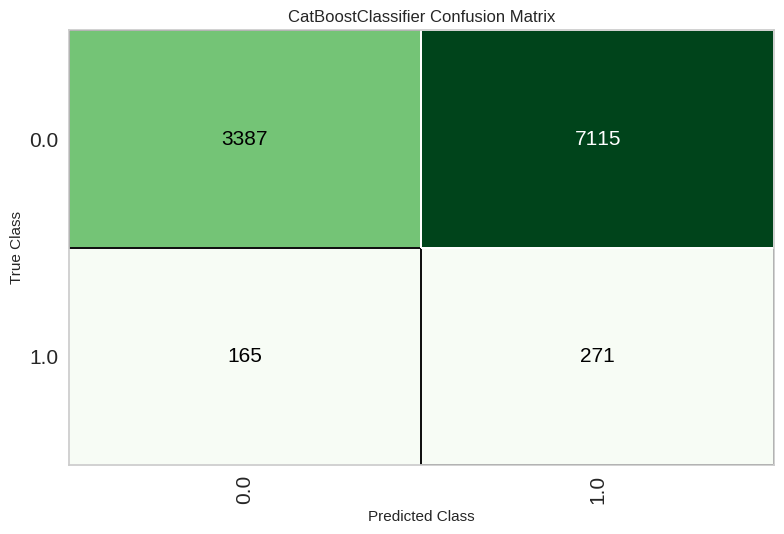

...

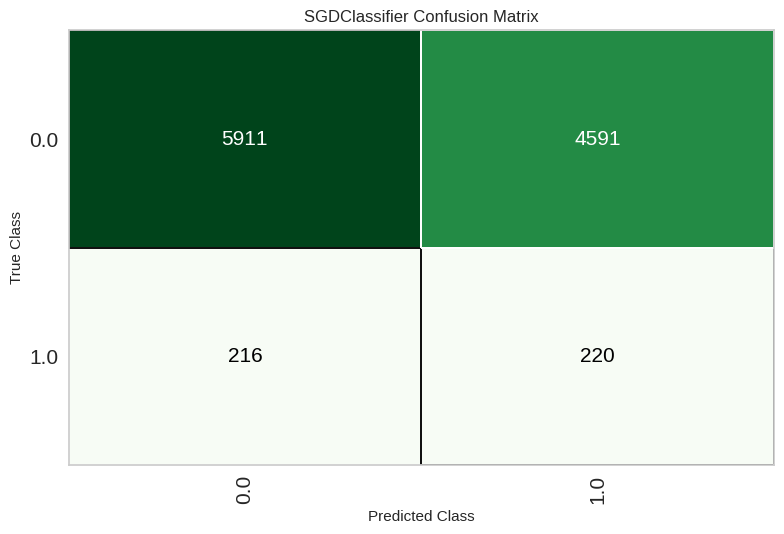

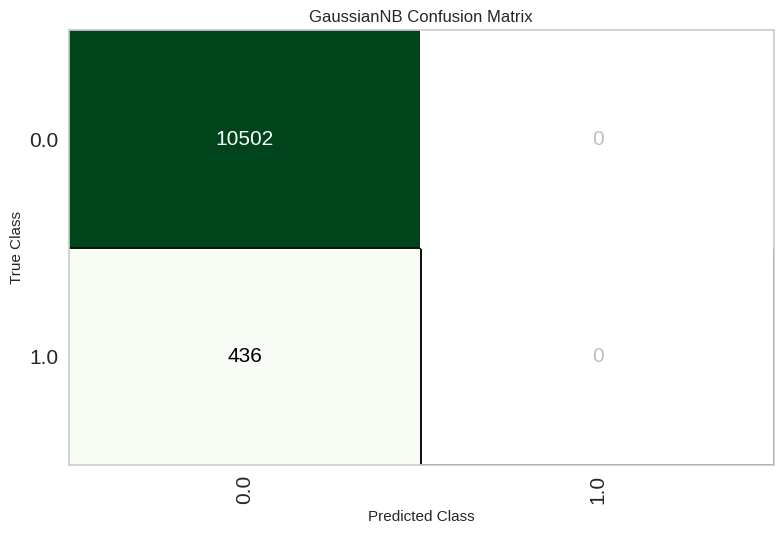

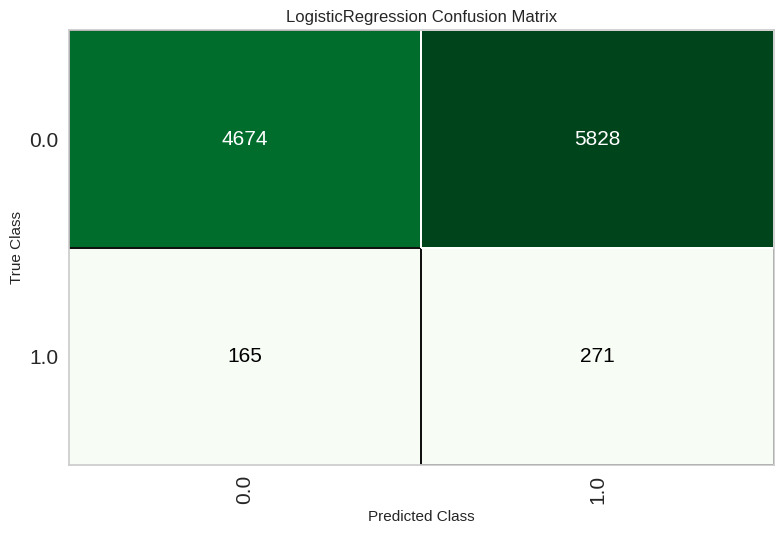

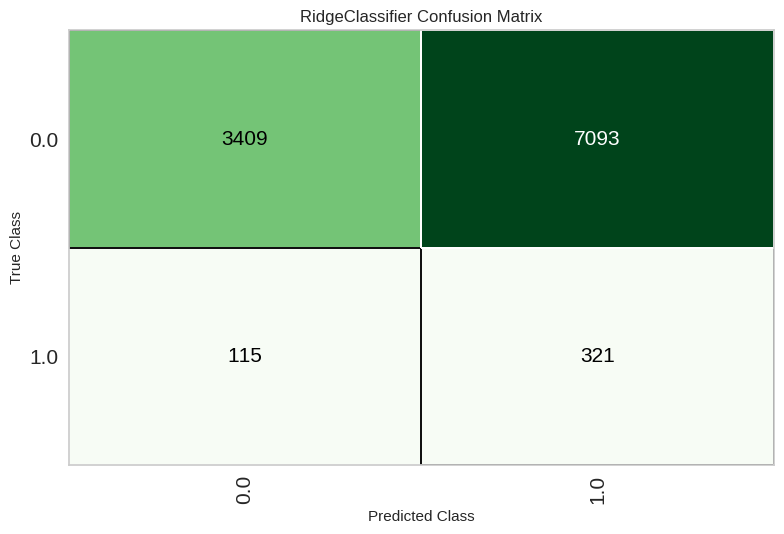

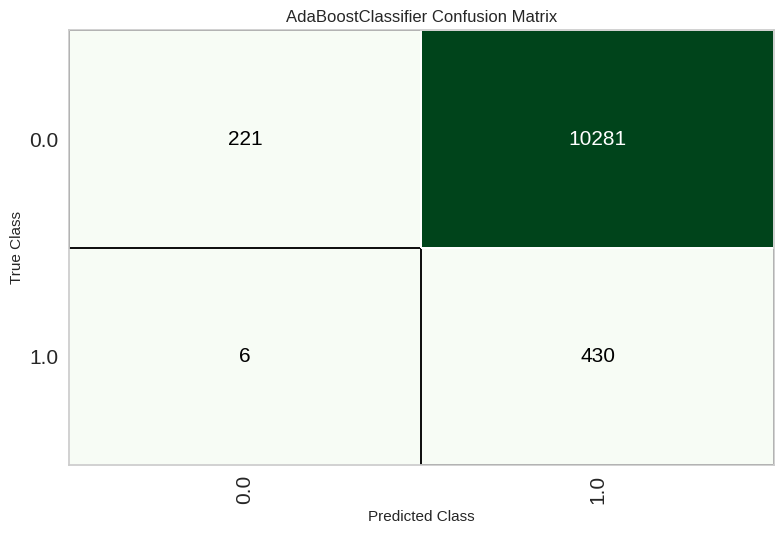

In [ ]:
plot_model(rf,plot = 'confusion_matrix')
plot_model(dt,plot = 'confusion_matrix')
plot_model(et,plot = 'confusion_matrix')
plot_model(xgboost,plot = 'confusion_matrix')
plot_model(catboost,plot = 'confusion_matrix')
plot_model(knn,plot = 'confusion_matrix')
plot_model(lightgbm,plot = 'confusion_matrix')
plot_model(qda,plot = 'confusion_matrix')
plot_model(lda,plot = 'confusion_matrix')
plot_model(gbc,plot = 'confusion_matrix')
plot_model(svm,plot = 'confusion_matrix')
plot_model(nb,plot = 'confusion_matrix')
plot_model(lr,plot = 'confusion_matrix')
plot_model(ridge,plot = 'confusion_matrix')
plot_model(ada,plot = 'confusion_matrix')

### Tune with ADASYN

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.6297,0.0000,0.4828,0.0520,0.0940,0.0239,0.0480,0.4486
1,0.6388,0.0000,0.3172,0.0364,0.0653,-0.0065,-0.0126,0.5115
2,0.5420,0.0000,0.6414,0.0544,0.1002,0.0290,0.0702,0.4188
3,0.5302,0.0000,0.3103,0.0271,0.0499,-0.0251,-0.0590,0.5612
4,0.5727,0.0000,0.4863,0.0457,0.0835,0.0111,0.0248,0.4713
5,0.5222,0.0000,0.3904,0.0333,0.0614,-0.0134,-0.0322,0.5360
6,0.4482,0.0000,0.6027,0.0431,0.0804,0.0062,0.0176,0.4809
7,0.5781,0.0000,0.4966,0.0468,0.0856,0.0139,0.0309,0.4641
8,0.3632,0.0000,0.6207,0.0382,0.0720,-0.0032,-0.0109,0.5105


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.7005,0.0000,0.3586,0.0495,0.0870,0.0183,0.0316,0.4730
1,0.7597,0.0000,0.1931,0.0356,0.0601,-0.0076,-0.0113,0.5074
2,0.7329,0.0000,0.4690,0.0705,0.1225,0.0573,0.0942,0.4166
3,0.5688,0.0000,0.1931,0.0189,0.0344,-0.0410,-0.0885,0.5800
4,0.5579,0.0000,0.6233,0.0552,0.1014,0.0301,0.0703,0.4165
5,0.6369,0.0000,0.3425,0.0391,0.0702,-0.0018,-0.0034,0.5032
6,0.5576,0.0000,0.4658,0.0424,0.0778,0.0047,0.0107,0.4876
7,0.6798,0.0000,0.3862,0.0494,0.0876,0.0183,0.0330,0.4701
8,0.5012,0.0000,0.5034,0.0401,0.0743,0.0007,0.0018,0.4977


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 50 candidates, totalling 500 fits


SGDClassifier(alpha=0.0001, average=False, class_weight=None,
              early_stopping=False, epsilon=0.1, eta0=0.001, fit_intercept=True,
              l1_ratio=0.15, learning_rate='optimal', loss='hinge',
              max_iter=1000, n_iter_no_change=5, n_jobs=-1, penalty='l2',
              power_t=0.5, random_state=5059, shuffle=True, tol=0.001,
              validation_fraction=0.1, verbose=0, warm_start=False)
SGDClassifier(alpha=0.4, average=False, class_weight=None, early_stopping=False,
              epsilon=0.1, eta0=0.01, fit_intercept=False,
              l1_ratio=0.1300000001, learning_rate='optimal', loss='hinge',
              max_iter=1000, n_iter_no_change=5, n_jobs=-1,
              penalty='elasticnet', power_t=0.5, random_state=5059,
              shuffle=True, tol=0.001, validation_fraction=0.1, verbose=0,
              warm_start=False)


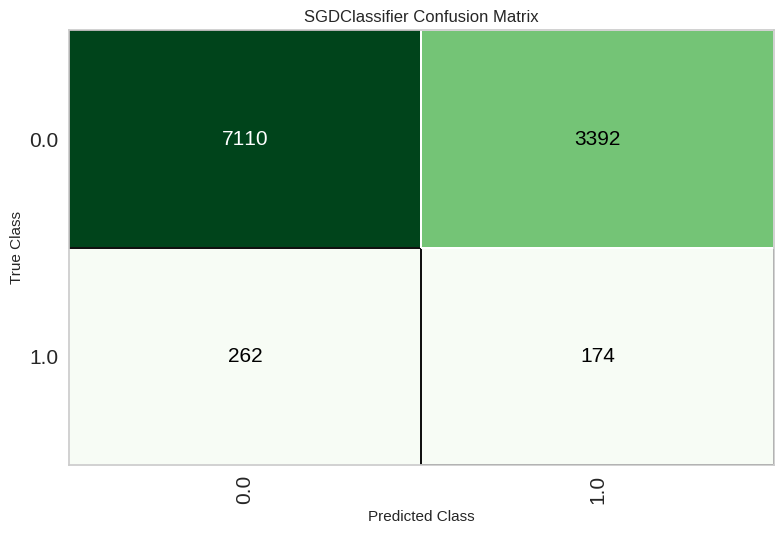

In [ ]:
svm = create_model('svm')

tuned_svm, tuner = tune_model(svm,optimize = 'eer',return_tuner=True,choose_better = True,n_iter = 50)

print(svm)
print(tuned_svm)


plot_model(tuned_svm,plot = 'confusion_matrix')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.8796,0.4968,0.0897,0.0406,0.0559,0.0012,0.0014,0.4995
1,0.8626,0.4715,0.1103,0.0412,0.0600,0.0023,0.0026,0.4989
2,0.8629,0.4894,0.0897,0.0341,0.0494,-0.0087,-0.0099,0.5043
3,0.8050,0.4233,0.0276,0.0070,0.0111,-0.0559,-0.0726,0.5374
4,0.8132,0.4341,0.0548,0.0145,0.0230,-0.0431,-0.0549,0.5280
5,0.8225,0.4475,0.0479,0.0136,0.0212,-0.0440,-0.0547,0.5269
6,0.7970,0.4357,0.0548,0.0131,0.0212,-0.0465,-0.0616,0.5330
7,0.8340,0.5171,0.0966,0.0287,0.0442,-0.0182,-0.0223,0.5110
8,0.8255,0.5303,0.1517,0.0411,0.0647,0.0023,0.0028,0.4985


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.7507,0.5592,0.2207,0.0386,0.0658,-0.0020,-0.0031,0.5022
1,0.7364,0.4688,0.2000,0.0332,0.0569,-0.0121,-0.0189,0.5133
2,0.7951,0.4831,0.2690,0.0574,0.0945,0.0310,0.0431,0.4723
3,0.7521,0.5022,0.2207,0.0389,0.0661,-0.0016,-0.0025,0.5017
4,0.7894,0.5484,0.2466,0.0519,0.0857,0.0209,0.0293,0.4813
5,0.7326,0.5049,0.2534,0.0410,0.0705,0.0017,0.0027,0.4980
6,0.7444,0.4680,0.2055,0.0355,0.0605,-0.0084,-0.0128,0.5089
7,0.8453,0.5239,0.1931,0.0589,0.0903,0.0313,0.0380,0.4805
8,0.9062,0.5239,0.1034,0.0661,0.0806,0.0337,0.0347,0.4883


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 10 candidates, totalling 100 fits


DecisionTreeClassifier(ccp_alpha=0.0, class_weight=None, criterion='gini',
                       max_depth=None, max_features=None, max_leaf_nodes=None,
                       min_impurity_decrease=0.0, min_samples_leaf=1,
                       min_samples_split=2, min_weight_fraction_leaf=0.0,
                       random_state=7086, splitter='best')
DecisionTreeClassifier(ccp_alpha=0.0, class_weight=None, criterion='entropy',
                       max_depth=7, max_features='log2', max_leaf_nodes=None,
                       min_impurity_decrease=0.002, min_samples_leaf=5,
                       min_samples_split=9, min_weight_fraction_leaf=0.0,
                       random_state=7086, splitter='best')


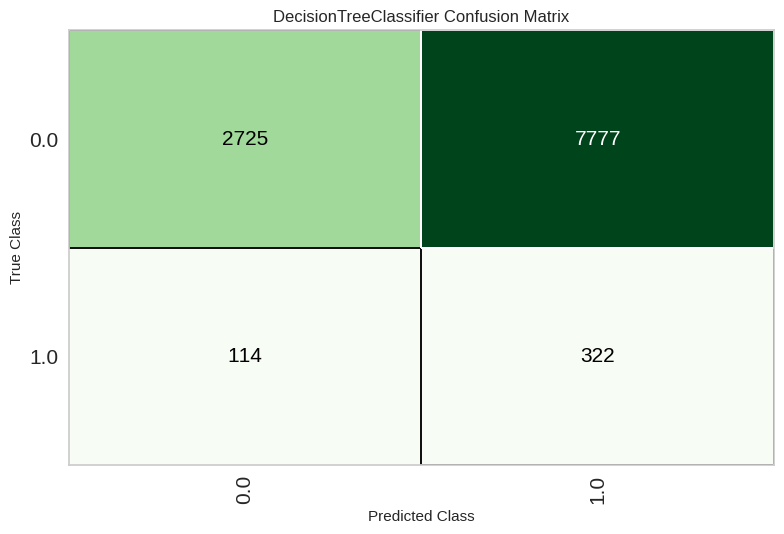

In [ ]:
dt = create_model('dt')

tuned_dt, tuner = tune_model(dt,optimize = 'eer',return_tuner=True,choose_better = True)

print(dt)
print(tuned_dt)

plot_model(tuned_dt,plot = 'confusion_matrix')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.6004,0.0000,0.4069,0.0413,0.0749,0.0029,0.0061,0.4936
1,0.6141,0.0000,0.3379,0.0360,0.0651,-0.0073,-0.0148,0.5142
2,0.5749,0.0000,0.5931,0.0545,0.0999,0.0292,0.0660,0.4179
3,0.5230,0.0000,0.3241,0.0278,0.0513,-0.0237,-0.0567,0.5599
4,0.6149,0.0000,0.4247,0.0449,0.0812,0.0094,0.0192,0.4802
5,0.5741,0.0000,0.4247,0.0405,0.0739,0.0009,0.0020,0.4979
6,0.4967,0.0000,0.5137,0.0408,0.0756,0.0015,0.0038,0.4952
7,0.5863,0.0000,0.5310,0.0508,0.0927,0.0216,0.0474,0.4435
8,0.4779,0.0000,0.5931,0.0446,0.0829,0.0096,0.0259,0.4704


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.5968,0.0000,0.4069,0.0409,0.0743,0.0022,0.0046,0.4952
1,0.6237,0.0000,0.3379,0.0370,0.0667,-0.0054,-0.0108,0.5102
2,0.5782,0.0000,0.5931,0.0550,0.1006,0.0300,0.0674,0.4160
3,0.5181,0.0000,0.3379,0.0287,0.0528,-0.0221,-0.0535,0.5575
4,0.6221,0.0000,0.4247,0.0457,0.0826,0.0111,0.0223,0.4772
5,0.5831,0.0000,0.4110,0.0402,0.0732,0.0002,0.0005,0.4995
6,0.5000,0.0000,0.5137,0.0411,0.0760,0.0020,0.0051,0.4935
7,0.5920,0.0000,0.5172,0.0503,0.0916,0.0206,0.0447,0.4479
8,0.4801,0.0000,0.5862,0.0443,0.0823,0.0090,0.0242,0.4721


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 10 candidates, totalling 100 fits


RidgeClassifier(alpha=1.0, class_weight=None, copy_X=True, fit_intercept=True,
                max_iter=None, positive=False, random_state=7086, solver='auto',
                tol=0.0001)
RidgeClassifier(alpha=6.45, class_weight=None, copy_X=True, fit_intercept=False,
                max_iter=None, positive=False, random_state=7086, solver='auto',
                tol=0.0001)


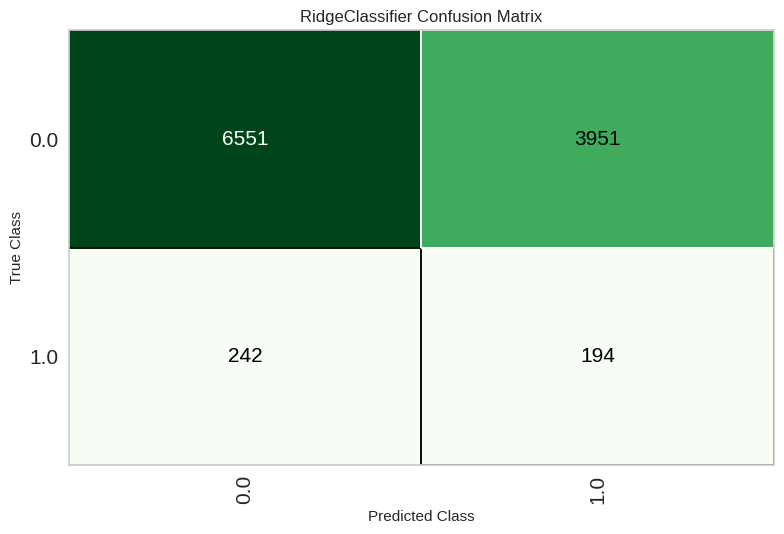

In [ ]:
ridge = create_model('ridge')

tuned_ridge, tuner = tune_model(ridge,optimize = 'eer',return_tuner=True,choose_better = True)

print(ridge)
print(tuned_ridge)

plot_model(tuned_ridge,plot = 'confusion_matrix')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.6004,0.5271,0.4069,0.0413,0.0749,0.0029,0.0061,0.4936
1,0.6141,0.4975,0.3379,0.0360,0.0651,-0.0073,-0.0148,0.5142
2,0.5749,0.5754,0.5931,0.0545,0.0999,0.0292,0.0660,0.4179
3,0.5230,0.4046,0.3241,0.0278,0.0513,-0.0237,-0.0567,0.5599
4,0.6149,0.5466,0.4247,0.0449,0.0812,0.0094,0.0192,0.4802
5,0.5741,0.5269,0.4247,0.0405,0.0739,0.0009,0.0020,0.4979
6,0.4967,0.5179,0.5137,0.0408,0.0756,0.0015,0.0038,0.4952
7,0.5863,0.5555,0.5310,0.0508,0.0927,0.0216,0.0474,0.4435
8,0.4779,0.5246,0.5931,0.0446,0.0829,0.0096,0.0259,0.4704


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.6004,0.5274,0.4069,0.0413,0.0749,0.0029,0.0061,0.4936
1,0.6201,0.4976,0.3379,0.0366,0.0661,-0.0061,-0.0123,0.5117
2,0.5768,0.5753,0.5931,0.0548,0.1003,0.0296,0.0668,0.4168
3,0.5274,0.4044,0.3241,0.0281,0.0517,-0.0232,-0.0549,0.5578
4,0.6160,0.5468,0.4247,0.0450,0.0814,0.0096,0.0197,0.4797
5,0.5757,0.5259,0.4315,0.0413,0.0753,0.0024,0.0053,0.4943
6,0.4964,0.5162,0.5137,0.0408,0.0755,0.0014,0.0037,0.4954
7,0.5866,0.5519,0.5172,0.0496,0.0905,0.0193,0.0423,0.4503
8,0.4754,0.5102,0.5793,0.0434,0.0808,0.0073,0.0198,0.4772


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 10 candidates, totalling 100 fits


Original model was better than the tuned model, hence it will be returned. NOTE: The display metrics are for the tuned model (not the original one).
LinearDiscriminantAnalysis(covariance_estimator=None, n_components=None,
                           priors=None, shrinkage=None, solver='svd',
                           store_covariance=False, tol=0.0001)
LinearDiscriminantAnalysis(covariance_estimator=None, n_components=None,
                           priors=None, shrinkage=None, solver='svd',
                           store_covariance=False, tol=0.0001)


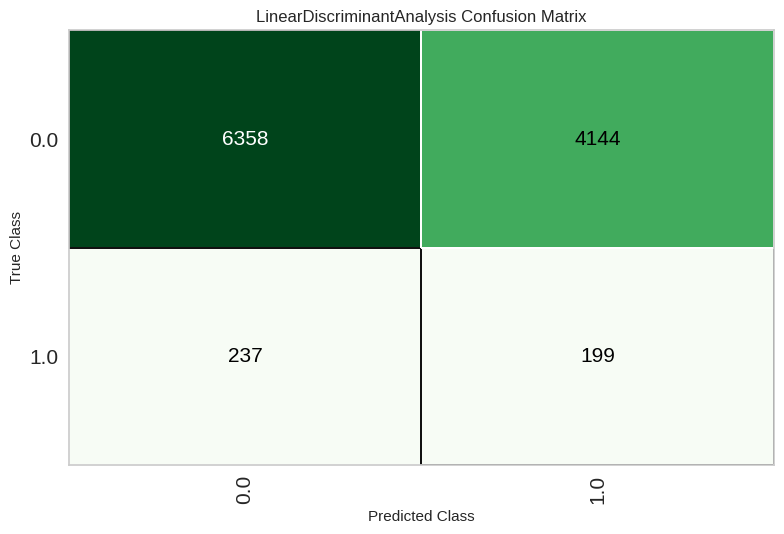

In [ ]:

lda = create_model('lda')

tuned_lda, tuner = tune_model(lda,optimize = 'eer',return_tuner=True,choose_better = True)

print(lda)
print(tuned_lda)

plot_model(tuned_lda,plot = 'confusion_matrix')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9515,0.5107,0.0276,0.1000,0.0432,0.0265,0.0325,0.4956
1,0.9435,0.5562,0.0207,0.0448,0.0283,0.0032,0.0035,0.4994
2,0.9528,0.4792,0.0207,0.0909,0.0337,0.0192,0.0250,0.4969
3,0.9317,0.4184,0.0069,0.0094,0.0080,-0.0265,-0.0269,0.5059
4,0.9454,0.4699,0.0068,0.0182,0.0100,-0.0122,-0.0138,0.5022
5,0.9328,0.4965,0.0137,0.0194,0.0161,-0.0176,-0.0179,0.5039
6,0.9172,0.3927,0.0205,0.0185,0.0195,-0.0236,-0.0237,0.5064
7,0.9333,0.5221,0.0621,0.0776,0.0690,0.0348,0.0351,0.4917
8,0.9248,0.5315,0.0759,0.0728,0.0743,0.0352,0.0352,0.4905


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9457,0.5270,0.0345,0.0794,0.0481,0.0246,0.0269,0.4954
1,0.9227,0.5436,0.0621,0.0581,0.0600,0.0197,0.0197,0.4946
2,0.9495,0.5051,0.0828,0.1905,0.1154,0.0935,0.1023,0.4821
3,0.9144,0.3794,0.0138,0.0117,0.0127,-0.0318,-0.0319,0.5089
4,0.9158,0.4299,0.0411,0.0347,0.0376,-0.0061,-0.0061,0.5017
5,0.9183,0.4767,0.0274,0.0250,0.0261,-0.0164,-0.0164,0.5045
6,0.8944,0.4259,0.0411,0.0239,0.0302,-0.0215,-0.0224,0.5077
7,0.9171,0.5432,0.0897,0.0710,0.0793,0.0365,0.0368,0.4890
8,0.9056,0.5896,0.0897,0.0578,0.0703,0.0230,0.0236,0.4921


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 10 candidates, totalling 100 fits


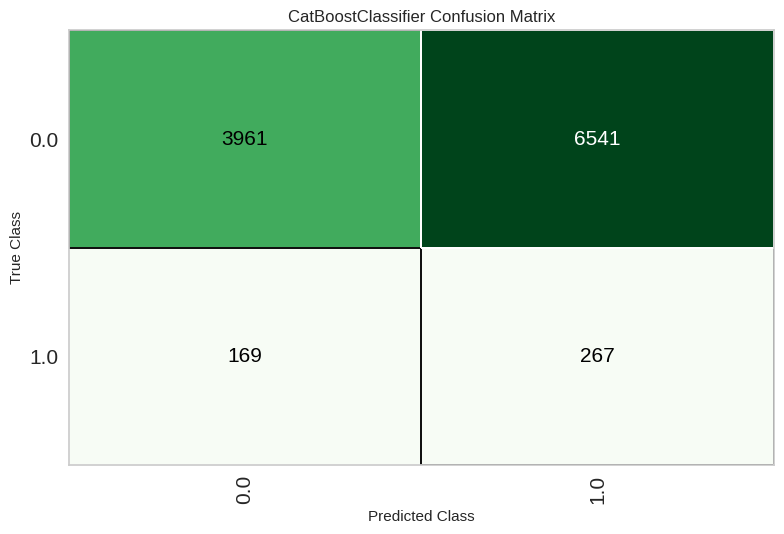

In [ ]:
cb = create_model('catboost')

tuned_cb, tuner = tune_model(cb,optimize = 'eer',return_tuner=True,choose_better = True)

print(cb)
print(tuned_cb)

plot_model(tuned_cb,plot = 'confusion_matrix')


,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9620,0.6864,0.0891,0.6429,0.1565,0.1483,0.2298,0.4772
1,0.9632,0.7271,0.1287,0.6842,0.2167,0.2067,0.2864,0.4662
2,0.9624,0.7097,0.0980,0.7143,0.1724,0.1644,0.2557,0.4746
3,0.9624,0.7391,0.1275,0.6500,0.2131,0.2027,0.2768,0.4667
4,0.9604,0.7003,0.0686,0.5385,0.1217,0.1137,0.1821,0.4828
5,0.9596,0.7399,0.0980,0.4762,0.1626,0.1510,0.2028,0.4753
6,0.9616,0.7544,0.0980,0.6250,0.1695,0.1604,0.2372,0.4748
7,0.9624,0.6892,0.1176,0.6667,0.2000,0.1903,0.2696,0.4694
8,0.9624,0.6915,0.1176,0.6667,0.2000,0.1903,0.2696,0.4694


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.8891,0.6741,0.4752,0.1727,0.2533,0.2073,0.2387,0.3667
1,0.8993,0.7059,0.4653,0.1880,0.2678,0.2241,0.2509,0.3683
2,0.8938,0.7228,0.5000,0.1882,0.2735,0.2287,0.2608,0.3546
3,0.8766,0.7243,0.4902,0.1597,0.2410,0.1923,0.2286,0.3635
4,0.8930,0.7137,0.4314,0.1699,0.2438,0.1978,0.2229,0.3840
5,0.8942,0.7347,0.4706,0.1818,0.2623,0.2172,0.2460,0.3673
6,0.8934,0.7457,0.5490,0.1986,0.2917,0.2475,0.2854,0.3319
7,0.8989,0.7200,0.4608,0.1880,0.2670,0.2229,0.2490,0.3702
8,0.8942,0.6874,0.4412,0.1744,0.2500,0.2044,0.2302,0.3797


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 10 candidates, totalling 100 fits


XGBClassifier(base_score=None, booster='gbtree', callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, device='cpu', early_stopping_rounds=None,
              enable_categorical=False, eval_metric=None, feature_types=None,
              gamma=None, grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=None, max_bin=None,
              max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=None, max_leaves=None,
              min_child_weight=None, missing=nan, monotone_constraints=None,
              multi_strategy=None, n_estimators=None, n_jobs=-1,
              num_parallel_tree=None, objective='binary:logistic', ...)
XGBClassifier(base_score=None, booster='gbtree', callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=0.9, device='cpu', early_stopping_rounds=None,
              enable_cate

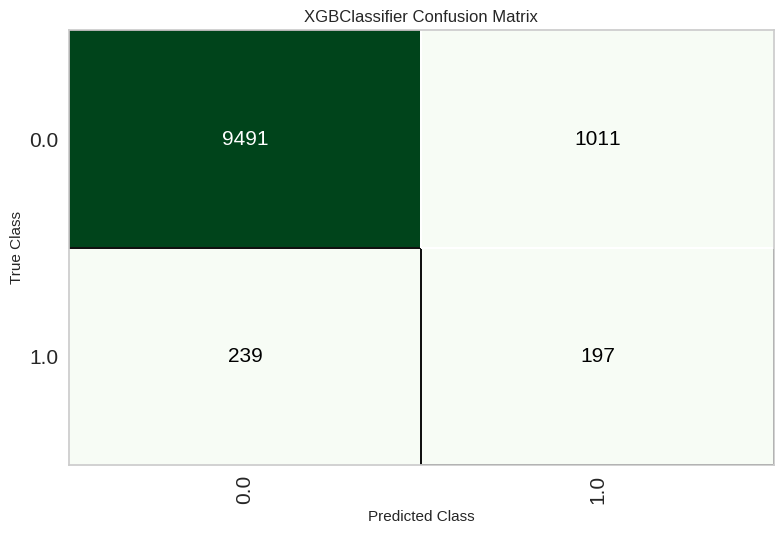

In [ ]:
xgboost = create_model('xgboost')

tuned_xgboost, tuner = tune_model(xgboost,optimize = 'eer',return_tuner=True,choose_better = True)

print(xgboost)
print(tuned_xgboost)

plot_model(tuned_xgboost,plot = 'confusion_matrix')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9608,0.7077,0.0297,0.6000,0.0566,0.0531,0.1274,0.4927
1,0.9632,0.7131,0.0891,0.8182,0.1607,0.1541,0.2628,0.4769
2,0.9608,0.7191,0.0490,0.6250,0.0909,0.0856,0.1675,0.4877
3,0.9628,0.6985,0.0882,0.8182,0.1593,0.1527,0.2614,0.4771
4,0.9608,0.6981,0.0392,0.6667,0.0741,0.0699,0.1553,0.4902
5,0.9616,0.7117,0.0588,0.7500,0.1091,0.1039,0.2033,0.4851
6,0.9620,0.7167,0.0588,0.8571,0.1101,0.1055,0.2188,0.4850
7,0.9620,0.6917,0.0686,0.7778,0.1261,0.1204,0.2241,0.4824
8,0.9612,0.6907,0.0686,0.6364,0.1239,0.1170,0.2003,0.4826


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9538,0.7102,0.0990,0.2703,0.1449,0.1264,0.1435,0.4767
1,0.9581,0.7419,0.1089,0.3929,0.1705,0.1560,0.1909,0.4729
2,0.9612,0.7083,0.1176,0.5714,0.1951,0.1840,0.2471,0.4697
3,0.9589,0.7139,0.1373,0.4516,0.2105,0.1955,0.2330,0.4649
4,0.9620,0.6921,0.1471,0.6000,0.2362,0.2240,0.2844,0.4613
5,0.9577,0.7323,0.1275,0.4062,0.1940,0.1783,0.2107,0.4679
6,0.9561,0.7385,0.1078,0.3438,0.1642,0.1479,0.1748,0.4736
7,0.9592,0.7128,0.1667,0.4722,0.2464,0.2303,0.2640,0.4565
8,0.9589,0.6822,0.1078,0.4400,0.1732,0.1600,0.2031,0.4729


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 10 candidates, totalling 100 fits


LGBMClassifier(boosting_type='gbdt', class_weight=None, colsample_bytree=1.0,
               importance_type='split', learning_rate=0.1, max_depth=-1,
               min_child_samples=20, min_child_weight=0.001, min_split_gain=0.0,
               n_estimators=100, n_jobs=-1, num_leaves=31, objective=None,
               random_state=123, reg_alpha=0.0, reg_lambda=0.0, subsample=1.0,
               subsample_for_bin=200000, subsample_freq=0)
LGBMClassifier(bagging_fraction=0.9, bagging_freq=3, boosting_type='gbdt',
               class_weight=None, colsample_bytree=1.0, feature_fraction=0.5,
               importance_type='split', learning_rate=0.4, max_depth=-1,
               min_child_samples=6, min_child_weight=0.001, min_split_gain=0.3,
               n_estimators=20, n_jobs=-1, num_leaves=150, objective=None,
               random_state=123, reg_alpha=0.005, reg_lambda=0.0005,
               subsample=1.0, subsample_for_bin=200000, subsample_freq=0)


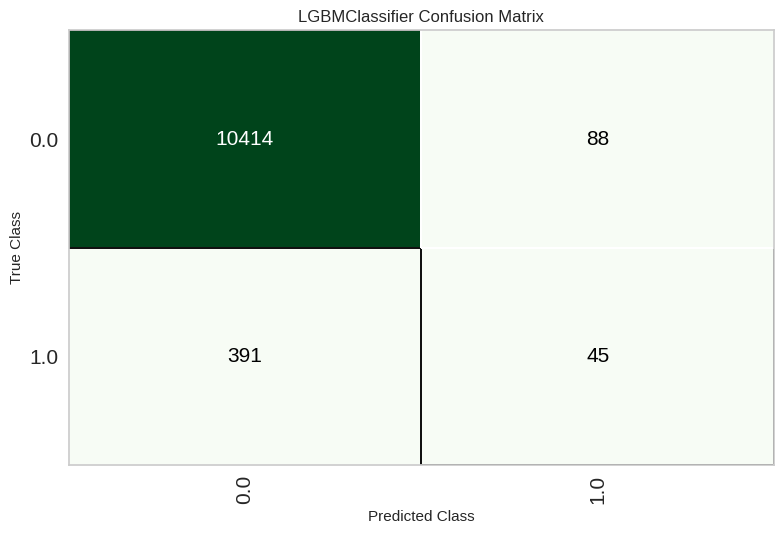

In [ ]:

lightgbm = create_model('lightgbm')

tuned_lightgbm, tuner = tune_model(lightgbm,optimize = 'eer',return_tuner=True,choose_better = True)

print(lightgbm)
print(tuned_lightgbm)

plot_model(tuned_lightgbm,plot = 'confusion_matrix')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9604,0.6035,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
1,0.9604,0.5676,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
2,0.9600,0.5942,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
3,0.9600,0.6582,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
4,0.9600,0.5891,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
5,0.9600,0.5577,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
6,0.9596,0.5777,0.0000,0.0000,0.0000,-0.0008,-0.0040,0.5001
7,0.9600,0.5693,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
8,0.9600,0.5935,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9604,0.5826,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
1,0.9604,0.5116,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
2,0.9600,0.5346,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
3,0.9600,0.6137,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
4,0.9600,0.5495,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
5,0.9600,0.5308,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
6,0.9600,0.5733,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
7,0.9600,0.5318,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000
8,0.9600,0.5716,0.0000,0.0000,0.0000,0.0000,0.0000,0.5000


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 10 candidates, totalling 100 fits


Original model was better than the tuned model, hence it will be returned. NOTE: The display metrics are for the tuned model (not the original one).
AdaBoostClassifier(algorithm='SAMME.R', base_estimator='deprecated',
                   estimator=None, learning_rate=1.0, n_estimators=50,
                   random_state=123)
AdaBoostClassifier(algorithm='SAMME.R', base_estimator='deprecated',
                   estimator=None, learning_rate=1.0, n_estimators=50,
                   random_state=123)


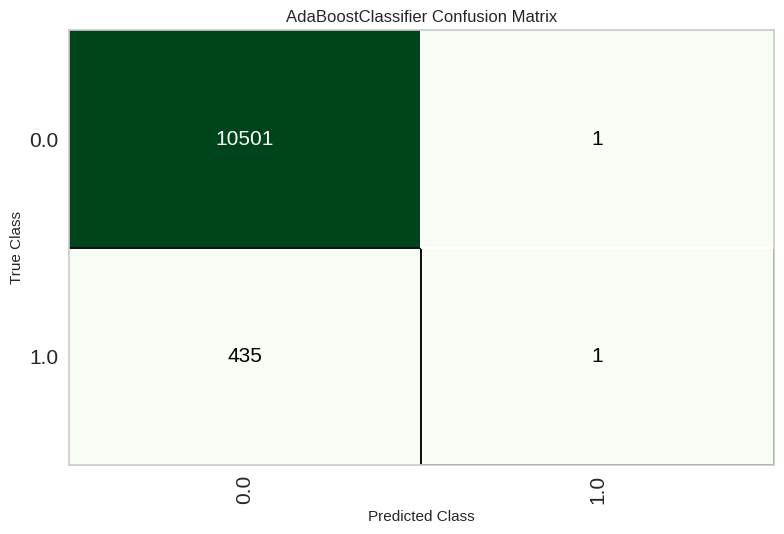

In [ ]:
adaboost = create_model('ada')

tuned_ada, tuner = tune_model(adaboost,optimize = 'eer',return_tuner=True,choose_better = True)

print(adaboost)
print(tuned_ada)

plot_model(tuned_ada,plot = 'confusion_matrix')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.5266,0.5352,0.5446,0.0452,0.0835,0.0112,0.0275,0.4654
1,0.8350,0.5202,0.1782,0.0506,0.0788,0.0182,0.0227,0.4880
2,0.9585,0.5039,0.0098,0.1667,0.0185,0.0141,0.0314,0.4980
3,0.6324,0.5267,0.4118,0.0457,0.0822,0.0110,0.0218,0.4783
4,0.4216,0.4968,0.5784,0.0395,0.0740,-0.0009,-0.0026,0.5028
5,0.9585,0.4992,0.0000,0.0000,0.0000,-0.0030,-0.0081,0.5004
6,0.8315,0.5082,0.1569,0.0444,0.0693,0.0074,0.0093,0.4952
7,0.5831,0.5527,0.5196,0.0496,0.0906,0.0190,0.0418,0.4506
8,0.8045,0.5270,0.2255,0.0519,0.0844,0.0208,0.0280,0.4831


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.8480,0.5077,0.1683,0.0530,0.0806,0.0217,0.0260,0.4870
1,0.8546,0.6060,0.1980,0.0645,0.0973,0.0400,0.0476,0.4763
2,0.8429,0.5825,0.1569,0.0483,0.0739,0.0136,0.0165,0.4917
3,0.8503,0.6207,0.3137,0.0930,0.1435,0.0872,0.1069,0.4402
4,0.8472,0.5318,0.1078,0.0355,0.0534,-0.0072,-0.0085,0.5040
5,0.8515,0.5717,0.1667,0.0547,0.0823,0.0235,0.0279,0.4864
6,0.8472,0.5507,0.1765,0.0556,0.0845,0.0252,0.0303,0.4848
7,0.8503,0.5639,0.1569,0.0513,0.0773,0.0181,0.0216,0.4895
8,0.8468,0.5301,0.1863,0.0581,0.0886,0.0294,0.0355,0.4821


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 10 candidates, totalling 100 fits


QuadraticDiscriminantAnalysis(priors=None, reg_param=0.0,
                              store_covariance=False, tol=0.0001)
QuadraticDiscriminantAnalysis(priors=None, reg_param=0.17,
                              store_covariance=False, tol=0.0001)


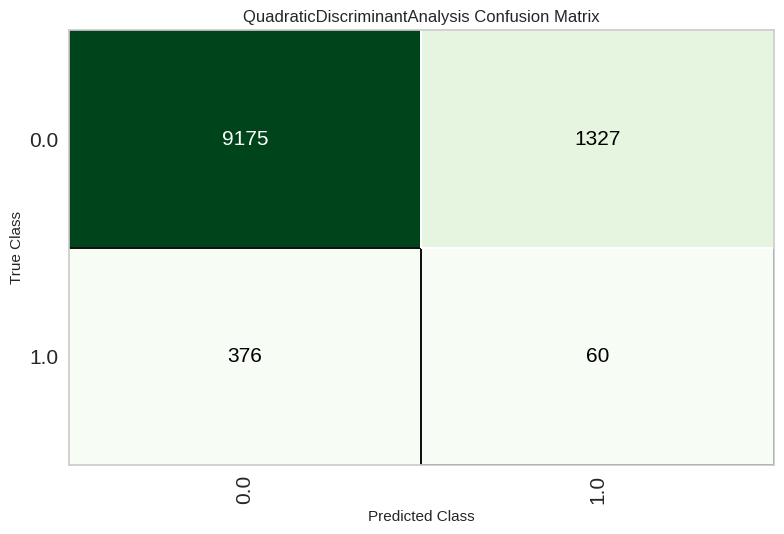

In [ ]:

qda = create_model('qda')

tuned_qda, tuner = tune_model(qda,optimize = 'eer',return_tuner=True,choose_better = True)

print(qda)
print(tuned_qda)

plot_model(tuned_qda,plot = 'confusion_matrix')


,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9612,0.6339,0.0297,0.7500,0.0571,0.0543,0.1444,0.4926
1,0.9604,0.6170,0.0198,0.5000,0.0381,0.0352,0.0936,0.4952
2,0.9600,0.6360,0.0098,0.5000,0.0192,0.0177,0.0658,0.4976
3,0.9604,0.6950,0.0294,0.6000,0.0561,0.0525,0.1267,0.4927
4,0.9612,0.6061,0.0294,1.0000,0.0571,0.0550,0.1681,0.4925
5,0.9604,0.6138,0.0196,0.6667,0.0381,0.0359,0.1098,0.4952
6,0.9608,0.6057,0.0196,1.0000,0.0385,0.0370,0.1373,0.4950
7,0.9604,0.5980,0.0098,1.0000,0.0194,0.0187,0.0970,0.4975
8,0.9604,0.6278,0.0098,1.0000,0.0194,0.0187,0.0970,0.4975


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9592,0.7166,0.1485,0.4545,0.2239,0.2085,0.2436,0.4617
1,0.9624,0.7100,0.1881,0.5758,0.2836,0.2693,0.3148,0.4495
2,0.9589,0.7365,0.1863,0.4634,0.2657,0.2485,0.2762,0.4509
3,0.9592,0.7072,0.1667,0.4722,0.2464,0.2303,0.2640,0.4565
4,0.9589,0.6997,0.1078,0.4400,0.1732,0.1600,0.2031,0.4729
5,0.9600,0.7405,0.1569,0.5000,0.2388,0.2240,0.2646,0.4591
6,0.9600,0.7302,0.1667,0.5000,0.2500,0.2347,0.2729,0.4563
7,0.9600,0.7156,0.1765,0.5000,0.2609,0.2451,0.2809,0.4534
8,0.9604,0.6874,0.1569,0.5161,0.2406,0.2262,0.2696,0.4590


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 10 candidates, totalling 100 fits


GradientBoostingClassifier(ccp_alpha=0.0, criterion='friedman_mse', init=None,
                           learning_rate=0.1, loss='log_loss', max_depth=3,
                           max_features=None, max_leaf_nodes=None,
                           min_impurity_decrease=0.0, min_samples_leaf=1,
                           min_samples_split=2, min_weight_fraction_leaf=0.0,
                           n_estimators=100, n_iter_no_change=None,
                           random_state=123, subsample=1.0, tol=0.0001,
                           validation_fraction=0.1, verbose=0,
                           warm_start=False)
GradientBoostingClassifier(ccp_alpha=0.0, criterion='friedman_mse', init=None,
                           learning_rate=0.15, loss='log_loss', max_depth=7,
                           max_features=1.0, max_leaf_nodes=None,
                           min_impurity_decrease=0.02, min_samples_leaf=5,
                           min_samples_split=5, min_weight_fraction_leaf=0.0,
   

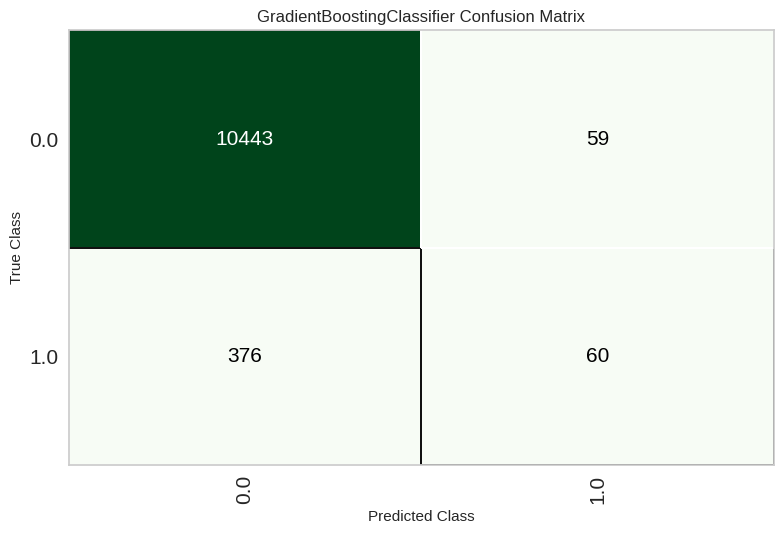

In [ ]:
gbc = create_model('gbc')

tuned_gbc, tuner = tune_model(gbc,optimize = 'eer',return_tuner=True,choose_better = True)

print(gbc)
print(tuned_gbc)

plot_model(tuned_gbc,plot = 'confusion_matrix')


,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9581,0.7913,0.1485,0.4167,0.2190,0.2024,0.2314,0.4620
1,0.9600,0.7450,0.2376,0.4898,0.3200,0.3020,0.3231,0.4351
2,0.9608,0.7480,0.2255,0.5227,0.3151,0.2982,0.3264,0.4386
3,0.9549,0.7936,0.1863,0.3725,0.2484,0.2278,0.2425,0.4519
4,0.9600,0.7480,0.1765,0.5000,0.2609,0.2451,0.2809,0.4534
5,0.9553,0.7170,0.1275,0.3421,0.1857,0.1677,0.1896,0.4685
6,0.9569,0.7910,0.2157,0.4231,0.2857,0.2659,0.2821,0.4426
7,0.9600,0.7003,0.2157,0.5000,0.3014,0.2841,0.3111,0.4418
8,0.9577,0.7591,0.1765,0.4286,0.2500,0.2321,0.2566,0.4541


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.6611,0.6252,0.5545,0.0639,0.1146,0.0470,0.0903,0.4010
1,0.6642,0.5709,0.3663,0.0446,0.0795,0.0096,0.0178,0.4837
2,0.6575,0.5644,0.4118,0.0491,0.0877,0.0175,0.0330,0.4683
3,0.6712,0.6668,0.5784,0.0690,0.1233,0.0559,0.1052,0.3844
4,0.6536,0.5655,0.4706,0.0547,0.0980,0.0284,0.0544,0.4446
5,0.6540,0.5555,0.3725,0.0443,0.0792,0.0084,0.0159,0.4852
6,0.6885,0.5879,0.4412,0.0575,0.1017,0.0333,0.0594,0.4444
7,0.6548,0.5695,0.3922,0.0466,0.0832,0.0127,0.0240,0.4773
8,0.6614,0.5850,0.4314,0.0518,0.0924,0.0227,0.0426,0.4587


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 10 candidates, totalling 100 fits


RandomForestClassifier(bootstrap=True, ccp_alpha=0.0, class_weight=None,
                       criterion='gini', max_depth=None, max_features='sqrt',
                       max_leaf_nodes=None, max_samples=None,
                       min_impurity_decrease=0.0, min_samples_leaf=1,
                       min_samples_split=2, min_weight_fraction_leaf=0.0,
                       n_estimators=100, n_jobs=-1, oob_score=False,
                       random_state=123, verbose=0, warm_start=False)
RandomForestClassifier(bootstrap=False, ccp_alpha=0.0,
                       class_weight='balanced_subsample', criterion='gini',
                       max_depth=4, max_features='sqrt', max_leaf_nodes=None,
                       max_samples=None, min_impurity_decrease=0.0005,
                       min_samples_leaf=3, min_samples_split=5,
                       min_weight_fraction_leaf=0.0, n_estimators=260,
                       n_jobs=-1, oob_score=False, random_state=123, verbose=0,
         

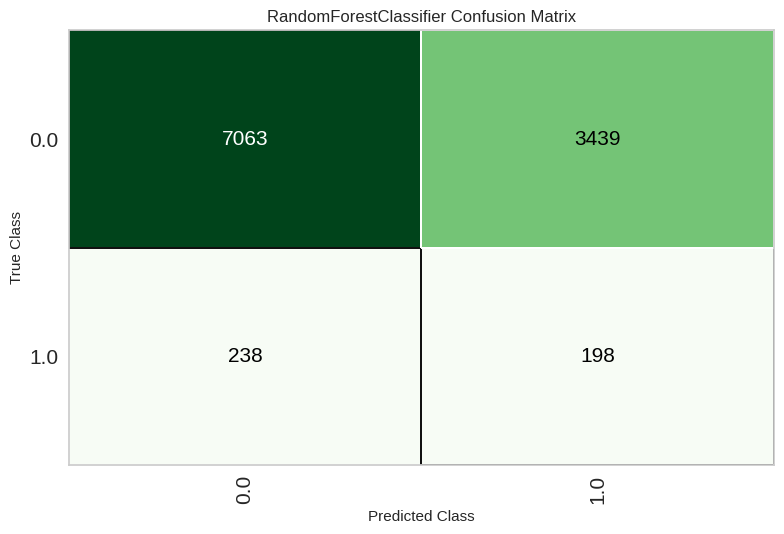

In [ ]:
rf = create_model('rf')

tuned_rf, tuner = tune_model(rf,optimize = 'eer',return_tuner=True,choose_better = True)

print(rf)
print(tuned_rf)

plot_model(tuned_rf,plot = 'confusion_matrix')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9577,0.7723,0.1485,0.4054,0.2174,0.2004,0.2276,0.4621
1,0.9604,0.7498,0.2178,0.5000,0.3034,0.2863,0.3128,0.4411
2,0.9620,0.7349,0.2059,0.5676,0.3022,0.2870,0.3267,0.4442
3,0.9569,0.7777,0.1961,0.4167,0.2667,0.2474,0.2663,0.4485
4,0.9592,0.7268,0.1765,0.4737,0.2571,0.2407,0.2722,0.4536
5,0.9561,0.7035,0.1373,0.3684,0.2000,0.1823,0.2061,0.4656
6,0.9565,0.7544,0.1863,0.4043,0.2550,0.2358,0.2547,0.4515
7,0.9596,0.7099,0.2157,0.4889,0.2993,0.2817,0.3070,0.4419
8,0.9573,0.7366,0.1667,0.4146,0.2378,0.2199,0.2444,0.4570


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.6775,0.5946,0.4455,0.0554,0.0986,0.0303,0.0555,0.4466
1,0.6446,0.5497,0.4554,0.0512,0.0921,0.0225,0.0440,0.4550
2,0.6023,0.5516,0.5000,0.0502,0.0913,0.0201,0.0426,0.4519
3,0.6144,0.6323,0.5686,0.0581,0.1055,0.0355,0.0742,0.4117
4,0.6054,0.5586,0.4804,0.0489,0.0887,0.0174,0.0365,0.4597
5,0.6238,0.5427,0.4902,0.0522,0.0943,0.0238,0.0484,0.4475
6,0.6755,0.5838,0.4314,0.0541,0.0961,0.0269,0.0492,0.4533
7,0.6579,0.5257,0.3627,0.0438,0.0781,0.0073,0.0137,0.4874
8,0.6321,0.5639,0.4608,0.0505,0.0910,0.0204,0.0407,0.4576


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 10 candidates, totalling 100 fits


ExtraTreesClassifier(bootstrap=False, ccp_alpha=0.0, class_weight=None,
                     criterion='gini', max_depth=None, max_features='sqrt',
                     max_leaf_nodes=None, max_samples=None,
                     min_impurity_decrease=0.0, min_samples_leaf=1,
                     min_samples_split=2, min_weight_fraction_leaf=0.0,
                     n_estimators=100, n_jobs=-1, oob_score=False,
                     random_state=123, verbose=0, warm_start=False)
ExtraTreesClassifier(bootstrap=False, ccp_alpha=0.0,
                     class_weight='balanced_subsample', criterion='gini',
                     max_depth=4, max_features='sqrt', max_leaf_nodes=None,
                     max_samples=None, min_impurity_decrease=0.0005,
                     min_samples_leaf=3, min_samples_split=5,
                     min_weight_fraction_leaf=0.0, n_estimators=260, n_jobs=-1,
                     oob_score=False, random_state=123, verbose=0,
                     warm_start=Fals

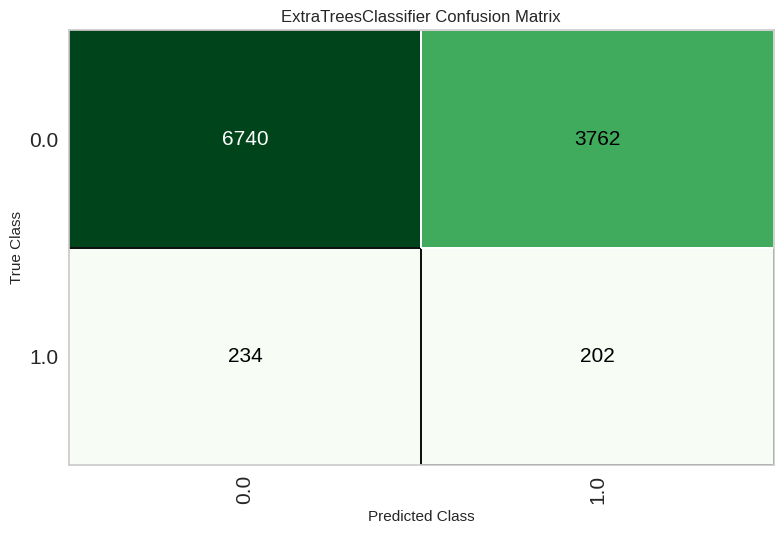

In [ ]:
et = create_model('et')

tuned_et, tuner = tune_model(et,optimize = 'eer',return_tuner=True,choose_better = True)

print(et)
print(tuned_et)

plot_model(tuned_et,plot = 'confusion_matrix')


,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.0674,0.4844,0.9802,0.0400,0.0768,0.0008,0.0115,0.4974
1,0.0572,0.5688,0.9901,0.0399,0.0767,0.0007,0.0129,0.4978
2,0.0549,0.4958,0.9902,0.0402,0.0773,0.0005,0.0096,0.4985
3,0.0600,0.5703,0.9902,0.0404,0.0777,0.0009,0.0157,0.4971
4,0.0564,0.5212,1.0000,0.0406,0.0781,0.0014,0.0264,0.4957
5,0.0607,0.5401,0.9902,0.0404,0.0777,0.0010,0.0165,0.4969
6,0.0580,0.4932,1.0000,0.0407,0.0782,0.0015,0.0276,0.4953
7,0.0615,0.5186,0.9902,0.0405,0.0778,0.0011,0.0173,0.4967
8,0.0584,0.5146,0.9804,0.0400,0.0768,0.0000,0.0005,0.4999


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9361,0.4941,0.0495,0.0694,0.0578,0.0257,0.0261,0.4942
1,0.9334,0.5682,0.0396,0.0519,0.0449,0.0111,0.0112,0.4975
2,0.9397,0.5040,0.0490,0.0806,0.0610,0.0317,0.0328,0.4933
3,0.9353,0.5808,0.0882,0.1111,0.0984,0.0653,0.0658,0.4844
4,0.9306,0.5239,0.0196,0.0253,0.0221,-0.0133,-0.0134,0.5030
5,0.9353,0.5371,0.0294,0.0435,0.0351,0.0029,0.0030,0.4994
6,0.9361,0.5034,0.0490,0.0704,0.0578,0.0258,0.0263,0.4943
7,0.9432,0.5235,0.0392,0.0784,0.0523,0.0263,0.0280,0.4948
8,0.9444,0.5238,0.0490,0.1000,0.0658,0.0406,0.0433,0.4921


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 10 candidates, totalling 100 fits


GaussianNB(priors=None, var_smoothing=1e-09)
GaussianNB(priors=None, var_smoothing=1)


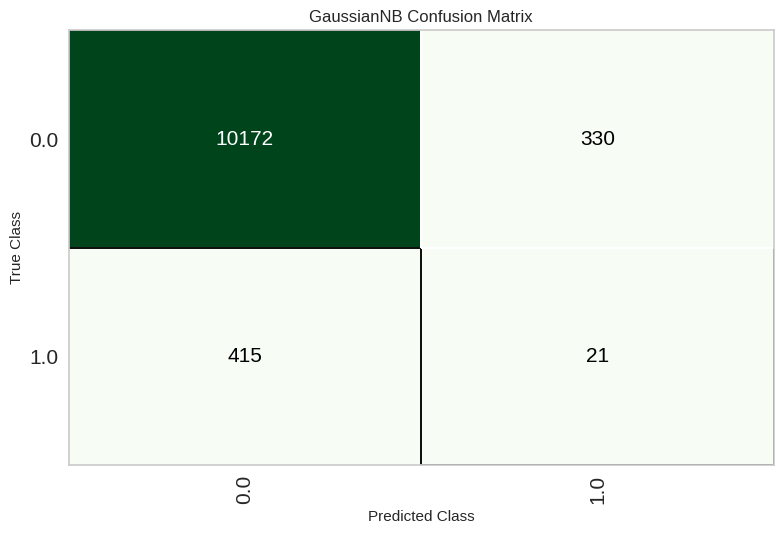

In [ ]:
nb = create_model('nb')

tuned_nb, tuner = tune_model(nb,optimize = 'eer',return_tuner=True,choose_better = True)

print(nb)
print(tuned_nb)

plot_model(tuned_nb,plot = 'confusion_matrix')


,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9585,0.6674,0.0396,0.3077,0.0702,0.0617,0.0984,0.4908
1,0.9577,0.6830,0.0891,0.3600,0.1429,0.1292,0.1635,0.4783
2,0.9616,0.6723,0.1078,0.6111,0.1833,0.1734,0.2457,0.4722
3,0.9569,0.6970,0.0980,0.3571,0.1538,0.1390,0.1705,0.4761
4,0.9585,0.6667,0.0490,0.3571,0.0862,0.0773,0.1203,0.4884
5,0.9573,0.6586,0.0686,0.3333,0.1138,0.1016,0.1364,0.4837
6,0.9592,0.7148,0.0784,0.4444,0.1333,0.1228,0.1740,0.4806
7,0.9561,0.6397,0.0980,0.3333,0.1515,0.1358,0.1633,0.4763
8,0.9589,0.6505,0.0980,0.4348,0.1600,0.1475,0.1922,0.4756


Processing:   0%|          | 0/4 [00:00<?, ?it/s]

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,eer
Fold,,,,,,,,
0,0.9581,0.7083,0.1485,0.4167,0.2190,0.2024,0.2314,0.4620
1,0.9596,0.7157,0.2178,0.4783,0.2993,0.2815,0.3049,0.4413
2,0.9624,0.7113,0.2157,0.5789,0.3143,0.2991,0.3383,0.4412
3,0.9573,0.7358,0.1863,0.4222,0.2585,0.2399,0.2614,0.4513
4,0.9589,0.7095,0.1765,0.4615,0.2553,0.2385,0.2681,0.4537
5,0.9561,0.7068,0.1373,0.3684,0.2000,0.1823,0.2061,0.4656
6,0.9573,0.7334,0.1863,0.4222,0.2585,0.2399,0.2614,0.4513
7,0.9592,0.6934,0.2157,0.4783,0.2973,0.2794,0.3031,0.4420
8,0.9573,0.6648,0.1667,0.4146,0.2378,0.2199,0.2444,0.4570


Processing:   0%|          | 0/7 [00:00<?, ?it/s]

Fitting 10 folds for each of 10 candidates, totalling 100 fits


KNeighborsClassifier(algorithm='auto', leaf_size=30, metric='minkowski',
                     metric_params=None, n_jobs=-1, n_neighbors=5, p=2,
                     weights='uniform')
KNeighborsClassifier(algorithm='auto', leaf_size=30, metric='manhattan',
                     metric_params=None, n_jobs=-1, n_neighbors=13, p=2,
                     weights='distance')


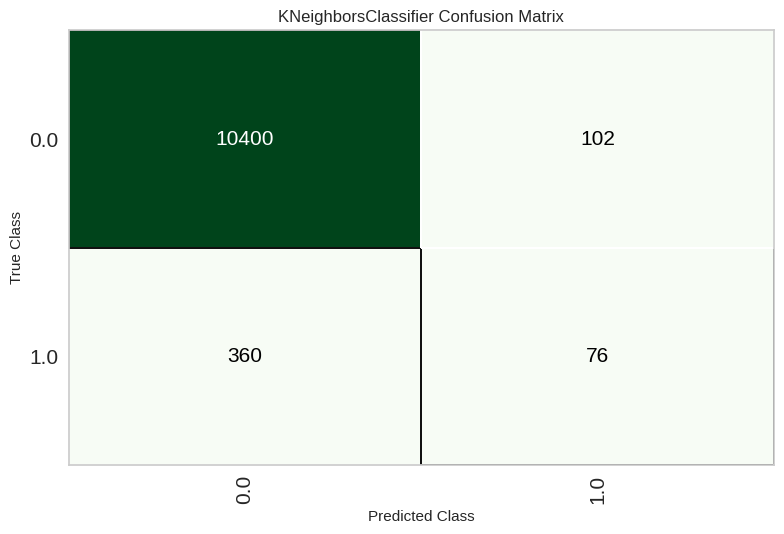

In [ ]:
knn = create_model('knn')

tuned_knn, tuner = tune_model(knn,optimize = 'eer',return_tuner=True,choose_better = True)

print(knn)
print(tuned_knn)

plot_model(tuned_knn,plot = 'confusion_matrix')

# SKLearn Models

## Cost sensitive

AUC-ROC 0.6672492701259175
ACCURACY 0.9203693545437923
EER Score: 0.392
              precision    recall  f1-score   support

         0.0       0.97      0.94      0.96     10502
         1.0       0.22      0.39      0.28       436

    accuracy                           0.92     10938
   macro avg       0.60      0.67      0.62     10938
weighted avg       0.94      0.92      0.93     10938



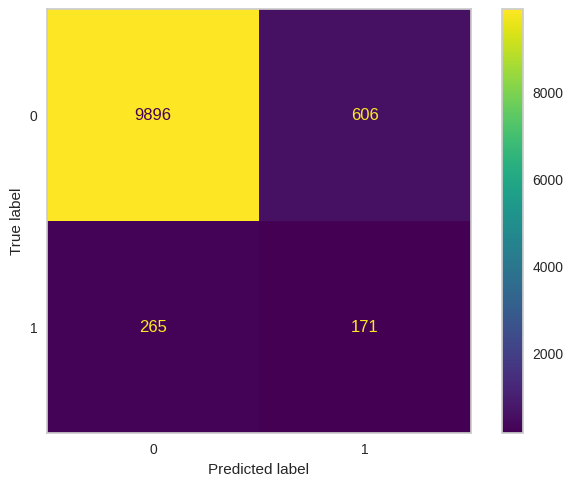

In [ ]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import RepeatedStratifiedKFold
import matplotlib.pyplot as plt
from sklearn.metrics import f1_score, accuracy_score, confusion_matrix, ConfusionMatrixDisplay,classification_report
from sklearn.metrics import recall_score,f1_score, accuracy_score, confusion_matrix, ConfusionMatrixDisplay,roc_auc_score,accuracy_score


model = RandomForestClassifier(bootstrap=True, ccp_alpha=0.0, class_weight='balanced',
                       criterion='gini', max_depth=None, max_features='sqrt',
                       max_leaf_nodes=None, max_samples=None,
                       min_impurity_decrease=0.0, min_samples_leaf=1,
                       min_samples_split=2, min_weight_fraction_leaf=0.0,
                       n_estimators=100, n_jobs=-1, oob_score=False,
                       random_state=5910, verbose=0, warm_start=False)
cv = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=1)

model.fit(X_train_transformed,Y_train_transformed)
y_pred = model.predict(X_test_transformed)
print('AUC-ROC',roc_auc_score(Y_test_transformed, y_pred))
print('ACCURACY',accuracy_score(Y_test_transformed, y_pred))
print('EER Score: %.3f' % calculate_eer(Y_test_transformed,y_pred))
print(classification_report(Y_test_transformed, y_pred))
cm = confusion_matrix(Y_test_transformed, y_pred)
disp = ConfusionMatrixDisplay(confusion_matrix=cm)
disp.plot()
plt.grid(False)
plt.show()

In [ ]:
from yellowbrick.classifier import ROCAUC

visualizer = ROCAUC(model, classes=['Low', 'Moderate', 'High'])

    # Fitting to the training data first then scoring with the test data
visualizer.fit(X_train_transformed, Y_train_transformed)
visualizer.score(X_test_transformed, Y_test_transformed)
visualizer.show()

### Smote

Original dataset shape: Counter({0.0: 24502, 1.0: 1017})
Resampled dataset shape: Counter({0.0: 24502, 1.0: 24502})
AUC-ROC 0.6179268605892456
ACCURACY 0.9459681843115744
EER Score: 0.431
              precision    recall  f1-score   support

         0.0       0.97      0.97      0.97     10502
         1.0       0.30      0.26      0.28       436

    accuracy                           0.95     10938
   macro avg       0.63      0.62      0.63     10938
weighted avg       0.94      0.95      0.94     10938



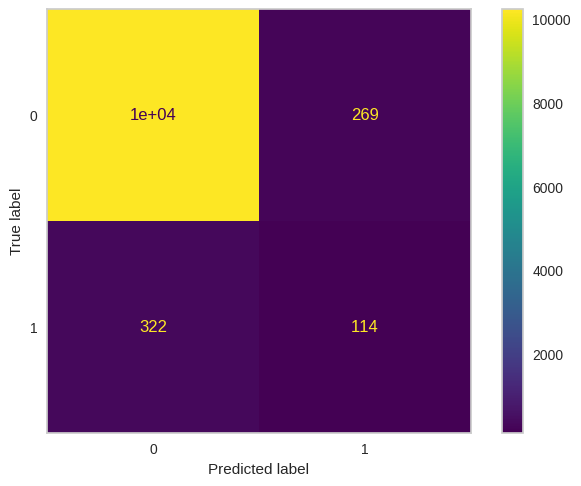

In [ ]:
from imblearn.over_sampling import SMOTE
from collections import Counter
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import RepeatedStratifiedKFold
import matplotlib.pyplot as plt
from sklearn.metrics import f1_score, accuracy_score, confusion_matrix, ConfusionMatrixDisplay
from sklearn.metrics import recall_score,f1_score, accuracy_score, confusion_matrix, ConfusionMatrixDisplay


model = RandomForestClassifier(bootstrap=True, ccp_alpha=0.0, class_weight='balanced',
                       criterion='gini', max_depth=None, max_features='sqrt',
                       max_leaf_nodes=None, max_samples=None,
                       min_impurity_decrease=0.0, min_samples_leaf=1,
                       min_samples_split=2, min_weight_fraction_leaf=0.0,
                       n_estimators=100, n_jobs=-1, oob_score=False,
                       random_state=5910, verbose=0, warm_start=False)
sm = SMOTE(random_state=42,sampling_strategy='minority')
X_train_resampled, y_train_resampled = sm.fit_resample(X_train_transformed, Y_train_transformed)
print('Original dataset shape:', Counter(Y_train_transformed))
print('Resampled dataset shape:', Counter(y_train_resampled))

model.fit(X_train_resampled,y_train_resampled)
y_pred = model.predict(X_test_transformed)
print('AUC-ROC',roc_auc_score(Y_test_transformed, y_pred))
print('ACCURACY',accuracy_score(Y_test_transformed, y_pred))
print('EER Score: %.3f' % calculate_eer(Y_test_transformed,y_pred))
print(classification_report(Y_test_transformed, y_pred))
cm = confusion_matrix(Y_test_transformed, y_pred)
disp = ConfusionMatrixDisplay(confusion_matrix=cm)
disp.plot()
plt.grid(False)
plt.show()

In [ ]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import RepeatedStratifiedKFold
import matplotlib.pyplot as plt
from sklearn.metrics import f1_score, accuracy_score, confusion_matrix, ConfusionMatrixDisplay
from sklearn.metrics import recall_score,f1_score, accuracy_score, confusion_matrix, ConfusionMatrixDisplay
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import RepeatedStratifiedKFold

model = RandomForestClassifier(bootstrap=True, ccp_alpha=0.0, class_weight='balanced',
                       criterion='gini', max_depth=None, max_features='sqrt',
                       max_leaf_nodes=None, max_samples=None,
                       min_impurity_decrease=0.0, min_samples_leaf=1,
                       min_samples_split=2, min_weight_fraction_leaf=0.0,
                       n_estimators=100, n_jobs=-1, oob_score=False,
                       random_state=5910, verbose=0, warm_start=False)

balance = [{0:1,1:100}, {0:1,1:80}, {0:1,1:60}, {0:1,1:40}, {0:1,1:20}]
param_grid = dict(class_weight=balance)

cv = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=1)

eer_scorer = make_scorer(calculate_eer, greater_is_better=False, needs_proba=True)

grid = GridSearchCV(estimator=model, param_grid=param_grid, cv=cv, scoring=eer_scorer)

grid_result = grid.fit(X_train_resampled, y_train_resampled)
print("Best: %f using %s" % (grid_result.best_score_, grid_result.best_params_))

Best: -0.030468 using {'class_weight': {0: 1, 1: 20}}


Original dataset shape: Counter({0.0: 24502, 1.0: 1017})
Resampled dataset shape: Counter({0.0: 24502, 1.0: 24502})
EER Score: 0.392
              precision    recall  f1-score   support

         0.0       0.97      0.94      0.96     10502
         1.0       0.22      0.39      0.28       436

    accuracy                           0.92     10938
   macro avg       0.60      0.67      0.62     10938
weighted avg       0.94      0.92      0.93     10938



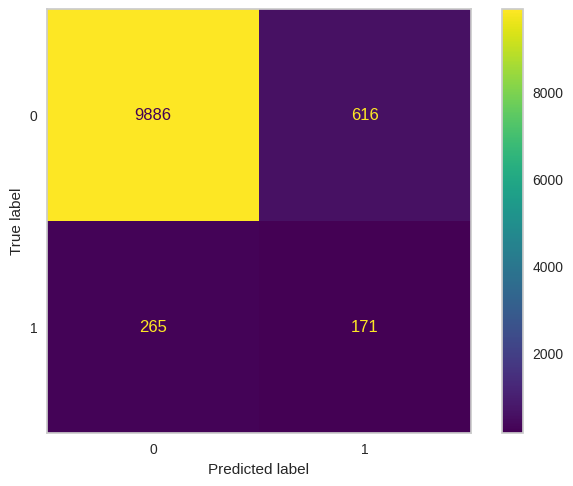

In [ ]:
from imblearn.over_sampling import SMOTE
from collections import Counter
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import RepeatedStratifiedKFold
import matplotlib.pyplot as plt
from sklearn.metrics import f1_score, accuracy_score, confusion_matrix, ConfusionMatrixDisplay
from sklearn.metrics import recall_score,f1_score, accuracy_score, confusion_matrix, ConfusionMatrixDisplay


model = RandomForestClassifier(bootstrap=True, ccp_alpha=0.0, class_weight={0:1,1:20},
                       criterion='gini', max_depth=None, max_features='sqrt',
                       max_leaf_nodes=None, max_samples=None,
                       min_impurity_decrease=0.0, min_samples_leaf=1,
                       min_samples_split=2, min_weight_fraction_leaf=0.0,
                       n_estimators=100, n_jobs=-1, oob_score=False,
                       random_state=5910, verbose=0, warm_start=False)

print('Original dataset shape:', Counter(Y_train_transformed))
print('Resampled dataset shape:', Counter(y_train_resampled))

model.fit(X_train_resampled,y_train_resampled)
y_pred = model.predict(X_test_transformed)
print('EER Score: %.3f' % calculate_eer(Y_test_transformed,y_pred))
print(classification_report(Y_test_transformed, y_pred))
cm = confusion_matrix(Y_test_transformed, y_pred)
disp = ConfusionMatrixDisplay(confusion_matrix=cm)
disp.plot()
plt.grid(False)
plt.show()

### Randomn OverSampling

Original dataset shape: Counter({0.0: 24502, 1.0: 1017})
Resampled dataset shape: Counter({0.0: 24502, 1.0: 24502})
AUC-ROC 0.6717143436200007
ACCURACY 0.9099469738526239
EER Score: 0.387
              precision    recall  f1-score   support

         0.0       0.97      0.93      0.95     10502
         1.0       0.20      0.41      0.27       436

    accuracy                           0.91     10938
   macro avg       0.59      0.67      0.61     10938
weighted avg       0.94      0.91      0.92     10938



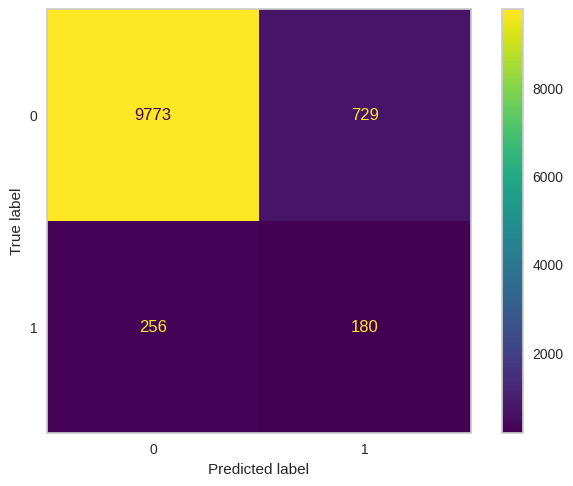

In [ ]:
from imblearn.over_sampling import RandomOverSampler
from collections import Counter
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import RepeatedStratifiedKFold
import matplotlib.pyplot as plt
from sklearn.metrics import f1_score, accuracy_score, confusion_matrix, ConfusionMatrixDisplay
from sklearn.metrics import recall_score,f1_score, accuracy_score, confusion_matrix, ConfusionMatrixDisplay


model = RandomForestClassifier(bootstrap=True, ccp_alpha=0.0, class_weight='balanced',
                       criterion='gini', max_depth=None, max_features='sqrt',
                       max_leaf_nodes=None, max_samples=None,
                       min_impurity_decrease=0.0, min_samples_leaf=1,
                       min_samples_split=2, min_weight_fraction_leaf=0.0,
                       n_estimators=100, n_jobs=-1, oob_score=False,
                       random_state=5910, verbose=0, warm_start=False)

ru = RandomOverSampler(random_state=0)
X_train_resampled, y_train_resampled = ru.fit_resample(X_train_transformed, Y_train_transformed)
print('Original dataset shape:', Counter(Y_train_transformed))
print('Resampled dataset shape:', Counter(y_train_resampled))

model.fit(X_train_resampled,y_train_resampled)
y_pred = model.predict(X_test_transformed)
print('AUC-ROC',roc_auc_score(Y_test_transformed, y_pred))
print('ACCURACY',accuracy_score(Y_test_transformed, y_pred))
print('EER Score: %.3f' % calculate_eer(Y_test_transformed,y_pred))
print(classification_report(Y_test_transformed, y_pred))
cm = confusion_matrix(Y_test_transformed, y_pred)
disp = ConfusionMatrixDisplay(confusion_matrix=cm)
disp.plot()
plt.grid(False)
plt.show()

In [ ]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import RepeatedStratifiedKFold
import matplotlib.pyplot as plt
from sklearn.metrics import f1_score, accuracy_score, confusion_matrix, ConfusionMatrixDisplay
from sklearn.metrics import recall_score,f1_score, accuracy_score, confusion_matrix, ConfusionMatrixDisplay
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import RepeatedStratifiedKFold

model = RandomForestClassifier(bootstrap=True, ccp_alpha=0.0, class_weight='balanced',
                       criterion='gini', max_depth=None, max_features='sqrt',
                       max_leaf_nodes=None, max_samples=None,
                       min_impurity_decrease=0.0, min_samples_leaf=1,
                       min_samples_split=2, min_weight_fraction_leaf=0.0,
                       n_estimators=100, n_jobs=-1, oob_score=False,
                       random_state=5910, verbose=0, warm_start=False)

balance = [{0:1,1:100}, {0:1,1:80}, {0:1,1:60}, {0:1,1:40}, {0:1,1:20}]
param_grid = dict(class_weight=balance)

cv = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=1)

eer_scorer = make_scorer(calculate_eer, greater_is_better=False, needs_proba=True)

grid = GridSearchCV(estimator=model, param_grid=param_grid, cv=cv, scoring=eer_scorer)

grid_result = grid.fit(X_train_resampled, y_train_resampled)
print("Best: %f using %s" % (grid_result.best_score_, grid_result.best_params_))

Best: -0.055064 using {'class_weight': {0: 1, 1: 20}}


Original dataset shape: Counter({0.0: 24502, 1.0: 1017})
Resampled dataset shape: Counter({0.0: 24502, 1.0: 24502})
EER Score: 0.389
              precision    recall  f1-score   support

         0.0       0.97      0.93      0.95     10502
         1.0       0.20      0.41      0.26       436

    accuracy                           0.91     10938
   macro avg       0.58      0.67      0.61     10938
weighted avg       0.94      0.91      0.92     10938



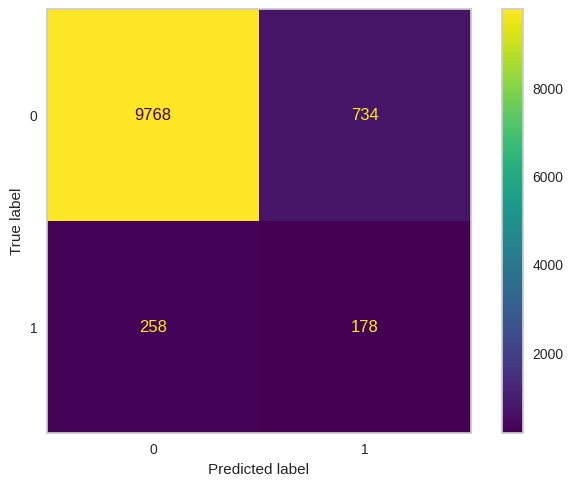

In [ ]:
from imblearn.over_sampling import RandomOverSampler
from collections import Counter
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import RepeatedStratifiedKFold
import matplotlib.pyplot as plt
from sklearn.metrics import f1_score, accuracy_score, confusion_matrix, ConfusionMatrixDisplay
from sklearn.metrics import recall_score,f1_score, accuracy_score, confusion_matrix, ConfusionMatrixDisplay


model = RandomForestClassifier(bootstrap=True, ccp_alpha=0.0, class_weight={0:1,1:20},
                       criterion='gini', max_depth=None, max_features='sqrt',
                       max_leaf_nodes=None, max_samples=None,
                       min_impurity_decrease=0.0, min_samples_leaf=1,
                       min_samples_split=2, min_weight_fraction_leaf=0.0,
                       n_estimators=100, n_jobs=-1, oob_score=False,
                       random_state=5910, verbose=0, warm_start=False)


print('Original dataset shape:', Counter(Y_train_transformed))
print('Resampled dataset shape:', Counter(y_train_resampled))

model.fit(X_train_resampled,y_train_resampled)
y_pred = model.predict(X_test_transformed)
print('EER Score: %.3f' % calculate_eer(Y_test_transformed,y_pred))
print(classification_report(Y_test_transformed, y_pred))
cm = confusion_matrix(Y_test_transformed, y_pred)
disp = ConfusionMatrixDisplay(confusion_matrix=cm)
disp.plot()
plt.grid(False)
plt.show()

### Randomn UnderSampling

Original dataset shape: Counter({0.0: 24502, 1.0: 1017})
Resampled dataset shape: Counter({0.0: 1017, 1.0: 1017})
AUC-ROC 0.6428987313906133
ACCURACY 0.6667580910586944
EER Score: 0.364
              precision    recall  f1-score   support

         0.0       0.98      0.67      0.79     10502
         1.0       0.07      0.62      0.13       436

    accuracy                           0.67     10938
   macro avg       0.52      0.64      0.46     10938
weighted avg       0.94      0.67      0.77     10938



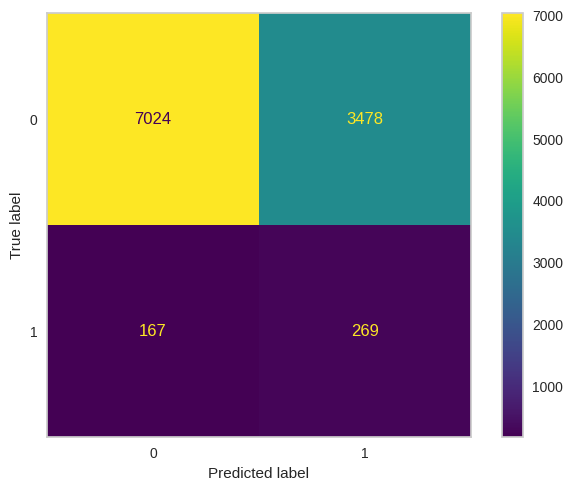

In [ ]:
from imblearn.under_sampling import RandomUnderSampler
from collections import Counter
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import RepeatedStratifiedKFold
import matplotlib.pyplot as plt
from sklearn.metrics import f1_score, accuracy_score, confusion_matrix, ConfusionMatrixDisplay
from sklearn.metrics import recall_score,f1_score, accuracy_score, confusion_matrix, ConfusionMatrixDisplay


model = RandomForestClassifier(bootstrap=True, ccp_alpha=0.0, class_weight='balanced',
                       criterion='gini', max_depth=None, max_features='sqrt',
                       max_leaf_nodes=None, max_samples=None,
                       min_impurity_decrease=0.0, min_samples_leaf=1,
                       min_samples_split=2, min_weight_fraction_leaf=0.0,
                       n_estimators=100, n_jobs=-1, oob_score=False,
                       random_state=5910, verbose=0, warm_start=False)

ru = RandomUnderSampler(random_state=0)
X_train_resampled, y_train_resampled = ru.fit_resample(X_train_transformed, Y_train_transformed)
print('Original dataset shape:', Counter(Y_train_transformed))
print('Resampled dataset shape:', Counter(y_train_resampled))

model.fit(X_train_resampled,y_train_resampled)
y_pred = model.predict(X_test_transformed)
print('AUC-ROC',roc_auc_score(Y_test_transformed, y_pred))
print('ACCURACY',accuracy_score(Y_test_transformed, y_pred))
print('EER Score: %.3f' % calculate_eer(Y_test_transformed,y_pred))
print(classification_report(Y_test_transformed, y_pred))
cm = confusion_matrix(Y_test_transformed, y_pred)
disp = ConfusionMatrixDisplay(confusion_matrix=cm)
disp.plot()
plt.grid(False)
plt.show()

In [ ]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import RepeatedStratifiedKFold
import matplotlib.pyplot as plt
from sklearn.metrics import f1_score, accuracy_score, confusion_matrix, ConfusionMatrixDisplay
from sklearn.metrics import recall_score,f1_score, accuracy_score, confusion_matrix, ConfusionMatrixDisplay
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import RepeatedStratifiedKFold

model = RandomForestClassifier(bootstrap=True, ccp_alpha=0.0, class_weight='balanced',
                       criterion='gini', max_depth=None, max_features='sqrt',
                       max_leaf_nodes=None, max_samples=None,
                       min_impurity_decrease=0.0, min_samples_leaf=1,
                       min_samples_split=2, min_weight_fraction_leaf=0.0,
                       n_estimators=100, n_jobs=-1, oob_score=False,
                       random_state=5910, verbose=0, warm_start=False)

balance = [{0:1,1:100}, {0:1,1:80}, {0:1,1:60}, {0:1,1:40}, {0:1,1:20}]
param_grid = dict(class_weight=balance)

cv = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=1)

eer_scorer = make_scorer(calculate_eer, greater_is_better=False, needs_proba=True)

grid = GridSearchCV(estimator=model, param_grid=param_grid, cv=cv, scoring=eer_scorer)

grid_result = grid.fit(X_train_resampled, y_train_resampled)
print("Best: %f using %s" % (grid_result.best_score_, grid_result.best_params_))

Best: -0.348196 using {'class_weight': {0: 1, 1: 20}}


Original dataset shape: Counter({0.0: 24502, 1.0: 1017})
Resampled dataset shape: Counter({0.0: 1017, 1.0: 1017})
EER Score: 0.361
              precision    recall  f1-score   support

         0.0       0.98      0.66      0.79     10502
         1.0       0.07      0.63      0.13       436

    accuracy                           0.66     10938
   macro avg       0.52      0.64      0.46     10938
weighted avg       0.94      0.66      0.76     10938



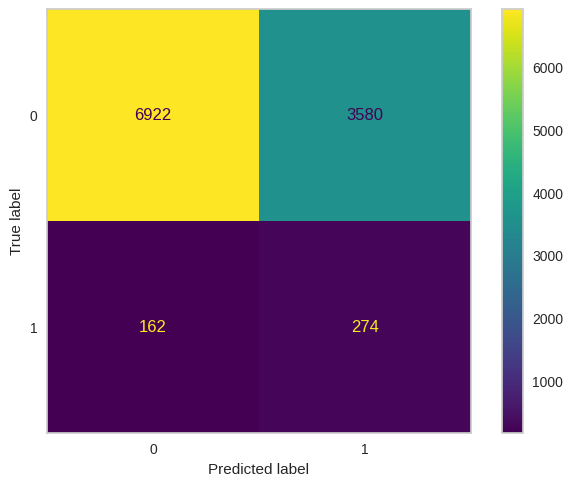

In [ ]:
from imblearn.over_sampling import RandomOverSampler
from collections import Counter
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import RepeatedStratifiedKFold
import matplotlib.pyplot as plt
from sklearn.metrics import f1_score, accuracy_score, confusion_matrix, ConfusionMatrixDisplay
from sklearn.metrics import recall_score,f1_score, accuracy_score, confusion_matrix, ConfusionMatrixDisplay


model = RandomForestClassifier(bootstrap=True, ccp_alpha=0.0, class_weight={0:1,1:20},
                       criterion='gini', max_depth=None, max_features='sqrt',
                       max_leaf_nodes=None, max_samples=None,
                       min_impurity_decrease=0.0, min_samples_leaf=1,
                       min_samples_split=2, min_weight_fraction_leaf=0.0,
                       n_estimators=100, n_jobs=-1, oob_score=False,
                       random_state=5910, verbose=0, warm_start=False)

print('Original dataset shape:', Counter(Y_train_transformed))
print('Resampled dataset shape:', Counter(y_train_resampled))

model.fit(X_train_resampled,y_train_resampled)
y_pred = model.predict(X_test_transformed)
print('EER Score: %.3f' % calculate_eer(Y_test_transformed,y_pred))
print(classification_report(Y_test_transformed, y_pred))
cm = confusion_matrix(Y_test_transformed, y_pred)
disp = ConfusionMatrixDisplay(confusion_matrix=cm)
disp.plot()
plt.grid(False)
plt.show()

### SVM Smote

Original dataset shape: Counter({0.0: 24502, 1.0: 1017})
Resampled dataset shape: Counter({0.0: 24502, 1.0: 24502})
AUC-ROC 0.609609528285569
ACCURACY 0.9468824282318523
EER Score: 0.437
              precision    recall  f1-score   support

         0.0       0.97      0.98      0.97     10502
         1.0       0.30      0.24      0.27       436

    accuracy                           0.95     10938
   macro avg       0.63      0.61      0.62     10938
weighted avg       0.94      0.95      0.94     10938



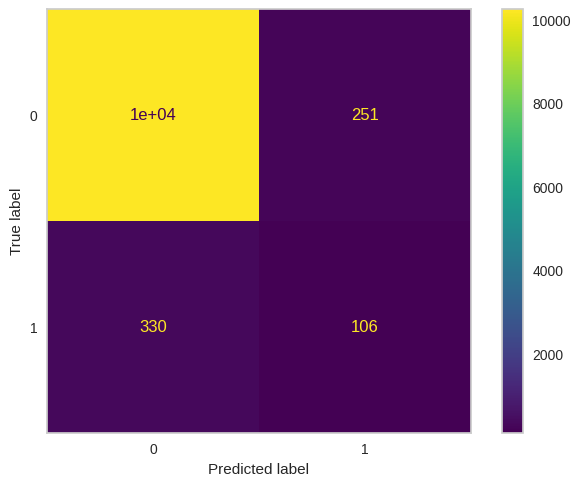

In [ ]:
from imblearn.over_sampling import SVMSMOTE
from collections import Counter
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import RepeatedStratifiedKFold
import matplotlib.pyplot as plt
from sklearn.metrics import f1_score, accuracy_score, confusion_matrix, ConfusionMatrixDisplay
from sklearn.metrics import recall_score,f1_score, accuracy_score, confusion_matrix, ConfusionMatrixDisplay


model = RandomForestClassifier(bootstrap=True, ccp_alpha=0.0, class_weight='balanced',
                       criterion='gini', max_depth=None, max_features='sqrt',
                       max_leaf_nodes=None, max_samples=None,
                       min_impurity_decrease=0.0, min_samples_leaf=1,
                       min_samples_split=2, min_weight_fraction_leaf=0.0,
                       n_estimators=100, n_jobs=-1, oob_score=False,
                       random_state=5910, verbose=0, warm_start=False)

svm = SVMSMOTE(random_state=0)
X_train_resampled, y_train_resampled = svm.fit_resample(X_train_transformed, Y_train_transformed)
print('Original dataset shape:', Counter(Y_train_transformed))
print('Resampled dataset shape:', Counter(y_train_resampled))

model.fit(X_train_resampled,y_train_resampled)
y_pred = model.predict(X_test_transformed)
print('AUC-ROC',roc_auc_score(Y_test_transformed, y_pred))
print('ACCURACY',accuracy_score(Y_test_transformed, y_pred))
print('EER Score: %.3f' % calculate_eer(Y_test_transformed,y_pred))
print(classification_report(Y_test_transformed, y_pred))
cm = confusion_matrix(Y_test_transformed, y_pred)
disp = ConfusionMatrixDisplay(confusion_matrix=cm)
disp.plot()
plt.grid(False)
plt.show()

In [ ]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import RepeatedStratifiedKFold
import matplotlib.pyplot as plt
from sklearn.metrics import f1_score, accuracy_score, confusion_matrix, ConfusionMatrixDisplay
from sklearn.metrics import recall_score,f1_score, accuracy_score, confusion_matrix, ConfusionMatrixDisplay
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import RepeatedStratifiedKFold

model = RandomForestClassifier(bootstrap=True, ccp_alpha=0.0, class_weight='balanced',
                       criterion='gini', max_depth=None, max_features='sqrt',
                       max_leaf_nodes=None, max_samples=None,
                       min_impurity_decrease=0.0, min_samples_leaf=1,
                       min_samples_split=2, min_weight_fraction_leaf=0.0,
                       n_estimators=100, n_jobs=-1, oob_score=False,
                       random_state=5910, verbose=0, warm_start=False)

balance = [{0:1,1:100}, {0:1,1:80}, {0:1,1:60}, {0:1,1:40}, {0:1,1:20}]
param_grid = dict(class_weight=balance)

cv = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=1)

eer_scorer = make_scorer(calculate_eer, greater_is_better=False, needs_proba=True)

grid = GridSearchCV(estimator=model, param_grid=param_grid, cv=cv, scoring=eer_scorer)

grid_result = grid.fit(X_train_resampled, y_train_resampled)
print("Best: %f using %s" % (grid_result.best_score_, grid_result.best_params_))

Best: -0.031371 using {'class_weight': {0: 1, 1: 20}}


Original dataset shape: Counter({0.0: 24502, 1.0: 1017})
Resampled dataset shape: Counter({0.0: 24502, 1.0: 24502})
EER Score: 0.391
              precision    recall  f1-score   support

         0.0       0.97      0.94      0.96     10502
         1.0       0.22      0.39      0.28       436

    accuracy                           0.92     10938
   macro avg       0.60      0.67      0.62     10938
weighted avg       0.94      0.92      0.93     10938



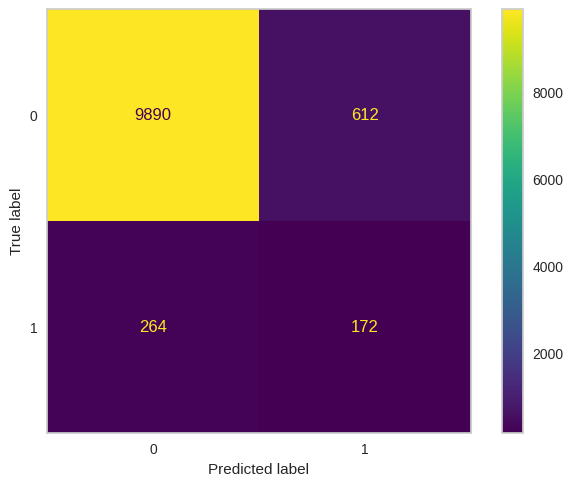

In [ ]:
from imblearn.over_sampling import SVMSMOTE
from collections import Counter
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import RepeatedStratifiedKFold
import matplotlib.pyplot as plt
from sklearn.metrics import f1_score, accuracy_score, confusion_matrix, ConfusionMatrixDisplay
from sklearn.metrics import recall_score,f1_score, accuracy_score, confusion_matrix, ConfusionMatrixDisplay


model = RandomForestClassifier(bootstrap=True, ccp_alpha=0.0, class_weight={0:1,1:20},
                       criterion='gini', max_depth=None, max_features='sqrt',
                       max_leaf_nodes=None, max_samples=None,
                       min_impurity_decrease=0.0, min_samples_leaf=1,
                       min_samples_split=2, min_weight_fraction_leaf=0.0,
                       n_estimators=100, n_jobs=-1, oob_score=False,
                       random_state=5910, verbose=0, warm_start=False)

print('Original dataset shape:', Counter(Y_train_transformed))
print('Resampled dataset shape:', Counter(y_train_resampled))

model.fit(X_train_resampled,y_train_resampled)
y_pred = model.predict(X_test_transformed)
print('EER Score: %.3f' % calculate_eer(Y_test_transformed,y_pred))
print(classification_report(Y_test_transformed, y_pred))
cm = confusion_matrix(Y_test_transformed, y_pred)
disp = ConfusionMatrixDisplay(confusion_matrix=cm)
disp.plot()
plt.grid(False)
plt.show()

### Borderline Smote

Original dataset shape: Counter({0.0: 24502, 1.0: 1017})
Resampled dataset shape: Counter({0.0: 24502, 1.0: 24502})
AUC-ROC 0.6132403351742525
ACCURACY 0.9475223989760468
EER Score: 0.434
              precision    recall  f1-score   support

         0.0       0.97      0.98      0.97     10502
         1.0       0.31      0.25      0.28       436

    accuracy                           0.95     10938
   macro avg       0.64      0.61      0.62     10938
weighted avg       0.94      0.95      0.94     10938



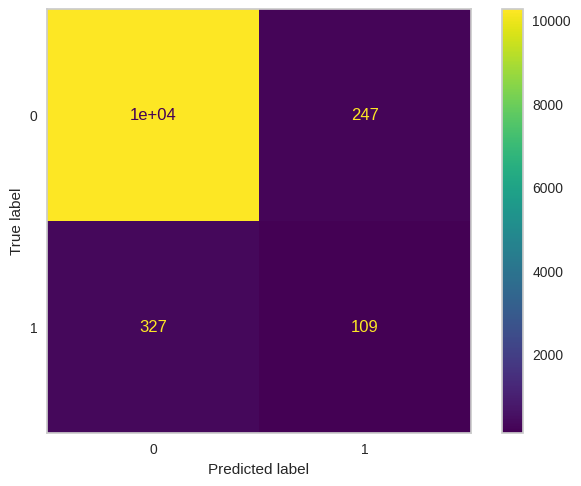

In [ ]:
from imblearn.over_sampling import BorderlineSMOTE
from collections import Counter
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import RepeatedStratifiedKFold
import matplotlib.pyplot as plt
from sklearn.metrics import f1_score, accuracy_score, confusion_matrix, ConfusionMatrixDisplay
from sklearn.metrics import recall_score,f1_score, accuracy_score, confusion_matrix, ConfusionMatrixDisplay

model = RandomForestClassifier(bootstrap=True, ccp_alpha=0.0, class_weight='balanced',
                       criterion='gini', max_depth=None, max_features='sqrt',
                       max_leaf_nodes=None, max_samples=None,
                       min_impurity_decrease=0.0, min_samples_leaf=1,
                       min_samples_split=2, min_weight_fraction_leaf=0.0,
                       n_estimators=100, n_jobs=-1, oob_score=False,
                       random_state=5910, verbose=0, warm_start=False)

svm = BorderlineSMOTE(random_state=0)
X_train_resampled, y_train_resampled = svm.fit_resample(X_train_transformed, Y_train_transformed)
print('Original dataset shape:', Counter(Y_train_transformed))
print('Resampled dataset shape:', Counter(y_train_resampled))

model.fit(X_train_resampled,y_train_resampled)
y_pred = model.predict(X_test_transformed)
print('AUC-ROC',roc_auc_score(Y_test_transformed, y_pred))
print('ACCURACY',accuracy_score(Y_test_transformed, y_pred))
print('EER Score: %.3f' % calculate_eer(Y_test_transformed,y_pred))
print(classification_report(Y_test_transformed, y_pred))
cm = confusion_matrix(Y_test_transformed, y_pred)
disp = ConfusionMatrixDisplay(confusion_matrix=cm)
disp.plot()
plt.grid(False)
plt.show()

In [ ]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import RepeatedStratifiedKFold
import matplotlib.pyplot as plt
from sklearn.metrics import f1_score, accuracy_score, confusion_matrix, ConfusionMatrixDisplay
from sklearn.metrics import recall_score,f1_score, accuracy_score, confusion_matrix, ConfusionMatrixDisplay
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import RepeatedStratifiedKFold

model = RandomForestClassifier(bootstrap=True, ccp_alpha=0.0, class_weight='balanced',
                       criterion='gini', max_depth=None, max_features='sqrt',
                       max_leaf_nodes=None, max_samples=None,
                       min_impurity_decrease=0.0, min_samples_leaf=1,
                       min_samples_split=2, min_weight_fraction_leaf=0.0,
                       n_estimators=100, n_jobs=-1, oob_score=False,
                       random_state=5910, verbose=0, warm_start=False)

balance = [{0:1,1:100}, {0:1,1:80}, {0:1,1:60}, {0:1,1:40}, {0:1,1:20}]
param_grid = dict(class_weight=balance)

cv = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=1)

eer_scorer = make_scorer(calculate_eer, greater_is_better=False, needs_proba=True)

grid = GridSearchCV(estimator=model, param_grid=param_grid, cv=cv, scoring=eer_scorer)

grid_result = grid.fit(X_train_resampled, y_train_resampled)
print("Best: %f using %s" % (grid_result.best_score_, grid_result.best_params_))

Best: -0.029954 using {'class_weight': {0: 1, 1: 20}}


Original dataset shape: Counter({0.0: 24502, 1.0: 1017})
Resampled dataset shape: Counter({0.0: 24502, 1.0: 24502})
EER Score: 0.391
              precision    recall  f1-score   support

         0.0       0.97      0.94      0.96     10502
         1.0       0.22      0.39      0.28       436

    accuracy                           0.92     10938
   macro avg       0.60      0.67      0.62     10938
weighted avg       0.94      0.92      0.93     10938



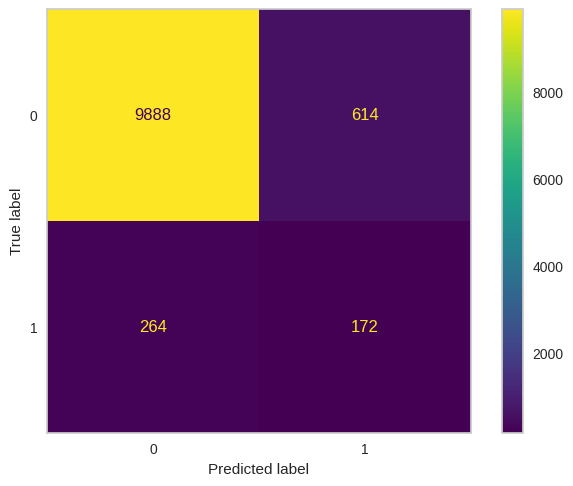

In [ ]:
from imblearn.over_sampling import BorderlineSMOTE
from collections import Counter
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import RepeatedStratifiedKFold
import matplotlib.pyplot as plt
from sklearn.metrics import f1_score, accuracy_score, confusion_matrix, ConfusionMatrixDisplay
from sklearn.metrics import recall_score,f1_score, accuracy_score, confusion_matrix, ConfusionMatrixDisplay

model = RandomForestClassifier(bootstrap=True, ccp_alpha=0.0, class_weight={0:1,1:20},
                       criterion='gini', max_depth=None, max_features='sqrt',
                       max_leaf_nodes=None, max_samples=None,
                       min_impurity_decrease=0.0, min_samples_leaf=1,
                       min_samples_split=2, min_weight_fraction_leaf=0.0,
                       n_estimators=100, n_jobs=-1, oob_score=False,
                       random_state=5910, verbose=0, warm_start=False)

print('Original dataset shape:', Counter(Y_train_transformed))
print('Resampled dataset shape:', Counter(y_train_resampled))

model.fit(X_train_resampled,y_train_resampled)
y_pred = model.predict(X_test_transformed)
print('EER Score: %.3f' % calculate_eer(Y_test_transformed,y_pred))
print(classification_report(Y_test_transformed, y_pred))
cm = confusion_matrix(Y_test_transformed, y_pred)
disp = ConfusionMatrixDisplay(confusion_matrix=cm)
disp.plot()
plt.grid(False)
plt.show()

### Smote Tomek

Original dataset shape: Counter({0.0: 24502, 1.0: 1017})
Resampled dataset shape: Counter({0.0: 24490, 1.0: 24490})
AUC-ROC 0.6171133414517811
ACCURACY 0.9465167306637411
EER Score: 0.432
              precision    recall  f1-score   support

         0.0       0.97      0.98      0.97     10502
         1.0       0.30      0.26      0.28       436

    accuracy                           0.95     10938
   macro avg       0.64      0.62      0.63     10938
weighted avg       0.94      0.95      0.94     10938



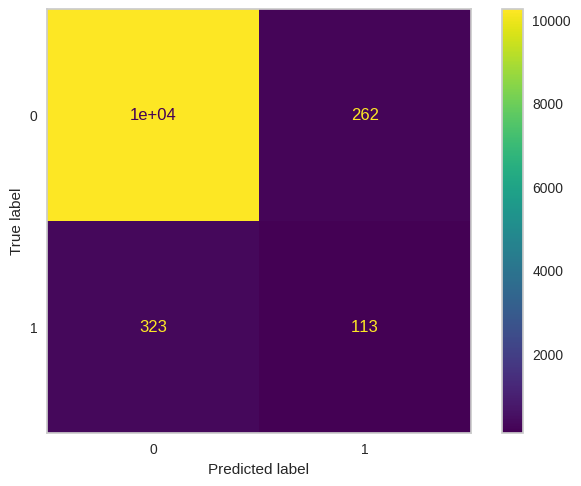

In [ ]:
from imblearn.combine import SMOTETomek
from collections import Counter
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import RepeatedStratifiedKFold
import matplotlib.pyplot as plt
from sklearn.metrics import f1_score, accuracy_score, confusion_matrix, ConfusionMatrixDisplay
from sklearn.metrics import recall_score,f1_score, accuracy_score, confusion_matrix, ConfusionMatrixDisplay


model = RandomForestClassifier(bootstrap=True, ccp_alpha=0.0, class_weight='balanced',
                       criterion='gini', max_depth=None, max_features='sqrt',
                       max_leaf_nodes=None, max_samples=None,
                       min_impurity_decrease=0.0, min_samples_leaf=1,
                       min_samples_split=2, min_weight_fraction_leaf=0.0,
                       n_estimators=100, n_jobs=-1, oob_score=False,
                       random_state=5910, verbose=0, warm_start=False)

svm = SMOTETomek(random_state=0)
X_train_resampled, y_train_resampled = svm.fit_resample(X_train_transformed, Y_train_transformed)
print('Original dataset shape:', Counter(Y_train_transformed))
print('Resampled dataset shape:', Counter(y_train_resampled))

model.fit(X_train_resampled,y_train_resampled)
y_pred = model.predict(X_test_transformed)
print('AUC-ROC',roc_auc_score(Y_test_transformed, y_pred))
print('ACCURACY',accuracy_score(Y_test_transformed, y_pred))
print('EER Score: %.3f' % calculate_eer(Y_test_transformed,y_pred))
print(classification_report(Y_test_transformed, y_pred))
cm = confusion_matrix(Y_test_transformed, y_pred)
disp = ConfusionMatrixDisplay(confusion_matrix=cm)
disp.plot()
plt.grid(False)
plt.show()

In [ ]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import RepeatedStratifiedKFold
import matplotlib.pyplot as plt
from sklearn.metrics import f1_score, accuracy_score, confusion_matrix, ConfusionMatrixDisplay
from sklearn.metrics import recall_score,f1_score, accuracy_score, confusion_matrix, ConfusionMatrixDisplay
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import RepeatedStratifiedKFold

model = RandomForestClassifier(bootstrap=True, ccp_alpha=0.0, class_weight='balanced',
                       criterion='gini', max_depth=None, max_features='sqrt',
                       max_leaf_nodes=None, max_samples=None,
                       min_impurity_decrease=0.0, min_samples_leaf=1,
                       min_samples_split=2, min_weight_fraction_leaf=0.0,
                       n_estimators=100, n_jobs=-1, oob_score=False,
                       random_state=5910, verbose=0, warm_start=False)

balance = [{0:1,1:100}, {0:1,1:80}, {0:1,1:60}, {0:1,1:40}, {0:1,1:20}]
param_grid = dict(class_weight=balance)

cv = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=1)

eer_scorer = make_scorer(calculate_eer, greater_is_better=False, needs_proba=True)

grid = GridSearchCV(estimator=model, param_grid=param_grid, cv=cv, scoring=eer_scorer)

grid_result = grid.fit(X_train_resampled, y_train_resampled)
print("Best: %f using %s" % (grid_result.best_score_, grid_result.best_params_))

Best: -0.030026 using {'class_weight': {0: 1, 1: 20}}


In [ ]:
from imblearn.combine import SMOTETomek
from collections import Counter
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import RepeatedStratifiedKFold
import matplotlib.pyplot as plt
from sklearn.metrics import f1_score, accuracy_score, confusion_matrix, ConfusionMatrixDisplay
from sklearn.metrics import recall_score,f1_score, accuracy_score, confusion_matrix, ConfusionMatrixDisplay


model = RandomForestClassifier(bootstrap=True, ccp_alpha=0.0, class_weight={0:1,1:20},
                       criterion='gini', max_depth=None, max_features='sqrt',
                       max_leaf_nodes=None, max_samples=None,
                       min_impurity_decrease=0.0, min_samples_leaf=1,
                       min_samples_split=2, min_weight_fraction_leaf=0.0,
                       n_estimators=100, n_jobs=-1, oob_score=False,
                       random_state=5910, verbose=0, warm_start=False)

print('Original dataset shape:', Counter(Y_train_transformed))
print('Resampled dataset shape:', Counter(y_train_resampled))

model.fit(X_train_resampled,y_train_resampled)
y_pred = model.predict(X_test_transformed)
print('EER Score: %.3f' % calculate_eer(Y_test_transformed,y_pred))
print(classification_report(Y_test_transformed, y_pred))
cm = confusion_matrix(Y_test_transformed, y_pred)
disp = ConfusionMatrixDisplay(confusion_matrix=cm)
disp.plot()
plt.grid(False)
plt.show()

### ADASYN

Original dataset shape: Counter({0.0: 24502, 1.0: 1017})
Resampled dataset shape: Counter({0.0: 24502, 1.0: 24364})
              precision    recall  f1-score   support

         0.0       0.97      0.98      0.97     10502
         1.0       0.30      0.25      0.27       436

    accuracy                           0.95     10938
   macro avg       0.63      0.61      0.62     10938
weighted avg       0.94      0.95      0.94     10938

AUC-ROC 0.6148197634701297
ACCURACY 0.9463338818796855
EER Score: 0.433


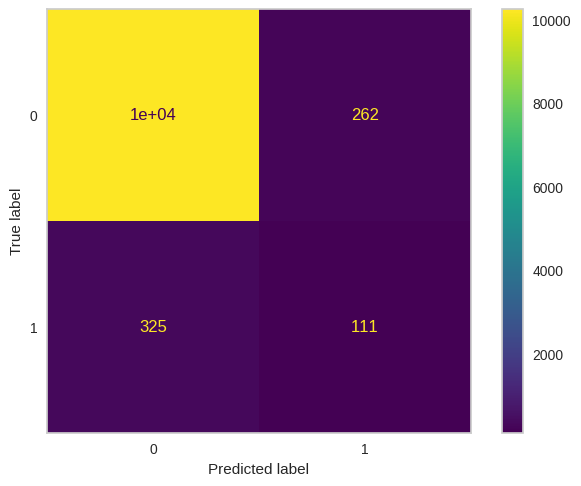

In [ ]:
from imblearn.over_sampling import ADASYN
from collections import Counter
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import RepeatedStratifiedKFold
import matplotlib.pyplot as plt
from sklearn.metrics import f1_score, accuracy_score, confusion_matrix, ConfusionMatrixDisplay
from sklearn.metrics import recall_score,f1_score, accuracy_score, confusion_matrix, ConfusionMatrixDisplay


model = RandomForestClassifier(bootstrap=True, ccp_alpha=0.0, class_weight='balanced',
                       criterion='gini', max_depth=None, max_features='sqrt',
                       max_leaf_nodes=None, max_samples=None,
                       min_impurity_decrease=0.0, min_samples_leaf=1,
                       min_samples_split=2, min_weight_fraction_leaf=0.0,
                       n_estimators=100, n_jobs=-1, oob_score=False,
                       random_state=5910, verbose=0, warm_start=False)

ada = ADASYN(random_state=42,sampling_strategy='minority')
X_train_resampled, y_train_resampled = ada.fit_resample(X_train_transformed, Y_train_transformed)
print('Original dataset shape:', Counter(Y_train_transformed))
print('Resampled dataset shape:', Counter(y_train_resampled))

model.fit(X_train_resampled,y_train_resampled)
y_pred = model.predict(X_test_transformed)
print(classification_report(Y_test_transformed, y_pred))
print('AUC-ROC',roc_auc_score(Y_test_transformed, y_pred))
print('ACCURACY',accuracy_score(Y_test_transformed, y_pred))
print('EER Score: %.3f' % calculate_eer(Y_test_transformed,y_pred))
cm = confusion_matrix(Y_test_transformed, y_pred)
disp = ConfusionMatrixDisplay(confusion_matrix=cm)
disp.plot()
plt.grid(False)
plt.show()

In [ ]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import RepeatedStratifiedKFold
import matplotlib.pyplot as plt
from sklearn.metrics import f1_score, accuracy_score, confusion_matrix, ConfusionMatrixDisplay
from sklearn.metrics import recall_score,f1_score, accuracy_score, confusion_matrix, ConfusionMatrixDisplay
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import RepeatedStratifiedKFold

model = RandomForestClassifier(bootstrap=True, ccp_alpha=0.0, class_weight='balanced',
                       criterion='gini', max_depth=None, max_features='sqrt',
                       max_leaf_nodes=None, max_samples=None,
                       min_impurity_decrease=0.0, min_samples_leaf=1,
                       min_samples_split=2, min_weight_fraction_leaf=0.0,
                       n_estimators=100, n_jobs=-1, oob_score=False,
                       random_state=5910, verbose=0, warm_start=False)

balance = [{0:1,1:100}, {0:1,1:80}, {0:1,1:60}, {0:1,1:40}, {0:1,1:20}]
param_grid = dict(class_weight=balance)

cv = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=1)

eer_scorer = make_scorer(calculate_eer, greater_is_better=False, needs_proba=True)

grid = GridSearchCV(estimator=model, param_grid=param_grid, cv=cv, scoring=eer_scorer)

grid_result = grid.fit(X_train_resampled, y_train_resampled)
print("Best: %f using %s" % (grid_result.best_score_, grid_result.best_params_))

Best: -0.030189 using {'class_weight': {0: 1, 1: 20}}


In [ ]:
from imblearn.over_sampling import ADASYN
from collections import Counter
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import RepeatedStratifiedKFold
import matplotlib.pyplot as plt
from sklearn.metrics import f1_score, accuracy_score, confusion_matrix, ConfusionMatrixDisplay
from sklearn.metrics import recall_score,f1_score, accuracy_score, confusion_matrix, ConfusionMatrixDisplay


model = RandomForestClassifier(bootstrap=True, ccp_alpha=0.0, class_weight={0:1,1:20},
                       criterion='gini', max_depth=None, max_features='sqrt',
                       max_leaf_nodes=None, max_samples=None,
                       min_impurity_decrease=0.0, min_samples_leaf=1,
                       min_samples_split=2, min_weight_fraction_leaf=0.0,
                       n_estimators=100, n_jobs=-1, oob_score=False,
                       random_state=5910, verbose=0, warm_start=False)


print('Original dataset shape:', Counter(Y_train_transformed))
print('Resampled dataset shape:', Counter(y_train_resampled))

model.fit(X_train_resampled,y_train_resampled)
y_pred = model.predict(X_test_transformed)
print('EER Score: %.3f' % calculate_eer(Y_test_transformed,y_pred))
print(classification_report(Y_test_transformed, y_pred))
cm = confusion_matrix(Y_test_transformed, y_pred)
disp = ConfusionMatrixDisplay(confusion_matrix=cm)
disp.plot()
plt.grid(False)
plt.show()

## Tune Cost sensitive

In [ ]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import RepeatedStratifiedKFold
import matplotlib.pyplot as plt
from sklearn.metrics import f1_score, accuracy_score, confusion_matrix, ConfusionMatrixDisplay
from sklearn.metrics import recall_score,f1_score, accuracy_score, confusion_matrix, ConfusionMatrixDisplay
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import RepeatedStratifiedKFold

model = RandomForestClassifier(bootstrap=True, ccp_alpha=0.0, class_weight='balanced',
                       criterion='gini', max_depth=None, max_features='sqrt',
                       max_leaf_nodes=None, max_samples=None,
                       min_impurity_decrease=0.0, min_samples_leaf=1,
                       min_samples_split=2, min_weight_fraction_leaf=0.0,
                       n_estimators=100, n_jobs=-1, oob_score=False,
                       random_state=5910, verbose=0, warm_start=False)

balance = [{0:1,1:100}, {0:1,1:80}, {0:1,1:60}, {0:1,1:40}, {0:1,1:20}]
param_grid = dict(class_weight=balance)

cv = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=1)

eer_scorer = make_scorer(calculate_eer, greater_is_better=False, needs_proba=True)

grid = GridSearchCV(estimator=model, param_grid=param_grid, cv=cv, scoring=eer_scorer)

grid_result = grid.fit(X_train_transformed, Y_train_transformed)
print("Best: %f using %s" % (grid_result.best_score_, grid_result.best_params_))

Best: -0.302824 using {'class_weight': {0: 1, 1: 60}}


AUC-ROC 0.6636350612115822
ACCURACY 0.9113183397330408
EER Score: 0.394
              precision    recall  f1-score   support

         0.0       0.97      0.93      0.95     10502
         1.0       0.20      0.39      0.26       436

    accuracy                           0.91     10938
   macro avg       0.58      0.66      0.61     10938
weighted avg       0.94      0.91      0.93     10938



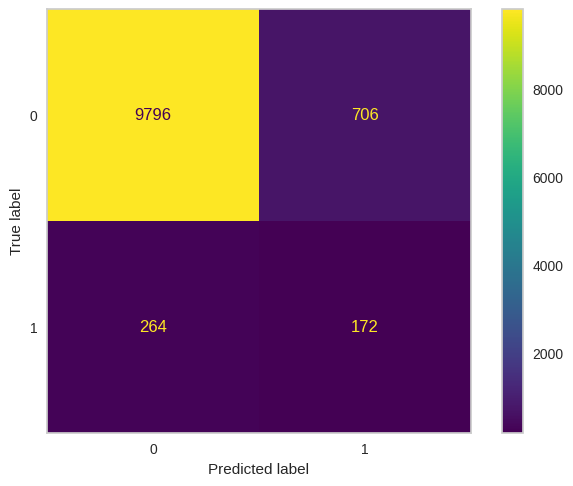

In [ ]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import RepeatedStratifiedKFold
import matplotlib.pyplot as plt
from sklearn.metrics import f1_score, accuracy_score, confusion_matrix, ConfusionMatrixDisplay
from sklearn.metrics import recall_score,f1_score, accuracy_score, confusion_matrix, ConfusionMatrixDisplay,roc_auc_score,classification_report

model = RandomForestClassifier(bootstrap=True, ccp_alpha=0.0, class_weight={0:1,1:60},
                       criterion='gini', max_depth=None, max_features='sqrt',
                       max_leaf_nodes=None, max_samples=None,
                       min_impurity_decrease=0.0, min_samples_leaf=1,
                       min_samples_split=2, min_weight_fraction_leaf=0.0,
                       n_estimators=100, n_jobs=-1, oob_score=False,
                       random_state=5910, verbose=0, warm_start=False)
cv = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=1)

model.fit(X_train_transformed,Y_train_transformed)
y_pred = model.predict(X_test_transformed)
score = f1_score(Y_test_transformed, y_pred)
recall = recall_score(Y_test_transformed, y_pred)
print('AUC-ROC',roc_auc_score(Y_test_transformed, y_pred))
print('ACCURACY',accuracy_score(Y_test_transformed, y_pred))
print('EER Score: %.3f' % calculate_eer(Y_test_transformed,y_pred))
print(classification_report(Y_test_transformed, y_pred))
cm = confusion_matrix(Y_test_transformed, y_pred)
disp = ConfusionMatrixDisplay(confusion_matrix=cm)
disp.plot()
plt.grid(False)
plt.show()

## Balanced Randomn Forest

AUC-ROC 0.6935039896288868
ACCURACY 0.7660449808008777
EER Score: 0.333
              precision    recall  f1-score   support

         0.0       0.98      0.77      0.86     10502
         1.0       0.10      0.61      0.17       436

    accuracy                           0.77     10938
   macro avg       0.54      0.69      0.52     10938
weighted avg       0.94      0.77      0.84     10938



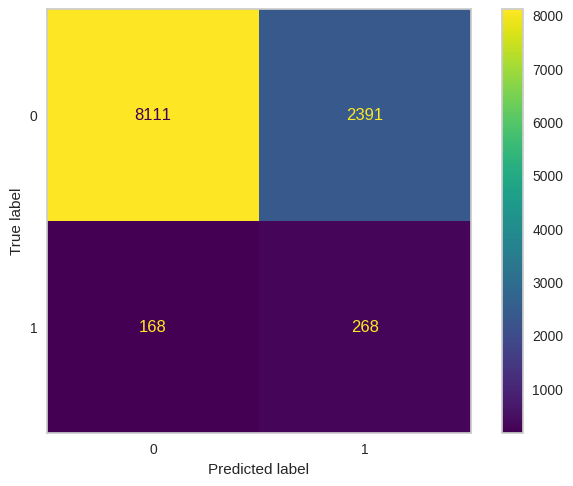

In [ ]:
from imblearn.ensemble import BalancedRandomForestClassifier
from sklearn.metrics import f1_score, accuracy_score, confusion_matrix, ConfusionMatrixDisplay,classification_report


model = BalancedRandomForestClassifier(random_state=0)
model.fit(X_train_transformed, Y_train_transformed)

y_pred = model.predict(X_test_transformed)
print('AUC-ROC',roc_auc_score(Y_test_transformed, y_pred))
print('ACCURACY',accuracy_score(Y_test_transformed, y_pred))
print('EER Score: %.3f' % calculate_eer(Y_test_transformed,y_pred))
print(classification_report(Y_test_transformed, y_pred))
cm = confusion_matrix(Y_test_transformed, y_pred)
disp = ConfusionMatrixDisplay(confusion_matrix=cm)
disp.plot()
plt.grid(False)
plt.show()

### Smote

Original dataset shape: Counter({0.0: 24502, 1.0: 1017})
Resampled dataset shape: Counter({0.0: 24502, 1.0: 24502})
AUC-ROC 0.6139586343536138
ACCURACY 0.9467910038398245
EER Score: 0.434
              precision    recall  f1-score   support

         0.0       0.97      0.98      0.97     10502
         1.0       0.30      0.25      0.27       436

    accuracy                           0.95     10938
   macro avg       0.63      0.61      0.62     10938
weighted avg       0.94      0.95      0.94     10938



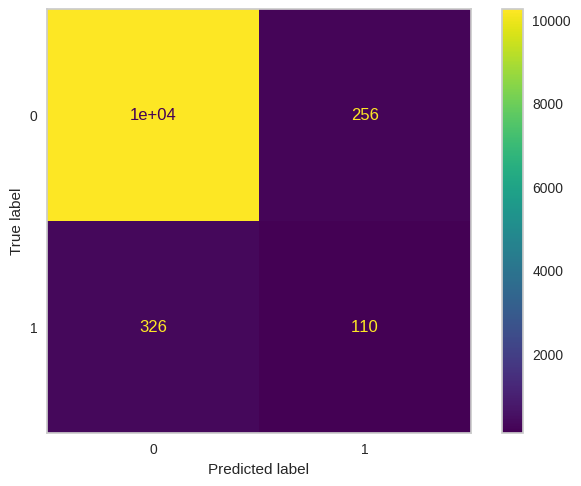

In [ ]:
from imblearn.ensemble import BalancedRandomForestClassifier
from imblearn.over_sampling import SMOTE
from collections import Counter
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import RepeatedStratifiedKFold
import matplotlib.pyplot as plt
from sklearn.metrics import f1_score, accuracy_score, confusion_matrix, ConfusionMatrixDisplay,classification_report


model = BalancedRandomForestClassifier(random_state=0)

sm = SMOTE(random_state=42,sampling_strategy='minority')
X_train_resampled, y_train_resampled = sm.fit_resample(X_train_transformed, Y_train_transformed)

model.fit(X_train_resampled, y_train_resampled)

print('Original dataset shape:', Counter(Y_train_transformed))
print('Resampled dataset shape:', Counter(y_train_resampled))

y_pred = model.predict(X_test_transformed)

print('AUC-ROC',roc_auc_score(Y_test_transformed, y_pred))
print('ACCURACY',accuracy_score(Y_test_transformed, y_pred))
print('EER Score: %.3f' % calculate_eer(Y_test_transformed,y_pred))
print(classification_report(Y_test_transformed, y_pred))
cm = confusion_matrix(Y_test_transformed, y_pred)
disp = ConfusionMatrixDisplay(confusion_matrix=cm)
disp.plot()
plt.grid(False)
plt.show()

In [ ]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import RepeatedStratifiedKFold
import matplotlib.pyplot as plt
from sklearn.metrics import f1_score, accuracy_score, confusion_matrix, ConfusionMatrixDisplay
from sklearn.metrics import recall_score,f1_score, accuracy_score, confusion_matrix, ConfusionMatrixDisplay
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import RepeatedStratifiedKFold
import numpy as np
from imblearn.ensemble import BalancedRandomForestClassifier


# Number of trees in random forest
n_estimators = [25, 50, 100, 150]
# Number of features to consider at every split
max_features = ['auto', 'sqrt']
# Maximum number of levels in tree
max_depth = [3,6,9]
# Minimum number of samples required to split a node
min_samples_split = [2, 5, 10]
# Minimum number of samples required at each leaf node
min_samples_leaf = [1, 2, 4]
# Method of selecting samples for training each tree
bootstrap = [True, False]
criterion = ["gini", "entropy"]
# Create the random grid
param_grid = { 'max_features': max_features,
               'max_depth': max_depth,
               'min_samples_split': min_samples_split,
               'min_samples_leaf': min_samples_leaf,
            }

cv = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=1)

eer_scorer = make_scorer(calculate_eer, greater_is_better=False)

model = BalancedRandomForestClassifier(n_estimators = 150,random_state=0)

grid = GridSearchCV(estimator=model, param_grid=param_grid, cv=cv, scoring=eer_scorer)

grid_result = grid.fit(X_train_resampled, y_train_resampled)
print("Best: %f using %s" % (grid_result.best_score_, grid_result.best_params_))

Best: -0.152585 using {'max_depth': 9, 'max_features': 'auto', 'min_samples_leaf': 1, 'min_samples_split': 10}


Original dataset shape: Counter({0.0: 24502, 1.0: 1017})
Resampled dataset shape: Counter({0.0: 24502, 1.0: 24502})
EER Score: 0.463
              precision    recall  f1-score   support

         0.0       0.97      0.98      0.97     10502
         1.0       0.22      0.16      0.18       436

    accuracy                           0.94     10938
   macro avg       0.59      0.57      0.58     10938
weighted avg       0.94      0.94      0.94     10938



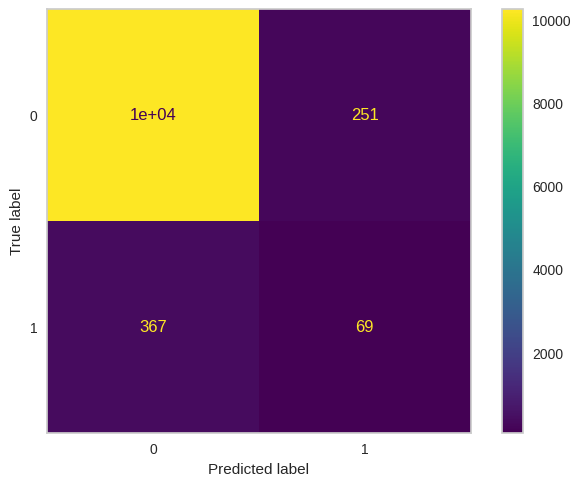

In [ ]:
from imblearn.ensemble import BalancedRandomForestClassifier
from imblearn.over_sampling import SMOTE
from collections import Counter
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import RepeatedStratifiedKFold
import matplotlib.pyplot as plt
from sklearn.metrics import f1_score, accuracy_score, confusion_matrix, ConfusionMatrixDisplay,classification_report


model = BalancedRandomForestClassifier(random_state=0,n_estimators=150,max_depth = 9,max_features= 'auto', min_samples_leaf = 1, min_samples_split=10)


model.fit(X_train_resampled, y_train_resampled)

print('Original dataset shape:', Counter(Y_train_transformed))
print('Resampled dataset shape:', Counter(y_train_resampled))

y_pred = model.predict(X_test_transformed)

print('EER Score: %.3f' % calculate_eer(Y_test_transformed,y_pred))
print(classification_report(Y_test_transformed, y_pred))
cm = confusion_matrix(Y_test_transformed, y_pred)
disp = ConfusionMatrixDisplay(confusion_matrix=cm)
disp.plot()
plt.grid(False)
plt.show()

### Randomn OverSampling

Original dataset shape: Counter({0.0: 24502, 1.0: 1017})
Resampled dataset shape: Counter({0.0: 24502, 1.0: 24502})
EER Score: 0.409
AUC-ROC 0.629064101376933
              precision    recall  f1-score   support

         0.0       0.97      0.84      0.90     10502
         1.0       0.10      0.42      0.16       436

    accuracy                           0.82     10938
   macro avg       0.54      0.63      0.53     10938
weighted avg       0.94      0.82      0.87     10938



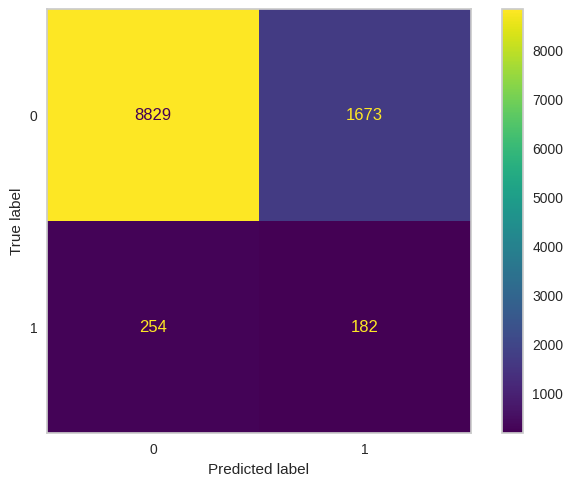

In [ ]:
from imblearn.ensemble import BalancedRandomForestClassifier
from imblearn.over_sampling import RandomOverSampler
from collections import Counter
import matplotlib.pyplot as plt
from sklearn.metrics import f1_score, accuracy_score, confusion_matrix, ConfusionMatrixDisplay,classification_report

model = BalancedRandomForestClassifier(random_state=0,max_depth = 9,max_features= 'auto', min_samples_leaf = 1, min_samples_split=2)


ru = RandomOverSampler(random_state=0)
X_train_resampled, y_train_resampled = ru.fit_resample(X_train_transformed, Y_train_transformed)

print('Original dataset shape:', Counter(Y_train_transformed))
print('Resampled dataset shape:', Counter(y_train_resampled))

model.fit(X_train_resampled, y_train_resampled)


y_pred = model.predict(X_test_transformed)

print('EER Score: %.3f' % calculate_eer(Y_test_transformed,y_pred))
print('AUC-ROC',roc_auc_score(Y_test_transformed, y_pred))
print(classification_report(Y_test_transformed, y_pred))
cm = confusion_matrix(Y_test_transformed, y_pred)
disp = ConfusionMatrixDisplay(confusion_matrix=cm)
disp.plot()
plt.grid(False)
plt.show()

In [ ]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import RepeatedStratifiedKFold
import matplotlib.pyplot as plt
from sklearn.metrics import f1_score, accuracy_score, confusion_matrix, ConfusionMatrixDisplay
from sklearn.metrics import recall_score,f1_score, accuracy_score, confusion_matrix, ConfusionMatrixDisplay
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import RepeatedStratifiedKFold
import numpy as np
from imblearn.ensemble import BalancedRandomForestClassifier


# Number of trees in random forest
# n_estimators = [25, 50, 100, 150]
# Number of features to consider at every split
max_features = ['auto', 'sqrt']
# Maximum number of levels in tree
max_depth = ['None',3,6,9]
# Minimum number of samples required to split a node
min_samples_split = [2, 5, 10]
# Minimum number of samples required at each leaf node
min_samples_leaf = [1, 2, 4]
# Method of selecting samples for training each tree
bootstrap = [True, False]
criterion = ["gini", "entropy"]
# Create the random grid
param_grid = {
               'max_features': max_features,
               'max_depth': max_depth,
               'min_samples_split': min_samples_split,
               'min_samples_leaf': min_samples_leaf
            }

cv = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=1)

eer_scorer = make_scorer(calculate_eer, greater_is_better=False, needs_proba=True)

model = BalancedRandomForestClassifier(random_state=0,n_estimators=150)

grid = GridSearchCV(estimator=model, param_grid=param_grid, cv=cv, scoring=eer_scorer)

grid_result = grid.fit(X_train_resampled, y_train_resampled)
print("Best: %f using %s" % (grid_result.best_score_, grid_result.best_params_))

Best: -0.198939 using {'max_depth': 9, 'max_features': 'auto', 'min_samples_leaf': 1, 'min_samples_split': 5}


Original dataset shape: Counter({0.0: 24502, 1.0: 1017})
Resampled dataset shape: Counter({0.0: 24502, 1.0: 24502})
EER Score: 0.413
              precision    recall  f1-score   support

         0.0       0.97      0.84      0.90     10502
         1.0       0.10      0.41      0.16       436

    accuracy                           0.83     10938
   macro avg       0.53      0.63      0.53     10938
weighted avg       0.94      0.83      0.87     10938



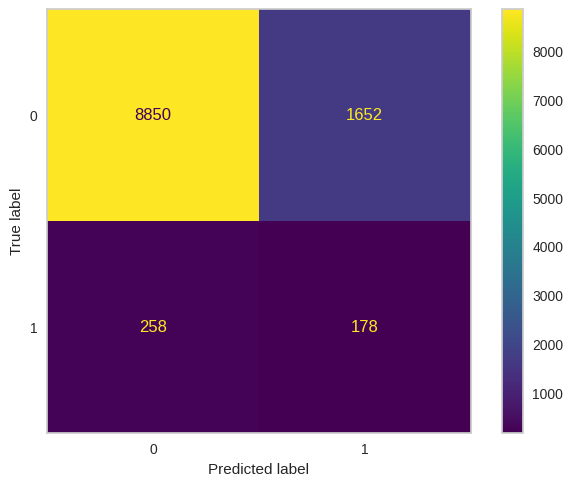

In [ ]:
from imblearn.ensemble import BalancedRandomForestClassifier
from imblearn.over_sampling import RandomOverSampler
from collections import Counter
import matplotlib.pyplot as plt
from sklearn.metrics import f1_score, accuracy_score, confusion_matrix, ConfusionMatrixDisplay,classification_report

model = BalancedRandomForestClassifier(random_state=0,n_estimators=150,max_depth = 9,max_features= 'auto', min_samples_leaf = 1, min_samples_split=5)


print('Original dataset shape:', Counter(Y_train_transformed))
print('Resampled dataset shape:', Counter(y_train_resampled))

model.fit(X_train_resampled, y_train_resampled)


y_pred = model.predict(X_test_transformed)

print('EER Score: %.3f' % calculate_eer(Y_test_transformed,y_pred))
print(classification_report(Y_test_transformed, y_pred))
cm = confusion_matrix(Y_test_transformed, y_pred)
disp = ConfusionMatrixDisplay(confusion_matrix=cm)
disp.plot()
plt.grid(False)
plt.show()

### Randomn UnderSampling

Original dataset shape: Counter({0.0: 24502, 1.0: 1017})
Resampled dataset shape: Counter({0.0: 1017, 1.0: 1017})
AUC-ROC 0.6417167809014971
EER Score: 0.364
              precision    recall  f1-score   support

         0.0       0.98      0.66      0.79     10502
         1.0       0.07      0.62      0.13       436

    accuracy                           0.66     10938
   macro avg       0.52      0.64      0.46     10938
weighted avg       0.94      0.66      0.76     10938



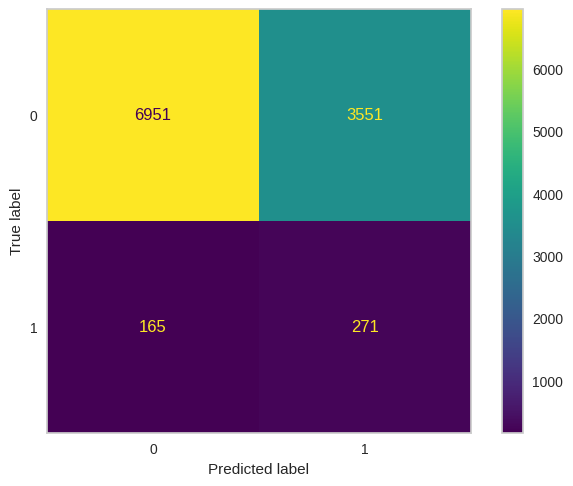

In [ ]:
from imblearn.ensemble import BalancedRandomForestClassifier
from imblearn.under_sampling import RandomUnderSampler
from collections import Counter

model = BalancedRandomForestClassifier(random_state=0)

ru = RandomUnderSampler(random_state=0)
X_train_resampled, y_train_resampled = ru.fit_resample(X_train_transformed, Y_train_transformed)

model.fit(X_train_resampled, y_train_resampled)

print('Original dataset shape:', Counter(Y_train_transformed))
print('Resampled dataset shape:', Counter(y_train_resampled))

y_pred = model.predict(X_test_transformed)
print('AUC-ROC',roc_auc_score(Y_test_transformed, y_pred))
print('EER Score: %.3f' % calculate_eer(Y_test_transformed,y_pred))
print(classification_report(Y_test_transformed, y_pred))
cm = confusion_matrix(Y_test_transformed, y_pred)
disp = ConfusionMatrixDisplay(confusion_matrix=cm)
disp.plot()
plt.grid(False)
plt.show()

In [ ]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import RepeatedStratifiedKFold
import matplotlib.pyplot as plt
from sklearn.metrics import f1_score, accuracy_score, confusion_matrix, ConfusionMatrixDisplay
from sklearn.metrics import recall_score,f1_score, accuracy_score, confusion_matrix, ConfusionMatrixDisplay
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import RepeatedStratifiedKFold
import numpy as np
from imblearn.ensemble import BalancedRandomForestClassifier


# Number of trees in random forest
n_estimators = [25, 50, 100, 150]
# Number of features to consider at every split
max_features = ['auto', 'sqrt']
# Maximum number of levels in tree
max_depth = [3,6,9]
# Minimum number of samples required to split a node
min_samples_split = [2, 5, 10]
# Minimum number of samples required at each leaf node
min_samples_leaf = [1, 2, 4]
# Method of selecting samples for training each tree
bootstrap = [True, False]
criterion = ["gini", "entropy"]
# Create the random grid
param_grid = {
               'max_features': max_features,
               'max_depth': max_depth,
               'min_samples_split': min_samples_split,
               'min_samples_leaf': min_samples_leaf,
            }

cv = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=1)

eer_scorer = make_scorer(calculate_eer, greater_is_better=False, needs_proba=True)

model = BalancedRandomForestClassifier(random_state=0,n_estimators=150)

grid = GridSearchCV(estimator=model, param_grid=param_grid, cv=cv, scoring=eer_scorer)

grid_result = grid.fit(X_train_resampled, y_train_resampled)
print("Best: %f using %s" % (grid_result.best_score_, grid_result.best_params_))

Best: -0.386339 using {'max_depth': 9, 'max_features': 'auto', 'min_samples_leaf': 1, 'min_samples_split': 2}


Original dataset shape: Counter({0.0: 24502, 1.0: 1017})
Resampled dataset shape: Counter({0.0: 1017, 1.0: 1017})
EER Score: 0.401
              precision    recall  f1-score   support

         0.0       0.97      0.63      0.76     10502
         1.0       0.06      0.58      0.11       436

    accuracy                           0.62     10938
   macro avg       0.52      0.60      0.44     10938
weighted avg       0.94      0.62      0.74     10938



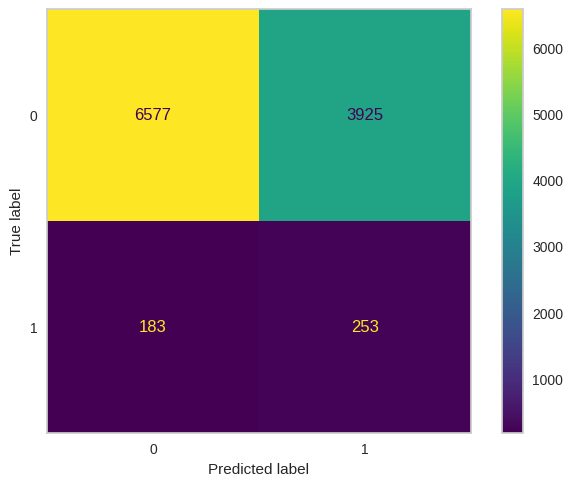

In [ ]:
from imblearn.ensemble import BalancedRandomForestClassifier
from imblearn.under_sampling import RandomUnderSampler
from collections import Counter

model = BalancedRandomForestClassifier(random_state=0,max_depth = 9,max_features= 'auto', min_samples_leaf = 1, min_samples_split=2)

model.fit(X_train_resampled, y_train_resampled)

print('Original dataset shape:', Counter(Y_train_transformed))
print('Resampled dataset shape:', Counter(y_train_resampled))

y_pred = model.predict(X_test_transformed)

print('EER Score: %.3f' % calculate_eer(Y_test_transformed,y_pred))
print(classification_report(Y_test_transformed, y_pred))
cm = confusion_matrix(Y_test_transformed, y_pred)
disp = ConfusionMatrixDisplay(confusion_matrix=cm)
disp.plot()
plt.grid(False)
plt.show()

### SVM Smote

Original dataset shape: Counter({0.0: 24502, 1.0: 1017})
Resampled dataset shape: Counter({0.0: 24502, 1.0: 24502})
AUC-ROC 0.613430775090459
EER Score: 0.434
              precision    recall  f1-score   support

         0.0       0.97      0.98      0.97     10502
         1.0       0.31      0.25      0.28       436

    accuracy                           0.95     10938
   macro avg       0.64      0.61      0.62     10938
weighted avg       0.94      0.95      0.95     10938



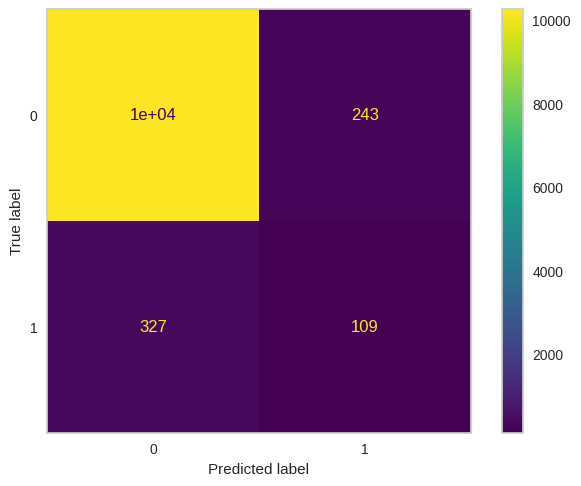

In [ ]:
from imblearn.ensemble import BalancedRandomForestClassifier
from imblearn.over_sampling import SVMSMOTE
from collections import Counter

model = BalancedRandomForestClassifier(random_state=0)

svm = SVMSMOTE(random_state=0)
X_train_resampled, y_train_resampled = svm.fit_resample(X_train_transformed, Y_train_transformed)

model.fit(X_train_resampled, y_train_resampled)

print('Original dataset shape:', Counter(Y_train_transformed))
print('Resampled dataset shape:', Counter(y_train_resampled))

y_pred = model.predict(X_test_transformed)
print('AUC-ROC',roc_auc_score(Y_test_transformed, y_pred))
print('EER Score: %.3f' % calculate_eer(Y_test_transformed,y_pred))
print(classification_report(Y_test_transformed, y_pred))
cm = confusion_matrix(Y_test_transformed, y_pred)
disp = ConfusionMatrixDisplay(confusion_matrix=cm)
disp.plot()
plt.grid(False)
plt.show()

In [ ]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import RepeatedStratifiedKFold
import matplotlib.pyplot as plt
from sklearn.metrics import f1_score, accuracy_score, confusion_matrix, ConfusionMatrixDisplay
from sklearn.metrics import recall_score,f1_score, accuracy_score, confusion_matrix, ConfusionMatrixDisplay
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import RepeatedStratifiedKFold
import numpy as np
from imblearn.ensemble import BalancedRandomForestClassifier


# Number of trees in random forest
n_estimators = [25, 50, 100, 150]
# Number of features to consider at every split
max_features = ['auto', 'sqrt']
# Maximum number of levels in tree
max_depth = [3,6,9]
# Minimum number of samples required to split a node
min_samples_split = [2, 5, 10]
# Minimum number of samples required at each leaf node
min_samples_leaf = [1, 2, 4]
# Method of selecting samples for training each tree
bootstrap = [True, False]
criterion = ["gini", "entropy"]
# Create the random grid
param_grid = {
               'max_features': max_features,
               'max_depth': max_depth,
               'min_samples_split': min_samples_split,
               'min_samples_leaf': min_samples_leaf,
            }

cv = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=1)

eer_scorer = make_scorer(calculate_eer, greater_is_better=False, needs_proba=True)

model = BalancedRandomForestClassifier(random_state=0,n_estimators=150)

grid = GridSearchCV(estimator=model, param_grid=param_grid, cv=cv, scoring=eer_scorer)

grid_result = grid.fit(X_train_resampled, y_train_resampled)
print("Best: %f using %s" % (grid_result.best_score_, grid_result.best_params_))

Best: -0.066398 using {'max_depth': 9, 'max_features': 'auto', 'min_samples_leaf': 1, 'min_samples_split': 5}


Original dataset shape: Counter({0.0: 24502, 1.0: 1017})
Resampled dataset shape: Counter({0.0: 24502, 1.0: 24502})
EER Score: 0.494
              precision    recall  f1-score   support

         0.0       0.96      1.00      0.98     10502
         1.0       0.65      0.03      0.05       436

    accuracy                           0.96     10938
   macro avg       0.80      0.51      0.51     10938
weighted avg       0.95      0.96      0.94     10938



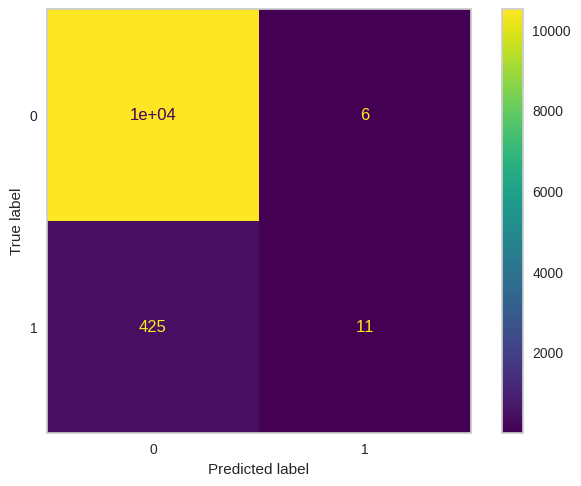

In [ ]:
from imblearn.ensemble import BalancedRandomForestClassifier
from imblearn.over_sampling import SVMSMOTE
from collections import Counter

model = BalancedRandomForestClassifier(random_state=0,max_depth = 9,max_features= 'auto', min_samples_leaf = 1, min_samples_split=5)


svm = SVMSMOTE()
X_train_resampled, y_train_resampled = svm.fit_resample(X_train_transformed, Y_train_transformed)

model.fit(X_train_resampled, y_train_resampled)

print('Original dataset shape:', Counter(Y_train_transformed))
print('Resampled dataset shape:', Counter(y_train_resampled))

y_pred = model.predict(X_test_transformed)

print('EER Score: %.3f' % calculate_eer(Y_test_transformed,y_pred))
print(classification_report(Y_test_transformed, y_pred))
cm = confusion_matrix(Y_test_transformed, y_pred)
disp = ConfusionMatrixDisplay(confusion_matrix=cm)
disp.plot()
plt.grid(False)
plt.show()

### Borderline Smote

Original dataset shape: Counter({0.0: 24502, 1.0: 1017})
Resampled dataset shape: Counter({0.0: 24502, 1.0: 24502})
AUC-ROC 0.6129546752999429
ACCURACY 0.94697385262388
EER Score: 0.435
              precision    recall  f1-score   support

         0.0       0.97      0.98      0.97     10502
         1.0       0.30      0.25      0.27       436

    accuracy                           0.95     10938
   macro avg       0.64      0.61      0.62     10938
weighted avg       0.94      0.95      0.94     10938



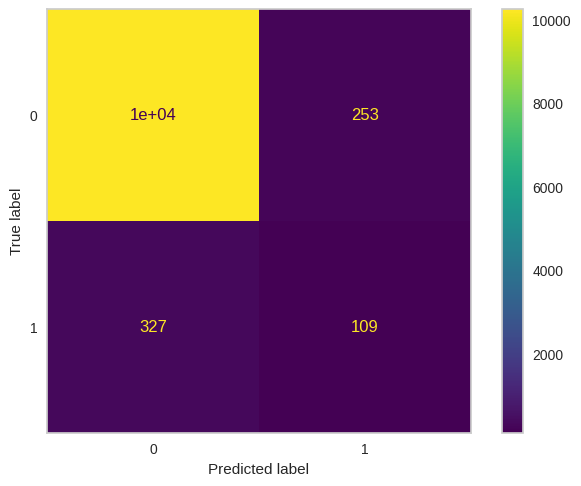

In [ ]:
from imblearn.ensemble import BalancedRandomForestClassifier
from imblearn.over_sampling import BorderlineSMOTE
from collections import Counter
from imblearn.ensemble import BalancedRandomForestClassifier
from imblearn.over_sampling import RandomOverSampler
from collections import Counter
import matplotlib.pyplot as plt
from sklearn.metrics import f1_score, accuracy_score, confusion_matrix, ConfusionMatrixDisplay,classification_report


svm = BorderlineSMOTE(random_state=0)
X_train_resampled, y_train_resampled = svm.fit_resample(X_train_transformed, Y_train_transformed)

model = BalancedRandomForestClassifier(random_state=0)

model.fit(X_train_resampled, y_train_resampled)

print('Original dataset shape:', Counter(Y_train_transformed))
print('Resampled dataset shape:', Counter(y_train_resampled))

y_pred = model.predict(X_test_transformed)
print('AUC-ROC',roc_auc_score(Y_test_transformed, y_pred))
print('ACCURACY',accuracy_score(Y_test_transformed, y_pred))
print('EER Score: %.3f' % calculate_eer(Y_test_transformed,y_pred))
print(classification_report(Y_test_transformed, y_pred))
cm = confusion_matrix(Y_test_transformed, y_pred)
disp = ConfusionMatrixDisplay(confusion_matrix=cm)
disp.plot()
plt.grid(False)
plt.show()

In [ ]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import RepeatedStratifiedKFold
import matplotlib.pyplot as plt
from sklearn.metrics import f1_score, accuracy_score, confusion_matrix, ConfusionMatrixDisplay
from sklearn.metrics import recall_score,f1_score, accuracy_score, confusion_matrix, ConfusionMatrixDisplay
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import RepeatedStratifiedKFold
import numpy as np
from imblearn.ensemble import BalancedRandomForestClassifier


# Number of trees in random forest
n_estimators = [25, 50, 100, 150]
# Number of features to consider at every split
max_features = ['auto', 'sqrt']
# Maximum number of levels in tree
max_depth = [3,6,9]
# Minimum number of samples required to split a node
min_samples_split = [2, 5, 10]
# Minimum number of samples required at each leaf node
min_samples_leaf = [1, 2, 4]
# Method of selecting samples for training each tree
bootstrap = [True, False]
criterion = ["gini", "entropy"]
# Create the random grid
param_grid = {
               'max_features': max_features,
               'max_depth': max_depth,
               'min_samples_split': min_samples_split,
               'min_samples_leaf': min_samples_leaf,
             }

cv = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=1)

eer_scorer = make_scorer(calculate_eer, greater_is_better=False, needs_proba=True)

model = BalancedRandomForestClassifier(random_state=0,n_estimators=150)

grid = GridSearchCV(estimator=model, param_grid=param_grid, cv=cv, scoring=eer_scorer)

grid_result = grid.fit(X_train_resampled, y_train_resampled)
print("Best: %f using %s" % (grid_result.best_score_, grid_result.best_params_))

Best: -0.087082 using {'max_depth': 9, 'max_features': 'auto', 'min_samples_leaf': 1, 'min_samples_split': 2}


Original dataset shape: Counter({0.0: 24502, 1.0: 1017})
Resampled dataset shape: Counter({0.0: 24502, 1.0: 24502})
EER Score: 0.465
              precision    recall  f1-score   support

         0.0       0.97      0.97      0.97     10502
         1.0       0.20      0.15      0.17       436

    accuracy                           0.94     10938
   macro avg       0.58      0.56      0.57     10938
weighted avg       0.93      0.94      0.94     10938



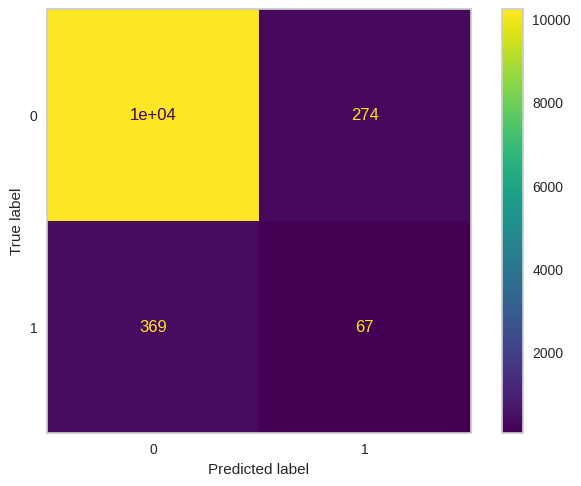

In [ ]:
from imblearn.ensemble import BalancedRandomForestClassifier
from imblearn.over_sampling import BorderlineSMOTE
from collections import Counter
from imblearn.ensemble import BalancedRandomForestClassifier
from imblearn.over_sampling import RandomOverSampler
from collections import Counter
import matplotlib.pyplot as plt
from sklearn.metrics import f1_score, accuracy_score, confusion_matrix, ConfusionMatrixDisplay,classification_report


model = BalancedRandomForestClassifier(random_state=0,max_depth = 9,max_features= 'auto', min_samples_leaf = 1, min_samples_split=2)


model.fit(X_train_resampled, y_train_resampled)

print('Original dataset shape:', Counter(Y_train_transformed))
print('Resampled dataset shape:', Counter(y_train_resampled))

y_pred = model.predict(X_test_transformed)

print('EER Score: %.3f' % calculate_eer(Y_test_transformed,y_pred))
print(classification_report(Y_test_transformed, y_pred))
cm = confusion_matrix(Y_test_transformed, y_pred)
disp = ConfusionMatrixDisplay(confusion_matrix=cm)
disp.plot()
plt.grid(False)
plt.show()

### Smote Tomek

Original dataset shape: Counter({0.0: 24502, 1.0: 1017})
Resampled dataset shape: Counter({0.0: 24502, 1.0: 24502})
AUC-ROC 0.6935039896288868
EER Score: 0.333
              precision    recall  f1-score   support

         0.0       0.98      0.77      0.86     10502
         1.0       0.10      0.61      0.17       436

    accuracy                           0.77     10938
   macro avg       0.54      0.69      0.52     10938
weighted avg       0.94      0.77      0.84     10938



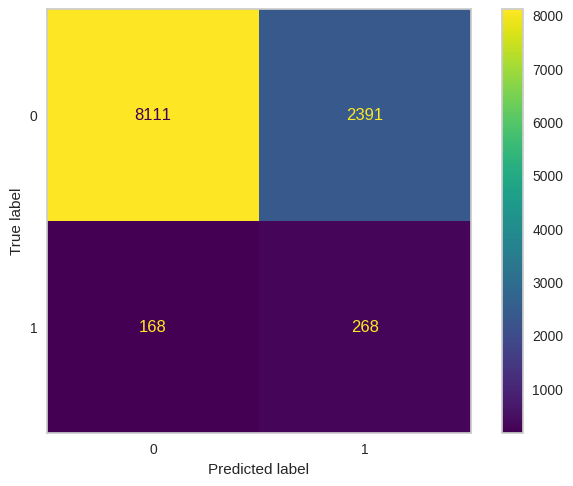

In [ ]:
from imblearn.ensemble import BalancedRandomForestClassifier
from imblearn.combine import SMOTETomek
from collections import Counter

model = BalancedRandomForestClassifier(random_state=0)
model.fit(X_train_transformed, Y_train_transformed)

print('Original dataset shape:', Counter(Y_train_transformed))
print('Resampled dataset shape:', Counter(y_train_resampled))

svm = SMOTETomek(random_state=0)
X_train_resampled, y_train_resampled = svm.fit_resample(X_train_transformed, Y_train_transformed)

y_pred = model.predict(X_test_transformed)
print('AUC-ROC',roc_auc_score(Y_test_transformed, y_pred))
print('EER Score: %.3f' % calculate_eer(Y_test_transformed,y_pred))
print(classification_report(Y_test_transformed, y_pred))
cm = confusion_matrix(Y_test_transformed, y_pred)
disp = ConfusionMatrixDisplay(confusion_matrix=cm)
disp.plot()
plt.grid(False)
plt.show()

In [ ]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import RepeatedStratifiedKFold
import matplotlib.pyplot as plt
from sklearn.metrics import f1_score, accuracy_score, confusion_matrix, ConfusionMatrixDisplay
from sklearn.metrics import recall_score,f1_score, accuracy_score, confusion_matrix, ConfusionMatrixDisplay
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import RepeatedStratifiedKFold
import numpy as np
from imblearn.ensemble import BalancedRandomForestClassifier


# Number of trees in random forest
n_estimators = [25, 50, 100, 150]
# Number of features to consider at every split
max_features = ['auto', 'sqrt']
# Maximum number of levels in tree
max_depth = [3,6,9]
# Minimum number of samples required to split a node
min_samples_split = [2, 5, 10]
# Minimum number of samples required at each leaf node
min_samples_leaf = [1, 2, 4]
# Method of selecting samples for training each tree
bootstrap = [True, False]
criterion = ["gini", "entropy"]
# Create the random grid
param_grid = {
               'max_features': max_features,
               'max_depth': max_depth,
               'min_samples_split': min_samples_split,
               'min_samples_leaf': min_samples_leaf,
            }

cv = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=1)

eer_scorer = make_scorer(calculate_eer, greater_is_better=False, needs_proba=True)

model = BalancedRandomForestClassifier(random_state=0,n_estimators=150)

grid = GridSearchCV(estimator=model, param_grid=param_grid, cv=cv, scoring=eer_scorer)

grid_result = grid.fit(X_train_resampled, y_train_resampled)
print("Best: %f using %s" % (grid_result.best_score_, grid_result.best_params_))

Best: -0.091249 using {'max_depth': 9, 'max_features': 'auto', 'min_samples_leaf': 1, 'min_samples_split': 10}


Original dataset shape: Counter({0.0: 24502, 1.0: 1017})
Resampled dataset shape: Counter({0.0: 24502, 1.0: 24502})
EER Score: 0.375
              precision    recall  f1-score   support

         0.0       0.98      0.66      0.79     10502
         1.0       0.07      0.60      0.12       436

    accuracy                           0.66     10938
   macro avg       0.52      0.63      0.46     10938
weighted avg       0.94      0.66      0.76     10938



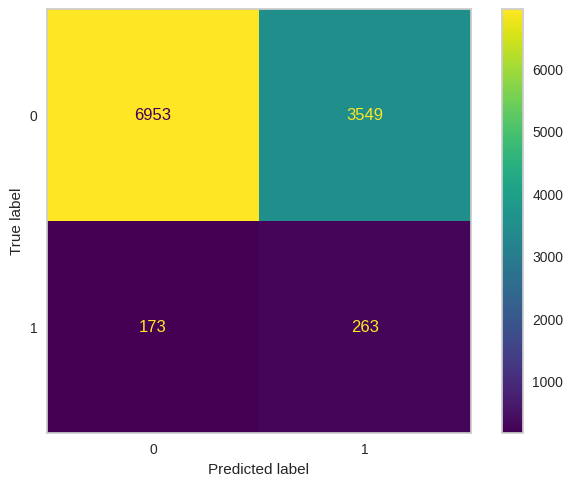

In [ ]:
from imblearn.ensemble import BalancedRandomForestClassifier
from imblearn.combine import SMOTETomek
from collections import Counter

model = BalancedRandomForestClassifier(random_state=0,max_depth = 9,max_features= 'auto', min_samples_leaf = 1, min_samples_split=10)

model.fit(X_train_transformed, Y_train_transformed)

print('Original dataset shape:', Counter(Y_train_transformed))
print('Resampled dataset shape:', Counter(y_train_resampled))

y_pred = model.predict(X_test_transformed)

print('EER Score: %.3f' % calculate_eer(Y_test_transformed,y_pred))
print(classification_report(Y_test_transformed, y_pred))
cm = confusion_matrix(Y_test_transformed, y_pred)
disp = ConfusionMatrixDisplay(confusion_matrix=cm)
disp.plot()
plt.grid(False)
plt.show()

### ADASYN

Original dataset shape: Counter({0.0: 24502, 1.0: 1017})
Resampled dataset shape: Counter({0.0: 24490, 1.0: 24490})
AUC-ROC 0.6143871241650782
EER Score: 0.434
              precision    recall  f1-score   support

         0.0       0.97      0.98      0.97     10502
         1.0       0.31      0.25      0.28       436

    accuracy                           0.95     10938
   macro avg       0.64      0.61      0.63     10938
weighted avg       0.94      0.95      0.95     10938



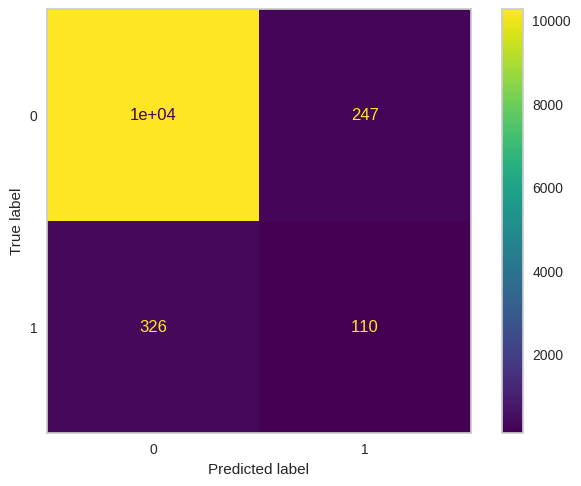

In [ ]:
from imblearn.ensemble import BalancedRandomForestClassifier
from imblearn.over_sampling import ADASYN
from collections import Counter
from sklearn.metrics import recall_score,f1_score, accuracy_score, confusion_matrix, ConfusionMatrixDisplay,classification_report
import matplotlib.pyplot as plt

model = BalancedRandomForestClassifier(random_state=0)

print('Original dataset shape:', Counter(Y_train_transformed))
print('Resampled dataset shape:', Counter(y_train_resampled))

model.fit(X_train_resampled, y_train_resampled)

y_pred = model.predict(X_test_transformed)
print('AUC-ROC',roc_auc_score(Y_test_transformed, y_pred))
print('EER Score: %.3f' % calculate_eer(Y_test_transformed,y_pred))
print(classification_report(Y_test_transformed, y_pred))
cm = confusion_matrix(Y_test_transformed, y_pred)
disp = ConfusionMatrixDisplay(confusion_matrix=cm)
disp.plot()
plt.grid(False)
plt.show()

In [ ]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import RepeatedStratifiedKFold
import matplotlib.pyplot as plt
from sklearn.metrics import f1_score, accuracy_score, confusion_matrix, ConfusionMatrixDisplay
from sklearn.metrics import recall_score,f1_score, accuracy_score, confusion_matrix, ConfusionMatrixDisplay,classification_report
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import RepeatedStratifiedKFold
import numpy as np
from imblearn.ensemble import BalancedRandomForestClassifier


# Number of trees in random forest
n_estimators = [25, 50, 100, 150]
# Number of features to consider at every split
max_features = ['auto', 'sqrt']
# Maximum number of levels in tree
max_depth = [3,6,9]
# Minimum number of samples required to split a node
min_samples_split = [2, 5, 10]
# Minimum number of samples required at each leaf node
min_samples_leaf = [1, 2, 4]
# Method of selecting samples for training each tree
bootstrap = [True, False]
criterion = ["gini", "entropy"]
# Create the random grid
param_grid = {
               'max_features': max_features,
               'max_depth': max_depth,
               'min_samples_split': min_samples_split,
               'min_samples_leaf': min_samples_leaf,
            }

cv = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=1)

eer_scorer = make_scorer(calculate_eer, greater_is_better=False, needs_proba=True)

model = BalancedRandomForestClassifier(random_state=0,n_estimators=150)

grid = GridSearchCV(estimator=model, param_grid=param_grid, cv=cv, scoring=eer_scorer)

grid_result = grid.fit(X_train_resampled, y_train_resampled)
print("Best: %f using %s" % (grid_result.best_score_, grid_result.best_params_))

Best: -0.094928 using {'max_depth': 9, 'max_features': 'auto', 'min_samples_leaf': 1, 'min_samples_split': 5}


Original dataset shape: Counter({0.0: 24502, 1.0: 1017})
Resampled dataset shape: Counter({0.0: 24502, 1.0: 24364})
EER Score: 0.471
              precision    recall  f1-score   support

         0.0       0.96      0.97      0.97     10502
         1.0       0.18      0.13      0.15       436

    accuracy                           0.94     10938
   macro avg       0.57      0.55      0.56     10938
weighted avg       0.93      0.94      0.94     10938



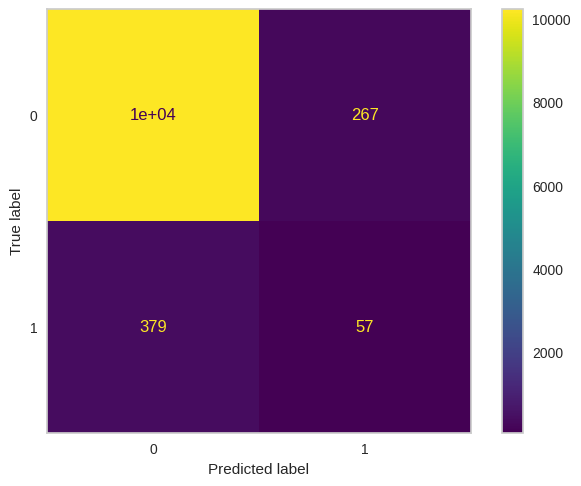

In [ ]:
from imblearn.ensemble import BalancedRandomForestClassifier
from imblearn.over_sampling import ADASYN
from collections import Counter
from sklearn.metrics import recall_score,f1_score, accuracy_score, confusion_matrix, ConfusionMatrixDisplay,classification_report
import matplotlib.pyplot as plt

model = BalancedRandomForestClassifier(random_state=0,max_depth = 9,max_features= 'auto', min_samples_leaf = 1, min_samples_split=5)

ada = ADASYN(random_state=42,sampling_strategy='minority')
X_train_resampled, y_train_resampled = ada.fit_resample(X_train_transformed, Y_train_transformed)


print('Original dataset shape:', Counter(Y_train_transformed))
print('Resampled dataset shape:', Counter(y_train_resampled))

model.fit(X_train_resampled, y_train_resampled)

y_pred = model.predict(X_test_transformed)

print('EER Score: %.3f' % calculate_eer(Y_test_transformed,y_pred))
print(classification_report(Y_test_transformed, y_pred))
cm = confusion_matrix(Y_test_transformed, y_pred)
disp = ConfusionMatrixDisplay(confusion_matrix=cm)
disp.plot()
plt.grid(False)
plt.show()

## Tune BRF

In [ ]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import RepeatedStratifiedKFold
import matplotlib.pyplot as plt
from sklearn.metrics import f1_score, accuracy_score, confusion_matrix, ConfusionMatrixDisplay
from sklearn.metrics import recall_score,f1_score, accuracy_score, confusion_matrix, ConfusionMatrixDisplay
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import RepeatedStratifiedKFold
import numpy as np
from imblearn.ensemble import BalancedRandomForestClassifier


# Number of trees in random forest
n_estimators = [25, 50, 100, 150]
# Number of features to consider at every split
max_features = ['auto', 'sqrt']
# Maximum number of levels in tree
max_depth = ['None',3,6,9]
# Minimum number of samples required to split a node
min_samples_split = [2, 5, 10]
# Minimum number of samples required at each leaf node
min_samples_leaf = [1, 2, 4]
# Method of selecting samples for training each tree
bootstrap = [True, False]
criterion = ["gini", "entropy"]
# Create the random grid
param_grid = {
               'n_estimators' : n_estimators,
               'max_features': max_features,
               'max_depth': max_depth,
               'min_samples_split': min_samples_split,
               'min_samples_leaf': min_samples_leaf,
               'criterion': criterion
            }

cv = RepeatedStratifiedKFold(n_splits=10, n_repeats=3, random_state=1)

eer_scorer = make_scorer(calculate_eer, greater_is_better=False, needs_proba=True)

model = BalancedRandomForestClassifier(random_state=0)

grid = GridSearchCV(estimator=model, param_grid=param_grid, cv=cv, scoring=eer_scorer)

grid_result = grid.fit(X_train_transformed, Y_train_transformed)
print("Best: %f using %s" % (grid_result.best_score_, grid_result.best_params_))

              precision    recall  f1-score   support

         0.0       0.98      0.77      0.86     10502
         1.0       0.10      0.60      0.17       436

    accuracy                           0.77     10938
   macro avg       0.54      0.69      0.52     10938
weighted avg       0.94      0.77      0.84     10938

EER Score: 0.339


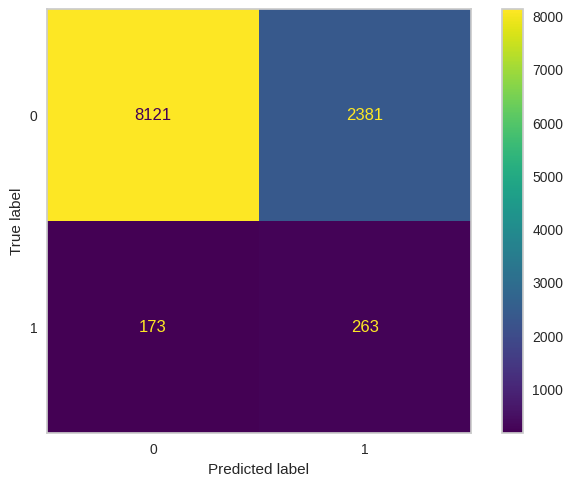

In [ ]:
from imblearn.ensemble import BalancedRandomForestClassifier
from sklearn.metrics import recall_score,f1_score, accuracy_score, confusion_matrix, ConfusionMatrixDisplay,classification_report
import matplotlib.pyplot as plt

# model = BalancedRandomForestClassifier(random_state=0,max_depth=9,max_features='auto',min_samples_leaf=1,min_samples_split=2,n_estimators=150)
model = BalancedRandomForestClassifier(random_state=0,criterion='gini',max_depth=None,max_features='auto',min_samples_leaf=1,min_samples_split=2,n_estimators=150)

model.fit(X_train_transformed, Y_train_transformed)

y_pred = model.predict(X_test_transformed)


print(classification_report(Y_test_transformed, y_pred))
print('EER Score: %.3f' % calculate_eer(Y_test_transformed,y_pred))
cm = confusion_matrix(Y_test_transformed, y_pred)
disp = ConfusionMatrixDisplay(confusion_matrix=cm)
disp.plot()
plt.grid(False)
plt.show()

## iForest

              precision    recall  f1-score   support

         0.0       0.96      0.95      0.96     10502
         1.0       0.05      0.06      0.05       436

    accuracy                           0.92     10938
   macro avg       0.50      0.50      0.50     10938
weighted avg       0.92      0.92      0.92     10938

AUC-ROC 0.50395599614927
EER Score: 0.498


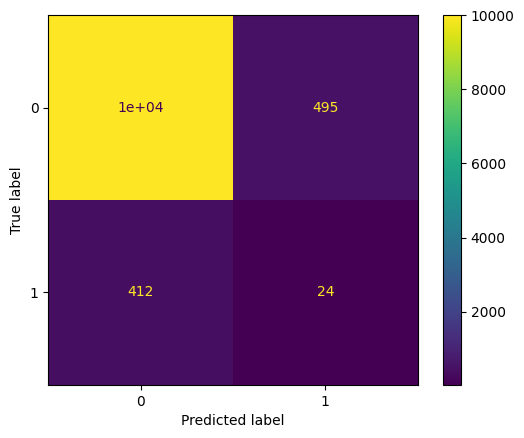

In [ ]:
from sklearn.metrics import f1_score
from sklearn.ensemble import IsolationForest
from sklearn.metrics import recall_score,f1_score, accuracy_score, confusion_matrix, ConfusionMatrixDisplay,classification_report,roc_auc_score
import matplotlib.pyplot as plt
# from sklearn.preprocessing import StandardScaler
# scaler= StandardScaler()

model = IsolationForest(random_state=47)

model.fit(X_train_transformed,Y_train_transformed)

y_pred = model.predict(X_test_transformed)


y_pred[y_pred == 1] = 0
y_pred[y_pred == -1] = 1

print(classification_report(Y_test_transformed, y_pred))
print('AUC-ROC',roc_auc_score(Y_test_transformed, y_pred))
print('EER Score: %.3f' % calculate_eer(Y_test_transformed,y_pred))
cm = confusion_matrix(Y_test_transformed, y_pred)
disp = ConfusionMatrixDisplay(confusion_matrix=cm)
disp.plot()
plt.grid(False)
plt.show()